<img src="HFPS.png" alt="LOGO" style="height: 250px; width:800px;"/>

## Team Members:
- Yashowardhan Shinde
- Aryan Kenchappagol
- Sumit Patil
- Yash Panchwatkar

## Problem Statement:
**Heart Failure Prediction using Machine Learning model during the follow up period of a patient when he/she has been diagnosed with a Heart Condition.**

**We intend to develop a robust hybrid prediction model for detecting a heart failure in a patient during the follow up period of the patient so that the they can be more aware of their heart conditions and can take the necessary actions according to their heart condition.**

## Importing all the necessary libraries.

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.graph_objects as go
from plotly.subplots import make_subplots
%matplotlib inline

c:\users\hp\appdata\local\programs\python\python37\lib\importlib\_bootstrap.py:219: RuntimeWarning: numpy.ufunc size changed, may indicate binary incompatibility. Expected 192 from C header, got 216 from PyObject
  return f(*args, **kwds)
c:\users\hp\appdata\local\programs\python\python37\lib\importlib\_bootstrap.py:219: RuntimeWarning: numpy.ufunc size changed, may indicate binary incompatibility. Expected 192 from C header, got 216 from PyObject
  return f(*args, **kwds)


## Loading the dataset:

In [2]:
df = pd.read_csv("heart_failure_clinical_records_dataset.csv")
df.head()

,age,anaemia,creatinine_phosphokinase,diabetes,ejection_fraction,high_blood_pressure,platelets,serum_creatinine,serum_sodium,sex,smoking,time,DEATH_EVENT
0,75.0,0,582,0,20,1,265000.00,1.9,130,1,0,4,1
1,55.0,0,7861,0,38,0,263358.03,1.1,136,1,0,6,1
2,65.0,0,146,0,20,0,162000.00,1.3,129,1,1,7,1
3,50.0,1,111,0,20,0,210000.00,1.9,137,1,0,7,1
4,65.0,1,160,1,20,0,327000.00,2.7,116,0,0,8,1


## Data Description:
1. **Age**: age of patient (in years)

2. **Anaemia**: Decrease of red blood cells or hemoglobin

3. **High blood pressure**: If a patient has hypertension

4. **Creatinine phosphokinase**: Level of the CPK enzyme in the blood (mcg/L)

5. **Diabetes**: If the patient has diabetes

6. **Ejection fraction**: Percentage of blood leaving the heart at each contraction

7. **Sex**: Woman or man

8. **Platelets**: Platelets in the blood (kiloplatelets/mL)

9. **Serum creatinine**: Level of creatinine in the blood (mg/dL)

10. **Serum sodium**: Level of sodium in the blood (mEq/L)

11. **Smoking**: If the patient smokes

12. **Time**: Follow-up period (in days)

13. **(Target) Death Event**: If the patient died during the follow-up period

## Performing EDA Exploratory Data Anlysis

In [3]:
df.describe()

,age,anaemia,creatinine_phosphokinase,diabetes,ejection_fraction,high_blood_pressure,platelets,serum_creatinine,serum_sodium,sex,smoking,time,DEATH_EVENT
count,299.000000,299.000000,299.000000,299.000000,299.000000,299.000000,299.000000,299.00000,299.000000,299.000000,299.00000,299.000000,299.00000
mean,60.833893,0.431438,581.839465,0.418060,38.083612,0.351171,263358.029264,1.39388,136.625418,0.648829,0.32107,130.260870,0.32107
std,11.894809,0.496107,970.287881,0.494067,11.834841,0.478136,97804.236869,1.03451,4.412477,0.478136,0.46767,77.614208,0.46767
min,40.000000,0.000000,23.000000,0.000000,14.000000,0.000000,25100.000000,0.50000,113.000000,0.000000,0.00000,4.000000,0.00000
25%,51.000000,0.000000,116.500000,0.000000,30.000000,0.000000,212500.000000,0.90000,134.000000,0.000000,0.00000,73.000000,0.00000
50%,60.000000,0.000000,250.000000,0.000000,38.000000,0.000000,262000.000000,1.10000,137.000000,1.000000,0.00000,115.000000,0.00000
75%,70.000000,1.000000,582.000000,1.000000,45.000000,1.000000,303500.000000,1.40000,140.000000,1.000000,1.00000,203.000000,1.00000
max,95.000000,1.000000,7861.000000,1.000000,80.000000,1.000000,850000.000000,9.40000,148.000000,1.000000,1.00000,285.000000,1.00000


In [4]:
df.dtypes

age                         float64
anaemia                       int64
creatinine_phosphokinase      int64
diabetes                      int64
ejection_fraction             int64
high_blood_pressure           int64
platelets                   float64
serum_creatinine            float64
serum_sodium                  int64
sex                           int64
smoking                       int64
time                          int64
DEATH_EVENT                   int64
dtype: object

In [5]:
df.isnull().sum()

age                         0
anaemia                     0
creatinine_phosphokinase    0
diabetes                    0
ejection_fraction           0
high_blood_pressure         0
platelets                   0
serum_creatinine            0
serum_sodium                0
sex                         0
smoking                     0
time                        0
DEATH_EVENT                 0
dtype: int64

## Visualization for exploring data:
- Pairplot
- Histograms for data distribution
- Box Plots 
- Bar Charts
- Scatter Plots
- Correlation Graph (Heatmap)

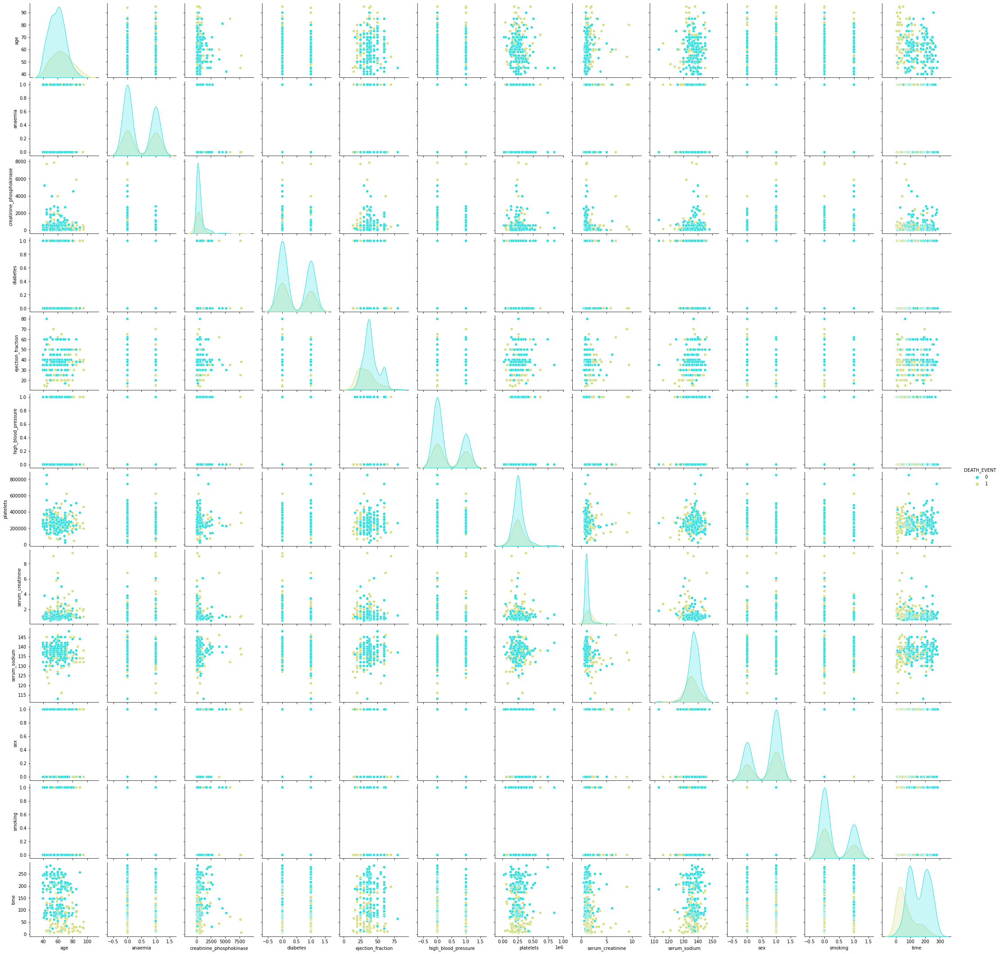

In [6]:
sns.pairplot(df, hue = 'DEATH_EVENT', palette='rainbow')
plt.show()

In [6]:
numeric = ['age', 'creatinine_phosphokinase', 
           'ejection_fraction', 'platelets', 
           'serum_creatinine', 'time', 'serum_sodium']

## Gender Analysis:
Now we will see the relation between the gender of the patients and the values other attributes like Age, Platelets, Ceratinine Phosphokinase etc.

In [7]:
fig = make_subplots(rows=2, cols=3, start_cell="top-left", subplot_titles=("Age","Creatinine Phosphokinase", "Platelets","Serum Creatinine","Serum Sodium","Time", "Diabetes"))
fig.add_trace(go.Box(y=df['age'], x=df['sex'],boxpoints='all', name='Age'), row=1, col=1)
fig.add_trace(go.Box(y=df['creatinine_phosphokinase'], x=df['sex'],boxpoints='all', name='Creatinine Phosphokinase'), row=1, col=2)
fig.add_trace(go.Box(y=df['platelets'], x=df['sex'],boxpoints='all', name='Platelets'), row=1, col=3)
fig.add_trace(go.Box(y=df['serum_creatinine'], x=df['sex'],boxpoints='all', name='Serum Creatinine'), row=2, col=1)
fig.add_trace(go.Box(y=df['serum_sodium'], x=df['sex'], boxpoints='all',name='Serum Sodium'), row=2, col=2)
fig.add_trace(go.Box(y=df['time'], x=df['sex'], boxpoints='all', name='Time'), row=2, col=3) 
fig.update_layout(height=1400, width=1000,showlegend=False)
fig.show()

**From the above graphs we can draw a few conclusions like:**
- The age of most females in our data lie between 50 and 67 whereas the age of most males lies between 52 and 70
- The majority of females have platelets in the range 223k and 318k (kilo platelets/mL) whereas majority of males have platelets in the range 211k and 295k(kilo platelets/mL)
- The Sodium Serum levels in females is in the range 135 and 140 (mEq/L) whereas in males it is 134 and 139 (mEq/L) which isn't a huge difference.
- The serum creatinine levels for both males and females also lie in a very similar range of about 0.9 and 1.4(mg/dL)
- The Creatinine Phosphokinase levels of both males and females lie in the range 115 and 582 (mcg/L)
- In conclusion most of the attributes for both males and females are very similar.

## Smoking Analysis:
**Now we will try to explore the data about the smokers and the non smokers from the dataset**

In [8]:
smoking = len(df[df['smoking']==1])
non_smoking = len(df)-smoking

print(smoking, non_smoking)

smoking_males = df[df["smoking"] == 1]
smoking_males = len(smoking_males[smoking_males['sex']==1])

smoking_females = df[df["smoking"] == 1]
smoking_females = len(smoking_females[smoking_females['sex']==0])

print(smoking_males, smoking_females)


non_smoking_males = df[df['smoking']==0]
non_smoking_males = len(non_smoking_males[non_smoking_males['sex']==1])

non_smoking_females = df[df['smoking']==0]
non_smoking_females = len(non_smoking_females[non_smoking_females['sex']==0])

print(non_smoking_males, non_smoking_females)

96 203
92 4
102 101


[]

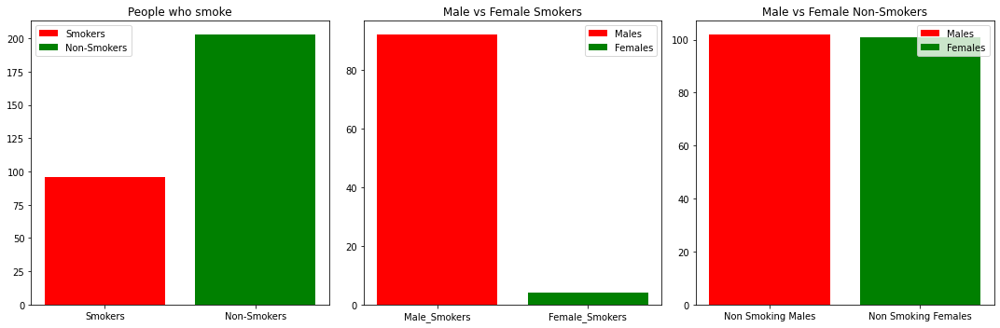

In [9]:
plt.figure(figsize=(15,5))

plt.subplot(1,3,1)
plt.bar(x=["Smokers"], height = [smoking], label = 'Smokers', color = 'red')
plt.bar(x=["Non-Smokers"], height = [non_smoking], label = 'Non-Smokers', color = 'green')
plt.title("People who smoke")
plt.legend()
plt.tight_layout()
plt.plot()

plt.subplot(1,3,2)
plt.bar(x=["Male_Smokers"], height = [smoking_males], label = "Males", color = 'red')
plt.bar(x=["Female_Smokers"], height = [smoking_females], label = "Females", color = 'green')
plt.title("Male vs Female Smokers")
plt.legend()
plt.tight_layout()
plt.plot()

plt.subplot(1,3,3)
plt.bar(x=['Non Smoking Males'], height = [non_smoking_males], label = "Males", color = 'red')
plt.bar(x=["Non Smoking Females"], height = [non_smoking_females], label = "Females", color = 'green')
plt.title("Male vs Female Non-Smokers")
plt.legend()
plt.tight_layout()
plt.plot()

#### Graph 1:(Smokers vs Non-Smokers)
We can see that in our data set we have more non smokers than smokers. Now, let's explore some data on the smokers.
#### Graph 2: (Male vs Female) Smokers
In the second graph it is clearly visible that our data has very few female smokers and a lot of male smokers.
#### Graph 3: (Male vs Female) Non-Smokers
In the third graph it is seen that the number of male non-smokers and female non-smokers is quite similar.

**In conclusion we can say that the non-smokers are in majority with equal male and female distribution and the males dominate in the smoking zone with a few female smokers**

In [10]:
smokers_btwn_40_50 = df[df['smoking'] == 1]
smokers_btwn_40_50 = len(smokers_btwn_40_50[smokers_btwn_40_50['age']<50])
print(smokers_btwn_40_50)

smokers_btwn_50_60 = df[df['smoking'] == 1]
smokers_btwn_50_60 = smokers_btwn_50_60[50<=smokers_btwn_50_60['age']]
smokers_btwn_50_60 = len(smokers_btwn_50_60[smokers_btwn_50_60['age']<60])
print(smokers_btwn_50_60)

smokers_btwn_60_70 = df[df['smoking'] == 1]
smokers_btwn_60_70 = smokers_btwn_60_70[60<=smokers_btwn_60_70['age']]
smokers_btwn_60_70 = len(smokers_btwn_60_70[smokers_btwn_60_70['age']<70])
print(smokers_btwn_60_70)

smokers_above_70 = df[df['smoking'] == 1]
smokers_above_70 = len(smokers_above_70[70<=smokers_above_70['age']])
print(smokers_above_70)
len(df[df['smoking'] == 1])

11
29
29
27


96

[]

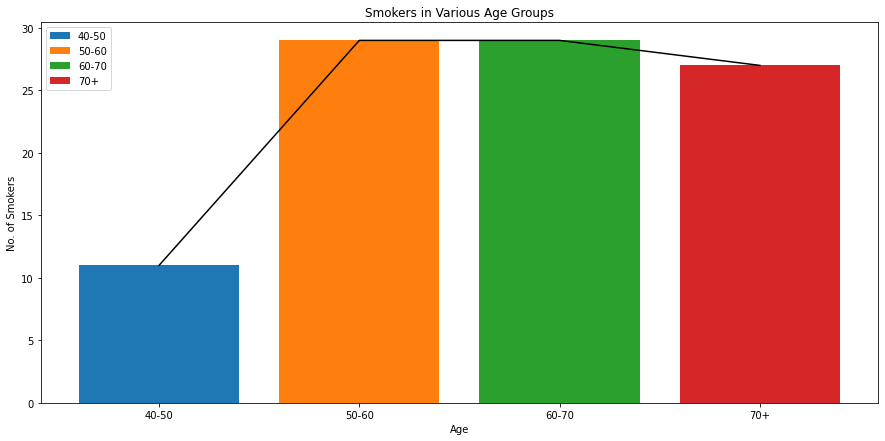

In [11]:
fig = plt.figure(figsize=(15,7))
plt.bar(x = ["40-50"], height = smokers_btwn_40_50, label = '40-50')
plt.bar(x = ["50-60"], height = smokers_btwn_50_60, label = '50-60')
plt.bar(x = ['60-70'], height = smokers_btwn_60_70, label = '60-70')
plt.bar(x = ['70+'], height =  smokers_above_70, label = '70+')
plt.title("Smokers in Various Age Groups")
plt.xlabel("Age")
plt.ylabel("No. of Smokers")
plt.legend()
plt.plot()

plt.plot([smokers_btwn_40_50, smokers_btwn_50_60, smokers_btwn_60_70, smokers_above_70], color = 'black')
plt.plot()

### The graph above depicts the distribution of smokers over different age groups:
**From the graph we can conclude that people with older age have a higher tendency of smoking and the people with age between age 40-50 have lower tendency of smoking.** 

### Plotting Histograms for Continuous Data:
**The ideal histogram should show a trend like a Bell Curve if any histogram has a positive or a negative skewed distribution we will try to fix that using some standard transformations.**

**Methods to fix skewness in data:**
- Right Skewed Data
    1. Square Root
    2. Cube Root
    3. Log
    4. Reciprocal
- Left Skewed Data
    1. Square
    2. Cube
    3. Higher Power

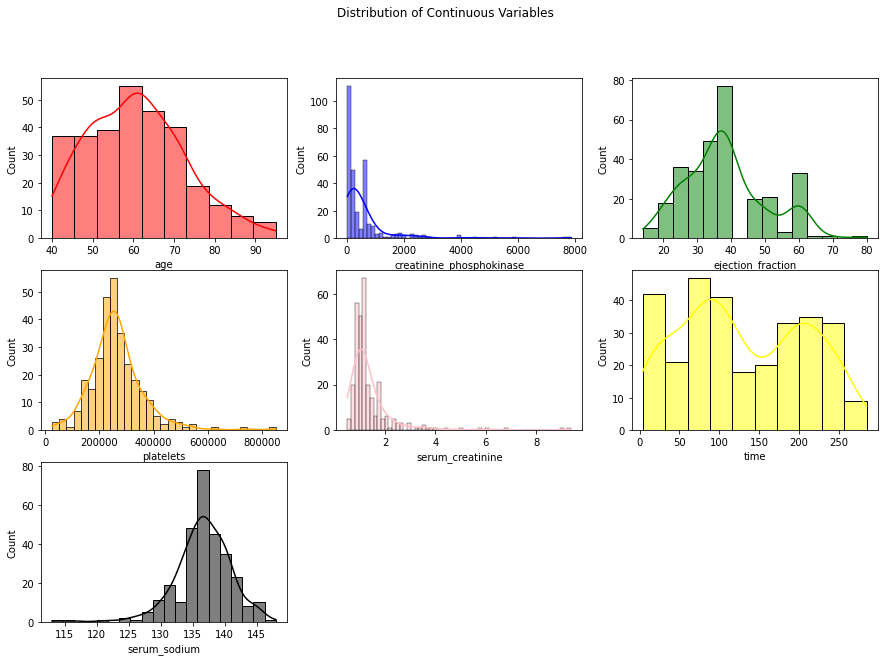

In [12]:
figure = plt.figure(figsize=(15, 10))
colors = ['red', 'blue', 'green', 'orange', 'pink', 'yellow', 'black']
plt.suptitle("Distribution of Continuous Variables")
for i in range(1, 8):
    plt.subplot(3,3,i)
    sns.histplot(df[numeric[i-1]], color = colors[i-1], kde=True)
    # plt.plot(df[numeric[i-1]])
    plt.xlabel(numeric[i-1])
    plt.plot()

**As we can see that the distribution of serum_creatinine and creatinine_phosphokinase show Right Skewness so we will try to fix this using our standard transformations here we will use the Leo-Johnson transformation method** 

In [13]:
from sklearn.preprocessing import PowerTransformer

t = np.array(list(df['creatinine_phosphokinase'])).reshape(-1, 1)
pt = PowerTransformer(method = "yeo-johnson")
creatinine_phosphokinase = pt.fit_transform(t)
df['creatinine_phosphokinase'] = creatinine_phosphokinase

t = np.array(list(df['serum_creatinine'])).reshape(-1, 1)
pt = PowerTransformer(method = "yeo-johnson")
serum_creatinine = pt.fit_transform(t)
df['serum_creatinine'] = serum_creatinine

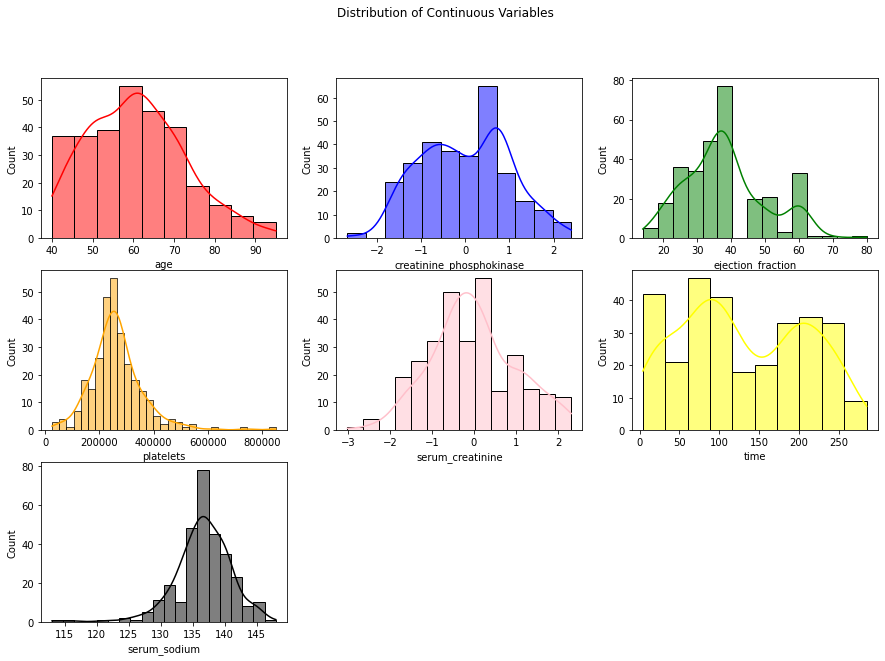

In [14]:
figure = plt.figure(figsize=(15, 10))
colors = ['red', 'blue', 'green', 'orange', 'pink', 'yellow', 'black']
plt.suptitle("Distribution of Continuous Variables")
for i in range(1, 8):
    plt.subplot(3,3,i)
    sns.histplot(df[numeric[i-1]], color = colors[i-1], kde=True)
    # plt.plot(df[numeric[i-1]])
    plt.xlabel(numeric[i-1])
    plt.plot()

**After doing the transformation we can now see that the data is distributed as per the Bell Curve so we can move forward**

### Scatter Plots:
Scatter plots to determine if there is any significant relation between the Age of the patients and all the other parameters we have in our dataset.

[]

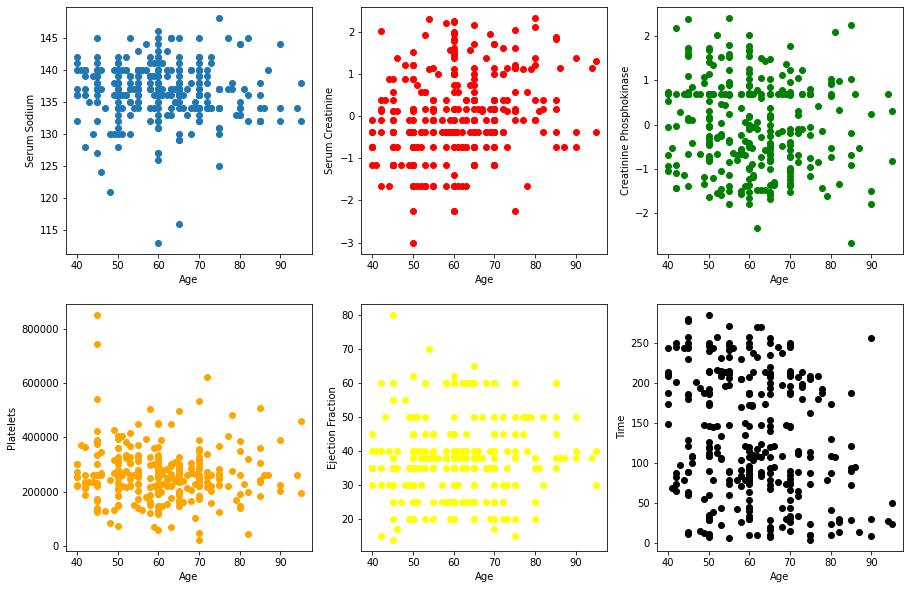

In [15]:
plt.figure(figsize=(15,10))

plt.subplot(2,3,1)
plt.scatter(x=df['age'], y=df['serum_sodium'])
plt.xlabel('Age')
plt.ylabel('Serum Sodium')
plt.plot()

plt.subplot(2,3,2)
plt.scatter(x=df['age'], y = df['serum_creatinine'], color='red')
plt.xlabel('Age')
plt.ylabel('Serum Creatinine')
plt.plot()

plt.subplot(2,3,3)
plt.scatter(x=df['age'], y = df['creatinine_phosphokinase'], color = 'green')
plt.xlabel('Age')
plt.ylabel('Creatinine Phosphokinase')
plt.plot()

plt.subplot(2,3,4)
plt.scatter(x=df['age'], y = df['platelets'], color = 'orange')
plt.xlabel('Age')
plt.ylabel('Platelets')
plt.plot()

plt.subplot(2,3,5)
plt.scatter(x=df['age'], y = df['ejection_fraction'], color = 'yellow')
plt.xlabel('Age')
plt.ylabel('Ejection Fraction')
plt.plot()

plt.subplot(2,3,6)
plt.scatter(x=df['age'], y = df['time'], color = 'black')
plt.xlabel('Age')
plt.ylabel('Time')
plt.plot()

**The scatter plots above do not show any significant trend between Age of the patient and the other quantities, the data is randomly distributed all over the plane.** 

### HeatMap:
- Using the heat map we will determine if there is any significant relation between any of the continuous variables and if any significant relation is found we will drop of othe two related quantities.

- In the heat map below  we can see that there is no significant relation between any of the continuous variables so we can move forward without dropping any columns.

<AxesSubplot:>

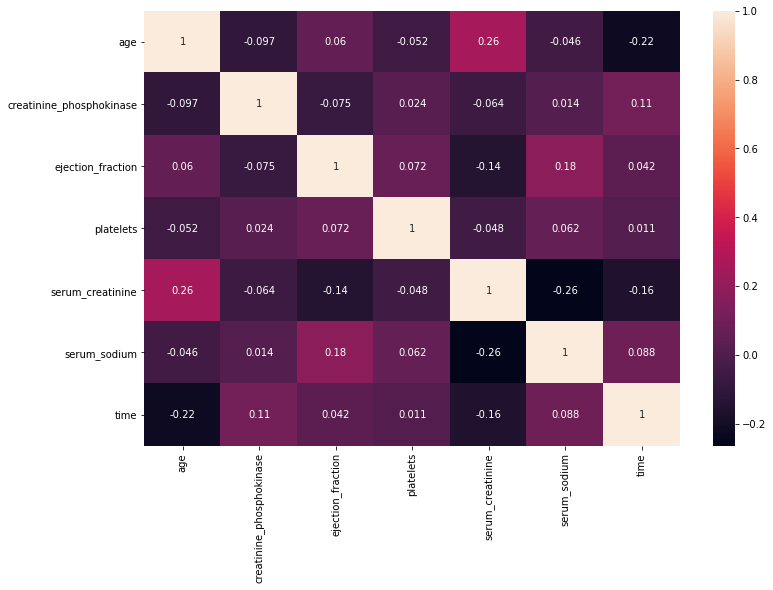

In [16]:
df_heatmap = df.drop(columns=['anaemia', 'diabetes', 'high_blood_pressure', 'sex', 'smoking', 'DEATH_EVENT'])
fig = plt.figure(figsize=(12,8))
sns.heatmap(df_heatmap.corr(), annot = True)

## Relation between Categorical and Continuous Data & Relation between Categorical Data:

For this we will use the chi square test, t-test, p-test, anova test
- chi square test: categorical vs categorical
- t-test: continuous & continuous vs categorical


In [17]:
from sklearn.feature_selection import chi2

categorical_data = ['anaemia',
                     'diabetes',
                     'high_blood_pressure',
                     'sex',
                     'smoking',
                     'DEATH_EVENT']
test_df = df.drop(columns=numeric)
test_df.head()


,anaemia,diabetes,high_blood_pressure,sex,smoking,DEATH_EVENT
0,0,0,1,1,0,1
1,0,0,0,1,0,1
2,0,0,0,1,1,1
3,1,0,0,1,0,1
4,1,1,0,0,0,1


## Chi2 Test:

### Hypothesis:
- Ho = The feature and Target variable have no relation
- Alternate Hypothesis = The feature and the Target variable are closely related.

We will calculate the p-value for each feature our threshold will be 0.05, if any p-value is less than 0.05 we will reject our null hypothesis and accept the alternate hypothesis.

First we will perform the chi2 test for independent variables and the between the independent and target variable.

### Chi2 Test between Independent Variables:

In [18]:
# anaemia vs other independent features ('diaetes', 'high_blood_pressure', 'sex', 'smoking')

dict1 = dict()
independent = ('diabetes', 'high_blood_pressure', 'sex', 'smoking')
chi2_val, p_val = chi2(test_df.iloc[:, 1:5], test_df.iloc[:, 0])

itr = 0
for i in independent:
    string = f'anaemia vs {i}'
    dict1[string] = p_val[itr]
    itr += 1

# dict1

In [19]:
# smoking vs other independent features ('diaetes', 'high_blood_pressure', 'sex')

dict2 = dict()
independent = ('diaetes', 'high_blood_pressure', 'sex')
chi2_val, p_val = chi2(test_df.iloc[:, 1:4], test_df.iloc[:, 4])

itr = 0
for i in independent:
    string = f'smoking vs {i}'
    dict2[string] = p_val[itr]
    itr += 1

# dict2

In [20]:
# diabetes vs other independent features ('high_blood_pressure', 'sex')

dict3 = dict()
independent = ('high_blood_pressure', 'sex')
chi2_val, p_val = chi2(test_df.iloc[:, 2:4], test_df.iloc[:, 1])

itr = 0
for i in independent:
    string = f'diabetes vs {i}'
    dict3[string] = p_val[itr]
    itr += 1

# dict3

In [21]:
# high_blood_pressure vs sex

dict4 = dict()
independent = ['sex']
chi2_val, p_val = chi2(test_df.iloc[:, 3:4], test_df.iloc[:, 2])

itr = 0
for i in independent:
    string = f'high_blood_pressure vs {i}'
    dict4[string] = p_val[itr]

# dict4

In [22]:
# Summarizing the Results:

dict_names = [dict1, dict2, dict3, dict4]
for i in range(0, 4):
    dictionary = dict_names[i]
    for key, value in dictionary.items():
        print(f'{key}: {value}')

anaemia vs diabetes: 0.8666559347273115
anaemia vs high_blood_pressure: 0.594854992140792
anaemia vs sex: 0.3315020306255289
anaemia vs smoking: 0.1263525006678854
smoking vs diaetes: 0.05221575927284853
smoking vs high_blood_pressure: 0.43776694989237386
smoking vs sex: 4.899856713610256e-06
diabetes vs high_blood_pressure: 0.8592401113570308
diabetes vs sex: 0.10604103630413232
high_blood_pressure vs sex: 0.28372858577976934


### Chi2 Test between Independent Variables and Target Variables:

In [23]:
# independent features vs Target Variable

dict5 = dict()
independent = ('anaemia', 'diabetes', 'high_blood_pressure', 'sex', 'smoking')
chi2_val, p_val = chi2(test_df.iloc[:, 0:5], test_df.iloc[:, -1])

itr = 0
for i in independent:
    string = f'DEATH_EVENT vs {i}'
    dict5[string] = p_val[itr]
    itr += 1
    
dict5

{'DEATH_EVENT vs anaemia': 0.387556924759485,
 'DEATH_EVENT vs diabetes': 0.9795537403764981,
 'DEATH_EVENT vs high_blood_pressure': 0.2690589262568509,
 'DEATH_EVENT vs sex': 0.9647213115147079,
 'DEATH_EVENT vs smoking': 0.8572685693681174}

In [24]:
heat_plot = [[1,0.8666559347273115,0.594854992140792,0.3315020306255289,0.1263525006678854,0.387556924759485],
            [0.8666559347273115,1,0.8592401113570308,0.10604103630413232,0.05221575927284853,0.9795537403764981],
            [0.594854992140792,0.8592401113570308,1,0.28372858577976934,0.43776694989237386,0.2690589262568509],
            [0.3315020306255289,0.10604103630413232,0.28372858577976934,1,.0004899856713610,0.9647213115147079],
            [0.1263525006678854,0.05221575927284853,0.43776694989237386,.0004899856713610,1,0.8572685693681174],
            [0.387556924759485,0.9795537403764981,0.2690589262568509,0.9647213115147079,0.8572685693681174,1]]

categorical_data = ['anaemia',
                     'diabetes',
                     'high_bp',
                     'sex',
                     'smoking',
                     'DEATH_EVENT']

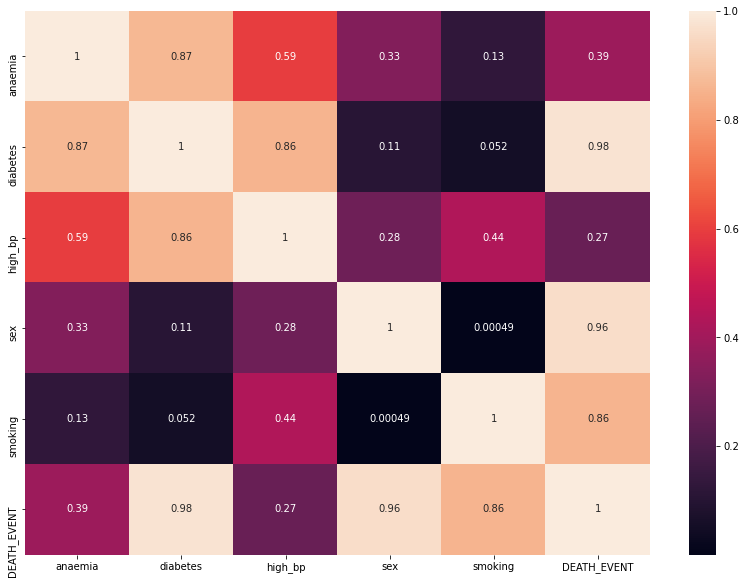

In [25]:
fig = plt.figure(figsize=(14, 10))
sns.heatmap(heat_plot, annot = True)
plt.xticks([i+0.5 for i in range(6)], categorical_data)
plt.yticks([i+0.5 for i in range(6)], categorical_data)
plt.show()

## Results of Chi2 Test:

- Ho = The variables are not related (p_val > 0.05)
- H1 = The variables are related (p_val < 0.05)

1. DEATH_EVENT our target variable shows no significant relation with any of the other variables.
2. SEX and SMOKING share a very strong relation this result was expected considering the earlier observations.
3. SMOKING and DIABETES also share a strong relation.

### Conclusion:

**None of the categorical variables share a strong relation with the target variable but there are some independent variable which are closely related so we will probably drop one of those variables to avoid a bias** 

In [17]:
df.drop(columns = ['sex', 'diabetes'], inplace = True)

In [43]:
X = df.iloc[:, 0:10].values
Y = df['DEATH_EVENT'].values

## Spliting Data into Train and Test Data:
- We will be splitting our data in ratio of 9:1 out of which 90% would be training data and 10% would be testing data. to do this we will use the **train_test_split module**.
- To evalute the performance of the models we will consider the mean square error and the **f1-score**. 
- We will also include the **GridSearchCV** for Hyper Parameter Tuning here 

In [44]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import f1_score
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import learning_curve

x_train, x_test, y_train, y_test = train_test_split(X, Y, test_size=0.1, random_state=6)

## Model Training Testing and Selection:

We will be using a blend of typical classification models and Ensemble based classification models to solve this problem.

Models that we will use:
1. Logistic Regression
2. Decision Tree
3. Random Forest
4. Bagging Classifier
5. GradientBoosting Classifier
6. XGBoost
7. XGBRFClassifier
8. Extra Trees Classifier
9. KNearestNeighbors
10. CatBoostClassifier

After training and testing the models we will aslo study the feature importance for the models and try hyper parameter tuning where ever possible.

**Out of all these models we will select the top 5 models based on the F1-Scores and the create a final Aggregator function which will make the final prediction**

## Logistic Regression:
Even after trying hyper paramenter tuning we were getting similar results so we decided not to use hyper parameter tuning here.

**Final Reults:**
  - Train Accuracy:  0.8215613382899628
  - Test Accuracy:  0.9
  - F1 score Test:  0.8571428571428572

In [45]:
from sklearn.linear_model import LogisticRegression

lr = LogisticRegression(C=0.01)
lr.fit(x_train, y_train)
predict = lr.predict(x_test)

print("Train Accuracy: ",lr.score(x_train, y_train))
print("Test Accuracy: ", lr.score(x_test, y_test))
print("F1 score Test: ", f1_score(predict, y_test))

Train Accuracy:  0.8215613382899628
Test Accuracy:  0.9
F1 score Test:  0.8571428571428572


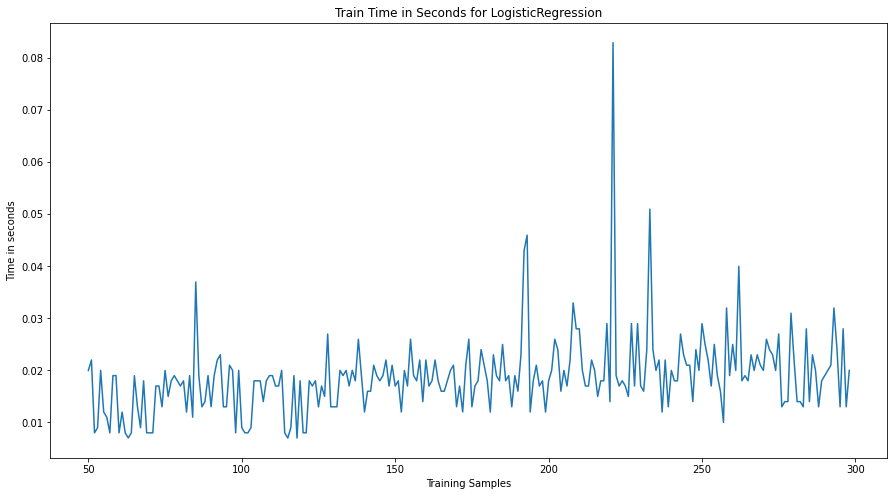

In [57]:
import time

def train_time(clf, X, Y, title):
    time_arr = []
    samples = [i for i in range(50, 299)]
    for i in range(len(samples)):
        x = X[:samples[i]]
        y = Y[:samples[i]]
        start_time = time.time()
        clf.fit(x,y)
        end_time = time.time()
        time_arr.append(end_time-start_time)
        
    fig = plt.figure(figsize=(15,8))
    
    plt.plot(time_arr)
    plt.title(title)
    plt.xlabel("Training Samples")
    plt.ylabel("Time in seconds")
    plt.xticks([i for i in range(0, 251, 50)], [i+50 for i in range(0, 251, 50)])


train_time(LogisticRegression(max_iter=1500), X, Y, "Train Time in Seconds for LogisticRegression")

## Decision Tree:

We got pretty good result using the decision tree it was found that the most important features according to the decision tree were:
1. Time
2. Serum Ceratinine
3. Ceratinine Phosphokinase

The parameter values suggested by hyper paratmeter tuning were the same as before.

**Final Reults:**
  - Train Accuracy:  1.0
  - Test Accuracy:  0.9666666666666667
  - F1 score Test:  0.9523809523809523

In [58]:
from sklearn.tree import DecisionTreeClassifier

dclf = DecisionTreeClassifier()
dclf.fit(x_train, y_train)
predict = dclf.predict(x_test)

print("Train Accuracy: ",dclf.score(x_train, y_train))
print("Test Accuracy: ", dclf.score(x_test, y_test))
print("F1 score Test: ", f1_score(predict, y_test))

c:\users\hp\appdata\local\programs\python\python37\lib\importlib\_bootstrap.py:219: RuntimeWarning:

numpy.ufunc size changed, may indicate binary incompatibility. Expected 192 from C header, got 216 from PyObject

c:\users\hp\appdata\local\programs\python\python37\lib\importlib\_bootstrap.py:219: RuntimeWarning:

numpy.ufunc size changed, may indicate binary incompatibility. Expected 192 from C header, got 216 from PyObject



Train Accuracy:  1.0
Test Accuracy:  0.9
F1 score Test:  0.8695652173913043


### Feature Importance Decision Tree Classifier:

<AxesSubplot:>

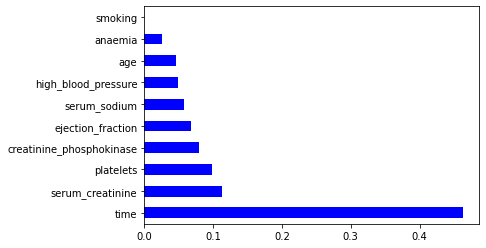

In [59]:
feature_imp = pd.Series(dclf.feature_importances_, index = list(df.columns)[:10])
feature_imp.nlargest(10).plot(kind = 'barh', cmap = 'winter')

### Hyper Parameter Tuning Decision Tree Classifier

In [32]:
dclf.get_params().keys()

dict_keys(['ccp_alpha', 'class_weight', 'criterion', 'max_depth', 'max_features', 'max_leaf_nodes', 'min_impurity_decrease', 'min_impurity_split', 'min_samples_leaf', 'min_samples_split', 'min_weight_fraction_leaf', 'presort', 'random_state', 'splitter'])

In [77]:
grid ={
    'max_depth':[i for i in range(14,30)],
    'criterion':['gini', 'entropy']
}

clf = GridSearchCV(dclf, grid)
clf.fit(X, Y)
clf.best_params_

{'criterion': 'gini', 'max_depth': 15}

In [60]:
dclf = DecisionTreeClassifier(criterion='gini', 
                              max_depth= 14,
                            )
dclf.fit(x_train, y_train)
predict = dclf.predict(x_test)

print("Train Accuracy: ",dclf.score(x_train, y_train))
print("Test Accuracy: ", dclf.score(x_test, y_test))
print("F1 score Test: ", f1_score(predict, y_test))

Train Accuracy:  1.0
Test Accuracy:  0.9666666666666667
F1 score Test:  0.9523809523809523


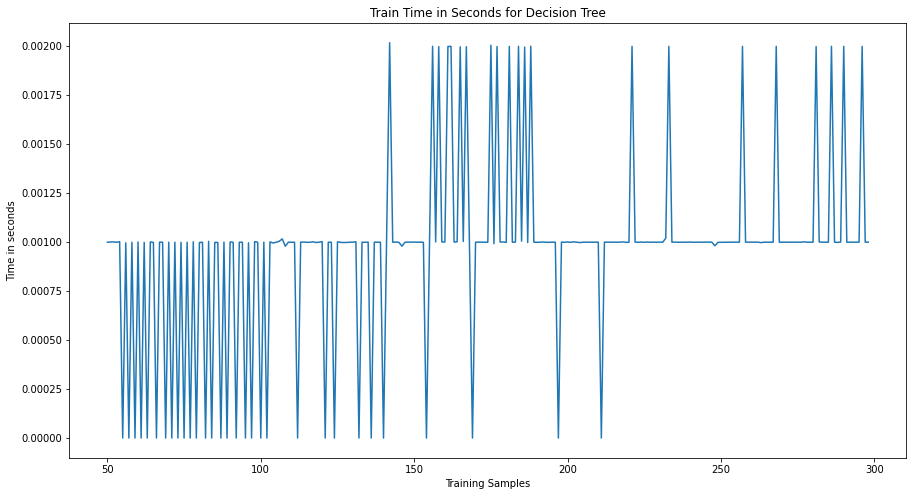

In [62]:
train_time(DecisionTreeClassifier(criterion='gini', max_depth= 14), X, Y, "Train Time in Seconds for Decision Tree")

### Decision Tree Visualization:

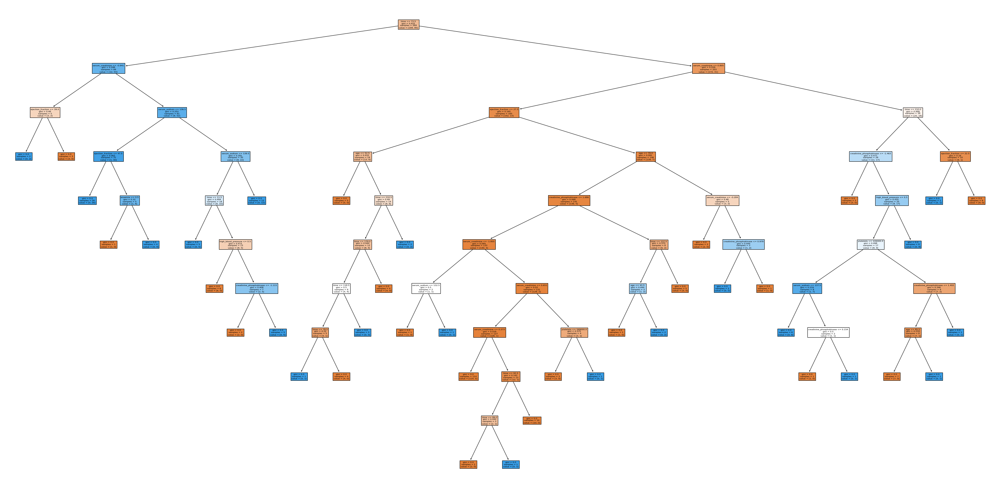

In [78]:
from sklearn import tree
figure = plt.figure(figsize=(50, 25))
t = tree.plot_tree(dclf, 
                   feature_names=list(df.columns)[:12],  
                   
                   filled=True)

## Random Forest:

<img src="RandomForest.ppm" alt="Bagging Classifier" style="height: 400px; width:400px;"/>

We got pretty good result using the Random Forest too, it was found that the most important features according to the Random Forest were:
1. Time
2. Serum Ceratinine
3. Ejection Fraction

The parameter values suggested by hyper paratmeter tuning were the same as before.

**Final Reults:**
  - Train Accuracy:  1.0
  - Test Accuracy:  0.9333333333333333
  - F1 score Test:  0.9090909090909091

In [64]:
from sklearn.ensemble import RandomForestClassifier

rclf = RandomForestClassifier()
rclf.fit(x_train, y_train)
predict = rclf.predict(x_test)
print("Train Accuracy: ",rclf.score(x_train, y_train))
print("Test Accuracy: ", rclf.score(x_test, y_test))
print("F1 score Test: ", f1_score(predict, y_test))

c:\users\hp\appdata\local\programs\python\python37\lib\importlib\_bootstrap.py:219: RuntimeWarning:

numpy.ufunc size changed, may indicate binary incompatibility. Expected 192 from C header, got 216 from PyObject



Train Accuracy:  1.0
Test Accuracy:  0.9
F1 score Test:  0.8695652173913043


### Feature Importance Random Forest Classifier:

<AxesSubplot:>

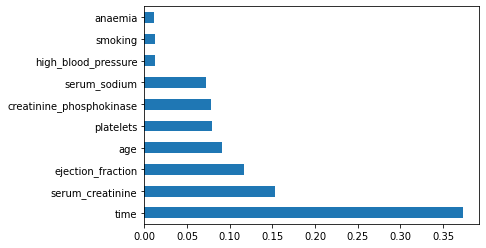

In [88]:
feature_imp = pd.Series(rclf.feature_importances_, index = list(df.columns)[:10])
feature_imp.nlargest(10).plot(kind = 'barh')

### Hyper Parameter Tuning Random Forest Classifier:

In [31]:
rclf.get_params().keys()

dict_keys(['bootstrap', 'ccp_alpha', 'class_weight', 'criterion', 'max_depth', 'max_features', 'max_leaf_nodes', 'max_samples', 'min_impurity_decrease', 'min_impurity_split', 'min_samples_leaf', 'min_samples_split', 'min_weight_fraction_leaf', 'n_estimators', 'n_jobs', 'oob_score', 'random_state', 'verbose', 'warm_start'])

In [75]:
grid={
    'max_depth':[i for i in range(12, 30)],
    'n_estimators':[i for i in range(50, 150)],
    'criterion':['gini', 'entropy']
}

clf = GridSearchCV(rclf, grid)
clf.fit(X, Y)
clf.best_params_

{'criterion': 'gini', 'max_depth': 16, 'n_estimators': 82}

In [91]:
rclf = RandomForestClassifier(criterion = 'gini',
                              max_depth = 16,
                              n_estimators = 82)
rclf.fit(x_train, y_train)
predict = rclf.predict(x_test)

print("Train Accuracy: ",rclf.score(x_train, y_train))
print("Test Accuracy: ", rclf.score(x_test, y_test))
print("F1 score Test: ", f1_score(predict, y_test))

Train Accuracy:  1.0
Test Accuracy:  0.9333333333333333
F1 score Test:  0.9090909090909091


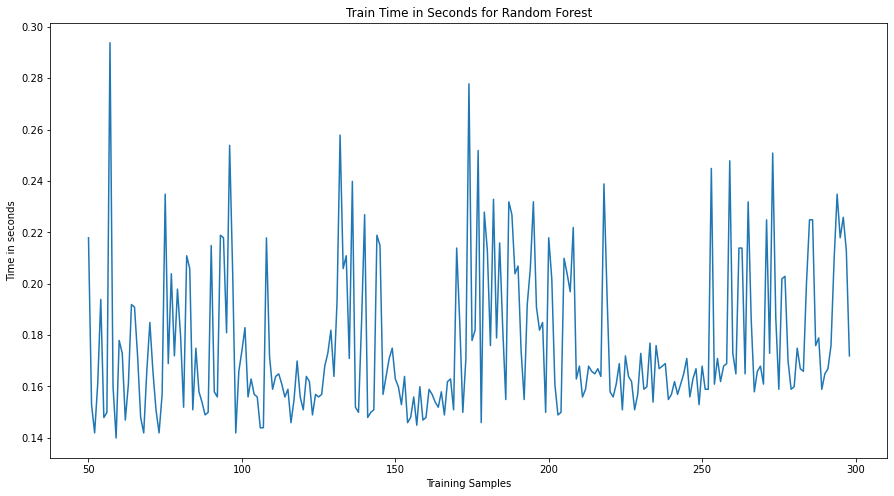

In [69]:
train_time(RandomForestClassifier(criterion='gini', max_depth= 16), X, Y, "Train Time in Seconds for Random Forest")

## Bagging Classifier:

Bagging = Bootstrapping + Aggregator
- **Bootstrapping**: Means that trains the model on random chunks of data, once a sample data is used the same data can be a part of multiple chunks.
- **Aggregator**:    Function which considers output of all the models and return the majority decision.

<img src="BaggingClassifier.png" alt="Bagging Classifier" style="height: 400px; width:400px;"/>

We got pretty good result using the Bagging Classifier too.

The parameter values suggested by hyper paratmeter tuning were the same as before.

**Final Reults:**
  - Train Accuracy:  0.992595167286245
  - Test Accuracy:  0.9333333333333333
  - F1 score Test:  0.9090909090909091

In [67]:
from sklearn.ensemble import BaggingClassifier

bclf = BaggingClassifier()
bclf.fit(x_train, y_train)
predict = bclf.predict(x_test)
print("Train Accuracy: ",bclf.score(x_train, y_train))
print("Test Accuracy: ", bclf.score(x_test, y_test))
print("F1 score Test: ", f1_score(predict, y_test))

Train Accuracy:  0.9851301115241635
Test Accuracy:  0.9333333333333333
F1 score Test:  0.9090909090909091


### Hyper Parameter Tuning for Bagging Classifier:

In [95]:
bclf.get_params().keys()

dict_keys(['base_estimator', 'bootstrap', 'bootstrap_features', 'max_features', 'max_samples', 'n_estimators', 'n_jobs', 'oob_score', 'random_state', 'verbose', 'warm_start'])

In [82]:
grid = {
    'base_estimator':[DecisionTreeClassifier(), RandomForestClassifier(), XGBClassifier()],
    'n_estimators':[i for i in range(20, 50)]
}

clf = GridSearchCV(bclf, grid)
clf.fit(X, Y)
clf.best_params_

{'base_estimator': RandomForestClassifier(), 'n_estimators': 34}

In [95]:
bclf = BaggingClassifier(base_estimator = RandomForestClassifier(),
                         n_estimators = 34)
bclf.fit(x_train, y_train)
predict = bclf.predict(x_test)

print("Train Accuracy: ",bclf.score(x_train, y_train))
print("Test Accuracy: ", bclf.score(x_test, y_test))
print("F1 score Test: ", f1_score(predict, y_test))

Train Accuracy:  0.9776951672862454
Test Accuracy:  0.9333333333333333
F1 score Test:  0.9090909090909091


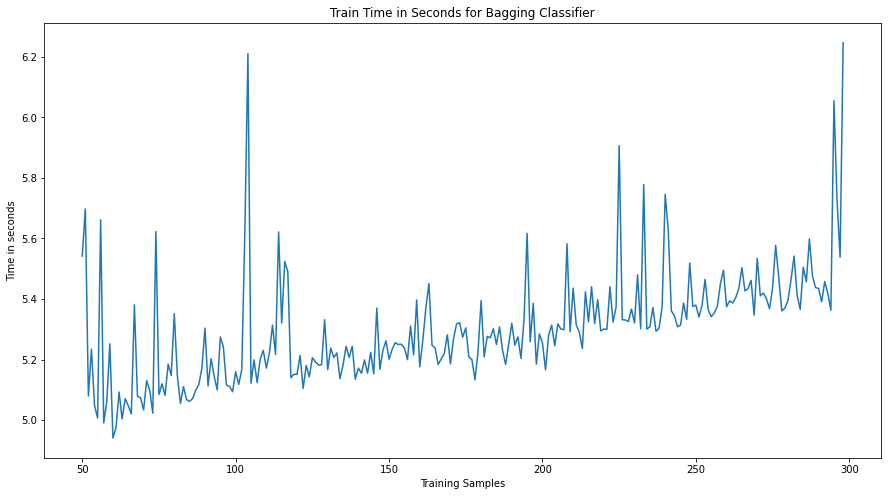

In [68]:
train_time(BaggingClassifier(base_estimator = RandomForestClassifier(),
                         n_estimators = 34), X, Y, "Train Time in Seconds for Bagging Classifier")

## Gradient Boosting:

Gradient Boosting is a ensemble earning method in which the residual or loss of the previously misclassified samples is passed on to the next model in order to optimize the results.

For Example if our model will first get trained on some data during this a Loss function there will be optimized but will be some misclassified samples these residual values will be passed on to the model in the next iteration and the model will try to minimize the loss.

<img src="GradientBoosting.jfif" alt="Bagging Classifier" style="height: 300px; width:400px;"/>

We got a good result using the Gradient Boosting too, it was found that the most important features according to the GradientBoostingClassifier were:
1. Time
2. Serum Ceratinine
3. Ejection Fraction

**Final Reults:**
  - Train Accuracy:  0.9962825278810409
  - Test Accuracy:  0.9
  - F1 score Test:  0.8695652173913043

In [71]:
from sklearn.ensemble import GradientBoostingClassifier

gclf = GradientBoostingClassifier()
gclf.fit(x_train, y_train)
predict = gclf.predict(x_test)

print("Train Accuracy: ",gclf.score(x_train, y_train))
print("Test Accuracy: ", gclf.score(x_test, y_test))
print("F1 score Test: ", f1_score(predict, y_test))

Train Accuracy:  0.9962825278810409
Test Accuracy:  0.9
F1 score Test:  0.8695652173913043


### Feature Importance of GradientBoosting Classifier:

<AxesSubplot:>

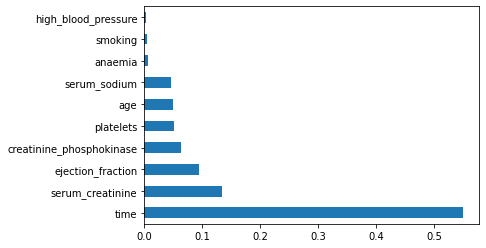

In [97]:
feature_imp = pd.Series(gclf.feature_importances_, index = list(df.columns)[:10])
feature_imp.nlargest(10).plot(kind = 'barh')

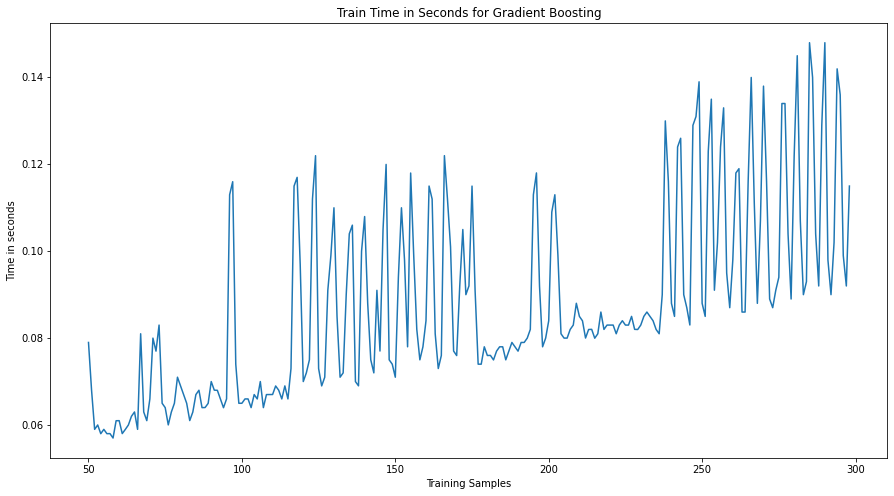

In [72]:
train_time(GradientBoostingClassifier(), X, Y, "Train Time in Seconds for Gradient Boosting")

## XGBoost Classifier:

XGBoost Classifier is very similar to GradientBoosting Classifier the only difference between the Gradient and Extreme Gradient Boosting is the Loss Function.
In XGBoost the Loss Function is a Double Derivative function where as in Gradient boosting a single derivative loss function is used.

We got pretty good result using the XGBoost too, it was found that the most important features according to the XGBoost were:
1. Time
2. Serum Ceratinine
3. Ejection Fraction

**Final Reults:**
  - Train Accuracy: 1.0
  - Test Accuracy:  0.9666666666666667
  - F1 score Test:  0.9523809523809523

In [74]:
from xgboost import XGBClassifier

xclf = XGBClassifier()
xclf.fit(x_train, y_train)
predict = xclf.predict(x_test)

print("Train Accuracy: ",xclf.score(x_train, y_train))
print("Test Accuracy: ", xclf.score(x_test, y_test))
print("F1 score Test: ", f1_score(predict, y_test))

Train Accuracy:  1.0
Test Accuracy:  0.9666666666666667
F1 score Test:  0.9523809523809523


### Feature Importance of XGBoost Classifier:

<AxesSubplot:>

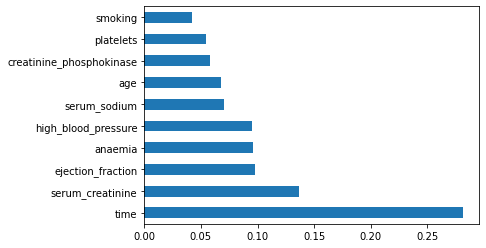

In [99]:
feature_imp = pd.Series(xclf.feature_importances_, index = list(df.columns)[:10])
feature_imp.nlargest(10).plot(kind = 'barh')

In [41]:
xclf.get_params().keys()

dict_keys(['objective', 'base_score', 'booster', 'colsample_bylevel', 'colsample_bynode', 'colsample_bytree', 'gamma', 'gpu_id', 'importance_type', 'interaction_constraints', 'learning_rate', 'max_delta_step', 'max_depth', 'min_child_weight', 'missing', 'monotone_constraints', 'n_estimators', 'n_jobs', 'num_parallel_tree', 'random_state', 'reg_alpha', 'reg_lambda', 'scale_pos_weight', 'subsample', 'tree_method', 'validate_parameters', 'verbosity'])

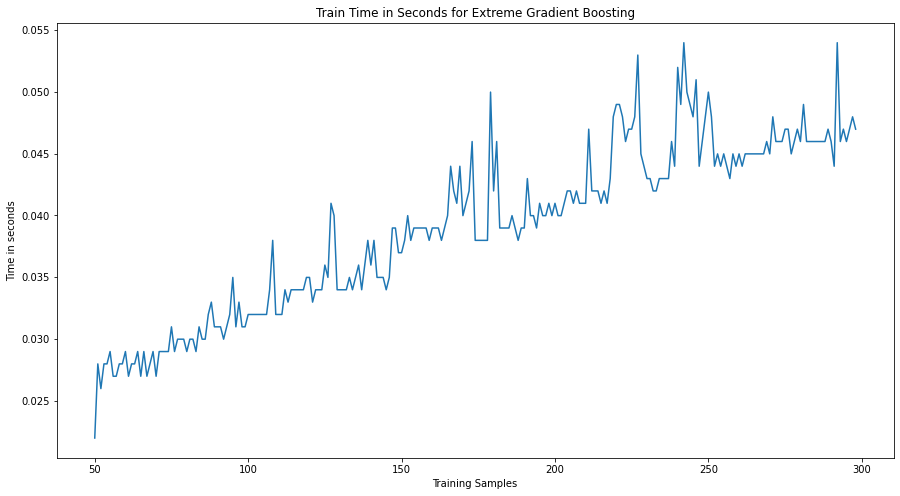

In [75]:
train_time(XGBClassifier(), X, Y, "Train Time in Seconds for Extreme Gradient Boosting")

## XGBRFClassifier:
It is similar to a Random Forest Classifier the only difference her ebeing that the Base Estimator is a XGBoost Classifier
instead of a Decision Tree.
So XGBRF is a Forest of XGBoost Classifiers.

We got a good result using XGBRFClassifier, it was found that the most important features according to the XGBRFClassifier 
were:
1. Time
2. Serum Ceratinine
3. Ejection Fraction

**Final Reults:**
  - Train Accuracy: 0.9442379182156134
  - Test Accuracy:  0.9333333333333333
  - F1 score Test:  0.9090909090909091


In [76]:
from xgboost import XGBRFClassifier

xrclf = XGBRFClassifier()
xrclf.fit(x_train, y_train)
predict = xrclf.predict(x_test)

print("Train Accuracy: ",xrclf.score(x_train, y_train))
print("Test Accuracy: ", xrclf.score(x_test, y_test))
print("F1 score Test: ", f1_score(predict, y_test))

Train Accuracy:  0.9442379182156134
Test Accuracy:  0.9333333333333333
F1 score Test:  0.9090909090909091


### Feature Importance of XGBRFClassifier:

<AxesSubplot:>

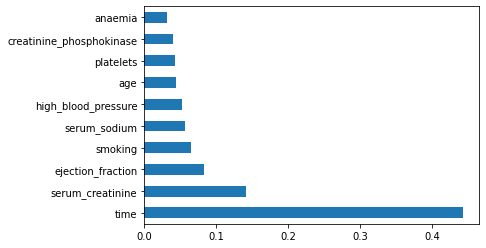

In [101]:
feature_imp = pd.Series(xrclf.feature_importances_, index = list(df.columns)[:10])
feature_imp.nlargest(10).plot(kind = 'barh')

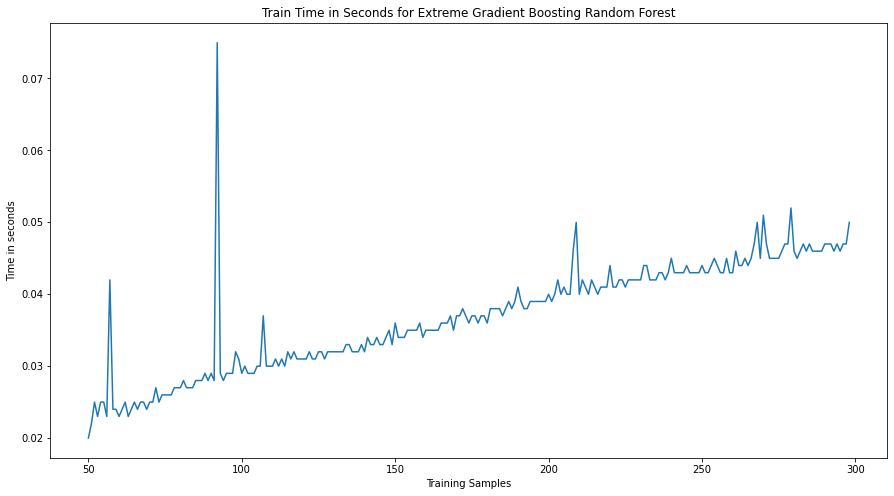

In [77]:
train_time(XGBRFClassifier(), X, Y, "Train Time in Seconds for Extreme Gradient Boosting Random Forest")

## Extra Trees Classifier:

Extra Trees Classifier is a type of ensemble learning technique which aggregates the results of multiple de-correlated 
decision trees collected in a “forest” to output it’s classification result. In concept, it is very similar to a Random Forest Classifier and only differs from it in the manner of construction of the decision trees in the forest.

Each Decision Tree in the Extra Trees Forest is constructed from the original training sample. Then, at each test node, 
Each tree is provided with a random sample of k features from the feature-set from which each decision tree must select the 
best feature to split the data based on some mathematical criteria (typically the Gini Index). 
This random sample of features leads to the creation of multiple de-correlated decision trees.

A satisfactory result was obtained using Extra Tree Classifier, it was also found that the most important features in Extra Tree Classifier were:
1. Time
2. Ejection Fraction
3. Serum Ceratinine

**Final Reults:**
  - Train Accuracy: 1.0
  - Test Accuracy:  0.9
  - F1 score Test:  0.8695652173913043

In [78]:
from sklearn.ensemble import ExtraTreesClassifier

eclf = ExtraTreesClassifier()
eclf.fit(x_train, y_train)
predict = eclf.predict(x_test)

print("Train Accuracy: ",eclf.score(x_train, y_train))
print("Test Accuracy: ", eclf.score(x_test, y_test))
print("F1 score Test: ", f1_score(predict, y_test))

Train Accuracy:  1.0
Test Accuracy:  0.8666666666666667
F1 score Test:  0.8181818181818182


### Feature Importance of ExtraTree Classifier:

<AxesSubplot:>

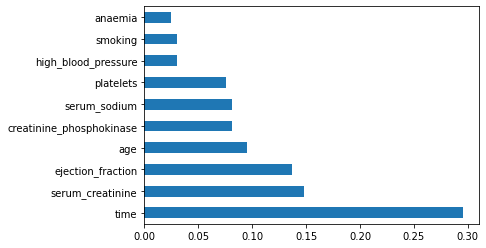

In [103]:
feature_imp = pd.Series(eclf.feature_importances_, index = list(df.columns)[:10])
feature_imp.nlargest(10).plot(kind = 'barh')

In [104]:
from sklearn.feature_selection import SelectFromModel

model = SelectFromModel(eclf, prefit = True)
X_new_train = model.transform(x_train)
X_new_test = model.transform(x_test)

In [105]:
eclf = ExtraTreesClassifier(n_estimators = 110, max_depth=14)
eclf.fit(X_new_train, y_train)
predict = eclf.predict(X_new_test)

print("Train Accuracy: ",eclf.score(X_new_train, y_train))
print("Test Accuracy: ", eclf.score(X_new_test, y_test))
print("F1 score Test: ", f1_score(predict, y_test))

Train Accuracy:  1.0
Test Accuracy:  0.9
F1 score Test:  0.8695652173913043


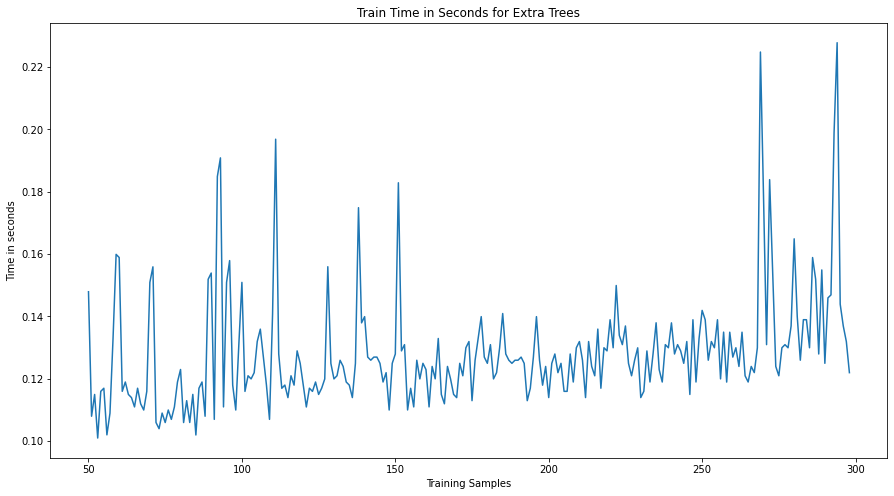

In [79]:
train_time(ExtraTreesClassifier(), X, Y, "Train Time in Seconds for Extra Trees")

## CatBoostClassifier

Advantages of CatBoost library are as follows:-

- **Performance:** CatBoost provides state of the art results and it is competitive with any leading machine learning algorithm on the performance front.

- **Handling Categorical features automatically:** We can use CatBoost without any explicit pre-processing to convert categories into numbers. CatBoost converts categorical values into numbers using various statistics on combinations of categorical features and combinations of categorical and numerical features.

- **Robust:** It reduces the need for extensive hyper-parameter tuning and lower the chances of overfitting also which leads to more generalized models. Although, CatBoost has multiple parameters to tune and it contains parameters like the number of trees, learning rate, regularization, tree depth, fold size, bagging temperature and others.

- **Easy-to-use:** We can use CatBoost from the command line, using an user-friendly API for both Python and R.

A good result was obtained using CatBoost Classifier, it was also found that the most important features in CatBoost Classifier were:

    1. Time
    2. Ejection Fraction
    3. Serum Ceratinine

**Final Reults:**

 - Train Accuracy: 1.0
 - Test Accuracy: 0.9333333333333333
 - F1 score Test: 0.9090909090909091

In [81]:
from catboost import CatBoostClassifier

catclf = CatBoostClassifier(learning_rate = 0.1,
                           depth = 7,
                           od_wait=200)
catclf.fit(x_train, y_train)
predict = catclf.predict(x_test)
print("Train Accuracy: ",catclf.score(x_train, y_train))
print("Test Accuracy: ", catclf.score(x_test, y_test))
print("F1 score Test: ", f1_score(predict, y_test))

0:	learn: 0.6107492	total: 166ms	remaining: 2m 45s
1:	learn: 0.5537767	total: 169ms	remaining: 1m 24s
2:	learn: 0.5026959	total: 171ms	remaining: 56.8s
3:	learn: 0.4645591	total: 173ms	remaining: 43.1s
4:	learn: 0.4267381	total: 175ms	remaining: 34.9s
5:	learn: 0.3874218	total: 178ms	remaining: 29.4s
6:	learn: 0.3612005	total: 180ms	remaining: 25.5s
7:	learn: 0.3422078	total: 182ms	remaining: 22.6s
8:	learn: 0.3214579	total: 185ms	remaining: 20.3s
9:	learn: 0.3048803	total: 187ms	remaining: 18.5s
10:	learn: 0.2877798	total: 189ms	remaining: 17s
11:	learn: 0.2734869	total: 192ms	remaining: 15.8s
12:	learn: 0.2608394	total: 194ms	remaining: 14.7s
13:	learn: 0.2500201	total: 196ms	remaining: 13.8s
14:	learn: 0.2451704	total: 199ms	remaining: 13s
15:	learn: 0.2365317	total: 201ms	remaining: 12.4s
16:	learn: 0.2252369	total: 204ms	remaining: 11.8s
17:	learn: 0.2206194	total: 207ms	remaining: 11.3s
18:	learn: 0.2120952	total: 209ms	remaining: 10.8s
19:	learn: 0.2053734	total: 212ms	remaining

206:	learn: 0.0094816	total: 648ms	remaining: 2.48s
207:	learn: 0.0094573	total: 651ms	remaining: 2.48s
208:	learn: 0.0093985	total: 653ms	remaining: 2.47s
209:	learn: 0.0093175	total: 655ms	remaining: 2.46s
210:	learn: 0.0092593	total: 657ms	remaining: 2.46s
211:	learn: 0.0091981	total: 659ms	remaining: 2.45s
212:	learn: 0.0091730	total: 662ms	remaining: 2.44s
213:	learn: 0.0090903	total: 664ms	remaining: 2.44s
214:	learn: 0.0090384	total: 667ms	remaining: 2.44s
215:	learn: 0.0089873	total: 669ms	remaining: 2.43s
216:	learn: 0.0089410	total: 672ms	remaining: 2.42s
217:	learn: 0.0088850	total: 674ms	remaining: 2.42s
218:	learn: 0.0088353	total: 677ms	remaining: 2.41s
219:	learn: 0.0087933	total: 680ms	remaining: 2.41s
220:	learn: 0.0087385	total: 682ms	remaining: 2.4s
221:	learn: 0.0086819	total: 685ms	remaining: 2.4s
222:	learn: 0.0086337	total: 688ms	remaining: 2.4s
223:	learn: 0.0085557	total: 690ms	remaining: 2.39s
224:	learn: 0.0085030	total: 693ms	remaining: 2.39s
225:	learn: 0.0

385:	learn: 0.0042272	total: 1.12s	remaining: 1.78s
386:	learn: 0.0042138	total: 1.12s	remaining: 1.78s
387:	learn: 0.0042037	total: 1.13s	remaining: 1.78s
388:	learn: 0.0041886	total: 1.13s	remaining: 1.77s
389:	learn: 0.0041748	total: 1.13s	remaining: 1.77s
390:	learn: 0.0041561	total: 1.14s	remaining: 1.77s
391:	learn: 0.0041440	total: 1.14s	remaining: 1.76s
392:	learn: 0.0041318	total: 1.14s	remaining: 1.76s
393:	learn: 0.0041205	total: 1.14s	remaining: 1.76s
394:	learn: 0.0041128	total: 1.15s	remaining: 1.75s
395:	learn: 0.0041001	total: 1.15s	remaining: 1.75s
396:	learn: 0.0040865	total: 1.15s	remaining: 1.75s
397:	learn: 0.0040710	total: 1.16s	remaining: 1.75s
398:	learn: 0.0040577	total: 1.16s	remaining: 1.74s
399:	learn: 0.0040452	total: 1.16s	remaining: 1.74s
400:	learn: 0.0040319	total: 1.16s	remaining: 1.74s
401:	learn: 0.0040194	total: 1.17s	remaining: 1.73s
402:	learn: 0.0040050	total: 1.17s	remaining: 1.73s
403:	learn: 0.0039857	total: 1.17s	remaining: 1.73s
404:	learn: 

585:	learn: 0.0025027	total: 1.6s	remaining: 1.13s
586:	learn: 0.0024974	total: 1.6s	remaining: 1.13s
587:	learn: 0.0024922	total: 1.61s	remaining: 1.13s
588:	learn: 0.0024876	total: 1.61s	remaining: 1.12s
589:	learn: 0.0024826	total: 1.61s	remaining: 1.12s
590:	learn: 0.0024778	total: 1.62s	remaining: 1.12s
591:	learn: 0.0024731	total: 1.62s	remaining: 1.12s
592:	learn: 0.0024671	total: 1.62s	remaining: 1.11s
593:	learn: 0.0024623	total: 1.63s	remaining: 1.11s
594:	learn: 0.0024587	total: 1.63s	remaining: 1.11s
595:	learn: 0.0024538	total: 1.63s	remaining: 1.1s
596:	learn: 0.0024457	total: 1.63s	remaining: 1.1s
597:	learn: 0.0024416	total: 1.64s	remaining: 1.1s
598:	learn: 0.0024345	total: 1.64s	remaining: 1.1s
599:	learn: 0.0024309	total: 1.64s	remaining: 1.09s
600:	learn: 0.0024243	total: 1.64s	remaining: 1.09s
601:	learn: 0.0024207	total: 1.65s	remaining: 1.09s
602:	learn: 0.0024159	total: 1.65s	remaining: 1.09s
603:	learn: 0.0024142	total: 1.65s	remaining: 1.08s
604:	learn: 0.0024

765:	learn: 0.0018905	total: 2.08s	remaining: 634ms
766:	learn: 0.0018875	total: 2.08s	remaining: 631ms
767:	learn: 0.0018849	total: 2.08s	remaining: 629ms
768:	learn: 0.0018812	total: 2.08s	remaining: 626ms
769:	learn: 0.0018787	total: 2.09s	remaining: 624ms
770:	learn: 0.0018746	total: 2.09s	remaining: 621ms
771:	learn: 0.0018715	total: 2.1s	remaining: 619ms
772:	learn: 0.0018683	total: 2.1s	remaining: 616ms
773:	learn: 0.0018655	total: 2.1s	remaining: 614ms
774:	learn: 0.0018627	total: 2.1s	remaining: 611ms
775:	learn: 0.0018608	total: 2.11s	remaining: 608ms
776:	learn: 0.0018583	total: 2.11s	remaining: 605ms
777:	learn: 0.0018556	total: 2.11s	remaining: 603ms
778:	learn: 0.0018522	total: 2.11s	remaining: 600ms
779:	learn: 0.0018503	total: 2.12s	remaining: 597ms
780:	learn: 0.0018502	total: 2.12s	remaining: 594ms
781:	learn: 0.0018467	total: 2.12s	remaining: 591ms
782:	learn: 0.0018441	total: 2.12s	remaining: 588ms
783:	learn: 0.0018408	total: 2.13s	remaining: 586ms
784:	learn: 0.00

961:	learn: 0.0015162	total: 2.55s	remaining: 101ms
962:	learn: 0.0015162	total: 2.56s	remaining: 98.2ms
963:	learn: 0.0015141	total: 2.56s	remaining: 95.6ms
964:	learn: 0.0015121	total: 2.56s	remaining: 92.9ms
965:	learn: 0.0015104	total: 2.56s	remaining: 90.3ms
966:	learn: 0.0015104	total: 2.57s	remaining: 87.6ms
967:	learn: 0.0015086	total: 2.57s	remaining: 85ms
968:	learn: 0.0015071	total: 2.57s	remaining: 82.3ms
969:	learn: 0.0015051	total: 2.58s	remaining: 79.7ms
970:	learn: 0.0015051	total: 2.58s	remaining: 77ms
971:	learn: 0.0015037	total: 2.58s	remaining: 74.4ms
972:	learn: 0.0015019	total: 2.58s	remaining: 71.7ms
973:	learn: 0.0015001	total: 2.59s	remaining: 69ms
974:	learn: 0.0014996	total: 2.59s	remaining: 66.4ms
975:	learn: 0.0014974	total: 2.59s	remaining: 63.7ms
976:	learn: 0.0014974	total: 2.59s	remaining: 61.1ms
977:	learn: 0.0014950	total: 2.6s	remaining: 58.4ms
978:	learn: 0.0014925	total: 2.6s	remaining: 55.8ms
979:	learn: 0.0014901	total: 2.6s	remaining: 53.1ms
980

<AxesSubplot:>

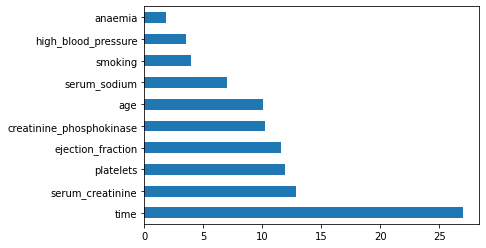

In [110]:
feature_imp = pd.Series(catclf.feature_importances_, index = list(df.columns)[:10])
feature_imp.nlargest(10).plot(kind = 'barh')

Learning rate set to 0.002867
0:	learn: 0.6909595	total: 1.04ms	remaining: 1.04s
1:	learn: 0.6883442	total: 1.96ms	remaining: 977ms
2:	learn: 0.6861037	total: 3ms	remaining: 997ms
3:	learn: 0.6839837	total: 4.26ms	remaining: 1.06s
4:	learn: 0.6819919	total: 5.39ms	remaining: 1.07s
5:	learn: 0.6799145	total: 6.64ms	remaining: 1.1s
6:	learn: 0.6780707	total: 7.64ms	remaining: 1.08s
7:	learn: 0.6762585	total: 8.69ms	remaining: 1.08s
8:	learn: 0.6740131	total: 9.82ms	remaining: 1.08s
9:	learn: 0.6715673	total: 11.1ms	remaining: 1.09s
10:	learn: 0.6695773	total: 11.9ms	remaining: 1.07s
11:	learn: 0.6676226	total: 12.9ms	remaining: 1.06s
12:	learn: 0.6654751	total: 14ms	remaining: 1.06s
13:	learn: 0.6635152	total: 15.2ms	remaining: 1.07s
14:	learn: 0.6614795	total: 16.2ms	remaining: 1.06s
15:	learn: 0.6595622	total: 17.4ms	remaining: 1.07s
16:	learn: 0.6568670	total: 18.3ms	remaining: 1.06s
17:	learn: 0.6546807	total: 19.4ms	remaining: 1.06s
18:	learn: 0.6526218	total: 20.6ms	remaining: 1.06

260:	learn: 0.3479519	total: 268ms	remaining: 760ms
261:	learn: 0.3472899	total: 270ms	remaining: 759ms
262:	learn: 0.3466198	total: 271ms	remaining: 759ms
263:	learn: 0.3454095	total: 272ms	remaining: 757ms
264:	learn: 0.3447514	total: 273ms	remaining: 756ms
265:	learn: 0.3440433	total: 274ms	remaining: 755ms
266:	learn: 0.3433971	total: 274ms	remaining: 754ms
267:	learn: 0.3425049	total: 276ms	remaining: 753ms
268:	learn: 0.3417759	total: 277ms	remaining: 752ms
269:	learn: 0.3410426	total: 278ms	remaining: 751ms
270:	learn: 0.3401897	total: 279ms	remaining: 749ms
271:	learn: 0.3394677	total: 279ms	remaining: 748ms
272:	learn: 0.3387852	total: 280ms	remaining: 747ms
273:	learn: 0.3380483	total: 281ms	remaining: 745ms
274:	learn: 0.3372804	total: 282ms	remaining: 743ms
275:	learn: 0.3364148	total: 283ms	remaining: 742ms
276:	learn: 0.3358127	total: 284ms	remaining: 741ms
277:	learn: 0.3349655	total: 285ms	remaining: 739ms
278:	learn: 0.3344316	total: 285ms	remaining: 737ms
279:	learn: 

420:	learn: 0.2531083	total: 414ms	remaining: 569ms
421:	learn: 0.2525855	total: 415ms	remaining: 568ms
422:	learn: 0.2522884	total: 416ms	remaining: 567ms
423:	learn: 0.2518517	total: 417ms	remaining: 566ms
424:	learn: 0.2513722	total: 418ms	remaining: 565ms
425:	learn: 0.2508553	total: 419ms	remaining: 564ms
426:	learn: 0.2503259	total: 420ms	remaining: 563ms
427:	learn: 0.2497507	total: 421ms	remaining: 563ms
428:	learn: 0.2492618	total: 422ms	remaining: 562ms
429:	learn: 0.2489891	total: 423ms	remaining: 561ms
430:	learn: 0.2484527	total: 424ms	remaining: 560ms
431:	learn: 0.2480310	total: 425ms	remaining: 558ms
432:	learn: 0.2475825	total: 426ms	remaining: 557ms
433:	learn: 0.2471482	total: 427ms	remaining: 556ms
434:	learn: 0.2467566	total: 427ms	remaining: 555ms
435:	learn: 0.2462919	total: 428ms	remaining: 554ms
436:	learn: 0.2459202	total: 429ms	remaining: 553ms
437:	learn: 0.2454501	total: 430ms	remaining: 552ms
438:	learn: 0.2449295	total: 431ms	remaining: 551ms
439:	learn: 

721:	learn: 0.1563643	total: 698ms	remaining: 269ms
722:	learn: 0.1561159	total: 699ms	remaining: 268ms
723:	learn: 0.1558736	total: 701ms	remaining: 267ms
724:	learn: 0.1556548	total: 702ms	remaining: 266ms
725:	learn: 0.1554163	total: 703ms	remaining: 265ms
726:	learn: 0.1551874	total: 704ms	remaining: 264ms
727:	learn: 0.1549386	total: 704ms	remaining: 263ms
728:	learn: 0.1547806	total: 705ms	remaining: 262ms
729:	learn: 0.1545811	total: 706ms	remaining: 261ms
730:	learn: 0.1542627	total: 707ms	remaining: 260ms
731:	learn: 0.1540536	total: 708ms	remaining: 259ms
732:	learn: 0.1538679	total: 709ms	remaining: 258ms
733:	learn: 0.1536468	total: 710ms	remaining: 257ms
734:	learn: 0.1534048	total: 712ms	remaining: 257ms
735:	learn: 0.1531977	total: 713ms	remaining: 256ms
736:	learn: 0.1529516	total: 714ms	remaining: 255ms
737:	learn: 0.1527109	total: 715ms	remaining: 254ms
738:	learn: 0.1525507	total: 716ms	remaining: 253ms
739:	learn: 0.1522907	total: 717ms	remaining: 252ms
740:	learn: 

0:	learn: 0.6909194	total: 1.06ms	remaining: 1.06s
1:	learn: 0.6882684	total: 2.03ms	remaining: 1.01s
2:	learn: 0.6859739	total: 2.95ms	remaining: 981ms
3:	learn: 0.6838137	total: 3.84ms	remaining: 957ms
4:	learn: 0.6817815	total: 4.77ms	remaining: 949ms
5:	learn: 0.6796689	total: 5.84ms	remaining: 967ms
6:	learn: 0.6777586	total: 6.77ms	remaining: 960ms
7:	learn: 0.6758898	total: 7.7ms	remaining: 955ms
8:	learn: 0.6736215	total: 8.62ms	remaining: 950ms
9:	learn: 0.6711277	total: 9.53ms	remaining: 943ms
10:	learn: 0.6690873	total: 10.2ms	remaining: 913ms
11:	learn: 0.6670951	total: 11.1ms	remaining: 912ms
12:	learn: 0.6649127	total: 12ms	remaining: 911ms
13:	learn: 0.6628934	total: 12.9ms	remaining: 910ms
14:	learn: 0.6607982	total: 13.9ms	remaining: 911ms
15:	learn: 0.6588131	total: 14.8ms	remaining: 909ms
16:	learn: 0.6560282	total: 15.4ms	remaining: 892ms
17:	learn: 0.6537675	total: 16.4ms	remaining: 893ms
18:	learn: 0.6516454	total: 17.6ms	remaining: 908ms
19:	learn: 0.6494788	tota

305:	learn: 0.3119099	total: 280ms	remaining: 635ms
306:	learn: 0.3111079	total: 281ms	remaining: 634ms
307:	learn: 0.3104208	total: 282ms	remaining: 633ms
308:	learn: 0.3098069	total: 283ms	remaining: 632ms
309:	learn: 0.3092666	total: 284ms	remaining: 632ms
310:	learn: 0.3087484	total: 285ms	remaining: 631ms
311:	learn: 0.3081899	total: 286ms	remaining: 630ms
312:	learn: 0.3075922	total: 287ms	remaining: 629ms
313:	learn: 0.3071083	total: 288ms	remaining: 628ms
314:	learn: 0.3066269	total: 288ms	remaining: 627ms
315:	learn: 0.3061768	total: 289ms	remaining: 626ms
316:	learn: 0.3055688	total: 290ms	remaining: 625ms
317:	learn: 0.3049375	total: 291ms	remaining: 624ms
318:	learn: 0.3044815	total: 292ms	remaining: 623ms
319:	learn: 0.3037655	total: 293ms	remaining: 622ms
320:	learn: 0.3031145	total: 294ms	remaining: 621ms
321:	learn: 0.3024227	total: 295ms	remaining: 621ms
322:	learn: 0.3018120	total: 296ms	remaining: 620ms
323:	learn: 0.3011836	total: 297ms	remaining: 619ms
324:	learn: 

465:	learn: 0.2294302	total: 424ms	remaining: 486ms
466:	learn: 0.2289510	total: 426ms	remaining: 486ms
467:	learn: 0.2286692	total: 427ms	remaining: 485ms
468:	learn: 0.2283256	total: 428ms	remaining: 484ms
469:	learn: 0.2278765	total: 429ms	remaining: 483ms
470:	learn: 0.2275066	total: 429ms	remaining: 482ms
471:	learn: 0.2271093	total: 431ms	remaining: 482ms
472:	learn: 0.2267515	total: 431ms	remaining: 480ms
473:	learn: 0.2262600	total: 432ms	remaining: 480ms
474:	learn: 0.2259593	total: 433ms	remaining: 479ms
475:	learn: 0.2256409	total: 434ms	remaining: 478ms
476:	learn: 0.2254125	total: 435ms	remaining: 477ms
477:	learn: 0.2250354	total: 436ms	remaining: 476ms
478:	learn: 0.2244090	total: 437ms	remaining: 475ms
479:	learn: 0.2239882	total: 438ms	remaining: 474ms
480:	learn: 0.2235319	total: 439ms	remaining: 473ms
481:	learn: 0.2232597	total: 440ms	remaining: 472ms
482:	learn: 0.2227391	total: 441ms	remaining: 472ms
483:	learn: 0.2223725	total: 442ms	remaining: 471ms
484:	learn: 

752:	learn: 0.1460923	total: 708ms	remaining: 232ms
753:	learn: 0.1458931	total: 709ms	remaining: 231ms
754:	learn: 0.1456577	total: 711ms	remaining: 231ms
755:	learn: 0.1454685	total: 712ms	remaining: 230ms
756:	learn: 0.1451338	total: 713ms	remaining: 229ms
757:	learn: 0.1449329	total: 714ms	remaining: 228ms
758:	learn: 0.1447363	total: 715ms	remaining: 227ms
759:	learn: 0.1444620	total: 716ms	remaining: 226ms
760:	learn: 0.1443058	total: 717ms	remaining: 225ms
761:	learn: 0.1441001	total: 718ms	remaining: 224ms
762:	learn: 0.1439352	total: 719ms	remaining: 223ms
763:	learn: 0.1437590	total: 720ms	remaining: 223ms
764:	learn: 0.1435656	total: 721ms	remaining: 222ms
765:	learn: 0.1433968	total: 723ms	remaining: 221ms
766:	learn: 0.1431861	total: 724ms	remaining: 220ms
767:	learn: 0.1430213	total: 725ms	remaining: 219ms
768:	learn: 0.1427882	total: 726ms	remaining: 218ms
769:	learn: 0.1425179	total: 728ms	remaining: 217ms
770:	learn: 0.1423352	total: 729ms	remaining: 216ms
771:	learn: 

Learning rate set to 0.002915
0:	learn: 0.6906611	total: 1.07ms	remaining: 1.07s
1:	learn: 0.6879406	total: 2.07ms	remaining: 1.03s
2:	learn: 0.6855966	total: 3.03ms	remaining: 1.01s
3:	learn: 0.6834001	total: 3.95ms	remaining: 984ms
4:	learn: 0.6811064	total: 4.53ms	remaining: 901ms
5:	learn: 0.6789492	total: 5.46ms	remaining: 905ms
6:	learn: 0.6768319	total: 6.4ms	remaining: 908ms
7:	learn: 0.6748152	total: 7.46ms	remaining: 925ms
8:	learn: 0.6731723	total: 8.62ms	remaining: 949ms
9:	learn: 0.6705233	total: 9.42ms	remaining: 932ms
10:	learn: 0.6684546	total: 10.4ms	remaining: 932ms
11:	learn: 0.6662438	total: 11.3ms	remaining: 933ms
12:	learn: 0.6639037	total: 12.3ms	remaining: 937ms
13:	learn: 0.6615954	total: 13ms	remaining: 914ms
14:	learn: 0.6593675	total: 13.9ms	remaining: 915ms
15:	learn: 0.6572397	total: 14.9ms	remaining: 918ms
16:	learn: 0.6550000	total: 15.9ms	remaining: 918ms
17:	learn: 0.6527332	total: 16.8ms	remaining: 919ms
18:	learn: 0.6508215	total: 17.8ms	remaining: 9

297:	learn: 0.3151099	total: 287ms	remaining: 676ms
298:	learn: 0.3144061	total: 288ms	remaining: 675ms
299:	learn: 0.3138381	total: 289ms	remaining: 675ms
300:	learn: 0.3130905	total: 291ms	remaining: 675ms
301:	learn: 0.3123921	total: 292ms	remaining: 675ms
302:	learn: 0.3115864	total: 293ms	remaining: 674ms
303:	learn: 0.3109034	total: 294ms	remaining: 673ms
304:	learn: 0.3103081	total: 295ms	remaining: 673ms
305:	learn: 0.3098083	total: 296ms	remaining: 672ms
306:	learn: 0.3092854	total: 297ms	remaining: 671ms
307:	learn: 0.3087359	total: 298ms	remaining: 670ms
308:	learn: 0.3081263	total: 300ms	remaining: 671ms
309:	learn: 0.3075517	total: 301ms	remaining: 670ms
310:	learn: 0.3070497	total: 302ms	remaining: 670ms
311:	learn: 0.3065240	total: 304ms	remaining: 669ms
312:	learn: 0.3059053	total: 304ms	remaining: 668ms
313:	learn: 0.3053839	total: 305ms	remaining: 667ms
314:	learn: 0.3049276	total: 307ms	remaining: 667ms
315:	learn: 0.3041393	total: 308ms	remaining: 666ms
316:	learn: 

598:	learn: 0.1836152	total: 576ms	remaining: 386ms
599:	learn: 0.1832246	total: 578ms	remaining: 385ms
600:	learn: 0.1828871	total: 579ms	remaining: 384ms
601:	learn: 0.1826587	total: 580ms	remaining: 383ms
602:	learn: 0.1823384	total: 581ms	remaining: 382ms
603:	learn: 0.1820918	total: 582ms	remaining: 381ms
604:	learn: 0.1818066	total: 583ms	remaining: 381ms
605:	learn: 0.1815393	total: 584ms	remaining: 380ms
606:	learn: 0.1813567	total: 585ms	remaining: 379ms
607:	learn: 0.1811259	total: 586ms	remaining: 378ms
608:	learn: 0.1807552	total: 587ms	remaining: 377ms
609:	learn: 0.1804332	total: 588ms	remaining: 376ms
610:	learn: 0.1801893	total: 589ms	remaining: 375ms
611:	learn: 0.1798502	total: 590ms	remaining: 374ms
612:	learn: 0.1795726	total: 591ms	remaining: 373ms
613:	learn: 0.1793854	total: 592ms	remaining: 372ms
614:	learn: 0.1790634	total: 593ms	remaining: 371ms
615:	learn: 0.1787571	total: 594ms	remaining: 370ms
616:	learn: 0.1784200	total: 596ms	remaining: 370ms
617:	learn: 

810:	learn: 0.1342779	total: 853ms	remaining: 199ms
811:	learn: 0.1340121	total: 854ms	remaining: 198ms
812:	learn: 0.1338244	total: 856ms	remaining: 197ms
813:	learn: 0.1336540	total: 858ms	remaining: 196ms
814:	learn: 0.1334331	total: 859ms	remaining: 195ms
815:	learn: 0.1332353	total: 860ms	remaining: 194ms
816:	learn: 0.1330928	total: 861ms	remaining: 193ms
817:	learn: 0.1329156	total: 862ms	remaining: 192ms
818:	learn: 0.1326219	total: 863ms	remaining: 191ms
819:	learn: 0.1324945	total: 866ms	remaining: 190ms
820:	learn: 0.1323136	total: 867ms	remaining: 189ms
821:	learn: 0.1322053	total: 869ms	remaining: 188ms
822:	learn: 0.1320324	total: 870ms	remaining: 187ms
823:	learn: 0.1318707	total: 871ms	remaining: 186ms
824:	learn: 0.1316470	total: 872ms	remaining: 185ms
825:	learn: 0.1315336	total: 873ms	remaining: 184ms
826:	learn: 0.1313679	total: 874ms	remaining: 183ms
827:	learn: 0.1311096	total: 875ms	remaining: 182ms
828:	learn: 0.1309577	total: 876ms	remaining: 181ms
829:	learn: 

0:	learn: 0.6906841	total: 1.09ms	remaining: 1.08s
1:	learn: 0.6879611	total: 2.38ms	remaining: 1.19s
2:	learn: 0.6856118	total: 3.47ms	remaining: 1.15s
3:	learn: 0.6834080	total: 4.4ms	remaining: 1.1s
4:	learn: 0.6813693	total: 5.47ms	remaining: 1.09s
5:	learn: 0.6791430	total: 8.92ms	remaining: 1.48s
6:	learn: 0.6771754	total: 10.4ms	remaining: 1.48s
7:	learn: 0.6752982	total: 11.7ms	remaining: 1.45s
8:	learn: 0.6730041	total: 12.7ms	remaining: 1.39s
9:	learn: 0.6704182	total: 13.6ms	remaining: 1.34s
10:	learn: 0.6682778	total: 14.1ms	remaining: 1.27s
11:	learn: 0.6661454	total: 15ms	remaining: 1.23s
12:	learn: 0.6641214	total: 15.9ms	remaining: 1.21s
13:	learn: 0.6621836	total: 17.2ms	remaining: 1.21s
14:	learn: 0.6600145	total: 18.1ms	remaining: 1.19s
15:	learn: 0.6580906	total: 21.2ms	remaining: 1.3s
16:	learn: 0.6551624	total: 22ms	remaining: 1.27s
17:	learn: 0.6529835	total: 23.2ms	remaining: 1.26s
18:	learn: 0.6509964	total: 24.1ms	remaining: 1.24s
19:	learn: 0.6487784	total: 2

210:	learn: 0.3818542	total: 269ms	remaining: 1s
211:	learn: 0.3811624	total: 270ms	remaining: 1s
212:	learn: 0.3800102	total: 271ms	remaining: 1000ms
213:	learn: 0.3790323	total: 274ms	remaining: 1.01s
214:	learn: 0.3782403	total: 275ms	remaining: 1s
215:	learn: 0.3771265	total: 276ms	remaining: 1s
216:	learn: 0.3763431	total: 277ms	remaining: 999ms
217:	learn: 0.3754531	total: 278ms	remaining: 997ms
218:	learn: 0.3745931	total: 279ms	remaining: 994ms
219:	learn: 0.3736675	total: 280ms	remaining: 992ms
220:	learn: 0.3728247	total: 281ms	remaining: 990ms
221:	learn: 0.3718814	total: 282ms	remaining: 987ms
222:	learn: 0.3711603	total: 283ms	remaining: 985ms
223:	learn: 0.3705403	total: 285ms	remaining: 989ms
224:	learn: 0.3696054	total: 287ms	remaining: 987ms
225:	learn: 0.3685260	total: 287ms	remaining: 985ms
226:	learn: 0.3676743	total: 289ms	remaining: 983ms
227:	learn: 0.3669894	total: 290ms	remaining: 980ms
228:	learn: 0.3660959	total: 291ms	remaining: 978ms
229:	learn: 0.3648736	t

444:	learn: 0.2375520	total: 541ms	remaining: 675ms
445:	learn: 0.2372150	total: 542ms	remaining: 673ms
446:	learn: 0.2367882	total: 543ms	remaining: 672ms
447:	learn: 0.2364251	total: 544ms	remaining: 670ms
448:	learn: 0.2359334	total: 545ms	remaining: 669ms
449:	learn: 0.2354195	total: 546ms	remaining: 667ms
450:	learn: 0.2349875	total: 547ms	remaining: 666ms
451:	learn: 0.2345646	total: 548ms	remaining: 664ms
452:	learn: 0.2341744	total: 549ms	remaining: 663ms
453:	learn: 0.2339281	total: 550ms	remaining: 661ms
454:	learn: 0.2334877	total: 551ms	remaining: 660ms
455:	learn: 0.2330700	total: 552ms	remaining: 658ms
456:	learn: 0.2327709	total: 553ms	remaining: 657ms
457:	learn: 0.2325135	total: 554ms	remaining: 655ms
458:	learn: 0.2322290	total: 555ms	remaining: 654ms
459:	learn: 0.2317825	total: 556ms	remaining: 652ms
460:	learn: 0.2315706	total: 556ms	remaining: 650ms
461:	learn: 0.2312524	total: 557ms	remaining: 649ms
462:	learn: 0.2307556	total: 558ms	remaining: 648ms
463:	learn: 

706:	learn: 0.1568509	total: 825ms	remaining: 342ms
707:	learn: 0.1565421	total: 826ms	remaining: 341ms
708:	learn: 0.1562898	total: 827ms	remaining: 339ms
709:	learn: 0.1559607	total: 828ms	remaining: 338ms
710:	learn: 0.1557658	total: 829ms	remaining: 337ms
711:	learn: 0.1554184	total: 830ms	remaining: 336ms
712:	learn: 0.1551976	total: 831ms	remaining: 334ms
713:	learn: 0.1550602	total: 832ms	remaining: 333ms
714:	learn: 0.1548021	total: 833ms	remaining: 332ms
715:	learn: 0.1545832	total: 833ms	remaining: 331ms
716:	learn: 0.1543793	total: 834ms	remaining: 329ms
717:	learn: 0.1540714	total: 835ms	remaining: 328ms
718:	learn: 0.1539203	total: 836ms	remaining: 327ms
719:	learn: 0.1536727	total: 837ms	remaining: 325ms
720:	learn: 0.1533302	total: 838ms	remaining: 324ms
721:	learn: 0.1531208	total: 840ms	remaining: 323ms
722:	learn: 0.1529126	total: 841ms	remaining: 322ms
723:	learn: 0.1526118	total: 842ms	remaining: 321ms
724:	learn: 0.1524778	total: 843ms	remaining: 320ms
725:	learn: 

922:	learn: 0.1169164	total: 1.08s	remaining: 90.6ms
923:	learn: 0.1167632	total: 1.09s	remaining: 89.4ms
924:	learn: 0.1166412	total: 1.09s	remaining: 88.2ms
925:	learn: 0.1164938	total: 1.09s	remaining: 87ms
926:	learn: 0.1162578	total: 1.09s	remaining: 85.9ms
927:	learn: 0.1160350	total: 1.09s	remaining: 84.7ms
928:	learn: 0.1159267	total: 1.09s	remaining: 83.5ms
929:	learn: 0.1157387	total: 1.09s	remaining: 82.3ms
930:	learn: 0.1155454	total: 1.09s	remaining: 81.1ms
931:	learn: 0.1153720	total: 1.09s	remaining: 79.9ms
932:	learn: 0.1151709	total: 1.1s	remaining: 78.7ms
933:	learn: 0.1149967	total: 1.1s	remaining: 77.5ms
934:	learn: 0.1148914	total: 1.1s	remaining: 76.4ms
935:	learn: 0.1147522	total: 1.1s	remaining: 75.2ms
936:	learn: 0.1145843	total: 1.1s	remaining: 74ms
937:	learn: 0.1144600	total: 1.1s	remaining: 72.8ms
938:	learn: 0.1142903	total: 1.1s	remaining: 71.6ms
939:	learn: 0.1141281	total: 1.1s	remaining: 70.4ms
940:	learn: 0.1139682	total: 1.1s	remaining: 69.2ms
941:	l

140:	learn: 0.4495591	total: 156ms	remaining: 950ms
141:	learn: 0.4483464	total: 158ms	remaining: 952ms
142:	learn: 0.4473691	total: 159ms	remaining: 954ms
143:	learn: 0.4463572	total: 160ms	remaining: 950ms
144:	learn: 0.4451162	total: 161ms	remaining: 948ms
145:	learn: 0.4440583	total: 162ms	remaining: 946ms
146:	learn: 0.4428221	total: 163ms	remaining: 944ms
147:	learn: 0.4416577	total: 164ms	remaining: 942ms
148:	learn: 0.4404051	total: 165ms	remaining: 941ms
149:	learn: 0.4392519	total: 166ms	remaining: 939ms
150:	learn: 0.4381698	total: 167ms	remaining: 937ms
151:	learn: 0.4371832	total: 168ms	remaining: 935ms
152:	learn: 0.4360194	total: 169ms	remaining: 933ms
153:	learn: 0.4349313	total: 170ms	remaining: 933ms
154:	learn: 0.4340227	total: 171ms	remaining: 932ms
155:	learn: 0.4332097	total: 172ms	remaining: 931ms
156:	learn: 0.4320225	total: 173ms	remaining: 929ms
157:	learn: 0.4309337	total: 174ms	remaining: 928ms
158:	learn: 0.4295299	total: 175ms	remaining: 926ms
159:	learn: 

410:	learn: 0.2510598	total: 440ms	remaining: 631ms
411:	learn: 0.2507405	total: 441ms	remaining: 630ms
412:	learn: 0.2502256	total: 443ms	remaining: 629ms
413:	learn: 0.2496434	total: 443ms	remaining: 628ms
414:	learn: 0.2491117	total: 444ms	remaining: 626ms
415:	learn: 0.2485603	total: 445ms	remaining: 625ms
416:	learn: 0.2481726	total: 446ms	remaining: 624ms
417:	learn: 0.2477716	total: 447ms	remaining: 622ms
418:	learn: 0.2474238	total: 448ms	remaining: 622ms
419:	learn: 0.2469411	total: 449ms	remaining: 621ms
420:	learn: 0.2465207	total: 450ms	remaining: 619ms
421:	learn: 0.2460121	total: 451ms	remaining: 618ms
422:	learn: 0.2456828	total: 452ms	remaining: 617ms
423:	learn: 0.2453376	total: 453ms	remaining: 615ms
424:	learn: 0.2449417	total: 454ms	remaining: 614ms
425:	learn: 0.2444617	total: 455ms	remaining: 613ms
426:	learn: 0.2439733	total: 456ms	remaining: 612ms
427:	learn: 0.2433867	total: 457ms	remaining: 611ms
428:	learn: 0.2428987	total: 458ms	remaining: 609ms
429:	learn: 

712:	learn: 0.1558227	total: 729ms	remaining: 294ms
713:	learn: 0.1556644	total: 730ms	remaining: 293ms
714:	learn: 0.1555145	total: 732ms	remaining: 292ms
715:	learn: 0.1552912	total: 733ms	remaining: 291ms
716:	learn: 0.1550319	total: 733ms	remaining: 290ms
717:	learn: 0.1547731	total: 734ms	remaining: 288ms
718:	learn: 0.1544329	total: 735ms	remaining: 287ms
719:	learn: 0.1541067	total: 736ms	remaining: 286ms
720:	learn: 0.1538001	total: 737ms	remaining: 285ms
721:	learn: 0.1535143	total: 738ms	remaining: 284ms
722:	learn: 0.1532381	total: 739ms	remaining: 283ms
723:	learn: 0.1530636	total: 740ms	remaining: 282ms
724:	learn: 0.1528301	total: 741ms	remaining: 281ms
725:	learn: 0.1525291	total: 742ms	remaining: 280ms
726:	learn: 0.1523777	total: 743ms	remaining: 279ms
727:	learn: 0.1521335	total: 744ms	remaining: 278ms
728:	learn: 0.1518994	total: 745ms	remaining: 277ms
729:	learn: 0.1516240	total: 746ms	remaining: 276ms
730:	learn: 0.1514228	total: 747ms	remaining: 275ms
731:	learn: 

871:	learn: 0.1246738	total: 874ms	remaining: 128ms
872:	learn: 0.1245214	total: 875ms	remaining: 127ms
873:	learn: 0.1243953	total: 877ms	remaining: 126ms
874:	learn: 0.1242051	total: 878ms	remaining: 125ms
875:	learn: 0.1240242	total: 878ms	remaining: 124ms
876:	learn: 0.1238767	total: 879ms	remaining: 123ms
877:	learn: 0.1236697	total: 880ms	remaining: 122ms
878:	learn: 0.1234759	total: 881ms	remaining: 121ms
879:	learn: 0.1232696	total: 882ms	remaining: 120ms
880:	learn: 0.1230237	total: 883ms	remaining: 119ms
881:	learn: 0.1227804	total: 884ms	remaining: 118ms
882:	learn: 0.1227209	total: 885ms	remaining: 117ms
883:	learn: 0.1225420	total: 886ms	remaining: 116ms
884:	learn: 0.1224212	total: 887ms	remaining: 115ms
885:	learn: 0.1222695	total: 888ms	remaining: 114ms
886:	learn: 0.1221098	total: 889ms	remaining: 113ms
887:	learn: 0.1219017	total: 890ms	remaining: 112ms
888:	learn: 0.1217195	total: 891ms	remaining: 111ms
889:	learn: 0.1215720	total: 892ms	remaining: 110ms
890:	learn: 

137:	learn: 0.4549648	total: 134ms	remaining: 835ms
138:	learn: 0.4538766	total: 135ms	remaining: 835ms
139:	learn: 0.4523491	total: 136ms	remaining: 834ms
140:	learn: 0.4512286	total: 137ms	remaining: 835ms
141:	learn: 0.4502175	total: 138ms	remaining: 835ms
142:	learn: 0.4490780	total: 139ms	remaining: 834ms
143:	learn: 0.4478036	total: 140ms	remaining: 833ms
144:	learn: 0.4466456	total: 141ms	remaining: 833ms
145:	learn: 0.4454678	total: 142ms	remaining: 832ms
146:	learn: 0.4442501	total: 143ms	remaining: 831ms
147:	learn: 0.4428398	total: 145ms	remaining: 832ms
148:	learn: 0.4419605	total: 146ms	remaining: 831ms
149:	learn: 0.4407288	total: 146ms	remaining: 830ms
150:	learn: 0.4397693	total: 147ms	remaining: 829ms
151:	learn: 0.4386296	total: 148ms	remaining: 828ms
152:	learn: 0.4376274	total: 149ms	remaining: 827ms
153:	learn: 0.4362880	total: 151ms	remaining: 827ms
154:	learn: 0.4352097	total: 152ms	remaining: 827ms
155:	learn: 0.4337972	total: 153ms	remaining: 827ms
156:	learn: 

440:	learn: 0.2366016	total: 426ms	remaining: 540ms
441:	learn: 0.2362006	total: 428ms	remaining: 540ms
442:	learn: 0.2357262	total: 429ms	remaining: 540ms
443:	learn: 0.2352135	total: 431ms	remaining: 539ms
444:	learn: 0.2347786	total: 432ms	remaining: 539ms
445:	learn: 0.2343269	total: 433ms	remaining: 538ms
446:	learn: 0.2338296	total: 434ms	remaining: 537ms
447:	learn: 0.2333014	total: 435ms	remaining: 536ms
448:	learn: 0.2328937	total: 436ms	remaining: 535ms
449:	learn: 0.2323711	total: 437ms	remaining: 534ms
450:	learn: 0.2318697	total: 438ms	remaining: 533ms
451:	learn: 0.2313804	total: 439ms	remaining: 532ms
452:	learn: 0.2309410	total: 440ms	remaining: 531ms
453:	learn: 0.2304356	total: 441ms	remaining: 530ms
454:	learn: 0.2300733	total: 442ms	remaining: 530ms
455:	learn: 0.2296445	total: 443ms	remaining: 529ms
456:	learn: 0.2292661	total: 444ms	remaining: 528ms
457:	learn: 0.2289533	total: 445ms	remaining: 527ms
458:	learn: 0.2286935	total: 446ms	remaining: 526ms
459:	learn: 

728:	learn: 0.1480538	total: 712ms	remaining: 265ms
729:	learn: 0.1477728	total: 714ms	remaining: 264ms
730:	learn: 0.1475284	total: 715ms	remaining: 263ms
731:	learn: 0.1473622	total: 716ms	remaining: 262ms
732:	learn: 0.1471235	total: 718ms	remaining: 261ms
733:	learn: 0.1469783	total: 719ms	remaining: 260ms
734:	learn: 0.1467841	total: 720ms	remaining: 259ms
735:	learn: 0.1466253	total: 720ms	remaining: 258ms
736:	learn: 0.1464715	total: 721ms	remaining: 257ms
737:	learn: 0.1462592	total: 722ms	remaining: 256ms
738:	learn: 0.1460477	total: 723ms	remaining: 255ms
739:	learn: 0.1458536	total: 724ms	remaining: 254ms
740:	learn: 0.1457398	total: 725ms	remaining: 253ms
741:	learn: 0.1456282	total: 726ms	remaining: 252ms
742:	learn: 0.1454403	total: 727ms	remaining: 251ms
743:	learn: 0.1452822	total: 728ms	remaining: 251ms
744:	learn: 0.1450834	total: 729ms	remaining: 250ms
745:	learn: 0.1448616	total: 730ms	remaining: 249ms
746:	learn: 0.1446287	total: 731ms	remaining: 248ms
747:	learn: 

0:	learn: 0.6898526	total: 1.42ms	remaining: 1.42s
1:	learn: 0.6869965	total: 2.76ms	remaining: 1.38s
2:	learn: 0.6845720	total: 3.87ms	remaining: 1.29s
3:	learn: 0.6822259	total: 4.83ms	remaining: 1.2s
4:	learn: 0.6796568	total: 5.4ms	remaining: 1.07s
5:	learn: 0.6774896	total: 6.36ms	remaining: 1.05s
6:	learn: 0.6751663	total: 6.94ms	remaining: 984ms
7:	learn: 0.6727418	total: 7.65ms	remaining: 948ms
8:	learn: 0.6703752	total: 8.6ms	remaining: 947ms
9:	learn: 0.6684086	total: 9.66ms	remaining: 956ms
10:	learn: 0.6664898	total: 10.6ms	remaining: 957ms
11:	learn: 0.6635867	total: 11.6ms	remaining: 956ms
12:	learn: 0.6614625	total: 12.6ms	remaining: 956ms
13:	learn: 0.6588848	total: 14ms	remaining: 988ms
14:	learn: 0.6566584	total: 15.1ms	remaining: 989ms
15:	learn: 0.6541280	total: 16.1ms	remaining: 988ms
16:	learn: 0.6517739	total: 17ms	remaining: 984ms
17:	learn: 0.6492190	total: 18ms	remaining: 981ms
18:	learn: 0.6469018	total: 18.8ms	remaining: 970ms
19:	learn: 0.6444737	total: 20.

280:	learn: 0.3191569	total: 277ms	remaining: 709ms
281:	learn: 0.3184716	total: 278ms	remaining: 708ms
282:	learn: 0.3176943	total: 280ms	remaining: 710ms
283:	learn: 0.3172014	total: 281ms	remaining: 709ms
284:	learn: 0.3165378	total: 282ms	remaining: 708ms
285:	learn: 0.3156615	total: 283ms	remaining: 707ms
286:	learn: 0.3150158	total: 284ms	remaining: 706ms
287:	learn: 0.3141755	total: 285ms	remaining: 705ms
288:	learn: 0.3132678	total: 286ms	remaining: 704ms
289:	learn: 0.3127259	total: 287ms	remaining: 703ms
290:	learn: 0.3121754	total: 288ms	remaining: 702ms
291:	learn: 0.3114836	total: 289ms	remaining: 701ms
292:	learn: 0.3107465	total: 290ms	remaining: 700ms
293:	learn: 0.3102782	total: 292ms	remaining: 700ms
294:	learn: 0.3097376	total: 293ms	remaining: 699ms
295:	learn: 0.3091115	total: 294ms	remaining: 698ms
296:	learn: 0.3083841	total: 295ms	remaining: 698ms
297:	learn: 0.3077652	total: 296ms	remaining: 697ms
298:	learn: 0.3072052	total: 297ms	remaining: 696ms
299:	learn: 

571:	learn: 0.1873203	total: 565ms	remaining: 423ms
572:	learn: 0.1869375	total: 567ms	remaining: 422ms
573:	learn: 0.1865648	total: 568ms	remaining: 421ms
574:	learn: 0.1862846	total: 569ms	remaining: 421ms
575:	learn: 0.1859719	total: 570ms	remaining: 420ms
576:	learn: 0.1857080	total: 571ms	remaining: 419ms
577:	learn: 0.1854121	total: 572ms	remaining: 418ms
578:	learn: 0.1850493	total: 573ms	remaining: 417ms
579:	learn: 0.1846201	total: 574ms	remaining: 416ms
580:	learn: 0.1843402	total: 575ms	remaining: 415ms
581:	learn: 0.1840824	total: 576ms	remaining: 414ms
582:	learn: 0.1838492	total: 577ms	remaining: 413ms
583:	learn: 0.1836287	total: 578ms	remaining: 412ms
584:	learn: 0.1832016	total: 579ms	remaining: 411ms
585:	learn: 0.1829918	total: 580ms	remaining: 410ms
586:	learn: 0.1827905	total: 581ms	remaining: 408ms
587:	learn: 0.1824665	total: 582ms	remaining: 407ms
588:	learn: 0.1821749	total: 583ms	remaining: 407ms
589:	learn: 0.1818676	total: 584ms	remaining: 406ms
590:	learn: 

792:	learn: 0.1341481	total: 836ms	remaining: 218ms
793:	learn: 0.1339598	total: 837ms	remaining: 217ms
794:	learn: 0.1337371	total: 840ms	remaining: 217ms
795:	learn: 0.1335771	total: 842ms	remaining: 216ms
796:	learn: 0.1333941	total: 843ms	remaining: 215ms
797:	learn: 0.1332130	total: 844ms	remaining: 214ms
798:	learn: 0.1329135	total: 846ms	remaining: 213ms
799:	learn: 0.1326655	total: 846ms	remaining: 212ms
800:	learn: 0.1324847	total: 847ms	remaining: 211ms
801:	learn: 0.1322160	total: 848ms	remaining: 209ms
802:	learn: 0.1320349	total: 849ms	remaining: 208ms
803:	learn: 0.1318200	total: 851ms	remaining: 208ms
804:	learn: 0.1316588	total: 852ms	remaining: 206ms
805:	learn: 0.1314729	total: 853ms	remaining: 205ms
806:	learn: 0.1313202	total: 855ms	remaining: 204ms
807:	learn: 0.1312230	total: 856ms	remaining: 203ms
808:	learn: 0.1311159	total: 856ms	remaining: 202ms
809:	learn: 0.1309293	total: 858ms	remaining: 201ms
810:	learn: 0.1307191	total: 859ms	remaining: 200ms
811:	learn: 

0:	learn: 0.6906355	total: 1.09ms	remaining: 1.09s
1:	learn: 0.6877327	total: 2.03ms	remaining: 1.01s
2:	learn: 0.6854045	total: 3.12ms	remaining: 1.04s
3:	learn: 0.6832462	total: 4.06ms	remaining: 1.01s
4:	learn: 0.6807865	total: 4.65ms	remaining: 926ms
5:	learn: 0.6787789	total: 5.56ms	remaining: 921ms
6:	learn: 0.6767100	total: 6.14ms	remaining: 871ms
7:	learn: 0.6743497	total: 6.98ms	remaining: 866ms
8:	learn: 0.6722750	total: 8.02ms	remaining: 883ms
9:	learn: 0.6703785	total: 8.96ms	remaining: 887ms
10:	learn: 0.6681626	total: 9.99ms	remaining: 899ms
11:	learn: 0.6654605	total: 11.1ms	remaining: 917ms
12:	learn: 0.6632959	total: 12.1ms	remaining: 916ms
13:	learn: 0.6609788	total: 13ms	remaining: 914ms
14:	learn: 0.6587109	total: 14.1ms	remaining: 925ms
15:	learn: 0.6561584	total: 15.3ms	remaining: 942ms
16:	learn: 0.6538865	total: 16.4ms	remaining: 950ms
17:	learn: 0.6512858	total: 17.4ms	remaining: 947ms
18:	learn: 0.6492806	total: 18.1ms	remaining: 934ms
19:	learn: 0.6469586	tot

284:	learn: 0.3199284	total: 276ms	remaining: 691ms
285:	learn: 0.3192187	total: 277ms	remaining: 691ms
286:	learn: 0.3185998	total: 278ms	remaining: 690ms
287:	learn: 0.3179667	total: 279ms	remaining: 691ms
288:	learn: 0.3173771	total: 280ms	remaining: 690ms
289:	learn: 0.3166652	total: 281ms	remaining: 689ms
290:	learn: 0.3157882	total: 282ms	remaining: 688ms
291:	learn: 0.3153243	total: 283ms	remaining: 687ms
292:	learn: 0.3146739	total: 284ms	remaining: 686ms
293:	learn: 0.3140255	total: 285ms	remaining: 685ms
294:	learn: 0.3131795	total: 286ms	remaining: 684ms
295:	learn: 0.3125995	total: 287ms	remaining: 683ms
296:	learn: 0.3120842	total: 288ms	remaining: 682ms
297:	learn: 0.3115362	total: 290ms	remaining: 682ms
298:	learn: 0.3109904	total: 291ms	remaining: 681ms
299:	learn: 0.3104269	total: 292ms	remaining: 681ms
300:	learn: 0.3099178	total: 293ms	remaining: 680ms
301:	learn: 0.3091188	total: 294ms	remaining: 679ms
302:	learn: 0.3083644	total: 295ms	remaining: 678ms
303:	learn: 

574:	learn: 0.1869162	total: 561ms	remaining: 415ms
575:	learn: 0.1865970	total: 562ms	remaining: 414ms
576:	learn: 0.1863050	total: 564ms	remaining: 413ms
577:	learn: 0.1860412	total: 565ms	remaining: 412ms
578:	learn: 0.1858604	total: 566ms	remaining: 411ms
579:	learn: 0.1855935	total: 567ms	remaining: 410ms
580:	learn: 0.1853098	total: 568ms	remaining: 409ms
581:	learn: 0.1850061	total: 569ms	remaining: 409ms
582:	learn: 0.1846522	total: 570ms	remaining: 408ms
583:	learn: 0.1844715	total: 570ms	remaining: 406ms
584:	learn: 0.1842066	total: 571ms	remaining: 405ms
585:	learn: 0.1837950	total: 572ms	remaining: 404ms
586:	learn: 0.1834912	total: 573ms	remaining: 403ms
587:	learn: 0.1831737	total: 574ms	remaining: 402ms
588:	learn: 0.1829584	total: 575ms	remaining: 401ms
589:	learn: 0.1825361	total: 576ms	remaining: 400ms
590:	learn: 0.1821508	total: 577ms	remaining: 399ms
591:	learn: 0.1818057	total: 578ms	remaining: 398ms
592:	learn: 0.1815885	total: 579ms	remaining: 398ms
593:	learn: 

868:	learn: 0.1216943	total: 852ms	remaining: 129ms
869:	learn: 0.1214865	total: 854ms	remaining: 128ms
870:	learn: 0.1213380	total: 855ms	remaining: 127ms
871:	learn: 0.1211534	total: 856ms	remaining: 126ms
872:	learn: 0.1209927	total: 857ms	remaining: 125ms
873:	learn: 0.1208566	total: 858ms	remaining: 124ms
874:	learn: 0.1206351	total: 859ms	remaining: 123ms
875:	learn: 0.1204398	total: 860ms	remaining: 122ms
876:	learn: 0.1202417	total: 861ms	remaining: 121ms
877:	learn: 0.1200944	total: 862ms	remaining: 120ms
878:	learn: 0.1198801	total: 862ms	remaining: 119ms
879:	learn: 0.1196867	total: 863ms	remaining: 118ms
880:	learn: 0.1194539	total: 864ms	remaining: 117ms
881:	learn: 0.1192720	total: 866ms	remaining: 116ms
882:	learn: 0.1190961	total: 867ms	remaining: 115ms
883:	learn: 0.1189039	total: 868ms	remaining: 114ms
884:	learn: 0.1187380	total: 869ms	remaining: 113ms
885:	learn: 0.1186022	total: 870ms	remaining: 112ms
886:	learn: 0.1184228	total: 871ms	remaining: 111ms
887:	learn: 

134:	learn: 0.4626057	total: 132ms	remaining: 844ms
135:	learn: 0.4613889	total: 133ms	remaining: 845ms
136:	learn: 0.4598707	total: 134ms	remaining: 845ms
137:	learn: 0.4588573	total: 135ms	remaining: 843ms
138:	learn: 0.4580126	total: 136ms	remaining: 842ms
139:	learn: 0.4569130	total: 137ms	remaining: 841ms
140:	learn: 0.4557402	total: 138ms	remaining: 840ms
141:	learn: 0.4542893	total: 139ms	remaining: 840ms
142:	learn: 0.4531079	total: 140ms	remaining: 839ms
143:	learn: 0.4517483	total: 141ms	remaining: 837ms
144:	learn: 0.4509120	total: 141ms	remaining: 834ms
145:	learn: 0.4499986	total: 142ms	remaining: 833ms
146:	learn: 0.4486347	total: 143ms	remaining: 832ms
147:	learn: 0.4476303	total: 144ms	remaining: 831ms
148:	learn: 0.4464209	total: 145ms	remaining: 830ms
149:	learn: 0.4452270	total: 146ms	remaining: 829ms
150:	learn: 0.4442587	total: 147ms	remaining: 829ms
151:	learn: 0.4433121	total: 148ms	remaining: 828ms
152:	learn: 0.4424984	total: 149ms	remaining: 826ms
153:	learn: 

433:	learn: 0.2460090	total: 420ms	remaining: 548ms
434:	learn: 0.2455243	total: 421ms	remaining: 547ms
435:	learn: 0.2450551	total: 423ms	remaining: 547ms
436:	learn: 0.2445522	total: 424ms	remaining: 546ms
437:	learn: 0.2440307	total: 425ms	remaining: 545ms
438:	learn: 0.2436184	total: 426ms	remaining: 544ms
439:	learn: 0.2431046	total: 427ms	remaining: 543ms
440:	learn: 0.2426232	total: 428ms	remaining: 542ms
441:	learn: 0.2421784	total: 429ms	remaining: 541ms
442:	learn: 0.2417497	total: 430ms	remaining: 540ms
443:	learn: 0.2413005	total: 430ms	remaining: 539ms
444:	learn: 0.2408262	total: 431ms	remaining: 538ms
445:	learn: 0.2403438	total: 432ms	remaining: 537ms
446:	learn: 0.2399174	total: 434ms	remaining: 537ms
447:	learn: 0.2396216	total: 435ms	remaining: 536ms
448:	learn: 0.2392660	total: 436ms	remaining: 535ms
449:	learn: 0.2390315	total: 437ms	remaining: 534ms
450:	learn: 0.2385547	total: 438ms	remaining: 533ms
451:	learn: 0.2381233	total: 439ms	remaining: 532ms
452:	learn: 

727:	learn: 0.1560248	total: 709ms	remaining: 265ms
728:	learn: 0.1558534	total: 710ms	remaining: 264ms
729:	learn: 0.1555820	total: 711ms	remaining: 263ms
730:	learn: 0.1553212	total: 712ms	remaining: 262ms
731:	learn: 0.1551434	total: 713ms	remaining: 261ms
732:	learn: 0.1549168	total: 714ms	remaining: 260ms
733:	learn: 0.1547357	total: 715ms	remaining: 259ms
734:	learn: 0.1545832	total: 716ms	remaining: 258ms
735:	learn: 0.1543207	total: 717ms	remaining: 257ms
736:	learn: 0.1539914	total: 718ms	remaining: 256ms
737:	learn: 0.1537027	total: 719ms	remaining: 255ms
738:	learn: 0.1534108	total: 720ms	remaining: 254ms
739:	learn: 0.1532517	total: 721ms	remaining: 253ms
740:	learn: 0.1530644	total: 722ms	remaining: 252ms
741:	learn: 0.1528808	total: 723ms	remaining: 251ms
742:	learn: 0.1527003	total: 724ms	remaining: 250ms
743:	learn: 0.1524372	total: 725ms	remaining: 249ms
744:	learn: 0.1522379	total: 726ms	remaining: 248ms
745:	learn: 0.1520537	total: 727ms	remaining: 248ms
746:	learn: 

Learning rate set to 0.003077
0:	learn: 0.6899213	total: 1.25ms	remaining: 1.25s
1:	learn: 0.6879377	total: 2.57ms	remaining: 1.28s
2:	learn: 0.6855951	total: 3.96ms	remaining: 1.32s
3:	learn: 0.6837561	total: 4.98ms	remaining: 1.24s
4:	learn: 0.6815612	total: 5.59ms	remaining: 1.11s
5:	learn: 0.6796587	total: 6.62ms	remaining: 1.09s
6:	learn: 0.6777427	total: 7.21ms	remaining: 1.02s
7:	learn: 0.6754478	total: 7.91ms	remaining: 981ms
8:	learn: 0.6733010	total: 8.86ms	remaining: 975ms
9:	learn: 0.6712435	total: 9.81ms	remaining: 971ms
10:	learn: 0.6689783	total: 10.8ms	remaining: 969ms
11:	learn: 0.6661983	total: 11.7ms	remaining: 966ms
12:	learn: 0.6640874	total: 12.9ms	remaining: 981ms
13:	learn: 0.6618970	total: 13.9ms	remaining: 982ms
14:	learn: 0.6597347	total: 15ms	remaining: 988ms
15:	learn: 0.6572953	total: 16.3ms	remaining: 1s
16:	learn: 0.6550804	total: 17.4ms	remaining: 1s
17:	learn: 0.6524588	total: 18.9ms	remaining: 1.03s
18:	learn: 0.6506317	total: 20.4ms	remaining: 1.05s


272:	learn: 0.3324334	total: 277ms	remaining: 737ms
273:	learn: 0.3319585	total: 278ms	remaining: 736ms
274:	learn: 0.3312677	total: 279ms	remaining: 735ms
275:	learn: 0.3305972	total: 280ms	remaining: 734ms
276:	learn: 0.3300774	total: 281ms	remaining: 734ms
277:	learn: 0.3294146	total: 282ms	remaining: 733ms
278:	learn: 0.3288691	total: 283ms	remaining: 732ms
279:	learn: 0.3282489	total: 285ms	remaining: 733ms
280:	learn: 0.3276305	total: 286ms	remaining: 732ms
281:	learn: 0.3271861	total: 287ms	remaining: 731ms
282:	learn: 0.3266207	total: 288ms	remaining: 731ms
283:	learn: 0.3258565	total: 290ms	remaining: 731ms
284:	learn: 0.3250766	total: 291ms	remaining: 730ms
285:	learn: 0.3244940	total: 292ms	remaining: 729ms
286:	learn: 0.3238374	total: 293ms	remaining: 728ms
287:	learn: 0.3231739	total: 294ms	remaining: 727ms
288:	learn: 0.3221926	total: 295ms	remaining: 727ms
289:	learn: 0.3217113	total: 297ms	remaining: 727ms
290:	learn: 0.3210732	total: 298ms	remaining: 727ms
291:	learn: 

545:	learn: 0.2022784	total: 562ms	remaining: 467ms
546:	learn: 0.2021046	total: 563ms	remaining: 466ms
547:	learn: 0.2018191	total: 564ms	remaining: 466ms
548:	learn: 0.2015561	total: 565ms	remaining: 465ms
549:	learn: 0.2013164	total: 567ms	remaining: 464ms
550:	learn: 0.2009840	total: 568ms	remaining: 463ms
551:	learn: 0.2005078	total: 569ms	remaining: 462ms
552:	learn: 0.2002218	total: 570ms	remaining: 460ms
553:	learn: 0.1997713	total: 571ms	remaining: 459ms
554:	learn: 0.1993302	total: 572ms	remaining: 458ms
555:	learn: 0.1990377	total: 573ms	remaining: 457ms
556:	learn: 0.1987867	total: 574ms	remaining: 456ms
557:	learn: 0.1984899	total: 575ms	remaining: 455ms
558:	learn: 0.1982533	total: 576ms	remaining: 454ms
559:	learn: 0.1979184	total: 577ms	remaining: 453ms
560:	learn: 0.1975869	total: 578ms	remaining: 452ms
561:	learn: 0.1972295	total: 579ms	remaining: 451ms
562:	learn: 0.1969116	total: 580ms	remaining: 450ms
563:	learn: 0.1967051	total: 581ms	remaining: 449ms
564:	learn: 

838:	learn: 0.1304560	total: 853ms	remaining: 164ms
839:	learn: 0.1303190	total: 855ms	remaining: 163ms
840:	learn: 0.1301336	total: 857ms	remaining: 162ms
841:	learn: 0.1300444	total: 858ms	remaining: 161ms
842:	learn: 0.1298083	total: 859ms	remaining: 160ms
843:	learn: 0.1295692	total: 860ms	remaining: 159ms
844:	learn: 0.1293923	total: 862ms	remaining: 158ms
845:	learn: 0.1292274	total: 863ms	remaining: 157ms
846:	learn: 0.1290352	total: 864ms	remaining: 156ms
847:	learn: 0.1289046	total: 865ms	remaining: 155ms
848:	learn: 0.1287128	total: 866ms	remaining: 154ms
849:	learn: 0.1284881	total: 867ms	remaining: 153ms
850:	learn: 0.1282594	total: 868ms	remaining: 152ms
851:	learn: 0.1281194	total: 869ms	remaining: 151ms
852:	learn: 0.1278587	total: 870ms	remaining: 150ms
853:	learn: 0.1276288	total: 872ms	remaining: 149ms
854:	learn: 0.1275455	total: 873ms	remaining: 148ms
855:	learn: 0.1273645	total: 874ms	remaining: 147ms
856:	learn: 0.1271406	total: 875ms	remaining: 146ms
857:	learn: 

15:	learn: 0.6564933	total: 20.5ms	remaining: 1.26s
16:	learn: 0.6542837	total: 21.9ms	remaining: 1.27s
17:	learn: 0.6521346	total: 23ms	remaining: 1.25s
18:	learn: 0.6499879	total: 23.9ms	remaining: 1.24s
19:	learn: 0.6478403	total: 25.1ms	remaining: 1.23s
20:	learn: 0.6451648	total: 26.3ms	remaining: 1.22s
21:	learn: 0.6427544	total: 27.4ms	remaining: 1.22s
22:	learn: 0.6403928	total: 28.2ms	remaining: 1.2s
23:	learn: 0.6381366	total: 29.1ms	remaining: 1.18s
24:	learn: 0.6359022	total: 32.3ms	remaining: 1.26s
25:	learn: 0.6338599	total: 33.9ms	remaining: 1.27s
26:	learn: 0.6318609	total: 34.6ms	remaining: 1.25s
27:	learn: 0.6301720	total: 35.9ms	remaining: 1.25s
28:	learn: 0.6284470	total: 36.9ms	remaining: 1.24s
29:	learn: 0.6266763	total: 38.2ms	remaining: 1.24s
30:	learn: 0.6248429	total: 39.2ms	remaining: 1.23s
31:	learn: 0.6233479	total: 40.2ms	remaining: 1.22s
32:	learn: 0.6215702	total: 41.2ms	remaining: 1.21s
33:	learn: 0.6196633	total: 43.6ms	remaining: 1.24s
34:	learn: 0.61

290:	learn: 0.3192251	total: 307ms	remaining: 747ms
291:	learn: 0.3188292	total: 308ms	remaining: 746ms
292:	learn: 0.3181892	total: 309ms	remaining: 745ms
293:	learn: 0.3175748	total: 310ms	remaining: 744ms
294:	learn: 0.3169732	total: 311ms	remaining: 743ms
295:	learn: 0.3163980	total: 312ms	remaining: 742ms
296:	learn: 0.3156578	total: 313ms	remaining: 740ms
297:	learn: 0.3149714	total: 314ms	remaining: 739ms
298:	learn: 0.3143274	total: 315ms	remaining: 738ms
299:	learn: 0.3135874	total: 316ms	remaining: 737ms
300:	learn: 0.3127075	total: 317ms	remaining: 736ms
301:	learn: 0.3121104	total: 318ms	remaining: 735ms
302:	learn: 0.3117196	total: 319ms	remaining: 733ms
303:	learn: 0.3111724	total: 320ms	remaining: 732ms
304:	learn: 0.3102619	total: 321ms	remaining: 731ms
305:	learn: 0.3097193	total: 322ms	remaining: 730ms
306:	learn: 0.3091743	total: 323ms	remaining: 728ms
307:	learn: 0.3086442	total: 324ms	remaining: 727ms
308:	learn: 0.3077003	total: 325ms	remaining: 726ms
309:	learn: 

582:	learn: 0.1889673	total: 595ms	remaining: 426ms
583:	learn: 0.1886219	total: 596ms	remaining: 425ms
584:	learn: 0.1884434	total: 598ms	remaining: 424ms
585:	learn: 0.1881599	total: 599ms	remaining: 423ms
586:	learn: 0.1878680	total: 600ms	remaining: 422ms
587:	learn: 0.1876950	total: 601ms	remaining: 421ms
588:	learn: 0.1873318	total: 602ms	remaining: 420ms
589:	learn: 0.1870065	total: 603ms	remaining: 419ms
590:	learn: 0.1867421	total: 604ms	remaining: 418ms
591:	learn: 0.1864979	total: 604ms	remaining: 417ms
592:	learn: 0.1861924	total: 605ms	remaining: 416ms
593:	learn: 0.1860427	total: 606ms	remaining: 414ms
594:	learn: 0.1856747	total: 608ms	remaining: 414ms
595:	learn: 0.1854215	total: 609ms	remaining: 413ms
596:	learn: 0.1851167	total: 610ms	remaining: 412ms
597:	learn: 0.1848551	total: 612ms	remaining: 411ms
598:	learn: 0.1844509	total: 613ms	remaining: 411ms
599:	learn: 0.1841169	total: 614ms	remaining: 410ms
600:	learn: 0.1839174	total: 615ms	remaining: 408ms
601:	learn: 

870:	learn: 0.1238439	total: 885ms	remaining: 131ms
871:	learn: 0.1237377	total: 887ms	remaining: 130ms
872:	learn: 0.1234890	total: 888ms	remaining: 129ms
873:	learn: 0.1233201	total: 889ms	remaining: 128ms
874:	learn: 0.1231102	total: 890ms	remaining: 127ms
875:	learn: 0.1229275	total: 891ms	remaining: 126ms
876:	learn: 0.1226913	total: 893ms	remaining: 125ms
877:	learn: 0.1225259	total: 893ms	remaining: 124ms
878:	learn: 0.1223092	total: 894ms	remaining: 123ms
879:	learn: 0.1221965	total: 895ms	remaining: 122ms
880:	learn: 0.1220239	total: 896ms	remaining: 121ms
881:	learn: 0.1218448	total: 897ms	remaining: 120ms
882:	learn: 0.1216512	total: 899ms	remaining: 119ms
883:	learn: 0.1215012	total: 900ms	remaining: 118ms
884:	learn: 0.1213373	total: 901ms	remaining: 117ms
885:	learn: 0.1211033	total: 902ms	remaining: 116ms
886:	learn: 0.1208535	total: 903ms	remaining: 115ms
887:	learn: 0.1207332	total: 904ms	remaining: 114ms
888:	learn: 0.1205694	total: 905ms	remaining: 113ms
889:	learn: 

135:	learn: 0.4598830	total: 138ms	remaining: 876ms
136:	learn: 0.4588896	total: 139ms	remaining: 877ms
137:	learn: 0.4579214	total: 140ms	remaining: 876ms
138:	learn: 0.4565667	total: 141ms	remaining: 875ms
139:	learn: 0.4553573	total: 142ms	remaining: 874ms
140:	learn: 0.4539798	total: 143ms	remaining: 873ms
141:	learn: 0.4526340	total: 144ms	remaining: 871ms
142:	learn: 0.4513070	total: 145ms	remaining: 870ms
143:	learn: 0.4502345	total: 146ms	remaining: 869ms
144:	learn: 0.4485496	total: 147ms	remaining: 868ms
145:	learn: 0.4473765	total: 148ms	remaining: 867ms
146:	learn: 0.4460276	total: 149ms	remaining: 864ms
147:	learn: 0.4451020	total: 150ms	remaining: 864ms
148:	learn: 0.4439324	total: 151ms	remaining: 865ms
149:	learn: 0.4429423	total: 152ms	remaining: 864ms
150:	learn: 0.4417927	total: 154ms	remaining: 863ms
151:	learn: 0.4407241	total: 155ms	remaining: 862ms
152:	learn: 0.4393732	total: 156ms	remaining: 861ms
153:	learn: 0.4382514	total: 157ms	remaining: 860ms
154:	learn: 

436:	learn: 0.2383996	total: 429ms	remaining: 553ms
437:	learn: 0.2379720	total: 431ms	remaining: 552ms
438:	learn: 0.2375121	total: 432ms	remaining: 552ms
439:	learn: 0.2370614	total: 433ms	remaining: 551ms
440:	learn: 0.2365518	total: 434ms	remaining: 551ms
441:	learn: 0.2361215	total: 436ms	remaining: 551ms
442:	learn: 0.2356934	total: 437ms	remaining: 550ms
443:	learn: 0.2353494	total: 438ms	remaining: 549ms
444:	learn: 0.2351126	total: 439ms	remaining: 548ms
445:	learn: 0.2346654	total: 440ms	remaining: 547ms
446:	learn: 0.2342949	total: 441ms	remaining: 546ms
447:	learn: 0.2339491	total: 442ms	remaining: 545ms
448:	learn: 0.2335638	total: 443ms	remaining: 544ms
449:	learn: 0.2330301	total: 445ms	remaining: 544ms
450:	learn: 0.2324198	total: 446ms	remaining: 543ms
451:	learn: 0.2322635	total: 446ms	remaining: 541ms
452:	learn: 0.2317471	total: 447ms	remaining: 540ms
453:	learn: 0.2313404	total: 448ms	remaining: 539ms
454:	learn: 0.2309568	total: 449ms	remaining: 538ms
455:	learn: 

739:	learn: 0.1476097	total: 719ms	remaining: 253ms
740:	learn: 0.1474423	total: 720ms	remaining: 252ms
741:	learn: 0.1473627	total: 721ms	remaining: 251ms
742:	learn: 0.1471015	total: 722ms	remaining: 250ms
743:	learn: 0.1469091	total: 724ms	remaining: 249ms
744:	learn: 0.1467197	total: 725ms	remaining: 248ms
745:	learn: 0.1464907	total: 727ms	remaining: 247ms
746:	learn: 0.1463273	total: 728ms	remaining: 247ms
747:	learn: 0.1460715	total: 729ms	remaining: 246ms
748:	learn: 0.1458901	total: 731ms	remaining: 245ms
749:	learn: 0.1457218	total: 732ms	remaining: 244ms
750:	learn: 0.1455718	total: 734ms	remaining: 243ms
751:	learn: 0.1453767	total: 735ms	remaining: 242ms
752:	learn: 0.1451598	total: 736ms	remaining: 242ms
753:	learn: 0.1450342	total: 738ms	remaining: 241ms
754:	learn: 0.1447951	total: 739ms	remaining: 240ms
755:	learn: 0.1446295	total: 740ms	remaining: 239ms
756:	learn: 0.1444577	total: 741ms	remaining: 238ms
757:	learn: 0.1442436	total: 742ms	remaining: 237ms
758:	learn: 

0:	learn: 0.6899506	total: 1.62ms	remaining: 1.62s
1:	learn: 0.6877667	total: 2.99ms	remaining: 1.49s
2:	learn: 0.6853368	total: 4.35ms	remaining: 1.44s
3:	learn: 0.6833940	total: 5.44ms	remaining: 1.35s
4:	learn: 0.6809803	total: 6.03ms	remaining: 1.2s
5:	learn: 0.6788660	total: 6.82ms	remaining: 1.13s
6:	learn: 0.6761896	total: 7.83ms	remaining: 1.11s
7:	learn: 0.6742392	total: 8.84ms	remaining: 1.1s
8:	learn: 0.6719516	total: 9.81ms	remaining: 1.08s
9:	learn: 0.6695103	total: 10.8ms	remaining: 1.07s
10:	learn: 0.6676006	total: 11.8ms	remaining: 1.06s
11:	learn: 0.6650408	total: 12.9ms	remaining: 1.06s
12:	learn: 0.6630472	total: 14.4ms	remaining: 1.09s
13:	learn: 0.6609155	total: 15.1ms	remaining: 1.06s
14:	learn: 0.6586771	total: 16.2ms	remaining: 1.06s
15:	learn: 0.6564025	total: 17.2ms	remaining: 1.05s
16:	learn: 0.6544524	total: 18.2ms	remaining: 1.05s
17:	learn: 0.6522638	total: 19.2ms	remaining: 1.05s
18:	learn: 0.6498557	total: 20.2ms	remaining: 1.04s
19:	learn: 0.6479389	tot

265:	learn: 0.3354310	total: 283ms	remaining: 782ms
266:	learn: 0.3345727	total: 286ms	remaining: 785ms
267:	learn: 0.3338305	total: 287ms	remaining: 784ms
268:	learn: 0.3330404	total: 288ms	remaining: 783ms
269:	learn: 0.3323179	total: 289ms	remaining: 782ms
270:	learn: 0.3316087	total: 290ms	remaining: 781ms
271:	learn: 0.3308256	total: 291ms	remaining: 779ms
272:	learn: 0.3303271	total: 292ms	remaining: 778ms
273:	learn: 0.3296080	total: 293ms	remaining: 777ms
274:	learn: 0.3288960	total: 294ms	remaining: 776ms
275:	learn: 0.3283597	total: 295ms	remaining: 775ms
276:	learn: 0.3276079	total: 296ms	remaining: 773ms
277:	learn: 0.3270393	total: 297ms	remaining: 772ms
278:	learn: 0.3263782	total: 299ms	remaining: 772ms
279:	learn: 0.3257611	total: 300ms	remaining: 771ms
280:	learn: 0.3252167	total: 301ms	remaining: 770ms
281:	learn: 0.3246096	total: 302ms	remaining: 769ms
282:	learn: 0.3239069	total: 303ms	remaining: 769ms
283:	learn: 0.3230774	total: 305ms	remaining: 768ms
284:	learn: 

557:	learn: 0.1956353	total: 572ms	remaining: 453ms
558:	learn: 0.1954061	total: 573ms	remaining: 452ms
559:	learn: 0.1950580	total: 574ms	remaining: 451ms
560:	learn: 0.1947356	total: 575ms	remaining: 450ms
561:	learn: 0.1944160	total: 577ms	remaining: 449ms
562:	learn: 0.1940946	total: 578ms	remaining: 448ms
563:	learn: 0.1938267	total: 579ms	remaining: 447ms
564:	learn: 0.1934667	total: 579ms	remaining: 446ms
565:	learn: 0.1930975	total: 581ms	remaining: 445ms
566:	learn: 0.1927614	total: 582ms	remaining: 444ms
567:	learn: 0.1923619	total: 583ms	remaining: 443ms
568:	learn: 0.1920750	total: 584ms	remaining: 442ms
569:	learn: 0.1917391	total: 585ms	remaining: 441ms
570:	learn: 0.1914320	total: 586ms	remaining: 440ms
571:	learn: 0.1910863	total: 587ms	remaining: 439ms
572:	learn: 0.1907991	total: 588ms	remaining: 438ms
573:	learn: 0.1905448	total: 589ms	remaining: 437ms
574:	learn: 0.1902571	total: 590ms	remaining: 436ms
575:	learn: 0.1899175	total: 591ms	remaining: 435ms
576:	learn: 

861:	learn: 0.1241577	total: 864ms	remaining: 138ms
862:	learn: 0.1239939	total: 865ms	remaining: 137ms
863:	learn: 0.1238832	total: 866ms	remaining: 136ms
864:	learn: 0.1236938	total: 867ms	remaining: 135ms
865:	learn: 0.1234772	total: 868ms	remaining: 134ms
866:	learn: 0.1233330	total: 869ms	remaining: 133ms
867:	learn: 0.1231049	total: 870ms	remaining: 132ms
868:	learn: 0.1229585	total: 871ms	remaining: 131ms
869:	learn: 0.1226941	total: 872ms	remaining: 130ms
870:	learn: 0.1224686	total: 873ms	remaining: 129ms
871:	learn: 0.1223465	total: 874ms	remaining: 128ms
872:	learn: 0.1221362	total: 875ms	remaining: 127ms
873:	learn: 0.1220004	total: 877ms	remaining: 126ms
874:	learn: 0.1219187	total: 878ms	remaining: 125ms
875:	learn: 0.1218036	total: 880ms	remaining: 125ms
876:	learn: 0.1216954	total: 881ms	remaining: 124ms
877:	learn: 0.1215674	total: 882ms	remaining: 123ms
878:	learn: 0.1213630	total: 883ms	remaining: 122ms
879:	learn: 0.1212297	total: 884ms	remaining: 121ms
880:	learn: 

104:	learn: 0.5034560	total: 133ms	remaining: 1.13s
105:	learn: 0.5022682	total: 134ms	remaining: 1.13s
106:	learn: 0.5009965	total: 136ms	remaining: 1.13s
107:	learn: 0.4995869	total: 137ms	remaining: 1.13s
108:	learn: 0.4981534	total: 138ms	remaining: 1.13s
109:	learn: 0.4970398	total: 139ms	remaining: 1.13s
110:	learn: 0.4955316	total: 140ms	remaining: 1.12s
111:	learn: 0.4936233	total: 141ms	remaining: 1.12s
112:	learn: 0.4924655	total: 142ms	remaining: 1.11s
113:	learn: 0.4909206	total: 143ms	remaining: 1.11s
114:	learn: 0.4894225	total: 144ms	remaining: 1.11s
115:	learn: 0.4886205	total: 145ms	remaining: 1.11s
116:	learn: 0.4871987	total: 147ms	remaining: 1.1s
117:	learn: 0.4859228	total: 148ms	remaining: 1.1s
118:	learn: 0.4843517	total: 149ms	remaining: 1.1s
119:	learn: 0.4833097	total: 150ms	remaining: 1.1s
120:	learn: 0.4822187	total: 151ms	remaining: 1.09s
121:	learn: 0.4808476	total: 152ms	remaining: 1.09s
122:	learn: 0.4792564	total: 153ms	remaining: 1.09s
123:	learn: 0.47

396:	learn: 0.2593920	total: 426ms	remaining: 647ms
397:	learn: 0.2589886	total: 427ms	remaining: 646ms
398:	learn: 0.2584589	total: 428ms	remaining: 645ms
399:	learn: 0.2580168	total: 429ms	remaining: 644ms
400:	learn: 0.2575257	total: 430ms	remaining: 643ms
401:	learn: 0.2571881	total: 431ms	remaining: 642ms
402:	learn: 0.2567079	total: 432ms	remaining: 640ms
403:	learn: 0.2561574	total: 433ms	remaining: 639ms
404:	learn: 0.2557047	total: 434ms	remaining: 638ms
405:	learn: 0.2552811	total: 435ms	remaining: 637ms
406:	learn: 0.2547216	total: 436ms	remaining: 635ms
407:	learn: 0.2541519	total: 437ms	remaining: 634ms
408:	learn: 0.2538394	total: 438ms	remaining: 633ms
409:	learn: 0.2533228	total: 440ms	remaining: 633ms
410:	learn: 0.2530440	total: 441ms	remaining: 632ms
411:	learn: 0.2526046	total: 442ms	remaining: 630ms
412:	learn: 0.2520973	total: 443ms	remaining: 629ms
413:	learn: 0.2514516	total: 444ms	remaining: 628ms
414:	learn: 0.2509912	total: 445ms	remaining: 627ms
415:	learn: 

659:	learn: 0.1685828	total: 705ms	remaining: 363ms
660:	learn: 0.1682893	total: 706ms	remaining: 362ms
661:	learn: 0.1680345	total: 708ms	remaining: 361ms
662:	learn: 0.1677707	total: 709ms	remaining: 360ms
663:	learn: 0.1674291	total: 710ms	remaining: 359ms
664:	learn: 0.1669468	total: 711ms	remaining: 358ms
665:	learn: 0.1667949	total: 712ms	remaining: 357ms
666:	learn: 0.1665407	total: 713ms	remaining: 356ms
667:	learn: 0.1663094	total: 714ms	remaining: 355ms
668:	learn: 0.1660729	total: 715ms	remaining: 354ms
669:	learn: 0.1657857	total: 716ms	remaining: 353ms
670:	learn: 0.1655388	total: 717ms	remaining: 352ms
671:	learn: 0.1652806	total: 718ms	remaining: 350ms
672:	learn: 0.1649451	total: 719ms	remaining: 349ms
673:	learn: 0.1647125	total: 720ms	remaining: 348ms
674:	learn: 0.1643776	total: 721ms	remaining: 347ms
675:	learn: 0.1641738	total: 722ms	remaining: 346ms
676:	learn: 0.1638481	total: 723ms	remaining: 345ms
677:	learn: 0.1635940	total: 724ms	remaining: 344ms
678:	learn: 

962:	learn: 0.1112194	total: 998ms	remaining: 38.3ms
963:	learn: 0.1110654	total: 999ms	remaining: 37.3ms
964:	learn: 0.1109216	total: 1s	remaining: 36.3ms
965:	learn: 0.1107527	total: 1s	remaining: 35.3ms
966:	learn: 0.1106414	total: 1s	remaining: 34.2ms
967:	learn: 0.1104550	total: 1s	remaining: 33.2ms
968:	learn: 0.1103159	total: 1s	remaining: 32.1ms
969:	learn: 0.1101630	total: 1s	remaining: 31.1ms
970:	learn: 0.1099669	total: 1.01s	remaining: 30.1ms
971:	learn: 0.1098538	total: 1.01s	remaining: 29ms
972:	learn: 0.1097192	total: 1.01s	remaining: 28ms
973:	learn: 0.1095829	total: 1.01s	remaining: 26.9ms
974:	learn: 0.1094073	total: 1.01s	remaining: 25.9ms
975:	learn: 0.1092292	total: 1.01s	remaining: 24.9ms
976:	learn: 0.1090570	total: 1.01s	remaining: 23.8ms
977:	learn: 0.1089297	total: 1.01s	remaining: 22.8ms
978:	learn: 0.1087902	total: 1.01s	remaining: 21.8ms
979:	learn: 0.1086496	total: 1.01s	remaining: 20.7ms
980:	learn: 0.1085043	total: 1.02s	remaining: 19.7ms
981:	learn: 0.1

225:	learn: 0.3687916	total: 214ms	remaining: 733ms
226:	learn: 0.3680051	total: 215ms	remaining: 733ms
227:	learn: 0.3669360	total: 216ms	remaining: 733ms
228:	learn: 0.3661424	total: 218ms	remaining: 732ms
229:	learn: 0.3652605	total: 219ms	remaining: 733ms
230:	learn: 0.3645725	total: 220ms	remaining: 732ms
231:	learn: 0.3638169	total: 221ms	remaining: 731ms
232:	learn: 0.3631882	total: 222ms	remaining: 730ms
233:	learn: 0.3624688	total: 223ms	remaining: 729ms
234:	learn: 0.3619024	total: 224ms	remaining: 728ms
235:	learn: 0.3610500	total: 225ms	remaining: 727ms
236:	learn: 0.3600257	total: 226ms	remaining: 727ms
237:	learn: 0.3591063	total: 227ms	remaining: 727ms
238:	learn: 0.3582367	total: 228ms	remaining: 725ms
239:	learn: 0.3574163	total: 229ms	remaining: 724ms
240:	learn: 0.3562481	total: 230ms	remaining: 723ms
241:	learn: 0.3553971	total: 231ms	remaining: 723ms
242:	learn: 0.3543313	total: 232ms	remaining: 722ms
243:	learn: 0.3535534	total: 233ms	remaining: 721ms
244:	learn: 

511:	learn: 0.2119495	total: 501ms	remaining: 478ms
512:	learn: 0.2116580	total: 503ms	remaining: 477ms
513:	learn: 0.2114910	total: 503ms	remaining: 476ms
514:	learn: 0.2112110	total: 505ms	remaining: 475ms
515:	learn: 0.2108467	total: 506ms	remaining: 475ms
516:	learn: 0.2104155	total: 507ms	remaining: 474ms
517:	learn: 0.2100747	total: 508ms	remaining: 473ms
518:	learn: 0.2096575	total: 509ms	remaining: 472ms
519:	learn: 0.2093215	total: 510ms	remaining: 471ms
520:	learn: 0.2090419	total: 511ms	remaining: 470ms
521:	learn: 0.2086323	total: 512ms	remaining: 469ms
522:	learn: 0.2084376	total: 513ms	remaining: 468ms
523:	learn: 0.2082013	total: 514ms	remaining: 467ms
524:	learn: 0.2079845	total: 516ms	remaining: 467ms
525:	learn: 0.2075699	total: 517ms	remaining: 466ms
526:	learn: 0.2073511	total: 518ms	remaining: 465ms
527:	learn: 0.2068887	total: 519ms	remaining: 464ms
528:	learn: 0.2065619	total: 521ms	remaining: 464ms
529:	learn: 0.2063353	total: 522ms	remaining: 463ms
530:	learn: 

803:	learn: 0.1356585	total: 791ms	remaining: 193ms
804:	learn: 0.1354248	total: 792ms	remaining: 192ms
805:	learn: 0.1352888	total: 793ms	remaining: 191ms
806:	learn: 0.1351346	total: 794ms	remaining: 190ms
807:	learn: 0.1349831	total: 795ms	remaining: 189ms
808:	learn: 0.1348425	total: 796ms	remaining: 188ms
809:	learn: 0.1345588	total: 797ms	remaining: 187ms
810:	learn: 0.1343343	total: 798ms	remaining: 186ms
811:	learn: 0.1341180	total: 799ms	remaining: 185ms
812:	learn: 0.1338702	total: 800ms	remaining: 184ms
813:	learn: 0.1336882	total: 801ms	remaining: 183ms
814:	learn: 0.1334939	total: 803ms	remaining: 182ms
815:	learn: 0.1332958	total: 804ms	remaining: 181ms
816:	learn: 0.1331403	total: 805ms	remaining: 180ms
817:	learn: 0.1329847	total: 806ms	remaining: 179ms
818:	learn: 0.1328872	total: 807ms	remaining: 178ms
819:	learn: 0.1328535	total: 807ms	remaining: 177ms
820:	learn: 0.1326216	total: 808ms	remaining: 176ms
821:	learn: 0.1323141	total: 809ms	remaining: 175ms
822:	learn: 

43:	learn: 0.6009975	total: 41.7ms	remaining: 907ms
44:	learn: 0.5995679	total: 42.9ms	remaining: 911ms
45:	learn: 0.5975201	total: 44.3ms	remaining: 918ms
46:	learn: 0.5957701	total: 45.3ms	remaining: 919ms
47:	learn: 0.5939596	total: 46.3ms	remaining: 918ms
48:	learn: 0.5920968	total: 47.3ms	remaining: 918ms
49:	learn: 0.5899807	total: 48.3ms	remaining: 917ms
50:	learn: 0.5885335	total: 49.3ms	remaining: 917ms
51:	learn: 0.5871054	total: 51.1ms	remaining: 931ms
52:	learn: 0.5853059	total: 52.1ms	remaining: 930ms
53:	learn: 0.5835550	total: 53.1ms	remaining: 930ms
54:	learn: 0.5817353	total: 54ms	remaining: 929ms
55:	learn: 0.5801000	total: 55ms	remaining: 928ms
56:	learn: 0.5785410	total: 56.1ms	remaining: 928ms
57:	learn: 0.5767987	total: 57.2ms	remaining: 929ms
58:	learn: 0.5755155	total: 57.7ms	remaining: 921ms
59:	learn: 0.5739683	total: 58.8ms	remaining: 921ms
60:	learn: 0.5719804	total: 59.8ms	remaining: 921ms
61:	learn: 0.5703955	total: 60.8ms	remaining: 920ms
62:	learn: 0.568

342:	learn: 0.2911883	total: 332ms	remaining: 637ms
343:	learn: 0.2905067	total: 334ms	remaining: 636ms
344:	learn: 0.2902889	total: 334ms	remaining: 635ms
345:	learn: 0.2900052	total: 335ms	remaining: 634ms
346:	learn: 0.2896101	total: 337ms	remaining: 633ms
347:	learn: 0.2890752	total: 338ms	remaining: 632ms
348:	learn: 0.2887525	total: 339ms	remaining: 632ms
349:	learn: 0.2882313	total: 340ms	remaining: 631ms
350:	learn: 0.2875915	total: 341ms	remaining: 630ms
351:	learn: 0.2869823	total: 342ms	remaining: 629ms
352:	learn: 0.2864389	total: 343ms	remaining: 628ms
353:	learn: 0.2860761	total: 344ms	remaining: 627ms
354:	learn: 0.2854028	total: 345ms	remaining: 626ms
355:	learn: 0.2849196	total: 346ms	remaining: 625ms
356:	learn: 0.2842400	total: 347ms	remaining: 625ms
357:	learn: 0.2837642	total: 348ms	remaining: 624ms
358:	learn: 0.2832972	total: 349ms	remaining: 623ms
359:	learn: 0.2828314	total: 350ms	remaining: 623ms
360:	learn: 0.2822305	total: 351ms	remaining: 622ms
361:	learn: 

643:	learn: 0.1738037	total: 627ms	remaining: 346ms
644:	learn: 0.1734953	total: 628ms	remaining: 346ms
645:	learn: 0.1732759	total: 629ms	remaining: 345ms
646:	learn: 0.1730621	total: 630ms	remaining: 344ms
647:	learn: 0.1727524	total: 631ms	remaining: 343ms
648:	learn: 0.1725029	total: 632ms	remaining: 342ms
649:	learn: 0.1722133	total: 633ms	remaining: 341ms
650:	learn: 0.1718111	total: 634ms	remaining: 340ms
651:	learn: 0.1716170	total: 635ms	remaining: 339ms
652:	learn: 0.1713511	total: 636ms	remaining: 338ms
653:	learn: 0.1710209	total: 637ms	remaining: 337ms
654:	learn: 0.1708092	total: 638ms	remaining: 336ms
655:	learn: 0.1705815	total: 639ms	remaining: 335ms
656:	learn: 0.1703740	total: 640ms	remaining: 334ms
657:	learn: 0.1701620	total: 641ms	remaining: 333ms
658:	learn: 0.1699395	total: 642ms	remaining: 332ms
659:	learn: 0.1696417	total: 643ms	remaining: 331ms
660:	learn: 0.1693398	total: 644ms	remaining: 330ms
661:	learn: 0.1689845	total: 645ms	remaining: 330ms
662:	learn: 

938:	learn: 0.1140883	total: 921ms	remaining: 59.8ms
939:	learn: 0.1140422	total: 921ms	remaining: 58.8ms
940:	learn: 0.1139153	total: 923ms	remaining: 57.9ms
941:	learn: 0.1137703	total: 924ms	remaining: 56.9ms
942:	learn: 0.1136046	total: 925ms	remaining: 55.9ms
943:	learn: 0.1134649	total: 926ms	remaining: 54.9ms
944:	learn: 0.1132847	total: 927ms	remaining: 54ms
945:	learn: 0.1131923	total: 928ms	remaining: 53ms
946:	learn: 0.1130019	total: 929ms	remaining: 52ms
947:	learn: 0.1127599	total: 930ms	remaining: 51ms
948:	learn: 0.1126202	total: 931ms	remaining: 50ms
949:	learn: 0.1125091	total: 932ms	remaining: 49ms
950:	learn: 0.1123934	total: 933ms	remaining: 48.1ms
951:	learn: 0.1122463	total: 934ms	remaining: 47.1ms
952:	learn: 0.1121307	total: 935ms	remaining: 46.1ms
953:	learn: 0.1120608	total: 936ms	remaining: 45.1ms
954:	learn: 0.1119411	total: 937ms	remaining: 44.2ms
955:	learn: 0.1118468	total: 938ms	remaining: 43.2ms
956:	learn: 0.1117777	total: 939ms	remaining: 42.2ms
957:	

147:	learn: 0.4477970	total: 147ms	remaining: 844ms
148:	learn: 0.4468579	total: 148ms	remaining: 844ms
149:	learn: 0.4457064	total: 149ms	remaining: 844ms
150:	learn: 0.4447171	total: 150ms	remaining: 843ms
151:	learn: 0.4436576	total: 151ms	remaining: 842ms
152:	learn: 0.4427416	total: 152ms	remaining: 842ms
153:	learn: 0.4418704	total: 153ms	remaining: 841ms
154:	learn: 0.4409396	total: 154ms	remaining: 840ms
155:	learn: 0.4399316	total: 155ms	remaining: 840ms
156:	learn: 0.4389282	total: 156ms	remaining: 839ms
157:	learn: 0.4378653	total: 157ms	remaining: 837ms
158:	learn: 0.4367915	total: 158ms	remaining: 837ms
159:	learn: 0.4358509	total: 159ms	remaining: 836ms
160:	learn: 0.4349338	total: 160ms	remaining: 835ms
161:	learn: 0.4336798	total: 161ms	remaining: 835ms
162:	learn: 0.4323524	total: 162ms	remaining: 834ms
163:	learn: 0.4311131	total: 163ms	remaining: 833ms
164:	learn: 0.4299671	total: 165ms	remaining: 833ms
165:	learn: 0.4292291	total: 166ms	remaining: 832ms
166:	learn: 

449:	learn: 0.2395613	total: 439ms	remaining: 536ms
450:	learn: 0.2391960	total: 440ms	remaining: 535ms
451:	learn: 0.2384524	total: 441ms	remaining: 535ms
452:	learn: 0.2378783	total: 442ms	remaining: 534ms
453:	learn: 0.2374310	total: 444ms	remaining: 534ms
454:	learn: 0.2370749	total: 445ms	remaining: 533ms
455:	learn: 0.2366339	total: 446ms	remaining: 532ms
456:	learn: 0.2360665	total: 447ms	remaining: 531ms
457:	learn: 0.2355274	total: 448ms	remaining: 530ms
458:	learn: 0.2353159	total: 449ms	remaining: 529ms
459:	learn: 0.2349591	total: 450ms	remaining: 528ms
460:	learn: 0.2343989	total: 451ms	remaining: 527ms
461:	learn: 0.2340559	total: 452ms	remaining: 526ms
462:	learn: 0.2335383	total: 453ms	remaining: 525ms
463:	learn: 0.2330896	total: 454ms	remaining: 524ms
464:	learn: 0.2327713	total: 455ms	remaining: 523ms
465:	learn: 0.2323786	total: 456ms	remaining: 522ms
466:	learn: 0.2319833	total: 457ms	remaining: 522ms
467:	learn: 0.2314440	total: 458ms	remaining: 521ms
468:	learn: 

746:	learn: 0.1495415	total: 731ms	remaining: 248ms
747:	learn: 0.1494371	total: 732ms	remaining: 247ms
748:	learn: 0.1491825	total: 734ms	remaining: 246ms
749:	learn: 0.1489445	total: 735ms	remaining: 245ms
750:	learn: 0.1487870	total: 736ms	remaining: 244ms
751:	learn: 0.1486276	total: 737ms	remaining: 243ms
752:	learn: 0.1485063	total: 738ms	remaining: 242ms
753:	learn: 0.1482782	total: 739ms	remaining: 241ms
754:	learn: 0.1480123	total: 740ms	remaining: 240ms
755:	learn: 0.1477894	total: 741ms	remaining: 239ms
756:	learn: 0.1476842	total: 742ms	remaining: 238ms
757:	learn: 0.1474916	total: 743ms	remaining: 237ms
758:	learn: 0.1472503	total: 745ms	remaining: 236ms
759:	learn: 0.1470146	total: 746ms	remaining: 235ms
760:	learn: 0.1468201	total: 747ms	remaining: 234ms
761:	learn: 0.1464810	total: 748ms	remaining: 234ms
762:	learn: 0.1461117	total: 749ms	remaining: 233ms
763:	learn: 0.1459281	total: 750ms	remaining: 232ms
764:	learn: 0.1456737	total: 751ms	remaining: 231ms
765:	learn: 

0:	learn: 0.6911551	total: 1.57ms	remaining: 1.57s
1:	learn: 0.6889657	total: 2.89ms	remaining: 1.44s
2:	learn: 0.6866671	total: 3.92ms	remaining: 1.3s
3:	learn: 0.6847157	total: 4.92ms	remaining: 1.23s
4:	learn: 0.6824041	total: 5.53ms	remaining: 1.1s
5:	learn: 0.6805935	total: 6.51ms	remaining: 1.08s
6:	learn: 0.6781116	total: 7.5ms	remaining: 1.06s
7:	learn: 0.6759653	total: 8.48ms	remaining: 1.05s
8:	learn: 0.6736447	total: 9.62ms	remaining: 1.06s
9:	learn: 0.6713386	total: 10.6ms	remaining: 1.05s
10:	learn: 0.6692576	total: 11.6ms	remaining: 1.05s
11:	learn: 0.6673358	total: 12.6ms	remaining: 1.04s
12:	learn: 0.6646383	total: 13.7ms	remaining: 1.04s
13:	learn: 0.6617762	total: 14.7ms	remaining: 1.03s
14:	learn: 0.6596930	total: 15.9ms	remaining: 1.04s
15:	learn: 0.6570925	total: 16.9ms	remaining: 1.04s
16:	learn: 0.6549534	total: 17.9ms	remaining: 1.03s
17:	learn: 0.6523490	total: 18.9ms	remaining: 1.03s
18:	learn: 0.6502117	total: 19.7ms	remaining: 1.02s
19:	learn: 0.6480430	tota

287:	learn: 0.3258394	total: 281ms	remaining: 695ms
288:	learn: 0.3252598	total: 282ms	remaining: 694ms
289:	learn: 0.3248192	total: 284ms	remaining: 694ms
290:	learn: 0.3241924	total: 285ms	remaining: 694ms
291:	learn: 0.3232071	total: 286ms	remaining: 693ms
292:	learn: 0.3226913	total: 287ms	remaining: 692ms
293:	learn: 0.3221970	total: 288ms	remaining: 691ms
294:	learn: 0.3214293	total: 289ms	remaining: 691ms
295:	learn: 0.3207720	total: 290ms	remaining: 690ms
296:	learn: 0.3200801	total: 291ms	remaining: 690ms
297:	learn: 0.3195262	total: 293ms	remaining: 689ms
298:	learn: 0.3188032	total: 294ms	remaining: 689ms
299:	learn: 0.3181178	total: 295ms	remaining: 689ms
300:	learn: 0.3173745	total: 296ms	remaining: 688ms
301:	learn: 0.3168778	total: 297ms	remaining: 687ms
302:	learn: 0.3163502	total: 298ms	remaining: 686ms
303:	learn: 0.3156227	total: 299ms	remaining: 685ms
304:	learn: 0.3151427	total: 300ms	remaining: 684ms
305:	learn: 0.3142412	total: 302ms	remaining: 684ms
306:	learn: 

582:	learn: 0.1915870	total: 575ms	remaining: 411ms
583:	learn: 0.1912780	total: 576ms	remaining: 410ms
584:	learn: 0.1910144	total: 577ms	remaining: 409ms
585:	learn: 0.1906247	total: 578ms	remaining: 409ms
586:	learn: 0.1903298	total: 579ms	remaining: 408ms
587:	learn: 0.1899654	total: 580ms	remaining: 407ms
588:	learn: 0.1897110	total: 581ms	remaining: 406ms
589:	learn: 0.1895151	total: 583ms	remaining: 405ms
590:	learn: 0.1892614	total: 584ms	remaining: 404ms
591:	learn: 0.1887791	total: 585ms	remaining: 403ms
592:	learn: 0.1884442	total: 586ms	remaining: 402ms
593:	learn: 0.1881507	total: 587ms	remaining: 401ms
594:	learn: 0.1878865	total: 588ms	remaining: 400ms
595:	learn: 0.1875479	total: 589ms	remaining: 399ms
596:	learn: 0.1872199	total: 590ms	remaining: 398ms
597:	learn: 0.1869001	total: 591ms	remaining: 397ms
598:	learn: 0.1866755	total: 592ms	remaining: 397ms
599:	learn: 0.1865283	total: 593ms	remaining: 395ms
600:	learn: 0.1863046	total: 594ms	remaining: 394ms
601:	learn: 

877:	learn: 0.1232255	total: 868ms	remaining: 121ms
878:	learn: 0.1230524	total: 869ms	remaining: 120ms
879:	learn: 0.1229290	total: 872ms	remaining: 119ms
880:	learn: 0.1227458	total: 873ms	remaining: 118ms
881:	learn: 0.1226118	total: 874ms	remaining: 117ms
882:	learn: 0.1224762	total: 875ms	remaining: 116ms
883:	learn: 0.1222804	total: 876ms	remaining: 115ms
884:	learn: 0.1220998	total: 877ms	remaining: 114ms
885:	learn: 0.1219378	total: 878ms	remaining: 113ms
886:	learn: 0.1217751	total: 879ms	remaining: 112ms
887:	learn: 0.1216433	total: 880ms	remaining: 111ms
888:	learn: 0.1213707	total: 881ms	remaining: 110ms
889:	learn: 0.1211556	total: 882ms	remaining: 109ms
890:	learn: 0.1209133	total: 883ms	remaining: 108ms
891:	learn: 0.1207958	total: 884ms	remaining: 107ms
892:	learn: 0.1206495	total: 885ms	remaining: 106ms
893:	learn: 0.1205268	total: 886ms	remaining: 105ms
894:	learn: 0.1203434	total: 888ms	remaining: 104ms
895:	learn: 0.1202252	total: 889ms	remaining: 103ms
896:	learn: 

130:	learn: 0.4697671	total: 146ms	remaining: 971ms
131:	learn: 0.4685582	total: 148ms	remaining: 971ms
132:	learn: 0.4670011	total: 149ms	remaining: 969ms
133:	learn: 0.4657372	total: 150ms	remaining: 968ms
134:	learn: 0.4648084	total: 151ms	remaining: 966ms
135:	learn: 0.4636032	total: 152ms	remaining: 964ms
136:	learn: 0.4626644	total: 153ms	remaining: 963ms
137:	learn: 0.4613935	total: 154ms	remaining: 961ms
138:	learn: 0.4604893	total: 155ms	remaining: 959ms
139:	learn: 0.4594990	total: 156ms	remaining: 957ms
140:	learn: 0.4583834	total: 157ms	remaining: 955ms
141:	learn: 0.4573040	total: 158ms	remaining: 954ms
142:	learn: 0.4562068	total: 159ms	remaining: 952ms
143:	learn: 0.4553852	total: 160ms	remaining: 950ms
144:	learn: 0.4538787	total: 161ms	remaining: 949ms
145:	learn: 0.4526811	total: 162ms	remaining: 948ms
146:	learn: 0.4516939	total: 163ms	remaining: 947ms
147:	learn: 0.4506002	total: 164ms	remaining: 945ms
148:	learn: 0.4493876	total: 165ms	remaining: 944ms
149:	learn: 

420:	learn: 0.2511619	total: 438ms	remaining: 602ms
421:	learn: 0.2507455	total: 439ms	remaining: 601ms
422:	learn: 0.2501983	total: 440ms	remaining: 600ms
423:	learn: 0.2497098	total: 441ms	remaining: 599ms
424:	learn: 0.2495157	total: 442ms	remaining: 598ms
425:	learn: 0.2491340	total: 443ms	remaining: 597ms
426:	learn: 0.2485910	total: 444ms	remaining: 596ms
427:	learn: 0.2481633	total: 445ms	remaining: 595ms
428:	learn: 0.2476568	total: 446ms	remaining: 594ms
429:	learn: 0.2471243	total: 447ms	remaining: 593ms
430:	learn: 0.2467173	total: 448ms	remaining: 592ms
431:	learn: 0.2463028	total: 449ms	remaining: 590ms
432:	learn: 0.2459680	total: 450ms	remaining: 589ms
433:	learn: 0.2453773	total: 451ms	remaining: 588ms
434:	learn: 0.2447504	total: 452ms	remaining: 587ms
435:	learn: 0.2442748	total: 453ms	remaining: 586ms
436:	learn: 0.2439701	total: 455ms	remaining: 586ms
437:	learn: 0.2435892	total: 456ms	remaining: 585ms
438:	learn: 0.2430430	total: 457ms	remaining: 584ms
439:	learn: 

712:	learn: 0.1555928	total: 729ms	remaining: 293ms
713:	learn: 0.1553456	total: 730ms	remaining: 293ms
714:	learn: 0.1551018	total: 732ms	remaining: 292ms
715:	learn: 0.1548759	total: 733ms	remaining: 291ms
716:	learn: 0.1546182	total: 734ms	remaining: 290ms
717:	learn: 0.1543407	total: 735ms	remaining: 289ms
718:	learn: 0.1540042	total: 736ms	remaining: 288ms
719:	learn: 0.1536576	total: 737ms	remaining: 287ms
720:	learn: 0.1534488	total: 738ms	remaining: 286ms
721:	learn: 0.1532401	total: 739ms	remaining: 285ms
722:	learn: 0.1529660	total: 740ms	remaining: 283ms
723:	learn: 0.1528323	total: 741ms	remaining: 282ms
724:	learn: 0.1525367	total: 742ms	remaining: 281ms
725:	learn: 0.1523888	total: 743ms	remaining: 280ms
726:	learn: 0.1521641	total: 744ms	remaining: 279ms
727:	learn: 0.1520141	total: 746ms	remaining: 279ms
728:	learn: 0.1518825	total: 747ms	remaining: 278ms
729:	learn: 0.1516482	total: 749ms	remaining: 277ms
730:	learn: 0.1512546	total: 751ms	remaining: 277ms
731:	learn: 

Learning rate set to 0.003289
0:	learn: 0.6910514	total: 1.14ms	remaining: 1.14s
1:	learn: 0.6888816	total: 2.19ms	remaining: 1.09s
2:	learn: 0.6862780	total: 3.26ms	remaining: 1.08s
3:	learn: 0.6842946	total: 4.26ms	remaining: 1.06s
4:	learn: 0.6818329	total: 4.97ms	remaining: 989ms
5:	learn: 0.6799283	total: 6.03ms	remaining: 999ms
6:	learn: 0.6773921	total: 7.12ms	remaining: 1.01s
7:	learn: 0.6752592	total: 8.2ms	remaining: 1.02s
8:	learn: 0.6729156	total: 9.26ms	remaining: 1.02s
9:	learn: 0.6706321	total: 10.5ms	remaining: 1.04s
10:	learn: 0.6685782	total: 11.7ms	remaining: 1.05s
11:	learn: 0.6665747	total: 12.8ms	remaining: 1.05s
12:	learn: 0.6637636	total: 13.9ms	remaining: 1.05s
13:	learn: 0.6612747	total: 15ms	remaining: 1.06s
14:	learn: 0.6591860	total: 16.1ms	remaining: 1.06s
15:	learn: 0.6564845	total: 17.3ms	remaining: 1.06s
16:	learn: 0.6542546	total: 18.4ms	remaining: 1.06s
17:	learn: 0.6515706	total: 19.6ms	remaining: 1.07s
18:	learn: 0.6494001	total: 20.8ms	remaining: 1

293:	learn: 0.3179891	total: 291ms	remaining: 698ms
294:	learn: 0.3172761	total: 292ms	remaining: 698ms
295:	learn: 0.3166307	total: 293ms	remaining: 698ms
296:	learn: 0.3159042	total: 295ms	remaining: 697ms
297:	learn: 0.3151600	total: 296ms	remaining: 696ms
298:	learn: 0.3146988	total: 296ms	remaining: 695ms
299:	learn: 0.3142246	total: 297ms	remaining: 694ms
300:	learn: 0.3136384	total: 298ms	remaining: 693ms
301:	learn: 0.3128514	total: 299ms	remaining: 692ms
302:	learn: 0.3124008	total: 300ms	remaining: 691ms
303:	learn: 0.3118087	total: 301ms	remaining: 690ms
304:	learn: 0.3111508	total: 302ms	remaining: 689ms
305:	learn: 0.3104434	total: 303ms	remaining: 688ms
306:	learn: 0.3100153	total: 305ms	remaining: 687ms
307:	learn: 0.3094336	total: 306ms	remaining: 687ms
308:	learn: 0.3085744	total: 306ms	remaining: 685ms
309:	learn: 0.3078731	total: 308ms	remaining: 685ms
310:	learn: 0.3072983	total: 309ms	remaining: 684ms
311:	learn: 0.3067605	total: 310ms	remaining: 683ms
312:	learn: 

588:	learn: 0.1871079	total: 584ms	remaining: 408ms
589:	learn: 0.1868341	total: 586ms	remaining: 407ms
590:	learn: 0.1864974	total: 587ms	remaining: 406ms
591:	learn: 0.1860796	total: 588ms	remaining: 405ms
592:	learn: 0.1858416	total: 589ms	remaining: 404ms
593:	learn: 0.1854519	total: 590ms	remaining: 403ms
594:	learn: 0.1851939	total: 591ms	remaining: 402ms
595:	learn: 0.1849690	total: 592ms	remaining: 401ms
596:	learn: 0.1846600	total: 593ms	remaining: 401ms
597:	learn: 0.1844471	total: 594ms	remaining: 400ms
598:	learn: 0.1842682	total: 595ms	remaining: 399ms
599:	learn: 0.1839483	total: 596ms	remaining: 398ms
600:	learn: 0.1836391	total: 597ms	remaining: 397ms
601:	learn: 0.1833296	total: 599ms	remaining: 396ms
602:	learn: 0.1830525	total: 600ms	remaining: 395ms
603:	learn: 0.1828110	total: 601ms	remaining: 394ms
604:	learn: 0.1822760	total: 602ms	remaining: 393ms
605:	learn: 0.1817973	total: 603ms	remaining: 392ms
606:	learn: 0.1815017	total: 604ms	remaining: 391ms
607:	learn: 

886:	learn: 0.1205686	total: 879ms	remaining: 112ms
887:	learn: 0.1202287	total: 880ms	remaining: 111ms
888:	learn: 0.1201030	total: 882ms	remaining: 110ms
889:	learn: 0.1200052	total: 883ms	remaining: 109ms
890:	learn: 0.1199099	total: 884ms	remaining: 108ms
891:	learn: 0.1197708	total: 885ms	remaining: 107ms
892:	learn: 0.1195828	total: 886ms	remaining: 106ms
893:	learn: 0.1193603	total: 887ms	remaining: 105ms
894:	learn: 0.1191589	total: 888ms	remaining: 104ms
895:	learn: 0.1191053	total: 889ms	remaining: 103ms
896:	learn: 0.1189496	total: 890ms	remaining: 102ms
897:	learn: 0.1187029	total: 891ms	remaining: 101ms
898:	learn: 0.1185422	total: 892ms	remaining: 100ms
899:	learn: 0.1184112	total: 893ms	remaining: 99.3ms
900:	learn: 0.1182979	total: 894ms	remaining: 98.3ms
901:	learn: 0.1181697	total: 895ms	remaining: 97.3ms
902:	learn: 0.1179372	total: 897ms	remaining: 96.3ms
903:	learn: 0.1177972	total: 898ms	remaining: 95.3ms
904:	learn: 0.1176573	total: 899ms	remaining: 94.3ms
905:	l

147:	learn: 0.4439751	total: 146ms	remaining: 840ms
148:	learn: 0.4429168	total: 147ms	remaining: 840ms
149:	learn: 0.4419443	total: 148ms	remaining: 841ms
150:	learn: 0.4411188	total: 149ms	remaining: 840ms
151:	learn: 0.4401407	total: 151ms	remaining: 840ms
152:	learn: 0.4391549	total: 152ms	remaining: 840ms
153:	learn: 0.4381882	total: 153ms	remaining: 839ms
154:	learn: 0.4372848	total: 154ms	remaining: 838ms
155:	learn: 0.4363163	total: 155ms	remaining: 838ms
156:	learn: 0.4352170	total: 156ms	remaining: 837ms
157:	learn: 0.4337122	total: 157ms	remaining: 836ms
158:	learn: 0.4327386	total: 158ms	remaining: 835ms
159:	learn: 0.4315695	total: 159ms	remaining: 834ms
160:	learn: 0.4304356	total: 160ms	remaining: 833ms
161:	learn: 0.4297349	total: 160ms	remaining: 830ms
162:	learn: 0.4286903	total: 161ms	remaining: 827ms
163:	learn: 0.4276109	total: 162ms	remaining: 828ms
164:	learn: 0.4264115	total: 164ms	remaining: 828ms
165:	learn: 0.4255044	total: 165ms	remaining: 827ms
166:	learn: 

434:	learn: 0.2416392	total: 437ms	remaining: 568ms
435:	learn: 0.2410928	total: 438ms	remaining: 567ms
436:	learn: 0.2406195	total: 440ms	remaining: 566ms
437:	learn: 0.2402662	total: 441ms	remaining: 566ms
438:	learn: 0.2397253	total: 442ms	remaining: 565ms
439:	learn: 0.2394157	total: 443ms	remaining: 564ms
440:	learn: 0.2389380	total: 444ms	remaining: 563ms
441:	learn: 0.2385845	total: 445ms	remaining: 562ms
442:	learn: 0.2382600	total: 446ms	remaining: 561ms
443:	learn: 0.2378492	total: 447ms	remaining: 560ms
444:	learn: 0.2373885	total: 448ms	remaining: 559ms
445:	learn: 0.2368896	total: 450ms	remaining: 558ms
446:	learn: 0.2364361	total: 451ms	remaining: 557ms
447:	learn: 0.2359807	total: 452ms	remaining: 557ms
448:	learn: 0.2354214	total: 453ms	remaining: 556ms
449:	learn: 0.2349832	total: 454ms	remaining: 555ms
450:	learn: 0.2346133	total: 455ms	remaining: 554ms
451:	learn: 0.2339532	total: 457ms	remaining: 554ms
452:	learn: 0.2336258	total: 458ms	remaining: 553ms
453:	learn: 

718:	learn: 0.1519244	total: 728ms	remaining: 285ms
719:	learn: 0.1516454	total: 729ms	remaining: 284ms
720:	learn: 0.1514356	total: 731ms	remaining: 283ms
721:	learn: 0.1512819	total: 732ms	remaining: 282ms
722:	learn: 0.1510566	total: 733ms	remaining: 281ms
723:	learn: 0.1508475	total: 734ms	remaining: 280ms
724:	learn: 0.1505862	total: 735ms	remaining: 279ms
725:	learn: 0.1501039	total: 736ms	remaining: 278ms
726:	learn: 0.1499247	total: 737ms	remaining: 277ms
727:	learn: 0.1496871	total: 738ms	remaining: 276ms
728:	learn: 0.1494790	total: 739ms	remaining: 275ms
729:	learn: 0.1492051	total: 740ms	remaining: 274ms
730:	learn: 0.1490509	total: 741ms	remaining: 273ms
731:	learn: 0.1488831	total: 742ms	remaining: 272ms
732:	learn: 0.1486654	total: 743ms	remaining: 271ms
733:	learn: 0.1484041	total: 744ms	remaining: 270ms
734:	learn: 0.1482745	total: 746ms	remaining: 269ms
735:	learn: 0.1480311	total: 747ms	remaining: 268ms
736:	learn: 0.1478166	total: 748ms	remaining: 267ms
737:	learn: 

0:	learn: 0.6911499	total: 1.53ms	remaining: 1.53s
1:	learn: 0.6889859	total: 2.93ms	remaining: 1.46s
2:	learn: 0.6862523	total: 4.32ms	remaining: 1.44s
3:	learn: 0.6842211	total: 5.63ms	remaining: 1.4s
4:	learn: 0.6817556	total: 6.51ms	remaining: 1.29s
5:	learn: 0.6796629	total: 7.79ms	remaining: 1.29s
6:	learn: 0.6772810	total: 8.82ms	remaining: 1.25s
7:	learn: 0.6748642	total: 9.84ms	remaining: 1.22s
8:	learn: 0.6723410	total: 10.9ms	remaining: 1.2s
9:	learn: 0.6700399	total: 11.9ms	remaining: 1.18s
10:	learn: 0.6679383	total: 12.9ms	remaining: 1.16s
11:	learn: 0.6659269	total: 13.9ms	remaining: 1.15s
12:	learn: 0.6634990	total: 15ms	remaining: 1.14s
13:	learn: 0.6610860	total: 16ms	remaining: 1.13s
14:	learn: 0.6589467	total: 17.3ms	remaining: 1.14s
15:	learn: 0.6562379	total: 18.4ms	remaining: 1.13s
16:	learn: 0.6540186	total: 19.5ms	remaining: 1.13s
17:	learn: 0.6513767	total: 20.5ms	remaining: 1.12s
18:	learn: 0.6492744	total: 21.3ms	remaining: 1.1s
19:	learn: 0.6473637	total: 2

278:	learn: 0.3280779	total: 282ms	remaining: 728ms
279:	learn: 0.3273444	total: 283ms	remaining: 727ms
280:	learn: 0.3267034	total: 284ms	remaining: 727ms
281:	learn: 0.3258891	total: 285ms	remaining: 726ms
282:	learn: 0.3249448	total: 286ms	remaining: 724ms
283:	learn: 0.3242665	total: 287ms	remaining: 724ms
284:	learn: 0.3235885	total: 288ms	remaining: 723ms
285:	learn: 0.3229423	total: 289ms	remaining: 722ms
286:	learn: 0.3222072	total: 290ms	remaining: 721ms
287:	learn: 0.3214956	total: 291ms	remaining: 720ms
288:	learn: 0.3206955	total: 292ms	remaining: 719ms
289:	learn: 0.3201435	total: 293ms	remaining: 718ms
290:	learn: 0.3191259	total: 295ms	remaining: 718ms
291:	learn: 0.3183499	total: 296ms	remaining: 717ms
292:	learn: 0.3179905	total: 297ms	remaining: 716ms
293:	learn: 0.3173485	total: 297ms	remaining: 714ms
294:	learn: 0.3166451	total: 299ms	remaining: 713ms
295:	learn: 0.3158422	total: 300ms	remaining: 714ms
296:	learn: 0.3152324	total: 301ms	remaining: 713ms
297:	learn: 

569:	learn: 0.1970097	total: 576ms	remaining: 434ms
570:	learn: 0.1966626	total: 577ms	remaining: 433ms
571:	learn: 0.1962922	total: 578ms	remaining: 433ms
572:	learn: 0.1961556	total: 580ms	remaining: 432ms
573:	learn: 0.1956696	total: 581ms	remaining: 431ms
574:	learn: 0.1953562	total: 582ms	remaining: 430ms
575:	learn: 0.1950249	total: 583ms	remaining: 429ms
576:	learn: 0.1947756	total: 584ms	remaining: 428ms
577:	learn: 0.1943724	total: 585ms	remaining: 427ms
578:	learn: 0.1940843	total: 586ms	remaining: 426ms
579:	learn: 0.1937682	total: 587ms	remaining: 425ms
580:	learn: 0.1934145	total: 588ms	remaining: 424ms
581:	learn: 0.1930363	total: 589ms	remaining: 423ms
582:	learn: 0.1928504	total: 590ms	remaining: 422ms
583:	learn: 0.1924801	total: 591ms	remaining: 421ms
584:	learn: 0.1919407	total: 592ms	remaining: 420ms
585:	learn: 0.1915777	total: 594ms	remaining: 419ms
586:	learn: 0.1911642	total: 595ms	remaining: 419ms
587:	learn: 0.1908841	total: 596ms	remaining: 418ms
588:	learn: 

858:	learn: 0.1271170	total: 869ms	remaining: 143ms
859:	learn: 0.1269782	total: 871ms	remaining: 142ms
860:	learn: 0.1268347	total: 872ms	remaining: 141ms
861:	learn: 0.1267069	total: 873ms	remaining: 140ms
862:	learn: 0.1264773	total: 875ms	remaining: 139ms
863:	learn: 0.1263006	total: 877ms	remaining: 138ms
864:	learn: 0.1262250	total: 878ms	remaining: 137ms
865:	learn: 0.1261397	total: 879ms	remaining: 136ms
866:	learn: 0.1259626	total: 881ms	remaining: 135ms
867:	learn: 0.1258582	total: 882ms	remaining: 134ms
868:	learn: 0.1255893	total: 883ms	remaining: 133ms
869:	learn: 0.1253221	total: 884ms	remaining: 132ms
870:	learn: 0.1251998	total: 885ms	remaining: 131ms
871:	learn: 0.1250612	total: 886ms	remaining: 130ms
872:	learn: 0.1249314	total: 888ms	remaining: 129ms
873:	learn: 0.1247053	total: 889ms	remaining: 128ms
874:	learn: 0.1244059	total: 890ms	remaining: 127ms
875:	learn: 0.1243160	total: 891ms	remaining: 126ms
876:	learn: 0.1241036	total: 892ms	remaining: 125ms
877:	learn: 

87:	learn: 0.5236494	total: 88.1ms	remaining: 913ms
88:	learn: 0.5220524	total: 89.3ms	remaining: 914ms
89:	learn: 0.5198555	total: 90.5ms	remaining: 915ms
90:	learn: 0.5184008	total: 91.7ms	remaining: 916ms
91:	learn: 0.5168671	total: 92.7ms	remaining: 915ms
92:	learn: 0.5154130	total: 93.7ms	remaining: 914ms
93:	learn: 0.5135677	total: 94.8ms	remaining: 914ms
94:	learn: 0.5120339	total: 95.8ms	remaining: 913ms
95:	learn: 0.5108558	total: 96.8ms	remaining: 912ms
96:	learn: 0.5091603	total: 97.9ms	remaining: 911ms
97:	learn: 0.5076649	total: 98.9ms	remaining: 910ms
98:	learn: 0.5062164	total: 99.9ms	remaining: 909ms
99:	learn: 0.5050923	total: 101ms	remaining: 910ms
100:	learn: 0.5039396	total: 102ms	remaining: 910ms
101:	learn: 0.5025638	total: 104ms	remaining: 913ms
102:	learn: 0.5005399	total: 105ms	remaining: 913ms
103:	learn: 0.4993314	total: 106ms	remaining: 912ms
104:	learn: 0.4973535	total: 107ms	remaining: 912ms
105:	learn: 0.4960217	total: 108ms	remaining: 911ms
106:	learn: 0

368:	learn: 0.2761512	total: 382ms	remaining: 654ms
369:	learn: 0.2756952	total: 384ms	remaining: 653ms
370:	learn: 0.2751768	total: 385ms	remaining: 652ms
371:	learn: 0.2743005	total: 386ms	remaining: 651ms
372:	learn: 0.2737523	total: 387ms	remaining: 650ms
373:	learn: 0.2731312	total: 388ms	remaining: 649ms
374:	learn: 0.2725224	total: 389ms	remaining: 649ms
375:	learn: 0.2718452	total: 390ms	remaining: 648ms
376:	learn: 0.2714550	total: 392ms	remaining: 647ms
377:	learn: 0.2707692	total: 393ms	remaining: 646ms
378:	learn: 0.2700225	total: 394ms	remaining: 645ms
379:	learn: 0.2696301	total: 395ms	remaining: 644ms
380:	learn: 0.2692842	total: 396ms	remaining: 643ms
381:	learn: 0.2689199	total: 397ms	remaining: 642ms
382:	learn: 0.2682593	total: 398ms	remaining: 641ms
383:	learn: 0.2676687	total: 399ms	remaining: 641ms
384:	learn: 0.2673675	total: 401ms	remaining: 640ms
385:	learn: 0.2670335	total: 402ms	remaining: 639ms
386:	learn: 0.2665889	total: 403ms	remaining: 638ms
387:	learn: 

651:	learn: 0.1717016	total: 678ms	remaining: 362ms
652:	learn: 0.1713782	total: 680ms	remaining: 361ms
653:	learn: 0.1711500	total: 681ms	remaining: 360ms
654:	learn: 0.1708772	total: 682ms	remaining: 359ms
655:	learn: 0.1705913	total: 684ms	remaining: 358ms
656:	learn: 0.1702174	total: 685ms	remaining: 357ms
657:	learn: 0.1698883	total: 686ms	remaining: 356ms
658:	learn: 0.1694989	total: 687ms	remaining: 355ms
659:	learn: 0.1691667	total: 688ms	remaining: 354ms
660:	learn: 0.1688801	total: 689ms	remaining: 353ms
661:	learn: 0.1687199	total: 690ms	remaining: 352ms
662:	learn: 0.1684226	total: 691ms	remaining: 351ms
663:	learn: 0.1682096	total: 692ms	remaining: 350ms
664:	learn: 0.1680116	total: 694ms	remaining: 349ms
665:	learn: 0.1678090	total: 695ms	remaining: 348ms
666:	learn: 0.1676552	total: 704ms	remaining: 352ms
667:	learn: 0.1674344	total: 707ms	remaining: 351ms
668:	learn: 0.1672510	total: 709ms	remaining: 351ms
669:	learn: 0.1670441	total: 710ms	remaining: 350ms
670:	learn: 

924:	learn: 0.1168575	total: 977ms	remaining: 79.2ms
925:	learn: 0.1167414	total: 979ms	remaining: 78.2ms
926:	learn: 0.1165953	total: 980ms	remaining: 77.2ms
927:	learn: 0.1163499	total: 981ms	remaining: 76.1ms
928:	learn: 0.1162143	total: 983ms	remaining: 75.1ms
929:	learn: 0.1160597	total: 984ms	remaining: 74ms
930:	learn: 0.1159262	total: 985ms	remaining: 73ms
931:	learn: 0.1157788	total: 986ms	remaining: 71.9ms
932:	learn: 0.1156276	total: 987ms	remaining: 70.9ms
933:	learn: 0.1155464	total: 988ms	remaining: 69.8ms
934:	learn: 0.1154212	total: 989ms	remaining: 68.8ms
935:	learn: 0.1152973	total: 991ms	remaining: 67.7ms
936:	learn: 0.1151291	total: 992ms	remaining: 66.7ms
937:	learn: 0.1150026	total: 994ms	remaining: 65.7ms
938:	learn: 0.1148380	total: 995ms	remaining: 64.6ms
939:	learn: 0.1146833	total: 998ms	remaining: 63.7ms
940:	learn: 0.1145869	total: 999ms	remaining: 62.7ms
941:	learn: 0.1143764	total: 1s	remaining: 61.6ms
942:	learn: 0.1142516	total: 1s	remaining: 60.6ms
943

168:	learn: 0.4232114	total: 166ms	remaining: 814ms
169:	learn: 0.4222446	total: 167ms	remaining: 813ms
170:	learn: 0.4211597	total: 168ms	remaining: 815ms
171:	learn: 0.4200135	total: 169ms	remaining: 815ms
172:	learn: 0.4192814	total: 170ms	remaining: 814ms
173:	learn: 0.4180357	total: 171ms	remaining: 813ms
174:	learn: 0.4169898	total: 172ms	remaining: 812ms
175:	learn: 0.4160656	total: 173ms	remaining: 811ms
176:	learn: 0.4152339	total: 174ms	remaining: 810ms
177:	learn: 0.4141900	total: 175ms	remaining: 810ms
178:	learn: 0.4134558	total: 176ms	remaining: 808ms
179:	learn: 0.4123620	total: 177ms	remaining: 807ms
180:	learn: 0.4111236	total: 178ms	remaining: 807ms
181:	learn: 0.4101482	total: 179ms	remaining: 806ms
182:	learn: 0.4088877	total: 180ms	remaining: 806ms
183:	learn: 0.4080943	total: 182ms	remaining: 805ms
184:	learn: 0.4072524	total: 183ms	remaining: 804ms
185:	learn: 0.4062864	total: 184ms	remaining: 804ms
186:	learn: 0.4055211	total: 185ms	remaining: 804ms
187:	learn: 

453:	learn: 0.2362707	total: 459ms	remaining: 552ms
454:	learn: 0.2356337	total: 460ms	remaining: 551ms
455:	learn: 0.2353165	total: 461ms	remaining: 550ms
456:	learn: 0.2348846	total: 463ms	remaining: 550ms
457:	learn: 0.2346564	total: 464ms	remaining: 549ms
458:	learn: 0.2343000	total: 465ms	remaining: 548ms
459:	learn: 0.2338335	total: 466ms	remaining: 547ms
460:	learn: 0.2334241	total: 467ms	remaining: 546ms
461:	learn: 0.2329256	total: 468ms	remaining: 545ms
462:	learn: 0.2324091	total: 470ms	remaining: 545ms
463:	learn: 0.2317579	total: 471ms	remaining: 544ms
464:	learn: 0.2314481	total: 472ms	remaining: 543ms
465:	learn: 0.2310789	total: 473ms	remaining: 542ms
466:	learn: 0.2305728	total: 474ms	remaining: 541ms
467:	learn: 0.2299791	total: 475ms	remaining: 541ms
468:	learn: 0.2294710	total: 477ms	remaining: 540ms
469:	learn: 0.2290735	total: 478ms	remaining: 539ms
470:	learn: 0.2287307	total: 479ms	remaining: 538ms
471:	learn: 0.2284477	total: 480ms	remaining: 537ms
472:	learn: 

738:	learn: 0.1511644	total: 753ms	remaining: 266ms
739:	learn: 0.1509053	total: 755ms	remaining: 265ms
740:	learn: 0.1507028	total: 756ms	remaining: 264ms
741:	learn: 0.1505910	total: 757ms	remaining: 263ms
742:	learn: 0.1504722	total: 759ms	remaining: 262ms
743:	learn: 0.1504040	total: 760ms	remaining: 261ms
744:	learn: 0.1501754	total: 761ms	remaining: 260ms
745:	learn: 0.1499633	total: 762ms	remaining: 259ms
746:	learn: 0.1497823	total: 763ms	remaining: 258ms
747:	learn: 0.1495207	total: 764ms	remaining: 257ms
748:	learn: 0.1493439	total: 765ms	remaining: 256ms
749:	learn: 0.1491251	total: 766ms	remaining: 255ms
750:	learn: 0.1489006	total: 767ms	remaining: 254ms
751:	learn: 0.1486754	total: 768ms	remaining: 253ms
752:	learn: 0.1484380	total: 769ms	remaining: 252ms
753:	learn: 0.1483368	total: 770ms	remaining: 251ms
754:	learn: 0.1481513	total: 771ms	remaining: 250ms
755:	learn: 0.1480072	total: 772ms	remaining: 249ms
756:	learn: 0.1478103	total: 774ms	remaining: 248ms
757:	learn: 

0:	learn: 0.6906119	total: 1.32ms	remaining: 1.32s
1:	learn: 0.6883320	total: 2.67ms	remaining: 1.33s
2:	learn: 0.6856524	total: 4.17ms	remaining: 1.39s
3:	learn: 0.6836723	total: 5.53ms	remaining: 1.38s
4:	learn: 0.6815020	total: 6.49ms	remaining: 1.29s
5:	learn: 0.6797884	total: 7.81ms	remaining: 1.29s
6:	learn: 0.6775403	total: 8.87ms	remaining: 1.26s
7:	learn: 0.6751314	total: 9.9ms	remaining: 1.23s
8:	learn: 0.6726095	total: 11.1ms	remaining: 1.23s
9:	learn: 0.6702050	total: 12.4ms	remaining: 1.22s
10:	learn: 0.6679683	total: 13.6ms	remaining: 1.22s
11:	learn: 0.6660155	total: 15ms	remaining: 1.24s
12:	learn: 0.6631379	total: 16.6ms	remaining: 1.26s
13:	learn: 0.6606174	total: 18.1ms	remaining: 1.28s
14:	learn: 0.6584347	total: 19.7ms	remaining: 1.29s
15:	learn: 0.6561168	total: 21.3ms	remaining: 1.31s
16:	learn: 0.6542240	total: 22.9ms	remaining: 1.32s
17:	learn: 0.6516569	total: 24.3ms	remaining: 1.33s
18:	learn: 0.6499586	total: 25.7ms	remaining: 1.32s
19:	learn: 0.6480972	tota

274:	learn: 0.3277133	total: 283ms	remaining: 745ms
275:	learn: 0.3271184	total: 284ms	remaining: 745ms
276:	learn: 0.3265614	total: 285ms	remaining: 744ms
277:	learn: 0.3260377	total: 286ms	remaining: 743ms
278:	learn: 0.3254883	total: 287ms	remaining: 742ms
279:	learn: 0.3250853	total: 288ms	remaining: 741ms
280:	learn: 0.3244079	total: 289ms	remaining: 739ms
281:	learn: 0.3232668	total: 290ms	remaining: 738ms
282:	learn: 0.3225923	total: 291ms	remaining: 737ms
283:	learn: 0.3220365	total: 292ms	remaining: 736ms
284:	learn: 0.3213134	total: 293ms	remaining: 736ms
285:	learn: 0.3205619	total: 294ms	remaining: 735ms
286:	learn: 0.3199451	total: 295ms	remaining: 734ms
287:	learn: 0.3193703	total: 296ms	remaining: 733ms
288:	learn: 0.3187985	total: 297ms	remaining: 732ms
289:	learn: 0.3177616	total: 298ms	remaining: 730ms
290:	learn: 0.3172712	total: 300ms	remaining: 730ms
291:	learn: 0.3168749	total: 301ms	remaining: 729ms
292:	learn: 0.3162724	total: 302ms	remaining: 728ms
293:	learn: 

567:	learn: 0.1944135	total: 575ms	remaining: 438ms
568:	learn: 0.1939710	total: 577ms	remaining: 437ms
569:	learn: 0.1936643	total: 578ms	remaining: 436ms
570:	learn: 0.1933646	total: 579ms	remaining: 435ms
571:	learn: 0.1930133	total: 580ms	remaining: 434ms
572:	learn: 0.1927580	total: 581ms	remaining: 433ms
573:	learn: 0.1923369	total: 582ms	remaining: 432ms
574:	learn: 0.1920570	total: 583ms	remaining: 431ms
575:	learn: 0.1917189	total: 584ms	remaining: 430ms
576:	learn: 0.1913465	total: 585ms	remaining: 429ms
577:	learn: 0.1910861	total: 586ms	remaining: 428ms
578:	learn: 0.1907168	total: 587ms	remaining: 427ms
579:	learn: 0.1903950	total: 588ms	remaining: 426ms
580:	learn: 0.1900530	total: 589ms	remaining: 425ms
581:	learn: 0.1896011	total: 590ms	remaining: 424ms
582:	learn: 0.1893532	total: 591ms	remaining: 423ms
583:	learn: 0.1890305	total: 593ms	remaining: 422ms
584:	learn: 0.1888632	total: 594ms	remaining: 421ms
585:	learn: 0.1886613	total: 595ms	remaining: 421ms
586:	learn: 

858:	learn: 0.1256622	total: 870ms	remaining: 143ms
859:	learn: 0.1253751	total: 871ms	remaining: 142ms
860:	learn: 0.1252035	total: 872ms	remaining: 141ms
861:	learn: 0.1250054	total: 873ms	remaining: 140ms
862:	learn: 0.1248232	total: 874ms	remaining: 139ms
863:	learn: 0.1247450	total: 875ms	remaining: 138ms
864:	learn: 0.1245374	total: 877ms	remaining: 137ms
865:	learn: 0.1243358	total: 878ms	remaining: 136ms
866:	learn: 0.1241317	total: 879ms	remaining: 135ms
867:	learn: 0.1240165	total: 880ms	remaining: 134ms
868:	learn: 0.1239060	total: 881ms	remaining: 133ms
869:	learn: 0.1237931	total: 882ms	remaining: 132ms
870:	learn: 0.1236425	total: 883ms	remaining: 131ms
871:	learn: 0.1235125	total: 884ms	remaining: 130ms
872:	learn: 0.1233593	total: 885ms	remaining: 129ms
873:	learn: 0.1230992	total: 886ms	remaining: 128ms
874:	learn: 0.1229987	total: 887ms	remaining: 127ms
875:	learn: 0.1228179	total: 888ms	remaining: 126ms
876:	learn: 0.1226672	total: 889ms	remaining: 125ms
877:	learn: 

135:	learn: 0.4549157	total: 136ms	remaining: 865ms
136:	learn: 0.4537636	total: 137ms	remaining: 865ms
137:	learn: 0.4525406	total: 138ms	remaining: 865ms
138:	learn: 0.4510749	total: 140ms	remaining: 865ms
139:	learn: 0.4498083	total: 141ms	remaining: 866ms
140:	learn: 0.4482588	total: 142ms	remaining: 867ms
141:	learn: 0.4471711	total: 143ms	remaining: 866ms
142:	learn: 0.4463746	total: 144ms	remaining: 865ms
143:	learn: 0.4451021	total: 146ms	remaining: 866ms
144:	learn: 0.4443331	total: 147ms	remaining: 866ms
145:	learn: 0.4431765	total: 148ms	remaining: 865ms
146:	learn: 0.4419422	total: 149ms	remaining: 864ms
147:	learn: 0.4408173	total: 150ms	remaining: 863ms
148:	learn: 0.4397656	total: 151ms	remaining: 862ms
149:	learn: 0.4388504	total: 152ms	remaining: 861ms
150:	learn: 0.4375876	total: 153ms	remaining: 861ms
151:	learn: 0.4364806	total: 154ms	remaining: 862ms
152:	learn: 0.4348987	total: 156ms	remaining: 861ms
153:	learn: 0.4336766	total: 157ms	remaining: 860ms
154:	learn: 

429:	learn: 0.2426073	total: 430ms	remaining: 570ms
430:	learn: 0.2420704	total: 431ms	remaining: 569ms
431:	learn: 0.2417646	total: 433ms	remaining: 569ms
432:	learn: 0.2414797	total: 434ms	remaining: 568ms
433:	learn: 0.2410388	total: 435ms	remaining: 568ms
434:	learn: 0.2404105	total: 436ms	remaining: 567ms
435:	learn: 0.2398992	total: 438ms	remaining: 566ms
436:	learn: 0.2395013	total: 439ms	remaining: 565ms
437:	learn: 0.2390299	total: 440ms	remaining: 564ms
438:	learn: 0.2383013	total: 441ms	remaining: 564ms
439:	learn: 0.2377770	total: 443ms	remaining: 563ms
440:	learn: 0.2375015	total: 444ms	remaining: 562ms
441:	learn: 0.2369202	total: 445ms	remaining: 562ms
442:	learn: 0.2363804	total: 446ms	remaining: 561ms
443:	learn: 0.2360754	total: 447ms	remaining: 560ms
444:	learn: 0.2358616	total: 448ms	remaining: 559ms
445:	learn: 0.2354695	total: 449ms	remaining: 558ms
446:	learn: 0.2349862	total: 450ms	remaining: 557ms
447:	learn: 0.2345001	total: 451ms	remaining: 556ms
448:	learn: 

705:	learn: 0.1534028	total: 722ms	remaining: 301ms
706:	learn: 0.1532073	total: 723ms	remaining: 300ms
707:	learn: 0.1528551	total: 725ms	remaining: 299ms
708:	learn: 0.1527665	total: 726ms	remaining: 298ms
709:	learn: 0.1525219	total: 727ms	remaining: 297ms
710:	learn: 0.1523266	total: 728ms	remaining: 296ms
711:	learn: 0.1520239	total: 730ms	remaining: 295ms
712:	learn: 0.1518722	total: 731ms	remaining: 294ms
713:	learn: 0.1515201	total: 732ms	remaining: 293ms
714:	learn: 0.1512900	total: 733ms	remaining: 292ms
715:	learn: 0.1511456	total: 734ms	remaining: 291ms
716:	learn: 0.1509678	total: 735ms	remaining: 290ms
717:	learn: 0.1507195	total: 736ms	remaining: 289ms
718:	learn: 0.1505081	total: 737ms	remaining: 288ms
719:	learn: 0.1502332	total: 738ms	remaining: 287ms
720:	learn: 0.1500234	total: 740ms	remaining: 286ms
721:	learn: 0.1497690	total: 741ms	remaining: 285ms
722:	learn: 0.1495100	total: 742ms	remaining: 284ms
723:	learn: 0.1491854	total: 743ms	remaining: 283ms
724:	learn: 

980:	learn: 0.1050152	total: 1.01s	remaining: 19.7ms
981:	learn: 0.1048560	total: 1.02s	remaining: 18.6ms
982:	learn: 0.1046889	total: 1.02s	remaining: 17.6ms
983:	learn: 0.1044953	total: 1.02s	remaining: 16.6ms
984:	learn: 0.1043419	total: 1.02s	remaining: 15.6ms
985:	learn: 0.1042504	total: 1.02s	remaining: 14.5ms
986:	learn: 0.1040863	total: 1.02s	remaining: 13.5ms
987:	learn: 0.1039550	total: 1.02s	remaining: 12.4ms
988:	learn: 0.1038436	total: 1.02s	remaining: 11.4ms
989:	learn: 0.1037674	total: 1.03s	remaining: 10.4ms
990:	learn: 0.1036201	total: 1.03s	remaining: 9.33ms
991:	learn: 0.1034973	total: 1.03s	remaining: 8.3ms
992:	learn: 0.1032831	total: 1.03s	remaining: 7.26ms
993:	learn: 0.1031285	total: 1.03s	remaining: 6.22ms
994:	learn: 0.1029654	total: 1.03s	remaining: 5.19ms
995:	learn: 0.1028085	total: 1.03s	remaining: 4.15ms
996:	learn: 0.1026740	total: 1.03s	remaining: 3.11ms
997:	learn: 0.1025647	total: 1.03s	remaining: 2.07ms
998:	learn: 0.1024507	total: 1.04s	remaining: 1

228:	learn: 0.3639845	total: 234ms	remaining: 789ms
229:	learn: 0.3630020	total: 236ms	remaining: 789ms
230:	learn: 0.3622402	total: 237ms	remaining: 789ms
231:	learn: 0.3612280	total: 238ms	remaining: 788ms
232:	learn: 0.3602582	total: 239ms	remaining: 787ms
233:	learn: 0.3591908	total: 240ms	remaining: 786ms
234:	learn: 0.3583315	total: 241ms	remaining: 785ms
235:	learn: 0.3573872	total: 242ms	remaining: 784ms
236:	learn: 0.3566739	total: 243ms	remaining: 783ms
237:	learn: 0.3559316	total: 245ms	remaining: 783ms
238:	learn: 0.3552711	total: 246ms	remaining: 782ms
239:	learn: 0.3544091	total: 247ms	remaining: 781ms
240:	learn: 0.3535709	total: 248ms	remaining: 781ms
241:	learn: 0.3525666	total: 249ms	remaining: 780ms
242:	learn: 0.3516015	total: 250ms	remaining: 779ms
243:	learn: 0.3512426	total: 251ms	remaining: 777ms
244:	learn: 0.3505208	total: 252ms	remaining: 776ms
245:	learn: 0.3498265	total: 253ms	remaining: 775ms
246:	learn: 0.3491842	total: 254ms	remaining: 775ms
247:	learn: 

513:	learn: 0.2080882	total: 531ms	remaining: 502ms
514:	learn: 0.2076333	total: 532ms	remaining: 501ms
515:	learn: 0.2072976	total: 533ms	remaining: 500ms
516:	learn: 0.2069253	total: 535ms	remaining: 500ms
517:	learn: 0.2065706	total: 536ms	remaining: 499ms
518:	learn: 0.2061609	total: 537ms	remaining: 498ms
519:	learn: 0.2057903	total: 538ms	remaining: 497ms
520:	learn: 0.2054393	total: 540ms	remaining: 496ms
521:	learn: 0.2051150	total: 541ms	remaining: 495ms
522:	learn: 0.2047629	total: 542ms	remaining: 494ms
523:	learn: 0.2044992	total: 543ms	remaining: 493ms
524:	learn: 0.2040614	total: 544ms	remaining: 492ms
525:	learn: 0.2037196	total: 545ms	remaining: 491ms
526:	learn: 0.2033422	total: 546ms	remaining: 490ms
527:	learn: 0.2028454	total: 547ms	remaining: 489ms
528:	learn: 0.2024855	total: 548ms	remaining: 488ms
529:	learn: 0.2021345	total: 549ms	remaining: 487ms
530:	learn: 0.2015311	total: 550ms	remaining: 486ms
531:	learn: 0.2013172	total: 551ms	remaining: 485ms
532:	learn: 

802:	learn: 0.1322304	total: 825ms	remaining: 202ms
803:	learn: 0.1319631	total: 826ms	remaining: 201ms
804:	learn: 0.1318600	total: 828ms	remaining: 201ms
805:	learn: 0.1317371	total: 829ms	remaining: 200ms
806:	learn: 0.1316218	total: 830ms	remaining: 199ms
807:	learn: 0.1314213	total: 831ms	remaining: 198ms
808:	learn: 0.1313106	total: 833ms	remaining: 197ms
809:	learn: 0.1311204	total: 834ms	remaining: 196ms
810:	learn: 0.1309346	total: 835ms	remaining: 195ms
811:	learn: 0.1307817	total: 836ms	remaining: 193ms
812:	learn: 0.1306064	total: 837ms	remaining: 192ms
813:	learn: 0.1303953	total: 838ms	remaining: 191ms
814:	learn: 0.1302404	total: 839ms	remaining: 190ms
815:	learn: 0.1302098	total: 839ms	remaining: 189ms
816:	learn: 0.1299394	total: 841ms	remaining: 188ms
817:	learn: 0.1297690	total: 842ms	remaining: 187ms
818:	learn: 0.1295691	total: 843ms	remaining: 186ms
819:	learn: 0.1294195	total: 844ms	remaining: 185ms
820:	learn: 0.1292230	total: 845ms	remaining: 184ms
821:	learn: 

46:	learn: 0.5937574	total: 49.2ms	remaining: 997ms
47:	learn: 0.5919005	total: 50.4ms	remaining: 1000ms
48:	learn: 0.5899184	total: 51.7ms	remaining: 1s
49:	learn: 0.5875772	total: 53.1ms	remaining: 1.01s
50:	learn: 0.5862416	total: 54.5ms	remaining: 1.01s
51:	learn: 0.5847137	total: 55.7ms	remaining: 1.02s
52:	learn: 0.5828918	total: 56.8ms	remaining: 1.01s
53:	learn: 0.5812210	total: 58.1ms	remaining: 1.02s
54:	learn: 0.5795171	total: 59.4ms	remaining: 1.02s
55:	learn: 0.5777909	total: 60.5ms	remaining: 1.02s
56:	learn: 0.5755519	total: 61.5ms	remaining: 1.02s
57:	learn: 0.5737219	total: 62.9ms	remaining: 1.02s
58:	learn: 0.5723318	total: 63.6ms	remaining: 1.01s
59:	learn: 0.5706872	total: 64.7ms	remaining: 1.01s
60:	learn: 0.5687964	total: 65.9ms	remaining: 1.01s
61:	learn: 0.5669162	total: 67ms	remaining: 1.01s
62:	learn: 0.5653143	total: 68.1ms	remaining: 1.01s
63:	learn: 0.5635590	total: 69.3ms	remaining: 1.01s
64:	learn: 0.5610999	total: 70.6ms	remaining: 1.01s
65:	learn: 0.559

326:	learn: 0.2956054	total: 344ms	remaining: 709ms
327:	learn: 0.2952948	total: 345ms	remaining: 708ms
328:	learn: 0.2950019	total: 347ms	remaining: 707ms
329:	learn: 0.2943009	total: 348ms	remaining: 706ms
330:	learn: 0.2937374	total: 349ms	remaining: 706ms
331:	learn: 0.2933734	total: 350ms	remaining: 705ms
332:	learn: 0.2927591	total: 351ms	remaining: 703ms
333:	learn: 0.2919171	total: 352ms	remaining: 702ms
334:	learn: 0.2913597	total: 353ms	remaining: 701ms
335:	learn: 0.2907774	total: 354ms	remaining: 700ms
336:	learn: 0.2903616	total: 355ms	remaining: 699ms
337:	learn: 0.2899520	total: 357ms	remaining: 698ms
338:	learn: 0.2892862	total: 358ms	remaining: 697ms
339:	learn: 0.2887180	total: 359ms	remaining: 696ms
340:	learn: 0.2880443	total: 360ms	remaining: 695ms
341:	learn: 0.2875284	total: 361ms	remaining: 694ms
342:	learn: 0.2873573	total: 361ms	remaining: 692ms
343:	learn: 0.2871238	total: 362ms	remaining: 691ms
344:	learn: 0.2867019	total: 363ms	remaining: 690ms
345:	learn: 

611:	learn: 0.1795981	total: 639ms	remaining: 405ms
612:	learn: 0.1793179	total: 641ms	remaining: 404ms
613:	learn: 0.1789139	total: 642ms	remaining: 404ms
614:	learn: 0.1786876	total: 643ms	remaining: 403ms
615:	learn: 0.1782215	total: 644ms	remaining: 401ms
616:	learn: 0.1779940	total: 645ms	remaining: 400ms
617:	learn: 0.1775723	total: 646ms	remaining: 399ms
618:	learn: 0.1772793	total: 647ms	remaining: 398ms
619:	learn: 0.1771438	total: 648ms	remaining: 397ms
620:	learn: 0.1768957	total: 650ms	remaining: 397ms
621:	learn: 0.1766654	total: 651ms	remaining: 396ms
622:	learn: 0.1763799	total: 652ms	remaining: 395ms
623:	learn: 0.1761369	total: 653ms	remaining: 394ms
624:	learn: 0.1759126	total: 655ms	remaining: 393ms
625:	learn: 0.1755856	total: 656ms	remaining: 392ms
626:	learn: 0.1751750	total: 657ms	remaining: 391ms
627:	learn: 0.1747641	total: 658ms	remaining: 390ms
628:	learn: 0.1745582	total: 659ms	remaining: 389ms
629:	learn: 0.1743210	total: 660ms	remaining: 388ms
630:	learn: 

892:	learn: 0.1208307	total: 934ms	remaining: 112ms
893:	learn: 0.1206907	total: 935ms	remaining: 111ms
894:	learn: 0.1205540	total: 937ms	remaining: 110ms
895:	learn: 0.1204210	total: 938ms	remaining: 109ms
896:	learn: 0.1202433	total: 939ms	remaining: 108ms
897:	learn: 0.1200956	total: 940ms	remaining: 107ms
898:	learn: 0.1199401	total: 941ms	remaining: 106ms
899:	learn: 0.1197696	total: 942ms	remaining: 105ms
900:	learn: 0.1196418	total: 943ms	remaining: 104ms
901:	learn: 0.1194474	total: 944ms	remaining: 103ms
902:	learn: 0.1192599	total: 945ms	remaining: 102ms
903:	learn: 0.1191039	total: 946ms	remaining: 100ms
904:	learn: 0.1189215	total: 947ms	remaining: 99.4ms
905:	learn: 0.1187225	total: 949ms	remaining: 98.5ms
906:	learn: 0.1185544	total: 950ms	remaining: 97.4ms
907:	learn: 0.1183997	total: 951ms	remaining: 96.4ms
908:	learn: 0.1182157	total: 952ms	remaining: 95.3ms
909:	learn: 0.1181129	total: 953ms	remaining: 94.3ms
910:	learn: 0.1179560	total: 954ms	remaining: 93.2ms
911:	

137:	learn: 0.4548370	total: 141ms	remaining: 878ms
138:	learn: 0.4535856	total: 142ms	remaining: 878ms
139:	learn: 0.4528664	total: 143ms	remaining: 880ms
140:	learn: 0.4513039	total: 145ms	remaining: 881ms
141:	learn: 0.4502819	total: 146ms	remaining: 881ms
142:	learn: 0.4492839	total: 147ms	remaining: 880ms
143:	learn: 0.4484023	total: 148ms	remaining: 880ms
144:	learn: 0.4472527	total: 149ms	remaining: 879ms
145:	learn: 0.4458762	total: 150ms	remaining: 878ms
146:	learn: 0.4448939	total: 151ms	remaining: 876ms
147:	learn: 0.4436201	total: 152ms	remaining: 876ms
148:	learn: 0.4423569	total: 153ms	remaining: 875ms
149:	learn: 0.4411942	total: 154ms	remaining: 874ms
150:	learn: 0.4402926	total: 155ms	remaining: 873ms
151:	learn: 0.4387940	total: 157ms	remaining: 875ms
152:	learn: 0.4372834	total: 158ms	remaining: 875ms
153:	learn: 0.4363222	total: 159ms	remaining: 874ms
154:	learn: 0.4354195	total: 160ms	remaining: 874ms
155:	learn: 0.4338063	total: 161ms	remaining: 873ms
156:	learn: 

425:	learn: 0.2422502	total: 434ms	remaining: 585ms
426:	learn: 0.2415986	total: 436ms	remaining: 585ms
427:	learn: 0.2412428	total: 437ms	remaining: 584ms
428:	learn: 0.2406439	total: 438ms	remaining: 583ms
429:	learn: 0.2401660	total: 439ms	remaining: 582ms
430:	learn: 0.2398488	total: 440ms	remaining: 582ms
431:	learn: 0.2395222	total: 442ms	remaining: 580ms
432:	learn: 0.2390943	total: 443ms	remaining: 580ms
433:	learn: 0.2384395	total: 444ms	remaining: 578ms
434:	learn: 0.2381449	total: 445ms	remaining: 577ms
435:	learn: 0.2376179	total: 446ms	remaining: 576ms
436:	learn: 0.2372046	total: 447ms	remaining: 575ms
437:	learn: 0.2365259	total: 448ms	remaining: 574ms
438:	learn: 0.2359325	total: 449ms	remaining: 573ms
439:	learn: 0.2355896	total: 450ms	remaining: 573ms
440:	learn: 0.2350529	total: 451ms	remaining: 572ms
441:	learn: 0.2344047	total: 452ms	remaining: 571ms
442:	learn: 0.2340911	total: 453ms	remaining: 570ms
443:	learn: 0.2337490	total: 455ms	remaining: 569ms
444:	learn: 

710:	learn: 0.1532069	total: 730ms	remaining: 297ms
711:	learn: 0.1529728	total: 731ms	remaining: 296ms
712:	learn: 0.1527173	total: 733ms	remaining: 295ms
713:	learn: 0.1525699	total: 734ms	remaining: 294ms
714:	learn: 0.1523219	total: 735ms	remaining: 293ms
715:	learn: 0.1520925	total: 737ms	remaining: 292ms
716:	learn: 0.1518336	total: 738ms	remaining: 291ms
717:	learn: 0.1516288	total: 739ms	remaining: 290ms
718:	learn: 0.1513606	total: 741ms	remaining: 289ms
719:	learn: 0.1511702	total: 742ms	remaining: 288ms
720:	learn: 0.1509208	total: 743ms	remaining: 288ms
721:	learn: 0.1507961	total: 745ms	remaining: 287ms
722:	learn: 0.1505685	total: 746ms	remaining: 286ms
723:	learn: 0.1504064	total: 747ms	remaining: 285ms
724:	learn: 0.1501649	total: 748ms	remaining: 284ms
725:	learn: 0.1499584	total: 750ms	remaining: 283ms
726:	learn: 0.1498702	total: 751ms	remaining: 282ms
727:	learn: 0.1496545	total: 752ms	remaining: 281ms
728:	learn: 0.1493960	total: 753ms	remaining: 280ms
729:	learn: 

994:	learn: 0.1040175	total: 1.02s	remaining: 5.15ms
995:	learn: 0.1038899	total: 1.02s	remaining: 4.12ms
996:	learn: 0.1037612	total: 1.03s	remaining: 3.09ms
997:	learn: 0.1035925	total: 1.03s	remaining: 2.06ms
998:	learn: 0.1034958	total: 1.03s	remaining: 1.03ms
999:	learn: 0.1033856	total: 1.03s	remaining: 0us
Learning rate set to 0.003485
0:	learn: 0.6908518	total: 1.19ms	remaining: 1.19s
1:	learn: 0.6888812	total: 2.25ms	remaining: 1.12s
2:	learn: 0.6862057	total: 3.23ms	remaining: 1.07s
3:	learn: 0.6841180	total: 4.19ms	remaining: 1.04s
4:	learn: 0.6818717	total: 4.78ms	remaining: 952ms
5:	learn: 0.6802130	total: 5.73ms	remaining: 950ms
6:	learn: 0.6777737	total: 6.69ms	remaining: 949ms
7:	learn: 0.6752543	total: 7.67ms	remaining: 951ms
8:	learn: 0.6727368	total: 8.62ms	remaining: 949ms
9:	learn: 0.6703560	total: 9.59ms	remaining: 949ms
10:	learn: 0.6676017	total: 10.8ms	remaining: 970ms
11:	learn: 0.6656401	total: 11.8ms	remaining: 968ms
12:	learn: 0.6630814	total: 12.7ms	remain

244:	learn: 0.3525756	total: 245ms	remaining: 756ms
245:	learn: 0.3521773	total: 247ms	remaining: 756ms
246:	learn: 0.3516144	total: 248ms	remaining: 755ms
247:	learn: 0.3504774	total: 249ms	remaining: 754ms
248:	learn: 0.3495324	total: 250ms	remaining: 753ms
249:	learn: 0.3487430	total: 251ms	remaining: 752ms
250:	learn: 0.3478339	total: 252ms	remaining: 752ms
251:	learn: 0.3467788	total: 253ms	remaining: 751ms
252:	learn: 0.3459585	total: 254ms	remaining: 750ms
253:	learn: 0.3451388	total: 255ms	remaining: 749ms
254:	learn: 0.3443502	total: 256ms	remaining: 748ms
255:	learn: 0.3435111	total: 257ms	remaining: 747ms
256:	learn: 0.3427838	total: 258ms	remaining: 747ms
257:	learn: 0.3422503	total: 259ms	remaining: 746ms
258:	learn: 0.3415170	total: 261ms	remaining: 745ms
259:	learn: 0.3406988	total: 262ms	remaining: 745ms
260:	learn: 0.3399143	total: 263ms	remaining: 744ms
261:	learn: 0.3389728	total: 264ms	remaining: 745ms
262:	learn: 0.3382547	total: 265ms	remaining: 744ms
263:	learn: 

528:	learn: 0.2056074	total: 540ms	remaining: 481ms
529:	learn: 0.2051453	total: 541ms	remaining: 480ms
530:	learn: 0.2048686	total: 543ms	remaining: 479ms
531:	learn: 0.2044525	total: 544ms	remaining: 478ms
532:	learn: 0.2040874	total: 545ms	remaining: 477ms
533:	learn: 0.2039416	total: 546ms	remaining: 476ms
534:	learn: 0.2035987	total: 547ms	remaining: 475ms
535:	learn: 0.2033013	total: 548ms	remaining: 474ms
536:	learn: 0.2030061	total: 549ms	remaining: 473ms
537:	learn: 0.2027330	total: 550ms	remaining: 473ms
538:	learn: 0.2024453	total: 552ms	remaining: 472ms
539:	learn: 0.2019890	total: 553ms	remaining: 471ms
540:	learn: 0.2017528	total: 554ms	remaining: 470ms
541:	learn: 0.2014974	total: 555ms	remaining: 469ms
542:	learn: 0.2012100	total: 556ms	remaining: 468ms
543:	learn: 0.2007566	total: 558ms	remaining: 468ms
544:	learn: 0.2004903	total: 559ms	remaining: 467ms
545:	learn: 0.2002234	total: 560ms	remaining: 466ms
546:	learn: 0.1999753	total: 561ms	remaining: 465ms
547:	learn: 

801:	learn: 0.1363331	total: 836ms	remaining: 206ms
802:	learn: 0.1362245	total: 837ms	remaining: 205ms
803:	learn: 0.1360429	total: 838ms	remaining: 204ms
804:	learn: 0.1358177	total: 839ms	remaining: 203ms
805:	learn: 0.1355888	total: 840ms	remaining: 202ms
806:	learn: 0.1353615	total: 841ms	remaining: 201ms
807:	learn: 0.1352109	total: 842ms	remaining: 200ms
808:	learn: 0.1350045	total: 843ms	remaining: 199ms
809:	learn: 0.1347923	total: 844ms	remaining: 198ms
810:	learn: 0.1345958	total: 845ms	remaining: 197ms
811:	learn: 0.1344185	total: 846ms	remaining: 196ms
812:	learn: 0.1342378	total: 848ms	remaining: 195ms
813:	learn: 0.1339216	total: 849ms	remaining: 194ms
814:	learn: 0.1337077	total: 850ms	remaining: 193ms
815:	learn: 0.1335146	total: 851ms	remaining: 192ms
816:	learn: 0.1332247	total: 852ms	remaining: 191ms
817:	learn: 0.1329855	total: 854ms	remaining: 190ms
818:	learn: 0.1328224	total: 855ms	remaining: 189ms
819:	learn: 0.1326374	total: 856ms	remaining: 188ms
820:	learn: 

47:	learn: 0.5954390	total: 48.5ms	remaining: 962ms
48:	learn: 0.5935700	total: 49.9ms	remaining: 968ms
49:	learn: 0.5920756	total: 51ms	remaining: 969ms
50:	learn: 0.5900863	total: 52.2ms	remaining: 972ms
51:	learn: 0.5884297	total: 53.3ms	remaining: 971ms
52:	learn: 0.5869562	total: 54.4ms	remaining: 973ms
53:	learn: 0.5850114	total: 55.5ms	remaining: 972ms
54:	learn: 0.5837024	total: 56.5ms	remaining: 972ms
55:	learn: 0.5817874	total: 57.6ms	remaining: 971ms
56:	learn: 0.5796756	total: 58.6ms	remaining: 970ms
57:	learn: 0.5778398	total: 59.7ms	remaining: 969ms
58:	learn: 0.5762943	total: 60.8ms	remaining: 970ms
59:	learn: 0.5743605	total: 62.2ms	remaining: 975ms
60:	learn: 0.5726412	total: 63.4ms	remaining: 977ms
61:	learn: 0.5706187	total: 64.6ms	remaining: 977ms
62:	learn: 0.5692764	total: 65.2ms	remaining: 970ms
63:	learn: 0.5673741	total: 66.4ms	remaining: 970ms
64:	learn: 0.5660791	total: 67.5ms	remaining: 971ms
65:	learn: 0.5643293	total: 68.6ms	remaining: 971ms
66:	learn: 0.5

333:	learn: 0.2909190	total: 343ms	remaining: 683ms
334:	learn: 0.2904369	total: 344ms	remaining: 682ms
335:	learn: 0.2898614	total: 345ms	remaining: 682ms
336:	learn: 0.2892137	total: 346ms	remaining: 681ms
337:	learn: 0.2888241	total: 347ms	remaining: 681ms
338:	learn: 0.2880538	total: 349ms	remaining: 680ms
339:	learn: 0.2872533	total: 350ms	remaining: 679ms
340:	learn: 0.2867720	total: 351ms	remaining: 678ms
341:	learn: 0.2860809	total: 352ms	remaining: 677ms
342:	learn: 0.2855031	total: 353ms	remaining: 676ms
343:	learn: 0.2849987	total: 354ms	remaining: 675ms
344:	learn: 0.2845280	total: 355ms	remaining: 674ms
345:	learn: 0.2839477	total: 356ms	remaining: 673ms
346:	learn: 0.2836356	total: 357ms	remaining: 672ms
347:	learn: 0.2831969	total: 358ms	remaining: 671ms
348:	learn: 0.2825813	total: 359ms	remaining: 670ms
349:	learn: 0.2821280	total: 361ms	remaining: 670ms
350:	learn: 0.2816265	total: 362ms	remaining: 669ms
351:	learn: 0.2809881	total: 363ms	remaining: 668ms
352:	learn: 

620:	learn: 0.1765517	total: 639ms	remaining: 390ms
621:	learn: 0.1763893	total: 640ms	remaining: 389ms
622:	learn: 0.1760509	total: 643ms	remaining: 389ms
623:	learn: 0.1759132	total: 644ms	remaining: 388ms
624:	learn: 0.1756797	total: 645ms	remaining: 387ms
625:	learn: 0.1752130	total: 646ms	remaining: 386ms
626:	learn: 0.1749229	total: 647ms	remaining: 385ms
627:	learn: 0.1747206	total: 648ms	remaining: 384ms
628:	learn: 0.1744664	total: 649ms	remaining: 383ms
629:	learn: 0.1741803	total: 651ms	remaining: 382ms
630:	learn: 0.1738916	total: 652ms	remaining: 381ms
631:	learn: 0.1737697	total: 653ms	remaining: 380ms
632:	learn: 0.1735094	total: 654ms	remaining: 379ms
633:	learn: 0.1731353	total: 655ms	remaining: 378ms
634:	learn: 0.1729503	total: 656ms	remaining: 377ms
635:	learn: 0.1726606	total: 657ms	remaining: 376ms
636:	learn: 0.1722819	total: 658ms	remaining: 375ms
637:	learn: 0.1719478	total: 659ms	remaining: 374ms
638:	learn: 0.1716727	total: 660ms	remaining: 373ms
639:	learn: 

907:	learn: 0.1176474	total: 933ms	remaining: 94.5ms
908:	learn: 0.1174387	total: 934ms	remaining: 93.5ms
909:	learn: 0.1173328	total: 936ms	remaining: 92.5ms
910:	learn: 0.1171388	total: 937ms	remaining: 91.6ms
911:	learn: 0.1170187	total: 938ms	remaining: 90.5ms
912:	learn: 0.1169066	total: 939ms	remaining: 89.5ms
913:	learn: 0.1167471	total: 940ms	remaining: 88.5ms
914:	learn: 0.1166077	total: 941ms	remaining: 87.5ms
915:	learn: 0.1165135	total: 942ms	remaining: 86.4ms
916:	learn: 0.1164197	total: 943ms	remaining: 85.4ms
917:	learn: 0.1162085	total: 945ms	remaining: 84.4ms
918:	learn: 0.1159891	total: 946ms	remaining: 83.4ms
919:	learn: 0.1158064	total: 947ms	remaining: 82.4ms
920:	learn: 0.1156748	total: 948ms	remaining: 81.3ms
921:	learn: 0.1154872	total: 949ms	remaining: 80.3ms
922:	learn: 0.1153356	total: 951ms	remaining: 79.3ms
923:	learn: 0.1152113	total: 952ms	remaining: 78.3ms
924:	learn: 0.1150912	total: 953ms	remaining: 77.3ms
925:	learn: 0.1149861	total: 954ms	remaining: 

150:	learn: 0.4421018	total: 155ms	remaining: 871ms
151:	learn: 0.4406432	total: 156ms	remaining: 870ms
152:	learn: 0.4392545	total: 157ms	remaining: 870ms
153:	learn: 0.4380222	total: 159ms	remaining: 871ms
154:	learn: 0.4370636	total: 160ms	remaining: 871ms
155:	learn: 0.4358131	total: 161ms	remaining: 870ms
156:	learn: 0.4346357	total: 162ms	remaining: 869ms
157:	learn: 0.4336262	total: 163ms	remaining: 868ms
158:	learn: 0.4324559	total: 164ms	remaining: 867ms
159:	learn: 0.4309790	total: 165ms	remaining: 868ms
160:	learn: 0.4298512	total: 166ms	remaining: 868ms
161:	learn: 0.4285798	total: 168ms	remaining: 867ms
162:	learn: 0.4275128	total: 169ms	remaining: 866ms
163:	learn: 0.4265850	total: 170ms	remaining: 865ms
164:	learn: 0.4257076	total: 171ms	remaining: 864ms
165:	learn: 0.4246615	total: 172ms	remaining: 864ms
166:	learn: 0.4236669	total: 173ms	remaining: 863ms
167:	learn: 0.4225313	total: 174ms	remaining: 862ms
168:	learn: 0.4212387	total: 175ms	remaining: 862ms
169:	learn: 

427:	learn: 0.2447757	total: 446ms	remaining: 596ms
428:	learn: 0.2443647	total: 447ms	remaining: 595ms
429:	learn: 0.2438760	total: 448ms	remaining: 594ms
430:	learn: 0.2431982	total: 449ms	remaining: 593ms
431:	learn: 0.2427497	total: 451ms	remaining: 592ms
432:	learn: 0.2424501	total: 452ms	remaining: 592ms
433:	learn: 0.2420321	total: 453ms	remaining: 591ms
434:	learn: 0.2416581	total: 454ms	remaining: 590ms
435:	learn: 0.2413643	total: 455ms	remaining: 589ms
436:	learn: 0.2410778	total: 456ms	remaining: 588ms
437:	learn: 0.2407689	total: 457ms	remaining: 587ms
438:	learn: 0.2401801	total: 458ms	remaining: 586ms
439:	learn: 0.2397691	total: 459ms	remaining: 585ms
440:	learn: 0.2393413	total: 460ms	remaining: 584ms
441:	learn: 0.2390582	total: 462ms	remaining: 583ms
442:	learn: 0.2387119	total: 463ms	remaining: 582ms
443:	learn: 0.2384792	total: 464ms	remaining: 581ms
444:	learn: 0.2380841	total: 465ms	remaining: 580ms
445:	learn: 0.2377446	total: 466ms	remaining: 579ms
446:	learn: 

702:	learn: 0.1588924	total: 739ms	remaining: 312ms
703:	learn: 0.1587699	total: 740ms	remaining: 311ms
704:	learn: 0.1586901	total: 741ms	remaining: 310ms
705:	learn: 0.1584669	total: 743ms	remaining: 309ms
706:	learn: 0.1581851	total: 744ms	remaining: 308ms
707:	learn: 0.1580114	total: 745ms	remaining: 307ms
708:	learn: 0.1578651	total: 746ms	remaining: 306ms
709:	learn: 0.1574965	total: 748ms	remaining: 305ms
710:	learn: 0.1572145	total: 749ms	remaining: 304ms
711:	learn: 0.1570645	total: 749ms	remaining: 303ms
712:	learn: 0.1568710	total: 751ms	remaining: 302ms
713:	learn: 0.1566885	total: 752ms	remaining: 301ms
714:	learn: 0.1564358	total: 753ms	remaining: 300ms
715:	learn: 0.1562850	total: 754ms	remaining: 299ms
716:	learn: 0.1560478	total: 755ms	remaining: 298ms
717:	learn: 0.1558452	total: 756ms	remaining: 297ms
718:	learn: 0.1556805	total: 757ms	remaining: 296ms
719:	learn: 0.1554559	total: 759ms	remaining: 295ms
720:	learn: 0.1552279	total: 760ms	remaining: 294ms
721:	learn: 

984:	learn: 0.1089754	total: 1.03s	remaining: 15.7ms
985:	learn: 0.1089150	total: 1.03s	remaining: 14.7ms
986:	learn: 0.1088094	total: 1.04s	remaining: 13.7ms
987:	learn: 0.1086176	total: 1.04s	remaining: 12.6ms
988:	learn: 0.1085177	total: 1.04s	remaining: 11.6ms
989:	learn: 0.1084047	total: 1.04s	remaining: 10.5ms
990:	learn: 0.1082252	total: 1.04s	remaining: 9.45ms
991:	learn: 0.1080669	total: 1.04s	remaining: 8.4ms
992:	learn: 0.1078826	total: 1.04s	remaining: 7.35ms
993:	learn: 0.1077871	total: 1.04s	remaining: 6.3ms
994:	learn: 0.1076098	total: 1.04s	remaining: 5.25ms
995:	learn: 0.1074415	total: 1.05s	remaining: 4.2ms
996:	learn: 0.1073398	total: 1.05s	remaining: 3.15ms
997:	learn: 0.1072521	total: 1.05s	remaining: 2.1ms
998:	learn: 0.1071449	total: 1.05s	remaining: 1.05ms
999:	learn: 0.1068671	total: 1.05s	remaining: 0us
Learning rate set to 0.003541
0:	learn: 0.6910946	total: 1.21ms	remaining: 1.21s
1:	learn: 0.6887919	total: 2.23ms	remaining: 1.11s
2:	learn: 0.6861450	total: 

229:	learn: 0.3613829	total: 234ms	remaining: 784ms
230:	learn: 0.3603819	total: 236ms	remaining: 784ms
231:	learn: 0.3593343	total: 237ms	remaining: 785ms
232:	learn: 0.3583583	total: 238ms	remaining: 784ms
233:	learn: 0.3571662	total: 239ms	remaining: 784ms
234:	learn: 0.3563713	total: 240ms	remaining: 783ms
235:	learn: 0.3555935	total: 241ms	remaining: 782ms
236:	learn: 0.3544720	total: 242ms	remaining: 781ms
237:	learn: 0.3533852	total: 244ms	remaining: 780ms
238:	learn: 0.3527598	total: 245ms	remaining: 780ms
239:	learn: 0.3520136	total: 246ms	remaining: 779ms
240:	learn: 0.3509401	total: 247ms	remaining: 778ms
241:	learn: 0.3500921	total: 248ms	remaining: 777ms
242:	learn: 0.3493242	total: 249ms	remaining: 776ms
243:	learn: 0.3489559	total: 250ms	remaining: 775ms
244:	learn: 0.3477579	total: 251ms	remaining: 775ms
245:	learn: 0.3470279	total: 253ms	remaining: 774ms
246:	learn: 0.3462028	total: 254ms	remaining: 773ms
247:	learn: 0.3454211	total: 255ms	remaining: 772ms
248:	learn: 

514:	learn: 0.2073518	total: 529ms	remaining: 498ms
515:	learn: 0.2068849	total: 530ms	remaining: 498ms
516:	learn: 0.2065302	total: 532ms	remaining: 497ms
517:	learn: 0.2062354	total: 533ms	remaining: 496ms
518:	learn: 0.2058692	total: 534ms	remaining: 495ms
519:	learn: 0.2055936	total: 535ms	remaining: 494ms
520:	learn: 0.2052210	total: 536ms	remaining: 493ms
521:	learn: 0.2050075	total: 537ms	remaining: 492ms
522:	learn: 0.2046743	total: 538ms	remaining: 491ms
523:	learn: 0.2044307	total: 540ms	remaining: 490ms
524:	learn: 0.2040320	total: 541ms	remaining: 489ms
525:	learn: 0.2036757	total: 542ms	remaining: 488ms
526:	learn: 0.2034427	total: 543ms	remaining: 487ms
527:	learn: 0.2030120	total: 544ms	remaining: 486ms
528:	learn: 0.2027454	total: 545ms	remaining: 485ms
529:	learn: 0.2022261	total: 546ms	remaining: 484ms
530:	learn: 0.2018023	total: 547ms	remaining: 483ms
531:	learn: 0.2015009	total: 548ms	remaining: 482ms
532:	learn: 0.2013605	total: 549ms	remaining: 481ms
533:	learn: 

797:	learn: 0.1360284	total: 826ms	remaining: 209ms
798:	learn: 0.1358120	total: 827ms	remaining: 208ms
799:	learn: 0.1356864	total: 829ms	remaining: 207ms
800:	learn: 0.1354356	total: 830ms	remaining: 206ms
801:	learn: 0.1352074	total: 831ms	remaining: 205ms
802:	learn: 0.1349573	total: 832ms	remaining: 204ms
803:	learn: 0.1347436	total: 833ms	remaining: 203ms
804:	learn: 0.1344974	total: 834ms	remaining: 202ms
805:	learn: 0.1343332	total: 835ms	remaining: 201ms
806:	learn: 0.1341699	total: 836ms	remaining: 200ms
807:	learn: 0.1340639	total: 837ms	remaining: 199ms
808:	learn: 0.1339154	total: 838ms	remaining: 198ms
809:	learn: 0.1337061	total: 839ms	remaining: 197ms
810:	learn: 0.1334498	total: 840ms	remaining: 196ms
811:	learn: 0.1332862	total: 841ms	remaining: 195ms
812:	learn: 0.1332107	total: 842ms	remaining: 194ms
813:	learn: 0.1331177	total: 843ms	remaining: 193ms
814:	learn: 0.1329321	total: 844ms	remaining: 192ms
815:	learn: 0.1327003	total: 845ms	remaining: 191ms
816:	learn: 

40:	learn: 0.6013620	total: 41.9ms	remaining: 980ms
41:	learn: 0.5985497	total: 43.2ms	remaining: 986ms
42:	learn: 0.5972531	total: 44.6ms	remaining: 993ms
43:	learn: 0.5950364	total: 45.7ms	remaining: 993ms
44:	learn: 0.5933155	total: 46.8ms	remaining: 993ms
45:	learn: 0.5912994	total: 47.9ms	remaining: 993ms
46:	learn: 0.5898450	total: 48.9ms	remaining: 992ms
47:	learn: 0.5879409	total: 50.1ms	remaining: 995ms
48:	learn: 0.5860541	total: 51.2ms	remaining: 994ms
49:	learn: 0.5839758	total: 52.3ms	remaining: 993ms
50:	learn: 0.5823587	total: 53.4ms	remaining: 994ms
51:	learn: 0.5809090	total: 54.5ms	remaining: 993ms
52:	learn: 0.5789492	total: 55.5ms	remaining: 992ms
53:	learn: 0.5774744	total: 56.6ms	remaining: 992ms
54:	learn: 0.5753613	total: 57.8ms	remaining: 993ms
55:	learn: 0.5731462	total: 58.9ms	remaining: 993ms
56:	learn: 0.5714827	total: 60.1ms	remaining: 994ms
57:	learn: 0.5701869	total: 61.2ms	remaining: 994ms
58:	learn: 0.5678855	total: 62.5ms	remaining: 997ms
59:	learn: 0

314:	learn: 0.2982638	total: 336ms	remaining: 730ms
315:	learn: 0.2978058	total: 337ms	remaining: 729ms
316:	learn: 0.2972440	total: 338ms	remaining: 729ms
317:	learn: 0.2965205	total: 340ms	remaining: 728ms
318:	learn: 0.2958878	total: 341ms	remaining: 727ms
319:	learn: 0.2953305	total: 342ms	remaining: 726ms
320:	learn: 0.2946728	total: 343ms	remaining: 726ms
321:	learn: 0.2938436	total: 344ms	remaining: 725ms
322:	learn: 0.2932955	total: 345ms	remaining: 724ms
323:	learn: 0.2928868	total: 346ms	remaining: 723ms
324:	learn: 0.2921730	total: 347ms	remaining: 721ms
325:	learn: 0.2917263	total: 348ms	remaining: 720ms
326:	learn: 0.2912140	total: 349ms	remaining: 719ms
327:	learn: 0.2907807	total: 351ms	remaining: 719ms
328:	learn: 0.2904238	total: 352ms	remaining: 718ms
329:	learn: 0.2901672	total: 353ms	remaining: 717ms
330:	learn: 0.2894112	total: 354ms	remaining: 716ms
331:	learn: 0.2887298	total: 355ms	remaining: 715ms
332:	learn: 0.2880224	total: 357ms	remaining: 714ms
333:	learn: 

587:	learn: 0.1840681	total: 631ms	remaining: 442ms
588:	learn: 0.1836803	total: 632ms	remaining: 441ms
589:	learn: 0.1833314	total: 633ms	remaining: 440ms
590:	learn: 0.1829919	total: 635ms	remaining: 439ms
591:	learn: 0.1828087	total: 636ms	remaining: 438ms
592:	learn: 0.1824626	total: 637ms	remaining: 437ms
593:	learn: 0.1822273	total: 638ms	remaining: 436ms
594:	learn: 0.1818373	total: 639ms	remaining: 435ms
595:	learn: 0.1816219	total: 640ms	remaining: 434ms
596:	learn: 0.1812917	total: 642ms	remaining: 433ms
597:	learn: 0.1810016	total: 643ms	remaining: 432ms
598:	learn: 0.1807864	total: 644ms	remaining: 431ms
599:	learn: 0.1805374	total: 645ms	remaining: 430ms
600:	learn: 0.1803964	total: 646ms	remaining: 429ms
601:	learn: 0.1801711	total: 648ms	remaining: 428ms
602:	learn: 0.1798773	total: 649ms	remaining: 427ms
603:	learn: 0.1795463	total: 650ms	remaining: 426ms
604:	learn: 0.1791026	total: 651ms	remaining: 425ms
605:	learn: 0.1787604	total: 653ms	remaining: 424ms
606:	learn: 

846:	learn: 0.1260954	total: 924ms	remaining: 167ms
847:	learn: 0.1258729	total: 925ms	remaining: 166ms
848:	learn: 0.1257718	total: 926ms	remaining: 165ms
849:	learn: 0.1256217	total: 928ms	remaining: 164ms
850:	learn: 0.1254886	total: 929ms	remaining: 163ms
851:	learn: 0.1253796	total: 930ms	remaining: 162ms
852:	learn: 0.1252456	total: 932ms	remaining: 161ms
853:	learn: 0.1250367	total: 933ms	remaining: 159ms
854:	learn: 0.1248617	total: 934ms	remaining: 158ms
855:	learn: 0.1246557	total: 935ms	remaining: 157ms
856:	learn: 0.1244993	total: 936ms	remaining: 156ms
857:	learn: 0.1242934	total: 937ms	remaining: 155ms
858:	learn: 0.1241386	total: 938ms	remaining: 154ms
859:	learn: 0.1240759	total: 939ms	remaining: 153ms
860:	learn: 0.1238928	total: 940ms	remaining: 152ms
861:	learn: 0.1237439	total: 942ms	remaining: 151ms
862:	learn: 0.1235704	total: 943ms	remaining: 150ms
863:	learn: 0.1233506	total: 944ms	remaining: 149ms
864:	learn: 0.1231738	total: 946ms	remaining: 148ms
865:	learn: 

73:	learn: 0.5451167	total: 80.1ms	remaining: 1s
74:	learn: 0.5429006	total: 81.8ms	remaining: 1.01s
75:	learn: 0.5412051	total: 82.9ms	remaining: 1.01s
76:	learn: 0.5395825	total: 84.2ms	remaining: 1.01s
77:	learn: 0.5383660	total: 85.5ms	remaining: 1.01s
78:	learn: 0.5366069	total: 87.1ms	remaining: 1.01s
79:	learn: 0.5346918	total: 88.8ms	remaining: 1.02s
80:	learn: 0.5328742	total: 90.1ms	remaining: 1.02s
81:	learn: 0.5314852	total: 91.2ms	remaining: 1.02s
82:	learn: 0.5296850	total: 93.8ms	remaining: 1.04s
83:	learn: 0.5278914	total: 95ms	remaining: 1.03s
84:	learn: 0.5262133	total: 96.3ms	remaining: 1.04s
85:	learn: 0.5249143	total: 97.4ms	remaining: 1.03s
86:	learn: 0.5228488	total: 98.5ms	remaining: 1.03s
87:	learn: 0.5212891	total: 99.5ms	remaining: 1.03s
88:	learn: 0.5198650	total: 101ms	remaining: 1.03s
89:	learn: 0.5180717	total: 102ms	remaining: 1.03s
90:	learn: 0.5167094	total: 103ms	remaining: 1.03s
91:	learn: 0.5153209	total: 104ms	remaining: 1.03s
92:	learn: 0.5137690	

332:	learn: 0.2866861	total: 371ms	remaining: 743ms
333:	learn: 0.2860074	total: 372ms	remaining: 742ms
334:	learn: 0.2854103	total: 374ms	remaining: 742ms
335:	learn: 0.2847057	total: 375ms	remaining: 741ms
336:	learn: 0.2841980	total: 376ms	remaining: 739ms
337:	learn: 0.2839027	total: 377ms	remaining: 738ms
338:	learn: 0.2832204	total: 378ms	remaining: 736ms
339:	learn: 0.2825805	total: 379ms	remaining: 735ms
340:	learn: 0.2819553	total: 380ms	remaining: 734ms
341:	learn: 0.2814529	total: 381ms	remaining: 733ms
342:	learn: 0.2808045	total: 382ms	remaining: 732ms
343:	learn: 0.2801661	total: 383ms	remaining: 730ms
344:	learn: 0.2796460	total: 384ms	remaining: 729ms
345:	learn: 0.2789098	total: 385ms	remaining: 728ms
346:	learn: 0.2780962	total: 386ms	remaining: 727ms
347:	learn: 0.2775902	total: 387ms	remaining: 726ms
348:	learn: 0.2770286	total: 388ms	remaining: 725ms
349:	learn: 0.2764934	total: 390ms	remaining: 724ms
350:	learn: 0.2759679	total: 391ms	remaining: 722ms
351:	learn: 

587:	learn: 0.1819824	total: 662ms	remaining: 464ms
588:	learn: 0.1817306	total: 664ms	remaining: 463ms
589:	learn: 0.1814229	total: 665ms	remaining: 462ms
590:	learn: 0.1811768	total: 666ms	remaining: 461ms
591:	learn: 0.1807625	total: 667ms	remaining: 460ms
592:	learn: 0.1804513	total: 668ms	remaining: 459ms
593:	learn: 0.1802674	total: 670ms	remaining: 458ms
594:	learn: 0.1801485	total: 670ms	remaining: 456ms
595:	learn: 0.1799129	total: 671ms	remaining: 455ms
596:	learn: 0.1796131	total: 672ms	remaining: 454ms
597:	learn: 0.1792520	total: 674ms	remaining: 453ms
598:	learn: 0.1789694	total: 675ms	remaining: 452ms
599:	learn: 0.1786260	total: 676ms	remaining: 451ms
600:	learn: 0.1783403	total: 677ms	remaining: 449ms
601:	learn: 0.1780820	total: 678ms	remaining: 449ms
602:	learn: 0.1778795	total: 680ms	remaining: 447ms
603:	learn: 0.1775348	total: 681ms	remaining: 446ms
604:	learn: 0.1773726	total: 682ms	remaining: 445ms
605:	learn: 0.1771178	total: 683ms	remaining: 444ms
606:	learn: 

859:	learn: 0.1226772	total: 957ms	remaining: 156ms
860:	learn: 0.1225525	total: 958ms	remaining: 155ms
861:	learn: 0.1223694	total: 959ms	remaining: 154ms
862:	learn: 0.1222614	total: 960ms	remaining: 152ms
863:	learn: 0.1220899	total: 961ms	remaining: 151ms
864:	learn: 0.1219079	total: 962ms	remaining: 150ms
865:	learn: 0.1217855	total: 964ms	remaining: 149ms
866:	learn: 0.1215909	total: 966ms	remaining: 148ms
867:	learn: 0.1214669	total: 967ms	remaining: 147ms
868:	learn: 0.1213346	total: 968ms	remaining: 146ms
869:	learn: 0.1211579	total: 969ms	remaining: 145ms
870:	learn: 0.1209701	total: 970ms	remaining: 144ms
871:	learn: 0.1208918	total: 972ms	remaining: 143ms
872:	learn: 0.1207781	total: 973ms	remaining: 142ms
873:	learn: 0.1206570	total: 974ms	remaining: 140ms
874:	learn: 0.1204735	total: 975ms	remaining: 139ms
875:	learn: 0.1203445	total: 977ms	remaining: 138ms
876:	learn: 0.1201873	total: 978ms	remaining: 137ms
877:	learn: 0.1200271	total: 979ms	remaining: 136ms
878:	learn: 

56:	learn: 0.5702037	total: 65.3ms	remaining: 1.08s
57:	learn: 0.5689194	total: 66.7ms	remaining: 1.08s
58:	learn: 0.5666105	total: 68.3ms	remaining: 1.09s
59:	learn: 0.5651544	total: 69.4ms	remaining: 1.09s
60:	learn: 0.5628304	total: 70.4ms	remaining: 1.08s
61:	learn: 0.5612175	total: 71.6ms	remaining: 1.08s
62:	learn: 0.5599823	total: 72.7ms	remaining: 1.08s
63:	learn: 0.5582221	total: 73.9ms	remaining: 1.08s
64:	learn: 0.5567322	total: 74.9ms	remaining: 1.08s
65:	learn: 0.5548826	total: 75.9ms	remaining: 1.07s
66:	learn: 0.5530773	total: 77.1ms	remaining: 1.07s
67:	learn: 0.5515587	total: 79ms	remaining: 1.08s
68:	learn: 0.5501632	total: 80.1ms	remaining: 1.08s
69:	learn: 0.5489860	total: 81.1ms	remaining: 1.08s
70:	learn: 0.5468736	total: 82.2ms	remaining: 1.07s
71:	learn: 0.5449566	total: 83.3ms	remaining: 1.07s
72:	learn: 0.5430502	total: 84.9ms	remaining: 1.08s
73:	learn: 0.5405599	total: 86.1ms	remaining: 1.08s
74:	learn: 0.5390586	total: 87.2ms	remaining: 1.07s
75:	learn: 0.5

296:	learn: 0.3047055	total: 363ms	remaining: 859ms
297:	learn: 0.3042596	total: 365ms	remaining: 859ms
298:	learn: 0.3035231	total: 366ms	remaining: 859ms
299:	learn: 0.3027498	total: 370ms	remaining: 862ms
300:	learn: 0.3020881	total: 371ms	remaining: 861ms
301:	learn: 0.3015196	total: 372ms	remaining: 860ms
302:	learn: 0.3011277	total: 373ms	remaining: 859ms
303:	learn: 0.3005984	total: 375ms	remaining: 858ms
304:	learn: 0.2999168	total: 376ms	remaining: 857ms
305:	learn: 0.2994967	total: 377ms	remaining: 855ms
306:	learn: 0.2990503	total: 378ms	remaining: 854ms
307:	learn: 0.2985577	total: 380ms	remaining: 853ms
308:	learn: 0.2976949	total: 381ms	remaining: 852ms
309:	learn: 0.2970645	total: 382ms	remaining: 850ms
310:	learn: 0.2964438	total: 383ms	remaining: 849ms
311:	learn: 0.2960759	total: 384ms	remaining: 848ms
312:	learn: 0.2952495	total: 385ms	remaining: 846ms
313:	learn: 0.2943857	total: 386ms	remaining: 844ms
314:	learn: 0.2939709	total: 388ms	remaining: 843ms
315:	learn: 

494:	learn: 0.2102428	total: 641ms	remaining: 654ms
495:	learn: 0.2098357	total: 642ms	remaining: 653ms
496:	learn: 0.2095261	total: 644ms	remaining: 652ms
497:	learn: 0.2090945	total: 646ms	remaining: 651ms
498:	learn: 0.2087251	total: 647ms	remaining: 650ms
499:	learn: 0.2084124	total: 648ms	remaining: 648ms
500:	learn: 0.2078824	total: 650ms	remaining: 647ms
501:	learn: 0.2074628	total: 651ms	remaining: 646ms
502:	learn: 0.2069458	total: 653ms	remaining: 645ms
503:	learn: 0.2064877	total: 654ms	remaining: 644ms
504:	learn: 0.2062233	total: 656ms	remaining: 643ms
505:	learn: 0.2058730	total: 657ms	remaining: 642ms
506:	learn: 0.2054963	total: 659ms	remaining: 641ms
507:	learn: 0.2051140	total: 661ms	remaining: 640ms
508:	learn: 0.2048932	total: 663ms	remaining: 639ms
509:	learn: 0.2043666	total: 664ms	remaining: 638ms
510:	learn: 0.2039604	total: 665ms	remaining: 636ms
511:	learn: 0.2034739	total: 666ms	remaining: 635ms
512:	learn: 0.2032329	total: 667ms	remaining: 633ms
513:	learn: 

698:	learn: 0.1529643	total: 923ms	remaining: 398ms
699:	learn: 0.1526691	total: 925ms	remaining: 396ms
700:	learn: 0.1525055	total: 926ms	remaining: 395ms
701:	learn: 0.1523672	total: 928ms	remaining: 394ms
702:	learn: 0.1520611	total: 929ms	remaining: 392ms
703:	learn: 0.1518487	total: 930ms	remaining: 391ms
704:	learn: 0.1515739	total: 932ms	remaining: 390ms
705:	learn: 0.1514781	total: 934ms	remaining: 389ms
706:	learn: 0.1512499	total: 936ms	remaining: 388ms
707:	learn: 0.1511119	total: 937ms	remaining: 386ms
708:	learn: 0.1509387	total: 938ms	remaining: 385ms
709:	learn: 0.1506562	total: 940ms	remaining: 384ms
710:	learn: 0.1504435	total: 941ms	remaining: 383ms
711:	learn: 0.1502265	total: 943ms	remaining: 381ms
712:	learn: 0.1500575	total: 944ms	remaining: 380ms
713:	learn: 0.1498862	total: 945ms	remaining: 379ms
714:	learn: 0.1496255	total: 946ms	remaining: 377ms
715:	learn: 0.1492943	total: 947ms	remaining: 376ms
716:	learn: 0.1490468	total: 949ms	remaining: 374ms
717:	learn: 

932:	learn: 0.1110397	total: 1.2s	remaining: 86.4ms
933:	learn: 0.1108850	total: 1.2s	remaining: 85.1ms
934:	learn: 0.1107123	total: 1.21s	remaining: 83.8ms
935:	learn: 0.1105480	total: 1.21s	remaining: 82.6ms
936:	learn: 0.1104271	total: 1.21s	remaining: 81.3ms
937:	learn: 0.1103201	total: 1.21s	remaining: 80ms
938:	learn: 0.1101688	total: 1.21s	remaining: 78.9ms
939:	learn: 0.1100104	total: 1.22s	remaining: 77.6ms
940:	learn: 0.1098308	total: 1.22s	remaining: 76.4ms
941:	learn: 0.1096445	total: 1.22s	remaining: 75.1ms
942:	learn: 0.1095344	total: 1.22s	remaining: 73.8ms
943:	learn: 0.1093893	total: 1.22s	remaining: 72.5ms
944:	learn: 0.1092564	total: 1.22s	remaining: 71.2ms
945:	learn: 0.1091588	total: 1.23s	remaining: 70ms
946:	learn: 0.1091088	total: 1.23s	remaining: 68.7ms
947:	learn: 0.1090142	total: 1.23s	remaining: 67.4ms
948:	learn: 0.1088932	total: 1.23s	remaining: 66.1ms
949:	learn: 0.1087787	total: 1.23s	remaining: 64.9ms
950:	learn: 0.1086709	total: 1.23s	remaining: 63.6ms

112:	learn: 0.4734876	total: 140ms	remaining: 1.1s
113:	learn: 0.4719172	total: 141ms	remaining: 1.09s
114:	learn: 0.4705744	total: 142ms	remaining: 1.09s
115:	learn: 0.4694056	total: 143ms	remaining: 1.09s
116:	learn: 0.4677693	total: 144ms	remaining: 1.09s
117:	learn: 0.4664315	total: 145ms	remaining: 1.09s
118:	learn: 0.4648772	total: 147ms	remaining: 1.08s
119:	learn: 0.4634543	total: 148ms	remaining: 1.08s
120:	learn: 0.4623995	total: 149ms	remaining: 1.08s
121:	learn: 0.4609547	total: 150ms	remaining: 1.08s
122:	learn: 0.4597901	total: 151ms	remaining: 1.07s
123:	learn: 0.4582123	total: 152ms	remaining: 1.07s
124:	learn: 0.4571309	total: 153ms	remaining: 1.07s
125:	learn: 0.4557596	total: 154ms	remaining: 1.07s
126:	learn: 0.4544516	total: 155ms	remaining: 1.07s
127:	learn: 0.4536213	total: 157ms	remaining: 1.07s
128:	learn: 0.4524884	total: 158ms	remaining: 1.06s
129:	learn: 0.4509975	total: 159ms	remaining: 1.06s
130:	learn: 0.4498514	total: 160ms	remaining: 1.06s
131:	learn: 0

312:	learn: 0.2888613	total: 422ms	remaining: 926ms
313:	learn: 0.2884476	total: 423ms	remaining: 924ms
314:	learn: 0.2877602	total: 424ms	remaining: 922ms
315:	learn: 0.2871348	total: 425ms	remaining: 920ms
316:	learn: 0.2864895	total: 426ms	remaining: 918ms
317:	learn: 0.2859407	total: 427ms	remaining: 916ms
318:	learn: 0.2851686	total: 428ms	remaining: 914ms
319:	learn: 0.2842731	total: 429ms	remaining: 912ms
320:	learn: 0.2836154	total: 430ms	remaining: 910ms
321:	learn: 0.2830107	total: 431ms	remaining: 908ms
322:	learn: 0.2826029	total: 432ms	remaining: 906ms
323:	learn: 0.2821973	total: 434ms	remaining: 905ms
324:	learn: 0.2814431	total: 435ms	remaining: 903ms
325:	learn: 0.2809170	total: 436ms	remaining: 901ms
326:	learn: 0.2802870	total: 437ms	remaining: 899ms
327:	learn: 0.2796370	total: 438ms	remaining: 898ms
328:	learn: 0.2789284	total: 439ms	remaining: 896ms
329:	learn: 0.2785498	total: 441ms	remaining: 895ms
330:	learn: 0.2780016	total: 442ms	remaining: 893ms
331:	learn: 

540:	learn: 0.1897114	total: 710ms	remaining: 602ms
541:	learn: 0.1893125	total: 711ms	remaining: 601ms
542:	learn: 0.1890210	total: 714ms	remaining: 601ms
543:	learn: 0.1887179	total: 715ms	remaining: 599ms
544:	learn: 0.1883461	total: 716ms	remaining: 598ms
545:	learn: 0.1880291	total: 718ms	remaining: 597ms
546:	learn: 0.1878483	total: 720ms	remaining: 596ms
547:	learn: 0.1874836	total: 721ms	remaining: 595ms
548:	learn: 0.1871541	total: 722ms	remaining: 593ms
549:	learn: 0.1868021	total: 723ms	remaining: 592ms
550:	learn: 0.1864361	total: 726ms	remaining: 591ms
551:	learn: 0.1862519	total: 727ms	remaining: 590ms
552:	learn: 0.1859371	total: 728ms	remaining: 588ms
553:	learn: 0.1855719	total: 729ms	remaining: 587ms
554:	learn: 0.1852432	total: 731ms	remaining: 586ms
555:	learn: 0.1849361	total: 732ms	remaining: 584ms
556:	learn: 0.1845287	total: 733ms	remaining: 583ms
557:	learn: 0.1842809	total: 734ms	remaining: 582ms
558:	learn: 0.1840857	total: 735ms	remaining: 580ms
559:	learn: 

781:	learn: 0.1331832	total: 1s	remaining: 279ms
782:	learn: 0.1330387	total: 1s	remaining: 278ms
783:	learn: 0.1328352	total: 1s	remaining: 276ms
784:	learn: 0.1325352	total: 1s	remaining: 275ms
785:	learn: 0.1323073	total: 1s	remaining: 274ms
786:	learn: 0.1320222	total: 1.01s	remaining: 273ms
787:	learn: 0.1318591	total: 1.01s	remaining: 271ms
788:	learn: 0.1317104	total: 1.01s	remaining: 270ms
789:	learn: 0.1315234	total: 1.01s	remaining: 269ms
790:	learn: 0.1313025	total: 1.01s	remaining: 268ms
791:	learn: 0.1310475	total: 1.01s	remaining: 267ms
792:	learn: 0.1307631	total: 1.02s	remaining: 266ms
793:	learn: 0.1306783	total: 1.02s	remaining: 264ms
794:	learn: 0.1305400	total: 1.02s	remaining: 263ms
795:	learn: 0.1304065	total: 1.02s	remaining: 262ms
796:	learn: 0.1301526	total: 1.02s	remaining: 261ms
797:	learn: 0.1299223	total: 1.02s	remaining: 259ms
798:	learn: 0.1297769	total: 1.02s	remaining: 258ms
799:	learn: 0.1295026	total: 1.03s	remaining: 257ms
800:	learn: 0.1292975	total

0:	learn: 0.6909985	total: 1.48ms	remaining: 1.48s
1:	learn: 0.6885479	total: 2.62ms	remaining: 1.31s
2:	learn: 0.6856362	total: 3.71ms	remaining: 1.23s
3:	learn: 0.6833994	total: 5.1ms	remaining: 1.27s
4:	learn: 0.6805892	total: 6.55ms	remaining: 1.3s
5:	learn: 0.6780671	total: 7.9ms	remaining: 1.31s
6:	learn: 0.6750441	total: 9.01ms	remaining: 1.28s
7:	learn: 0.6728354	total: 10.1ms	remaining: 1.25s
8:	learn: 0.6704033	total: 11.2ms	remaining: 1.23s
9:	learn: 0.6678956	total: 12.3ms	remaining: 1.22s
10:	learn: 0.6650354	total: 13.1ms	remaining: 1.18s
11:	learn: 0.6619020	total: 14ms	remaining: 1.15s
12:	learn: 0.6595439	total: 15.2ms	remaining: 1.15s
13:	learn: 0.6578170	total: 16.5ms	remaining: 1.16s
14:	learn: 0.6558220	total: 17.7ms	remaining: 1.16s
15:	learn: 0.6539628	total: 18.6ms	remaining: 1.14s
16:	learn: 0.6516887	total: 19.9ms	remaining: 1.15s
17:	learn: 0.6493180	total: 21.3ms	remaining: 1.16s
18:	learn: 0.6474320	total: 22.6ms	remaining: 1.17s
19:	learn: 0.6453566	total:

232:	learn: 0.3405313	total: 281ms	remaining: 923ms
233:	learn: 0.3395798	total: 282ms	remaining: 925ms
234:	learn: 0.3392334	total: 284ms	remaining: 925ms
235:	learn: 0.3384383	total: 286ms	remaining: 925ms
236:	learn: 0.3378042	total: 287ms	remaining: 924ms
237:	learn: 0.3372568	total: 288ms	remaining: 923ms
238:	learn: 0.3365962	total: 290ms	remaining: 922ms
239:	learn: 0.3359476	total: 291ms	remaining: 921ms
240:	learn: 0.3351309	total: 292ms	remaining: 920ms
241:	learn: 0.3341961	total: 293ms	remaining: 919ms
242:	learn: 0.3337566	total: 295ms	remaining: 918ms
243:	learn: 0.3328804	total: 296ms	remaining: 917ms
244:	learn: 0.3318670	total: 298ms	remaining: 919ms
245:	learn: 0.3309578	total: 300ms	remaining: 920ms
246:	learn: 0.3304904	total: 302ms	remaining: 920ms
247:	learn: 0.3296267	total: 303ms	remaining: 919ms
248:	learn: 0.3286726	total: 304ms	remaining: 918ms
249:	learn: 0.3278971	total: 306ms	remaining: 917ms
250:	learn: 0.3270738	total: 307ms	remaining: 916ms
251:	learn: 

485:	learn: 0.2067558	total: 569ms	remaining: 602ms
486:	learn: 0.2063469	total: 571ms	remaining: 601ms
487:	learn: 0.2058984	total: 573ms	remaining: 601ms
488:	learn: 0.2053579	total: 574ms	remaining: 600ms
489:	learn: 0.2051552	total: 575ms	remaining: 599ms
490:	learn: 0.2048976	total: 577ms	remaining: 598ms
491:	learn: 0.2047015	total: 578ms	remaining: 597ms
492:	learn: 0.2043940	total: 579ms	remaining: 595ms
493:	learn: 0.2040871	total: 580ms	remaining: 594ms
494:	learn: 0.2036879	total: 581ms	remaining: 593ms
495:	learn: 0.2034180	total: 582ms	remaining: 592ms
496:	learn: 0.2031090	total: 583ms	remaining: 590ms
497:	learn: 0.2026728	total: 584ms	remaining: 589ms
498:	learn: 0.2022334	total: 586ms	remaining: 588ms
499:	learn: 0.2018901	total: 587ms	remaining: 587ms
500:	learn: 0.2016223	total: 588ms	remaining: 586ms
501:	learn: 0.2012610	total: 589ms	remaining: 584ms
502:	learn: 0.2008918	total: 590ms	remaining: 583ms
503:	learn: 0.2005480	total: 592ms	remaining: 583ms
504:	learn: 

754:	learn: 0.1351949	total: 867ms	remaining: 281ms
755:	learn: 0.1350511	total: 868ms	remaining: 280ms
756:	learn: 0.1348880	total: 869ms	remaining: 279ms
757:	learn: 0.1346237	total: 871ms	remaining: 278ms
758:	learn: 0.1344568	total: 872ms	remaining: 277ms
759:	learn: 0.1342655	total: 873ms	remaining: 276ms
760:	learn: 0.1340938	total: 874ms	remaining: 275ms
761:	learn: 0.1340271	total: 875ms	remaining: 273ms
762:	learn: 0.1338746	total: 877ms	remaining: 272ms
763:	learn: 0.1337361	total: 878ms	remaining: 271ms
764:	learn: 0.1335646	total: 879ms	remaining: 270ms
765:	learn: 0.1332886	total: 880ms	remaining: 269ms
766:	learn: 0.1331896	total: 881ms	remaining: 268ms
767:	learn: 0.1328787	total: 882ms	remaining: 267ms
768:	learn: 0.1325521	total: 883ms	remaining: 265ms
769:	learn: 0.1322601	total: 884ms	remaining: 264ms
770:	learn: 0.1321616	total: 886ms	remaining: 263ms
771:	learn: 0.1319963	total: 887ms	remaining: 262ms
772:	learn: 0.1318613	total: 888ms	remaining: 261ms
773:	learn: 

0:	learn: 0.6909654	total: 1.35ms	remaining: 1.35s
1:	learn: 0.6886650	total: 2.93ms	remaining: 1.46s
2:	learn: 0.6857225	total: 4.08ms	remaining: 1.36s
3:	learn: 0.6834539	total: 5.2ms	remaining: 1.29s
4:	learn: 0.6806150	total: 6.32ms	remaining: 1.26s
5:	learn: 0.6780873	total: 7.4ms	remaining: 1.23s
6:	learn: 0.6751075	total: 8.49ms	remaining: 1.2s
7:	learn: 0.6728911	total: 9.6ms	remaining: 1.19s
8:	learn: 0.6705599	total: 10.7ms	remaining: 1.18s
9:	learn: 0.6679507	total: 11.9ms	remaining: 1.17s
10:	learn: 0.6652928	total: 12.6ms	remaining: 1.13s
11:	learn: 0.6623915	total: 13.8ms	remaining: 1.13s
12:	learn: 0.6596331	total: 15ms	remaining: 1.14s
13:	learn: 0.6573278	total: 16.3ms	remaining: 1.15s
14:	learn: 0.6545728	total: 17.5ms	remaining: 1.15s
15:	learn: 0.6525779	total: 18.7ms	remaining: 1.15s
16:	learn: 0.6500107	total: 19.8ms	remaining: 1.15s
17:	learn: 0.6479135	total: 21ms	remaining: 1.14s
18:	learn: 0.6456029	total: 22.1ms	remaining: 1.14s
19:	learn: 0.6432756	total: 23

258:	learn: 0.3223107	total: 285ms	remaining: 815ms
259:	learn: 0.3215727	total: 286ms	remaining: 814ms
260:	learn: 0.3208594	total: 287ms	remaining: 813ms
261:	learn: 0.3200768	total: 288ms	remaining: 812ms
262:	learn: 0.3191592	total: 290ms	remaining: 811ms
263:	learn: 0.3183277	total: 291ms	remaining: 811ms
264:	learn: 0.3178845	total: 292ms	remaining: 811ms
265:	learn: 0.3171653	total: 293ms	remaining: 810ms
266:	learn: 0.3166639	total: 296ms	remaining: 811ms
267:	learn: 0.3157440	total: 297ms	remaining: 810ms
268:	learn: 0.3149919	total: 298ms	remaining: 809ms
269:	learn: 0.3142264	total: 299ms	remaining: 808ms
270:	learn: 0.3135493	total: 300ms	remaining: 807ms
271:	learn: 0.3129813	total: 301ms	remaining: 806ms
272:	learn: 0.3122861	total: 302ms	remaining: 805ms
273:	learn: 0.3115888	total: 303ms	remaining: 804ms
274:	learn: 0.3106925	total: 305ms	remaining: 803ms
275:	learn: 0.3100219	total: 306ms	remaining: 802ms
276:	learn: 0.3093904	total: 307ms	remaining: 801ms
277:	learn: 

536:	learn: 0.1874554	total: 581ms	remaining: 501ms
537:	learn: 0.1871078	total: 582ms	remaining: 500ms
538:	learn: 0.1869151	total: 583ms	remaining: 499ms
539:	learn: 0.1863950	total: 584ms	remaining: 498ms
540:	learn: 0.1863705	total: 585ms	remaining: 496ms
541:	learn: 0.1862271	total: 586ms	remaining: 495ms
542:	learn: 0.1857988	total: 587ms	remaining: 494ms
543:	learn: 0.1855038	total: 588ms	remaining: 493ms
544:	learn: 0.1851038	total: 589ms	remaining: 492ms
545:	learn: 0.1848049	total: 590ms	remaining: 491ms
546:	learn: 0.1846033	total: 591ms	remaining: 490ms
547:	learn: 0.1842212	total: 592ms	remaining: 489ms
548:	learn: 0.1839363	total: 593ms	remaining: 488ms
549:	learn: 0.1837360	total: 595ms	remaining: 487ms
550:	learn: 0.1834005	total: 596ms	remaining: 486ms
551:	learn: 0.1832409	total: 597ms	remaining: 485ms
552:	learn: 0.1828922	total: 598ms	remaining: 484ms
553:	learn: 0.1827450	total: 599ms	remaining: 483ms
554:	learn: 0.1825831	total: 601ms	remaining: 482ms
555:	learn: 

810:	learn: 0.1238129	total: 877ms	remaining: 204ms
811:	learn: 0.1236672	total: 879ms	remaining: 203ms
812:	learn: 0.1235135	total: 880ms	remaining: 202ms
813:	learn: 0.1233133	total: 881ms	remaining: 201ms
814:	learn: 0.1231043	total: 882ms	remaining: 200ms
815:	learn: 0.1230040	total: 883ms	remaining: 199ms
816:	learn: 0.1228416	total: 884ms	remaining: 198ms
817:	learn: 0.1226480	total: 885ms	remaining: 197ms
818:	learn: 0.1225048	total: 887ms	remaining: 196ms
819:	learn: 0.1223977	total: 888ms	remaining: 195ms
820:	learn: 0.1222466	total: 889ms	remaining: 194ms
821:	learn: 0.1220995	total: 890ms	remaining: 193ms
822:	learn: 0.1219355	total: 891ms	remaining: 192ms
823:	learn: 0.1217706	total: 892ms	remaining: 191ms
824:	learn: 0.1215488	total: 893ms	remaining: 189ms
825:	learn: 0.1214479	total: 894ms	remaining: 188ms
826:	learn: 0.1212781	total: 895ms	remaining: 187ms
827:	learn: 0.1211162	total: 897ms	remaining: 186ms
828:	learn: 0.1209880	total: 898ms	remaining: 185ms
829:	learn: 

43:	learn: 0.5906931	total: 45.4ms	remaining: 987ms
44:	learn: 0.5887084	total: 46.7ms	remaining: 991ms
45:	learn: 0.5865578	total: 48ms	remaining: 996ms
46:	learn: 0.5841726	total: 49.1ms	remaining: 997ms
47:	learn: 0.5824704	total: 50.3ms	remaining: 997ms
48:	learn: 0.5806655	total: 51.4ms	remaining: 998ms
49:	learn: 0.5790825	total: 52.1ms	remaining: 991ms
50:	learn: 0.5767779	total: 53.4ms	remaining: 994ms
51:	learn: 0.5752941	total: 54.9ms	remaining: 1s
52:	learn: 0.5733516	total: 55.8ms	remaining: 997ms
53:	learn: 0.5711585	total: 56.9ms	remaining: 997ms
54:	learn: 0.5691790	total: 58ms	remaining: 997ms
55:	learn: 0.5668637	total: 59.5ms	remaining: 1s
56:	learn: 0.5643730	total: 60.6ms	remaining: 1s
57:	learn: 0.5621197	total: 61.8ms	remaining: 1s
58:	learn: 0.5596250	total: 63ms	remaining: 1s
59:	learn: 0.5575886	total: 64.2ms	remaining: 1s
60:	learn: 0.5559410	total: 65.4ms	remaining: 1.01s
61:	learn: 0.5531054	total: 66.6ms	remaining: 1.01s
62:	learn: 0.5516538	total: 67.8ms	r

308:	learn: 0.2864146	total: 341ms	remaining: 762ms
309:	learn: 0.2858518	total: 342ms	remaining: 762ms
310:	learn: 0.2852826	total: 344ms	remaining: 761ms
311:	learn: 0.2847500	total: 345ms	remaining: 760ms
312:	learn: 0.2840587	total: 347ms	remaining: 762ms
313:	learn: 0.2832393	total: 349ms	remaining: 761ms
314:	learn: 0.2829502	total: 350ms	remaining: 760ms
315:	learn: 0.2823013	total: 351ms	remaining: 759ms
316:	learn: 0.2817015	total: 353ms	remaining: 761ms
317:	learn: 0.2810821	total: 356ms	remaining: 763ms
318:	learn: 0.2806356	total: 358ms	remaining: 763ms
319:	learn: 0.2799089	total: 360ms	remaining: 764ms
320:	learn: 0.2790009	total: 361ms	remaining: 764ms
321:	learn: 0.2784654	total: 362ms	remaining: 763ms
322:	learn: 0.2778540	total: 364ms	remaining: 762ms
323:	learn: 0.2774135	total: 365ms	remaining: 761ms
324:	learn: 0.2769853	total: 366ms	remaining: 760ms
325:	learn: 0.2762338	total: 367ms	remaining: 759ms
326:	learn: 0.2757339	total: 368ms	remaining: 757ms
327:	learn: 

523:	learn: 0.1918467	total: 626ms	remaining: 568ms
524:	learn: 0.1915188	total: 627ms	remaining: 567ms
525:	learn: 0.1912722	total: 628ms	remaining: 566ms
526:	learn: 0.1909588	total: 630ms	remaining: 565ms
527:	learn: 0.1906529	total: 631ms	remaining: 564ms
528:	learn: 0.1903150	total: 633ms	remaining: 563ms
529:	learn: 0.1900059	total: 635ms	remaining: 563ms
530:	learn: 0.1898467	total: 636ms	remaining: 561ms
531:	learn: 0.1896377	total: 637ms	remaining: 560ms
532:	learn: 0.1893733	total: 638ms	remaining: 559ms
533:	learn: 0.1891029	total: 640ms	remaining: 558ms
534:	learn: 0.1888727	total: 641ms	remaining: 557ms
535:	learn: 0.1886515	total: 642ms	remaining: 556ms
536:	learn: 0.1883528	total: 643ms	remaining: 555ms
537:	learn: 0.1880136	total: 645ms	remaining: 554ms
538:	learn: 0.1877034	total: 646ms	remaining: 552ms
539:	learn: 0.1872852	total: 647ms	remaining: 551ms
540:	learn: 0.1870064	total: 648ms	remaining: 550ms
541:	learn: 0.1867515	total: 650ms	remaining: 549ms
542:	learn: 

778:	learn: 0.1291497	total: 919ms	remaining: 261ms
779:	learn: 0.1289916	total: 920ms	remaining: 260ms
780:	learn: 0.1288871	total: 922ms	remaining: 258ms
781:	learn: 0.1287312	total: 923ms	remaining: 257ms
782:	learn: 0.1285400	total: 925ms	remaining: 256ms
783:	learn: 0.1283743	total: 926ms	remaining: 255ms
784:	learn: 0.1282044	total: 927ms	remaining: 254ms
785:	learn: 0.1280367	total: 928ms	remaining: 253ms
786:	learn: 0.1278131	total: 929ms	remaining: 251ms
787:	learn: 0.1276243	total: 930ms	remaining: 250ms
788:	learn: 0.1274636	total: 931ms	remaining: 249ms
789:	learn: 0.1273293	total: 933ms	remaining: 248ms
790:	learn: 0.1272401	total: 934ms	remaining: 247ms
791:	learn: 0.1270619	total: 935ms	remaining: 245ms
792:	learn: 0.1268080	total: 936ms	remaining: 244ms
793:	learn: 0.1265766	total: 937ms	remaining: 243ms
794:	learn: 0.1264258	total: 938ms	remaining: 242ms
795:	learn: 0.1262697	total: 940ms	remaining: 241ms
796:	learn: 0.1259607	total: 941ms	remaining: 240ms
797:	learn: 

7:	learn: 0.6714634	total: 11.9ms	remaining: 1.48s
8:	learn: 0.6693320	total: 13.4ms	remaining: 1.48s
9:	learn: 0.6667450	total: 14.6ms	remaining: 1.44s
10:	learn: 0.6646068	total: 15.5ms	remaining: 1.39s
11:	learn: 0.6617805	total: 16.8ms	remaining: 1.38s
12:	learn: 0.6595427	total: 17.9ms	remaining: 1.36s
13:	learn: 0.6572134	total: 19.2ms	remaining: 1.35s
14:	learn: 0.6543118	total: 21.1ms	remaining: 1.39s
15:	learn: 0.6521768	total: 23.8ms	remaining: 1.47s
16:	learn: 0.6495124	total: 25.8ms	remaining: 1.49s
17:	learn: 0.6475479	total: 27.1ms	remaining: 1.48s
18:	learn: 0.6452191	total: 28.3ms	remaining: 1.46s
19:	learn: 0.6428808	total: 29.5ms	remaining: 1.45s
20:	learn: 0.6407007	total: 30.8ms	remaining: 1.43s
21:	learn: 0.6380324	total: 32ms	remaining: 1.42s
22:	learn: 0.6363011	total: 33.3ms	remaining: 1.41s
23:	learn: 0.6342403	total: 34.2ms	remaining: 1.39s
24:	learn: 0.6316917	total: 36.3ms	remaining: 1.41s
25:	learn: 0.6301036	total: 37.5ms	remaining: 1.41s
26:	learn: 0.6277

228:	learn: 0.3489873	total: 298ms	remaining: 1s
229:	learn: 0.3481620	total: 300ms	remaining: 1s
230:	learn: 0.3476556	total: 301ms	remaining: 1s
231:	learn: 0.3466314	total: 303ms	remaining: 1s
232:	learn: 0.3459659	total: 304ms	remaining: 1s
233:	learn: 0.3452750	total: 306ms	remaining: 1s
234:	learn: 0.3443923	total: 307ms	remaining: 1000ms
235:	learn: 0.3435723	total: 309ms	remaining: 999ms
236:	learn: 0.3428867	total: 310ms	remaining: 998ms
237:	learn: 0.3421758	total: 312ms	remaining: 998ms
238:	learn: 0.3414244	total: 313ms	remaining: 998ms
239:	learn: 0.3407719	total: 315ms	remaining: 998ms
240:	learn: 0.3401251	total: 317ms	remaining: 998ms
241:	learn: 0.3390226	total: 318ms	remaining: 997ms
242:	learn: 0.3384983	total: 320ms	remaining: 998ms
243:	learn: 0.3378193	total: 322ms	remaining: 998ms
244:	learn: 0.3369252	total: 324ms	remaining: 999ms
245:	learn: 0.3360995	total: 325ms	remaining: 998ms
246:	learn: 0.3350845	total: 327ms	remaining: 996ms
247:	learn: 0.3346538	total: 

490:	learn: 0.2069815	total: 593ms	remaining: 615ms
491:	learn: 0.2066123	total: 594ms	remaining: 613ms
492:	learn: 0.2062093	total: 596ms	remaining: 612ms
493:	learn: 0.2058170	total: 597ms	remaining: 611ms
494:	learn: 0.2055359	total: 598ms	remaining: 610ms
495:	learn: 0.2052019	total: 599ms	remaining: 609ms
496:	learn: 0.2047304	total: 600ms	remaining: 608ms
497:	learn: 0.2043075	total: 602ms	remaining: 606ms
498:	learn: 0.2040812	total: 603ms	remaining: 605ms
499:	learn: 0.2037168	total: 604ms	remaining: 604ms
500:	learn: 0.2032751	total: 605ms	remaining: 603ms
501:	learn: 0.2029271	total: 606ms	remaining: 601ms
502:	learn: 0.2024530	total: 607ms	remaining: 600ms
503:	learn: 0.2020180	total: 609ms	remaining: 599ms
504:	learn: 0.2016542	total: 610ms	remaining: 598ms
505:	learn: 0.2013466	total: 611ms	remaining: 596ms
506:	learn: 0.2009672	total: 612ms	remaining: 595ms
507:	learn: 0.2005963	total: 613ms	remaining: 594ms
508:	learn: 0.2003857	total: 614ms	remaining: 593ms
509:	learn: 

763:	learn: 0.1343170	total: 890ms	remaining: 275ms
764:	learn: 0.1340285	total: 891ms	remaining: 274ms
765:	learn: 0.1338099	total: 892ms	remaining: 272ms
766:	learn: 0.1336632	total: 893ms	remaining: 271ms
767:	learn: 0.1335062	total: 894ms	remaining: 270ms
768:	learn: 0.1333423	total: 895ms	remaining: 269ms
769:	learn: 0.1331313	total: 897ms	remaining: 268ms
770:	learn: 0.1329402	total: 898ms	remaining: 267ms
771:	learn: 0.1327338	total: 899ms	remaining: 265ms
772:	learn: 0.1325076	total: 900ms	remaining: 264ms
773:	learn: 0.1323322	total: 901ms	remaining: 263ms
774:	learn: 0.1322046	total: 902ms	remaining: 262ms
775:	learn: 0.1319572	total: 903ms	remaining: 261ms
776:	learn: 0.1318153	total: 904ms	remaining: 260ms
777:	learn: 0.1315975	total: 906ms	remaining: 258ms
778:	learn: 0.1315059	total: 907ms	remaining: 257ms
779:	learn: 0.1314687	total: 908ms	remaining: 256ms
780:	learn: 0.1312887	total: 909ms	remaining: 255ms
781:	learn: 0.1311073	total: 910ms	remaining: 254ms
782:	learn: 

0:	learn: 0.6897423	total: 1.5ms	remaining: 1.5s
1:	learn: 0.6870792	total: 2.67ms	remaining: 1.33s
2:	learn: 0.6841641	total: 3.8ms	remaining: 1.26s
3:	learn: 0.6818225	total: 5.13ms	remaining: 1.28s
4:	learn: 0.6789513	total: 6.4ms	remaining: 1.27s
5:	learn: 0.6762119	total: 7.51ms	remaining: 1.24s
6:	learn: 0.6734864	total: 8.62ms	remaining: 1.22s
7:	learn: 0.6710067	total: 9.91ms	remaining: 1.23s
8:	learn: 0.6682068	total: 11ms	remaining: 1.21s
9:	learn: 0.6657270	total: 12.1ms	remaining: 1.2s
10:	learn: 0.6635608	total: 12.9ms	remaining: 1.16s
11:	learn: 0.6610893	total: 14ms	remaining: 1.15s
12:	learn: 0.6589239	total: 15.2ms	remaining: 1.15s
13:	learn: 0.6565446	total: 16.4ms	remaining: 1.15s
14:	learn: 0.6536313	total: 17.5ms	remaining: 1.15s
15:	learn: 0.6514746	total: 18.8ms	remaining: 1.16s
16:	learn: 0.6487612	total: 20ms	remaining: 1.15s
17:	learn: 0.6467722	total: 21.3ms	remaining: 1.16s
18:	learn: 0.6444020	total: 22.6ms	remaining: 1.16s
19:	learn: 0.6420965	total: 23.7m

255:	learn: 0.3219912	total: 287ms	remaining: 835ms
256:	learn: 0.3214647	total: 289ms	remaining: 834ms
257:	learn: 0.3208911	total: 290ms	remaining: 834ms
258:	learn: 0.3202141	total: 291ms	remaining: 834ms
259:	learn: 0.3194183	total: 293ms	remaining: 833ms
260:	learn: 0.3184360	total: 294ms	remaining: 833ms
261:	learn: 0.3177976	total: 295ms	remaining: 831ms
262:	learn: 0.3174106	total: 296ms	remaining: 830ms
263:	learn: 0.3166410	total: 297ms	remaining: 829ms
264:	learn: 0.3159104	total: 298ms	remaining: 828ms
265:	learn: 0.3154198	total: 299ms	remaining: 826ms
266:	learn: 0.3146316	total: 301ms	remaining: 825ms
267:	learn: 0.3136213	total: 302ms	remaining: 824ms
268:	learn: 0.3129515	total: 303ms	remaining: 823ms
269:	learn: 0.3122017	total: 305ms	remaining: 823ms
270:	learn: 0.3116415	total: 306ms	remaining: 822ms
271:	learn: 0.3108170	total: 307ms	remaining: 821ms
272:	learn: 0.3103432	total: 308ms	remaining: 820ms
273:	learn: 0.3099430	total: 309ms	remaining: 819ms
274:	learn: 

488:	learn: 0.2051177	total: 573ms	remaining: 599ms
489:	learn: 0.2047330	total: 575ms	remaining: 599ms
490:	learn: 0.2044526	total: 577ms	remaining: 598ms
491:	learn: 0.2040613	total: 579ms	remaining: 598ms
492:	learn: 0.2036714	total: 581ms	remaining: 597ms
493:	learn: 0.2034104	total: 582ms	remaining: 596ms
494:	learn: 0.2030659	total: 584ms	remaining: 596ms
495:	learn: 0.2025964	total: 585ms	remaining: 595ms
496:	learn: 0.2021822	total: 587ms	remaining: 594ms
497:	learn: 0.2019503	total: 589ms	remaining: 594ms
498:	learn: 0.2015953	total: 591ms	remaining: 593ms
499:	learn: 0.2011234	total: 592ms	remaining: 592ms
500:	learn: 0.2007750	total: 594ms	remaining: 591ms
501:	learn: 0.2002873	total: 595ms	remaining: 590ms
502:	learn: 0.1998625	total: 596ms	remaining: 589ms
503:	learn: 0.1994994	total: 598ms	remaining: 589ms
504:	learn: 0.1992238	total: 600ms	remaining: 588ms
505:	learn: 0.1988500	total: 602ms	remaining: 588ms
506:	learn: 0.1984790	total: 603ms	remaining: 587ms
507:	learn: 

696:	learn: 0.1472561	total: 861ms	remaining: 374ms
697:	learn: 0.1470203	total: 863ms	remaining: 373ms
698:	learn: 0.1467638	total: 864ms	remaining: 372ms
699:	learn: 0.1466191	total: 865ms	remaining: 371ms
700:	learn: 0.1463676	total: 867ms	remaining: 370ms
701:	learn: 0.1461456	total: 868ms	remaining: 368ms
702:	learn: 0.1459447	total: 869ms	remaining: 367ms
703:	learn: 0.1457191	total: 870ms	remaining: 366ms
704:	learn: 0.1455352	total: 871ms	remaining: 364ms
705:	learn: 0.1453270	total: 872ms	remaining: 363ms
706:	learn: 0.1450384	total: 873ms	remaining: 362ms
707:	learn: 0.1447730	total: 874ms	remaining: 361ms
708:	learn: 0.1445134	total: 876ms	remaining: 359ms
709:	learn: 0.1441947	total: 877ms	remaining: 358ms
710:	learn: 0.1439320	total: 878ms	remaining: 357ms
711:	learn: 0.1437833	total: 879ms	remaining: 355ms
712:	learn: 0.1436109	total: 880ms	remaining: 354ms
713:	learn: 0.1432753	total: 881ms	remaining: 353ms
714:	learn: 0.1430030	total: 882ms	remaining: 352ms
715:	learn: 

890:	learn: 0.1127573	total: 1.14s	remaining: 140ms
891:	learn: 0.1125990	total: 1.14s	remaining: 138ms
892:	learn: 0.1124773	total: 1.14s	remaining: 137ms
893:	learn: 0.1123543	total: 1.15s	remaining: 136ms
894:	learn: 0.1122568	total: 1.15s	remaining: 135ms
895:	learn: 0.1120843	total: 1.15s	remaining: 133ms
896:	learn: 0.1119091	total: 1.15s	remaining: 132ms
897:	learn: 0.1117686	total: 1.15s	remaining: 131ms
898:	learn: 0.1116465	total: 1.15s	remaining: 130ms
899:	learn: 0.1114950	total: 1.15s	remaining: 128ms
900:	learn: 0.1113598	total: 1.16s	remaining: 127ms
901:	learn: 0.1112092	total: 1.16s	remaining: 126ms
902:	learn: 0.1109451	total: 1.16s	remaining: 124ms
903:	learn: 0.1107966	total: 1.16s	remaining: 123ms
904:	learn: 0.1106943	total: 1.16s	remaining: 122ms
905:	learn: 0.1105191	total: 1.16s	remaining: 121ms
906:	learn: 0.1104645	total: 1.16s	remaining: 119ms
907:	learn: 0.1103869	total: 1.16s	remaining: 118ms
908:	learn: 0.1101886	total: 1.17s	remaining: 117ms
909:	learn: 

126:	learn: 0.4435311	total: 138ms	remaining: 949ms
127:	learn: 0.4424631	total: 139ms	remaining: 950ms
128:	learn: 0.4411082	total: 141ms	remaining: 951ms
129:	learn: 0.4396480	total: 142ms	remaining: 951ms
130:	learn: 0.4383803	total: 143ms	remaining: 951ms
131:	learn: 0.4367516	total: 145ms	remaining: 950ms
132:	learn: 0.4355851	total: 146ms	remaining: 950ms
133:	learn: 0.4340777	total: 147ms	remaining: 951ms
134:	learn: 0.4330070	total: 148ms	remaining: 951ms
135:	learn: 0.4320906	total: 150ms	remaining: 950ms
136:	learn: 0.4309630	total: 151ms	remaining: 950ms
137:	learn: 0.4293629	total: 152ms	remaining: 950ms
138:	learn: 0.4280738	total: 153ms	remaining: 950ms
139:	learn: 0.4268660	total: 155ms	remaining: 950ms
140:	learn: 0.4260637	total: 156ms	remaining: 950ms
141:	learn: 0.4246610	total: 157ms	remaining: 950ms
142:	learn: 0.4239722	total: 159ms	remaining: 950ms
143:	learn: 0.4229827	total: 160ms	remaining: 950ms
144:	learn: 0.4220726	total: 161ms	remaining: 949ms
145:	learn: 

393:	learn: 0.2402100	total: 434ms	remaining: 667ms
394:	learn: 0.2396892	total: 435ms	remaining: 666ms
395:	learn: 0.2392086	total: 436ms	remaining: 666ms
396:	learn: 0.2387668	total: 438ms	remaining: 665ms
397:	learn: 0.2383334	total: 439ms	remaining: 664ms
398:	learn: 0.2379071	total: 440ms	remaining: 662ms
399:	learn: 0.2374132	total: 441ms	remaining: 661ms
400:	learn: 0.2369807	total: 442ms	remaining: 660ms
401:	learn: 0.2366952	total: 443ms	remaining: 660ms
402:	learn: 0.2362210	total: 445ms	remaining: 658ms
403:	learn: 0.2359210	total: 446ms	remaining: 657ms
404:	learn: 0.2356576	total: 447ms	remaining: 656ms
405:	learn: 0.2353453	total: 448ms	remaining: 655ms
406:	learn: 0.2350489	total: 450ms	remaining: 655ms
407:	learn: 0.2346402	total: 451ms	remaining: 654ms
408:	learn: 0.2341690	total: 452ms	remaining: 653ms
409:	learn: 0.2336868	total: 454ms	remaining: 653ms
410:	learn: 0.2333097	total: 455ms	remaining: 652ms
411:	learn: 0.2328836	total: 456ms	remaining: 651ms
412:	learn: 

659:	learn: 0.1553027	total: 730ms	remaining: 376ms
660:	learn: 0.1551199	total: 731ms	remaining: 375ms
661:	learn: 0.1548066	total: 732ms	remaining: 374ms
662:	learn: 0.1545665	total: 734ms	remaining: 373ms
663:	learn: 0.1542771	total: 735ms	remaining: 372ms
664:	learn: 0.1540911	total: 736ms	remaining: 371ms
665:	learn: 0.1538977	total: 737ms	remaining: 370ms
666:	learn: 0.1536346	total: 738ms	remaining: 369ms
667:	learn: 0.1533719	total: 739ms	remaining: 367ms
668:	learn: 0.1532097	total: 740ms	remaining: 366ms
669:	learn: 0.1529007	total: 741ms	remaining: 365ms
670:	learn: 0.1524911	total: 743ms	remaining: 364ms
671:	learn: 0.1523295	total: 744ms	remaining: 363ms
672:	learn: 0.1520169	total: 745ms	remaining: 362ms
673:	learn: 0.1517675	total: 746ms	remaining: 361ms
674:	learn: 0.1514094	total: 748ms	remaining: 360ms
675:	learn: 0.1512477	total: 749ms	remaining: 359ms
676:	learn: 0.1508486	total: 750ms	remaining: 358ms
677:	learn: 0.1506592	total: 751ms	remaining: 357ms
678:	learn: 

919:	learn: 0.1085933	total: 1.01s	remaining: 88.2ms
920:	learn: 0.1084067	total: 1.02s	remaining: 87.2ms
921:	learn: 0.1083253	total: 1.02s	remaining: 86.1ms
922:	learn: 0.1081615	total: 1.02s	remaining: 85ms
923:	learn: 0.1080291	total: 1.02s	remaining: 83.9ms
924:	learn: 0.1078476	total: 1.02s	remaining: 82.8ms
925:	learn: 0.1077021	total: 1.02s	remaining: 81.7ms
926:	learn: 0.1076020	total: 1.02s	remaining: 80.6ms
927:	learn: 0.1074774	total: 1.02s	remaining: 79.5ms
928:	learn: 0.1074703	total: 1.02s	remaining: 78.3ms
929:	learn: 0.1073494	total: 1.03s	remaining: 77.2ms
930:	learn: 0.1071527	total: 1.03s	remaining: 76.1ms
931:	learn: 0.1070715	total: 1.03s	remaining: 75.1ms
932:	learn: 0.1068584	total: 1.03s	remaining: 74ms
933:	learn: 0.1067593	total: 1.03s	remaining: 72.9ms
934:	learn: 0.1066746	total: 1.03s	remaining: 71.8ms
935:	learn: 0.1065145	total: 1.03s	remaining: 70.7ms
936:	learn: 0.1063808	total: 1.03s	remaining: 69.6ms
937:	learn: 0.1062557	total: 1.03s	remaining: 68.5

149:	learn: 0.4160390	total: 167ms	remaining: 944ms
150:	learn: 0.4147990	total: 170ms	remaining: 956ms
151:	learn: 0.4136660	total: 171ms	remaining: 956ms
152:	learn: 0.4124833	total: 173ms	remaining: 956ms
153:	learn: 0.4111690	total: 174ms	remaining: 955ms
154:	learn: 0.4098473	total: 175ms	remaining: 955ms
155:	learn: 0.4085028	total: 177ms	remaining: 955ms
156:	learn: 0.4071048	total: 178ms	remaining: 954ms
157:	learn: 0.4059226	total: 179ms	remaining: 954ms
158:	learn: 0.4047825	total: 180ms	remaining: 953ms
159:	learn: 0.4034612	total: 182ms	remaining: 957ms
160:	learn: 0.4024989	total: 184ms	remaining: 957ms
161:	learn: 0.4011201	total: 185ms	remaining: 959ms
162:	learn: 0.4002289	total: 187ms	remaining: 962ms
163:	learn: 0.3991396	total: 189ms	remaining: 962ms
164:	learn: 0.3981645	total: 190ms	remaining: 960ms
165:	learn: 0.3970345	total: 191ms	remaining: 959ms
166:	learn: 0.3960174	total: 192ms	remaining: 958ms
167:	learn: 0.3948636	total: 194ms	remaining: 960ms
168:	learn: 

380:	learn: 0.2464737	total: 452ms	remaining: 734ms
381:	learn: 0.2460016	total: 453ms	remaining: 733ms
382:	learn: 0.2454426	total: 454ms	remaining: 732ms
383:	learn: 0.2449061	total: 455ms	remaining: 730ms
384:	learn: 0.2440899	total: 457ms	remaining: 730ms
385:	learn: 0.2437065	total: 458ms	remaining: 728ms
386:	learn: 0.2433505	total: 459ms	remaining: 727ms
387:	learn: 0.2430247	total: 460ms	remaining: 726ms
388:	learn: 0.2423683	total: 462ms	remaining: 725ms
389:	learn: 0.2420488	total: 463ms	remaining: 724ms
390:	learn: 0.2417322	total: 464ms	remaining: 722ms
391:	learn: 0.2412509	total: 465ms	remaining: 721ms
392:	learn: 0.2406629	total: 466ms	remaining: 720ms
393:	learn: 0.2401398	total: 467ms	remaining: 719ms
394:	learn: 0.2397010	total: 468ms	remaining: 717ms
395:	learn: 0.2390041	total: 469ms	remaining: 716ms
396:	learn: 0.2387387	total: 471ms	remaining: 715ms
397:	learn: 0.2383350	total: 472ms	remaining: 714ms
398:	learn: 0.2379694	total: 474ms	remaining: 713ms
399:	learn: 

646:	learn: 0.1556821	total: 746ms	remaining: 407ms
647:	learn: 0.1554801	total: 747ms	remaining: 406ms
648:	learn: 0.1552657	total: 749ms	remaining: 405ms
649:	learn: 0.1550508	total: 750ms	remaining: 404ms
650:	learn: 0.1548830	total: 751ms	remaining: 403ms
651:	learn: 0.1546490	total: 752ms	remaining: 401ms
652:	learn: 0.1544174	total: 753ms	remaining: 400ms
653:	learn: 0.1542565	total: 754ms	remaining: 399ms
654:	learn: 0.1539581	total: 755ms	remaining: 398ms
655:	learn: 0.1536612	total: 756ms	remaining: 397ms
656:	learn: 0.1534132	total: 758ms	remaining: 395ms
657:	learn: 0.1532702	total: 759ms	remaining: 394ms
658:	learn: 0.1530496	total: 760ms	remaining: 393ms
659:	learn: 0.1527847	total: 761ms	remaining: 392ms
660:	learn: 0.1525457	total: 762ms	remaining: 391ms
661:	learn: 0.1523144	total: 764ms	remaining: 390ms
662:	learn: 0.1520182	total: 765ms	remaining: 389ms
663:	learn: 0.1518376	total: 766ms	remaining: 388ms
664:	learn: 0.1515239	total: 767ms	remaining: 386ms
665:	learn: 

912:	learn: 0.1074744	total: 1.04s	remaining: 99.4ms
913:	learn: 0.1072722	total: 1.04s	remaining: 98.3ms
914:	learn: 0.1071258	total: 1.04s	remaining: 97.1ms
915:	learn: 0.1070621	total: 1.05s	remaining: 96ms
916:	learn: 0.1069127	total: 1.05s	remaining: 94.8ms
917:	learn: 0.1067784	total: 1.05s	remaining: 93.7ms
918:	learn: 0.1066409	total: 1.05s	remaining: 92.6ms
919:	learn: 0.1064913	total: 1.05s	remaining: 91.4ms
920:	learn: 0.1062759	total: 1.05s	remaining: 90.3ms
921:	learn: 0.1061783	total: 1.05s	remaining: 89.1ms
922:	learn: 0.1060472	total: 1.05s	remaining: 88ms
923:	learn: 0.1059165	total: 1.05s	remaining: 86.8ms
924:	learn: 0.1057344	total: 1.06s	remaining: 85.7ms
925:	learn: 0.1056543	total: 1.06s	remaining: 84.6ms
926:	learn: 0.1054962	total: 1.06s	remaining: 83.4ms
927:	learn: 0.1053691	total: 1.06s	remaining: 82.3ms
928:	learn: 0.1052118	total: 1.06s	remaining: 81.1ms
929:	learn: 0.1050702	total: 1.06s	remaining: 80ms
930:	learn: 0.1049737	total: 1.06s	remaining: 78.9ms

145:	learn: 0.4178692	total: 155ms	remaining: 908ms
146:	learn: 0.4168363	total: 157ms	remaining: 909ms
147:	learn: 0.4157903	total: 158ms	remaining: 910ms
148:	learn: 0.4149295	total: 159ms	remaining: 909ms
149:	learn: 0.4139513	total: 160ms	remaining: 909ms
150:	learn: 0.4125629	total: 162ms	remaining: 910ms
151:	learn: 0.4109325	total: 163ms	remaining: 909ms
152:	learn: 0.4097326	total: 164ms	remaining: 908ms
153:	learn: 0.4084824	total: 165ms	remaining: 909ms
154:	learn: 0.4072447	total: 167ms	remaining: 909ms
155:	learn: 0.4061691	total: 168ms	remaining: 908ms
156:	learn: 0.4046432	total: 169ms	remaining: 908ms
157:	learn: 0.4033990	total: 170ms	remaining: 906ms
158:	learn: 0.4022803	total: 171ms	remaining: 905ms
159:	learn: 0.4009445	total: 172ms	remaining: 905ms
160:	learn: 0.4000065	total: 173ms	remaining: 904ms
161:	learn: 0.3986152	total: 175ms	remaining: 903ms
162:	learn: 0.3977103	total: 176ms	remaining: 903ms
163:	learn: 0.3965858	total: 177ms	remaining: 902ms
164:	learn: 

390:	learn: 0.2385538	total: 448ms	remaining: 698ms
391:	learn: 0.2380980	total: 450ms	remaining: 697ms
392:	learn: 0.2375349	total: 451ms	remaining: 696ms
393:	learn: 0.2369469	total: 452ms	remaining: 695ms
394:	learn: 0.2365193	total: 454ms	remaining: 695ms
395:	learn: 0.2360012	total: 457ms	remaining: 697ms
396:	learn: 0.2355247	total: 459ms	remaining: 697ms
397:	learn: 0.2350343	total: 461ms	remaining: 697ms
398:	learn: 0.2345849	total: 462ms	remaining: 696ms
399:	learn: 0.2341598	total: 463ms	remaining: 695ms
400:	learn: 0.2335944	total: 464ms	remaining: 693ms
401:	learn: 0.2331554	total: 465ms	remaining: 692ms
402:	learn: 0.2328050	total: 467ms	remaining: 691ms
403:	learn: 0.2323629	total: 469ms	remaining: 691ms
404:	learn: 0.2320592	total: 470ms	remaining: 690ms
405:	learn: 0.2317374	total: 471ms	remaining: 690ms
406:	learn: 0.2314278	total: 473ms	remaining: 689ms
407:	learn: 0.2311285	total: 474ms	remaining: 688ms
408:	learn: 0.2305044	total: 475ms	remaining: 687ms
409:	learn: 

642:	learn: 0.1550741	total: 744ms	remaining: 413ms
643:	learn: 0.1548022	total: 745ms	remaining: 412ms
644:	learn: 0.1546245	total: 746ms	remaining: 411ms
645:	learn: 0.1544529	total: 748ms	remaining: 410ms
646:	learn: 0.1542314	total: 749ms	remaining: 409ms
647:	learn: 0.1540011	total: 751ms	remaining: 408ms
648:	learn: 0.1538316	total: 752ms	remaining: 407ms
649:	learn: 0.1536563	total: 753ms	remaining: 405ms
650:	learn: 0.1533578	total: 754ms	remaining: 404ms
651:	learn: 0.1531964	total: 755ms	remaining: 403ms
652:	learn: 0.1528504	total: 757ms	remaining: 402ms
653:	learn: 0.1526054	total: 758ms	remaining: 401ms
654:	learn: 0.1523657	total: 759ms	remaining: 400ms
655:	learn: 0.1522462	total: 761ms	remaining: 399ms
656:	learn: 0.1520321	total: 762ms	remaining: 398ms
657:	learn: 0.1517657	total: 763ms	remaining: 397ms
658:	learn: 0.1514121	total: 764ms	remaining: 395ms
659:	learn: 0.1511802	total: 765ms	remaining: 394ms
660:	learn: 0.1508904	total: 766ms	remaining: 393ms
661:	learn: 

911:	learn: 0.1062880	total: 1.04s	remaining: 100ms
912:	learn: 0.1061613	total: 1.04s	remaining: 99.2ms
913:	learn: 0.1060130	total: 1.04s	remaining: 98.1ms
914:	learn: 0.1059057	total: 1.04s	remaining: 97ms
915:	learn: 0.1057817	total: 1.04s	remaining: 95.8ms
916:	learn: 0.1056249	total: 1.04s	remaining: 94.7ms
917:	learn: 0.1054883	total: 1.05s	remaining: 93.5ms
918:	learn: 0.1053197	total: 1.05s	remaining: 92.4ms
919:	learn: 0.1051858	total: 1.05s	remaining: 91.3ms
920:	learn: 0.1049458	total: 1.05s	remaining: 90.1ms
921:	learn: 0.1047800	total: 1.05s	remaining: 89ms
922:	learn: 0.1046806	total: 1.05s	remaining: 87.8ms
923:	learn: 0.1045807	total: 1.05s	remaining: 86.7ms
924:	learn: 0.1044449	total: 1.05s	remaining: 85.5ms
925:	learn: 0.1042828	total: 1.06s	remaining: 84.4ms
926:	learn: 0.1041568	total: 1.06s	remaining: 83.3ms
927:	learn: 0.1040511	total: 1.06s	remaining: 82.1ms
928:	learn: 0.1039040	total: 1.06s	remaining: 81ms
929:	learn: 0.1037567	total: 1.06s	remaining: 79.9ms


141:	learn: 0.4221994	total: 153ms	remaining: 925ms
142:	learn: 0.4210563	total: 154ms	remaining: 924ms
143:	learn: 0.4199463	total: 156ms	remaining: 925ms
144:	learn: 0.4188654	total: 157ms	remaining: 926ms
145:	learn: 0.4177326	total: 158ms	remaining: 926ms
146:	learn: 0.4164473	total: 160ms	remaining: 927ms
147:	learn: 0.4155070	total: 161ms	remaining: 926ms
148:	learn: 0.4143593	total: 162ms	remaining: 925ms
149:	learn: 0.4133801	total: 163ms	remaining: 924ms
150:	learn: 0.4121989	total: 164ms	remaining: 923ms
151:	learn: 0.4112203	total: 165ms	remaining: 922ms
152:	learn: 0.4098495	total: 167ms	remaining: 923ms
153:	learn: 0.4085427	total: 168ms	remaining: 922ms
154:	learn: 0.4073831	total: 169ms	remaining: 921ms
155:	learn: 0.4060019	total: 170ms	remaining: 921ms
156:	learn: 0.4044923	total: 172ms	remaining: 922ms
157:	learn: 0.4036016	total: 173ms	remaining: 921ms
158:	learn: 0.4024776	total: 174ms	remaining: 921ms
159:	learn: 0.4011654	total: 175ms	remaining: 920ms
160:	learn: 

410:	learn: 0.2276434	total: 451ms	remaining: 646ms
411:	learn: 0.2272992	total: 452ms	remaining: 646ms
412:	learn: 0.2268758	total: 454ms	remaining: 645ms
413:	learn: 0.2263873	total: 455ms	remaining: 644ms
414:	learn: 0.2259309	total: 456ms	remaining: 643ms
415:	learn: 0.2255716	total: 457ms	remaining: 642ms
416:	learn: 0.2250550	total: 459ms	remaining: 641ms
417:	learn: 0.2246626	total: 461ms	remaining: 641ms
418:	learn: 0.2244265	total: 462ms	remaining: 640ms
419:	learn: 0.2237120	total: 463ms	remaining: 639ms
420:	learn: 0.2233338	total: 464ms	remaining: 638ms
421:	learn: 0.2228728	total: 465ms	remaining: 637ms
422:	learn: 0.2225540	total: 466ms	remaining: 636ms
423:	learn: 0.2222293	total: 467ms	remaining: 635ms
424:	learn: 0.2217381	total: 469ms	remaining: 634ms
425:	learn: 0.2211768	total: 470ms	remaining: 633ms
426:	learn: 0.2208350	total: 471ms	remaining: 633ms
427:	learn: 0.2204202	total: 473ms	remaining: 632ms
428:	learn: 0.2200543	total: 474ms	remaining: 631ms
429:	learn: 

637:	learn: 0.1538608	total: 746ms	remaining: 423ms
638:	learn: 0.1536314	total: 748ms	remaining: 422ms
639:	learn: 0.1534618	total: 749ms	remaining: 421ms
640:	learn: 0.1530100	total: 750ms	remaining: 420ms
641:	learn: 0.1527669	total: 751ms	remaining: 419ms
642:	learn: 0.1524927	total: 752ms	remaining: 418ms
643:	learn: 0.1522318	total: 753ms	remaining: 416ms
644:	learn: 0.1520592	total: 754ms	remaining: 415ms
645:	learn: 0.1518885	total: 756ms	remaining: 414ms
646:	learn: 0.1516324	total: 757ms	remaining: 413ms
647:	learn: 0.1514458	total: 758ms	remaining: 412ms
648:	learn: 0.1512821	total: 760ms	remaining: 411ms
649:	learn: 0.1510540	total: 761ms	remaining: 410ms
650:	learn: 0.1507849	total: 762ms	remaining: 409ms
651:	learn: 0.1506290	total: 763ms	remaining: 407ms
652:	learn: 0.1502982	total: 765ms	remaining: 406ms
653:	learn: 0.1500159	total: 766ms	remaining: 405ms
654:	learn: 0.1497852	total: 767ms	remaining: 404ms
655:	learn: 0.1496700	total: 769ms	remaining: 403ms
656:	learn: 

889:	learn: 0.1070931	total: 1.04s	remaining: 128ms
890:	learn: 0.1069634	total: 1.04s	remaining: 127ms
891:	learn: 0.1067908	total: 1.04s	remaining: 126ms
892:	learn: 0.1066504	total: 1.04s	remaining: 125ms
893:	learn: 0.1065125	total: 1.04s	remaining: 124ms
894:	learn: 0.1063930	total: 1.04s	remaining: 123ms
895:	learn: 0.1063016	total: 1.04s	remaining: 121ms
896:	learn: 0.1061236	total: 1.05s	remaining: 120ms
897:	learn: 0.1059616	total: 1.05s	remaining: 119ms
898:	learn: 0.1057459	total: 1.05s	remaining: 118ms
899:	learn: 0.1055942	total: 1.05s	remaining: 117ms
900:	learn: 0.1054845	total: 1.05s	remaining: 116ms
901:	learn: 0.1053045	total: 1.05s	remaining: 114ms
902:	learn: 0.1051625	total: 1.05s	remaining: 113ms
903:	learn: 0.1049882	total: 1.05s	remaining: 112ms
904:	learn: 0.1048326	total: 1.06s	remaining: 111ms
905:	learn: 0.1047130	total: 1.06s	remaining: 110ms
906:	learn: 0.1045264	total: 1.06s	remaining: 109ms
907:	learn: 0.1043300	total: 1.06s	remaining: 107ms
908:	learn: 

124:	learn: 0.4390137	total: 144ms	remaining: 1.01s
125:	learn: 0.4378392	total: 145ms	remaining: 1s
126:	learn: 0.4365771	total: 146ms	remaining: 1.01s
127:	learn: 0.4354732	total: 148ms	remaining: 1.01s
128:	learn: 0.4342669	total: 149ms	remaining: 1.01s
129:	learn: 0.4328803	total: 151ms	remaining: 1.01s
130:	learn: 0.4316347	total: 152ms	remaining: 1.01s
131:	learn: 0.4298908	total: 153ms	remaining: 1.01s
132:	learn: 0.4283987	total: 155ms	remaining: 1.01s
133:	learn: 0.4271596	total: 156ms	remaining: 1.01s
134:	learn: 0.4258883	total: 157ms	remaining: 1s
135:	learn: 0.4243416	total: 158ms	remaining: 1s
136:	learn: 0.4231063	total: 159ms	remaining: 1s
137:	learn: 0.4217601	total: 161ms	remaining: 1s
138:	learn: 0.4201914	total: 162ms	remaining: 1s
139:	learn: 0.4187240	total: 163ms	remaining: 1s
140:	learn: 0.4172048	total: 164ms	remaining: 1000ms
141:	learn: 0.4160654	total: 165ms	remaining: 999ms
142:	learn: 0.4149503	total: 166ms	remaining: 998ms
143:	learn: 0.4138791	total: 168

387:	learn: 0.2336881	total: 438ms	remaining: 691ms
388:	learn: 0.2331953	total: 440ms	remaining: 691ms
389:	learn: 0.2326923	total: 441ms	remaining: 690ms
390:	learn: 0.2323146	total: 442ms	remaining: 689ms
391:	learn: 0.2318849	total: 444ms	remaining: 688ms
392:	learn: 0.2312889	total: 445ms	remaining: 687ms
393:	learn: 0.2308004	total: 446ms	remaining: 686ms
394:	learn: 0.2303042	total: 447ms	remaining: 685ms
395:	learn: 0.2298324	total: 448ms	remaining: 684ms
396:	learn: 0.2293023	total: 449ms	remaining: 683ms
397:	learn: 0.2289442	total: 451ms	remaining: 682ms
398:	learn: 0.2285422	total: 452ms	remaining: 681ms
399:	learn: 0.2281564	total: 453ms	remaining: 680ms
400:	learn: 0.2276115	total: 454ms	remaining: 679ms
401:	learn: 0.2272555	total: 456ms	remaining: 678ms
402:	learn: 0.2267783	total: 457ms	remaining: 677ms
403:	learn: 0.2263724	total: 458ms	remaining: 676ms
404:	learn: 0.2259321	total: 460ms	remaining: 675ms
405:	learn: 0.2256170	total: 461ms	remaining: 674ms
406:	learn: 

654:	learn: 0.1481399	total: 735ms	remaining: 387ms
655:	learn: 0.1479354	total: 736ms	remaining: 386ms
656:	learn: 0.1476777	total: 737ms	remaining: 385ms
657:	learn: 0.1474573	total: 738ms	remaining: 384ms
658:	learn: 0.1471556	total: 740ms	remaining: 383ms
659:	learn: 0.1469626	total: 741ms	remaining: 382ms
660:	learn: 0.1467790	total: 742ms	remaining: 380ms
661:	learn: 0.1464823	total: 743ms	remaining: 379ms
662:	learn: 0.1462449	total: 744ms	remaining: 378ms
663:	learn: 0.1459683	total: 745ms	remaining: 377ms
664:	learn: 0.1457916	total: 747ms	remaining: 376ms
665:	learn: 0.1456082	total: 748ms	remaining: 375ms
666:	learn: 0.1453592	total: 749ms	remaining: 374ms
667:	learn: 0.1451124	total: 750ms	remaining: 373ms
668:	learn: 0.1449284	total: 751ms	remaining: 372ms
669:	learn: 0.1447472	total: 753ms	remaining: 371ms
670:	learn: 0.1443613	total: 754ms	remaining: 370ms
671:	learn: 0.1441149	total: 755ms	remaining: 369ms
672:	learn: 0.1438119	total: 756ms	remaining: 367ms
673:	learn: 

920:	learn: 0.1022048	total: 1.03s	remaining: 88.2ms
921:	learn: 0.1020463	total: 1.03s	remaining: 87.1ms
922:	learn: 0.1019275	total: 1.03s	remaining: 86.1ms
923:	learn: 0.1018052	total: 1.03s	remaining: 85ms
924:	learn: 0.1016805	total: 1.03s	remaining: 83.8ms
925:	learn: 0.1015550	total: 1.03s	remaining: 82.7ms
926:	learn: 0.1014450	total: 1.04s	remaining: 81.6ms
927:	learn: 0.1012873	total: 1.04s	remaining: 80.5ms
928:	learn: 0.1012801	total: 1.04s	remaining: 79.3ms
929:	learn: 0.1011148	total: 1.04s	remaining: 78.2ms
930:	learn: 0.1009480	total: 1.04s	remaining: 77.1ms
931:	learn: 0.1008177	total: 1.04s	remaining: 76ms
932:	learn: 0.1006195	total: 1.04s	remaining: 74.9ms
933:	learn: 0.1005314	total: 1.04s	remaining: 73.7ms
934:	learn: 0.1004775	total: 1.04s	remaining: 72.6ms
935:	learn: 0.1003440	total: 1.04s	remaining: 71.5ms
936:	learn: 0.1001827	total: 1.05s	remaining: 70.4ms
937:	learn: 0.1000717	total: 1.05s	remaining: 69.3ms
938:	learn: 0.0999623	total: 1.05s	remaining: 68.2

145:	learn: 0.4202217	total: 162ms	remaining: 947ms
146:	learn: 0.4191389	total: 163ms	remaining: 947ms
147:	learn: 0.4174792	total: 164ms	remaining: 946ms
148:	learn: 0.4166207	total: 166ms	remaining: 946ms
149:	learn: 0.4156225	total: 167ms	remaining: 945ms
150:	learn: 0.4142276	total: 168ms	remaining: 944ms
151:	learn: 0.4128865	total: 169ms	remaining: 943ms
152:	learn: 0.4117202	total: 170ms	remaining: 942ms
153:	learn: 0.4104829	total: 171ms	remaining: 940ms
154:	learn: 0.4092570	total: 172ms	remaining: 940ms
155:	learn: 0.4080934	total: 173ms	remaining: 939ms
156:	learn: 0.4073835	total: 175ms	remaining: 937ms
157:	learn: 0.4064028	total: 176ms	remaining: 936ms
158:	learn: 0.4049639	total: 177ms	remaining: 935ms
159:	learn: 0.4041094	total: 178ms	remaining: 936ms
160:	learn: 0.4029802	total: 179ms	remaining: 935ms
161:	learn: 0.4017073	total: 181ms	remaining: 934ms
162:	learn: 0.4004783	total: 182ms	remaining: 933ms
163:	learn: 0.3995844	total: 183ms	remaining: 932ms
164:	learn: 

405:	learn: 0.2352619	total: 457ms	remaining: 668ms
406:	learn: 0.2349406	total: 458ms	remaining: 668ms
407:	learn: 0.2346693	total: 460ms	remaining: 667ms
408:	learn: 0.2341025	total: 461ms	remaining: 666ms
409:	learn: 0.2336429	total: 463ms	remaining: 666ms
410:	learn: 0.2331268	total: 464ms	remaining: 665ms
411:	learn: 0.2327662	total: 465ms	remaining: 664ms
412:	learn: 0.2323158	total: 466ms	remaining: 663ms
413:	learn: 0.2319200	total: 468ms	remaining: 662ms
414:	learn: 0.2314701	total: 469ms	remaining: 661ms
415:	learn: 0.2311470	total: 470ms	remaining: 660ms
416:	learn: 0.2306022	total: 471ms	remaining: 659ms
417:	learn: 0.2302189	total: 472ms	remaining: 658ms
418:	learn: 0.2297777	total: 474ms	remaining: 657ms
419:	learn: 0.2294065	total: 475ms	remaining: 656ms
420:	learn: 0.2290048	total: 476ms	remaining: 655ms
421:	learn: 0.2286888	total: 477ms	remaining: 654ms
422:	learn: 0.2282071	total: 479ms	remaining: 653ms
423:	learn: 0.2278048	total: 480ms	remaining: 652ms
424:	learn: 

618:	learn: 0.1651562	total: 746ms	remaining: 459ms
619:	learn: 0.1649777	total: 747ms	remaining: 458ms
620:	learn: 0.1646807	total: 748ms	remaining: 457ms
621:	learn: 0.1643622	total: 749ms	remaining: 455ms
622:	learn: 0.1641493	total: 751ms	remaining: 454ms
623:	learn: 0.1638293	total: 752ms	remaining: 453ms
624:	learn: 0.1636156	total: 753ms	remaining: 452ms
625:	learn: 0.1633848	total: 754ms	remaining: 450ms
626:	learn: 0.1631751	total: 755ms	remaining: 449ms
627:	learn: 0.1629743	total: 757ms	remaining: 448ms
628:	learn: 0.1625602	total: 758ms	remaining: 447ms
629:	learn: 0.1623397	total: 759ms	remaining: 446ms
630:	learn: 0.1620759	total: 760ms	remaining: 444ms
631:	learn: 0.1617506	total: 761ms	remaining: 443ms
632:	learn: 0.1616442	total: 762ms	remaining: 442ms
633:	learn: 0.1613796	total: 763ms	remaining: 441ms
634:	learn: 0.1610432	total: 765ms	remaining: 440ms
635:	learn: 0.1608235	total: 766ms	remaining: 438ms
636:	learn: 0.1604959	total: 767ms	remaining: 437ms
637:	learn: 

865:	learn: 0.1166638	total: 1.04s	remaining: 161ms
866:	learn: 0.1164757	total: 1.04s	remaining: 159ms
867:	learn: 0.1163083	total: 1.04s	remaining: 158ms
868:	learn: 0.1161989	total: 1.04s	remaining: 157ms
869:	learn: 0.1161126	total: 1.04s	remaining: 156ms
870:	learn: 0.1159209	total: 1.04s	remaining: 155ms
871:	learn: 0.1157559	total: 1.05s	remaining: 154ms
872:	learn: 0.1156353	total: 1.05s	remaining: 153ms
873:	learn: 0.1154472	total: 1.05s	remaining: 151ms
874:	learn: 0.1153091	total: 1.05s	remaining: 150ms
875:	learn: 0.1151244	total: 1.05s	remaining: 149ms
876:	learn: 0.1149808	total: 1.05s	remaining: 148ms
877:	learn: 0.1148463	total: 1.06s	remaining: 147ms
878:	learn: 0.1147353	total: 1.06s	remaining: 146ms
879:	learn: 0.1145808	total: 1.06s	remaining: 144ms
880:	learn: 0.1143773	total: 1.06s	remaining: 143ms
881:	learn: 0.1142532	total: 1.06s	remaining: 142ms
882:	learn: 0.1141830	total: 1.06s	remaining: 141ms
883:	learn: 0.1140079	total: 1.06s	remaining: 140ms
884:	learn: 

54:	learn: 0.5612978	total: 56ms	remaining: 962ms
55:	learn: 0.5596400	total: 57.2ms	remaining: 964ms
56:	learn: 0.5582392	total: 58.4ms	remaining: 967ms
57:	learn: 0.5561108	total: 59.8ms	remaining: 971ms
58:	learn: 0.5539618	total: 61.1ms	remaining: 975ms
59:	learn: 0.5523683	total: 62.4ms	remaining: 978ms
60:	learn: 0.5503991	total: 63.5ms	remaining: 978ms
61:	learn: 0.5485626	total: 64.7ms	remaining: 979ms
62:	learn: 0.5469748	total: 65.6ms	remaining: 976ms
63:	learn: 0.5448801	total: 66.8ms	remaining: 977ms
64:	learn: 0.5427808	total: 68ms	remaining: 978ms
65:	learn: 0.5404628	total: 69.2ms	remaining: 979ms
66:	learn: 0.5386044	total: 70.6ms	remaining: 983ms
67:	learn: 0.5365289	total: 71.8ms	remaining: 985ms
68:	learn: 0.5347378	total: 73.3ms	remaining: 989ms
69:	learn: 0.5328859	total: 74.8ms	remaining: 994ms
70:	learn: 0.5307153	total: 76ms	remaining: 995ms
71:	learn: 0.5291231	total: 77.2ms	remaining: 995ms
72:	learn: 0.5274832	total: 78.7ms	remaining: 999ms
73:	learn: 0.52567

316:	learn: 0.2786016	total: 354ms	remaining: 762ms
317:	learn: 0.2783422	total: 355ms	remaining: 762ms
318:	learn: 0.2774881	total: 357ms	remaining: 762ms
319:	learn: 0.2769036	total: 359ms	remaining: 763ms
320:	learn: 0.2765694	total: 360ms	remaining: 762ms
321:	learn: 0.2760250	total: 362ms	remaining: 761ms
322:	learn: 0.2752780	total: 363ms	remaining: 760ms
323:	learn: 0.2746261	total: 364ms	remaining: 759ms
324:	learn: 0.2741795	total: 365ms	remaining: 759ms
325:	learn: 0.2737763	total: 367ms	remaining: 758ms
326:	learn: 0.2733068	total: 369ms	remaining: 760ms
327:	learn: 0.2724636	total: 371ms	remaining: 760ms
328:	learn: 0.2717936	total: 372ms	remaining: 760ms
329:	learn: 0.2710989	total: 374ms	remaining: 759ms
330:	learn: 0.2707001	total: 375ms	remaining: 758ms
331:	learn: 0.2699690	total: 376ms	remaining: 757ms
332:	learn: 0.2694232	total: 377ms	remaining: 755ms
333:	learn: 0.2690165	total: 379ms	remaining: 755ms
334:	learn: 0.2686545	total: 380ms	remaining: 754ms
335:	learn: 

540:	learn: 0.1848771	total: 641ms	remaining: 544ms
541:	learn: 0.1844792	total: 642ms	remaining: 543ms
542:	learn: 0.1842391	total: 644ms	remaining: 542ms
543:	learn: 0.1839604	total: 645ms	remaining: 541ms
544:	learn: 0.1836494	total: 646ms	remaining: 539ms
545:	learn: 0.1832110	total: 647ms	remaining: 538ms
546:	learn: 0.1829701	total: 649ms	remaining: 537ms
547:	learn: 0.1827812	total: 650ms	remaining: 536ms
548:	learn: 0.1825930	total: 651ms	remaining: 535ms
549:	learn: 0.1823546	total: 652ms	remaining: 533ms
550:	learn: 0.1821111	total: 653ms	remaining: 532ms
551:	learn: 0.1817827	total: 654ms	remaining: 531ms
552:	learn: 0.1814408	total: 656ms	remaining: 530ms
553:	learn: 0.1811638	total: 657ms	remaining: 529ms
554:	learn: 0.1809393	total: 658ms	remaining: 528ms
555:	learn: 0.1806975	total: 659ms	remaining: 526ms
556:	learn: 0.1803619	total: 660ms	remaining: 525ms
557:	learn: 0.1800553	total: 662ms	remaining: 524ms
558:	learn: 0.1797758	total: 663ms	remaining: 523ms
559:	learn: 

752:	learn: 0.1349411	total: 924ms	remaining: 303ms
753:	learn: 0.1347957	total: 927ms	remaining: 303ms
754:	learn: 0.1344795	total: 929ms	remaining: 301ms
755:	learn: 0.1342804	total: 930ms	remaining: 300ms
756:	learn: 0.1341124	total: 931ms	remaining: 299ms
757:	learn: 0.1338891	total: 933ms	remaining: 298ms
758:	learn: 0.1338391	total: 933ms	remaining: 296ms
759:	learn: 0.1336275	total: 935ms	remaining: 295ms
760:	learn: 0.1334540	total: 936ms	remaining: 294ms
761:	learn: 0.1332765	total: 937ms	remaining: 293ms
762:	learn: 0.1331173	total: 938ms	remaining: 291ms
763:	learn: 0.1329446	total: 940ms	remaining: 290ms
764:	learn: 0.1327790	total: 941ms	remaining: 289ms
765:	learn: 0.1326475	total: 942ms	remaining: 288ms
766:	learn: 0.1325299	total: 943ms	remaining: 287ms
767:	learn: 0.1324354	total: 945ms	remaining: 285ms
768:	learn: 0.1323135	total: 946ms	remaining: 284ms
769:	learn: 0.1320515	total: 947ms	remaining: 283ms
770:	learn: 0.1319003	total: 948ms	remaining: 282ms
771:	learn: 

967:	learn: 0.1021142	total: 1.21s	remaining: 40ms
968:	learn: 0.1019562	total: 1.21s	remaining: 38.8ms
969:	learn: 0.1018515	total: 1.21s	remaining: 37.5ms
970:	learn: 0.1017114	total: 1.21s	remaining: 36.3ms
971:	learn: 0.1015540	total: 1.21s	remaining: 35ms
972:	learn: 0.1014587	total: 1.22s	remaining: 33.7ms
973:	learn: 0.1012780	total: 1.22s	remaining: 32.5ms
974:	learn: 0.1011601	total: 1.22s	remaining: 31.3ms
975:	learn: 0.1010260	total: 1.22s	remaining: 30ms
976:	learn: 0.1008777	total: 1.22s	remaining: 28.8ms
977:	learn: 0.1008212	total: 1.22s	remaining: 27.5ms
978:	learn: 0.1006686	total: 1.23s	remaining: 26.3ms
979:	learn: 0.1005651	total: 1.23s	remaining: 25ms
980:	learn: 0.1004597	total: 1.23s	remaining: 23.8ms
981:	learn: 0.1002555	total: 1.23s	remaining: 22.6ms
982:	learn: 0.1001856	total: 1.23s	remaining: 21.3ms
983:	learn: 0.1000332	total: 1.23s	remaining: 20ms
984:	learn: 0.0998675	total: 1.23s	remaining: 18.8ms
985:	learn: 0.0997531	total: 1.24s	remaining: 17.5ms
986

188:	learn: 0.3739023	total: 207ms	remaining: 887ms
189:	learn: 0.3728351	total: 208ms	remaining: 889ms
190:	learn: 0.3719381	total: 210ms	remaining: 890ms
191:	learn: 0.3708024	total: 212ms	remaining: 890ms
192:	learn: 0.3697044	total: 213ms	remaining: 890ms
193:	learn: 0.3689000	total: 214ms	remaining: 890ms
194:	learn: 0.3683018	total: 215ms	remaining: 889ms
195:	learn: 0.3674283	total: 217ms	remaining: 889ms
196:	learn: 0.3668231	total: 220ms	remaining: 898ms
197:	learn: 0.3658145	total: 222ms	remaining: 898ms
198:	learn: 0.3655605	total: 222ms	remaining: 896ms
199:	learn: 0.3642472	total: 224ms	remaining: 898ms
200:	learn: 0.3630429	total: 226ms	remaining: 897ms
201:	learn: 0.3620588	total: 227ms	remaining: 897ms
202:	learn: 0.3610199	total: 228ms	remaining: 896ms
203:	learn: 0.3600834	total: 230ms	remaining: 896ms
204:	learn: 0.3594428	total: 231ms	remaining: 896ms
205:	learn: 0.3587638	total: 232ms	remaining: 896ms
206:	learn: 0.3579694	total: 234ms	remaining: 896ms
207:	learn: 

388:	learn: 0.2444299	total: 491ms	remaining: 772ms
389:	learn: 0.2440068	total: 493ms	remaining: 771ms
390:	learn: 0.2435718	total: 494ms	remaining: 769ms
391:	learn: 0.2430264	total: 495ms	remaining: 768ms
392:	learn: 0.2425285	total: 496ms	remaining: 766ms
393:	learn: 0.2418891	total: 497ms	remaining: 764ms
394:	learn: 0.2415054	total: 498ms	remaining: 763ms
395:	learn: 0.2408910	total: 499ms	remaining: 762ms
396:	learn: 0.2403516	total: 501ms	remaining: 760ms
397:	learn: 0.2398759	total: 502ms	remaining: 759ms
398:	learn: 0.2395489	total: 503ms	remaining: 758ms
399:	learn: 0.2390816	total: 504ms	remaining: 756ms
400:	learn: 0.2386042	total: 505ms	remaining: 755ms
401:	learn: 0.2381654	total: 507ms	remaining: 754ms
402:	learn: 0.2377798	total: 508ms	remaining: 753ms
403:	learn: 0.2374084	total: 509ms	remaining: 751ms
404:	learn: 0.2370416	total: 510ms	remaining: 750ms
405:	learn: 0.2364984	total: 512ms	remaining: 749ms
406:	learn: 0.2361477	total: 513ms	remaining: 747ms
407:	learn: 

609:	learn: 0.1676423	total: 779ms	remaining: 498ms
610:	learn: 0.1674408	total: 780ms	remaining: 496ms
611:	learn: 0.1671735	total: 781ms	remaining: 495ms
612:	learn: 0.1668371	total: 784ms	remaining: 495ms
613:	learn: 0.1666481	total: 785ms	remaining: 494ms
614:	learn: 0.1664090	total: 788ms	remaining: 493ms
615:	learn: 0.1663101	total: 789ms	remaining: 492ms
616:	learn: 0.1660868	total: 791ms	remaining: 491ms
617:	learn: 0.1658419	total: 793ms	remaining: 490ms
618:	learn: 0.1655404	total: 794ms	remaining: 489ms
619:	learn: 0.1653131	total: 795ms	remaining: 487ms
620:	learn: 0.1650830	total: 796ms	remaining: 486ms
621:	learn: 0.1648981	total: 797ms	remaining: 484ms
622:	learn: 0.1646137	total: 799ms	remaining: 483ms
623:	learn: 0.1643096	total: 800ms	remaining: 482ms
624:	learn: 0.1640953	total: 801ms	remaining: 481ms
625:	learn: 0.1637916	total: 802ms	remaining: 479ms
626:	learn: 0.1636103	total: 804ms	remaining: 478ms
627:	learn: 0.1633744	total: 805ms	remaining: 477ms
628:	learn: 

807:	learn: 0.1248042	total: 1.06s	remaining: 253ms
808:	learn: 0.1246453	total: 1.06s	remaining: 251ms
809:	learn: 0.1244875	total: 1.07s	remaining: 250ms
810:	learn: 0.1243476	total: 1.07s	remaining: 249ms
811:	learn: 0.1241513	total: 1.07s	remaining: 248ms
812:	learn: 0.1239221	total: 1.07s	remaining: 246ms
813:	learn: 0.1237894	total: 1.07s	remaining: 245ms
814:	learn: 0.1236838	total: 1.07s	remaining: 244ms
815:	learn: 0.1234591	total: 1.07s	remaining: 242ms
816:	learn: 0.1232713	total: 1.08s	remaining: 241ms
817:	learn: 0.1230917	total: 1.08s	remaining: 240ms
818:	learn: 0.1229053	total: 1.08s	remaining: 239ms
819:	learn: 0.1228042	total: 1.08s	remaining: 237ms
820:	learn: 0.1227427	total: 1.08s	remaining: 236ms
821:	learn: 0.1225869	total: 1.08s	remaining: 235ms
822:	learn: 0.1224632	total: 1.08s	remaining: 233ms
823:	learn: 0.1222099	total: 1.08s	remaining: 232ms
824:	learn: 0.1220281	total: 1.09s	remaining: 231ms
825:	learn: 0.1219196	total: 1.09s	remaining: 229ms
826:	learn: 

9:	learn: 0.6676789	total: 17.4ms	remaining: 1.72s
10:	learn: 0.6648754	total: 18.9ms	remaining: 1.7s
11:	learn: 0.6624413	total: 20.1ms	remaining: 1.65s
12:	learn: 0.6594338	total: 21.3ms	remaining: 1.61s
13:	learn: 0.6568175	total: 22.4ms	remaining: 1.58s
14:	learn: 0.6538341	total: 23.6ms	remaining: 1.55s
15:	learn: 0.6513698	total: 24.8ms	remaining: 1.52s
16:	learn: 0.6497957	total: 27.3ms	remaining: 1.58s
17:	learn: 0.6467610	total: 30.1ms	remaining: 1.64s
18:	learn: 0.6445254	total: 31.6ms	remaining: 1.63s
19:	learn: 0.6417325	total: 32.8ms	remaining: 1.61s
20:	learn: 0.6389125	total: 34.2ms	remaining: 1.59s
21:	learn: 0.6367198	total: 35.4ms	remaining: 1.57s
22:	learn: 0.6342614	total: 36.5ms	remaining: 1.55s
23:	learn: 0.6319008	total: 37.7ms	remaining: 1.53s
24:	learn: 0.6298041	total: 38.8ms	remaining: 1.51s
25:	learn: 0.6271318	total: 40.4ms	remaining: 1.51s
26:	learn: 0.6247590	total: 41.8ms	remaining: 1.51s
27:	learn: 0.6226412	total: 43ms	remaining: 1.49s
28:	learn: 0.620

229:	learn: 0.3368454	total: 304ms	remaining: 1.02s
230:	learn: 0.3359699	total: 305ms	remaining: 1.02s
231:	learn: 0.3354314	total: 307ms	remaining: 1.01s
232:	learn: 0.3345672	total: 308ms	remaining: 1.01s
233:	learn: 0.3339526	total: 309ms	remaining: 1.01s
234:	learn: 0.3330878	total: 310ms	remaining: 1.01s
235:	learn: 0.3323281	total: 312ms	remaining: 1.01s
236:	learn: 0.3312665	total: 313ms	remaining: 1.01s
237:	learn: 0.3303488	total: 314ms	remaining: 1s
238:	learn: 0.3294701	total: 316ms	remaining: 1s
239:	learn: 0.3286972	total: 317ms	remaining: 1s
240:	learn: 0.3279016	total: 318ms	remaining: 1s
241:	learn: 0.3269456	total: 320ms	remaining: 1s
242:	learn: 0.3261253	total: 321ms	remaining: 1s
243:	learn: 0.3253196	total: 323ms	remaining: 1000ms
244:	learn: 0.3243074	total: 324ms	remaining: 998ms
245:	learn: 0.3236836	total: 325ms	remaining: 997ms
246:	learn: 0.3231633	total: 326ms	remaining: 995ms
247:	learn: 0.3225679	total: 328ms	remaining: 994ms
248:	learn: 0.3217216	total: 

485:	learn: 0.2023852	total: 599ms	remaining: 634ms
486:	learn: 0.2022660	total: 600ms	remaining: 632ms
487:	learn: 0.2016727	total: 601ms	remaining: 631ms
488:	learn: 0.2014198	total: 603ms	remaining: 630ms
489:	learn: 0.2011885	total: 604ms	remaining: 628ms
490:	learn: 0.2005819	total: 605ms	remaining: 627ms
491:	learn: 0.2001281	total: 606ms	remaining: 626ms
492:	learn: 0.1996219	total: 607ms	remaining: 624ms
493:	learn: 0.1992854	total: 609ms	remaining: 623ms
494:	learn: 0.1989880	total: 610ms	remaining: 622ms
495:	learn: 0.1986881	total: 611ms	remaining: 621ms
496:	learn: 0.1983297	total: 612ms	remaining: 620ms
497:	learn: 0.1979720	total: 614ms	remaining: 619ms
498:	learn: 0.1977569	total: 615ms	remaining: 617ms
499:	learn: 0.1974877	total: 616ms	remaining: 616ms
500:	learn: 0.1973818	total: 617ms	remaining: 615ms
501:	learn: 0.1972418	total: 618ms	remaining: 613ms
502:	learn: 0.1969757	total: 619ms	remaining: 612ms
503:	learn: 0.1967020	total: 621ms	remaining: 611ms
504:	learn: 

730:	learn: 0.1383181	total: 894ms	remaining: 329ms
731:	learn: 0.1381608	total: 895ms	remaining: 328ms
732:	learn: 0.1379379	total: 896ms	remaining: 327ms
733:	learn: 0.1377860	total: 898ms	remaining: 325ms
734:	learn: 0.1376160	total: 899ms	remaining: 324ms
735:	learn: 0.1374016	total: 901ms	remaining: 323ms
736:	learn: 0.1371940	total: 902ms	remaining: 322ms
737:	learn: 0.1368933	total: 903ms	remaining: 321ms
738:	learn: 0.1366788	total: 904ms	remaining: 319ms
739:	learn: 0.1364109	total: 905ms	remaining: 318ms
740:	learn: 0.1362900	total: 906ms	remaining: 317ms
741:	learn: 0.1360152	total: 908ms	remaining: 316ms
742:	learn: 0.1358446	total: 909ms	remaining: 314ms
743:	learn: 0.1356303	total: 910ms	remaining: 313ms
744:	learn: 0.1354085	total: 911ms	remaining: 312ms
745:	learn: 0.1352209	total: 913ms	remaining: 311ms
746:	learn: 0.1351301	total: 914ms	remaining: 309ms
747:	learn: 0.1349430	total: 915ms	remaining: 308ms
748:	learn: 0.1347895	total: 916ms	remaining: 307ms
749:	learn: 

995:	learn: 0.0963499	total: 1.19s	remaining: 4.78ms
996:	learn: 0.0962521	total: 1.19s	remaining: 3.59ms
997:	learn: 0.0961399	total: 1.19s	remaining: 2.39ms
998:	learn: 0.0960155	total: 1.2s	remaining: 1.2ms
999:	learn: 0.0959152	total: 1.2s	remaining: 0us
Learning rate set to 0.003871
0:	learn: 0.6911329	total: 1.3ms	remaining: 1.3s
1:	learn: 0.6891753	total: 2.35ms	remaining: 1.17s
2:	learn: 0.6865406	total: 3.4ms	remaining: 1.13s
3:	learn: 0.6842013	total: 4.42ms	remaining: 1.1s
4:	learn: 0.6811902	total: 5.45ms	remaining: 1.08s
5:	learn: 0.6786004	total: 6.49ms	remaining: 1.07s
6:	learn: 0.6757202	total: 7.52ms	remaining: 1.07s
7:	learn: 0.6727173	total: 8.55ms	remaining: 1.06s
8:	learn: 0.6707562	total: 9.98ms	remaining: 1.1s
9:	learn: 0.6674510	total: 11.1ms	remaining: 1.1s
10:	learn: 0.6649274	total: 12.2ms	remaining: 1.1s
11:	learn: 0.6624827	total: 13.3ms	remaining: 1.09s
12:	learn: 0.6598167	total: 14.3ms	remaining: 1.09s
13:	learn: 0.6571506	total: 15.4ms	remaining: 1.08s


202:	learn: 0.3649180	total: 241ms	remaining: 946ms
203:	learn: 0.3641444	total: 243ms	remaining: 949ms
204:	learn: 0.3629952	total: 244ms	remaining: 948ms
205:	learn: 0.3621226	total: 245ms	remaining: 946ms
206:	learn: 0.3613462	total: 247ms	remaining: 945ms
207:	learn: 0.3602733	total: 248ms	remaining: 944ms
208:	learn: 0.3595267	total: 249ms	remaining: 943ms
209:	learn: 0.3587389	total: 250ms	remaining: 942ms
210:	learn: 0.3578455	total: 251ms	remaining: 940ms
211:	learn: 0.3569619	total: 253ms	remaining: 939ms
212:	learn: 0.3564295	total: 254ms	remaining: 938ms
213:	learn: 0.3554509	total: 255ms	remaining: 937ms
214:	learn: 0.3542778	total: 256ms	remaining: 936ms
215:	learn: 0.3532463	total: 258ms	remaining: 935ms
216:	learn: 0.3522347	total: 259ms	remaining: 936ms
217:	learn: 0.3512949	total: 261ms	remaining: 935ms
218:	learn: 0.3503856	total: 262ms	remaining: 934ms
219:	learn: 0.3496963	total: 263ms	remaining: 933ms
220:	learn: 0.3487781	total: 264ms	remaining: 932ms
221:	learn: 

436:	learn: 0.2245631	total: 533ms	remaining: 687ms
437:	learn: 0.2241059	total: 534ms	remaining: 686ms
438:	learn: 0.2237786	total: 536ms	remaining: 684ms
439:	learn: 0.2233226	total: 537ms	remaining: 683ms
440:	learn: 0.2228142	total: 538ms	remaining: 682ms
441:	learn: 0.2225101	total: 539ms	remaining: 681ms
442:	learn: 0.2220381	total: 540ms	remaining: 679ms
443:	learn: 0.2217472	total: 541ms	remaining: 678ms
444:	learn: 0.2214120	total: 543ms	remaining: 677ms
445:	learn: 0.2207812	total: 544ms	remaining: 676ms
446:	learn: 0.2201928	total: 545ms	remaining: 675ms
447:	learn: 0.2197519	total: 547ms	remaining: 673ms
448:	learn: 0.2194686	total: 548ms	remaining: 672ms
449:	learn: 0.2189966	total: 549ms	remaining: 672ms
450:	learn: 0.2184952	total: 551ms	remaining: 670ms
451:	learn: 0.2181478	total: 552ms	remaining: 669ms
452:	learn: 0.2176209	total: 553ms	remaining: 668ms
453:	learn: 0.2170636	total: 554ms	remaining: 667ms
454:	learn: 0.2166018	total: 556ms	remaining: 666ms
455:	learn: 

682:	learn: 0.1502272	total: 825ms	remaining: 383ms
683:	learn: 0.1499454	total: 827ms	remaining: 382ms
684:	learn: 0.1498850	total: 828ms	remaining: 381ms
685:	learn: 0.1496199	total: 829ms	remaining: 380ms
686:	learn: 0.1494583	total: 830ms	remaining: 378ms
687:	learn: 0.1493460	total: 832ms	remaining: 377ms
688:	learn: 0.1491858	total: 833ms	remaining: 376ms
689:	learn: 0.1488658	total: 834ms	remaining: 375ms
690:	learn: 0.1486649	total: 835ms	remaining: 373ms
691:	learn: 0.1484915	total: 837ms	remaining: 372ms
692:	learn: 0.1483318	total: 838ms	remaining: 371ms
693:	learn: 0.1481293	total: 839ms	remaining: 370ms
694:	learn: 0.1478897	total: 840ms	remaining: 369ms
695:	learn: 0.1475722	total: 841ms	remaining: 367ms
696:	learn: 0.1473549	total: 843ms	remaining: 366ms
697:	learn: 0.1472585	total: 844ms	remaining: 365ms
698:	learn: 0.1470906	total: 845ms	remaining: 364ms
699:	learn: 0.1468467	total: 846ms	remaining: 363ms
700:	learn: 0.1466843	total: 848ms	remaining: 362ms
701:	learn: 

945:	learn: 0.1065418	total: 1.12s	remaining: 64.1ms
946:	learn: 0.1064053	total: 1.12s	remaining: 62.9ms
947:	learn: 0.1062701	total: 1.13s	remaining: 61.8ms
948:	learn: 0.1061567	total: 1.13s	remaining: 60.6ms
949:	learn: 0.1059282	total: 1.13s	remaining: 59.4ms
950:	learn: 0.1057848	total: 1.13s	remaining: 58.2ms
951:	learn: 0.1056222	total: 1.13s	remaining: 57ms
952:	learn: 0.1053942	total: 1.13s	remaining: 55.8ms
953:	learn: 0.1052616	total: 1.13s	remaining: 54.6ms
954:	learn: 0.1051441	total: 1.13s	remaining: 53.4ms
955:	learn: 0.1049598	total: 1.14s	remaining: 52.3ms
956:	learn: 0.1048123	total: 1.14s	remaining: 51.1ms
957:	learn: 0.1046962	total: 1.14s	remaining: 49.9ms
958:	learn: 0.1045557	total: 1.14s	remaining: 48.7ms
959:	learn: 0.1044021	total: 1.14s	remaining: 47.5ms
960:	learn: 0.1042768	total: 1.14s	remaining: 46.3ms
961:	learn: 0.1042023	total: 1.14s	remaining: 45.1ms
962:	learn: 0.1040406	total: 1.14s	remaining: 44ms
963:	learn: 0.1039321	total: 1.15s	remaining: 42.8

168:	learn: 0.3991259	total: 187ms	remaining: 919ms
169:	learn: 0.3977896	total: 189ms	remaining: 924ms
170:	learn: 0.3965683	total: 191ms	remaining: 925ms
171:	learn: 0.3956962	total: 192ms	remaining: 924ms
172:	learn: 0.3944371	total: 193ms	remaining: 924ms
173:	learn: 0.3935852	total: 195ms	remaining: 923ms
174:	learn: 0.3925508	total: 196ms	remaining: 923ms
175:	learn: 0.3913562	total: 197ms	remaining: 922ms
176:	learn: 0.3903399	total: 198ms	remaining: 921ms
177:	learn: 0.3891050	total: 199ms	remaining: 920ms
178:	learn: 0.3879991	total: 200ms	remaining: 919ms
179:	learn: 0.3869665	total: 202ms	remaining: 918ms
180:	learn: 0.3861488	total: 203ms	remaining: 918ms
181:	learn: 0.3850157	total: 204ms	remaining: 918ms
182:	learn: 0.3839470	total: 206ms	remaining: 918ms
183:	learn: 0.3828312	total: 207ms	remaining: 918ms
184:	learn: 0.3819217	total: 208ms	remaining: 917ms
185:	learn: 0.3808255	total: 209ms	remaining: 916ms
186:	learn: 0.3795550	total: 211ms	remaining: 916ms
187:	learn: 

425:	learn: 0.2267381	total: 486ms	remaining: 655ms
426:	learn: 0.2264530	total: 487ms	remaining: 654ms
427:	learn: 0.2262075	total: 489ms	remaining: 653ms
428:	learn: 0.2256836	total: 490ms	remaining: 652ms
429:	learn: 0.2251243	total: 491ms	remaining: 651ms
430:	learn: 0.2248952	total: 492ms	remaining: 650ms
431:	learn: 0.2243739	total: 493ms	remaining: 648ms
432:	learn: 0.2237170	total: 494ms	remaining: 647ms
433:	learn: 0.2233307	total: 496ms	remaining: 646ms
434:	learn: 0.2228311	total: 497ms	remaining: 645ms
435:	learn: 0.2225729	total: 498ms	remaining: 644ms
436:	learn: 0.2221543	total: 499ms	remaining: 643ms
437:	learn: 0.2217000	total: 500ms	remaining: 642ms
438:	learn: 0.2213721	total: 502ms	remaining: 641ms
439:	learn: 0.2209185	total: 504ms	remaining: 641ms
440:	learn: 0.2204090	total: 506ms	remaining: 641ms
441:	learn: 0.2201051	total: 507ms	remaining: 640ms
442:	learn: 0.2196357	total: 508ms	remaining: 639ms
443:	learn: 0.2193419	total: 510ms	remaining: 638ms
444:	learn: 

692:	learn: 0.1470577	total: 783ms	remaining: 347ms
693:	learn: 0.1468572	total: 785ms	remaining: 346ms
694:	learn: 0.1466180	total: 786ms	remaining: 345ms
695:	learn: 0.1462986	total: 787ms	remaining: 344ms
696:	learn: 0.1460819	total: 788ms	remaining: 343ms
697:	learn: 0.1459582	total: 789ms	remaining: 342ms
698:	learn: 0.1457940	total: 790ms	remaining: 340ms
699:	learn: 0.1455520	total: 791ms	remaining: 339ms
700:	learn: 0.1453893	total: 792ms	remaining: 338ms
701:	learn: 0.1451693	total: 794ms	remaining: 337ms
702:	learn: 0.1449363	total: 795ms	remaining: 336ms
703:	learn: 0.1446656	total: 796ms	remaining: 335ms
704:	learn: 0.1444562	total: 797ms	remaining: 333ms
705:	learn: 0.1441792	total: 798ms	remaining: 332ms
706:	learn: 0.1439259	total: 799ms	remaining: 331ms
707:	learn: 0.1436517	total: 800ms	remaining: 330ms
708:	learn: 0.1433653	total: 801ms	remaining: 329ms
709:	learn: 0.1431433	total: 803ms	remaining: 328ms
710:	learn: 0.1429893	total: 804ms	remaining: 327ms
711:	learn: 

956:	learn: 0.1025756	total: 1.08s	remaining: 48.6ms
957:	learn: 0.1024800	total: 1.08s	remaining: 47.5ms
958:	learn: 0.1023103	total: 1.08s	remaining: 46.4ms
959:	learn: 0.1021468	total: 1.08s	remaining: 45.2ms
960:	learn: 0.1020697	total: 1.09s	remaining: 44.1ms
961:	learn: 0.1018990	total: 1.09s	remaining: 43ms
962:	learn: 0.1017321	total: 1.09s	remaining: 41.8ms
963:	learn: 0.1015891	total: 1.09s	remaining: 40.7ms
964:	learn: 0.1014186	total: 1.09s	remaining: 39.6ms
965:	learn: 0.1012901	total: 1.09s	remaining: 38.5ms
966:	learn: 0.1011803	total: 1.09s	remaining: 37.3ms
967:	learn: 0.1010727	total: 1.09s	remaining: 36.2ms
968:	learn: 0.1009455	total: 1.1s	remaining: 35.1ms
969:	learn: 0.1008469	total: 1.1s	remaining: 34ms
970:	learn: 0.1007333	total: 1.1s	remaining: 32.8ms
971:	learn: 0.1006204	total: 1.1s	remaining: 31.7ms
972:	learn: 0.1005079	total: 1.1s	remaining: 30.6ms
973:	learn: 0.1003984	total: 1.1s	remaining: 29.4ms
974:	learn: 0.1002854	total: 1.1s	remaining: 28.3ms
975:

182:	learn: 0.3814394	total: 203ms	remaining: 908ms
183:	learn: 0.3803779	total: 205ms	remaining: 908ms
184:	learn: 0.3795140	total: 206ms	remaining: 908ms
185:	learn: 0.3782087	total: 207ms	remaining: 907ms
186:	learn: 0.3773000	total: 209ms	remaining: 907ms
187:	learn: 0.3761897	total: 210ms	remaining: 906ms
188:	learn: 0.3750641	total: 211ms	remaining: 905ms
189:	learn: 0.3741356	total: 212ms	remaining: 905ms
190:	learn: 0.3728471	total: 214ms	remaining: 904ms
191:	learn: 0.3717058	total: 215ms	remaining: 903ms
192:	learn: 0.3705242	total: 216ms	remaining: 903ms
193:	learn: 0.3700418	total: 217ms	remaining: 902ms
194:	learn: 0.3689906	total: 218ms	remaining: 901ms
195:	learn: 0.3681739	total: 219ms	remaining: 900ms
196:	learn: 0.3671773	total: 221ms	remaining: 899ms
197:	learn: 0.3661606	total: 222ms	remaining: 898ms
198:	learn: 0.3653220	total: 223ms	remaining: 899ms
199:	learn: 0.3641470	total: 225ms	remaining: 899ms
200:	learn: 0.3631624	total: 226ms	remaining: 898ms
201:	learn: 

441:	learn: 0.2170176	total: 500ms	remaining: 632ms
442:	learn: 0.2166546	total: 502ms	remaining: 631ms
443:	learn: 0.2164663	total: 503ms	remaining: 630ms
444:	learn: 0.2161751	total: 504ms	remaining: 629ms
445:	learn: 0.2158585	total: 506ms	remaining: 628ms
446:	learn: 0.2153407	total: 507ms	remaining: 627ms
447:	learn: 0.2150161	total: 508ms	remaining: 626ms
448:	learn: 0.2146195	total: 509ms	remaining: 625ms
449:	learn: 0.2143004	total: 510ms	remaining: 624ms
450:	learn: 0.2138618	total: 512ms	remaining: 623ms
451:	learn: 0.2135231	total: 513ms	remaining: 622ms
452:	learn: 0.2131104	total: 514ms	remaining: 621ms
453:	learn: 0.2127289	total: 515ms	remaining: 619ms
454:	learn: 0.2123480	total: 516ms	remaining: 619ms
455:	learn: 0.2119211	total: 518ms	remaining: 617ms
456:	learn: 0.2116824	total: 519ms	remaining: 616ms
457:	learn: 0.2114484	total: 520ms	remaining: 615ms
458:	learn: 0.2110025	total: 521ms	remaining: 615ms
459:	learn: 0.2105316	total: 523ms	remaining: 613ms
460:	learn: 

704:	learn: 0.1433150	total: 797ms	remaining: 333ms
705:	learn: 0.1430933	total: 798ms	remaining: 332ms
706:	learn: 0.1429038	total: 800ms	remaining: 331ms
707:	learn: 0.1426950	total: 801ms	remaining: 330ms
708:	learn: 0.1424774	total: 802ms	remaining: 329ms
709:	learn: 0.1423057	total: 804ms	remaining: 328ms
710:	learn: 0.1421298	total: 805ms	remaining: 327ms
711:	learn: 0.1419812	total: 806ms	remaining: 326ms
712:	learn: 0.1417920	total: 807ms	remaining: 325ms
713:	learn: 0.1415998	total: 808ms	remaining: 324ms
714:	learn: 0.1414081	total: 809ms	remaining: 323ms
715:	learn: 0.1412029	total: 811ms	remaining: 322ms
716:	learn: 0.1410501	total: 812ms	remaining: 321ms
717:	learn: 0.1409255	total: 813ms	remaining: 319ms
718:	learn: 0.1407844	total: 814ms	remaining: 318ms
719:	learn: 0.1406427	total: 816ms	remaining: 317ms
720:	learn: 0.1404384	total: 817ms	remaining: 316ms
721:	learn: 0.1402702	total: 818ms	remaining: 315ms
722:	learn: 0.1401714	total: 819ms	remaining: 314ms
723:	learn: 

963:	learn: 0.1016751	total: 1.09s	remaining: 40.8ms
964:	learn: 0.1015642	total: 1.09s	remaining: 39.7ms
965:	learn: 0.1014344	total: 1.1s	remaining: 38.6ms
966:	learn: 0.1013442	total: 1.1s	remaining: 37.5ms
967:	learn: 0.1012272	total: 1.1s	remaining: 36.3ms
968:	learn: 0.1010615	total: 1.1s	remaining: 35.2ms
969:	learn: 0.1009340	total: 1.1s	remaining: 34.1ms
970:	learn: 0.1008302	total: 1.1s	remaining: 32.9ms
971:	learn: 0.1007146	total: 1.1s	remaining: 31.8ms
972:	learn: 0.1006510	total: 1.1s	remaining: 30.7ms
973:	learn: 0.1005442	total: 1.11s	remaining: 29.5ms
974:	learn: 0.1004334	total: 1.11s	remaining: 28.4ms
975:	learn: 0.1002930	total: 1.11s	remaining: 27.3ms
976:	learn: 0.1001534	total: 1.11s	remaining: 26.1ms
977:	learn: 0.1000227	total: 1.11s	remaining: 25ms
978:	learn: 0.0998904	total: 1.11s	remaining: 23.9ms
979:	learn: 0.0997858	total: 1.11s	remaining: 22.7ms
980:	learn: 0.0996481	total: 1.11s	remaining: 21.6ms
981:	learn: 0.0995471	total: 1.12s	remaining: 20.5ms
982

189:	learn: 0.3764393	total: 207ms	remaining: 882ms
190:	learn: 0.3755620	total: 208ms	remaining: 882ms
191:	learn: 0.3744007	total: 210ms	remaining: 882ms
192:	learn: 0.3731756	total: 211ms	remaining: 881ms
193:	learn: 0.3722836	total: 212ms	remaining: 881ms
194:	learn: 0.3715107	total: 213ms	remaining: 880ms
195:	learn: 0.3706450	total: 214ms	remaining: 879ms
196:	learn: 0.3693363	total: 216ms	remaining: 879ms
197:	learn: 0.3683632	total: 217ms	remaining: 879ms
198:	learn: 0.3673697	total: 218ms	remaining: 878ms
199:	learn: 0.3662801	total: 219ms	remaining: 877ms
200:	learn: 0.3652727	total: 221ms	remaining: 877ms
201:	learn: 0.3642742	total: 222ms	remaining: 876ms
202:	learn: 0.3635088	total: 223ms	remaining: 875ms
203:	learn: 0.3626390	total: 224ms	remaining: 875ms
204:	learn: 0.3617589	total: 225ms	remaining: 874ms
205:	learn: 0.3610746	total: 227ms	remaining: 873ms
206:	learn: 0.3600924	total: 228ms	remaining: 873ms
207:	learn: 0.3591465	total: 229ms	remaining: 873ms
208:	learn: 

449:	learn: 0.2176299	total: 503ms	remaining: 615ms
450:	learn: 0.2173093	total: 505ms	remaining: 615ms
451:	learn: 0.2171240	total: 506ms	remaining: 614ms
452:	learn: 0.2169703	total: 507ms	remaining: 613ms
453:	learn: 0.2166046	total: 509ms	remaining: 612ms
454:	learn: 0.2164569	total: 510ms	remaining: 611ms
455:	learn: 0.2161308	total: 511ms	remaining: 610ms
456:	learn: 0.2159147	total: 512ms	remaining: 608ms
457:	learn: 0.2156093	total: 513ms	remaining: 607ms
458:	learn: 0.2153126	total: 514ms	remaining: 606ms
459:	learn: 0.2148596	total: 515ms	remaining: 605ms
460:	learn: 0.2144189	total: 517ms	remaining: 604ms
461:	learn: 0.2140266	total: 518ms	remaining: 603ms
462:	learn: 0.2138797	total: 519ms	remaining: 602ms
463:	learn: 0.2135837	total: 520ms	remaining: 601ms
464:	learn: 0.2130702	total: 522ms	remaining: 600ms
465:	learn: 0.2125966	total: 523ms	remaining: 599ms
466:	learn: 0.2122606	total: 524ms	remaining: 598ms
467:	learn: 0.2119268	total: 526ms	remaining: 597ms
468:	learn: 

712:	learn: 0.1446630	total: 801ms	remaining: 322ms
713:	learn: 0.1444427	total: 802ms	remaining: 321ms
714:	learn: 0.1442374	total: 803ms	remaining: 320ms
715:	learn: 0.1439457	total: 805ms	remaining: 319ms
716:	learn: 0.1437345	total: 807ms	remaining: 318ms
717:	learn: 0.1435782	total: 808ms	remaining: 317ms
718:	learn: 0.1434470	total: 809ms	remaining: 316ms
719:	learn: 0.1433047	total: 810ms	remaining: 315ms
720:	learn: 0.1431667	total: 812ms	remaining: 314ms
721:	learn: 0.1429752	total: 813ms	remaining: 313ms
722:	learn: 0.1427541	total: 814ms	remaining: 312ms
723:	learn: 0.1426550	total: 816ms	remaining: 311ms
724:	learn: 0.1424172	total: 817ms	remaining: 310ms
725:	learn: 0.1422501	total: 818ms	remaining: 309ms
726:	learn: 0.1419924	total: 819ms	remaining: 308ms
727:	learn: 0.1417881	total: 821ms	remaining: 307ms
728:	learn: 0.1415716	total: 822ms	remaining: 306ms
729:	learn: 0.1413491	total: 823ms	remaining: 304ms
730:	learn: 0.1410685	total: 824ms	remaining: 303ms
731:	learn: 

975:	learn: 0.1020425	total: 1.1s	remaining: 27ms
976:	learn: 0.1018978	total: 1.1s	remaining: 25.9ms
977:	learn: 0.1017600	total: 1.1s	remaining: 24.8ms
978:	learn: 0.1016359	total: 1.1s	remaining: 23.7ms
979:	learn: 0.1014979	total: 1.1s	remaining: 22.6ms
980:	learn: 0.1013886	total: 1.11s	remaining: 21.4ms
981:	learn: 0.1012503	total: 1.11s	remaining: 20.3ms
982:	learn: 0.1011080	total: 1.11s	remaining: 19.2ms
983:	learn: 0.1009983	total: 1.11s	remaining: 18.1ms
984:	learn: 0.1008955	total: 1.11s	remaining: 16.9ms
985:	learn: 0.1007275	total: 1.11s	remaining: 15.8ms
986:	learn: 0.1006259	total: 1.11s	remaining: 14.7ms
987:	learn: 0.1005174	total: 1.11s	remaining: 13.5ms
988:	learn: 0.1003609	total: 1.12s	remaining: 12.4ms
989:	learn: 0.1002249	total: 1.12s	remaining: 11.3ms
990:	learn: 0.1000730	total: 1.12s	remaining: 10.2ms
991:	learn: 0.0999609	total: 1.12s	remaining: 9.03ms
992:	learn: 0.0998670	total: 1.12s	remaining: 7.91ms
993:	learn: 0.0997386	total: 1.12s	remaining: 6.78ms


207:	learn: 0.3570741	total: 227ms	remaining: 866ms
208:	learn: 0.3561194	total: 229ms	remaining: 866ms
209:	learn: 0.3555005	total: 230ms	remaining: 865ms
210:	learn: 0.3547440	total: 231ms	remaining: 865ms
211:	learn: 0.3538658	total: 232ms	remaining: 864ms
212:	learn: 0.3531930	total: 234ms	remaining: 863ms
213:	learn: 0.3523675	total: 235ms	remaining: 862ms
214:	learn: 0.3515218	total: 236ms	remaining: 861ms
215:	learn: 0.3507437	total: 237ms	remaining: 861ms
216:	learn: 0.3497771	total: 239ms	remaining: 861ms
217:	learn: 0.3493621	total: 240ms	remaining: 861ms
218:	learn: 0.3485808	total: 241ms	remaining: 861ms
219:	learn: 0.3476583	total: 243ms	remaining: 860ms
220:	learn: 0.3468127	total: 244ms	remaining: 860ms
221:	learn: 0.3460416	total: 245ms	remaining: 859ms
222:	learn: 0.3452907	total: 246ms	remaining: 859ms
223:	learn: 0.3444163	total: 248ms	remaining: 858ms
224:	learn: 0.3437537	total: 249ms	remaining: 857ms
225:	learn: 0.3431412	total: 250ms	remaining: 857ms
226:	learn: 

447:	learn: 0.2154008	total: 523ms	remaining: 644ms
448:	learn: 0.2150381	total: 524ms	remaining: 643ms
449:	learn: 0.2145574	total: 526ms	remaining: 643ms
450:	learn: 0.2138342	total: 527ms	remaining: 641ms
451:	learn: 0.2133685	total: 528ms	remaining: 640ms
452:	learn: 0.2130404	total: 530ms	remaining: 640ms
453:	learn: 0.2125729	total: 531ms	remaining: 639ms
454:	learn: 0.2121791	total: 533ms	remaining: 638ms
455:	learn: 0.2117282	total: 534ms	remaining: 637ms
456:	learn: 0.2113070	total: 535ms	remaining: 636ms
457:	learn: 0.2109857	total: 536ms	remaining: 635ms
458:	learn: 0.2104340	total: 538ms	remaining: 634ms
459:	learn: 0.2100992	total: 539ms	remaining: 633ms
460:	learn: 0.2096846	total: 540ms	remaining: 632ms
461:	learn: 0.2092539	total: 542ms	remaining: 631ms
462:	learn: 0.2088203	total: 543ms	remaining: 630ms
463:	learn: 0.2085011	total: 544ms	remaining: 629ms
464:	learn: 0.2082656	total: 546ms	remaining: 628ms
465:	learn: 0.2081303	total: 547ms	remaining: 627ms
466:	learn: 

678:	learn: 0.1482447	total: 815ms	remaining: 385ms
679:	learn: 0.1478764	total: 820ms	remaining: 386ms
680:	learn: 0.1476611	total: 824ms	remaining: 386ms
681:	learn: 0.1474765	total: 826ms	remaining: 385ms
682:	learn: 0.1472852	total: 829ms	remaining: 385ms
683:	learn: 0.1470918	total: 831ms	remaining: 384ms
684:	learn: 0.1469424	total: 834ms	remaining: 383ms
685:	learn: 0.1467583	total: 835ms	remaining: 382ms
686:	learn: 0.1465258	total: 837ms	remaining: 381ms
687:	learn: 0.1463692	total: 839ms	remaining: 380ms
688:	learn: 0.1462549	total: 840ms	remaining: 379ms
689:	learn: 0.1460504	total: 841ms	remaining: 378ms
690:	learn: 0.1458764	total: 843ms	remaining: 377ms
691:	learn: 0.1457098	total: 844ms	remaining: 376ms
692:	learn: 0.1454493	total: 846ms	remaining: 375ms
693:	learn: 0.1452832	total: 847ms	remaining: 373ms
694:	learn: 0.1450905	total: 848ms	remaining: 372ms
695:	learn: 0.1448355	total: 850ms	remaining: 371ms
696:	learn: 0.1446879	total: 851ms	remaining: 370ms
697:	learn: 

893:	learn: 0.1098094	total: 1.1s	remaining: 131ms
894:	learn: 0.1097095	total: 1.1s	remaining: 130ms
895:	learn: 0.1095758	total: 1.1s	remaining: 128ms
896:	learn: 0.1094131	total: 1.11s	remaining: 127ms
897:	learn: 0.1092163	total: 1.11s	remaining: 126ms
898:	learn: 0.1090848	total: 1.11s	remaining: 125ms
899:	learn: 0.1089440	total: 1.11s	remaining: 124ms
900:	learn: 0.1087765	total: 1.11s	remaining: 122ms
901:	learn: 0.1086554	total: 1.11s	remaining: 121ms
902:	learn: 0.1085179	total: 1.12s	remaining: 120ms
903:	learn: 0.1084482	total: 1.12s	remaining: 119ms
904:	learn: 0.1082959	total: 1.12s	remaining: 118ms
905:	learn: 0.1081567	total: 1.12s	remaining: 116ms
906:	learn: 0.1080132	total: 1.12s	remaining: 115ms
907:	learn: 0.1077986	total: 1.12s	remaining: 114ms
908:	learn: 0.1076863	total: 1.13s	remaining: 113ms
909:	learn: 0.1076155	total: 1.13s	remaining: 111ms
910:	learn: 0.1074368	total: 1.13s	remaining: 110ms
911:	learn: 0.1072791	total: 1.13s	remaining: 109ms
912:	learn: 0.1

109:	learn: 0.4673612	total: 134ms	remaining: 1.08s
110:	learn: 0.4655794	total: 135ms	remaining: 1.08s
111:	learn: 0.4644309	total: 137ms	remaining: 1.08s
112:	learn: 0.4630597	total: 138ms	remaining: 1.08s
113:	learn: 0.4612906	total: 139ms	remaining: 1.08s
114:	learn: 0.4601817	total: 140ms	remaining: 1.08s
115:	learn: 0.4586359	total: 141ms	remaining: 1.08s
116:	learn: 0.4569084	total: 143ms	remaining: 1.07s
117:	learn: 0.4554228	total: 144ms	remaining: 1.07s
118:	learn: 0.4539621	total: 145ms	remaining: 1.07s
119:	learn: 0.4525010	total: 146ms	remaining: 1.07s
120:	learn: 0.4509355	total: 148ms	remaining: 1.07s
121:	learn: 0.4497267	total: 149ms	remaining: 1.07s
122:	learn: 0.4487057	total: 150ms	remaining: 1.07s
123:	learn: 0.4475641	total: 151ms	remaining: 1.07s
124:	learn: 0.4468054	total: 152ms	remaining: 1.06s
125:	learn: 0.4457836	total: 153ms	remaining: 1.06s
126:	learn: 0.4447259	total: 154ms	remaining: 1.06s
127:	learn: 0.4433166	total: 155ms	remaining: 1.05s
128:	learn: 

366:	learn: 0.2520418	total: 430ms	remaining: 742ms
367:	learn: 0.2516081	total: 432ms	remaining: 742ms
368:	learn: 0.2510123	total: 433ms	remaining: 741ms
369:	learn: 0.2504524	total: 434ms	remaining: 740ms
370:	learn: 0.2498883	total: 436ms	remaining: 739ms
371:	learn: 0.2492125	total: 437ms	remaining: 738ms
372:	learn: 0.2486646	total: 438ms	remaining: 737ms
373:	learn: 0.2482286	total: 439ms	remaining: 736ms
374:	learn: 0.2478737	total: 441ms	remaining: 734ms
375:	learn: 0.2473342	total: 442ms	remaining: 733ms
376:	learn: 0.2469604	total: 443ms	remaining: 733ms
377:	learn: 0.2465076	total: 445ms	remaining: 731ms
378:	learn: 0.2462325	total: 446ms	remaining: 730ms
379:	learn: 0.2457640	total: 447ms	remaining: 729ms
380:	learn: 0.2452137	total: 448ms	remaining: 728ms
381:	learn: 0.2449032	total: 450ms	remaining: 727ms
382:	learn: 0.2446415	total: 451ms	remaining: 726ms
383:	learn: 0.2442277	total: 452ms	remaining: 726ms
384:	learn: 0.2438010	total: 454ms	remaining: 725ms
385:	learn: 

620:	learn: 0.1652968	total: 727ms	remaining: 444ms
621:	learn: 0.1651285	total: 729ms	remaining: 443ms
622:	learn: 0.1648550	total: 730ms	remaining: 442ms
623:	learn: 0.1646204	total: 731ms	remaining: 440ms
624:	learn: 0.1644296	total: 732ms	remaining: 439ms
625:	learn: 0.1641429	total: 733ms	remaining: 438ms
626:	learn: 0.1640090	total: 735ms	remaining: 437ms
627:	learn: 0.1636538	total: 736ms	remaining: 436ms
628:	learn: 0.1633728	total: 737ms	remaining: 435ms
629:	learn: 0.1632204	total: 738ms	remaining: 434ms
630:	learn: 0.1630102	total: 740ms	remaining: 433ms
631:	learn: 0.1627751	total: 741ms	remaining: 431ms
632:	learn: 0.1625943	total: 742ms	remaining: 430ms
633:	learn: 0.1623189	total: 743ms	remaining: 429ms
634:	learn: 0.1621710	total: 745ms	remaining: 428ms
635:	learn: 0.1619423	total: 746ms	remaining: 427ms
636:	learn: 0.1616792	total: 747ms	remaining: 426ms
637:	learn: 0.1614341	total: 748ms	remaining: 424ms
638:	learn: 0.1611947	total: 749ms	remaining: 423ms
639:	learn: 

880:	learn: 0.1157509	total: 1.02s	remaining: 138ms
881:	learn: 0.1155843	total: 1.02s	remaining: 137ms
882:	learn: 0.1154494	total: 1.02s	remaining: 136ms
883:	learn: 0.1153184	total: 1.03s	remaining: 135ms
884:	learn: 0.1151278	total: 1.03s	remaining: 134ms
885:	learn: 0.1150256	total: 1.03s	remaining: 132ms
886:	learn: 0.1148696	total: 1.03s	remaining: 131ms
887:	learn: 0.1147470	total: 1.03s	remaining: 130ms
888:	learn: 0.1145669	total: 1.03s	remaining: 129ms
889:	learn: 0.1144443	total: 1.03s	remaining: 128ms
890:	learn: 0.1143753	total: 1.03s	remaining: 127ms
891:	learn: 0.1141770	total: 1.04s	remaining: 126ms
892:	learn: 0.1140178	total: 1.04s	remaining: 124ms
893:	learn: 0.1139268	total: 1.04s	remaining: 123ms
894:	learn: 0.1137891	total: 1.04s	remaining: 122ms
895:	learn: 0.1136517	total: 1.04s	remaining: 121ms
896:	learn: 0.1135572	total: 1.04s	remaining: 120ms
897:	learn: 0.1133636	total: 1.04s	remaining: 119ms
898:	learn: 0.1131977	total: 1.04s	remaining: 117ms
899:	learn: 

126:	learn: 0.4434577	total: 147ms	remaining: 1.01s
127:	learn: 0.4421969	total: 148ms	remaining: 1.01s
128:	learn: 0.4405349	total: 150ms	remaining: 1.01s
129:	learn: 0.4389903	total: 151ms	remaining: 1.01s
130:	learn: 0.4370906	total: 153ms	remaining: 1.01s
131:	learn: 0.4352304	total: 154ms	remaining: 1.01s
132:	learn: 0.4341472	total: 155ms	remaining: 1.01s
133:	learn: 0.4327140	total: 156ms	remaining: 1.01s
134:	learn: 0.4312772	total: 158ms	remaining: 1.01s
135:	learn: 0.4299410	total: 159ms	remaining: 1.01s
136:	learn: 0.4288772	total: 161ms	remaining: 1.01s
137:	learn: 0.4275364	total: 162ms	remaining: 1.01s
138:	learn: 0.4262862	total: 164ms	remaining: 1.01s
139:	learn: 0.4254449	total: 165ms	remaining: 1.01s
140:	learn: 0.4244599	total: 166ms	remaining: 1.01s
141:	learn: 0.4232052	total: 167ms	remaining: 1.01s
142:	learn: 0.4217312	total: 169ms	remaining: 1.01s
143:	learn: 0.4204603	total: 170ms	remaining: 1.01s
144:	learn: 0.4190757	total: 171ms	remaining: 1.01s
145:	learn: 

376:	learn: 0.2454997	total: 446ms	remaining: 737ms
377:	learn: 0.2451386	total: 447ms	remaining: 736ms
378:	learn: 0.2446419	total: 449ms	remaining: 736ms
379:	learn: 0.2442968	total: 450ms	remaining: 735ms
380:	learn: 0.2439394	total: 451ms	remaining: 734ms
381:	learn: 0.2434670	total: 453ms	remaining: 733ms
382:	learn: 0.2430878	total: 454ms	remaining: 732ms
383:	learn: 0.2425074	total: 456ms	remaining: 731ms
384:	learn: 0.2419405	total: 457ms	remaining: 730ms
385:	learn: 0.2414454	total: 458ms	remaining: 728ms
386:	learn: 0.2408018	total: 459ms	remaining: 727ms
387:	learn: 0.2402151	total: 460ms	remaining: 726ms
388:	learn: 0.2399047	total: 462ms	remaining: 725ms
389:	learn: 0.2395389	total: 463ms	remaining: 724ms
390:	learn: 0.2391704	total: 464ms	remaining: 723ms
391:	learn: 0.2386824	total: 466ms	remaining: 722ms
392:	learn: 0.2382823	total: 467ms	remaining: 721ms
393:	learn: 0.2379845	total: 468ms	remaining: 720ms
394:	learn: 0.2375859	total: 470ms	remaining: 719ms
395:	learn: 

632:	learn: 0.1608108	total: 745ms	remaining: 432ms
633:	learn: 0.1606042	total: 746ms	remaining: 431ms
634:	learn: 0.1603257	total: 747ms	remaining: 430ms
635:	learn: 0.1601753	total: 749ms	remaining: 429ms
636:	learn: 0.1599473	total: 750ms	remaining: 428ms
637:	learn: 0.1597073	total: 752ms	remaining: 426ms
638:	learn: 0.1594701	total: 753ms	remaining: 425ms
639:	learn: 0.1592299	total: 754ms	remaining: 424ms
640:	learn: 0.1589217	total: 755ms	remaining: 423ms
641:	learn: 0.1587303	total: 756ms	remaining: 422ms
642:	learn: 0.1584589	total: 758ms	remaining: 421ms
643:	learn: 0.1582443	total: 759ms	remaining: 420ms
644:	learn: 0.1579633	total: 760ms	remaining: 418ms
645:	learn: 0.1578187	total: 761ms	remaining: 417ms
646:	learn: 0.1576695	total: 763ms	remaining: 416ms
647:	learn: 0.1573764	total: 764ms	remaining: 415ms
648:	learn: 0.1570872	total: 765ms	remaining: 414ms
649:	learn: 0.1569045	total: 767ms	remaining: 413ms
650:	learn: 0.1565840	total: 768ms	remaining: 412ms
651:	learn: 

886:	learn: 0.1135317	total: 1.04s	remaining: 133ms
887:	learn: 0.1133962	total: 1.04s	remaining: 132ms
888:	learn: 0.1131594	total: 1.04s	remaining: 131ms
889:	learn: 0.1129502	total: 1.05s	remaining: 129ms
890:	learn: 0.1127971	total: 1.05s	remaining: 128ms
891:	learn: 0.1126601	total: 1.05s	remaining: 127ms
892:	learn: 0.1125042	total: 1.05s	remaining: 126ms
893:	learn: 0.1123824	total: 1.05s	remaining: 125ms
894:	learn: 0.1122855	total: 1.05s	remaining: 124ms
895:	learn: 0.1121862	total: 1.05s	remaining: 122ms
896:	learn: 0.1120531	total: 1.05s	remaining: 121ms
897:	learn: 0.1119336	total: 1.06s	remaining: 120ms
898:	learn: 0.1117737	total: 1.06s	remaining: 119ms
899:	learn: 0.1116175	total: 1.06s	remaining: 118ms
900:	learn: 0.1114450	total: 1.06s	remaining: 117ms
901:	learn: 0.1112877	total: 1.06s	remaining: 115ms
902:	learn: 0.1110695	total: 1.06s	remaining: 114ms
903:	learn: 0.1109578	total: 1.06s	remaining: 113ms
904:	learn: 0.1108056	total: 1.07s	remaining: 112ms
905:	learn: 

120:	learn: 0.4484558	total: 146ms	remaining: 1.06s
121:	learn: 0.4472174	total: 147ms	remaining: 1.06s
122:	learn: 0.4461423	total: 149ms	remaining: 1.06s
123:	learn: 0.4449553	total: 149ms	remaining: 1.05s
124:	learn: 0.4431379	total: 151ms	remaining: 1.05s
125:	learn: 0.4415375	total: 152ms	remaining: 1.05s
126:	learn: 0.4403254	total: 153ms	remaining: 1.05s
127:	learn: 0.4387916	total: 155ms	remaining: 1.05s
128:	learn: 0.4376038	total: 156ms	remaining: 1.05s
129:	learn: 0.4361680	total: 157ms	remaining: 1.05s
130:	learn: 0.4352295	total: 158ms	remaining: 1.05s
131:	learn: 0.4336111	total: 160ms	remaining: 1.05s
132:	learn: 0.4321930	total: 161ms	remaining: 1.05s
133:	learn: 0.4307188	total: 162ms	remaining: 1.05s
134:	learn: 0.4294407	total: 164ms	remaining: 1.05s
135:	learn: 0.4282835	total: 165ms	remaining: 1.05s
136:	learn: 0.4270088	total: 166ms	remaining: 1.05s
137:	learn: 0.4258097	total: 168ms	remaining: 1.05s
138:	learn: 0.4245039	total: 169ms	remaining: 1.05s
139:	learn: 

375:	learn: 0.2427113	total: 444ms	remaining: 736ms
376:	learn: 0.2421928	total: 445ms	remaining: 736ms
377:	learn: 0.2416999	total: 447ms	remaining: 735ms
378:	learn: 0.2413206	total: 448ms	remaining: 734ms
379:	learn: 0.2406946	total: 449ms	remaining: 733ms
380:	learn: 0.2403141	total: 451ms	remaining: 732ms
381:	learn: 0.2397436	total: 452ms	remaining: 731ms
382:	learn: 0.2392497	total: 454ms	remaining: 732ms
383:	learn: 0.2387525	total: 456ms	remaining: 731ms
384:	learn: 0.2381008	total: 457ms	remaining: 730ms
385:	learn: 0.2375356	total: 458ms	remaining: 729ms
386:	learn: 0.2372277	total: 460ms	remaining: 728ms
387:	learn: 0.2368563	total: 461ms	remaining: 727ms
388:	learn: 0.2365379	total: 462ms	remaining: 726ms
389:	learn: 0.2360463	total: 464ms	remaining: 725ms
390:	learn: 0.2356582	total: 465ms	remaining: 725ms
391:	learn: 0.2352545	total: 467ms	remaining: 724ms
392:	learn: 0.2348615	total: 468ms	remaining: 723ms
393:	learn: 0.2343799	total: 469ms	remaining: 722ms
394:	learn: 

623:	learn: 0.1604572	total: 742ms	remaining: 447ms
624:	learn: 0.1600369	total: 743ms	remaining: 446ms
625:	learn: 0.1598621	total: 745ms	remaining: 445ms
626:	learn: 0.1596369	total: 746ms	remaining: 444ms
627:	learn: 0.1593962	total: 747ms	remaining: 443ms
628:	learn: 0.1590993	total: 749ms	remaining: 442ms
629:	learn: 0.1588846	total: 750ms	remaining: 440ms
630:	learn: 0.1586917	total: 751ms	remaining: 439ms
631:	learn: 0.1584455	total: 752ms	remaining: 438ms
632:	learn: 0.1583531	total: 753ms	remaining: 437ms
633:	learn: 0.1581775	total: 754ms	remaining: 436ms
634:	learn: 0.1579705	total: 756ms	remaining: 434ms
635:	learn: 0.1577057	total: 757ms	remaining: 433ms
636:	learn: 0.1574586	total: 758ms	remaining: 432ms
637:	learn: 0.1571399	total: 760ms	remaining: 431ms
638:	learn: 0.1568700	total: 761ms	remaining: 430ms
639:	learn: 0.1566361	total: 762ms	remaining: 429ms
640:	learn: 0.1563904	total: 764ms	remaining: 428ms
641:	learn: 0.1561093	total: 765ms	remaining: 427ms
642:	learn: 

877:	learn: 0.1121464	total: 1.04s	remaining: 145ms
878:	learn: 0.1120333	total: 1.04s	remaining: 143ms
879:	learn: 0.1119631	total: 1.04s	remaining: 142ms
880:	learn: 0.1117112	total: 1.04s	remaining: 141ms
881:	learn: 0.1115625	total: 1.04s	remaining: 140ms
882:	learn: 0.1114004	total: 1.05s	remaining: 139ms
883:	learn: 0.1112115	total: 1.05s	remaining: 138ms
884:	learn: 0.1110702	total: 1.05s	remaining: 136ms
885:	learn: 0.1108640	total: 1.05s	remaining: 135ms
886:	learn: 0.1107556	total: 1.05s	remaining: 134ms
887:	learn: 0.1105816	total: 1.05s	remaining: 133ms
888:	learn: 0.1104452	total: 1.05s	remaining: 132ms
889:	learn: 0.1103081	total: 1.05s	remaining: 130ms
890:	learn: 0.1101876	total: 1.06s	remaining: 129ms
891:	learn: 0.1100533	total: 1.06s	remaining: 128ms
892:	learn: 0.1099334	total: 1.06s	remaining: 127ms
893:	learn: 0.1098020	total: 1.06s	remaining: 126ms
894:	learn: 0.1096815	total: 1.06s	remaining: 125ms
895:	learn: 0.1094994	total: 1.06s	remaining: 123ms
896:	learn: 

94:	learn: 0.4864816	total: 100ms	remaining: 955ms
95:	learn: 0.4846318	total: 102ms	remaining: 957ms
96:	learn: 0.4827395	total: 103ms	remaining: 958ms
97:	learn: 0.4813743	total: 104ms	remaining: 958ms
98:	learn: 0.4799168	total: 105ms	remaining: 959ms
99:	learn: 0.4783845	total: 107ms	remaining: 959ms
100:	learn: 0.4766563	total: 108ms	remaining: 959ms
101:	learn: 0.4752730	total: 109ms	remaining: 959ms
102:	learn: 0.4735810	total: 110ms	remaining: 959ms
103:	learn: 0.4716694	total: 111ms	remaining: 960ms
104:	learn: 0.4704491	total: 113ms	remaining: 962ms
105:	learn: 0.4685436	total: 114ms	remaining: 962ms
106:	learn: 0.4672067	total: 115ms	remaining: 963ms
107:	learn: 0.4660617	total: 117ms	remaining: 963ms
108:	learn: 0.4647485	total: 118ms	remaining: 963ms
109:	learn: 0.4627367	total: 119ms	remaining: 963ms
110:	learn: 0.4608971	total: 120ms	remaining: 964ms
111:	learn: 0.4597794	total: 122ms	remaining: 964ms
112:	learn: 0.4584185	total: 123ms	remaining: 967ms
113:	learn: 0.4565

345:	learn: 0.2570200	total: 392ms	remaining: 741ms
346:	learn: 0.2563304	total: 394ms	remaining: 741ms
347:	learn: 0.2559404	total: 395ms	remaining: 740ms
348:	learn: 0.2553720	total: 396ms	remaining: 739ms
349:	learn: 0.2548169	total: 397ms	remaining: 738ms
350:	learn: 0.2542532	total: 399ms	remaining: 738ms
351:	learn: 0.2537719	total: 400ms	remaining: 737ms
352:	learn: 0.2533794	total: 401ms	remaining: 736ms
353:	learn: 0.2529630	total: 402ms	remaining: 734ms
354:	learn: 0.2523354	total: 404ms	remaining: 734ms
355:	learn: 0.2518256	total: 405ms	remaining: 733ms
356:	learn: 0.2512196	total: 407ms	remaining: 732ms
357:	learn: 0.2506089	total: 408ms	remaining: 731ms
358:	learn: 0.2499693	total: 409ms	remaining: 730ms
359:	learn: 0.2495657	total: 410ms	remaining: 729ms
360:	learn: 0.2491031	total: 412ms	remaining: 729ms
361:	learn: 0.2485096	total: 413ms	remaining: 728ms
362:	learn: 0.2478911	total: 414ms	remaining: 727ms
363:	learn: 0.2473877	total: 416ms	remaining: 726ms
364:	learn: 

606:	learn: 0.1615677	total: 689ms	remaining: 446ms
607:	learn: 0.1613013	total: 691ms	remaining: 445ms
608:	learn: 0.1611550	total: 692ms	remaining: 444ms
609:	learn: 0.1609409	total: 693ms	remaining: 443ms
610:	learn: 0.1607976	total: 695ms	remaining: 442ms
611:	learn: 0.1605617	total: 696ms	remaining: 441ms
612:	learn: 0.1603046	total: 697ms	remaining: 440ms
613:	learn: 0.1599961	total: 699ms	remaining: 439ms
614:	learn: 0.1598469	total: 700ms	remaining: 438ms
615:	learn: 0.1595735	total: 702ms	remaining: 438ms
616:	learn: 0.1591689	total: 703ms	remaining: 436ms
617:	learn: 0.1590116	total: 704ms	remaining: 435ms
618:	learn: 0.1587781	total: 706ms	remaining: 434ms
619:	learn: 0.1585626	total: 707ms	remaining: 433ms
620:	learn: 0.1583188	total: 708ms	remaining: 432ms
621:	learn: 0.1580208	total: 709ms	remaining: 431ms
622:	learn: 0.1576006	total: 711ms	remaining: 430ms
623:	learn: 0.1574231	total: 712ms	remaining: 429ms
624:	learn: 0.1572025	total: 713ms	remaining: 428ms
625:	learn: 

864:	learn: 0.1128917	total: 985ms	remaining: 154ms
865:	learn: 0.1127348	total: 987ms	remaining: 153ms
866:	learn: 0.1126084	total: 988ms	remaining: 152ms
867:	learn: 0.1124398	total: 989ms	remaining: 150ms
868:	learn: 0.1122327	total: 991ms	remaining: 149ms
869:	learn: 0.1120775	total: 992ms	remaining: 148ms
870:	learn: 0.1119682	total: 993ms	remaining: 147ms
871:	learn: 0.1118358	total: 995ms	remaining: 146ms
872:	learn: 0.1116715	total: 996ms	remaining: 145ms
873:	learn: 0.1114667	total: 997ms	remaining: 144ms
874:	learn: 0.1114060	total: 999ms	remaining: 143ms
875:	learn: 0.1113340	total: 1000ms	remaining: 142ms
876:	learn: 0.1110853	total: 1s	remaining: 140ms
877:	learn: 0.1108795	total: 1s	remaining: 139ms
878:	learn: 0.1106702	total: 1s	remaining: 138ms
879:	learn: 0.1105409	total: 1s	remaining: 137ms
880:	learn: 0.1104478	total: 1.01s	remaining: 136ms
881:	learn: 0.1102399	total: 1.01s	remaining: 135ms
882:	learn: 0.1102042	total: 1.01s	remaining: 134ms
883:	learn: 0.1100763	t

89:	learn: 0.4928646	total: 98.6ms	remaining: 997ms
90:	learn: 0.4915508	total: 100ms	remaining: 1s
91:	learn: 0.4900084	total: 101ms	remaining: 1s
92:	learn: 0.4881610	total: 103ms	remaining: 1s
93:	learn: 0.4868263	total: 104ms	remaining: 1s
94:	learn: 0.4852643	total: 105ms	remaining: 1s
95:	learn: 0.4834928	total: 106ms	remaining: 1s
96:	learn: 0.4814857	total: 108ms	remaining: 1s
97:	learn: 0.4799932	total: 109ms	remaining: 1s
98:	learn: 0.4783691	total: 110ms	remaining: 1s
99:	learn: 0.4769792	total: 111ms	remaining: 1s
100:	learn: 0.4752826	total: 113ms	remaining: 1s
101:	learn: 0.4739505	total: 114ms	remaining: 1s
102:	learn: 0.4719451	total: 115ms	remaining: 1s
103:	learn: 0.4702078	total: 117ms	remaining: 1s
104:	learn: 0.4684743	total: 118ms	remaining: 1s
105:	learn: 0.4670245	total: 119ms	remaining: 1s
106:	learn: 0.4656658	total: 120ms	remaining: 1s
107:	learn: 0.4640362	total: 122ms	remaining: 1s
108:	learn: 0.4626364	total: 123ms	remaining: 1.01s
109:	learn: 0.4608624	to

346:	learn: 0.2528810	total: 396ms	remaining: 746ms
347:	learn: 0.2524937	total: 399ms	remaining: 748ms
348:	learn: 0.2519464	total: 402ms	remaining: 749ms
349:	learn: 0.2513970	total: 403ms	remaining: 749ms
350:	learn: 0.2508208	total: 405ms	remaining: 748ms
351:	learn: 0.2503604	total: 406ms	remaining: 748ms
352:	learn: 0.2500851	total: 407ms	remaining: 747ms
353:	learn: 0.2496613	total: 409ms	remaining: 746ms
354:	learn: 0.2490470	total: 410ms	remaining: 745ms
355:	learn: 0.2485455	total: 411ms	remaining: 744ms
356:	learn: 0.2479410	total: 412ms	remaining: 743ms
357:	learn: 0.2473561	total: 414ms	remaining: 742ms
358:	learn: 0.2467245	total: 415ms	remaining: 741ms
359:	learn: 0.2463344	total: 416ms	remaining: 740ms
360:	learn: 0.2458679	total: 417ms	remaining: 739ms
361:	learn: 0.2452912	total: 419ms	remaining: 738ms
362:	learn: 0.2446777	total: 420ms	remaining: 737ms
363:	learn: 0.2441814	total: 421ms	remaining: 736ms
364:	learn: 0.2437488	total: 422ms	remaining: 735ms
365:	learn: 

594:	learn: 0.1627263	total: 696ms	remaining: 473ms
595:	learn: 0.1624229	total: 697ms	remaining: 472ms
596:	learn: 0.1620694	total: 698ms	remaining: 471ms
597:	learn: 0.1617925	total: 700ms	remaining: 470ms
598:	learn: 0.1615436	total: 701ms	remaining: 469ms
599:	learn: 0.1613571	total: 702ms	remaining: 468ms
600:	learn: 0.1609954	total: 703ms	remaining: 467ms
601:	learn: 0.1606864	total: 704ms	remaining: 466ms
602:	learn: 0.1605240	total: 706ms	remaining: 465ms
603:	learn: 0.1604487	total: 707ms	remaining: 463ms
604:	learn: 0.1602276	total: 708ms	remaining: 462ms
605:	learn: 0.1599207	total: 710ms	remaining: 462ms
606:	learn: 0.1597803	total: 712ms	remaining: 461ms
607:	learn: 0.1595219	total: 713ms	remaining: 460ms
608:	learn: 0.1592618	total: 714ms	remaining: 458ms
609:	learn: 0.1590499	total: 715ms	remaining: 457ms
610:	learn: 0.1589118	total: 716ms	remaining: 456ms
611:	learn: 0.1586485	total: 718ms	remaining: 455ms
612:	learn: 0.1584506	total: 719ms	remaining: 454ms
613:	learn: 

840:	learn: 0.1147521	total: 988ms	remaining: 187ms
841:	learn: 0.1145494	total: 989ms	remaining: 186ms
842:	learn: 0.1143949	total: 990ms	remaining: 184ms
843:	learn: 0.1142825	total: 992ms	remaining: 183ms
844:	learn: 0.1141657	total: 993ms	remaining: 182ms
845:	learn: 0.1140452	total: 994ms	remaining: 181ms
846:	learn: 0.1138275	total: 995ms	remaining: 180ms
847:	learn: 0.1137191	total: 997ms	remaining: 179ms
848:	learn: 0.1135598	total: 998ms	remaining: 177ms
849:	learn: 0.1133869	total: 999ms	remaining: 176ms
850:	learn: 0.1131940	total: 1s	remaining: 175ms
851:	learn: 0.1130131	total: 1s	remaining: 174ms
852:	learn: 0.1127806	total: 1s	remaining: 173ms
853:	learn: 0.1126145	total: 1s	remaining: 172ms
854:	learn: 0.1124581	total: 1s	remaining: 171ms
855:	learn: 0.1123333	total: 1.01s	remaining: 169ms
856:	learn: 0.1122175	total: 1.01s	remaining: 168ms
857:	learn: 0.1121334	total: 1.01s	remaining: 167ms
858:	learn: 0.1120643	total: 1.01s	remaining: 166ms
859:	learn: 0.1119607	total

58:	learn: 0.5541061	total: 63.5ms	remaining: 1.01s
59:	learn: 0.5524646	total: 65ms	remaining: 1.02s
60:	learn: 0.5508736	total: 66.3ms	remaining: 1.02s
61:	learn: 0.5491066	total: 67.6ms	remaining: 1.02s
62:	learn: 0.5468221	total: 68.8ms	remaining: 1.02s
63:	learn: 0.5452106	total: 70.4ms	remaining: 1.03s
64:	learn: 0.5437415	total: 71.7ms	remaining: 1.03s
65:	learn: 0.5418585	total: 72.9ms	remaining: 1.03s
66:	learn: 0.5398122	total: 74.4ms	remaining: 1.03s
67:	learn: 0.5381263	total: 75.5ms	remaining: 1.03s
68:	learn: 0.5359882	total: 76.8ms	remaining: 1.03s
69:	learn: 0.5343513	total: 78.1ms	remaining: 1.04s
70:	learn: 0.5325921	total: 79.3ms	remaining: 1.04s
71:	learn: 0.5307436	total: 80.5ms	remaining: 1.04s
72:	learn: 0.5292061	total: 82ms	remaining: 1.04s
73:	learn: 0.5281445	total: 83.3ms	remaining: 1.04s
74:	learn: 0.5266250	total: 84.5ms	remaining: 1.04s
75:	learn: 0.5250560	total: 85.2ms	remaining: 1.04s
76:	learn: 0.5233791	total: 86.7ms	remaining: 1.04s
77:	learn: 0.521

312:	learn: 0.2836877	total: 362ms	remaining: 794ms
313:	learn: 0.2830757	total: 363ms	remaining: 793ms
314:	learn: 0.2825518	total: 364ms	remaining: 792ms
315:	learn: 0.2818509	total: 366ms	remaining: 792ms
316:	learn: 0.2811986	total: 367ms	remaining: 791ms
317:	learn: 0.2807062	total: 369ms	remaining: 791ms
318:	learn: 0.2800124	total: 370ms	remaining: 790ms
319:	learn: 0.2797242	total: 371ms	remaining: 789ms
320:	learn: 0.2793502	total: 373ms	remaining: 788ms
321:	learn: 0.2786844	total: 374ms	remaining: 787ms
322:	learn: 0.2783257	total: 375ms	remaining: 786ms
323:	learn: 0.2777231	total: 376ms	remaining: 785ms
324:	learn: 0.2770737	total: 378ms	remaining: 784ms
325:	learn: 0.2765240	total: 379ms	remaining: 784ms
326:	learn: 0.2757344	total: 380ms	remaining: 783ms
327:	learn: 0.2749577	total: 382ms	remaining: 782ms
328:	learn: 0.2746409	total: 383ms	remaining: 781ms
329:	learn: 0.2740329	total: 384ms	remaining: 780ms
330:	learn: 0.2733513	total: 385ms	remaining: 779ms
331:	learn: 

563:	learn: 0.1785589	total: 661ms	remaining: 511ms
564:	learn: 0.1783043	total: 663ms	remaining: 510ms
565:	learn: 0.1779429	total: 664ms	remaining: 509ms
566:	learn: 0.1776767	total: 666ms	remaining: 508ms
567:	learn: 0.1772333	total: 667ms	remaining: 507ms
568:	learn: 0.1769408	total: 668ms	remaining: 506ms
569:	learn: 0.1767057	total: 670ms	remaining: 505ms
570:	learn: 0.1763323	total: 671ms	remaining: 504ms
571:	learn: 0.1759459	total: 672ms	remaining: 503ms
572:	learn: 0.1757103	total: 673ms	remaining: 502ms
573:	learn: 0.1753554	total: 675ms	remaining: 501ms
574:	learn: 0.1750781	total: 676ms	remaining: 500ms
575:	learn: 0.1748580	total: 677ms	remaining: 498ms
576:	learn: 0.1746026	total: 679ms	remaining: 498ms
577:	learn: 0.1743127	total: 680ms	remaining: 496ms
578:	learn: 0.1740751	total: 681ms	remaining: 495ms
579:	learn: 0.1738745	total: 683ms	remaining: 494ms
580:	learn: 0.1736446	total: 684ms	remaining: 493ms
581:	learn: 0.1733130	total: 685ms	remaining: 492ms
582:	learn: 

814:	learn: 0.1240273	total: 959ms	remaining: 218ms
815:	learn: 0.1238340	total: 960ms	remaining: 217ms
816:	learn: 0.1235910	total: 962ms	remaining: 215ms
817:	learn: 0.1234903	total: 963ms	remaining: 214ms
818:	learn: 0.1233812	total: 965ms	remaining: 213ms
819:	learn: 0.1232578	total: 966ms	remaining: 212ms
820:	learn: 0.1230087	total: 967ms	remaining: 211ms
821:	learn: 0.1228737	total: 968ms	remaining: 210ms
822:	learn: 0.1227216	total: 969ms	remaining: 208ms
823:	learn: 0.1226220	total: 971ms	remaining: 207ms
824:	learn: 0.1224955	total: 972ms	remaining: 206ms
825:	learn: 0.1222133	total: 973ms	remaining: 205ms
826:	learn: 0.1221498	total: 974ms	remaining: 204ms
827:	learn: 0.1219279	total: 976ms	remaining: 203ms
828:	learn: 0.1217163	total: 977ms	remaining: 202ms
829:	learn: 0.1215811	total: 979ms	remaining: 200ms
830:	learn: 0.1214013	total: 980ms	remaining: 199ms
831:	learn: 0.1212814	total: 981ms	remaining: 198ms
832:	learn: 0.1211712	total: 982ms	remaining: 197ms
833:	learn: 

1:	learn: 0.6886583	total: 2.88ms	remaining: 1.43s
2:	learn: 0.6858880	total: 4.2ms	remaining: 1.39s
3:	learn: 0.6834696	total: 5.58ms	remaining: 1.39s
4:	learn: 0.6804604	total: 7.11ms	remaining: 1.42s
5:	learn: 0.6778110	total: 8.52ms	remaining: 1.41s
6:	learn: 0.6756132	total: 10.4ms	remaining: 1.47s
7:	learn: 0.6718071	total: 12ms	remaining: 1.49s
8:	learn: 0.6694455	total: 13.7ms	remaining: 1.5s
9:	learn: 0.6664653	total: 15.3ms	remaining: 1.52s
10:	learn: 0.6638250	total: 17ms	remaining: 1.53s
11:	learn: 0.6613402	total: 18.2ms	remaining: 1.5s
12:	learn: 0.6579776	total: 19.4ms	remaining: 1.47s
13:	learn: 0.6551037	total: 20.6ms	remaining: 1.45s
14:	learn: 0.6518739	total: 21.8ms	remaining: 1.43s
15:	learn: 0.6494433	total: 23.2ms	remaining: 1.42s
16:	learn: 0.6474134	total: 24.9ms	remaining: 1.44s
17:	learn: 0.6442932	total: 26.1ms	remaining: 1.43s
18:	learn: 0.6420432	total: 26.8ms	remaining: 1.39s
19:	learn: 0.6398360	total: 28ms	remaining: 1.37s
20:	learn: 0.6375137	total: 29

248:	learn: 0.3255243	total: 296ms	remaining: 893ms
249:	learn: 0.3247722	total: 298ms	remaining: 894ms
250:	learn: 0.3238067	total: 299ms	remaining: 893ms
251:	learn: 0.3233294	total: 300ms	remaining: 891ms
252:	learn: 0.3229400	total: 302ms	remaining: 890ms
253:	learn: 0.3221725	total: 303ms	remaining: 889ms
254:	learn: 0.3215278	total: 304ms	remaining: 887ms
255:	learn: 0.3206446	total: 305ms	remaining: 886ms
256:	learn: 0.3198119	total: 306ms	remaining: 885ms
257:	learn: 0.3190092	total: 307ms	remaining: 884ms
258:	learn: 0.3181172	total: 308ms	remaining: 882ms
259:	learn: 0.3174522	total: 310ms	remaining: 881ms
260:	learn: 0.3167158	total: 311ms	remaining: 880ms
261:	learn: 0.3159308	total: 312ms	remaining: 879ms
262:	learn: 0.3153348	total: 314ms	remaining: 879ms
263:	learn: 0.3145791	total: 315ms	remaining: 878ms
264:	learn: 0.3142250	total: 316ms	remaining: 877ms
265:	learn: 0.3135845	total: 317ms	remaining: 876ms
266:	learn: 0.3129056	total: 319ms	remaining: 874ms
267:	learn: 

508:	learn: 0.1963264	total: 593ms	remaining: 572ms
509:	learn: 0.1960546	total: 595ms	remaining: 571ms
510:	learn: 0.1957250	total: 596ms	remaining: 570ms
511:	learn: 0.1954063	total: 598ms	remaining: 570ms
512:	learn: 0.1951490	total: 599ms	remaining: 569ms
513:	learn: 0.1947964	total: 600ms	remaining: 567ms
514:	learn: 0.1945427	total: 601ms	remaining: 566ms
515:	learn: 0.1942231	total: 603ms	remaining: 565ms
516:	learn: 0.1939404	total: 604ms	remaining: 564ms
517:	learn: 0.1935957	total: 605ms	remaining: 563ms
518:	learn: 0.1932989	total: 606ms	remaining: 562ms
519:	learn: 0.1930724	total: 607ms	remaining: 561ms
520:	learn: 0.1927013	total: 609ms	remaining: 560ms
521:	learn: 0.1924624	total: 610ms	remaining: 559ms
522:	learn: 0.1921571	total: 611ms	remaining: 558ms
523:	learn: 0.1918257	total: 613ms	remaining: 556ms
524:	learn: 0.1915742	total: 614ms	remaining: 556ms
525:	learn: 0.1912635	total: 615ms	remaining: 554ms
526:	learn: 0.1907798	total: 616ms	remaining: 553ms
527:	learn: 

766:	learn: 0.1321985	total: 890ms	remaining: 270ms
767:	learn: 0.1320826	total: 891ms	remaining: 269ms
768:	learn: 0.1318778	total: 893ms	remaining: 268ms
769:	learn: 0.1317218	total: 894ms	remaining: 267ms
770:	learn: 0.1315695	total: 896ms	remaining: 266ms
771:	learn: 0.1313340	total: 897ms	remaining: 265ms
772:	learn: 0.1311789	total: 898ms	remaining: 264ms
773:	learn: 0.1310040	total: 899ms	remaining: 263ms
774:	learn: 0.1307768	total: 900ms	remaining: 261ms
775:	learn: 0.1305318	total: 902ms	remaining: 260ms
776:	learn: 0.1303851	total: 903ms	remaining: 259ms
777:	learn: 0.1301752	total: 904ms	remaining: 258ms
778:	learn: 0.1300067	total: 906ms	remaining: 257ms
779:	learn: 0.1298150	total: 907ms	remaining: 256ms
780:	learn: 0.1296562	total: 908ms	remaining: 255ms
781:	learn: 0.1295336	total: 909ms	remaining: 254ms
782:	learn: 0.1292381	total: 911ms	remaining: 252ms
783:	learn: 0.1290093	total: 912ms	remaining: 251ms
784:	learn: 0.1288473	total: 913ms	remaining: 250ms
785:	learn: 

Learning rate set to 0.004061
0:	learn: 0.6906222	total: 1.46ms	remaining: 1.46s
1:	learn: 0.6886085	total: 2.67ms	remaining: 1.33s
2:	learn: 0.6858188	total: 4.16ms	remaining: 1.38s
3:	learn: 0.6831135	total: 5.4ms	remaining: 1.34s
4:	learn: 0.6800971	total: 6.65ms	remaining: 1.32s
5:	learn: 0.6773647	total: 7.85ms	remaining: 1.3s
6:	learn: 0.6754420	total: 9.07ms	remaining: 1.29s
7:	learn: 0.6716433	total: 10.5ms	remaining: 1.3s
8:	learn: 0.6693336	total: 11.7ms	remaining: 1.29s
9:	learn: 0.6663405	total: 13ms	remaining: 1.28s
10:	learn: 0.6636463	total: 14.3ms	remaining: 1.28s
11:	learn: 0.6611058	total: 15.6ms	remaining: 1.28s
12:	learn: 0.6575732	total: 16.9ms	remaining: 1.28s
13:	learn: 0.6546773	total: 18.2ms	remaining: 1.28s
14:	learn: 0.6514522	total: 19.4ms	remaining: 1.27s
15:	learn: 0.6489770	total: 20.7ms	remaining: 1.27s
16:	learn: 0.6469183	total: 22.1ms	remaining: 1.28s
17:	learn: 0.6438155	total: 23.4ms	remaining: 1.28s
18:	learn: 0.6415519	total: 24.1ms	remaining: 1.2

241:	learn: 0.3263178	total: 287ms	remaining: 898ms
242:	learn: 0.3255327	total: 289ms	remaining: 899ms
243:	learn: 0.3246393	total: 290ms	remaining: 899ms
244:	learn: 0.3239142	total: 292ms	remaining: 899ms
245:	learn: 0.3232008	total: 293ms	remaining: 898ms
246:	learn: 0.3225768	total: 294ms	remaining: 897ms
247:	learn: 0.3220509	total: 296ms	remaining: 896ms
248:	learn: 0.3211979	total: 297ms	remaining: 897ms
249:	learn: 0.3205641	total: 299ms	remaining: 896ms
250:	learn: 0.3196771	total: 300ms	remaining: 895ms
251:	learn: 0.3192128	total: 302ms	remaining: 895ms
252:	learn: 0.3184957	total: 303ms	remaining: 894ms
253:	learn: 0.3177759	total: 304ms	remaining: 893ms
254:	learn: 0.3172216	total: 305ms	remaining: 891ms
255:	learn: 0.3165709	total: 306ms	remaining: 890ms
256:	learn: 0.3158570	total: 308ms	remaining: 889ms
257:	learn: 0.3150302	total: 309ms	remaining: 888ms
258:	learn: 0.3141367	total: 310ms	remaining: 887ms
259:	learn: 0.3134797	total: 311ms	remaining: 886ms
260:	learn: 

494:	learn: 0.1998223	total: 585ms	remaining: 597ms
495:	learn: 0.1994852	total: 587ms	remaining: 597ms
496:	learn: 0.1990741	total: 589ms	remaining: 596ms
497:	learn: 0.1986517	total: 590ms	remaining: 595ms
498:	learn: 0.1982616	total: 591ms	remaining: 594ms
499:	learn: 0.1980817	total: 593ms	remaining: 593ms
500:	learn: 0.1977280	total: 594ms	remaining: 591ms
501:	learn: 0.1975987	total: 595ms	remaining: 590ms
502:	learn: 0.1974360	total: 596ms	remaining: 589ms
503:	learn: 0.1970960	total: 597ms	remaining: 588ms
504:	learn: 0.1968289	total: 599ms	remaining: 587ms
505:	learn: 0.1965417	total: 600ms	remaining: 586ms
506:	learn: 0.1960933	total: 601ms	remaining: 585ms
507:	learn: 0.1957913	total: 602ms	remaining: 583ms
508:	learn: 0.1955144	total: 604ms	remaining: 582ms
509:	learn: 0.1951806	total: 605ms	remaining: 581ms
510:	learn: 0.1948555	total: 607ms	remaining: 580ms
511:	learn: 0.1945414	total: 608ms	remaining: 579ms
512:	learn: 0.1942587	total: 609ms	remaining: 578ms
513:	learn: 

745:	learn: 0.1377913	total: 883ms	remaining: 301ms
746:	learn: 0.1376118	total: 885ms	remaining: 300ms
747:	learn: 0.1374629	total: 886ms	remaining: 299ms
748:	learn: 0.1372915	total: 887ms	remaining: 297ms
749:	learn: 0.1371103	total: 889ms	remaining: 296ms
750:	learn: 0.1369649	total: 890ms	remaining: 295ms
751:	learn: 0.1367856	total: 891ms	remaining: 294ms
752:	learn: 0.1366566	total: 892ms	remaining: 293ms
753:	learn: 0.1364632	total: 893ms	remaining: 292ms
754:	learn: 0.1362771	total: 895ms	remaining: 290ms
755:	learn: 0.1360945	total: 896ms	remaining: 289ms
756:	learn: 0.1359359	total: 898ms	remaining: 288ms
757:	learn: 0.1357499	total: 899ms	remaining: 287ms
758:	learn: 0.1355940	total: 900ms	remaining: 286ms
759:	learn: 0.1352913	total: 901ms	remaining: 285ms
760:	learn: 0.1350928	total: 903ms	remaining: 283ms
761:	learn: 0.1348544	total: 904ms	remaining: 282ms
762:	learn: 0.1347311	total: 905ms	remaining: 281ms
763:	learn: 0.1345687	total: 906ms	remaining: 280ms
764:	learn: 

999:	learn: 0.0980739	total: 1.18s	remaining: 0us
Learning rate set to 0.004076
0:	learn: 0.6905903	total: 2.52ms	remaining: 2.52s
1:	learn: 0.6886651	total: 3.79ms	remaining: 1.89s
2:	learn: 0.6859478	total: 5.83ms	remaining: 1.94s
3:	learn: 0.6834214	total: 6.97ms	remaining: 1.74s
4:	learn: 0.6805043	total: 8.03ms	remaining: 1.6s
5:	learn: 0.6778474	total: 9.09ms	remaining: 1.5s
6:	learn: 0.6759608	total: 10.2ms	remaining: 1.44s
7:	learn: 0.6729223	total: 11.2ms	remaining: 1.39s
8:	learn: 0.6707416	total: 12.6ms	remaining: 1.39s
9:	learn: 0.6679570	total: 14ms	remaining: 1.38s
10:	learn: 0.6653147	total: 15.1ms	remaining: 1.36s
11:	learn: 0.6628097	total: 16.3ms	remaining: 1.34s
12:	learn: 0.6597580	total: 17.4ms	remaining: 1.32s
13:	learn: 0.6570355	total: 18.6ms	remaining: 1.31s
14:	learn: 0.6539092	total: 19.7ms	remaining: 1.29s
15:	learn: 0.6516072	total: 20.9ms	remaining: 1.28s
16:	learn: 0.6495004	total: 22ms	remaining: 1.27s
17:	learn: 0.6465290	total: 23.2ms	remaining: 1.26s


204:	learn: 0.3640946	total: 250ms	remaining: 969ms
205:	learn: 0.3631008	total: 252ms	remaining: 969ms
206:	learn: 0.3621201	total: 253ms	remaining: 969ms
207:	learn: 0.3611290	total: 255ms	remaining: 970ms
208:	learn: 0.3603957	total: 256ms	remaining: 970ms
209:	learn: 0.3593967	total: 258ms	remaining: 971ms
210:	learn: 0.3585896	total: 259ms	remaining: 970ms
211:	learn: 0.3577167	total: 261ms	remaining: 970ms
212:	learn: 0.3565419	total: 262ms	remaining: 969ms
213:	learn: 0.3552502	total: 264ms	remaining: 968ms
214:	learn: 0.3544629	total: 265ms	remaining: 967ms
215:	learn: 0.3536355	total: 266ms	remaining: 965ms
216:	learn: 0.3526447	total: 267ms	remaining: 964ms
217:	learn: 0.3514414	total: 268ms	remaining: 963ms
218:	learn: 0.3506356	total: 270ms	remaining: 963ms
219:	learn: 0.3498475	total: 271ms	remaining: 962ms
220:	learn: 0.3492129	total: 273ms	remaining: 961ms
221:	learn: 0.3484290	total: 274ms	remaining: 960ms
222:	learn: 0.3476911	total: 275ms	remaining: 959ms
223:	learn: 

454:	learn: 0.2193982	total: 547ms	remaining: 655ms
455:	learn: 0.2191316	total: 548ms	remaining: 654ms
456:	learn: 0.2186843	total: 550ms	remaining: 653ms
457:	learn: 0.2181530	total: 551ms	remaining: 652ms
458:	learn: 0.2179486	total: 553ms	remaining: 651ms
459:	learn: 0.2174857	total: 554ms	remaining: 650ms
460:	learn: 0.2172177	total: 555ms	remaining: 649ms
461:	learn: 0.2169924	total: 556ms	remaining: 648ms
462:	learn: 0.2165706	total: 557ms	remaining: 647ms
463:	learn: 0.2162995	total: 559ms	remaining: 645ms
464:	learn: 0.2159271	total: 560ms	remaining: 644ms
465:	learn: 0.2155437	total: 561ms	remaining: 643ms
466:	learn: 0.2153614	total: 562ms	remaining: 642ms
467:	learn: 0.2148569	total: 563ms	remaining: 640ms
468:	learn: 0.2143445	total: 565ms	remaining: 640ms
469:	learn: 0.2140419	total: 567ms	remaining: 639ms
470:	learn: 0.2135954	total: 568ms	remaining: 638ms
471:	learn: 0.2131793	total: 570ms	remaining: 637ms
472:	learn: 0.2129387	total: 571ms	remaining: 636ms
473:	learn: 

703:	learn: 0.1505232	total: 843ms	remaining: 354ms
704:	learn: 0.1503158	total: 844ms	remaining: 353ms
705:	learn: 0.1501803	total: 845ms	remaining: 352ms
706:	learn: 0.1500493	total: 847ms	remaining: 351ms
707:	learn: 0.1497364	total: 849ms	remaining: 350ms
708:	learn: 0.1496052	total: 850ms	remaining: 349ms
709:	learn: 0.1492936	total: 851ms	remaining: 348ms
710:	learn: 0.1489638	total: 852ms	remaining: 346ms
711:	learn: 0.1487722	total: 854ms	remaining: 345ms
712:	learn: 0.1485244	total: 855ms	remaining: 344ms
713:	learn: 0.1481971	total: 856ms	remaining: 343ms
714:	learn: 0.1479812	total: 858ms	remaining: 342ms
715:	learn: 0.1476823	total: 859ms	remaining: 341ms
716:	learn: 0.1474058	total: 860ms	remaining: 340ms
717:	learn: 0.1470966	total: 862ms	remaining: 338ms
718:	learn: 0.1468759	total: 863ms	remaining: 337ms
719:	learn: 0.1466014	total: 864ms	remaining: 336ms
720:	learn: 0.1465265	total: 865ms	remaining: 335ms
721:	learn: 0.1463337	total: 866ms	remaining: 333ms
722:	learn: 

957:	learn: 0.1066579	total: 1.14s	remaining: 50ms
958:	learn: 0.1065426	total: 1.14s	remaining: 48.8ms
959:	learn: 0.1064583	total: 1.14s	remaining: 47.6ms
960:	learn: 0.1062913	total: 1.14s	remaining: 46.4ms
961:	learn: 0.1061885	total: 1.15s	remaining: 45.3ms
962:	learn: 0.1060560	total: 1.15s	remaining: 44.1ms
963:	learn: 0.1059408	total: 1.15s	remaining: 42.9ms
964:	learn: 0.1058514	total: 1.15s	remaining: 41.7ms
965:	learn: 0.1057124	total: 1.15s	remaining: 40.5ms
966:	learn: 0.1055821	total: 1.15s	remaining: 39.3ms
967:	learn: 0.1054652	total: 1.15s	remaining: 38.1ms
968:	learn: 0.1052628	total: 1.15s	remaining: 36.9ms
969:	learn: 0.1051409	total: 1.16s	remaining: 35.8ms
970:	learn: 0.1050614	total: 1.16s	remaining: 34.6ms
971:	learn: 0.1049033	total: 1.16s	remaining: 33.4ms
972:	learn: 0.1048150	total: 1.16s	remaining: 32.2ms
973:	learn: 0.1046758	total: 1.16s	remaining: 31ms
974:	learn: 0.1045289	total: 1.16s	remaining: 29.8ms
975:	learn: 0.1043843	total: 1.16s	remaining: 28.6

151:	learn: 0.4192739	total: 199ms	remaining: 1.11s
152:	learn: 0.4182366	total: 201ms	remaining: 1.11s
153:	learn: 0.4171794	total: 202ms	remaining: 1.11s
154:	learn: 0.4159654	total: 203ms	remaining: 1.11s
155:	learn: 0.4153712	total: 204ms	remaining: 1.1s
156:	learn: 0.4145151	total: 205ms	remaining: 1.1s
157:	learn: 0.4131159	total: 207ms	remaining: 1.1s
158:	learn: 0.4121336	total: 209ms	remaining: 1.11s
159:	learn: 0.4112201	total: 210ms	remaining: 1.1s
160:	learn: 0.4101290	total: 212ms	remaining: 1.1s
161:	learn: 0.4090358	total: 213ms	remaining: 1.1s
162:	learn: 0.4077744	total: 214ms	remaining: 1.1s
163:	learn: 0.4068288	total: 217ms	remaining: 1.1s
164:	learn: 0.4060316	total: 219ms	remaining: 1.11s
165:	learn: 0.4048948	total: 222ms	remaining: 1.11s
166:	learn: 0.4034345	total: 223ms	remaining: 1.11s
167:	learn: 0.4025195	total: 225ms	remaining: 1.11s
168:	learn: 0.4014652	total: 226ms	remaining: 1.11s
169:	learn: 0.4004466	total: 228ms	remaining: 1.11s
170:	learn: 0.399572

335:	learn: 0.2734320	total: 485ms	remaining: 958ms
336:	learn: 0.2730271	total: 486ms	remaining: 957ms
337:	learn: 0.2723433	total: 490ms	remaining: 959ms
338:	learn: 0.2720106	total: 492ms	remaining: 959ms
339:	learn: 0.2714764	total: 494ms	remaining: 959ms
340:	learn: 0.2709867	total: 496ms	remaining: 958ms
341:	learn: 0.2706729	total: 497ms	remaining: 956ms
342:	learn: 0.2702480	total: 498ms	remaining: 955ms
343:	learn: 0.2697993	total: 500ms	remaining: 953ms
344:	learn: 0.2691656	total: 502ms	remaining: 954ms
345:	learn: 0.2684072	total: 504ms	remaining: 953ms
346:	learn: 0.2676875	total: 505ms	remaining: 951ms
347:	learn: 0.2673213	total: 507ms	remaining: 949ms
348:	learn: 0.2667859	total: 508ms	remaining: 948ms
349:	learn: 0.2662102	total: 509ms	remaining: 946ms
350:	learn: 0.2656162	total: 511ms	remaining: 944ms
351:	learn: 0.2651639	total: 512ms	remaining: 943ms
352:	learn: 0.2646528	total: 514ms	remaining: 941ms
353:	learn: 0.2639759	total: 515ms	remaining: 940ms
354:	learn: 

547:	learn: 0.1875470	total: 779ms	remaining: 642ms
548:	learn: 0.1873425	total: 781ms	remaining: 641ms
549:	learn: 0.1871618	total: 782ms	remaining: 640ms
550:	learn: 0.1869223	total: 784ms	remaining: 639ms
551:	learn: 0.1867207	total: 785ms	remaining: 637ms
552:	learn: 0.1864790	total: 786ms	remaining: 635ms
553:	learn: 0.1861748	total: 789ms	remaining: 635ms
554:	learn: 0.1858628	total: 791ms	remaining: 634ms
555:	learn: 0.1854797	total: 793ms	remaining: 633ms
556:	learn: 0.1852027	total: 795ms	remaining: 632ms
557:	learn: 0.1849433	total: 796ms	remaining: 630ms
558:	learn: 0.1848309	total: 797ms	remaining: 629ms
559:	learn: 0.1844948	total: 799ms	remaining: 627ms
560:	learn: 0.1842048	total: 800ms	remaining: 626ms
561:	learn: 0.1838579	total: 802ms	remaining: 625ms
562:	learn: 0.1835778	total: 803ms	remaining: 624ms
563:	learn: 0.1834187	total: 805ms	remaining: 622ms
564:	learn: 0.1830976	total: 806ms	remaining: 621ms
565:	learn: 0.1826798	total: 807ms	remaining: 619ms
566:	learn: 

750:	learn: 0.1390911	total: 1.07s	remaining: 354ms
751:	learn: 0.1388680	total: 1.07s	remaining: 353ms
752:	learn: 0.1387388	total: 1.07s	remaining: 351ms
753:	learn: 0.1385918	total: 1.07s	remaining: 350ms
754:	learn: 0.1383050	total: 1.07s	remaining: 348ms
755:	learn: 0.1381243	total: 1.07s	remaining: 347ms
756:	learn: 0.1379809	total: 1.08s	remaining: 346ms
757:	learn: 0.1378214	total: 1.08s	remaining: 344ms
758:	learn: 0.1375798	total: 1.08s	remaining: 343ms
759:	learn: 0.1374422	total: 1.08s	remaining: 341ms
760:	learn: 0.1372468	total: 1.08s	remaining: 340ms
761:	learn: 0.1370858	total: 1.08s	remaining: 338ms
762:	learn: 0.1369219	total: 1.08s	remaining: 337ms
763:	learn: 0.1367839	total: 1.09s	remaining: 336ms
764:	learn: 0.1365945	total: 1.09s	remaining: 334ms
765:	learn: 0.1362633	total: 1.09s	remaining: 333ms
766:	learn: 0.1361607	total: 1.09s	remaining: 331ms
767:	learn: 0.1360167	total: 1.09s	remaining: 330ms
768:	learn: 0.1357654	total: 1.09s	remaining: 328ms
769:	learn: 

953:	learn: 0.1066116	total: 1.36s	remaining: 65.5ms
954:	learn: 0.1064888	total: 1.36s	remaining: 64.1ms
955:	learn: 0.1063595	total: 1.36s	remaining: 62.7ms
956:	learn: 0.1062140	total: 1.36s	remaining: 61.2ms
957:	learn: 0.1060987	total: 1.36s	remaining: 59.8ms
958:	learn: 0.1060146	total: 1.36s	remaining: 58.4ms
959:	learn: 0.1058266	total: 1.37s	remaining: 56.9ms
960:	learn: 0.1057047	total: 1.37s	remaining: 55.5ms
961:	learn: 0.1055673	total: 1.37s	remaining: 54.1ms
962:	learn: 0.1054161	total: 1.37s	remaining: 52.7ms
963:	learn: 0.1052289	total: 1.37s	remaining: 51.2ms
964:	learn: 0.1051380	total: 1.37s	remaining: 49.8ms
965:	learn: 0.1050323	total: 1.37s	remaining: 48.4ms
966:	learn: 0.1048841	total: 1.38s	remaining: 47ms
967:	learn: 0.1047676	total: 1.38s	remaining: 45.5ms
968:	learn: 0.1046817	total: 1.38s	remaining: 44.1ms
969:	learn: 0.1045713	total: 1.38s	remaining: 42.7ms
970:	learn: 0.1044544	total: 1.38s	remaining: 41.3ms
971:	learn: 0.1043853	total: 1.38s	remaining: 39

119:	learn: 0.4560352	total: 186ms	remaining: 1.37s
120:	learn: 0.4545038	total: 188ms	remaining: 1.37s
121:	learn: 0.4530805	total: 191ms	remaining: 1.38s
122:	learn: 0.4511759	total: 193ms	remaining: 1.37s
123:	learn: 0.4500983	total: 194ms	remaining: 1.37s
124:	learn: 0.4489056	total: 196ms	remaining: 1.37s
125:	learn: 0.4473582	total: 197ms	remaining: 1.37s
126:	learn: 0.4460193	total: 198ms	remaining: 1.36s
127:	learn: 0.4448145	total: 200ms	remaining: 1.36s
128:	learn: 0.4439581	total: 201ms	remaining: 1.36s
129:	learn: 0.4428396	total: 204ms	remaining: 1.36s
130:	learn: 0.4417109	total: 205ms	remaining: 1.36s
131:	learn: 0.4404658	total: 206ms	remaining: 1.36s
132:	learn: 0.4392720	total: 208ms	remaining: 1.35s
133:	learn: 0.4381854	total: 209ms	remaining: 1.35s
134:	learn: 0.4371542	total: 210ms	remaining: 1.35s
135:	learn: 0.4357973	total: 212ms	remaining: 1.34s
136:	learn: 0.4343746	total: 213ms	remaining: 1.34s
137:	learn: 0.4334775	total: 214ms	remaining: 1.34s
138:	learn: 

347:	learn: 0.2634803	total: 482ms	remaining: 903ms
348:	learn: 0.2629519	total: 484ms	remaining: 902ms
349:	learn: 0.2623797	total: 485ms	remaining: 901ms
350:	learn: 0.2617935	total: 487ms	remaining: 900ms
351:	learn: 0.2614624	total: 488ms	remaining: 899ms
352:	learn: 0.2610216	total: 491ms	remaining: 899ms
353:	learn: 0.2605081	total: 493ms	remaining: 899ms
354:	learn: 0.2599568	total: 495ms	remaining: 899ms
355:	learn: 0.2595575	total: 497ms	remaining: 899ms
356:	learn: 0.2588756	total: 498ms	remaining: 897ms
357:	learn: 0.2582749	total: 500ms	remaining: 896ms
358:	learn: 0.2575520	total: 502ms	remaining: 896ms
359:	learn: 0.2571735	total: 503ms	remaining: 895ms
360:	learn: 0.2566674	total: 505ms	remaining: 893ms
361:	learn: 0.2559607	total: 506ms	remaining: 892ms
362:	learn: 0.2555704	total: 507ms	remaining: 890ms
363:	learn: 0.2551369	total: 509ms	remaining: 889ms
364:	learn: 0.2545251	total: 510ms	remaining: 888ms
365:	learn: 0.2541159	total: 511ms	remaining: 886ms
366:	learn: 

544:	learn: 0.1863780	total: 769ms	remaining: 642ms
545:	learn: 0.1860249	total: 770ms	remaining: 640ms
546:	learn: 0.1857535	total: 772ms	remaining: 639ms
547:	learn: 0.1854559	total: 773ms	remaining: 638ms
548:	learn: 0.1851309	total: 775ms	remaining: 637ms
549:	learn: 0.1846910	total: 776ms	remaining: 635ms
550:	learn: 0.1842617	total: 777ms	remaining: 634ms
551:	learn: 0.1839881	total: 779ms	remaining: 632ms
552:	learn: 0.1836840	total: 780ms	remaining: 630ms
553:	learn: 0.1833693	total: 781ms	remaining: 629ms
554:	learn: 0.1831083	total: 782ms	remaining: 627ms
555:	learn: 0.1828233	total: 784ms	remaining: 626ms
556:	learn: 0.1826227	total: 785ms	remaining: 624ms
557:	learn: 0.1820986	total: 786ms	remaining: 623ms
558:	learn: 0.1817994	total: 788ms	remaining: 621ms
559:	learn: 0.1816052	total: 789ms	remaining: 620ms
560:	learn: 0.1813251	total: 790ms	remaining: 618ms
561:	learn: 0.1809958	total: 792ms	remaining: 617ms
562:	learn: 0.1807947	total: 793ms	remaining: 615ms
563:	learn: 

737:	learn: 0.1396093	total: 1.05s	remaining: 373ms
738:	learn: 0.1392500	total: 1.05s	remaining: 372ms
739:	learn: 0.1390577	total: 1.05s	remaining: 370ms
740:	learn: 0.1386669	total: 1.05s	remaining: 369ms
741:	learn: 0.1384412	total: 1.06s	remaining: 367ms
742:	learn: 0.1383614	total: 1.06s	remaining: 366ms
743:	learn: 0.1381238	total: 1.06s	remaining: 364ms
744:	learn: 0.1379134	total: 1.06s	remaining: 363ms
745:	learn: 0.1377024	total: 1.06s	remaining: 361ms
746:	learn: 0.1374964	total: 1.06s	remaining: 360ms
747:	learn: 0.1373532	total: 1.06s	remaining: 358ms
748:	learn: 0.1371878	total: 1.06s	remaining: 357ms
749:	learn: 0.1369229	total: 1.07s	remaining: 355ms
750:	learn: 0.1366303	total: 1.07s	remaining: 354ms
751:	learn: 0.1364039	total: 1.07s	remaining: 352ms
752:	learn: 0.1361774	total: 1.07s	remaining: 351ms
753:	learn: 0.1359446	total: 1.07s	remaining: 349ms
754:	learn: 0.1356527	total: 1.07s	remaining: 348ms
755:	learn: 0.1354302	total: 1.07s	remaining: 347ms
756:	learn: 

946:	learn: 0.1051250	total: 1.35s	remaining: 75.3ms
947:	learn: 0.1050319	total: 1.35s	remaining: 73.9ms
948:	learn: 0.1048267	total: 1.35s	remaining: 72.5ms
949:	learn: 0.1047456	total: 1.35s	remaining: 71.1ms
950:	learn: 0.1046123	total: 1.35s	remaining: 69.7ms
951:	learn: 0.1045336	total: 1.35s	remaining: 68.3ms
952:	learn: 0.1044018	total: 1.36s	remaining: 66.9ms
953:	learn: 0.1042260	total: 1.36s	remaining: 65.5ms
954:	learn: 0.1041404	total: 1.36s	remaining: 64.1ms
955:	learn: 0.1039647	total: 1.36s	remaining: 62.7ms
956:	learn: 0.1038687	total: 1.36s	remaining: 61.3ms
957:	learn: 0.1037114	total: 1.36s	remaining: 59.8ms
958:	learn: 0.1035933	total: 1.36s	remaining: 58.4ms
959:	learn: 0.1034447	total: 1.37s	remaining: 57ms
960:	learn: 0.1032574	total: 1.37s	remaining: 55.5ms
961:	learn: 0.1031210	total: 1.37s	remaining: 54.1ms
962:	learn: 0.1030187	total: 1.37s	remaining: 52.7ms
963:	learn: 0.1028411	total: 1.37s	remaining: 51.3ms
964:	learn: 0.1027210	total: 1.37s	remaining: 49

146:	learn: 0.4185165	total: 172ms	remaining: 1000ms
147:	learn: 0.4176410	total: 174ms	remaining: 1s
148:	learn: 0.4160936	total: 175ms	remaining: 1s
149:	learn: 0.4149028	total: 176ms	remaining: 1000ms
150:	learn: 0.4135769	total: 178ms	remaining: 999ms
151:	learn: 0.4125072	total: 179ms	remaining: 999ms
152:	learn: 0.4113834	total: 180ms	remaining: 998ms
153:	learn: 0.4103275	total: 181ms	remaining: 997ms
154:	learn: 0.4090636	total: 182ms	remaining: 994ms
155:	learn: 0.4084711	total: 183ms	remaining: 990ms
156:	learn: 0.4073943	total: 184ms	remaining: 989ms
157:	learn: 0.4061741	total: 185ms	remaining: 988ms
158:	learn: 0.4051886	total: 187ms	remaining: 987ms
159:	learn: 0.4042955	total: 188ms	remaining: 985ms
160:	learn: 0.4028917	total: 189ms	remaining: 984ms
161:	learn: 0.4018003	total: 190ms	remaining: 984ms
162:	learn: 0.4004947	total: 192ms	remaining: 984ms
163:	learn: 0.3995348	total: 193ms	remaining: 983ms
164:	learn: 0.3986119	total: 194ms	remaining: 982ms
165:	learn: 0.39

349:	learn: 0.2601337	total: 460ms	remaining: 854ms
350:	learn: 0.2595458	total: 463ms	remaining: 855ms
351:	learn: 0.2592034	total: 464ms	remaining: 854ms
352:	learn: 0.2587542	total: 465ms	remaining: 853ms
353:	learn: 0.2580855	total: 467ms	remaining: 852ms
354:	learn: 0.2573806	total: 468ms	remaining: 851ms
355:	learn: 0.2569549	total: 469ms	remaining: 849ms
356:	learn: 0.2562568	total: 470ms	remaining: 847ms
357:	learn: 0.2556609	total: 471ms	remaining: 846ms
358:	learn: 0.2549050	total: 473ms	remaining: 844ms
359:	learn: 0.2546236	total: 474ms	remaining: 842ms
360:	learn: 0.2541837	total: 475ms	remaining: 841ms
361:	learn: 0.2534703	total: 476ms	remaining: 839ms
362:	learn: 0.2530017	total: 477ms	remaining: 838ms
363:	learn: 0.2523596	total: 479ms	remaining: 838ms
364:	learn: 0.2519100	total: 481ms	remaining: 836ms
365:	learn: 0.2515363	total: 482ms	remaining: 835ms
366:	learn: 0.2509173	total: 483ms	remaining: 833ms
367:	learn: 0.2505431	total: 484ms	remaining: 832ms
368:	learn: 

558:	learn: 0.1808586	total: 750ms	remaining: 592ms
559:	learn: 0.1806016	total: 752ms	remaining: 591ms
560:	learn: 0.1804055	total: 753ms	remaining: 589ms
561:	learn: 0.1801441	total: 755ms	remaining: 588ms
562:	learn: 0.1798396	total: 758ms	remaining: 588ms
563:	learn: 0.1796411	total: 760ms	remaining: 587ms
564:	learn: 0.1794522	total: 762ms	remaining: 587ms
565:	learn: 0.1791711	total: 765ms	remaining: 587ms
566:	learn: 0.1789486	total: 767ms	remaining: 586ms
567:	learn: 0.1787473	total: 769ms	remaining: 585ms
568:	learn: 0.1785434	total: 771ms	remaining: 584ms
569:	learn: 0.1782543	total: 773ms	remaining: 583ms
570:	learn: 0.1779064	total: 775ms	remaining: 582ms
571:	learn: 0.1776720	total: 776ms	remaining: 581ms
572:	learn: 0.1774688	total: 777ms	remaining: 579ms
573:	learn: 0.1772041	total: 779ms	remaining: 578ms
574:	learn: 0.1767556	total: 780ms	remaining: 576ms
575:	learn: 0.1765814	total: 781ms	remaining: 575ms
576:	learn: 0.1762576	total: 784ms	remaining: 575ms
577:	learn: 

765:	learn: 0.1346584	total: 1.04s	remaining: 317ms
766:	learn: 0.1344125	total: 1.04s	remaining: 316ms
767:	learn: 0.1340832	total: 1.04s	remaining: 315ms
768:	learn: 0.1339168	total: 1.04s	remaining: 313ms
769:	learn: 0.1337619	total: 1.04s	remaining: 312ms
770:	learn: 0.1335880	total: 1.04s	remaining: 310ms
771:	learn: 0.1334035	total: 1.05s	remaining: 309ms
772:	learn: 0.1331663	total: 1.05s	remaining: 308ms
773:	learn: 0.1329262	total: 1.05s	remaining: 306ms
774:	learn: 0.1328261	total: 1.05s	remaining: 305ms
775:	learn: 0.1327376	total: 1.05s	remaining: 303ms
776:	learn: 0.1325879	total: 1.05s	remaining: 302ms
777:	learn: 0.1324837	total: 1.05s	remaining: 301ms
778:	learn: 0.1323992	total: 1.05s	remaining: 299ms
779:	learn: 0.1322959	total: 1.06s	remaining: 298ms
780:	learn: 0.1320924	total: 1.06s	remaining: 297ms
781:	learn: 0.1318969	total: 1.06s	remaining: 295ms
782:	learn: 0.1316757	total: 1.06s	remaining: 294ms
783:	learn: 0.1314719	total: 1.06s	remaining: 293ms
784:	learn: 

980:	learn: 0.1010868	total: 1.33s	remaining: 25.8ms
981:	learn: 0.1009244	total: 1.33s	remaining: 24.5ms
982:	learn: 0.1007837	total: 1.33s	remaining: 23.1ms
983:	learn: 0.1006046	total: 1.34s	remaining: 21.7ms
984:	learn: 0.1004738	total: 1.34s	remaining: 20.4ms
985:	learn: 0.1003327	total: 1.34s	remaining: 19ms
986:	learn: 0.1001962	total: 1.34s	remaining: 17.7ms
987:	learn: 0.1000835	total: 1.34s	remaining: 16.3ms
988:	learn: 0.1000023	total: 1.34s	remaining: 14.9ms
989:	learn: 0.0998741	total: 1.34s	remaining: 13.6ms
990:	learn: 0.0997615	total: 1.34s	remaining: 12.2ms
991:	learn: 0.0996183	total: 1.35s	remaining: 10.9ms
992:	learn: 0.0995183	total: 1.35s	remaining: 9.51ms
993:	learn: 0.0992749	total: 1.35s	remaining: 8.15ms
994:	learn: 0.0991229	total: 1.35s	remaining: 6.79ms
995:	learn: 0.0989805	total: 1.35s	remaining: 5.43ms
996:	learn: 0.0988866	total: 1.35s	remaining: 4.07ms
997:	learn: 0.0987317	total: 1.35s	remaining: 2.71ms
998:	learn: 0.0986674	total: 1.36s	remaining: 1.

197:	learn: 0.3631609	total: 229ms	remaining: 926ms
198:	learn: 0.3622449	total: 230ms	remaining: 927ms
199:	learn: 0.3610334	total: 232ms	remaining: 927ms
200:	learn: 0.3603052	total: 233ms	remaining: 926ms
201:	learn: 0.3595625	total: 235ms	remaining: 927ms
202:	learn: 0.3586208	total: 236ms	remaining: 926ms
203:	learn: 0.3577818	total: 237ms	remaining: 926ms
204:	learn: 0.3569159	total: 238ms	remaining: 925ms
205:	learn: 0.3557482	total: 240ms	remaining: 924ms
206:	learn: 0.3548666	total: 241ms	remaining: 923ms
207:	learn: 0.3540150	total: 242ms	remaining: 922ms
208:	learn: 0.3529987	total: 243ms	remaining: 922ms
209:	learn: 0.3523186	total: 245ms	remaining: 921ms
210:	learn: 0.3515206	total: 246ms	remaining: 920ms
211:	learn: 0.3504833	total: 248ms	remaining: 921ms
212:	learn: 0.3494881	total: 249ms	remaining: 920ms
213:	learn: 0.3487328	total: 250ms	remaining: 919ms
214:	learn: 0.3475652	total: 251ms	remaining: 918ms
215:	learn: 0.3466646	total: 253ms	remaining: 918ms
216:	learn: 

382:	learn: 0.2426361	total: 511ms	remaining: 822ms
383:	learn: 0.2421414	total: 513ms	remaining: 823ms
384:	learn: 0.2416698	total: 514ms	remaining: 822ms
385:	learn: 0.2411727	total: 517ms	remaining: 822ms
386:	learn: 0.2408791	total: 519ms	remaining: 822ms
387:	learn: 0.2403613	total: 520ms	remaining: 820ms
388:	learn: 0.2400430	total: 521ms	remaining: 819ms
389:	learn: 0.2395254	total: 523ms	remaining: 817ms
390:	learn: 0.2392063	total: 524ms	remaining: 816ms
391:	learn: 0.2387828	total: 525ms	remaining: 815ms
392:	learn: 0.2383382	total: 527ms	remaining: 813ms
393:	learn: 0.2378023	total: 528ms	remaining: 812ms
394:	learn: 0.2372520	total: 530ms	remaining: 812ms
395:	learn: 0.2369747	total: 531ms	remaining: 810ms
396:	learn: 0.2364387	total: 533ms	remaining: 809ms
397:	learn: 0.2359961	total: 534ms	remaining: 807ms
398:	learn: 0.2354186	total: 535ms	remaining: 806ms
399:	learn: 0.2349968	total: 537ms	remaining: 805ms
400:	learn: 0.2346218	total: 538ms	remaining: 804ms
401:	learn: 

613:	learn: 0.1648819	total: 803ms	remaining: 505ms
614:	learn: 0.1646941	total: 804ms	remaining: 503ms
615:	learn: 0.1644070	total: 806ms	remaining: 502ms
616:	learn: 0.1640065	total: 807ms	remaining: 501ms
617:	learn: 0.1637860	total: 808ms	remaining: 500ms
618:	learn: 0.1635734	total: 809ms	remaining: 498ms
619:	learn: 0.1632929	total: 811ms	remaining: 497ms
620:	learn: 0.1629094	total: 812ms	remaining: 496ms
621:	learn: 0.1626594	total: 813ms	remaining: 494ms
622:	learn: 0.1624186	total: 814ms	remaining: 493ms
623:	learn: 0.1621360	total: 816ms	remaining: 492ms
624:	learn: 0.1619245	total: 817ms	remaining: 490ms
625:	learn: 0.1618365	total: 818ms	remaining: 489ms
626:	learn: 0.1617072	total: 819ms	remaining: 487ms
627:	learn: 0.1615373	total: 820ms	remaining: 486ms
628:	learn: 0.1613173	total: 822ms	remaining: 485ms
629:	learn: 0.1610050	total: 823ms	remaining: 483ms
630:	learn: 0.1608555	total: 824ms	remaining: 482ms
631:	learn: 0.1607648	total: 825ms	remaining: 481ms
632:	learn: 

856:	learn: 0.1171096	total: 1.1s	remaining: 183ms
857:	learn: 0.1169750	total: 1.1s	remaining: 182ms
858:	learn: 0.1168638	total: 1.1s	remaining: 181ms
859:	learn: 0.1167154	total: 1.1s	remaining: 179ms
860:	learn: 0.1165870	total: 1.1s	remaining: 178ms
861:	learn: 0.1163367	total: 1.1s	remaining: 177ms
862:	learn: 0.1162214	total: 1.1s	remaining: 176ms
863:	learn: 0.1160533	total: 1.11s	remaining: 174ms
864:	learn: 0.1159690	total: 1.11s	remaining: 173ms
865:	learn: 0.1158663	total: 1.11s	remaining: 172ms
866:	learn: 0.1156346	total: 1.11s	remaining: 171ms
867:	learn: 0.1155425	total: 1.11s	remaining: 169ms
868:	learn: 0.1153344	total: 1.11s	remaining: 168ms
869:	learn: 0.1151911	total: 1.12s	remaining: 167ms
870:	learn: 0.1149974	total: 1.12s	remaining: 166ms
871:	learn: 0.1148838	total: 1.12s	remaining: 165ms
872:	learn: 0.1147774	total: 1.12s	remaining: 163ms
873:	learn: 0.1145922	total: 1.12s	remaining: 162ms
874:	learn: 0.1144067	total: 1.12s	remaining: 161ms
875:	learn: 0.11425

55:	learn: 0.5581133	total: 60.3ms	remaining: 1.01s
56:	learn: 0.5561184	total: 61.8ms	remaining: 1.02s
57:	learn: 0.5544764	total: 63.1ms	remaining: 1.02s
58:	learn: 0.5521286	total: 64.3ms	remaining: 1.02s
59:	learn: 0.5503175	total: 65.8ms	remaining: 1.03s
60:	learn: 0.5486803	total: 67ms	remaining: 1.03s
61:	learn: 0.5467296	total: 68.3ms	remaining: 1.03s
62:	learn: 0.5450407	total: 69.5ms	remaining: 1.03s
63:	learn: 0.5436014	total: 70.7ms	remaining: 1.03s
64:	learn: 0.5419561	total: 72ms	remaining: 1.04s
65:	learn: 0.5406575	total: 73.3ms	remaining: 1.04s
66:	learn: 0.5387002	total: 74.6ms	remaining: 1.04s
67:	learn: 0.5369881	total: 75.8ms	remaining: 1.04s
68:	learn: 0.5347929	total: 77.1ms	remaining: 1.04s
69:	learn: 0.5331045	total: 78.7ms	remaining: 1.04s
70:	learn: 0.5313419	total: 80ms	remaining: 1.05s
71:	learn: 0.5293871	total: 81.4ms	remaining: 1.05s
72:	learn: 0.5278832	total: 82.7ms	remaining: 1.05s
73:	learn: 0.5260785	total: 84ms	remaining: 1.05s
74:	learn: 0.5237527

304:	learn: 0.2820963	total: 357ms	remaining: 814ms
305:	learn: 0.2816542	total: 359ms	remaining: 814ms
306:	learn: 0.2809695	total: 360ms	remaining: 813ms
307:	learn: 0.2803758	total: 361ms	remaining: 812ms
308:	learn: 0.2797714	total: 363ms	remaining: 811ms
309:	learn: 0.2794849	total: 364ms	remaining: 809ms
310:	learn: 0.2789343	total: 365ms	remaining: 808ms
311:	learn: 0.2783213	total: 366ms	remaining: 807ms
312:	learn: 0.2776378	total: 367ms	remaining: 806ms
313:	learn: 0.2766549	total: 369ms	remaining: 805ms
314:	learn: 0.2760181	total: 370ms	remaining: 804ms
315:	learn: 0.2754403	total: 371ms	remaining: 803ms
316:	learn: 0.2749076	total: 372ms	remaining: 802ms
317:	learn: 0.2743137	total: 374ms	remaining: 801ms
318:	learn: 0.2737181	total: 375ms	remaining: 801ms
319:	learn: 0.2733221	total: 376ms	remaining: 800ms
320:	learn: 0.2726739	total: 378ms	remaining: 799ms
321:	learn: 0.2719431	total: 379ms	remaining: 798ms
322:	learn: 0.2714583	total: 380ms	remaining: 797ms
323:	learn: 

546:	learn: 0.1816723	total: 649ms	remaining: 538ms
547:	learn: 0.1813352	total: 651ms	remaining: 537ms
548:	learn: 0.1810629	total: 652ms	remaining: 536ms
549:	learn: 0.1807192	total: 654ms	remaining: 535ms
550:	learn: 0.1803753	total: 655ms	remaining: 534ms
551:	learn: 0.1799689	total: 656ms	remaining: 532ms
552:	learn: 0.1795489	total: 657ms	remaining: 531ms
553:	learn: 0.1791690	total: 659ms	remaining: 530ms
554:	learn: 0.1787914	total: 660ms	remaining: 529ms
555:	learn: 0.1785007	total: 662ms	remaining: 529ms
556:	learn: 0.1783004	total: 663ms	remaining: 528ms
557:	learn: 0.1780177	total: 665ms	remaining: 527ms
558:	learn: 0.1777869	total: 666ms	remaining: 526ms
559:	learn: 0.1773035	total: 668ms	remaining: 525ms
560:	learn: 0.1770182	total: 669ms	remaining: 523ms
561:	learn: 0.1765931	total: 670ms	remaining: 522ms
562:	learn: 0.1762049	total: 671ms	remaining: 521ms
563:	learn: 0.1758948	total: 673ms	remaining: 520ms
564:	learn: 0.1756925	total: 675ms	remaining: 520ms
565:	learn: 

784:	learn: 0.1284948	total: 945ms	remaining: 259ms
785:	learn: 0.1284279	total: 946ms	remaining: 258ms
786:	learn: 0.1282979	total: 947ms	remaining: 256ms
787:	learn: 0.1281099	total: 948ms	remaining: 255ms
788:	learn: 0.1280403	total: 950ms	remaining: 254ms
789:	learn: 0.1278515	total: 951ms	remaining: 253ms
790:	learn: 0.1276439	total: 953ms	remaining: 252ms
791:	learn: 0.1274616	total: 954ms	remaining: 250ms
792:	learn: 0.1272768	total: 955ms	remaining: 249ms
793:	learn: 0.1271009	total: 957ms	remaining: 248ms
794:	learn: 0.1269097	total: 958ms	remaining: 247ms
795:	learn: 0.1267519	total: 959ms	remaining: 246ms
796:	learn: 0.1265264	total: 961ms	remaining: 245ms
797:	learn: 0.1263441	total: 963ms	remaining: 244ms
798:	learn: 0.1261391	total: 964ms	remaining: 243ms
799:	learn: 0.1260161	total: 966ms	remaining: 241ms
800:	learn: 0.1258754	total: 967ms	remaining: 240ms
801:	learn: 0.1257404	total: 969ms	remaining: 239ms
802:	learn: 0.1255830	total: 970ms	remaining: 238ms
803:	learn: 

993:	learn: 0.0979395	total: 1.24s	remaining: 7.47ms
994:	learn: 0.0977066	total: 1.24s	remaining: 6.23ms
995:	learn: 0.0975616	total: 1.24s	remaining: 4.98ms
996:	learn: 0.0974097	total: 1.24s	remaining: 3.74ms
997:	learn: 0.0972980	total: 1.24s	remaining: 2.49ms
998:	learn: 0.0972070	total: 1.24s	remaining: 1.25ms
999:	learn: 0.0971167	total: 1.25s	remaining: 0us
Learning rate set to 0.004166
0:	learn: 0.6905526	total: 1.9ms	remaining: 1.9s
1:	learn: 0.6880192	total: 3.29ms	remaining: 1.64s
2:	learn: 0.6849331	total: 5.61ms	remaining: 1.86s
3:	learn: 0.6824387	total: 7.43ms	remaining: 1.85s
4:	learn: 0.6794868	total: 8.54ms	remaining: 1.7s
5:	learn: 0.6768762	total: 9.62ms	remaining: 1.59s
6:	learn: 0.6747189	total: 10.7ms	remaining: 1.52s
7:	learn: 0.6719575	total: 12.2ms	remaining: 1.51s
8:	learn: 0.6693927	total: 14.3ms	remaining: 1.57s
9:	learn: 0.6660545	total: 15.5ms	remaining: 1.54s
10:	learn: 0.6633044	total: 16.7ms	remaining: 1.5s
11:	learn: 0.6608174	total: 17.9ms	remaining

184:	learn: 0.3803266	total: 244ms	remaining: 1.07s
185:	learn: 0.3790652	total: 245ms	remaining: 1.07s
186:	learn: 0.3782604	total: 246ms	remaining: 1.07s
187:	learn: 0.3771698	total: 248ms	remaining: 1.07s
188:	learn: 0.3762834	total: 250ms	remaining: 1.07s
189:	learn: 0.3753584	total: 251ms	remaining: 1.07s
190:	learn: 0.3741409	total: 253ms	remaining: 1.07s
191:	learn: 0.3729830	total: 254ms	remaining: 1.07s
192:	learn: 0.3721417	total: 256ms	remaining: 1.07s
193:	learn: 0.3710226	total: 257ms	remaining: 1.07s
194:	learn: 0.3700749	total: 259ms	remaining: 1.07s
195:	learn: 0.3691062	total: 261ms	remaining: 1.07s
196:	learn: 0.3682046	total: 262ms	remaining: 1.07s
197:	learn: 0.3669338	total: 264ms	remaining: 1.07s
198:	learn: 0.3660642	total: 265ms	remaining: 1.07s
199:	learn: 0.3651321	total: 266ms	remaining: 1.06s
200:	learn: 0.3637948	total: 267ms	remaining: 1.06s
201:	learn: 0.3628197	total: 269ms	remaining: 1.06s
202:	learn: 0.3618650	total: 270ms	remaining: 1.06s
203:	learn: 

421:	learn: 0.2304453	total: 539ms	remaining: 738ms
422:	learn: 0.2298105	total: 541ms	remaining: 737ms
423:	learn: 0.2294254	total: 542ms	remaining: 737ms
424:	learn: 0.2289669	total: 544ms	remaining: 735ms
425:	learn: 0.2285183	total: 545ms	remaining: 734ms
426:	learn: 0.2282804	total: 546ms	remaining: 732ms
427:	learn: 0.2278250	total: 547ms	remaining: 731ms
428:	learn: 0.2273519	total: 548ms	remaining: 730ms
429:	learn: 0.2270400	total: 550ms	remaining: 728ms
430:	learn: 0.2266785	total: 551ms	remaining: 727ms
431:	learn: 0.2262871	total: 552ms	remaining: 726ms
432:	learn: 0.2260309	total: 553ms	remaining: 724ms
433:	learn: 0.2256880	total: 554ms	remaining: 723ms
434:	learn: 0.2253287	total: 556ms	remaining: 722ms
435:	learn: 0.2249139	total: 557ms	remaining: 721ms
436:	learn: 0.2244127	total: 559ms	remaining: 720ms
437:	learn: 0.2240327	total: 560ms	remaining: 718ms
438:	learn: 0.2234194	total: 561ms	remaining: 717ms
439:	learn: 0.2228492	total: 563ms	remaining: 716ms
440:	learn: 

663:	learn: 0.1547491	total: 834ms	remaining: 422ms
664:	learn: 0.1546110	total: 835ms	remaining: 421ms
665:	learn: 0.1544161	total: 837ms	remaining: 420ms
666:	learn: 0.1542001	total: 838ms	remaining: 418ms
667:	learn: 0.1538792	total: 840ms	remaining: 417ms
668:	learn: 0.1535501	total: 841ms	remaining: 416ms
669:	learn: 0.1532639	total: 843ms	remaining: 415ms
670:	learn: 0.1529983	total: 844ms	remaining: 414ms
671:	learn: 0.1527995	total: 847ms	remaining: 413ms
672:	learn: 0.1525700	total: 848ms	remaining: 412ms
673:	learn: 0.1523258	total: 850ms	remaining: 411ms
674:	learn: 0.1521368	total: 851ms	remaining: 410ms
675:	learn: 0.1519253	total: 852ms	remaining: 409ms
676:	learn: 0.1517190	total: 854ms	remaining: 407ms
677:	learn: 0.1514539	total: 855ms	remaining: 406ms
678:	learn: 0.1511178	total: 856ms	remaining: 405ms
679:	learn: 0.1508904	total: 858ms	remaining: 404ms
680:	learn: 0.1506434	total: 859ms	remaining: 402ms
681:	learn: 0.1503441	total: 860ms	remaining: 401ms
682:	learn: 

897:	learn: 0.1118067	total: 1.13s	remaining: 128ms
898:	learn: 0.1116884	total: 1.13s	remaining: 127ms
899:	learn: 0.1115323	total: 1.13s	remaining: 126ms
900:	learn: 0.1113874	total: 1.13s	remaining: 125ms
901:	learn: 0.1112841	total: 1.13s	remaining: 123ms
902:	learn: 0.1111996	total: 1.14s	remaining: 122ms
903:	learn: 0.1110770	total: 1.14s	remaining: 121ms
904:	learn: 0.1109747	total: 1.14s	remaining: 119ms
905:	learn: 0.1108563	total: 1.14s	remaining: 118ms
906:	learn: 0.1106913	total: 1.14s	remaining: 117ms
907:	learn: 0.1105647	total: 1.14s	remaining: 116ms
908:	learn: 0.1104161	total: 1.14s	remaining: 114ms
909:	learn: 0.1102571	total: 1.14s	remaining: 113ms
910:	learn: 0.1101730	total: 1.14s	remaining: 112ms
911:	learn: 0.1100090	total: 1.15s	remaining: 111ms
912:	learn: 0.1099056	total: 1.15s	remaining: 109ms
913:	learn: 0.1097461	total: 1.15s	remaining: 108ms
914:	learn: 0.1095271	total: 1.15s	remaining: 107ms
915:	learn: 0.1093503	total: 1.15s	remaining: 106ms
916:	learn: 

123:	learn: 0.4458646	total: 147ms	remaining: 1.04s
124:	learn: 0.4444702	total: 149ms	remaining: 1.04s
125:	learn: 0.4427761	total: 150ms	remaining: 1.04s
126:	learn: 0.4413521	total: 152ms	remaining: 1.04s
127:	learn: 0.4402737	total: 153ms	remaining: 1.04s
128:	learn: 0.4394420	total: 154ms	remaining: 1.04s
129:	learn: 0.4383706	total: 155ms	remaining: 1.04s
130:	learn: 0.4372511	total: 157ms	remaining: 1.04s
131:	learn: 0.4362221	total: 158ms	remaining: 1.04s
132:	learn: 0.4351490	total: 159ms	remaining: 1.04s
133:	learn: 0.4343758	total: 160ms	remaining: 1.04s
134:	learn: 0.4332551	total: 162ms	remaining: 1.04s
135:	learn: 0.4324071	total: 163ms	remaining: 1.03s
136:	learn: 0.4308270	total: 165ms	remaining: 1.04s
137:	learn: 0.4299222	total: 166ms	remaining: 1.04s
138:	learn: 0.4287606	total: 167ms	remaining: 1.03s
139:	learn: 0.4276034	total: 168ms	remaining: 1.03s
140:	learn: 0.4263906	total: 170ms	remaining: 1.03s
141:	learn: 0.4254178	total: 171ms	remaining: 1.03s
142:	learn: 

375:	learn: 0.2493961	total: 445ms	remaining: 739ms
376:	learn: 0.2490654	total: 447ms	remaining: 738ms
377:	learn: 0.2486428	total: 448ms	remaining: 738ms
378:	learn: 0.2484607	total: 449ms	remaining: 736ms
379:	learn: 0.2480071	total: 450ms	remaining: 735ms
380:	learn: 0.2474008	total: 451ms	remaining: 733ms
381:	learn: 0.2467646	total: 453ms	remaining: 732ms
382:	learn: 0.2463616	total: 454ms	remaining: 732ms
383:	learn: 0.2458575	total: 456ms	remaining: 731ms
384:	learn: 0.2455118	total: 457ms	remaining: 730ms
385:	learn: 0.2451016	total: 458ms	remaining: 729ms
386:	learn: 0.2447051	total: 459ms	remaining: 728ms
387:	learn: 0.2440316	total: 461ms	remaining: 727ms
388:	learn: 0.2437556	total: 462ms	remaining: 726ms
389:	learn: 0.2432565	total: 463ms	remaining: 725ms
390:	learn: 0.2429259	total: 465ms	remaining: 724ms
391:	learn: 0.2425277	total: 466ms	remaining: 723ms
392:	learn: 0.2422977	total: 468ms	remaining: 723ms
393:	learn: 0.2419975	total: 469ms	remaining: 722ms
394:	learn: 

625:	learn: 0.1643350	total: 742ms	remaining: 443ms
626:	learn: 0.1641512	total: 743ms	remaining: 442ms
627:	learn: 0.1639516	total: 745ms	remaining: 441ms
628:	learn: 0.1636679	total: 746ms	remaining: 440ms
629:	learn: 0.1633572	total: 748ms	remaining: 439ms
630:	learn: 0.1631277	total: 749ms	remaining: 438ms
631:	learn: 0.1629060	total: 750ms	remaining: 437ms
632:	learn: 0.1626378	total: 752ms	remaining: 436ms
633:	learn: 0.1623820	total: 753ms	remaining: 435ms
634:	learn: 0.1621294	total: 754ms	remaining: 434ms
635:	learn: 0.1618257	total: 756ms	remaining: 432ms
636:	learn: 0.1615315	total: 757ms	remaining: 431ms
637:	learn: 0.1613609	total: 758ms	remaining: 430ms
638:	learn: 0.1611577	total: 760ms	remaining: 429ms
639:	learn: 0.1610010	total: 761ms	remaining: 428ms
640:	learn: 0.1608734	total: 762ms	remaining: 427ms
641:	learn: 0.1605158	total: 764ms	remaining: 426ms
642:	learn: 0.1601136	total: 765ms	remaining: 425ms
643:	learn: 0.1598591	total: 766ms	remaining: 424ms
644:	learn: 

873:	learn: 0.1159510	total: 1.04s	remaining: 150ms
874:	learn: 0.1157957	total: 1.04s	remaining: 148ms
875:	learn: 0.1155644	total: 1.04s	remaining: 147ms
876:	learn: 0.1153535	total: 1.04s	remaining: 146ms
877:	learn: 0.1151962	total: 1.04s	remaining: 145ms
878:	learn: 0.1150868	total: 1.04s	remaining: 144ms
879:	learn: 0.1149801	total: 1.04s	remaining: 142ms
880:	learn: 0.1148279	total: 1.05s	remaining: 141ms
881:	learn: 0.1148000	total: 1.05s	remaining: 140ms
882:	learn: 0.1146841	total: 1.05s	remaining: 139ms
883:	learn: 0.1145324	total: 1.05s	remaining: 138ms
884:	learn: 0.1143495	total: 1.05s	remaining: 137ms
885:	learn: 0.1141855	total: 1.05s	remaining: 135ms
886:	learn: 0.1138974	total: 1.05s	remaining: 134ms
887:	learn: 0.1137926	total: 1.05s	remaining: 133ms
888:	learn: 0.1135965	total: 1.06s	remaining: 132ms
889:	learn: 0.1134341	total: 1.06s	remaining: 131ms
890:	learn: 0.1132341	total: 1.06s	remaining: 130ms
891:	learn: 0.1131544	total: 1.06s	remaining: 128ms
892:	learn: 

79:	learn: 0.5134462	total: 94.3ms	remaining: 1.08s
80:	learn: 0.5119352	total: 96.3ms	remaining: 1.09s
81:	learn: 0.5101601	total: 98.2ms	remaining: 1.1s
82:	learn: 0.5081412	total: 99.7ms	remaining: 1.1s
83:	learn: 0.5062280	total: 101ms	remaining: 1.1s
84:	learn: 0.5049556	total: 103ms	remaining: 1.1s
85:	learn: 0.5032039	total: 104ms	remaining: 1.11s
86:	learn: 0.5015889	total: 106ms	remaining: 1.11s
87:	learn: 0.5004870	total: 107ms	remaining: 1.11s
88:	learn: 0.4988599	total: 109ms	remaining: 1.12s
89:	learn: 0.4973121	total: 111ms	remaining: 1.12s
90:	learn: 0.4957320	total: 112ms	remaining: 1.12s
91:	learn: 0.4936877	total: 114ms	remaining: 1.12s
92:	learn: 0.4922715	total: 115ms	remaining: 1.12s
93:	learn: 0.4909384	total: 117ms	remaining: 1.12s
94:	learn: 0.4894158	total: 118ms	remaining: 1.13s
95:	learn: 0.4876556	total: 120ms	remaining: 1.13s
96:	learn: 0.4858492	total: 121ms	remaining: 1.13s
97:	learn: 0.4838187	total: 123ms	remaining: 1.13s
98:	learn: 0.4821656	total: 124

308:	learn: 0.2794300	total: 388ms	remaining: 868ms
309:	learn: 0.2789220	total: 390ms	remaining: 868ms
310:	learn: 0.2782820	total: 391ms	remaining: 867ms
311:	learn: 0.2777469	total: 393ms	remaining: 866ms
312:	learn: 0.2772182	total: 394ms	remaining: 866ms
313:	learn: 0.2765883	total: 396ms	remaining: 864ms
314:	learn: 0.2761939	total: 397ms	remaining: 864ms
315:	learn: 0.2758533	total: 398ms	remaining: 862ms
316:	learn: 0.2753718	total: 400ms	remaining: 861ms
317:	learn: 0.2751238	total: 400ms	remaining: 859ms
318:	learn: 0.2745910	total: 402ms	remaining: 858ms
319:	learn: 0.2739281	total: 404ms	remaining: 858ms
320:	learn: 0.2731811	total: 405ms	remaining: 857ms
321:	learn: 0.2727171	total: 406ms	remaining: 855ms
322:	learn: 0.2720073	total: 408ms	remaining: 854ms
323:	learn: 0.2714171	total: 409ms	remaining: 854ms
324:	learn: 0.2707366	total: 411ms	remaining: 853ms
325:	learn: 0.2700445	total: 412ms	remaining: 852ms
326:	learn: 0.2695311	total: 413ms	remaining: 851ms
327:	learn: 

549:	learn: 0.1804865	total: 685ms	remaining: 561ms
550:	learn: 0.1801289	total: 687ms	remaining: 560ms
551:	learn: 0.1797267	total: 688ms	remaining: 559ms
552:	learn: 0.1793062	total: 690ms	remaining: 557ms
553:	learn: 0.1790476	total: 691ms	remaining: 556ms
554:	learn: 0.1786204	total: 693ms	remaining: 556ms
555:	learn: 0.1783323	total: 695ms	remaining: 555ms
556:	learn: 0.1781712	total: 696ms	remaining: 553ms
557:	learn: 0.1779255	total: 697ms	remaining: 552ms
558:	learn: 0.1776994	total: 698ms	remaining: 551ms
559:	learn: 0.1772028	total: 700ms	remaining: 550ms
560:	learn: 0.1769504	total: 701ms	remaining: 549ms
561:	learn: 0.1765447	total: 702ms	remaining: 547ms
562:	learn: 0.1762117	total: 704ms	remaining: 546ms
563:	learn: 0.1759493	total: 705ms	remaining: 545ms
564:	learn: 0.1757507	total: 707ms	remaining: 544ms
565:	learn: 0.1754783	total: 708ms	remaining: 543ms
566:	learn: 0.1752413	total: 709ms	remaining: 542ms
567:	learn: 0.1750199	total: 711ms	remaining: 540ms
568:	learn: 

792:	learn: 0.1259980	total: 985ms	remaining: 257ms
793:	learn: 0.1258598	total: 987ms	remaining: 256ms
794:	learn: 0.1256480	total: 988ms	remaining: 255ms
795:	learn: 0.1254783	total: 989ms	remaining: 254ms
796:	learn: 0.1252779	total: 991ms	remaining: 252ms
797:	learn: 0.1250714	total: 992ms	remaining: 251ms
798:	learn: 0.1249538	total: 994ms	remaining: 250ms
799:	learn: 0.1248710	total: 995ms	remaining: 249ms
800:	learn: 0.1246734	total: 996ms	remaining: 248ms
801:	learn: 0.1245286	total: 998ms	remaining: 246ms
802:	learn: 0.1243938	total: 999ms	remaining: 245ms
803:	learn: 0.1242250	total: 1s	remaining: 244ms
804:	learn: 0.1239333	total: 1s	remaining: 243ms
805:	learn: 0.1237023	total: 1s	remaining: 241ms
806:	learn: 0.1235475	total: 1s	remaining: 240ms
807:	learn: 0.1233833	total: 1s	remaining: 239ms
808:	learn: 0.1232264	total: 1.01s	remaining: 238ms
809:	learn: 0.1230252	total: 1.01s	remaining: 237ms
810:	learn: 0.1228506	total: 1.01s	remaining: 235ms
811:	learn: 0.1227164	total

Learning rate set to 0.00421
0:	learn: 0.6904212	total: 2.61ms	remaining: 2.61s
1:	learn: 0.6878402	total: 4.18ms	remaining: 2.09s
2:	learn: 0.6846962	total: 5.57ms	remaining: 1.85s
3:	learn: 0.6821627	total: 6.91ms	remaining: 1.72s
4:	learn: 0.6788918	total: 8.22ms	remaining: 1.64s
5:	learn: 0.6764230	total: 10ms	remaining: 1.66s
6:	learn: 0.6742176	total: 11.4ms	remaining: 1.61s
7:	learn: 0.6713725	total: 12.7ms	remaining: 1.57s
8:	learn: 0.6687282	total: 14ms	remaining: 1.54s
9:	learn: 0.6659376	total: 15.6ms	remaining: 1.55s
10:	learn: 0.6631590	total: 17.1ms	remaining: 1.53s
11:	learn: 0.6606266	total: 18.6ms	remaining: 1.53s
12:	learn: 0.6575208	total: 19.8ms	remaining: 1.5s
13:	learn: 0.6546498	total: 21ms	remaining: 1.48s
14:	learn: 0.6517303	total: 22.2ms	remaining: 1.46s
15:	learn: 0.6492371	total: 23.5ms	remaining: 1.45s
16:	learn: 0.6470058	total: 25ms	remaining: 1.45s
17:	learn: 0.6437701	total: 26.4ms	remaining: 1.44s
18:	learn: 0.6414990	total: 27.3ms	remaining: 1.41s
19

241:	learn: 0.3225132	total: 292ms	remaining: 915ms
242:	learn: 0.3216791	total: 293ms	remaining: 914ms
243:	learn: 0.3211390	total: 295ms	remaining: 915ms
244:	learn: 0.3202179	total: 297ms	remaining: 914ms
245:	learn: 0.3196286	total: 298ms	remaining: 914ms
246:	learn: 0.3190006	total: 300ms	remaining: 914ms
247:	learn: 0.3180312	total: 301ms	remaining: 913ms
248:	learn: 0.3172840	total: 302ms	remaining: 912ms
249:	learn: 0.3165454	total: 304ms	remaining: 911ms
250:	learn: 0.3156927	total: 305ms	remaining: 910ms
251:	learn: 0.3149375	total: 306ms	remaining: 909ms
252:	learn: 0.3142474	total: 307ms	remaining: 908ms
253:	learn: 0.3135615	total: 309ms	remaining: 907ms
254:	learn: 0.3125668	total: 310ms	remaining: 907ms
255:	learn: 0.3118151	total: 312ms	remaining: 906ms
256:	learn: 0.3110262	total: 313ms	remaining: 906ms
257:	learn: 0.3103925	total: 315ms	remaining: 905ms
258:	learn: 0.3095097	total: 316ms	remaining: 904ms
259:	learn: 0.3086691	total: 317ms	remaining: 903ms
260:	learn: 

487:	learn: 0.1982736	total: 589ms	remaining: 618ms
488:	learn: 0.1979741	total: 590ms	remaining: 617ms
489:	learn: 0.1974660	total: 592ms	remaining: 616ms
490:	learn: 0.1971517	total: 593ms	remaining: 615ms
491:	learn: 0.1968534	total: 594ms	remaining: 613ms
492:	learn: 0.1964381	total: 595ms	remaining: 612ms
493:	learn: 0.1961065	total: 597ms	remaining: 611ms
494:	learn: 0.1957926	total: 598ms	remaining: 610ms
495:	learn: 0.1955071	total: 599ms	remaining: 609ms
496:	learn: 0.1950711	total: 600ms	remaining: 608ms
497:	learn: 0.1946844	total: 602ms	remaining: 606ms
498:	learn: 0.1943958	total: 603ms	remaining: 605ms
499:	learn: 0.1939830	total: 604ms	remaining: 604ms
500:	learn: 0.1937218	total: 606ms	remaining: 603ms
501:	learn: 0.1934568	total: 607ms	remaining: 602ms
502:	learn: 0.1929374	total: 608ms	remaining: 601ms
503:	learn: 0.1926379	total: 609ms	remaining: 600ms
504:	learn: 0.1923607	total: 610ms	remaining: 598ms
505:	learn: 0.1922111	total: 612ms	remaining: 597ms
506:	learn: 

725:	learn: 0.1381499	total: 882ms	remaining: 333ms
726:	learn: 0.1380049	total: 884ms	remaining: 332ms
727:	learn: 0.1377527	total: 885ms	remaining: 331ms
728:	learn: 0.1375024	total: 887ms	remaining: 330ms
729:	learn: 0.1372831	total: 888ms	remaining: 328ms
730:	learn: 0.1371345	total: 889ms	remaining: 327ms
731:	learn: 0.1368923	total: 890ms	remaining: 326ms
732:	learn: 0.1367359	total: 892ms	remaining: 325ms
733:	learn: 0.1366325	total: 893ms	remaining: 324ms
734:	learn: 0.1364397	total: 894ms	remaining: 322ms
735:	learn: 0.1363193	total: 896ms	remaining: 321ms
736:	learn: 0.1361251	total: 897ms	remaining: 320ms
737:	learn: 0.1358937	total: 898ms	remaining: 319ms
738:	learn: 0.1356931	total: 899ms	remaining: 318ms
739:	learn: 0.1354689	total: 901ms	remaining: 316ms
740:	learn: 0.1352832	total: 902ms	remaining: 315ms
741:	learn: 0.1350441	total: 904ms	remaining: 314ms
742:	learn: 0.1348083	total: 905ms	remaining: 313ms
743:	learn: 0.1345543	total: 906ms	remaining: 312ms
744:	learn: 

971:	learn: 0.0986566	total: 1.18s	remaining: 34ms
972:	learn: 0.0984977	total: 1.18s	remaining: 32.8ms
973:	learn: 0.0984057	total: 1.18s	remaining: 31.6ms
974:	learn: 0.0982514	total: 1.18s	remaining: 30.4ms
975:	learn: 0.0981366	total: 1.19s	remaining: 29.2ms
976:	learn: 0.0979685	total: 1.19s	remaining: 27.9ms
977:	learn: 0.0977954	total: 1.19s	remaining: 26.7ms
978:	learn: 0.0976874	total: 1.19s	remaining: 25.5ms
979:	learn: 0.0975698	total: 1.19s	remaining: 24.3ms
980:	learn: 0.0974681	total: 1.19s	remaining: 23.1ms
981:	learn: 0.0973338	total: 1.19s	remaining: 21.9ms
982:	learn: 0.0972316	total: 1.2s	remaining: 20.7ms
983:	learn: 0.0970658	total: 1.2s	remaining: 19.5ms
984:	learn: 0.0969740	total: 1.2s	remaining: 18.3ms
985:	learn: 0.0968454	total: 1.2s	remaining: 17ms
986:	learn: 0.0967527	total: 1.2s	remaining: 15.8ms
987:	learn: 0.0966046	total: 1.2s	remaining: 14.6ms
988:	learn: 0.0964954	total: 1.2s	remaining: 13.4ms
989:	learn: 0.0963738	total: 1.21s	remaining: 12.2ms
990:

165:	learn: 0.3895911	total: 205ms	remaining: 1.03s
166:	learn: 0.3881738	total: 207ms	remaining: 1.03s
167:	learn: 0.3871194	total: 208ms	remaining: 1.03s
168:	learn: 0.3860729	total: 209ms	remaining: 1.03s
169:	learn: 0.3852005	total: 210ms	remaining: 1.03s
170:	learn: 0.3842920	total: 212ms	remaining: 1.03s
171:	learn: 0.3832188	total: 213ms	remaining: 1.02s
172:	learn: 0.3821126	total: 214ms	remaining: 1.02s
173:	learn: 0.3810232	total: 216ms	remaining: 1.02s
174:	learn: 0.3798007	total: 217ms	remaining: 1.02s
175:	learn: 0.3786212	total: 218ms	remaining: 1.02s
176:	learn: 0.3773307	total: 220ms	remaining: 1.02s
177:	learn: 0.3762804	total: 221ms	remaining: 1.02s
178:	learn: 0.3748526	total: 222ms	remaining: 1.02s
179:	learn: 0.3733379	total: 224ms	remaining: 1.02s
180:	learn: 0.3724869	total: 225ms	remaining: 1.02s
181:	learn: 0.3714425	total: 226ms	remaining: 1.02s
182:	learn: 0.3702669	total: 228ms	remaining: 1.02s
183:	learn: 0.3691994	total: 229ms	remaining: 1.01s
184:	learn: 

410:	learn: 0.2256201	total: 501ms	remaining: 718ms
411:	learn: 0.2251357	total: 503ms	remaining: 717ms
412:	learn: 0.2247731	total: 504ms	remaining: 716ms
413:	learn: 0.2241254	total: 505ms	remaining: 715ms
414:	learn: 0.2236060	total: 507ms	remaining: 714ms
415:	learn: 0.2233566	total: 508ms	remaining: 713ms
416:	learn: 0.2229283	total: 509ms	remaining: 712ms
417:	learn: 0.2221913	total: 510ms	remaining: 711ms
418:	learn: 0.2216774	total: 512ms	remaining: 709ms
419:	learn: 0.2212980	total: 513ms	remaining: 708ms
420:	learn: 0.2209484	total: 514ms	remaining: 707ms
421:	learn: 0.2204315	total: 515ms	remaining: 706ms
422:	learn: 0.2199476	total: 517ms	remaining: 705ms
423:	learn: 0.2196084	total: 518ms	remaining: 704ms
424:	learn: 0.2191285	total: 520ms	remaining: 703ms
425:	learn: 0.2187614	total: 521ms	remaining: 702ms
426:	learn: 0.2183032	total: 522ms	remaining: 701ms
427:	learn: 0.2178745	total: 524ms	remaining: 700ms
428:	learn: 0.2175428	total: 525ms	remaining: 699ms
429:	learn: 

659:	learn: 0.1487486	total: 800ms	remaining: 412ms
660:	learn: 0.1485826	total: 801ms	remaining: 411ms
661:	learn: 0.1484343	total: 803ms	remaining: 410ms
662:	learn: 0.1482316	total: 804ms	remaining: 409ms
663:	learn: 0.1479896	total: 805ms	remaining: 408ms
664:	learn: 0.1477365	total: 807ms	remaining: 406ms
665:	learn: 0.1476151	total: 808ms	remaining: 405ms
666:	learn: 0.1474042	total: 809ms	remaining: 404ms
667:	learn: 0.1472108	total: 810ms	remaining: 403ms
668:	learn: 0.1469825	total: 812ms	remaining: 402ms
669:	learn: 0.1467475	total: 813ms	remaining: 400ms
670:	learn: 0.1466341	total: 814ms	remaining: 399ms
671:	learn: 0.1463481	total: 816ms	remaining: 398ms
672:	learn: 0.1460741	total: 817ms	remaining: 397ms
673:	learn: 0.1458220	total: 819ms	remaining: 396ms
674:	learn: 0.1456563	total: 820ms	remaining: 395ms
675:	learn: 0.1454314	total: 821ms	remaining: 394ms
676:	learn: 0.1451502	total: 823ms	remaining: 392ms
677:	learn: 0.1449344	total: 824ms	remaining: 391ms
678:	learn: 

903:	learn: 0.1057968	total: 1.1s	remaining: 116ms
904:	learn: 0.1056852	total: 1.1s	remaining: 115ms
905:	learn: 0.1055486	total: 1.1s	remaining: 114ms
906:	learn: 0.1054286	total: 1.1s	remaining: 113ms
907:	learn: 0.1052091	total: 1.1s	remaining: 112ms
908:	learn: 0.1050580	total: 1.1s	remaining: 110ms
909:	learn: 0.1049271	total: 1.1s	remaining: 109ms
910:	learn: 0.1047795	total: 1.1s	remaining: 108ms
911:	learn: 0.1046527	total: 1.11s	remaining: 107ms
912:	learn: 0.1045103	total: 1.11s	remaining: 106ms
913:	learn: 0.1044035	total: 1.11s	remaining: 104ms
914:	learn: 0.1041897	total: 1.11s	remaining: 103ms
915:	learn: 0.1039950	total: 1.11s	remaining: 102ms
916:	learn: 0.1038834	total: 1.11s	remaining: 101ms
917:	learn: 0.1037074	total: 1.11s	remaining: 99.6ms
918:	learn: 0.1035765	total: 1.11s	remaining: 98.3ms
919:	learn: 0.1033880	total: 1.12s	remaining: 97.1ms
920:	learn: 0.1032662	total: 1.12s	remaining: 95.9ms
921:	learn: 0.1031259	total: 1.12s	remaining: 94.7ms
922:	learn: 0.1

112:	learn: 0.4583955	total: 139ms	remaining: 1.09s
113:	learn: 0.4573477	total: 140ms	remaining: 1.09s
114:	learn: 0.4561050	total: 142ms	remaining: 1.09s
115:	learn: 0.4550033	total: 143ms	remaining: 1.09s
116:	learn: 0.4531571	total: 145ms	remaining: 1.09s
117:	learn: 0.4517819	total: 146ms	remaining: 1.09s
118:	learn: 0.4502176	total: 147ms	remaining: 1.09s
119:	learn: 0.4487842	total: 149ms	remaining: 1.09s
120:	learn: 0.4471931	total: 150ms	remaining: 1.09s
121:	learn: 0.4459417	total: 152ms	remaining: 1.09s
122:	learn: 0.4440059	total: 153ms	remaining: 1.09s
123:	learn: 0.4425022	total: 154ms	remaining: 1.09s
124:	learn: 0.4410339	total: 155ms	remaining: 1.09s
125:	learn: 0.4394145	total: 157ms	remaining: 1.09s
126:	learn: 0.4379005	total: 158ms	remaining: 1.09s
127:	learn: 0.4367047	total: 159ms	remaining: 1.09s
128:	learn: 0.4358727	total: 161ms	remaining: 1.09s
129:	learn: 0.4349074	total: 162ms	remaining: 1.08s
130:	learn: 0.4337798	total: 163ms	remaining: 1.08s
131:	learn: 

353:	learn: 0.2541891	total: 437ms	remaining: 798ms
354:	learn: 0.2536064	total: 438ms	remaining: 797ms
355:	learn: 0.2531548	total: 440ms	remaining: 796ms
356:	learn: 0.2526861	total: 442ms	remaining: 796ms
357:	learn: 0.2521517	total: 443ms	remaining: 795ms
358:	learn: 0.2516221	total: 444ms	remaining: 793ms
359:	learn: 0.2509560	total: 445ms	remaining: 792ms
360:	learn: 0.2502950	total: 447ms	remaining: 790ms
361:	learn: 0.2499728	total: 449ms	remaining: 791ms
362:	learn: 0.2494923	total: 450ms	remaining: 790ms
363:	learn: 0.2492239	total: 451ms	remaining: 788ms
364:	learn: 0.2489503	total: 453ms	remaining: 787ms
365:	learn: 0.2483538	total: 454ms	remaining: 787ms
366:	learn: 0.2480684	total: 455ms	remaining: 785ms
367:	learn: 0.2475830	total: 457ms	remaining: 785ms
368:	learn: 0.2470856	total: 458ms	remaining: 784ms
369:	learn: 0.2464999	total: 460ms	remaining: 784ms
370:	learn: 0.2461375	total: 462ms	remaining: 783ms
371:	learn: 0.2455944	total: 463ms	remaining: 782ms
372:	learn: 

567:	learn: 0.1750227	total: 730ms	remaining: 555ms
568:	learn: 0.1747534	total: 732ms	remaining: 554ms
569:	learn: 0.1746121	total: 733ms	remaining: 553ms
570:	learn: 0.1743093	total: 734ms	remaining: 552ms
571:	learn: 0.1740002	total: 735ms	remaining: 550ms
572:	learn: 0.1737223	total: 737ms	remaining: 549ms
573:	learn: 0.1735331	total: 738ms	remaining: 548ms
574:	learn: 0.1732576	total: 740ms	remaining: 547ms
575:	learn: 0.1728874	total: 741ms	remaining: 546ms
576:	learn: 0.1726911	total: 743ms	remaining: 545ms
577:	learn: 0.1723165	total: 745ms	remaining: 544ms
578:	learn: 0.1719792	total: 746ms	remaining: 543ms
579:	learn: 0.1717072	total: 748ms	remaining: 542ms
580:	learn: 0.1714902	total: 749ms	remaining: 540ms
581:	learn: 0.1711250	total: 751ms	remaining: 539ms
582:	learn: 0.1708369	total: 752ms	remaining: 538ms
583:	learn: 0.1705010	total: 753ms	remaining: 537ms
584:	learn: 0.1701775	total: 754ms	remaining: 535ms
585:	learn: 0.1699640	total: 756ms	remaining: 534ms
586:	learn: 

796:	learn: 0.1255585	total: 1.03s	remaining: 261ms
797:	learn: 0.1254616	total: 1.03s	remaining: 260ms
798:	learn: 0.1253559	total: 1.03s	remaining: 259ms
799:	learn: 0.1251635	total: 1.03s	remaining: 258ms
800:	learn: 0.1250078	total: 1.03s	remaining: 256ms
801:	learn: 0.1248127	total: 1.03s	remaining: 255ms
802:	learn: 0.1246717	total: 1.03s	remaining: 254ms
803:	learn: 0.1244032	total: 1.03s	remaining: 252ms
804:	learn: 0.1242881	total: 1.04s	remaining: 251ms
805:	learn: 0.1241299	total: 1.04s	remaining: 250ms
806:	learn: 0.1240304	total: 1.04s	remaining: 249ms
807:	learn: 0.1239708	total: 1.04s	remaining: 247ms
808:	learn: 0.1237769	total: 1.04s	remaining: 246ms
809:	learn: 0.1236264	total: 1.04s	remaining: 245ms
810:	learn: 0.1234311	total: 1.04s	remaining: 243ms
811:	learn: 0.1232535	total: 1.05s	remaining: 242ms
812:	learn: 0.1231386	total: 1.05s	remaining: 241ms
813:	learn: 0.1229303	total: 1.05s	remaining: 240ms
814:	learn: 0.1227628	total: 1.05s	remaining: 238ms
815:	learn: 

994:	learn: 0.0966259	total: 1.31s	remaining: 6.58ms
995:	learn: 0.0965146	total: 1.31s	remaining: 5.26ms
996:	learn: 0.0964146	total: 1.31s	remaining: 3.95ms
997:	learn: 0.0962561	total: 1.31s	remaining: 2.63ms
998:	learn: 0.0961325	total: 1.31s	remaining: 1.31ms
999:	learn: 0.0960614	total: 1.31s	remaining: 0us
Learning rate set to 0.004254
0:	learn: 0.6903027	total: 3.5ms	remaining: 3.5s
1:	learn: 0.6876785	total: 5.2ms	remaining: 2.59s
2:	learn: 0.6845477	total: 7.11ms	remaining: 2.36s
3:	learn: 0.6820694	total: 9.15ms	remaining: 2.28s
4:	learn: 0.6787452	total: 10.9ms	remaining: 2.18s
5:	learn: 0.6761694	total: 12.8ms	remaining: 2.13s
6:	learn: 0.6741104	total: 14.3ms	remaining: 2.03s
7:	learn: 0.6712761	total: 15.6ms	remaining: 1.93s
8:	learn: 0.6688978	total: 16.8ms	remaining: 1.85s
9:	learn: 0.6655845	total: 18.3ms	remaining: 1.81s
10:	learn: 0.6624819	total: 20ms	remaining: 1.79s
11:	learn: 0.6601887	total: 21.9ms	remaining: 1.81s
12:	learn: 0.6568841	total: 24.5ms	remaining: 

241:	learn: 0.3227725	total: 367ms	remaining: 1.15s
242:	learn: 0.3216172	total: 368ms	remaining: 1.15s
243:	learn: 0.3208639	total: 369ms	remaining: 1.14s
244:	learn: 0.3202952	total: 371ms	remaining: 1.14s
245:	learn: 0.3196057	total: 372ms	remaining: 1.14s
246:	learn: 0.3188904	total: 373ms	remaining: 1.14s
247:	learn: 0.3180131	total: 375ms	remaining: 1.14s
248:	learn: 0.3172389	total: 376ms	remaining: 1.13s
249:	learn: 0.3162621	total: 377ms	remaining: 1.13s
250:	learn: 0.3155594	total: 378ms	remaining: 1.13s
251:	learn: 0.3149239	total: 380ms	remaining: 1.13s
252:	learn: 0.3142578	total: 381ms	remaining: 1.13s
253:	learn: 0.3134844	total: 382ms	remaining: 1.12s
254:	learn: 0.3126574	total: 384ms	remaining: 1.12s
255:	learn: 0.3119435	total: 385ms	remaining: 1.12s
256:	learn: 0.3110672	total: 386ms	remaining: 1.12s
257:	learn: 0.3101321	total: 387ms	remaining: 1.11s
258:	learn: 0.3094688	total: 389ms	remaining: 1.11s
259:	learn: 0.3088284	total: 390ms	remaining: 1.11s
260:	learn: 

463:	learn: 0.2085212	total: 664ms	remaining: 767ms
464:	learn: 0.2082039	total: 666ms	remaining: 766ms
465:	learn: 0.2080052	total: 667ms	remaining: 764ms
466:	learn: 0.2077029	total: 669ms	remaining: 763ms
467:	learn: 0.2073240	total: 670ms	remaining: 761ms
468:	learn: 0.2069619	total: 671ms	remaining: 760ms
469:	learn: 0.2066676	total: 673ms	remaining: 758ms
470:	learn: 0.2063073	total: 674ms	remaining: 757ms
471:	learn: 0.2059614	total: 675ms	remaining: 755ms
472:	learn: 0.2054927	total: 677ms	remaining: 754ms
473:	learn: 0.2051483	total: 678ms	remaining: 752ms
474:	learn: 0.2048372	total: 679ms	remaining: 751ms
475:	learn: 0.2044479	total: 681ms	remaining: 749ms
476:	learn: 0.2039763	total: 682ms	remaining: 748ms
477:	learn: 0.2035334	total: 683ms	remaining: 746ms
478:	learn: 0.2033010	total: 685ms	remaining: 745ms
479:	learn: 0.2027816	total: 686ms	remaining: 743ms
480:	learn: 0.2023844	total: 688ms	remaining: 742ms
481:	learn: 0.2020696	total: 689ms	remaining: 740ms
482:	learn: 

684:	learn: 0.1461704	total: 964ms	remaining: 443ms
685:	learn: 0.1460061	total: 965ms	remaining: 442ms
686:	learn: 0.1458626	total: 966ms	remaining: 440ms
687:	learn: 0.1457183	total: 968ms	remaining: 439ms
688:	learn: 0.1455283	total: 969ms	remaining: 437ms
689:	learn: 0.1453230	total: 970ms	remaining: 436ms
690:	learn: 0.1451454	total: 971ms	remaining: 434ms
691:	learn: 0.1449554	total: 973ms	remaining: 433ms
692:	learn: 0.1447278	total: 974ms	remaining: 432ms
693:	learn: 0.1444345	total: 975ms	remaining: 430ms
694:	learn: 0.1442167	total: 977ms	remaining: 429ms
695:	learn: 0.1440646	total: 978ms	remaining: 427ms
696:	learn: 0.1437315	total: 979ms	remaining: 426ms
697:	learn: 0.1434623	total: 981ms	remaining: 424ms
698:	learn: 0.1432906	total: 982ms	remaining: 423ms
699:	learn: 0.1430665	total: 983ms	remaining: 421ms
700:	learn: 0.1428497	total: 985ms	remaining: 420ms
701:	learn: 0.1426874	total: 986ms	remaining: 419ms
702:	learn: 0.1424379	total: 987ms	remaining: 417ms
703:	learn: 

908:	learn: 0.1076094	total: 1.26s	remaining: 126ms
909:	learn: 0.1074584	total: 1.26s	remaining: 125ms
910:	learn: 0.1072617	total: 1.26s	remaining: 123ms
911:	learn: 0.1071451	total: 1.26s	remaining: 122ms
912:	learn: 0.1069894	total: 1.27s	remaining: 121ms
913:	learn: 0.1068826	total: 1.27s	remaining: 119ms
914:	learn: 0.1067506	total: 1.27s	remaining: 118ms
915:	learn: 0.1066419	total: 1.27s	remaining: 116ms
916:	learn: 0.1065582	total: 1.27s	remaining: 115ms
917:	learn: 0.1064557	total: 1.27s	remaining: 114ms
918:	learn: 0.1062905	total: 1.27s	remaining: 112ms
919:	learn: 0.1061563	total: 1.27s	remaining: 111ms
920:	learn: 0.1060387	total: 1.28s	remaining: 110ms
921:	learn: 0.1059147	total: 1.28s	remaining: 108ms
922:	learn: 0.1056397	total: 1.28s	remaining: 107ms
923:	learn: 0.1054517	total: 1.28s	remaining: 105ms
924:	learn: 0.1053380	total: 1.28s	remaining: 104ms
925:	learn: 0.1052051	total: 1.28s	remaining: 103ms
926:	learn: 0.1051356	total: 1.28s	remaining: 101ms
927:	learn: 

105:	learn: 0.4699597	total: 136ms	remaining: 1.15s
106:	learn: 0.4679893	total: 137ms	remaining: 1.15s
107:	learn: 0.4664108	total: 139ms	remaining: 1.15s
108:	learn: 0.4649641	total: 140ms	remaining: 1.15s
109:	learn: 0.4632932	total: 141ms	remaining: 1.14s
110:	learn: 0.4615399	total: 143ms	remaining: 1.14s
111:	learn: 0.4602989	total: 144ms	remaining: 1.14s
112:	learn: 0.4590374	total: 145ms	remaining: 1.14s
113:	learn: 0.4574326	total: 146ms	remaining: 1.14s
114:	learn: 0.4560467	total: 147ms	remaining: 1.14s
115:	learn: 0.4548448	total: 149ms	remaining: 1.13s
116:	learn: 0.4538422	total: 150ms	remaining: 1.13s
117:	learn: 0.4519432	total: 151ms	remaining: 1.13s
118:	learn: 0.4505965	total: 153ms	remaining: 1.13s
119:	learn: 0.4494623	total: 154ms	remaining: 1.13s
120:	learn: 0.4485014	total: 155ms	remaining: 1.13s
121:	learn: 0.4474688	total: 157ms	remaining: 1.13s
122:	learn: 0.4464990	total: 158ms	remaining: 1.12s
123:	learn: 0.4449069	total: 159ms	remaining: 1.12s
124:	learn: 

334:	learn: 0.2623017	total: 435ms	remaining: 863ms
335:	learn: 0.2618061	total: 436ms	remaining: 862ms
336:	learn: 0.2613452	total: 437ms	remaining: 860ms
337:	learn: 0.2611658	total: 438ms	remaining: 858ms
338:	learn: 0.2605931	total: 439ms	remaining: 856ms
339:	learn: 0.2600887	total: 441ms	remaining: 855ms
340:	learn: 0.2596280	total: 442ms	remaining: 854ms
341:	learn: 0.2591938	total: 443ms	remaining: 852ms
342:	learn: 0.2588274	total: 444ms	remaining: 851ms
343:	learn: 0.2583862	total: 445ms	remaining: 849ms
344:	learn: 0.2578901	total: 447ms	remaining: 848ms
345:	learn: 0.2573642	total: 448ms	remaining: 847ms
346:	learn: 0.2569691	total: 449ms	remaining: 846ms
347:	learn: 0.2565647	total: 450ms	remaining: 844ms
348:	learn: 0.2559804	total: 452ms	remaining: 843ms
349:	learn: 0.2555454	total: 453ms	remaining: 842ms
350:	learn: 0.2550716	total: 455ms	remaining: 840ms
351:	learn: 0.2544219	total: 456ms	remaining: 839ms
352:	learn: 0.2538789	total: 457ms	remaining: 838ms
353:	learn: 

537:	learn: 0.1828112	total: 727ms	remaining: 624ms
538:	learn: 0.1824136	total: 728ms	remaining: 623ms
539:	learn: 0.1820294	total: 730ms	remaining: 622ms
540:	learn: 0.1817246	total: 731ms	remaining: 620ms
541:	learn: 0.1815108	total: 733ms	remaining: 619ms
542:	learn: 0.1813205	total: 734ms	remaining: 618ms
543:	learn: 0.1810907	total: 736ms	remaining: 617ms
544:	learn: 0.1807843	total: 737ms	remaining: 615ms
545:	learn: 0.1804101	total: 738ms	remaining: 614ms
546:	learn: 0.1802090	total: 740ms	remaining: 613ms
547:	learn: 0.1798803	total: 741ms	remaining: 611ms
548:	learn: 0.1795946	total: 743ms	remaining: 610ms
549:	learn: 0.1794268	total: 744ms	remaining: 609ms
550:	learn: 0.1792230	total: 746ms	remaining: 608ms
551:	learn: 0.1788683	total: 747ms	remaining: 606ms
552:	learn: 0.1785785	total: 748ms	remaining: 605ms
553:	learn: 0.1782413	total: 750ms	remaining: 604ms
554:	learn: 0.1778774	total: 751ms	remaining: 602ms
555:	learn: 0.1774670	total: 752ms	remaining: 601ms
556:	learn: 

750:	learn: 0.1339440	total: 1.02s	remaining: 338ms
751:	learn: 0.1337390	total: 1.02s	remaining: 337ms
752:	learn: 0.1335356	total: 1.02s	remaining: 336ms
753:	learn: 0.1333042	total: 1.02s	remaining: 334ms
754:	learn: 0.1331378	total: 1.03s	remaining: 333ms
755:	learn: 0.1329830	total: 1.03s	remaining: 332ms
756:	learn: 0.1327438	total: 1.03s	remaining: 330ms
757:	learn: 0.1325116	total: 1.03s	remaining: 329ms
758:	learn: 0.1322654	total: 1.03s	remaining: 327ms
759:	learn: 0.1321444	total: 1.03s	remaining: 326ms
760:	learn: 0.1319009	total: 1.03s	remaining: 325ms
761:	learn: 0.1317191	total: 1.03s	remaining: 323ms
762:	learn: 0.1315559	total: 1.04s	remaining: 322ms
763:	learn: 0.1313507	total: 1.04s	remaining: 321ms
764:	learn: 0.1311295	total: 1.04s	remaining: 319ms
765:	learn: 0.1309535	total: 1.04s	remaining: 318ms
766:	learn: 0.1307505	total: 1.04s	remaining: 317ms
767:	learn: 0.1304974	total: 1.04s	remaining: 315ms
768:	learn: 0.1303149	total: 1.04s	remaining: 314ms
769:	learn: 

956:	learn: 0.1017235	total: 1.31s	remaining: 58.9ms
957:	learn: 0.1016246	total: 1.31s	remaining: 57.6ms
958:	learn: 0.1015066	total: 1.31s	remaining: 56.2ms
959:	learn: 0.1013903	total: 1.32s	remaining: 54.9ms
960:	learn: 0.1013080	total: 1.32s	remaining: 53.6ms
961:	learn: 0.1011992	total: 1.32s	remaining: 52.2ms
962:	learn: 0.1011039	total: 1.32s	remaining: 50.8ms
963:	learn: 0.1010029	total: 1.32s	remaining: 49.4ms
964:	learn: 0.1008556	total: 1.32s	remaining: 48.1ms
965:	learn: 0.1007783	total: 1.33s	remaining: 46.7ms
966:	learn: 0.1006386	total: 1.33s	remaining: 45.3ms
967:	learn: 0.1004885	total: 1.33s	remaining: 43.9ms
968:	learn: 0.1004128	total: 1.33s	remaining: 42.6ms
969:	learn: 0.1002196	total: 1.33s	remaining: 41.2ms
970:	learn: 0.1000981	total: 1.33s	remaining: 39.8ms
971:	learn: 0.0999347	total: 1.33s	remaining: 38.5ms
972:	learn: 0.0997890	total: 1.34s	remaining: 37.1ms
973:	learn: 0.0996051	total: 1.34s	remaining: 35.7ms
974:	learn: 0.0995246	total: 1.34s	remaining: 

152:	learn: 0.4053324	total: 192ms	remaining: 1.06s
153:	learn: 0.4040334	total: 194ms	remaining: 1.06s
154:	learn: 0.4026012	total: 195ms	remaining: 1.06s
155:	learn: 0.4012078	total: 197ms	remaining: 1.06s
156:	learn: 0.4001732	total: 198ms	remaining: 1.06s
157:	learn: 0.3990385	total: 199ms	remaining: 1.06s
158:	learn: 0.3982610	total: 200ms	remaining: 1.06s
159:	learn: 0.3970389	total: 201ms	remaining: 1.06s
160:	learn: 0.3960619	total: 203ms	remaining: 1.06s
161:	learn: 0.3952133	total: 204ms	remaining: 1.06s
162:	learn: 0.3943482	total: 206ms	remaining: 1.06s
163:	learn: 0.3931821	total: 207ms	remaining: 1.05s
164:	learn: 0.3921797	total: 208ms	remaining: 1.05s
165:	learn: 0.3909598	total: 210ms	remaining: 1.05s
166:	learn: 0.3895587	total: 211ms	remaining: 1.05s
167:	learn: 0.3879915	total: 212ms	remaining: 1.05s
168:	learn: 0.3869850	total: 214ms	remaining: 1.05s
169:	learn: 0.3855173	total: 215ms	remaining: 1.05s
170:	learn: 0.3839838	total: 217ms	remaining: 1.05s
171:	learn: 

374:	learn: 0.2429026	total: 486ms	remaining: 809ms
375:	learn: 0.2422178	total: 487ms	remaining: 808ms
376:	learn: 0.2417644	total: 488ms	remaining: 807ms
377:	learn: 0.2414377	total: 490ms	remaining: 806ms
378:	learn: 0.2410423	total: 491ms	remaining: 805ms
379:	learn: 0.2406178	total: 492ms	remaining: 803ms
380:	learn: 0.2399736	total: 494ms	remaining: 802ms
381:	learn: 0.2394782	total: 495ms	remaining: 801ms
382:	learn: 0.2389843	total: 496ms	remaining: 800ms
383:	learn: 0.2385198	total: 498ms	remaining: 798ms
384:	learn: 0.2381433	total: 499ms	remaining: 797ms
385:	learn: 0.2375571	total: 500ms	remaining: 796ms
386:	learn: 0.2369834	total: 502ms	remaining: 795ms
387:	learn: 0.2366804	total: 503ms	remaining: 794ms
388:	learn: 0.2364438	total: 505ms	remaining: 793ms
389:	learn: 0.2360675	total: 506ms	remaining: 792ms
390:	learn: 0.2357131	total: 508ms	remaining: 791ms
391:	learn: 0.2352795	total: 509ms	remaining: 789ms
392:	learn: 0.2347422	total: 510ms	remaining: 788ms
393:	learn: 

607:	learn: 0.1633266	total: 779ms	remaining: 502ms
608:	learn: 0.1630817	total: 781ms	remaining: 501ms
609:	learn: 0.1628122	total: 782ms	remaining: 500ms
610:	learn: 0.1625580	total: 784ms	remaining: 499ms
611:	learn: 0.1622875	total: 785ms	remaining: 498ms
612:	learn: 0.1621373	total: 787ms	remaining: 497ms
613:	learn: 0.1618818	total: 788ms	remaining: 496ms
614:	learn: 0.1616628	total: 792ms	remaining: 496ms
615:	learn: 0.1614814	total: 793ms	remaining: 494ms
616:	learn: 0.1611863	total: 794ms	remaining: 493ms
617:	learn: 0.1609195	total: 795ms	remaining: 492ms
618:	learn: 0.1606759	total: 797ms	remaining: 490ms
619:	learn: 0.1604432	total: 798ms	remaining: 489ms
620:	learn: 0.1602526	total: 799ms	remaining: 488ms
621:	learn: 0.1599713	total: 801ms	remaining: 487ms
622:	learn: 0.1596889	total: 802ms	remaining: 485ms
623:	learn: 0.1594805	total: 804ms	remaining: 485ms
624:	learn: 0.1593545	total: 805ms	remaining: 483ms
625:	learn: 0.1591406	total: 807ms	remaining: 482ms
626:	learn: 

837:	learn: 0.1169106	total: 1.07s	remaining: 208ms
838:	learn: 0.1167745	total: 1.07s	remaining: 206ms
839:	learn: 0.1166505	total: 1.08s	remaining: 205ms
840:	learn: 0.1164422	total: 1.08s	remaining: 204ms
841:	learn: 0.1162974	total: 1.08s	remaining: 203ms
842:	learn: 0.1161314	total: 1.08s	remaining: 201ms
843:	learn: 0.1159704	total: 1.08s	remaining: 200ms
844:	learn: 0.1158196	total: 1.08s	remaining: 199ms
845:	learn: 0.1156954	total: 1.08s	remaining: 198ms
846:	learn: 0.1155382	total: 1.09s	remaining: 196ms
847:	learn: 0.1152939	total: 1.09s	remaining: 195ms
848:	learn: 0.1150986	total: 1.09s	remaining: 194ms
849:	learn: 0.1149661	total: 1.09s	remaining: 192ms
850:	learn: 0.1148004	total: 1.09s	remaining: 191ms
851:	learn: 0.1146838	total: 1.09s	remaining: 190ms
852:	learn: 0.1144610	total: 1.09s	remaining: 189ms
853:	learn: 0.1143058	total: 1.09s	remaining: 187ms
854:	learn: 0.1141307	total: 1.1s	remaining: 186ms
855:	learn: 0.1140268	total: 1.1s	remaining: 185ms
856:	learn: 0.

45:	learn: 0.5748192	total: 52.7ms	remaining: 1.09s
46:	learn: 0.5729215	total: 54.2ms	remaining: 1.1s
47:	learn: 0.5703264	total: 55.5ms	remaining: 1.1s
48:	learn: 0.5682437	total: 56.8ms	remaining: 1.1s
49:	learn: 0.5663801	total: 57.8ms	remaining: 1.1s
50:	learn: 0.5644927	total: 59ms	remaining: 1.1s
51:	learn: 0.5627137	total: 60.3ms	remaining: 1.1s
52:	learn: 0.5607992	total: 61.5ms	remaining: 1.1s
53:	learn: 0.5580881	total: 63ms	remaining: 1.1s
54:	learn: 0.5556907	total: 64.3ms	remaining: 1.1s
55:	learn: 0.5533255	total: 65.9ms	remaining: 1.11s
56:	learn: 0.5513860	total: 67.3ms	remaining: 1.11s
57:	learn: 0.5495457	total: 68.7ms	remaining: 1.11s
58:	learn: 0.5478811	total: 70ms	remaining: 1.12s
59:	learn: 0.5457168	total: 71.3ms	remaining: 1.12s
60:	learn: 0.5439496	total: 72.6ms	remaining: 1.12s
61:	learn: 0.5421682	total: 73.9ms	remaining: 1.12s
62:	learn: 0.5400133	total: 75.2ms	remaining: 1.12s
63:	learn: 0.5379167	total: 76.6ms	remaining: 1.12s
64:	learn: 0.5361703	total:

271:	learn: 0.2974561	total: 348ms	remaining: 931ms
272:	learn: 0.2969653	total: 349ms	remaining: 930ms
273:	learn: 0.2963668	total: 352ms	remaining: 932ms
274:	learn: 0.2955875	total: 353ms	remaining: 932ms
275:	learn: 0.2947082	total: 355ms	remaining: 930ms
276:	learn: 0.2937694	total: 356ms	remaining: 929ms
277:	learn: 0.2932183	total: 357ms	remaining: 928ms
278:	learn: 0.2926657	total: 359ms	remaining: 928ms
279:	learn: 0.2918303	total: 361ms	remaining: 927ms
280:	learn: 0.2908636	total: 362ms	remaining: 926ms
281:	learn: 0.2899964	total: 363ms	remaining: 924ms
282:	learn: 0.2894227	total: 365ms	remaining: 926ms
283:	learn: 0.2890448	total: 367ms	remaining: 925ms
284:	learn: 0.2881754	total: 368ms	remaining: 923ms
285:	learn: 0.2876045	total: 369ms	remaining: 922ms
286:	learn: 0.2869068	total: 371ms	remaining: 923ms
287:	learn: 0.2862537	total: 373ms	remaining: 922ms
288:	learn: 0.2858832	total: 374ms	remaining: 921ms
289:	learn: 0.2852191	total: 376ms	remaining: 920ms
290:	learn: 

500:	learn: 0.1922725	total: 644ms	remaining: 641ms
501:	learn: 0.1921271	total: 646ms	remaining: 640ms
502:	learn: 0.1918256	total: 647ms	remaining: 639ms
503:	learn: 0.1914984	total: 648ms	remaining: 638ms
504:	learn: 0.1911105	total: 650ms	remaining: 637ms
505:	learn: 0.1908126	total: 651ms	remaining: 635ms
506:	learn: 0.1905609	total: 652ms	remaining: 634ms
507:	learn: 0.1903283	total: 654ms	remaining: 633ms
508:	learn: 0.1901177	total: 655ms	remaining: 632ms
509:	learn: 0.1897406	total: 656ms	remaining: 631ms
510:	learn: 0.1895588	total: 658ms	remaining: 629ms
511:	learn: 0.1892506	total: 659ms	remaining: 628ms
512:	learn: 0.1890250	total: 661ms	remaining: 627ms
513:	learn: 0.1886986	total: 663ms	remaining: 627ms
514:	learn: 0.1882261	total: 664ms	remaining: 625ms
515:	learn: 0.1880120	total: 666ms	remaining: 624ms
516:	learn: 0.1877878	total: 667ms	remaining: 623ms
517:	learn: 0.1873850	total: 668ms	remaining: 622ms
518:	learn: 0.1868761	total: 670ms	remaining: 621ms
519:	learn: 

728:	learn: 0.1352773	total: 938ms	remaining: 349ms
729:	learn: 0.1351156	total: 940ms	remaining: 348ms
730:	learn: 0.1349650	total: 941ms	remaining: 346ms
731:	learn: 0.1348515	total: 942ms	remaining: 345ms
732:	learn: 0.1346679	total: 944ms	remaining: 344ms
733:	learn: 0.1344407	total: 945ms	remaining: 343ms
734:	learn: 0.1342159	total: 946ms	remaining: 341ms
735:	learn: 0.1340186	total: 948ms	remaining: 340ms
736:	learn: 0.1338092	total: 949ms	remaining: 339ms
737:	learn: 0.1335592	total: 950ms	remaining: 337ms
738:	learn: 0.1334086	total: 952ms	remaining: 336ms
739:	learn: 0.1332178	total: 953ms	remaining: 335ms
740:	learn: 0.1330271	total: 954ms	remaining: 334ms
741:	learn: 0.1328590	total: 956ms	remaining: 332ms
742:	learn: 0.1326178	total: 957ms	remaining: 331ms
743:	learn: 0.1324776	total: 958ms	remaining: 330ms
744:	learn: 0.1323309	total: 960ms	remaining: 328ms
745:	learn: 0.1321563	total: 961ms	remaining: 327ms
746:	learn: 0.1320142	total: 962ms	remaining: 326ms
747:	learn: 

968:	learn: 0.0977428	total: 1.24s	remaining: 39.6ms
969:	learn: 0.0976054	total: 1.24s	remaining: 38.3ms
970:	learn: 0.0974643	total: 1.24s	remaining: 37.1ms
971:	learn: 0.0972747	total: 1.24s	remaining: 35.8ms
972:	learn: 0.0971928	total: 1.24s	remaining: 34.5ms
973:	learn: 0.0970301	total: 1.25s	remaining: 33.2ms
974:	learn: 0.0969061	total: 1.25s	remaining: 32ms
975:	learn: 0.0967150	total: 1.25s	remaining: 30.7ms
976:	learn: 0.0966074	total: 1.25s	remaining: 29.4ms
977:	learn: 0.0965278	total: 1.25s	remaining: 28.1ms
978:	learn: 0.0964551	total: 1.25s	remaining: 26.9ms
979:	learn: 0.0963409	total: 1.25s	remaining: 25.6ms
980:	learn: 0.0961804	total: 1.25s	remaining: 24.3ms
981:	learn: 0.0960884	total: 1.26s	remaining: 23ms
982:	learn: 0.0959456	total: 1.26s	remaining: 21.8ms
983:	learn: 0.0957710	total: 1.26s	remaining: 20.5ms
984:	learn: 0.0956324	total: 1.26s	remaining: 19.2ms
985:	learn: 0.0955059	total: 1.26s	remaining: 17.9ms
986:	learn: 0.0953681	total: 1.26s	remaining: 16.6

148:	learn: 0.4082477	total: 207ms	remaining: 1.18s
149:	learn: 0.4071567	total: 208ms	remaining: 1.18s
150:	learn: 0.4063843	total: 209ms	remaining: 1.18s
151:	learn: 0.4049875	total: 211ms	remaining: 1.18s
152:	learn: 0.4036364	total: 212ms	remaining: 1.17s
153:	learn: 0.4023358	total: 213ms	remaining: 1.17s
154:	learn: 0.4009369	total: 215ms	remaining: 1.17s
155:	learn: 0.3999548	total: 216ms	remaining: 1.17s
156:	learn: 0.3989857	total: 217ms	remaining: 1.17s
157:	learn: 0.3977931	total: 219ms	remaining: 1.17s
158:	learn: 0.3964313	total: 220ms	remaining: 1.16s
159:	learn: 0.3953253	total: 221ms	remaining: 1.16s
160:	learn: 0.3944096	total: 223ms	remaining: 1.16s
161:	learn: 0.3934411	total: 224ms	remaining: 1.16s
162:	learn: 0.3920455	total: 226ms	remaining: 1.16s
163:	learn: 0.3908609	total: 227ms	remaining: 1.16s
164:	learn: 0.3899091	total: 228ms	remaining: 1.16s
165:	learn: 0.3888258	total: 230ms	remaining: 1.15s
166:	learn: 0.3879249	total: 231ms	remaining: 1.15s
167:	learn: 

378:	learn: 0.2388986	total: 501ms	remaining: 822ms
379:	learn: 0.2385695	total: 503ms	remaining: 821ms
380:	learn: 0.2382716	total: 504ms	remaining: 819ms
381:	learn: 0.2377722	total: 506ms	remaining: 818ms
382:	learn: 0.2374068	total: 507ms	remaining: 817ms
383:	learn: 0.2368265	total: 508ms	remaining: 815ms
384:	learn: 0.2363313	total: 510ms	remaining: 814ms
385:	learn: 0.2359580	total: 511ms	remaining: 813ms
386:	learn: 0.2356058	total: 512ms	remaining: 811ms
387:	learn: 0.2350655	total: 514ms	remaining: 810ms
388:	learn: 0.2345797	total: 515ms	remaining: 809ms
389:	learn: 0.2342857	total: 516ms	remaining: 808ms
390:	learn: 0.2339471	total: 518ms	remaining: 806ms
391:	learn: 0.2334725	total: 519ms	remaining: 805ms
392:	learn: 0.2331967	total: 520ms	remaining: 804ms
393:	learn: 0.2328184	total: 522ms	remaining: 802ms
394:	learn: 0.2324467	total: 523ms	remaining: 801ms
395:	learn: 0.2320342	total: 524ms	remaining: 799ms
396:	learn: 0.2315428	total: 526ms	remaining: 798ms
397:	learn: 

616:	learn: 0.1620292	total: 799ms	remaining: 496ms
617:	learn: 0.1617192	total: 801ms	remaining: 495ms
618:	learn: 0.1614572	total: 802ms	remaining: 494ms
619:	learn: 0.1613787	total: 803ms	remaining: 492ms
620:	learn: 0.1610953	total: 804ms	remaining: 491ms
621:	learn: 0.1608260	total: 806ms	remaining: 490ms
622:	learn: 0.1605327	total: 807ms	remaining: 488ms
623:	learn: 0.1603747	total: 808ms	remaining: 487ms
624:	learn: 0.1601827	total: 810ms	remaining: 486ms
625:	learn: 0.1598364	total: 811ms	remaining: 485ms
626:	learn: 0.1596218	total: 812ms	remaining: 483ms
627:	learn: 0.1593264	total: 814ms	remaining: 482ms
628:	learn: 0.1591784	total: 815ms	remaining: 481ms
629:	learn: 0.1589745	total: 817ms	remaining: 480ms
630:	learn: 0.1588349	total: 818ms	remaining: 478ms
631:	learn: 0.1585826	total: 819ms	remaining: 477ms
632:	learn: 0.1584426	total: 821ms	remaining: 476ms
633:	learn: 0.1580005	total: 822ms	remaining: 474ms
634:	learn: 0.1578331	total: 823ms	remaining: 473ms
635:	learn: 

852:	learn: 0.1152743	total: 1.1s	remaining: 189ms
853:	learn: 0.1151069	total: 1.1s	remaining: 188ms
854:	learn: 0.1150184	total: 1.1s	remaining: 187ms
855:	learn: 0.1148899	total: 1.1s	remaining: 185ms
856:	learn: 0.1147595	total: 1.1s	remaining: 184ms
857:	learn: 0.1145981	total: 1.1s	remaining: 183ms
858:	learn: 0.1144319	total: 1.1s	remaining: 181ms
859:	learn: 0.1143185	total: 1.11s	remaining: 180ms
860:	learn: 0.1141458	total: 1.11s	remaining: 179ms
861:	learn: 0.1139873	total: 1.11s	remaining: 178ms
862:	learn: 0.1138428	total: 1.11s	remaining: 176ms
863:	learn: 0.1136901	total: 1.11s	remaining: 175ms
864:	learn: 0.1135226	total: 1.11s	remaining: 174ms
865:	learn: 0.1133951	total: 1.11s	remaining: 173ms
866:	learn: 0.1132260	total: 1.12s	remaining: 171ms
867:	learn: 0.1130729	total: 1.12s	remaining: 170ms
868:	learn: 0.1128785	total: 1.12s	remaining: 169ms
869:	learn: 0.1127201	total: 1.12s	remaining: 167ms
870:	learn: 0.1125989	total: 1.12s	remaining: 166ms
871:	learn: 0.11243

66:	learn: 0.5312314	total: 74.5ms	remaining: 1.04s
67:	learn: 0.5292070	total: 76.2ms	remaining: 1.04s
68:	learn: 0.5270869	total: 77.5ms	remaining: 1.05s
69:	learn: 0.5253832	total: 78.9ms	remaining: 1.05s
70:	learn: 0.5238693	total: 80.6ms	remaining: 1.05s
71:	learn: 0.5217143	total: 81.9ms	remaining: 1.05s
72:	learn: 0.5197865	total: 83.1ms	remaining: 1.05s
73:	learn: 0.5181013	total: 84.4ms	remaining: 1.06s
74:	learn: 0.5165233	total: 85.7ms	remaining: 1.06s
75:	learn: 0.5152563	total: 87ms	remaining: 1.06s
76:	learn: 0.5131719	total: 88.6ms	remaining: 1.06s
77:	learn: 0.5108669	total: 90.2ms	remaining: 1.06s
78:	learn: 0.5097207	total: 92.5ms	remaining: 1.08s
79:	learn: 0.5080890	total: 94.5ms	remaining: 1.09s
80:	learn: 0.5057780	total: 96.5ms	remaining: 1.09s
81:	learn: 0.5039132	total: 97.9ms	remaining: 1.09s
82:	learn: 0.5018405	total: 99.6ms	remaining: 1.1s
83:	learn: 0.5003028	total: 101ms	remaining: 1.1s
84:	learn: 0.4986455	total: 102ms	remaining: 1.1s
85:	learn: 0.496677

299:	learn: 0.2777227	total: 369ms	remaining: 862ms
300:	learn: 0.2769437	total: 371ms	remaining: 861ms
301:	learn: 0.2763821	total: 372ms	remaining: 860ms
302:	learn: 0.2755223	total: 373ms	remaining: 859ms
303:	learn: 0.2749285	total: 375ms	remaining: 858ms
304:	learn: 0.2743969	total: 376ms	remaining: 857ms
305:	learn: 0.2737721	total: 377ms	remaining: 856ms
306:	learn: 0.2731589	total: 379ms	remaining: 855ms
307:	learn: 0.2725444	total: 380ms	remaining: 854ms
308:	learn: 0.2722860	total: 381ms	remaining: 852ms
309:	learn: 0.2718544	total: 382ms	remaining: 851ms
310:	learn: 0.2712886	total: 383ms	remaining: 850ms
311:	learn: 0.2706865	total: 385ms	remaining: 849ms
312:	learn: 0.2698007	total: 386ms	remaining: 848ms
313:	learn: 0.2694186	total: 388ms	remaining: 847ms
314:	learn: 0.2689999	total: 389ms	remaining: 846ms
315:	learn: 0.2685062	total: 390ms	remaining: 845ms
316:	learn: 0.2678881	total: 392ms	remaining: 844ms
317:	learn: 0.2672827	total: 393ms	remaining: 843ms
318:	learn: 

540:	learn: 0.1813008	total: 667ms	remaining: 566ms
541:	learn: 0.1807385	total: 668ms	remaining: 565ms
542:	learn: 0.1803214	total: 670ms	remaining: 564ms
543:	learn: 0.1800323	total: 671ms	remaining: 563ms
544:	learn: 0.1796058	total: 673ms	remaining: 561ms
545:	learn: 0.1791236	total: 674ms	remaining: 561ms
546:	learn: 0.1787752	total: 675ms	remaining: 559ms
547:	learn: 0.1785218	total: 677ms	remaining: 558ms
548:	learn: 0.1782005	total: 678ms	remaining: 557ms
549:	learn: 0.1779143	total: 679ms	remaining: 556ms
550:	learn: 0.1776509	total: 681ms	remaining: 555ms
551:	learn: 0.1775009	total: 682ms	remaining: 554ms
552:	learn: 0.1772728	total: 683ms	remaining: 552ms
553:	learn: 0.1769700	total: 685ms	remaining: 551ms
554:	learn: 0.1767831	total: 686ms	remaining: 550ms
555:	learn: 0.1764719	total: 688ms	remaining: 549ms
556:	learn: 0.1761123	total: 689ms	remaining: 548ms
557:	learn: 0.1757198	total: 690ms	remaining: 547ms
558:	learn: 0.1753937	total: 692ms	remaining: 546ms
559:	learn: 

778:	learn: 0.1271509	total: 964ms	remaining: 273ms
779:	learn: 0.1270279	total: 965ms	remaining: 272ms
780:	learn: 0.1268787	total: 967ms	remaining: 271ms
781:	learn: 0.1267165	total: 968ms	remaining: 270ms
782:	learn: 0.1264855	total: 969ms	remaining: 269ms
783:	learn: 0.1263262	total: 971ms	remaining: 267ms
784:	learn: 0.1261848	total: 972ms	remaining: 266ms
785:	learn: 0.1259527	total: 973ms	remaining: 265ms
786:	learn: 0.1257206	total: 975ms	remaining: 264ms
787:	learn: 0.1256610	total: 976ms	remaining: 263ms
788:	learn: 0.1255263	total: 977ms	remaining: 261ms
789:	learn: 0.1253043	total: 979ms	remaining: 260ms
790:	learn: 0.1251786	total: 980ms	remaining: 259ms
791:	learn: 0.1249617	total: 981ms	remaining: 258ms
792:	learn: 0.1247952	total: 983ms	remaining: 256ms
793:	learn: 0.1246860	total: 984ms	remaining: 255ms
794:	learn: 0.1244261	total: 985ms	remaining: 254ms
795:	learn: 0.1243153	total: 987ms	remaining: 253ms
796:	learn: 0.1241608	total: 988ms	remaining: 252ms
797:	learn: 

0:	learn: 0.6904332	total: 2.21ms	remaining: 2.21s
1:	learn: 0.6876533	total: 3.79ms	remaining: 1.89s
2:	learn: 0.6843218	total: 5.2ms	remaining: 1.73s
3:	learn: 0.6816325	total: 6.63ms	remaining: 1.65s
4:	learn: 0.6781005	total: 8.2ms	remaining: 1.63s
5:	learn: 0.6753055	total: 9.5ms	remaining: 1.57s
6:	learn: 0.6732254	total: 10.8ms	remaining: 1.53s
7:	learn: 0.6696733	total: 12.1ms	remaining: 1.5s
8:	learn: 0.6671810	total: 13.4ms	remaining: 1.47s
9:	learn: 0.6639159	total: 14.7ms	remaining: 1.45s
10:	learn: 0.6610101	total: 16ms	remaining: 1.44s
11:	learn: 0.6584908	total: 17.3ms	remaining: 1.42s
12:	learn: 0.6559795	total: 18.6ms	remaining: 1.41s
13:	learn: 0.6533626	total: 20.3ms	remaining: 1.43s
14:	learn: 0.6500564	total: 21.7ms	remaining: 1.42s
15:	learn: 0.6474122	total: 23ms	remaining: 1.41s
16:	learn: 0.6453477	total: 24.3ms	remaining: 1.4s
17:	learn: 0.6426041	total: 25.6ms	remaining: 1.4s
18:	learn: 0.6408051	total: 26.5ms	remaining: 1.37s
19:	learn: 0.6383744	total: 27.8

232:	learn: 0.3262740	total: 292ms	remaining: 961ms
233:	learn: 0.3253051	total: 294ms	remaining: 961ms
234:	learn: 0.3247599	total: 295ms	remaining: 961ms
235:	learn: 0.3239252	total: 297ms	remaining: 961ms
236:	learn: 0.3231384	total: 298ms	remaining: 959ms
237:	learn: 0.3224799	total: 300ms	remaining: 959ms
238:	learn: 0.3216336	total: 301ms	remaining: 958ms
239:	learn: 0.3208112	total: 302ms	remaining: 957ms
240:	learn: 0.3202185	total: 303ms	remaining: 955ms
241:	learn: 0.3194756	total: 305ms	remaining: 954ms
242:	learn: 0.3183027	total: 306ms	remaining: 953ms
243:	learn: 0.3177114	total: 307ms	remaining: 953ms
244:	learn: 0.3170071	total: 309ms	remaining: 952ms
245:	learn: 0.3159266	total: 310ms	remaining: 951ms
246:	learn: 0.3153330	total: 312ms	remaining: 950ms
247:	learn: 0.3144540	total: 313ms	remaining: 949ms
248:	learn: 0.3135365	total: 314ms	remaining: 948ms
249:	learn: 0.3130902	total: 316ms	remaining: 947ms
250:	learn: 0.3125132	total: 317ms	remaining: 946ms
251:	learn: 

469:	learn: 0.2034390	total: 590ms	remaining: 666ms
470:	learn: 0.2031351	total: 592ms	remaining: 665ms
471:	learn: 0.2029336	total: 593ms	remaining: 663ms
472:	learn: 0.2026562	total: 594ms	remaining: 662ms
473:	learn: 0.2020675	total: 596ms	remaining: 661ms
474:	learn: 0.2017463	total: 597ms	remaining: 660ms
475:	learn: 0.2014054	total: 599ms	remaining: 659ms
476:	learn: 0.2010143	total: 600ms	remaining: 658ms
477:	learn: 0.2006356	total: 601ms	remaining: 657ms
478:	learn: 0.2001404	total: 602ms	remaining: 655ms
479:	learn: 0.1997603	total: 604ms	remaining: 654ms
480:	learn: 0.1993577	total: 605ms	remaining: 653ms
481:	learn: 0.1990846	total: 607ms	remaining: 652ms
482:	learn: 0.1987513	total: 608ms	remaining: 651ms
483:	learn: 0.1984164	total: 610ms	remaining: 650ms
484:	learn: 0.1981230	total: 611ms	remaining: 649ms
485:	learn: 0.1977900	total: 613ms	remaining: 648ms
486:	learn: 0.1974279	total: 614ms	remaining: 647ms
487:	learn: 0.1972057	total: 615ms	remaining: 645ms
488:	learn: 

705:	learn: 0.1412335	total: 889ms	remaining: 370ms
706:	learn: 0.1409542	total: 891ms	remaining: 369ms
707:	learn: 0.1406795	total: 892ms	remaining: 368ms
708:	learn: 0.1405598	total: 894ms	remaining: 367ms
709:	learn: 0.1403895	total: 896ms	remaining: 366ms
710:	learn: 0.1402391	total: 897ms	remaining: 365ms
711:	learn: 0.1400588	total: 899ms	remaining: 363ms
712:	learn: 0.1399406	total: 900ms	remaining: 362ms
713:	learn: 0.1397414	total: 901ms	remaining: 361ms
714:	learn: 0.1395400	total: 902ms	remaining: 360ms
715:	learn: 0.1393415	total: 904ms	remaining: 358ms
716:	learn: 0.1391637	total: 905ms	remaining: 357ms
717:	learn: 0.1389646	total: 907ms	remaining: 356ms
718:	learn: 0.1387376	total: 908ms	remaining: 355ms
719:	learn: 0.1385533	total: 910ms	remaining: 354ms
720:	learn: 0.1384043	total: 911ms	remaining: 353ms
721:	learn: 0.1382239	total: 912ms	remaining: 351ms
722:	learn: 0.1380590	total: 914ms	remaining: 350ms
723:	learn: 0.1379022	total: 915ms	remaining: 349ms
724:	learn: 

927:	learn: 0.1044744	total: 1.19s	remaining: 92.3ms
928:	learn: 0.1043288	total: 1.19s	remaining: 91.1ms
929:	learn: 0.1041899	total: 1.19s	remaining: 89.8ms
930:	learn: 0.1040745	total: 1.19s	remaining: 88.5ms
931:	learn: 0.1038767	total: 1.2s	remaining: 87.2ms
932:	learn: 0.1037674	total: 1.2s	remaining: 85.9ms
933:	learn: 0.1036442	total: 1.2s	remaining: 84.7ms
934:	learn: 0.1035189	total: 1.2s	remaining: 83.4ms
935:	learn: 0.1033542	total: 1.2s	remaining: 82.1ms
936:	learn: 0.1032491	total: 1.2s	remaining: 80.8ms
937:	learn: 0.1031647	total: 1.2s	remaining: 79.6ms
938:	learn: 0.1029518	total: 1.21s	remaining: 78.3ms
939:	learn: 0.1028174	total: 1.21s	remaining: 77ms
940:	learn: 0.1026344	total: 1.21s	remaining: 75.7ms
941:	learn: 0.1024580	total: 1.21s	remaining: 74.5ms
942:	learn: 0.1022951	total: 1.21s	remaining: 73.2ms
943:	learn: 0.1021385	total: 1.21s	remaining: 71.9ms
944:	learn: 0.1020259	total: 1.21s	remaining: 70.6ms
945:	learn: 0.1018419	total: 1.22s	remaining: 69.4ms
94

111:	learn: 0.4556838	total: 146ms	remaining: 1.16s
112:	learn: 0.4544282	total: 147ms	remaining: 1.16s
113:	learn: 0.4528026	total: 149ms	remaining: 1.16s
114:	learn: 0.4513841	total: 150ms	remaining: 1.15s
115:	learn: 0.4498220	total: 151ms	remaining: 1.15s
116:	learn: 0.4483539	total: 153ms	remaining: 1.15s
117:	learn: 0.4467083	total: 154ms	remaining: 1.15s
118:	learn: 0.4451060	total: 155ms	remaining: 1.15s
119:	learn: 0.4432684	total: 157ms	remaining: 1.15s
120:	learn: 0.4420813	total: 158ms	remaining: 1.15s
121:	learn: 0.4408099	total: 159ms	remaining: 1.15s
122:	learn: 0.4396734	total: 161ms	remaining: 1.15s
123:	learn: 0.4386630	total: 162ms	remaining: 1.14s
124:	learn: 0.4377095	total: 163ms	remaining: 1.14s
125:	learn: 0.4363587	total: 164ms	remaining: 1.14s
126:	learn: 0.4349598	total: 166ms	remaining: 1.14s
127:	learn: 0.4338218	total: 167ms	remaining: 1.14s
128:	learn: 0.4324651	total: 169ms	remaining: 1.14s
129:	learn: 0.4310370	total: 170ms	remaining: 1.14s
130:	learn: 

342:	learn: 0.2537933	total: 443ms	remaining: 849ms
343:	learn: 0.2533686	total: 445ms	remaining: 849ms
344:	learn: 0.2528883	total: 446ms	remaining: 848ms
345:	learn: 0.2521446	total: 448ms	remaining: 846ms
346:	learn: 0.2518104	total: 449ms	remaining: 845ms
347:	learn: 0.2512307	total: 450ms	remaining: 844ms
348:	learn: 0.2506733	total: 452ms	remaining: 843ms
349:	learn: 0.2504209	total: 453ms	remaining: 841ms
350:	learn: 0.2499773	total: 454ms	remaining: 840ms
351:	learn: 0.2494050	total: 456ms	remaining: 840ms
352:	learn: 0.2488535	total: 457ms	remaining: 839ms
353:	learn: 0.2483133	total: 459ms	remaining: 837ms
354:	learn: 0.2478550	total: 460ms	remaining: 836ms
355:	learn: 0.2473960	total: 461ms	remaining: 835ms
356:	learn: 0.2470000	total: 463ms	remaining: 834ms
357:	learn: 0.2467186	total: 464ms	remaining: 833ms
358:	learn: 0.2461260	total: 466ms	remaining: 831ms
359:	learn: 0.2456827	total: 467ms	remaining: 830ms
360:	learn: 0.2451181	total: 469ms	remaining: 830ms
361:	learn: 

575:	learn: 0.1694592	total: 742ms	remaining: 547ms
576:	learn: 0.1691039	total: 744ms	remaining: 545ms
577:	learn: 0.1689395	total: 745ms	remaining: 544ms
578:	learn: 0.1686320	total: 747ms	remaining: 543ms
579:	learn: 0.1682747	total: 748ms	remaining: 542ms
580:	learn: 0.1679121	total: 749ms	remaining: 540ms
581:	learn: 0.1677146	total: 750ms	remaining: 539ms
582:	learn: 0.1674983	total: 752ms	remaining: 538ms
583:	learn: 0.1672961	total: 753ms	remaining: 536ms
584:	learn: 0.1670752	total: 755ms	remaining: 535ms
585:	learn: 0.1667102	total: 756ms	remaining: 534ms
586:	learn: 0.1664448	total: 757ms	remaining: 533ms
587:	learn: 0.1660989	total: 759ms	remaining: 532ms
588:	learn: 0.1657715	total: 760ms	remaining: 530ms
589:	learn: 0.1655407	total: 762ms	remaining: 529ms
590:	learn: 0.1652983	total: 763ms	remaining: 528ms
591:	learn: 0.1649895	total: 764ms	remaining: 527ms
592:	learn: 0.1647968	total: 766ms	remaining: 525ms
593:	learn: 0.1645251	total: 767ms	remaining: 524ms
594:	learn: 

800:	learn: 0.1216257	total: 1.04s	remaining: 258ms
801:	learn: 0.1214703	total: 1.04s	remaining: 257ms
802:	learn: 0.1212556	total: 1.04s	remaining: 256ms
803:	learn: 0.1210274	total: 1.04s	remaining: 255ms
804:	learn: 0.1208261	total: 1.04s	remaining: 253ms
805:	learn: 0.1207332	total: 1.05s	remaining: 252ms
806:	learn: 0.1205262	total: 1.05s	remaining: 251ms
807:	learn: 0.1203565	total: 1.05s	remaining: 249ms
808:	learn: 0.1201913	total: 1.05s	remaining: 248ms
809:	learn: 0.1200726	total: 1.05s	remaining: 247ms
810:	learn: 0.1199228	total: 1.05s	remaining: 246ms
811:	learn: 0.1197754	total: 1.05s	remaining: 244ms
812:	learn: 0.1195539	total: 1.06s	remaining: 243ms
813:	learn: 0.1194017	total: 1.06s	remaining: 242ms
814:	learn: 0.1192051	total: 1.06s	remaining: 240ms
815:	learn: 0.1190690	total: 1.06s	remaining: 239ms
816:	learn: 0.1189246	total: 1.06s	remaining: 238ms
817:	learn: 0.1188433	total: 1.06s	remaining: 237ms
818:	learn: 0.1186572	total: 1.06s	remaining: 235ms
819:	learn: 

1:	learn: 0.6872391	total: 3.22ms	remaining: 1.61s
2:	learn: 0.6838289	total: 4.74ms	remaining: 1.57s
3:	learn: 0.6813307	total: 6.33ms	remaining: 1.58s
4:	learn: 0.6777274	total: 7.88ms	remaining: 1.57s
5:	learn: 0.6752858	total: 9.43ms	remaining: 1.56s
6:	learn: 0.6728730	total: 10.7ms	remaining: 1.52s
7:	learn: 0.6692559	total: 12ms	remaining: 1.49s
8:	learn: 0.6664465	total: 13.3ms	remaining: 1.47s
9:	learn: 0.6631035	total: 14.6ms	remaining: 1.44s
10:	learn: 0.6601503	total: 15.8ms	remaining: 1.42s
11:	learn: 0.6575150	total: 17.5ms	remaining: 1.44s
12:	learn: 0.6549380	total: 19ms	remaining: 1.44s
13:	learn: 0.6522540	total: 20.3ms	remaining: 1.43s
14:	learn: 0.6489030	total: 21.6ms	remaining: 1.42s
15:	learn: 0.6461442	total: 22.9ms	remaining: 1.41s
16:	learn: 0.6438748	total: 24.2ms	remaining: 1.4s
17:	learn: 0.6410644	total: 25.5ms	remaining: 1.39s
18:	learn: 0.6392427	total: 26.2ms	remaining: 1.35s
19:	learn: 0.6368056	total: 27.5ms	remaining: 1.35s
20:	learn: 0.6340530	total

231:	learn: 0.3230060	total: 296ms	remaining: 978ms
232:	learn: 0.3223049	total: 297ms	remaining: 977ms
233:	learn: 0.3212798	total: 299ms	remaining: 977ms
234:	learn: 0.3207291	total: 300ms	remaining: 976ms
235:	learn: 0.3199154	total: 302ms	remaining: 976ms
236:	learn: 0.3191232	total: 303ms	remaining: 975ms
237:	learn: 0.3184676	total: 304ms	remaining: 974ms
238:	learn: 0.3175904	total: 306ms	remaining: 973ms
239:	learn: 0.3167688	total: 307ms	remaining: 972ms
240:	learn: 0.3162162	total: 308ms	remaining: 971ms
241:	learn: 0.3154099	total: 310ms	remaining: 970ms
242:	learn: 0.3142352	total: 311ms	remaining: 969ms
243:	learn: 0.3136657	total: 312ms	remaining: 967ms
244:	learn: 0.3129900	total: 314ms	remaining: 967ms
245:	learn: 0.3119189	total: 315ms	remaining: 966ms
246:	learn: 0.3115577	total: 317ms	remaining: 965ms
247:	learn: 0.3108809	total: 318ms	remaining: 964ms
248:	learn: 0.3099589	total: 320ms	remaining: 964ms
249:	learn: 0.3093292	total: 321ms	remaining: 963ms
250:	learn: 

468:	learn: 0.2009069	total: 593ms	remaining: 671ms
469:	learn: 0.2006815	total: 594ms	remaining: 670ms
470:	learn: 0.2004076	total: 596ms	remaining: 669ms
471:	learn: 0.1998101	total: 597ms	remaining: 668ms
472:	learn: 0.1994955	total: 599ms	remaining: 667ms
473:	learn: 0.1991532	total: 600ms	remaining: 666ms
474:	learn: 0.1987627	total: 601ms	remaining: 665ms
475:	learn: 0.1985102	total: 603ms	remaining: 664ms
476:	learn: 0.1980214	total: 604ms	remaining: 663ms
477:	learn: 0.1976417	total: 606ms	remaining: 661ms
478:	learn: 0.1972404	total: 607ms	remaining: 660ms
479:	learn: 0.1969525	total: 608ms	remaining: 659ms
480:	learn: 0.1966281	total: 610ms	remaining: 658ms
481:	learn: 0.1962903	total: 611ms	remaining: 657ms
482:	learn: 0.1958580	total: 613ms	remaining: 656ms
483:	learn: 0.1954521	total: 614ms	remaining: 655ms
484:	learn: 0.1950861	total: 616ms	remaining: 654ms
485:	learn: 0.1948209	total: 617ms	remaining: 653ms
486:	learn: 0.1943624	total: 619ms	remaining: 652ms
487:	learn: 

705:	learn: 0.1379526	total: 892ms	remaining: 371ms
706:	learn: 0.1377455	total: 894ms	remaining: 370ms
707:	learn: 0.1375812	total: 895ms	remaining: 369ms
708:	learn: 0.1374011	total: 896ms	remaining: 368ms
709:	learn: 0.1372235	total: 897ms	remaining: 367ms
710:	learn: 0.1371063	total: 899ms	remaining: 365ms
711:	learn: 0.1369177	total: 900ms	remaining: 364ms
712:	learn: 0.1366945	total: 901ms	remaining: 363ms
713:	learn: 0.1364982	total: 903ms	remaining: 362ms
714:	learn: 0.1363217	total: 904ms	remaining: 360ms
715:	learn: 0.1361295	total: 906ms	remaining: 359ms
716:	learn: 0.1360047	total: 907ms	remaining: 358ms
717:	learn: 0.1358268	total: 908ms	remaining: 357ms
718:	learn: 0.1356704	total: 910ms	remaining: 356ms
719:	learn: 0.1355845	total: 911ms	remaining: 354ms
720:	learn: 0.1354240	total: 912ms	remaining: 353ms
721:	learn: 0.1352845	total: 914ms	remaining: 352ms
722:	learn: 0.1350879	total: 915ms	remaining: 351ms
723:	learn: 0.1349049	total: 917ms	remaining: 349ms
724:	learn: 

938:	learn: 0.0996485	total: 1.19s	remaining: 77.2ms
939:	learn: 0.0995598	total: 1.19s	remaining: 76ms
940:	learn: 0.0994336	total: 1.19s	remaining: 74.8ms
941:	learn: 0.0993068	total: 1.19s	remaining: 73.5ms
942:	learn: 0.0992042	total: 1.19s	remaining: 72.2ms
943:	learn: 0.0990535	total: 1.2s	remaining: 71ms
944:	learn: 0.0989579	total: 1.2s	remaining: 69.7ms
945:	learn: 0.0988533	total: 1.2s	remaining: 68.4ms
946:	learn: 0.0986684	total: 1.2s	remaining: 67.2ms
947:	learn: 0.0985057	total: 1.2s	remaining: 65.9ms
948:	learn: 0.0983955	total: 1.2s	remaining: 64.6ms
949:	learn: 0.0982204	total: 1.2s	remaining: 63.4ms
950:	learn: 0.0981287	total: 1.21s	remaining: 62.1ms
951:	learn: 0.0980097	total: 1.21s	remaining: 60.9ms
952:	learn: 0.0978862	total: 1.21s	remaining: 59.6ms
953:	learn: 0.0977073	total: 1.21s	remaining: 58.3ms
954:	learn: 0.0976385	total: 1.21s	remaining: 57.1ms
955:	learn: 0.0975211	total: 1.21s	remaining: 55.8ms
956:	learn: 0.0973810	total: 1.21s	remaining: 54.5ms
957:

142:	learn: 0.4085941	total: 175ms	remaining: 1.05s
143:	learn: 0.4072064	total: 177ms	remaining: 1.05s
144:	learn: 0.4062043	total: 178ms	remaining: 1.05s
145:	learn: 0.4047334	total: 180ms	remaining: 1.05s
146:	learn: 0.4036030	total: 181ms	remaining: 1.05s
147:	learn: 0.4020959	total: 182ms	remaining: 1.05s
148:	learn: 0.4010898	total: 184ms	remaining: 1.05s
149:	learn: 0.4002300	total: 185ms	remaining: 1.05s
150:	learn: 0.3986252	total: 186ms	remaining: 1.05s
151:	learn: 0.3975402	total: 188ms	remaining: 1.05s
152:	learn: 0.3961596	total: 190ms	remaining: 1.05s
153:	learn: 0.3946719	total: 191ms	remaining: 1.05s
154:	learn: 0.3934069	total: 192ms	remaining: 1.05s
155:	learn: 0.3924773	total: 194ms	remaining: 1.05s
156:	learn: 0.3914412	total: 195ms	remaining: 1.05s
157:	learn: 0.3903211	total: 196ms	remaining: 1.05s
158:	learn: 0.3889763	total: 198ms	remaining: 1.05s
159:	learn: 0.3877463	total: 199ms	remaining: 1.04s
160:	learn: 0.3868005	total: 201ms	remaining: 1.04s
161:	learn: 

382:	learn: 0.2315460	total: 475ms	remaining: 765ms
383:	learn: 0.2310889	total: 476ms	remaining: 764ms
384:	learn: 0.2305401	total: 478ms	remaining: 763ms
385:	learn: 0.2299900	total: 479ms	remaining: 762ms
386:	learn: 0.2295352	total: 481ms	remaining: 761ms
387:	learn: 0.2290073	total: 482ms	remaining: 760ms
388:	learn: 0.2286210	total: 483ms	remaining: 759ms
389:	learn: 0.2281253	total: 485ms	remaining: 758ms
390:	learn: 0.2276202	total: 486ms	remaining: 757ms
391:	learn: 0.2270302	total: 487ms	remaining: 756ms
392:	learn: 0.2266585	total: 489ms	remaining: 755ms
393:	learn: 0.2263499	total: 490ms	remaining: 754ms
394:	learn: 0.2259743	total: 491ms	remaining: 753ms
395:	learn: 0.2255938	total: 494ms	remaining: 753ms
396:	learn: 0.2251921	total: 495ms	remaining: 752ms
397:	learn: 0.2249658	total: 497ms	remaining: 751ms
398:	learn: 0.2244597	total: 498ms	remaining: 750ms
399:	learn: 0.2239901	total: 499ms	remaining: 749ms
400:	learn: 0.2236496	total: 501ms	remaining: 748ms
401:	learn: 

581:	learn: 0.1649321	total: 770ms	remaining: 553ms
582:	learn: 0.1648104	total: 771ms	remaining: 552ms
583:	learn: 0.1646117	total: 773ms	remaining: 550ms
584:	learn: 0.1643754	total: 775ms	remaining: 550ms
585:	learn: 0.1641115	total: 776ms	remaining: 549ms
586:	learn: 0.1639274	total: 778ms	remaining: 548ms
587:	learn: 0.1634632	total: 780ms	remaining: 546ms
588:	learn: 0.1631372	total: 781ms	remaining: 545ms
589:	learn: 0.1629406	total: 782ms	remaining: 544ms
590:	learn: 0.1626861	total: 784ms	remaining: 542ms
591:	learn: 0.1624757	total: 785ms	remaining: 541ms
592:	learn: 0.1623396	total: 787ms	remaining: 540ms
593:	learn: 0.1620271	total: 788ms	remaining: 539ms
594:	learn: 0.1616841	total: 790ms	remaining: 538ms
595:	learn: 0.1614711	total: 791ms	remaining: 536ms
596:	learn: 0.1611074	total: 793ms	remaining: 535ms
597:	learn: 0.1609448	total: 794ms	remaining: 534ms
598:	learn: 0.1606828	total: 795ms	remaining: 532ms
599:	learn: 0.1604207	total: 797ms	remaining: 531ms
600:	learn: 

810:	learn: 0.1179617	total: 1.07s	remaining: 249ms
811:	learn: 0.1178156	total: 1.07s	remaining: 247ms
812:	learn: 0.1176517	total: 1.07s	remaining: 246ms
813:	learn: 0.1174680	total: 1.07s	remaining: 245ms
814:	learn: 0.1172364	total: 1.07s	remaining: 243ms
815:	learn: 0.1171330	total: 1.07s	remaining: 242ms
816:	learn: 0.1170244	total: 1.07s	remaining: 241ms
817:	learn: 0.1168031	total: 1.07s	remaining: 239ms
818:	learn: 0.1166066	total: 1.08s	remaining: 238ms
819:	learn: 0.1164151	total: 1.08s	remaining: 237ms
820:	learn: 0.1161964	total: 1.08s	remaining: 235ms
821:	learn: 0.1159785	total: 1.08s	remaining: 234ms
822:	learn: 0.1157617	total: 1.08s	remaining: 233ms
823:	learn: 0.1156867	total: 1.08s	remaining: 232ms
824:	learn: 0.1155376	total: 1.08s	remaining: 230ms
825:	learn: 0.1153850	total: 1.09s	remaining: 229ms
826:	learn: 0.1153057	total: 1.09s	remaining: 228ms
827:	learn: 0.1151214	total: 1.09s	remaining: 226ms
828:	learn: 0.1148989	total: 1.09s	remaining: 225ms
829:	learn: 

Learning rate set to 0.004395
0:	learn: 0.6900492	total: 2.46ms	remaining: 2.46s
1:	learn: 0.6871409	total: 3.76ms	remaining: 1.88s
2:	learn: 0.6836520	total: 5.05ms	remaining: 1.68s
3:	learn: 0.6810523	total: 6.49ms	remaining: 1.62s
4:	learn: 0.6773748	total: 8.03ms	remaining: 1.6s
5:	learn: 0.6749062	total: 9.33ms	remaining: 1.55s
6:	learn: 0.6725864	total: 10.7ms	remaining: 1.52s
7:	learn: 0.6692280	total: 12ms	remaining: 1.49s
8:	learn: 0.6662759	total: 13.3ms	remaining: 1.47s
9:	learn: 0.6628655	total: 14.7ms	remaining: 1.45s
10:	learn: 0.6594650	total: 16ms	remaining: 1.44s
11:	learn: 0.6567975	total: 17.3ms	remaining: 1.42s
12:	learn: 0.6536288	total: 18.6ms	remaining: 1.41s
13:	learn: 0.6509013	total: 20.1ms	remaining: 1.41s
14:	learn: 0.6474014	total: 21.4ms	remaining: 1.41s
15:	learn: 0.6444039	total: 22.7ms	remaining: 1.4s
16:	learn: 0.6421178	total: 24ms	remaining: 1.39s
17:	learn: 0.6392441	total: 25.4ms	remaining: 1.38s
18:	learn: 0.6373939	total: 26.2ms	remaining: 1.35s


240:	learn: 0.3118456	total: 293ms	remaining: 924ms
241:	learn: 0.3110394	total: 295ms	remaining: 923ms
242:	learn: 0.3098661	total: 296ms	remaining: 923ms
243:	learn: 0.3093112	total: 298ms	remaining: 924ms
244:	learn: 0.3086246	total: 300ms	remaining: 924ms
245:	learn: 0.3076078	total: 301ms	remaining: 923ms
246:	learn: 0.3072472	total: 302ms	remaining: 922ms
247:	learn: 0.3065756	total: 304ms	remaining: 921ms
248:	learn: 0.3057099	total: 305ms	remaining: 920ms
249:	learn: 0.3051002	total: 306ms	remaining: 919ms
250:	learn: 0.3045896	total: 308ms	remaining: 919ms
251:	learn: 0.3035495	total: 309ms	remaining: 919ms
252:	learn: 0.3028099	total: 311ms	remaining: 918ms
253:	learn: 0.3024322	total: 312ms	remaining: 916ms
254:	learn: 0.3018012	total: 313ms	remaining: 915ms
255:	learn: 0.3010454	total: 315ms	remaining: 915ms
256:	learn: 0.3003841	total: 316ms	remaining: 914ms
257:	learn: 0.2995047	total: 317ms	remaining: 913ms
258:	learn: 0.2986915	total: 319ms	remaining: 912ms
259:	learn: 

482:	learn: 0.1928141	total: 594ms	remaining: 636ms
483:	learn: 0.1925009	total: 595ms	remaining: 635ms
484:	learn: 0.1921756	total: 597ms	remaining: 634ms
485:	learn: 0.1919359	total: 598ms	remaining: 633ms
486:	learn: 0.1914694	total: 600ms	remaining: 632ms
487:	learn: 0.1910362	total: 601ms	remaining: 631ms
488:	learn: 0.1907567	total: 603ms	remaining: 630ms
489:	learn: 0.1901986	total: 604ms	remaining: 628ms
490:	learn: 0.1899437	total: 605ms	remaining: 627ms
491:	learn: 0.1895549	total: 607ms	remaining: 626ms
492:	learn: 0.1891897	total: 608ms	remaining: 625ms
493:	learn: 0.1888508	total: 609ms	remaining: 624ms
494:	learn: 0.1884896	total: 611ms	remaining: 623ms
495:	learn: 0.1882990	total: 612ms	remaining: 622ms
496:	learn: 0.1879538	total: 613ms	remaining: 621ms
497:	learn: 0.1878112	total: 615ms	remaining: 620ms
498:	learn: 0.1875703	total: 616ms	remaining: 619ms
499:	learn: 0.1872689	total: 617ms	remaining: 617ms
500:	learn: 0.1870019	total: 619ms	remaining: 617ms
501:	learn: 

716:	learn: 0.1342696	total: 891ms	remaining: 352ms
717:	learn: 0.1340541	total: 892ms	remaining: 350ms
718:	learn: 0.1338531	total: 894ms	remaining: 349ms
719:	learn: 0.1337476	total: 895ms	remaining: 348ms
720:	learn: 0.1336144	total: 897ms	remaining: 347ms
721:	learn: 0.1333586	total: 898ms	remaining: 346ms
722:	learn: 0.1331782	total: 899ms	remaining: 345ms
723:	learn: 0.1330621	total: 901ms	remaining: 343ms
724:	learn: 0.1328445	total: 902ms	remaining: 342ms
725:	learn: 0.1327234	total: 903ms	remaining: 341ms
726:	learn: 0.1326433	total: 904ms	remaining: 340ms
727:	learn: 0.1324625	total: 906ms	remaining: 339ms
728:	learn: 0.1323170	total: 907ms	remaining: 337ms
729:	learn: 0.1321851	total: 909ms	remaining: 336ms
730:	learn: 0.1319868	total: 910ms	remaining: 335ms
731:	learn: 0.1318409	total: 912ms	remaining: 334ms
732:	learn: 0.1317441	total: 913ms	remaining: 333ms
733:	learn: 0.1316095	total: 914ms	remaining: 331ms
734:	learn: 0.1314717	total: 916ms	remaining: 330ms
735:	learn: 

958:	learn: 0.0965577	total: 1.19s	remaining: 50.8ms
959:	learn: 0.0964304	total: 1.19s	remaining: 49.6ms
960:	learn: 0.0963268	total: 1.19s	remaining: 48.4ms
961:	learn: 0.0962007	total: 1.19s	remaining: 47.1ms
962:	learn: 0.0961119	total: 1.19s	remaining: 45.9ms
963:	learn: 0.0960070	total: 1.2s	remaining: 44.7ms
964:	learn: 0.0959070	total: 1.2s	remaining: 43.4ms
965:	learn: 0.0957891	total: 1.2s	remaining: 42.2ms
966:	learn: 0.0956085	total: 1.2s	remaining: 41ms
967:	learn: 0.0954817	total: 1.2s	remaining: 39.7ms
968:	learn: 0.0953737	total: 1.2s	remaining: 38.5ms
969:	learn: 0.0952784	total: 1.2s	remaining: 37.2ms
970:	learn: 0.0951461	total: 1.21s	remaining: 36ms
971:	learn: 0.0950319	total: 1.21s	remaining: 34.8ms
972:	learn: 0.0948962	total: 1.21s	remaining: 33.5ms
973:	learn: 0.0947992	total: 1.21s	remaining: 32.3ms
974:	learn: 0.0946590	total: 1.21s	remaining: 31.1ms
975:	learn: 0.0945680	total: 1.21s	remaining: 29.8ms
976:	learn: 0.0944836	total: 1.21s	remaining: 28.6ms
977:

166:	learn: 0.3763032	total: 202ms	remaining: 1.01s
167:	learn: 0.3750564	total: 204ms	remaining: 1.01s
168:	learn: 0.3741956	total: 205ms	remaining: 1.01s
169:	learn: 0.3730094	total: 207ms	remaining: 1.01s
170:	learn: 0.3718743	total: 208ms	remaining: 1.01s
171:	learn: 0.3709202	total: 209ms	remaining: 1.01s
172:	learn: 0.3698749	total: 211ms	remaining: 1.01s
173:	learn: 0.3687895	total: 212ms	remaining: 1s
174:	learn: 0.3671560	total: 213ms	remaining: 1s
175:	learn: 0.3660538	total: 214ms	remaining: 1s
176:	learn: 0.3650009	total: 216ms	remaining: 1s
177:	learn: 0.3634679	total: 217ms	remaining: 1s
178:	learn: 0.3627024	total: 218ms	remaining: 1s
179:	learn: 0.3615895	total: 220ms	remaining: 1s
180:	learn: 0.3605828	total: 221ms	remaining: 1s
181:	learn: 0.3594495	total: 222ms	remaining: 1000ms
182:	learn: 0.3586657	total: 224ms	remaining: 999ms
183:	learn: 0.3576286	total: 226ms	remaining: 1s
184:	learn: 0.3570374	total: 227ms	remaining: 1s
185:	learn: 0.3562882	total: 229ms	remain

395:	learn: 0.2223815	total: 496ms	remaining: 757ms
396:	learn: 0.2219412	total: 498ms	remaining: 757ms
397:	learn: 0.2213542	total: 500ms	remaining: 756ms
398:	learn: 0.2208519	total: 501ms	remaining: 755ms
399:	learn: 0.2204406	total: 503ms	remaining: 754ms
400:	learn: 0.2200782	total: 504ms	remaining: 754ms
401:	learn: 0.2196258	total: 506ms	remaining: 752ms
402:	learn: 0.2193967	total: 507ms	remaining: 752ms
403:	learn: 0.2190147	total: 509ms	remaining: 750ms
404:	learn: 0.2184974	total: 510ms	remaining: 749ms
405:	learn: 0.2180651	total: 511ms	remaining: 748ms
406:	learn: 0.2177200	total: 513ms	remaining: 747ms
407:	learn: 0.2172168	total: 514ms	remaining: 746ms
408:	learn: 0.2168275	total: 515ms	remaining: 745ms
409:	learn: 0.2164714	total: 517ms	remaining: 743ms
410:	learn: 0.2159299	total: 518ms	remaining: 742ms
411:	learn: 0.2155110	total: 520ms	remaining: 742ms
412:	learn: 0.2152489	total: 521ms	remaining: 741ms
413:	learn: 0.2149250	total: 522ms	remaining: 740ms
414:	learn: 

628:	learn: 0.1512444	total: 796ms	remaining: 469ms
629:	learn: 0.1509939	total: 797ms	remaining: 468ms
630:	learn: 0.1506582	total: 799ms	remaining: 467ms
631:	learn: 0.1504724	total: 800ms	remaining: 466ms
632:	learn: 0.1502611	total: 802ms	remaining: 465ms
633:	learn: 0.1498872	total: 803ms	remaining: 464ms
634:	learn: 0.1496366	total: 804ms	remaining: 462ms
635:	learn: 0.1493160	total: 806ms	remaining: 461ms
636:	learn: 0.1491249	total: 807ms	remaining: 460ms
637:	learn: 0.1489478	total: 808ms	remaining: 459ms
638:	learn: 0.1487306	total: 810ms	remaining: 458ms
639:	learn: 0.1485442	total: 811ms	remaining: 456ms
640:	learn: 0.1482324	total: 813ms	remaining: 455ms
641:	learn: 0.1480628	total: 814ms	remaining: 454ms
642:	learn: 0.1478719	total: 815ms	remaining: 453ms
643:	learn: 0.1477506	total: 817ms	remaining: 451ms
644:	learn: 0.1474355	total: 818ms	remaining: 450ms
645:	learn: 0.1472609	total: 819ms	remaining: 449ms
646:	learn: 0.1469923	total: 821ms	remaining: 448ms
647:	learn: 

867:	learn: 0.1072226	total: 1.09s	remaining: 166ms
868:	learn: 0.1070629	total: 1.09s	remaining: 165ms
869:	learn: 0.1069065	total: 1.1s	remaining: 164ms
870:	learn: 0.1067376	total: 1.1s	remaining: 163ms
871:	learn: 0.1066154	total: 1.1s	remaining: 161ms
872:	learn: 0.1064505	total: 1.1s	remaining: 160ms
873:	learn: 0.1062703	total: 1.1s	remaining: 159ms
874:	learn: 0.1060872	total: 1.1s	remaining: 158ms
875:	learn: 0.1059719	total: 1.1s	remaining: 156ms
876:	learn: 0.1058670	total: 1.11s	remaining: 155ms
877:	learn: 0.1057595	total: 1.11s	remaining: 154ms
878:	learn: 0.1055583	total: 1.11s	remaining: 153ms
879:	learn: 0.1053765	total: 1.11s	remaining: 151ms
880:	learn: 0.1052245	total: 1.11s	remaining: 150ms
881:	learn: 0.1050952	total: 1.11s	remaining: 149ms
882:	learn: 0.1049173	total: 1.11s	remaining: 148ms
883:	learn: 0.1048125	total: 1.12s	remaining: 147ms
884:	learn: 0.1047010	total: 1.12s	remaining: 145ms
885:	learn: 0.1045336	total: 1.12s	remaining: 144ms
886:	learn: 0.10440

71:	learn: 0.5188012	total: 80.5ms	remaining: 1.04s
72:	learn: 0.5168574	total: 81.8ms	remaining: 1.04s
73:	learn: 0.5151855	total: 83.4ms	remaining: 1.04s
74:	learn: 0.5135545	total: 84.8ms	remaining: 1.04s
75:	learn: 0.5122404	total: 86.1ms	remaining: 1.05s
76:	learn: 0.5101218	total: 87.4ms	remaining: 1.05s
77:	learn: 0.5078106	total: 88.7ms	remaining: 1.05s
78:	learn: 0.5062297	total: 90ms	remaining: 1.05s
79:	learn: 0.5045363	total: 91.3ms	remaining: 1.05s
80:	learn: 0.5024184	total: 92.6ms	remaining: 1.05s
81:	learn: 0.5000461	total: 94.1ms	remaining: 1.05s
82:	learn: 0.4979072	total: 95.8ms	remaining: 1.06s
83:	learn: 0.4962915	total: 97.1ms	remaining: 1.06s
84:	learn: 0.4946049	total: 98.4ms	remaining: 1.06s
85:	learn: 0.4924706	total: 99.8ms	remaining: 1.06s
86:	learn: 0.4907682	total: 101ms	remaining: 1.06s
87:	learn: 0.4892134	total: 103ms	remaining: 1.06s
88:	learn: 0.4873229	total: 104ms	remaining: 1.06s
89:	learn: 0.4858666	total: 105ms	remaining: 1.06s
90:	learn: 0.48362

312:	learn: 0.2657303	total: 379ms	remaining: 831ms
313:	learn: 0.2653410	total: 380ms	remaining: 831ms
314:	learn: 0.2649465	total: 382ms	remaining: 830ms
315:	learn: 0.2645214	total: 383ms	remaining: 829ms
316:	learn: 0.2639209	total: 385ms	remaining: 829ms
317:	learn: 0.2633356	total: 386ms	remaining: 828ms
318:	learn: 0.2628852	total: 387ms	remaining: 827ms
319:	learn: 0.2622836	total: 389ms	remaining: 826ms
320:	learn: 0.2616138	total: 390ms	remaining: 825ms
321:	learn: 0.2609514	total: 391ms	remaining: 824ms
322:	learn: 0.2603402	total: 393ms	remaining: 823ms
323:	learn: 0.2599312	total: 394ms	remaining: 822ms
324:	learn: 0.2593577	total: 395ms	remaining: 821ms
325:	learn: 0.2587030	total: 397ms	remaining: 821ms
326:	learn: 0.2581405	total: 399ms	remaining: 821ms
327:	learn: 0.2575381	total: 400ms	remaining: 820ms
328:	learn: 0.2570042	total: 401ms	remaining: 819ms
329:	learn: 0.2564523	total: 403ms	remaining: 818ms
330:	learn: 0.2561681	total: 404ms	remaining: 817ms
331:	learn: 

535:	learn: 0.1784943	total: 674ms	remaining: 584ms
536:	learn: 0.1782383	total: 676ms	remaining: 583ms
537:	learn: 0.1779022	total: 677ms	remaining: 582ms
538:	learn: 0.1776804	total: 679ms	remaining: 580ms
539:	learn: 0.1774120	total: 680ms	remaining: 579ms
540:	learn: 0.1770469	total: 681ms	remaining: 578ms
541:	learn: 0.1765178	total: 683ms	remaining: 577ms
542:	learn: 0.1763001	total: 684ms	remaining: 576ms
543:	learn: 0.1760047	total: 685ms	remaining: 574ms
544:	learn: 0.1756330	total: 687ms	remaining: 573ms
545:	learn: 0.1752084	total: 688ms	remaining: 572ms
546:	learn: 0.1747899	total: 689ms	remaining: 571ms
547:	learn: 0.1745069	total: 691ms	remaining: 570ms
548:	learn: 0.1742004	total: 693ms	remaining: 569ms
549:	learn: 0.1738911	total: 694ms	remaining: 568ms
550:	learn: 0.1736190	total: 695ms	remaining: 567ms
551:	learn: 0.1734325	total: 697ms	remaining: 565ms
552:	learn: 0.1730473	total: 698ms	remaining: 564ms
553:	learn: 0.1729604	total: 699ms	remaining: 563ms
554:	learn: 

760:	learn: 0.1256634	total: 972ms	remaining: 305ms
761:	learn: 0.1255694	total: 973ms	remaining: 304ms
762:	learn: 0.1253849	total: 975ms	remaining: 303ms
763:	learn: 0.1252216	total: 976ms	remaining: 302ms
764:	learn: 0.1250671	total: 977ms	remaining: 300ms
765:	learn: 0.1248856	total: 979ms	remaining: 299ms
766:	learn: 0.1246572	total: 980ms	remaining: 298ms
767:	learn: 0.1244263	total: 982ms	remaining: 297ms
768:	learn: 0.1242869	total: 983ms	remaining: 295ms
769:	learn: 0.1241489	total: 984ms	remaining: 294ms
770:	learn: 0.1240312	total: 986ms	remaining: 293ms
771:	learn: 0.1238646	total: 987ms	remaining: 291ms
772:	learn: 0.1237124	total: 988ms	remaining: 290ms
773:	learn: 0.1235702	total: 990ms	remaining: 289ms
774:	learn: 0.1233753	total: 991ms	remaining: 288ms
775:	learn: 0.1232703	total: 993ms	remaining: 287ms
776:	learn: 0.1231331	total: 994ms	remaining: 285ms
777:	learn: 0.1230344	total: 995ms	remaining: 284ms
778:	learn: 0.1229386	total: 997ms	remaining: 283ms
779:	learn: 

994:	learn: 0.0920004	total: 1.27s	remaining: 6.37ms
995:	learn: 0.0918517	total: 1.27s	remaining: 5.1ms
996:	learn: 0.0917299	total: 1.27s	remaining: 3.83ms
997:	learn: 0.0916650	total: 1.27s	remaining: 2.55ms
998:	learn: 0.0914689	total: 1.27s	remaining: 1.28ms
999:	learn: 0.0913068	total: 1.28s	remaining: 0us
Learning rate set to 0.004436
0:	learn: 0.6899291	total: 1.45ms	remaining: 1.45s
1:	learn: 0.6869402	total: 2.59ms	remaining: 1.29s
2:	learn: 0.6833853	total: 3.73ms	remaining: 1.24s
3:	learn: 0.6807173	total: 5.24ms	remaining: 1.3s
4:	learn: 0.6769991	total: 6.72ms	remaining: 1.34s
5:	learn: 0.6742418	total: 7.83ms	remaining: 1.3s
6:	learn: 0.6720335	total: 9.52ms	remaining: 1.35s
7:	learn: 0.6685648	total: 10.7ms	remaining: 1.33s
8:	learn: 0.6652978	total: 11.9ms	remaining: 1.3s
9:	learn: 0.6618524	total: 13ms	remaining: 1.28s
10:	learn: 0.6587036	total: 14.1ms	remaining: 1.26s
11:	learn: 0.6559811	total: 15.2ms	remaining: 1.25s
12:	learn: 0.6533689	total: 16.5ms	remaining: 1

199:	learn: 0.3443473	total: 245ms	remaining: 980ms
200:	learn: 0.3432583	total: 247ms	remaining: 980ms
201:	learn: 0.3421683	total: 248ms	remaining: 980ms
202:	learn: 0.3411848	total: 250ms	remaining: 981ms
203:	learn: 0.3402424	total: 251ms	remaining: 980ms
204:	learn: 0.3393162	total: 252ms	remaining: 979ms
205:	learn: 0.3383440	total: 254ms	remaining: 979ms
206:	learn: 0.3373173	total: 255ms	remaining: 978ms
207:	learn: 0.3364687	total: 257ms	remaining: 977ms
208:	learn: 0.3355905	total: 258ms	remaining: 977ms
209:	learn: 0.3347486	total: 259ms	remaining: 976ms
210:	learn: 0.3337670	total: 261ms	remaining: 975ms
211:	learn: 0.3329841	total: 262ms	remaining: 974ms
212:	learn: 0.3320408	total: 264ms	remaining: 975ms
213:	learn: 0.3312053	total: 265ms	remaining: 974ms
214:	learn: 0.3307882	total: 267ms	remaining: 974ms
215:	learn: 0.3299659	total: 268ms	remaining: 973ms
216:	learn: 0.3289530	total: 269ms	remaining: 972ms
217:	learn: 0.3280735	total: 271ms	remaining: 971ms
218:	learn: 

432:	learn: 0.2094450	total: 543ms	remaining: 711ms
433:	learn: 0.2091651	total: 545ms	remaining: 710ms
434:	learn: 0.2087874	total: 546ms	remaining: 709ms
435:	learn: 0.2083905	total: 547ms	remaining: 708ms
436:	learn: 0.2079734	total: 549ms	remaining: 707ms
437:	learn: 0.2076422	total: 550ms	remaining: 706ms
438:	learn: 0.2072895	total: 551ms	remaining: 705ms
439:	learn: 0.2070250	total: 553ms	remaining: 704ms
440:	learn: 0.2066429	total: 554ms	remaining: 702ms
441:	learn: 0.2062637	total: 555ms	remaining: 701ms
442:	learn: 0.2058862	total: 557ms	remaining: 700ms
443:	learn: 0.2054681	total: 558ms	remaining: 699ms
444:	learn: 0.2051576	total: 559ms	remaining: 698ms
445:	learn: 0.2048891	total: 561ms	remaining: 697ms
446:	learn: 0.2044139	total: 562ms	remaining: 695ms
447:	learn: 0.2041783	total: 563ms	remaining: 694ms
448:	learn: 0.2038523	total: 565ms	remaining: 693ms
449:	learn: 0.2035573	total: 566ms	remaining: 692ms
450:	learn: 0.2031001	total: 568ms	remaining: 691ms
451:	learn: 

668:	learn: 0.1441778	total: 843ms	remaining: 417ms
669:	learn: 0.1438828	total: 844ms	remaining: 416ms
670:	learn: 0.1437413	total: 846ms	remaining: 415ms
671:	learn: 0.1435075	total: 847ms	remaining: 414ms
672:	learn: 0.1433473	total: 849ms	remaining: 412ms
673:	learn: 0.1430904	total: 850ms	remaining: 411ms
674:	learn: 0.1427774	total: 851ms	remaining: 410ms
675:	learn: 0.1425249	total: 852ms	remaining: 409ms
676:	learn: 0.1422840	total: 854ms	remaining: 407ms
677:	learn: 0.1420408	total: 855ms	remaining: 406ms
678:	learn: 0.1417600	total: 856ms	remaining: 405ms
679:	learn: 0.1415563	total: 858ms	remaining: 404ms
680:	learn: 0.1413485	total: 859ms	remaining: 403ms
681:	learn: 0.1410107	total: 861ms	remaining: 401ms
682:	learn: 0.1406744	total: 862ms	remaining: 400ms
683:	learn: 0.1405030	total: 864ms	remaining: 399ms
684:	learn: 0.1402388	total: 865ms	remaining: 398ms
685:	learn: 0.1400593	total: 867ms	remaining: 397ms
686:	learn: 0.1398274	total: 868ms	remaining: 395ms
687:	learn: 

896:	learn: 0.1037933	total: 1.14s	remaining: 131ms
897:	learn: 0.1036510	total: 1.14s	remaining: 130ms
898:	learn: 0.1035524	total: 1.14s	remaining: 128ms
899:	learn: 0.1033934	total: 1.14s	remaining: 127ms
900:	learn: 0.1033147	total: 1.15s	remaining: 126ms
901:	learn: 0.1031889	total: 1.15s	remaining: 125ms
902:	learn: 0.1030263	total: 1.15s	remaining: 123ms
903:	learn: 0.1028955	total: 1.15s	remaining: 122ms
904:	learn: 0.1027460	total: 1.15s	remaining: 121ms
905:	learn: 0.1026286	total: 1.15s	remaining: 120ms
906:	learn: 0.1024785	total: 1.15s	remaining: 118ms
907:	learn: 0.1023649	total: 1.16s	remaining: 117ms
908:	learn: 0.1022295	total: 1.16s	remaining: 116ms
909:	learn: 0.1020983	total: 1.16s	remaining: 115ms
910:	learn: 0.1019263	total: 1.16s	remaining: 113ms
911:	learn: 0.1018330	total: 1.16s	remaining: 112ms
912:	learn: 0.1016831	total: 1.16s	remaining: 111ms
913:	learn: 0.1015508	total: 1.16s	remaining: 110ms
914:	learn: 0.1013841	total: 1.17s	remaining: 108ms
915:	learn: 

114:	learn: 0.4422958	total: 144ms	remaining: 1.11s
115:	learn: 0.4407533	total: 146ms	remaining: 1.11s
116:	learn: 0.4392684	total: 148ms	remaining: 1.11s
117:	learn: 0.4375737	total: 149ms	remaining: 1.11s
118:	learn: 0.4359711	total: 150ms	remaining: 1.11s
119:	learn: 0.4345045	total: 152ms	remaining: 1.11s
120:	learn: 0.4332623	total: 153ms	remaining: 1.11s
121:	learn: 0.4319590	total: 155ms	remaining: 1.11s
122:	learn: 0.4306583	total: 156ms	remaining: 1.11s
123:	learn: 0.4296348	total: 157ms	remaining: 1.11s
124:	learn: 0.4283200	total: 158ms	remaining: 1.1s
125:	learn: 0.4268503	total: 159ms	remaining: 1.1s
126:	learn: 0.4253736	total: 161ms	remaining: 1.1s
127:	learn: 0.4241152	total: 162ms	remaining: 1.1s
128:	learn: 0.4227610	total: 164ms	remaining: 1.1s
129:	learn: 0.4213888	total: 165ms	remaining: 1.1s
130:	learn: 0.4203716	total: 167ms	remaining: 1.1s
131:	learn: 0.4190762	total: 168ms	remaining: 1.1s
132:	learn: 0.4175721	total: 169ms	remaining: 1.1s
133:	learn: 0.4159518

345:	learn: 0.2467338	total: 444ms	remaining: 839ms
346:	learn: 0.2463275	total: 445ms	remaining: 838ms
347:	learn: 0.2457790	total: 447ms	remaining: 837ms
348:	learn: 0.2453805	total: 448ms	remaining: 836ms
349:	learn: 0.2448566	total: 450ms	remaining: 835ms
350:	learn: 0.2441970	total: 451ms	remaining: 834ms
351:	learn: 0.2436684	total: 452ms	remaining: 833ms
352:	learn: 0.2432081	total: 454ms	remaining: 831ms
353:	learn: 0.2426019	total: 455ms	remaining: 830ms
354:	learn: 0.2421360	total: 456ms	remaining: 829ms
355:	learn: 0.2417588	total: 458ms	remaining: 828ms
356:	learn: 0.2412898	total: 459ms	remaining: 827ms
357:	learn: 0.2404935	total: 460ms	remaining: 826ms
358:	learn: 0.2401144	total: 462ms	remaining: 825ms
359:	learn: 0.2396431	total: 463ms	remaining: 824ms
360:	learn: 0.2392367	total: 465ms	remaining: 822ms
361:	learn: 0.2389836	total: 466ms	remaining: 821ms
362:	learn: 0.2385506	total: 467ms	remaining: 820ms
363:	learn: 0.2381586	total: 469ms	remaining: 819ms
364:	learn: 

577:	learn: 0.1639045	total: 742ms	remaining: 542ms
578:	learn: 0.1636643	total: 744ms	remaining: 541ms
579:	learn: 0.1634651	total: 745ms	remaining: 540ms
580:	learn: 0.1631911	total: 747ms	remaining: 539ms
581:	learn: 0.1629880	total: 748ms	remaining: 537ms
582:	learn: 0.1627265	total: 749ms	remaining: 536ms
583:	learn: 0.1624646	total: 751ms	remaining: 535ms
584:	learn: 0.1621150	total: 752ms	remaining: 533ms
585:	learn: 0.1619406	total: 753ms	remaining: 532ms
586:	learn: 0.1616370	total: 755ms	remaining: 531ms
587:	learn: 0.1612774	total: 756ms	remaining: 530ms
588:	learn: 0.1610256	total: 758ms	remaining: 529ms
589:	learn: 0.1608343	total: 759ms	remaining: 527ms
590:	learn: 0.1606659	total: 761ms	remaining: 526ms
591:	learn: 0.1604186	total: 762ms	remaining: 525ms
592:	learn: 0.1601373	total: 763ms	remaining: 524ms
593:	learn: 0.1599242	total: 765ms	remaining: 523ms
594:	learn: 0.1597206	total: 766ms	remaining: 521ms
595:	learn: 0.1593537	total: 767ms	remaining: 520ms
596:	learn: 

811:	learn: 0.1156744	total: 1.04s	remaining: 241ms
812:	learn: 0.1155242	total: 1.04s	remaining: 240ms
813:	learn: 0.1154096	total: 1.04s	remaining: 238ms
814:	learn: 0.1152569	total: 1.04s	remaining: 237ms
815:	learn: 0.1150748	total: 1.04s	remaining: 236ms
816:	learn: 0.1149224	total: 1.05s	remaining: 235ms
817:	learn: 0.1147872	total: 1.05s	remaining: 233ms
818:	learn: 0.1147095	total: 1.05s	remaining: 232ms
819:	learn: 0.1145612	total: 1.05s	remaining: 231ms
820:	learn: 0.1143700	total: 1.05s	remaining: 229ms
821:	learn: 0.1141939	total: 1.05s	remaining: 228ms
822:	learn: 0.1140489	total: 1.05s	remaining: 227ms
823:	learn: 0.1139562	total: 1.05s	remaining: 226ms
824:	learn: 0.1138307	total: 1.06s	remaining: 224ms
825:	learn: 0.1137002	total: 1.06s	remaining: 223ms
826:	learn: 0.1135421	total: 1.06s	remaining: 222ms
827:	learn: 0.1134045	total: 1.06s	remaining: 221ms
828:	learn: 0.1132952	total: 1.06s	remaining: 219ms
829:	learn: 0.1131075	total: 1.06s	remaining: 218ms
830:	learn: 

5:	learn: 0.6742522	total: 7.8ms	remaining: 1.29s
6:	learn: 0.6720776	total: 9.44ms	remaining: 1.34s
7:	learn: 0.6682430	total: 10.9ms	remaining: 1.35s
8:	learn: 0.6654971	total: 12.2ms	remaining: 1.35s
9:	learn: 0.6617960	total: 13.5ms	remaining: 1.34s
10:	learn: 0.6582824	total: 15ms	remaining: 1.34s
11:	learn: 0.6556255	total: 16.2ms	remaining: 1.34s
12:	learn: 0.6530213	total: 17.5ms	remaining: 1.33s
13:	learn: 0.6501924	total: 18.9ms	remaining: 1.33s
14:	learn: 0.6476742	total: 20.2ms	remaining: 1.32s
15:	learn: 0.6447892	total: 21.5ms	remaining: 1.32s
16:	learn: 0.6424190	total: 22.8ms	remaining: 1.32s
17:	learn: 0.6396290	total: 24.1ms	remaining: 1.31s
18:	learn: 0.6377733	total: 25ms	remaining: 1.29s
19:	learn: 0.6351137	total: 26.6ms	remaining: 1.3s
20:	learn: 0.6321578	total: 27.9ms	remaining: 1.3s
21:	learn: 0.6291774	total: 29.3ms	remaining: 1.3s
22:	learn: 0.6266952	total: 30.6ms	remaining: 1.3s
23:	learn: 0.6244620	total: 32ms	remaining: 1.3s
24:	learn: 0.6218815	total: 3

247:	learn: 0.3065849	total: 307ms	remaining: 929ms
248:	learn: 0.3057633	total: 308ms	remaining: 928ms
249:	learn: 0.3051741	total: 309ms	remaining: 928ms
250:	learn: 0.3047216	total: 311ms	remaining: 928ms
251:	learn: 0.3041705	total: 312ms	remaining: 927ms
252:	learn: 0.3034622	total: 314ms	remaining: 926ms
253:	learn: 0.3030798	total: 315ms	remaining: 924ms
254:	learn: 0.3024038	total: 316ms	remaining: 923ms
255:	learn: 0.3017514	total: 317ms	remaining: 922ms
256:	learn: 0.3011912	total: 319ms	remaining: 921ms
257:	learn: 0.3002892	total: 320ms	remaining: 920ms
258:	learn: 0.2992970	total: 321ms	remaining: 919ms
259:	learn: 0.2986718	total: 323ms	remaining: 918ms
260:	learn: 0.2977992	total: 324ms	remaining: 918ms
261:	learn: 0.2973664	total: 326ms	remaining: 917ms
262:	learn: 0.2967867	total: 327ms	remaining: 916ms
263:	learn: 0.2963428	total: 328ms	remaining: 915ms
264:	learn: 0.2958855	total: 330ms	remaining: 915ms
265:	learn: 0.2954363	total: 331ms	remaining: 914ms
266:	learn: 

484:	learn: 0.1946309	total: 604ms	remaining: 641ms
485:	learn: 0.1943416	total: 605ms	remaining: 640ms
486:	learn: 0.1939087	total: 607ms	remaining: 639ms
487:	learn: 0.1935577	total: 608ms	remaining: 638ms
488:	learn: 0.1932892	total: 609ms	remaining: 637ms
489:	learn: 0.1928246	total: 611ms	remaining: 636ms
490:	learn: 0.1924720	total: 612ms	remaining: 634ms
491:	learn: 0.1921330	total: 613ms	remaining: 633ms
492:	learn: 0.1915878	total: 614ms	remaining: 632ms
493:	learn: 0.1912251	total: 616ms	remaining: 631ms
494:	learn: 0.1908369	total: 617ms	remaining: 630ms
495:	learn: 0.1906467	total: 619ms	remaining: 629ms
496:	learn: 0.1902958	total: 621ms	remaining: 628ms
497:	learn: 0.1900028	total: 622ms	remaining: 627ms
498:	learn: 0.1897816	total: 623ms	remaining: 626ms
499:	learn: 0.1893437	total: 625ms	remaining: 625ms
500:	learn: 0.1890431	total: 626ms	remaining: 624ms
501:	learn: 0.1887827	total: 628ms	remaining: 623ms
502:	learn: 0.1886085	total: 629ms	remaining: 621ms
503:	learn: 

721:	learn: 0.1335095	total: 902ms	remaining: 347ms
722:	learn: 0.1333594	total: 904ms	remaining: 346ms
723:	learn: 0.1331417	total: 905ms	remaining: 345ms
724:	learn: 0.1329933	total: 906ms	remaining: 344ms
725:	learn: 0.1328771	total: 908ms	remaining: 343ms
726:	learn: 0.1327455	total: 909ms	remaining: 341ms
727:	learn: 0.1325842	total: 911ms	remaining: 340ms
728:	learn: 0.1323773	total: 912ms	remaining: 339ms
729:	learn: 0.1322167	total: 914ms	remaining: 338ms
730:	learn: 0.1320081	total: 915ms	remaining: 337ms
731:	learn: 0.1318247	total: 917ms	remaining: 336ms
732:	learn: 0.1317105	total: 918ms	remaining: 334ms
733:	learn: 0.1314476	total: 919ms	remaining: 333ms
734:	learn: 0.1312403	total: 921ms	remaining: 332ms
735:	learn: 0.1310746	total: 922ms	remaining: 331ms
736:	learn: 0.1308087	total: 923ms	remaining: 330ms
737:	learn: 0.1305628	total: 925ms	remaining: 328ms
738:	learn: 0.1303648	total: 927ms	remaining: 327ms
739:	learn: 0.1300747	total: 928ms	remaining: 326ms
740:	learn: 

959:	learn: 0.0965972	total: 1.2s	remaining: 50ms
960:	learn: 0.0964358	total: 1.2s	remaining: 48.8ms
961:	learn: 0.0963526	total: 1.2s	remaining: 47.6ms
962:	learn: 0.0962361	total: 1.21s	remaining: 46.3ms
963:	learn: 0.0960626	total: 1.21s	remaining: 45.1ms
964:	learn: 0.0958952	total: 1.21s	remaining: 43.8ms
965:	learn: 0.0957700	total: 1.21s	remaining: 42.6ms
966:	learn: 0.0955715	total: 1.21s	remaining: 41.3ms
967:	learn: 0.0954781	total: 1.21s	remaining: 40.1ms
968:	learn: 0.0953848	total: 1.21s	remaining: 38.8ms
969:	learn: 0.0952766	total: 1.21s	remaining: 37.6ms
970:	learn: 0.0951487	total: 1.22s	remaining: 36.3ms
971:	learn: 0.0950235	total: 1.22s	remaining: 35.1ms
972:	learn: 0.0949483	total: 1.23s	remaining: 34ms
973:	learn: 0.0947840	total: 1.23s	remaining: 32.8ms
974:	learn: 0.0946706	total: 1.23s	remaining: 31.5ms
975:	learn: 0.0945739	total: 1.23s	remaining: 30.3ms
976:	learn: 0.0944784	total: 1.24s	remaining: 29.1ms
977:	learn: 0.0943656	total: 1.24s	remaining: 27.8ms


144:	learn: 0.4029174	total: 185ms	remaining: 1.09s
145:	learn: 0.4018602	total: 187ms	remaining: 1.09s
146:	learn: 0.4003559	total: 188ms	remaining: 1.09s
147:	learn: 0.3986974	total: 190ms	remaining: 1.09s
148:	learn: 0.3977185	total: 191ms	remaining: 1.09s
149:	learn: 0.3968464	total: 192ms	remaining: 1.09s
150:	learn: 0.3951896	total: 194ms	remaining: 1.09s
151:	learn: 0.3941085	total: 195ms	remaining: 1.09s
152:	learn: 0.3931273	total: 196ms	remaining: 1.09s
153:	learn: 0.3920120	total: 198ms	remaining: 1.08s
154:	learn: 0.3909877	total: 199ms	remaining: 1.08s
155:	learn: 0.3896079	total: 201ms	remaining: 1.09s
156:	learn: 0.3886476	total: 202ms	remaining: 1.09s
157:	learn: 0.3876127	total: 204ms	remaining: 1.09s
158:	learn: 0.3864535	total: 205ms	remaining: 1.08s
159:	learn: 0.3852238	total: 207ms	remaining: 1.08s
160:	learn: 0.3840091	total: 208ms	remaining: 1.08s
161:	learn: 0.3830694	total: 210ms	remaining: 1.08s
162:	learn: 0.3817415	total: 211ms	remaining: 1.08s
163:	learn: 

372:	learn: 0.2362772	total: 484ms	remaining: 813ms
373:	learn: 0.2356514	total: 486ms	remaining: 813ms
374:	learn: 0.2352439	total: 487ms	remaining: 812ms
375:	learn: 0.2347481	total: 488ms	remaining: 811ms
376:	learn: 0.2344413	total: 490ms	remaining: 809ms
377:	learn: 0.2339442	total: 491ms	remaining: 808ms
378:	learn: 0.2335811	total: 492ms	remaining: 807ms
379:	learn: 0.2330402	total: 494ms	remaining: 805ms
380:	learn: 0.2325466	total: 495ms	remaining: 804ms
381:	learn: 0.2321295	total: 496ms	remaining: 803ms
382:	learn: 0.2316520	total: 498ms	remaining: 802ms
383:	learn: 0.2310797	total: 500ms	remaining: 801ms
384:	learn: 0.2306134	total: 501ms	remaining: 800ms
385:	learn: 0.2301601	total: 502ms	remaining: 799ms
386:	learn: 0.2298320	total: 504ms	remaining: 798ms
387:	learn: 0.2294151	total: 505ms	remaining: 797ms
388:	learn: 0.2288423	total: 507ms	remaining: 796ms
389:	learn: 0.2283733	total: 508ms	remaining: 794ms
390:	learn: 0.2279107	total: 510ms	remaining: 794ms
391:	learn: 

600:	learn: 0.1604336	total: 785ms	remaining: 521ms
601:	learn: 0.1602388	total: 787ms	remaining: 520ms
602:	learn: 0.1600497	total: 788ms	remaining: 519ms
603:	learn: 0.1598924	total: 790ms	remaining: 518ms
604:	learn: 0.1596999	total: 792ms	remaining: 517ms
605:	learn: 0.1593945	total: 793ms	remaining: 516ms
606:	learn: 0.1592021	total: 794ms	remaining: 514ms
607:	learn: 0.1589335	total: 796ms	remaining: 513ms
608:	learn: 0.1587071	total: 797ms	remaining: 512ms
609:	learn: 0.1585512	total: 798ms	remaining: 510ms
610:	learn: 0.1583471	total: 800ms	remaining: 509ms
611:	learn: 0.1580962	total: 801ms	remaining: 508ms
612:	learn: 0.1578101	total: 802ms	remaining: 507ms
613:	learn: 0.1574812	total: 804ms	remaining: 506ms
614:	learn: 0.1572639	total: 806ms	remaining: 504ms
615:	learn: 0.1570268	total: 807ms	remaining: 503ms
616:	learn: 0.1567526	total: 809ms	remaining: 502ms
617:	learn: 0.1565900	total: 810ms	remaining: 501ms
618:	learn: 0.1563564	total: 811ms	remaining: 499ms
619:	learn: 

826:	learn: 0.1159045	total: 1.08s	remaining: 227ms
827:	learn: 0.1158303	total: 1.08s	remaining: 225ms
828:	learn: 0.1157100	total: 1.08s	remaining: 224ms
829:	learn: 0.1154486	total: 1.09s	remaining: 223ms
830:	learn: 0.1152846	total: 1.09s	remaining: 221ms
831:	learn: 0.1151376	total: 1.09s	remaining: 220ms
832:	learn: 0.1150029	total: 1.09s	remaining: 219ms
833:	learn: 0.1148326	total: 1.09s	remaining: 218ms
834:	learn: 0.1146659	total: 1.09s	remaining: 216ms
835:	learn: 0.1145454	total: 1.1s	remaining: 215ms
836:	learn: 0.1143675	total: 1.1s	remaining: 214ms
837:	learn: 0.1141666	total: 1.1s	remaining: 212ms
838:	learn: 0.1140984	total: 1.1s	remaining: 211ms
839:	learn: 0.1139475	total: 1.1s	remaining: 210ms
840:	learn: 0.1138248	total: 1.1s	remaining: 209ms
841:	learn: 0.1137253	total: 1.1s	remaining: 207ms
842:	learn: 0.1135651	total: 1.11s	remaining: 206ms
843:	learn: 0.1133781	total: 1.11s	remaining: 205ms
844:	learn: 0.1132070	total: 1.11s	remaining: 203ms
845:	learn: 0.11305

16:	learn: 0.6412733	total: 21.8ms	remaining: 1.26s
17:	learn: 0.6384254	total: 23.5ms	remaining: 1.28s
18:	learn: 0.6365422	total: 24.4ms	remaining: 1.26s
19:	learn: 0.6338248	total: 25.8ms	remaining: 1.26s
20:	learn: 0.6308645	total: 27.1ms	remaining: 1.26s
21:	learn: 0.6278816	total: 28.6ms	remaining: 1.27s
22:	learn: 0.6253632	total: 30ms	remaining: 1.27s
23:	learn: 0.6231181	total: 31.3ms	remaining: 1.27s
24:	learn: 0.6208299	total: 32.6ms	remaining: 1.27s
25:	learn: 0.6182554	total: 33.9ms	remaining: 1.27s
26:	learn: 0.6153991	total: 35.2ms	remaining: 1.27s
27:	learn: 0.6130126	total: 37.1ms	remaining: 1.29s
28:	learn: 0.6104266	total: 38.4ms	remaining: 1.29s
29:	learn: 0.6079770	total: 39.8ms	remaining: 1.29s
30:	learn: 0.6058371	total: 41.2ms	remaining: 1.29s
31:	learn: 0.6033640	total: 42.6ms	remaining: 1.29s
32:	learn: 0.6012543	total: 44ms	remaining: 1.29s
33:	learn: 0.5983926	total: 45.3ms	remaining: 1.29s
34:	learn: 0.5963490	total: 46.6ms	remaining: 1.28s
35:	learn: 0.593

254:	learn: 0.3011470	total: 321ms	remaining: 937ms
255:	learn: 0.3003566	total: 322ms	remaining: 937ms
256:	learn: 0.2996449	total: 325ms	remaining: 939ms
257:	learn: 0.2987072	total: 326ms	remaining: 939ms
258:	learn: 0.2980977	total: 328ms	remaining: 939ms
259:	learn: 0.2977927	total: 330ms	remaining: 939ms
260:	learn: 0.2968943	total: 332ms	remaining: 940ms
261:	learn: 0.2960597	total: 334ms	remaining: 940ms
262:	learn: 0.2954565	total: 335ms	remaining: 939ms
263:	learn: 0.2948047	total: 337ms	remaining: 939ms
264:	learn: 0.2940458	total: 338ms	remaining: 939ms
265:	learn: 0.2933799	total: 340ms	remaining: 938ms
266:	learn: 0.2928310	total: 341ms	remaining: 937ms
267:	learn: 0.2924908	total: 343ms	remaining: 937ms
268:	learn: 0.2916967	total: 345ms	remaining: 937ms
269:	learn: 0.2909185	total: 346ms	remaining: 936ms
270:	learn: 0.2900305	total: 348ms	remaining: 936ms
271:	learn: 0.2893470	total: 350ms	remaining: 936ms
272:	learn: 0.2884991	total: 351ms	remaining: 935ms
273:	learn: 

468:	learn: 0.1996496	total: 616ms	remaining: 697ms
469:	learn: 0.1991684	total: 617ms	remaining: 696ms
470:	learn: 0.1988569	total: 619ms	remaining: 695ms
471:	learn: 0.1985606	total: 620ms	remaining: 694ms
472:	learn: 0.1981661	total: 622ms	remaining: 693ms
473:	learn: 0.1977435	total: 624ms	remaining: 692ms
474:	learn: 0.1972927	total: 625ms	remaining: 691ms
475:	learn: 0.1970955	total: 626ms	remaining: 689ms
476:	learn: 0.1970123	total: 627ms	remaining: 688ms
477:	learn: 0.1967120	total: 628ms	remaining: 686ms
478:	learn: 0.1964717	total: 630ms	remaining: 685ms
479:	learn: 0.1961125	total: 631ms	remaining: 684ms
480:	learn: 0.1957178	total: 632ms	remaining: 682ms
481:	learn: 0.1955053	total: 634ms	remaining: 681ms
482:	learn: 0.1952068	total: 635ms	remaining: 680ms
483:	learn: 0.1950024	total: 637ms	remaining: 679ms
484:	learn: 0.1947445	total: 638ms	remaining: 678ms
485:	learn: 0.1944459	total: 640ms	remaining: 677ms
486:	learn: 0.1940583	total: 641ms	remaining: 675ms
487:	learn: 

668:	learn: 0.1460625	total: 905ms	remaining: 448ms
669:	learn: 0.1458919	total: 907ms	remaining: 447ms
670:	learn: 0.1456694	total: 908ms	remaining: 445ms
671:	learn: 0.1453949	total: 910ms	remaining: 444ms
672:	learn: 0.1452095	total: 911ms	remaining: 442ms
673:	learn: 0.1448847	total: 912ms	remaining: 441ms
674:	learn: 0.1447867	total: 913ms	remaining: 440ms
675:	learn: 0.1444839	total: 914ms	remaining: 438ms
676:	learn: 0.1443040	total: 916ms	remaining: 437ms
677:	learn: 0.1440845	total: 918ms	remaining: 436ms
678:	learn: 0.1439911	total: 919ms	remaining: 434ms
679:	learn: 0.1436387	total: 920ms	remaining: 433ms
680:	learn: 0.1434185	total: 921ms	remaining: 432ms
681:	learn: 0.1431333	total: 923ms	remaining: 430ms
682:	learn: 0.1430295	total: 924ms	remaining: 429ms
683:	learn: 0.1429093	total: 926ms	remaining: 428ms
684:	learn: 0.1427216	total: 927ms	remaining: 426ms
685:	learn: 0.1424142	total: 928ms	remaining: 425ms
686:	learn: 0.1422357	total: 930ms	remaining: 424ms
687:	learn: 

864:	learn: 0.1104048	total: 1.2s	remaining: 187ms
865:	learn: 0.1102227	total: 1.2s	remaining: 186ms
866:	learn: 0.1100349	total: 1.2s	remaining: 184ms
867:	learn: 0.1098939	total: 1.2s	remaining: 183ms
868:	learn: 0.1097884	total: 1.2s	remaining: 181ms
869:	learn: 0.1095646	total: 1.21s	remaining: 180ms
870:	learn: 0.1093826	total: 1.21s	remaining: 179ms
871:	learn: 0.1092868	total: 1.21s	remaining: 178ms
872:	learn: 0.1091284	total: 1.21s	remaining: 176ms
873:	learn: 0.1089016	total: 1.21s	remaining: 175ms
874:	learn: 0.1087930	total: 1.22s	remaining: 174ms
875:	learn: 0.1086711	total: 1.22s	remaining: 172ms
876:	learn: 0.1085153	total: 1.22s	remaining: 171ms
877:	learn: 0.1083890	total: 1.22s	remaining: 170ms
878:	learn: 0.1082658	total: 1.22s	remaining: 168ms
879:	learn: 0.1081078	total: 1.22s	remaining: 167ms
880:	learn: 0.1079746	total: 1.22s	remaining: 165ms
881:	learn: 0.1078956	total: 1.23s	remaining: 164ms
882:	learn: 0.1077991	total: 1.23s	remaining: 163ms
883:	learn: 0.107

37:	learn: 0.5888512	total: 46.3ms	remaining: 1.17s
38:	learn: 0.5858254	total: 47.7ms	remaining: 1.18s
39:	learn: 0.5832471	total: 49.3ms	remaining: 1.18s
40:	learn: 0.5809717	total: 50.6ms	remaining: 1.18s
41:	learn: 0.5780966	total: 52.3ms	remaining: 1.19s
42:	learn: 0.5752845	total: 53.5ms	remaining: 1.19s
43:	learn: 0.5730191	total: 54.7ms	remaining: 1.19s
44:	learn: 0.5707561	total: 55.6ms	remaining: 1.18s
45:	learn: 0.5684269	total: 56.8ms	remaining: 1.18s
46:	learn: 0.5664879	total: 58.6ms	remaining: 1.19s
47:	learn: 0.5635216	total: 60ms	remaining: 1.19s
48:	learn: 0.5612930	total: 61.4ms	remaining: 1.19s
49:	learn: 0.5590229	total: 62.2ms	remaining: 1.18s
50:	learn: 0.5571885	total: 63.5ms	remaining: 1.18s
51:	learn: 0.5551261	total: 65.3ms	remaining: 1.19s
52:	learn: 0.5531431	total: 67.1ms	remaining: 1.2s
53:	learn: 0.5503768	total: 68.5ms	remaining: 1.2s
54:	learn: 0.5476705	total: 70.7ms	remaining: 1.21s
55:	learn: 0.5454328	total: 72.1ms	remaining: 1.22s
56:	learn: 0.542

242:	learn: 0.3061626	total: 341ms	remaining: 1.06s
243:	learn: 0.3057577	total: 342ms	remaining: 1.06s
244:	learn: 0.3050598	total: 343ms	remaining: 1.06s
245:	learn: 0.3043807	total: 345ms	remaining: 1.06s
246:	learn: 0.3037891	total: 346ms	remaining: 1.05s
247:	learn: 0.3029547	total: 348ms	remaining: 1.05s
248:	learn: 0.3021357	total: 349ms	remaining: 1.05s
249:	learn: 0.3015038	total: 350ms	remaining: 1.05s
250:	learn: 0.3008497	total: 352ms	remaining: 1.05s
251:	learn: 0.3002949	total: 353ms	remaining: 1.05s
252:	learn: 0.2996354	total: 355ms	remaining: 1.05s
253:	learn: 0.2989173	total: 356ms	remaining: 1.04s
254:	learn: 0.2983008	total: 357ms	remaining: 1.04s
255:	learn: 0.2973969	total: 359ms	remaining: 1.04s
256:	learn: 0.2967576	total: 360ms	remaining: 1.04s
257:	learn: 0.2957998	total: 362ms	remaining: 1.04s
258:	learn: 0.2948215	total: 363ms	remaining: 1.04s
259:	learn: 0.2940281	total: 365ms	remaining: 1.04s
260:	learn: 0.2931731	total: 366ms	remaining: 1.03s
261:	learn: 

442:	learn: 0.2023175	total: 633ms	remaining: 796ms
443:	learn: 0.2020463	total: 635ms	remaining: 795ms
444:	learn: 0.2017651	total: 636ms	remaining: 793ms
445:	learn: 0.2015347	total: 637ms	remaining: 792ms
446:	learn: 0.2012015	total: 639ms	remaining: 790ms
447:	learn: 0.2006938	total: 640ms	remaining: 788ms
448:	learn: 0.2004326	total: 641ms	remaining: 786ms
449:	learn: 0.2001107	total: 642ms	remaining: 785ms
450:	learn: 0.1998119	total: 643ms	remaining: 783ms
451:	learn: 0.1995820	total: 645ms	remaining: 782ms
452:	learn: 0.1993150	total: 646ms	remaining: 781ms
453:	learn: 0.1990982	total: 648ms	remaining: 779ms
454:	learn: 0.1988336	total: 649ms	remaining: 777ms
455:	learn: 0.1985844	total: 650ms	remaining: 776ms
456:	learn: 0.1983468	total: 652ms	remaining: 774ms
457:	learn: 0.1980143	total: 653ms	remaining: 773ms
458:	learn: 0.1975495	total: 654ms	remaining: 771ms
459:	learn: 0.1973685	total: 656ms	remaining: 770ms
460:	learn: 0.1969163	total: 657ms	remaining: 768ms
461:	learn: 

667:	learn: 0.1422933	total: 932ms	remaining: 463ms
668:	learn: 0.1420911	total: 934ms	remaining: 462ms
669:	learn: 0.1419076	total: 935ms	remaining: 461ms
670:	learn: 0.1417259	total: 937ms	remaining: 459ms
671:	learn: 0.1414136	total: 938ms	remaining: 458ms
672:	learn: 0.1412386	total: 939ms	remaining: 456ms
673:	learn: 0.1410209	total: 941ms	remaining: 455ms
674:	learn: 0.1408639	total: 942ms	remaining: 454ms
675:	learn: 0.1406675	total: 944ms	remaining: 452ms
676:	learn: 0.1404085	total: 945ms	remaining: 451ms
677:	learn: 0.1402515	total: 946ms	remaining: 449ms
678:	learn: 0.1400479	total: 948ms	remaining: 448ms
679:	learn: 0.1398436	total: 949ms	remaining: 447ms
680:	learn: 0.1396059	total: 951ms	remaining: 445ms
681:	learn: 0.1393878	total: 952ms	remaining: 444ms
682:	learn: 0.1392064	total: 953ms	remaining: 443ms
683:	learn: 0.1389746	total: 955ms	remaining: 441ms
684:	learn: 0.1387787	total: 956ms	remaining: 440ms
685:	learn: 0.1384552	total: 958ms	remaining: 438ms
686:	learn: 

889:	learn: 0.1045823	total: 1.22s	remaining: 151ms
890:	learn: 0.1044330	total: 1.23s	remaining: 150ms
891:	learn: 0.1042786	total: 1.23s	remaining: 149ms
892:	learn: 0.1040894	total: 1.23s	remaining: 147ms
893:	learn: 0.1039454	total: 1.23s	remaining: 146ms
894:	learn: 0.1038308	total: 1.23s	remaining: 144ms
895:	learn: 0.1036860	total: 1.23s	remaining: 143ms
896:	learn: 0.1036160	total: 1.23s	remaining: 142ms
897:	learn: 0.1035372	total: 1.24s	remaining: 140ms
898:	learn: 0.1034496	total: 1.24s	remaining: 139ms
899:	learn: 0.1032932	total: 1.24s	remaining: 138ms
900:	learn: 0.1030617	total: 1.24s	remaining: 136ms
901:	learn: 0.1029292	total: 1.24s	remaining: 135ms
902:	learn: 0.1028055	total: 1.24s	remaining: 133ms
903:	learn: 0.1026333	total: 1.24s	remaining: 132ms
904:	learn: 0.1025680	total: 1.24s	remaining: 131ms
905:	learn: 0.1024293	total: 1.25s	remaining: 129ms
906:	learn: 0.1022363	total: 1.25s	remaining: 128ms
907:	learn: 0.1020687	total: 1.25s	remaining: 127ms
908:	learn: 

111:	learn: 0.4458295	total: 142ms	remaining: 1.12s
112:	learn: 0.4439357	total: 143ms	remaining: 1.12s
113:	learn: 0.4424021	total: 145ms	remaining: 1.13s
114:	learn: 0.4412654	total: 146ms	remaining: 1.13s
115:	learn: 0.4398946	total: 148ms	remaining: 1.13s
116:	learn: 0.4388663	total: 149ms	remaining: 1.13s
117:	learn: 0.4375028	total: 151ms	remaining: 1.13s
118:	learn: 0.4363791	total: 152ms	remaining: 1.12s
119:	learn: 0.4355663	total: 153ms	remaining: 1.12s
120:	learn: 0.4343355	total: 155ms	remaining: 1.12s
121:	learn: 0.4328854	total: 156ms	remaining: 1.12s
122:	learn: 0.4316303	total: 157ms	remaining: 1.12s
123:	learn: 0.4301208	total: 159ms	remaining: 1.12s
124:	learn: 0.4288902	total: 161ms	remaining: 1.13s
125:	learn: 0.4273904	total: 163ms	remaining: 1.13s
126:	learn: 0.4260210	total: 164ms	remaining: 1.13s
127:	learn: 0.4244571	total: 166ms	remaining: 1.13s
128:	learn: 0.4232637	total: 168ms	remaining: 1.13s
129:	learn: 0.4222442	total: 169ms	remaining: 1.13s
130:	learn: 

340:	learn: 0.2480321	total: 442ms	remaining: 854ms
341:	learn: 0.2476229	total: 443ms	remaining: 853ms
342:	learn: 0.2473736	total: 445ms	remaining: 852ms
343:	learn: 0.2468537	total: 446ms	remaining: 851ms
344:	learn: 0.2463309	total: 447ms	remaining: 850ms
345:	learn: 0.2458041	total: 449ms	remaining: 848ms
346:	learn: 0.2453619	total: 450ms	remaining: 847ms
347:	learn: 0.2446099	total: 451ms	remaining: 846ms
348:	learn: 0.2442750	total: 453ms	remaining: 845ms
349:	learn: 0.2438146	total: 454ms	remaining: 844ms
350:	learn: 0.2433057	total: 456ms	remaining: 843ms
351:	learn: 0.2427952	total: 457ms	remaining: 842ms
352:	learn: 0.2422440	total: 459ms	remaining: 841ms
353:	learn: 0.2415450	total: 460ms	remaining: 839ms
354:	learn: 0.2410437	total: 461ms	remaining: 838ms
355:	learn: 0.2405737	total: 463ms	remaining: 837ms
356:	learn: 0.2400474	total: 464ms	remaining: 836ms
357:	learn: 0.2396221	total: 466ms	remaining: 835ms
358:	learn: 0.2391698	total: 467ms	remaining: 834ms
359:	learn: 

560:	learn: 0.1690507	total: 732ms	remaining: 573ms
561:	learn: 0.1687724	total: 733ms	remaining: 571ms
562:	learn: 0.1685109	total: 735ms	remaining: 570ms
563:	learn: 0.1683181	total: 736ms	remaining: 569ms
564:	learn: 0.1680154	total: 737ms	remaining: 568ms
565:	learn: 0.1677545	total: 739ms	remaining: 567ms
566:	learn: 0.1674948	total: 740ms	remaining: 565ms
567:	learn: 0.1672697	total: 742ms	remaining: 564ms
568:	learn: 0.1670984	total: 743ms	remaining: 563ms
569:	learn: 0.1668667	total: 745ms	remaining: 562ms
570:	learn: 0.1665746	total: 746ms	remaining: 561ms
571:	learn: 0.1663815	total: 747ms	remaining: 559ms
572:	learn: 0.1660929	total: 749ms	remaining: 558ms
573:	learn: 0.1659155	total: 751ms	remaining: 557ms
574:	learn: 0.1656541	total: 752ms	remaining: 556ms
575:	learn: 0.1654198	total: 753ms	remaining: 554ms
576:	learn: 0.1652068	total: 755ms	remaining: 553ms
577:	learn: 0.1649589	total: 756ms	remaining: 552ms
578:	learn: 0.1646689	total: 758ms	remaining: 551ms
579:	learn: 

789:	learn: 0.1198136	total: 1.03s	remaining: 274ms
790:	learn: 0.1197123	total: 1.03s	remaining: 273ms
791:	learn: 0.1195583	total: 1.03s	remaining: 271ms
792:	learn: 0.1193048	total: 1.03s	remaining: 270ms
793:	learn: 0.1190252	total: 1.04s	remaining: 269ms
794:	learn: 0.1187785	total: 1.04s	remaining: 268ms
795:	learn: 0.1186039	total: 1.04s	remaining: 267ms
796:	learn: 0.1184656	total: 1.04s	remaining: 265ms
797:	learn: 0.1182004	total: 1.04s	remaining: 264ms
798:	learn: 0.1180569	total: 1.04s	remaining: 263ms
799:	learn: 0.1178587	total: 1.05s	remaining: 262ms
800:	learn: 0.1177190	total: 1.05s	remaining: 261ms
801:	learn: 0.1176068	total: 1.05s	remaining: 259ms
802:	learn: 0.1174411	total: 1.05s	remaining: 258ms
803:	learn: 0.1172267	total: 1.05s	remaining: 257ms
804:	learn: 0.1171603	total: 1.06s	remaining: 256ms
805:	learn: 0.1169720	total: 1.06s	remaining: 255ms
806:	learn: 0.1167951	total: 1.06s	remaining: 253ms
807:	learn: 0.1165922	total: 1.06s	remaining: 252ms
808:	learn: 

992:	learn: 0.0913287	total: 1.32s	remaining: 9.32ms
993:	learn: 0.0912478	total: 1.32s	remaining: 7.99ms
994:	learn: 0.0911056	total: 1.32s	remaining: 6.66ms
995:	learn: 0.0910015	total: 1.33s	remaining: 5.33ms
996:	learn: 0.0909086	total: 1.33s	remaining: 4ms
997:	learn: 0.0907559	total: 1.33s	remaining: 2.67ms
998:	learn: 0.0906741	total: 1.33s	remaining: 1.33ms
999:	learn: 0.0905733	total: 1.33s	remaining: 0us
Learning rate set to 0.00453
0:	learn: 0.6898754	total: 2.6ms	remaining: 2.6s
1:	learn: 0.6869162	total: 3.8ms	remaining: 1.9s
2:	learn: 0.6834836	total: 4.99ms	remaining: 1.66s
3:	learn: 0.6805267	total: 6.17ms	remaining: 1.53s
4:	learn: 0.6767717	total: 7.31ms	remaining: 1.45s
5:	learn: 0.6734968	total: 8.45ms	remaining: 1.4s
6:	learn: 0.6712881	total: 9.62ms	remaining: 1.36s
7:	learn: 0.6684171	total: 10.8ms	remaining: 1.33s
8:	learn: 0.6655904	total: 11.9ms	remaining: 1.31s
9:	learn: 0.6614164	total: 13ms	remaining: 1.29s
10:	learn: 0.6582029	total: 14.4ms	remaining: 1.29

174:	learn: 0.3647095	total: 241ms	remaining: 1.13s
175:	learn: 0.3637550	total: 242ms	remaining: 1.13s
176:	learn: 0.3628593	total: 244ms	remaining: 1.13s
177:	learn: 0.3613358	total: 245ms	remaining: 1.13s
178:	learn: 0.3602210	total: 246ms	remaining: 1.13s
179:	learn: 0.3591397	total: 248ms	remaining: 1.13s
180:	learn: 0.3579377	total: 249ms	remaining: 1.13s
181:	learn: 0.3566981	total: 251ms	remaining: 1.13s
182:	learn: 0.3560629	total: 253ms	remaining: 1.13s
183:	learn: 0.3549604	total: 255ms	remaining: 1.13s
184:	learn: 0.3541691	total: 257ms	remaining: 1.13s
185:	learn: 0.3534350	total: 259ms	remaining: 1.13s
186:	learn: 0.3524508	total: 260ms	remaining: 1.13s
187:	learn: 0.3515888	total: 262ms	remaining: 1.13s
188:	learn: 0.3506981	total: 264ms	remaining: 1.13s
189:	learn: 0.3493843	total: 266ms	remaining: 1.13s
190:	learn: 0.3486797	total: 268ms	remaining: 1.13s
191:	learn: 0.3478615	total: 269ms	remaining: 1.13s
192:	learn: 0.3470198	total: 270ms	remaining: 1.13s
193:	learn: 

374:	learn: 0.2277270	total: 529ms	remaining: 882ms
375:	learn: 0.2273507	total: 531ms	remaining: 881ms
376:	learn: 0.2269835	total: 533ms	remaining: 880ms
377:	learn: 0.2264883	total: 534ms	remaining: 879ms
378:	learn: 0.2259874	total: 536ms	remaining: 878ms
379:	learn: 0.2257374	total: 538ms	remaining: 877ms
380:	learn: 0.2253688	total: 540ms	remaining: 878ms
381:	learn: 0.2249529	total: 542ms	remaining: 876ms
382:	learn: 0.2244670	total: 543ms	remaining: 875ms
383:	learn: 0.2240819	total: 544ms	remaining: 873ms
384:	learn: 0.2238105	total: 546ms	remaining: 872ms
385:	learn: 0.2231782	total: 547ms	remaining: 871ms
386:	learn: 0.2229349	total: 549ms	remaining: 869ms
387:	learn: 0.2223522	total: 550ms	remaining: 868ms
388:	learn: 0.2219738	total: 552ms	remaining: 867ms
389:	learn: 0.2215630	total: 553ms	remaining: 865ms
390:	learn: 0.2211056	total: 555ms	remaining: 864ms
391:	learn: 0.2205038	total: 556ms	remaining: 862ms
392:	learn: 0.2200510	total: 557ms	remaining: 860ms
393:	learn: 

586:	learn: 0.1592299	total: 823ms	remaining: 579ms
587:	learn: 0.1591039	total: 826ms	remaining: 579ms
588:	learn: 0.1587601	total: 827ms	remaining: 577ms
589:	learn: 0.1585966	total: 829ms	remaining: 576ms
590:	learn: 0.1583245	total: 830ms	remaining: 575ms
591:	learn: 0.1580909	total: 834ms	remaining: 575ms
592:	learn: 0.1578749	total: 836ms	remaining: 574ms
593:	learn: 0.1576508	total: 838ms	remaining: 573ms
594:	learn: 0.1575522	total: 839ms	remaining: 571ms
595:	learn: 0.1573363	total: 842ms	remaining: 571ms
596:	learn: 0.1570998	total: 843ms	remaining: 569ms
597:	learn: 0.1567587	total: 844ms	remaining: 568ms
598:	learn: 0.1564732	total: 847ms	remaining: 567ms
599:	learn: 0.1562592	total: 849ms	remaining: 566ms
600:	learn: 0.1559424	total: 850ms	remaining: 565ms
601:	learn: 0.1556879	total: 852ms	remaining: 563ms
602:	learn: 0.1554161	total: 853ms	remaining: 562ms
603:	learn: 0.1552901	total: 854ms	remaining: 560ms
604:	learn: 0.1549851	total: 856ms	remaining: 559ms
605:	learn: 

786:	learn: 0.1178595	total: 1.12s	remaining: 302ms
787:	learn: 0.1176492	total: 1.12s	remaining: 301ms
788:	learn: 0.1174240	total: 1.12s	remaining: 300ms
789:	learn: 0.1171990	total: 1.12s	remaining: 298ms
790:	learn: 0.1170682	total: 1.12s	remaining: 297ms
791:	learn: 0.1168164	total: 1.13s	remaining: 296ms
792:	learn: 0.1166496	total: 1.13s	remaining: 294ms
793:	learn: 0.1164071	total: 1.13s	remaining: 293ms
794:	learn: 0.1162617	total: 1.13s	remaining: 291ms
795:	learn: 0.1160715	total: 1.13s	remaining: 290ms
796:	learn: 0.1158069	total: 1.14s	remaining: 289ms
797:	learn: 0.1156520	total: 1.14s	remaining: 288ms
798:	learn: 0.1155054	total: 1.14s	remaining: 287ms
799:	learn: 0.1153775	total: 1.14s	remaining: 285ms
800:	learn: 0.1152687	total: 1.14s	remaining: 284ms
801:	learn: 0.1150254	total: 1.15s	remaining: 283ms
802:	learn: 0.1148133	total: 1.15s	remaining: 282ms
803:	learn: 0.1147471	total: 1.15s	remaining: 280ms
804:	learn: 0.1146661	total: 1.15s	remaining: 279ms
805:	learn: 

975:	learn: 0.0917266	total: 1.4s	remaining: 34.5ms
976:	learn: 0.0915754	total: 1.41s	remaining: 33.1ms
977:	learn: 0.0914269	total: 1.41s	remaining: 31.7ms
978:	learn: 0.0913340	total: 1.41s	remaining: 30.2ms
979:	learn: 0.0911870	total: 1.41s	remaining: 28.8ms
980:	learn: 0.0910975	total: 1.41s	remaining: 27.3ms
981:	learn: 0.0909833	total: 1.41s	remaining: 25.9ms
982:	learn: 0.0909032	total: 1.41s	remaining: 24.5ms
983:	learn: 0.0907979	total: 1.42s	remaining: 23ms
984:	learn: 0.0906555	total: 1.42s	remaining: 21.6ms
985:	learn: 0.0905637	total: 1.42s	remaining: 20.1ms
986:	learn: 0.0904751	total: 1.42s	remaining: 18.7ms
987:	learn: 0.0903882	total: 1.42s	remaining: 17.3ms
988:	learn: 0.0903237	total: 1.42s	remaining: 15.8ms
989:	learn: 0.0901815	total: 1.42s	remaining: 14.4ms
990:	learn: 0.0900848	total: 1.42s	remaining: 12.9ms
991:	learn: 0.0899208	total: 1.43s	remaining: 11.5ms
992:	learn: 0.0898399	total: 1.43s	remaining: 10.1ms
993:	learn: 0.0897000	total: 1.43s	remaining: 8.6

135:	learn: 0.4089474	total: 214ms	remaining: 1.36s
136:	learn: 0.4074940	total: 216ms	remaining: 1.36s
137:	learn: 0.4060559	total: 217ms	remaining: 1.35s
138:	learn: 0.4045067	total: 218ms	remaining: 1.35s
139:	learn: 0.4033294	total: 219ms	remaining: 1.35s
140:	learn: 0.4017945	total: 221ms	remaining: 1.34s
141:	learn: 0.4006158	total: 222ms	remaining: 1.34s
142:	learn: 0.3991047	total: 223ms	remaining: 1.34s
143:	learn: 0.3976618	total: 224ms	remaining: 1.33s
144:	learn: 0.3964941	total: 225ms	remaining: 1.33s
145:	learn: 0.3951528	total: 226ms	remaining: 1.32s
146:	learn: 0.3936750	total: 228ms	remaining: 1.32s
147:	learn: 0.3922648	total: 229ms	remaining: 1.32s
148:	learn: 0.3911797	total: 231ms	remaining: 1.32s
149:	learn: 0.3899935	total: 232ms	remaining: 1.31s
150:	learn: 0.3889540	total: 233ms	remaining: 1.31s
151:	learn: 0.3876985	total: 234ms	remaining: 1.31s
152:	learn: 0.3863902	total: 236ms	remaining: 1.3s
153:	learn: 0.3851624	total: 237ms	remaining: 1.3s
154:	learn: 0.

363:	learn: 0.2328626	total: 511ms	remaining: 893ms
364:	learn: 0.2326245	total: 513ms	remaining: 892ms
365:	learn: 0.2322268	total: 514ms	remaining: 890ms
366:	learn: 0.2316827	total: 516ms	remaining: 889ms
367:	learn: 0.2309804	total: 518ms	remaining: 889ms
368:	learn: 0.2302160	total: 519ms	remaining: 888ms
369:	learn: 0.2295815	total: 521ms	remaining: 888ms
370:	learn: 0.2291571	total: 523ms	remaining: 887ms
371:	learn: 0.2286844	total: 525ms	remaining: 886ms
372:	learn: 0.2282429	total: 527ms	remaining: 885ms
373:	learn: 0.2275958	total: 529ms	remaining: 885ms
374:	learn: 0.2271268	total: 530ms	remaining: 884ms
375:	learn: 0.2267010	total: 532ms	remaining: 883ms
376:	learn: 0.2261934	total: 533ms	remaining: 881ms
377:	learn: 0.2258810	total: 535ms	remaining: 880ms
378:	learn: 0.2253940	total: 536ms	remaining: 879ms
379:	learn: 0.2248975	total: 537ms	remaining: 877ms
380:	learn: 0.2243807	total: 539ms	remaining: 875ms
381:	learn: 0.2239550	total: 540ms	remaining: 874ms
382:	learn: 

580:	learn: 0.1599335	total: 812ms	remaining: 585ms
581:	learn: 0.1595978	total: 813ms	remaining: 584ms
582:	learn: 0.1594543	total: 814ms	remaining: 582ms
583:	learn: 0.1591931	total: 816ms	remaining: 581ms
584:	learn: 0.1589921	total: 817ms	remaining: 580ms
585:	learn: 0.1586967	total: 819ms	remaining: 578ms
586:	learn: 0.1583637	total: 820ms	remaining: 577ms
587:	learn: 0.1579768	total: 822ms	remaining: 576ms
588:	learn: 0.1576642	total: 823ms	remaining: 574ms
589:	learn: 0.1574175	total: 824ms	remaining: 573ms
590:	learn: 0.1572554	total: 826ms	remaining: 572ms
591:	learn: 0.1569320	total: 827ms	remaining: 570ms
592:	learn: 0.1566233	total: 829ms	remaining: 569ms
593:	learn: 0.1563677	total: 830ms	remaining: 567ms
594:	learn: 0.1561291	total: 832ms	remaining: 566ms
595:	learn: 0.1559623	total: 833ms	remaining: 565ms
596:	learn: 0.1556027	total: 834ms	remaining: 563ms
597:	learn: 0.1552860	total: 836ms	remaining: 562ms
598:	learn: 0.1550246	total: 837ms	remaining: 560ms
599:	learn: 

811:	learn: 0.1136762	total: 1.11s	remaining: 257ms
812:	learn: 0.1135226	total: 1.11s	remaining: 256ms
813:	learn: 0.1133532	total: 1.11s	remaining: 255ms
814:	learn: 0.1132732	total: 1.11s	remaining: 253ms
815:	learn: 0.1131430	total: 1.12s	remaining: 252ms
816:	learn: 0.1129671	total: 1.12s	remaining: 251ms
817:	learn: 0.1128601	total: 1.12s	remaining: 249ms
818:	learn: 0.1127430	total: 1.12s	remaining: 248ms
819:	learn: 0.1125733	total: 1.12s	remaining: 247ms
820:	learn: 0.1123966	total: 1.12s	remaining: 245ms
821:	learn: 0.1122281	total: 1.13s	remaining: 244ms
822:	learn: 0.1121212	total: 1.13s	remaining: 243ms
823:	learn: 0.1118842	total: 1.13s	remaining: 241ms
824:	learn: 0.1117658	total: 1.13s	remaining: 240ms
825:	learn: 0.1116920	total: 1.13s	remaining: 239ms
826:	learn: 0.1115176	total: 1.13s	remaining: 237ms
827:	learn: 0.1112996	total: 1.14s	remaining: 236ms
828:	learn: 0.1112076	total: 1.14s	remaining: 234ms
829:	learn: 0.1110260	total: 1.14s	remaining: 233ms
830:	learn: 

4:	learn: 0.6764441	total: 6.63ms	remaining: 1.32s
5:	learn: 0.6733011	total: 7.98ms	remaining: 1.32s
6:	learn: 0.6710413	total: 9.4ms	remaining: 1.33s
7:	learn: 0.6681396	total: 11.3ms	remaining: 1.41s
8:	learn: 0.6653122	total: 12.7ms	remaining: 1.4s
9:	learn: 0.6613038	total: 14ms	remaining: 1.39s
10:	learn: 0.6580065	total: 15.3ms	remaining: 1.38s
11:	learn: 0.6552568	total: 16.6ms	remaining: 1.37s
12:	learn: 0.6519029	total: 17.9ms	remaining: 1.36s
13:	learn: 0.6487740	total: 19.2ms	remaining: 1.35s
14:	learn: 0.6457008	total: 20.8ms	remaining: 1.36s
15:	learn: 0.6426248	total: 22.4ms	remaining: 1.38s
16:	learn: 0.6401964	total: 23.8ms	remaining: 1.37s
17:	learn: 0.6372482	total: 25.1ms	remaining: 1.37s
18:	learn: 0.6353531	total: 25.8ms	remaining: 1.33s
19:	learn: 0.6322685	total: 27.2ms	remaining: 1.33s
20:	learn: 0.6292100	total: 28.5ms	remaining: 1.33s
21:	learn: 0.6260744	total: 29.9ms	remaining: 1.33s
22:	learn: 0.6234648	total: 31.2ms	remaining: 1.33s
23:	learn: 0.6211484	t

214:	learn: 0.3212532	total: 299ms	remaining: 1.09s
215:	learn: 0.3205030	total: 301ms	remaining: 1.09s
216:	learn: 0.3193643	total: 303ms	remaining: 1.09s
217:	learn: 0.3183996	total: 305ms	remaining: 1.09s
218:	learn: 0.3175111	total: 306ms	remaining: 1.09s
219:	learn: 0.3167230	total: 308ms	remaining: 1.09s
220:	learn: 0.3159976	total: 309ms	remaining: 1.09s
221:	learn: 0.3153954	total: 311ms	remaining: 1.09s
222:	learn: 0.3147376	total: 313ms	remaining: 1.09s
223:	learn: 0.3138044	total: 314ms	remaining: 1.09s
224:	learn: 0.3127878	total: 316ms	remaining: 1.09s
225:	learn: 0.3119801	total: 317ms	remaining: 1.09s
226:	learn: 0.3110720	total: 320ms	remaining: 1.09s
227:	learn: 0.3102344	total: 322ms	remaining: 1.09s
228:	learn: 0.3095642	total: 323ms	remaining: 1.09s
229:	learn: 0.3089782	total: 325ms	remaining: 1.09s
230:	learn: 0.3082445	total: 327ms	remaining: 1.09s
231:	learn: 0.3075966	total: 328ms	remaining: 1.08s
232:	learn: 0.3064703	total: 329ms	remaining: 1.08s
233:	learn: 

423:	learn: 0.2070984	total: 590ms	remaining: 802ms
424:	learn: 0.2066846	total: 592ms	remaining: 801ms
425:	learn: 0.2062112	total: 594ms	remaining: 800ms
426:	learn: 0.2059442	total: 595ms	remaining: 799ms
427:	learn: 0.2057055	total: 597ms	remaining: 798ms
428:	learn: 0.2052583	total: 599ms	remaining: 798ms
429:	learn: 0.2047431	total: 601ms	remaining: 797ms
430:	learn: 0.2044447	total: 602ms	remaining: 795ms
431:	learn: 0.2040011	total: 604ms	remaining: 794ms
432:	learn: 0.2035150	total: 606ms	remaining: 793ms
433:	learn: 0.2030952	total: 607ms	remaining: 791ms
434:	learn: 0.2026738	total: 608ms	remaining: 790ms
435:	learn: 0.2023930	total: 610ms	remaining: 789ms
436:	learn: 0.2020194	total: 611ms	remaining: 787ms
437:	learn: 0.2017057	total: 613ms	remaining: 786ms
438:	learn: 0.2014893	total: 614ms	remaining: 785ms
439:	learn: 0.2011249	total: 616ms	remaining: 784ms
440:	learn: 0.2008087	total: 617ms	remaining: 783ms
441:	learn: 0.2004311	total: 619ms	remaining: 781ms
442:	learn: 

604:	learn: 0.1535896	total: 880ms	remaining: 574ms
605:	learn: 0.1532963	total: 881ms	remaining: 573ms
606:	learn: 0.1530719	total: 884ms	remaining: 572ms
607:	learn: 0.1528003	total: 887ms	remaining: 572ms
608:	learn: 0.1525193	total: 893ms	remaining: 573ms
609:	learn: 0.1522138	total: 894ms	remaining: 572ms
610:	learn: 0.1519459	total: 895ms	remaining: 570ms
611:	learn: 0.1518038	total: 897ms	remaining: 569ms
612:	learn: 0.1515264	total: 898ms	remaining: 567ms
613:	learn: 0.1513153	total: 900ms	remaining: 566ms
614:	learn: 0.1510213	total: 902ms	remaining: 564ms
615:	learn: 0.1508410	total: 903ms	remaining: 563ms
616:	learn: 0.1505386	total: 906ms	remaining: 562ms
617:	learn: 0.1503680	total: 907ms	remaining: 561ms
618:	learn: 0.1501716	total: 909ms	remaining: 560ms
619:	learn: 0.1499450	total: 911ms	remaining: 558ms
620:	learn: 0.1497971	total: 912ms	remaining: 557ms
621:	learn: 0.1494192	total: 914ms	remaining: 555ms
622:	learn: 0.1491477	total: 915ms	remaining: 554ms
623:	learn: 

783:	learn: 0.1169681	total: 1.17s	remaining: 322ms
784:	learn: 0.1168329	total: 1.17s	remaining: 321ms
785:	learn: 0.1166931	total: 1.17s	remaining: 320ms
786:	learn: 0.1165256	total: 1.18s	remaining: 318ms
787:	learn: 0.1164130	total: 1.18s	remaining: 317ms
788:	learn: 0.1162635	total: 1.18s	remaining: 316ms
789:	learn: 0.1160606	total: 1.18s	remaining: 314ms
790:	learn: 0.1158448	total: 1.18s	remaining: 313ms
791:	learn: 0.1156989	total: 1.19s	remaining: 311ms
792:	learn: 0.1155101	total: 1.19s	remaining: 310ms
793:	learn: 0.1153686	total: 1.19s	remaining: 308ms
794:	learn: 0.1152087	total: 1.19s	remaining: 307ms
795:	learn: 0.1150144	total: 1.19s	remaining: 306ms
796:	learn: 0.1148674	total: 1.19s	remaining: 304ms
797:	learn: 0.1146431	total: 1.2s	remaining: 303ms
798:	learn: 0.1145034	total: 1.2s	remaining: 301ms
799:	learn: 0.1143446	total: 1.2s	remaining: 300ms
800:	learn: 0.1142147	total: 1.2s	remaining: 298ms
801:	learn: 0.1140745	total: 1.2s	remaining: 297ms
802:	learn: 0.113

961:	learn: 0.0924746	total: 1.46s	remaining: 57.7ms
962:	learn: 0.0923639	total: 1.46s	remaining: 56.2ms
963:	learn: 0.0922761	total: 1.46s	remaining: 54.7ms
964:	learn: 0.0921872	total: 1.47s	remaining: 53.2ms
965:	learn: 0.0920446	total: 1.47s	remaining: 51.6ms
966:	learn: 0.0918762	total: 1.47s	remaining: 50.1ms
967:	learn: 0.0917774	total: 1.47s	remaining: 48.6ms
968:	learn: 0.0916379	total: 1.47s	remaining: 47.1ms
969:	learn: 0.0914699	total: 1.47s	remaining: 45.6ms
970:	learn: 0.0913634	total: 1.48s	remaining: 44.1ms
971:	learn: 0.0912173	total: 1.48s	remaining: 42.6ms
972:	learn: 0.0909971	total: 1.48s	remaining: 41ms
973:	learn: 0.0908620	total: 1.48s	remaining: 39.5ms
974:	learn: 0.0907455	total: 1.48s	remaining: 38ms
975:	learn: 0.0906523	total: 1.48s	remaining: 36.5ms
976:	learn: 0.0905140	total: 1.49s	remaining: 35ms
977:	learn: 0.0903795	total: 1.49s	remaining: 33.5ms
978:	learn: 0.0902347	total: 1.49s	remaining: 31.9ms
979:	learn: 0.0901002	total: 1.49s	remaining: 30.4ms

207:	learn: 0.3310267	total: 323ms	remaining: 1.23s
208:	learn: 0.3298332	total: 325ms	remaining: 1.23s
209:	learn: 0.3289949	total: 326ms	remaining: 1.23s
210:	learn: 0.3279283	total: 328ms	remaining: 1.23s
211:	learn: 0.3267756	total: 330ms	remaining: 1.22s
212:	learn: 0.3257584	total: 331ms	remaining: 1.22s
213:	learn: 0.3251849	total: 333ms	remaining: 1.22s
214:	learn: 0.3242277	total: 334ms	remaining: 1.22s
215:	learn: 0.3232926	total: 336ms	remaining: 1.22s
216:	learn: 0.3221276	total: 337ms	remaining: 1.22s
217:	learn: 0.3211877	total: 339ms	remaining: 1.22s
218:	learn: 0.3203771	total: 341ms	remaining: 1.21s
219:	learn: 0.3195694	total: 342ms	remaining: 1.21s
220:	learn: 0.3189797	total: 343ms	remaining: 1.21s
221:	learn: 0.3179084	total: 345ms	remaining: 1.21s
222:	learn: 0.3169960	total: 347ms	remaining: 1.21s
223:	learn: 0.3159344	total: 348ms	remaining: 1.21s
224:	learn: 0.3152401	total: 350ms	remaining: 1.2s
225:	learn: 0.3142889	total: 351ms	remaining: 1.2s
226:	learn: 0.

398:	learn: 0.2181006	total: 607ms	remaining: 914ms
399:	learn: 0.2177401	total: 609ms	remaining: 913ms
400:	learn: 0.2172744	total: 610ms	remaining: 912ms
401:	learn: 0.2168782	total: 612ms	remaining: 910ms
402:	learn: 0.2164125	total: 614ms	remaining: 909ms
403:	learn: 0.2161523	total: 615ms	remaining: 908ms
404:	learn: 0.2156481	total: 617ms	remaining: 906ms
405:	learn: 0.2151767	total: 619ms	remaining: 905ms
406:	learn: 0.2148243	total: 620ms	remaining: 904ms
407:	learn: 0.2143997	total: 622ms	remaining: 902ms
408:	learn: 0.2139550	total: 624ms	remaining: 901ms
409:	learn: 0.2135788	total: 625ms	remaining: 900ms
410:	learn: 0.2131361	total: 627ms	remaining: 898ms
411:	learn: 0.2127154	total: 628ms	remaining: 897ms
412:	learn: 0.2125058	total: 630ms	remaining: 895ms
413:	learn: 0.2122191	total: 631ms	remaining: 893ms
414:	learn: 0.2116759	total: 632ms	remaining: 892ms
415:	learn: 0.2111316	total: 634ms	remaining: 890ms
416:	learn: 0.2107506	total: 636ms	remaining: 889ms
417:	learn: 

581:	learn: 0.1598256	total: 896ms	remaining: 644ms
582:	learn: 0.1596833	total: 898ms	remaining: 643ms
583:	learn: 0.1594486	total: 900ms	remaining: 641ms
584:	learn: 0.1592387	total: 901ms	remaining: 639ms
585:	learn: 0.1589316	total: 903ms	remaining: 638ms
586:	learn: 0.1586847	total: 904ms	remaining: 636ms
587:	learn: 0.1583027	total: 906ms	remaining: 635ms
588:	learn: 0.1580576	total: 907ms	remaining: 633ms
589:	learn: 0.1578037	total: 909ms	remaining: 632ms
590:	learn: 0.1575966	total: 911ms	remaining: 630ms
591:	learn: 0.1572906	total: 912ms	remaining: 629ms
592:	learn: 0.1570996	total: 914ms	remaining: 627ms
593:	learn: 0.1568303	total: 916ms	remaining: 626ms
594:	learn: 0.1564523	total: 917ms	remaining: 624ms
595:	learn: 0.1562737	total: 921ms	remaining: 624ms
596:	learn: 0.1559162	total: 922ms	remaining: 623ms
597:	learn: 0.1555305	total: 924ms	remaining: 621ms
598:	learn: 0.1553087	total: 925ms	remaining: 619ms
599:	learn: 0.1550893	total: 927ms	remaining: 618ms
600:	learn: 

768:	learn: 0.1206905	total: 1.18s	remaining: 356ms
769:	learn: 0.1204861	total: 1.19s	remaining: 354ms
770:	learn: 0.1202752	total: 1.19s	remaining: 354ms
771:	learn: 0.1200431	total: 1.19s	remaining: 352ms
772:	learn: 0.1199211	total: 1.19s	remaining: 351ms
773:	learn: 0.1197461	total: 1.2s	remaining: 349ms
774:	learn: 0.1194863	total: 1.2s	remaining: 348ms
775:	learn: 0.1193789	total: 1.2s	remaining: 346ms
776:	learn: 0.1192164	total: 1.2s	remaining: 344ms
777:	learn: 0.1190870	total: 1.2s	remaining: 343ms
778:	learn: 0.1188056	total: 1.2s	remaining: 341ms
779:	learn: 0.1186391	total: 1.2s	remaining: 340ms
780:	learn: 0.1184644	total: 1.21s	remaining: 338ms
781:	learn: 0.1184007	total: 1.21s	remaining: 336ms
782:	learn: 0.1181819	total: 1.21s	remaining: 335ms
783:	learn: 0.1180347	total: 1.21s	remaining: 333ms
784:	learn: 0.1178660	total: 1.21s	remaining: 332ms
785:	learn: 0.1177775	total: 1.21s	remaining: 330ms
786:	learn: 0.1176639	total: 1.21s	remaining: 329ms
787:	learn: 0.11751

989:	learn: 0.0894701	total: 1.48s	remaining: 15ms
990:	learn: 0.0893971	total: 1.48s	remaining: 13.5ms
991:	learn: 0.0892476	total: 1.49s	remaining: 12ms
992:	learn: 0.0891874	total: 1.49s	remaining: 10.5ms
993:	learn: 0.0890405	total: 1.49s	remaining: 8.98ms
994:	learn: 0.0888900	total: 1.49s	remaining: 7.49ms
995:	learn: 0.0888041	total: 1.49s	remaining: 5.99ms
996:	learn: 0.0886500	total: 1.49s	remaining: 4.49ms
997:	learn: 0.0885436	total: 1.49s	remaining: 2.99ms
998:	learn: 0.0884636	total: 1.5s	remaining: 1.5ms
999:	learn: 0.0883743	total: 1.5s	remaining: 0us
Learning rate set to 0.004583
0:	learn: 0.6891527	total: 1.55ms	remaining: 1.55s
1:	learn: 0.6861106	total: 2.76ms	remaining: 1.38s
2:	learn: 0.6825724	total: 3.92ms	remaining: 1.3s
3:	learn: 0.6795523	total: 5.11ms	remaining: 1.27s
4:	learn: 0.6756788	total: 6.24ms	remaining: 1.24s
5:	learn: 0.6724669	total: 7.45ms	remaining: 1.23s
6:	learn: 0.6702369	total: 8.87ms	remaining: 1.26s
7:	learn: 0.6665457	total: 10.1ms	remaini

177:	learn: 0.3550913	total: 237ms	remaining: 1.09s
178:	learn: 0.3542832	total: 238ms	remaining: 1.09s
179:	learn: 0.3530102	total: 240ms	remaining: 1.09s
180:	learn: 0.3522425	total: 241ms	remaining: 1.09s
181:	learn: 0.3511592	total: 243ms	remaining: 1.09s
182:	learn: 0.3499533	total: 244ms	remaining: 1.09s
183:	learn: 0.3489967	total: 245ms	remaining: 1.09s
184:	learn: 0.3479688	total: 247ms	remaining: 1.09s
185:	learn: 0.3469950	total: 248ms	remaining: 1.08s
186:	learn: 0.3459514	total: 249ms	remaining: 1.08s
187:	learn: 0.3447830	total: 251ms	remaining: 1.08s
188:	learn: 0.3442921	total: 252ms	remaining: 1.08s
189:	learn: 0.3432289	total: 253ms	remaining: 1.08s
190:	learn: 0.3424081	total: 255ms	remaining: 1.08s
191:	learn: 0.3410958	total: 256ms	remaining: 1.08s
192:	learn: 0.3400366	total: 258ms	remaining: 1.08s
193:	learn: 0.3390745	total: 259ms	remaining: 1.08s
194:	learn: 0.3381061	total: 261ms	remaining: 1.07s
195:	learn: 0.3370596	total: 262ms	remaining: 1.07s
196:	learn: 

403:	learn: 0.2144167	total: 537ms	remaining: 793ms
404:	learn: 0.2139136	total: 539ms	remaining: 792ms
405:	learn: 0.2134502	total: 541ms	remaining: 792ms
406:	learn: 0.2130909	total: 543ms	remaining: 791ms
407:	learn: 0.2126594	total: 545ms	remaining: 790ms
408:	learn: 0.2122188	total: 546ms	remaining: 789ms
409:	learn: 0.2118431	total: 547ms	remaining: 788ms
410:	learn: 0.2114077	total: 549ms	remaining: 786ms
411:	learn: 0.2109793	total: 550ms	remaining: 785ms
412:	learn: 0.2107752	total: 551ms	remaining: 784ms
413:	learn: 0.2104897	total: 553ms	remaining: 782ms
414:	learn: 0.2099465	total: 554ms	remaining: 781ms
415:	learn: 0.2094298	total: 556ms	remaining: 780ms
416:	learn: 0.2091581	total: 557ms	remaining: 779ms
417:	learn: 0.2086718	total: 559ms	remaining: 778ms
418:	learn: 0.2083900	total: 560ms	remaining: 777ms
419:	learn: 0.2081586	total: 562ms	remaining: 776ms
420:	learn: 0.2077795	total: 563ms	remaining: 774ms
421:	learn: 0.2073712	total: 565ms	remaining: 773ms
422:	learn: 

628:	learn: 0.1467433	total: 837ms	remaining: 494ms
629:	learn: 0.1466102	total: 838ms	remaining: 492ms
630:	learn: 0.1463940	total: 840ms	remaining: 491ms
631:	learn: 0.1460586	total: 841ms	remaining: 490ms
632:	learn: 0.1457437	total: 843ms	remaining: 489ms
633:	learn: 0.1455165	total: 844ms	remaining: 487ms
634:	learn: 0.1452065	total: 846ms	remaining: 486ms
635:	learn: 0.1449050	total: 847ms	remaining: 485ms
636:	learn: 0.1446033	total: 848ms	remaining: 484ms
637:	learn: 0.1444507	total: 850ms	remaining: 482ms
638:	learn: 0.1442060	total: 851ms	remaining: 481ms
639:	learn: 0.1439777	total: 852ms	remaining: 480ms
640:	learn: 0.1436828	total: 854ms	remaining: 478ms
641:	learn: 0.1434902	total: 855ms	remaining: 477ms
642:	learn: 0.1433355	total: 857ms	remaining: 476ms
643:	learn: 0.1431092	total: 858ms	remaining: 474ms
644:	learn: 0.1427674	total: 860ms	remaining: 473ms
645:	learn: 0.1426015	total: 861ms	remaining: 472ms
646:	learn: 0.1423798	total: 863ms	remaining: 471ms
647:	learn: 

855:	learn: 0.1041628	total: 1.14s	remaining: 191ms
856:	learn: 0.1040591	total: 1.14s	remaining: 190ms
857:	learn: 0.1039335	total: 1.14s	remaining: 188ms
858:	learn: 0.1037254	total: 1.14s	remaining: 187ms
859:	learn: 0.1036197	total: 1.14s	remaining: 186ms
860:	learn: 0.1035177	total: 1.14s	remaining: 185ms
861:	learn: 0.1033277	total: 1.14s	remaining: 183ms
862:	learn: 0.1031822	total: 1.15s	remaining: 182ms
863:	learn: 0.1030094	total: 1.15s	remaining: 181ms
864:	learn: 0.1029191	total: 1.15s	remaining: 179ms
865:	learn: 0.1027093	total: 1.15s	remaining: 178ms
866:	learn: 0.1025539	total: 1.15s	remaining: 177ms
867:	learn: 0.1024457	total: 1.15s	remaining: 175ms
868:	learn: 0.1023671	total: 1.15s	remaining: 174ms
869:	learn: 0.1022399	total: 1.16s	remaining: 173ms
870:	learn: 0.1021352	total: 1.16s	remaining: 171ms
871:	learn: 0.1019185	total: 1.16s	remaining: 170ms
872:	learn: 0.1018045	total: 1.16s	remaining: 169ms
873:	learn: 0.1016624	total: 1.16s	remaining: 167ms
874:	learn: 

54:	learn: 0.5458468	total: 64.7ms	remaining: 1.11s
55:	learn: 0.5441701	total: 66ms	remaining: 1.11s
56:	learn: 0.5423781	total: 67.5ms	remaining: 1.12s
57:	learn: 0.5395157	total: 68.8ms	remaining: 1.12s
58:	learn: 0.5375833	total: 70.1ms	remaining: 1.12s
59:	learn: 0.5358919	total: 71.5ms	remaining: 1.12s
60:	learn: 0.5337860	total: 72.8ms	remaining: 1.12s
61:	learn: 0.5321132	total: 74.1ms	remaining: 1.12s
62:	learn: 0.5298591	total: 75.5ms	remaining: 1.12s
63:	learn: 0.5278386	total: 77ms	remaining: 1.13s
64:	learn: 0.5255575	total: 78.7ms	remaining: 1.13s
65:	learn: 0.5229763	total: 80.5ms	remaining: 1.14s
66:	learn: 0.5204622	total: 81.9ms	remaining: 1.14s
67:	learn: 0.5190301	total: 83.3ms	remaining: 1.14s
68:	learn: 0.5166821	total: 84.7ms	remaining: 1.14s
69:	learn: 0.5142232	total: 86.1ms	remaining: 1.14s
70:	learn: 0.5127604	total: 87.5ms	remaining: 1.14s
71:	learn: 0.5102664	total: 89.1ms	remaining: 1.15s
72:	learn: 0.5082856	total: 90.5ms	remaining: 1.15s
73:	learn: 0.506

282:	learn: 0.2733897	total: 364ms	remaining: 922ms
283:	learn: 0.2725890	total: 365ms	remaining: 921ms
284:	learn: 0.2721831	total: 367ms	remaining: 920ms
285:	learn: 0.2716224	total: 368ms	remaining: 919ms
286:	learn: 0.2711455	total: 369ms	remaining: 918ms
287:	learn: 0.2703139	total: 371ms	remaining: 917ms
288:	learn: 0.2693759	total: 372ms	remaining: 915ms
289:	learn: 0.2688598	total: 373ms	remaining: 914ms
290:	learn: 0.2681308	total: 375ms	remaining: 914ms
291:	learn: 0.2674267	total: 376ms	remaining: 913ms
292:	learn: 0.2669559	total: 378ms	remaining: 912ms
293:	learn: 0.2663903	total: 379ms	remaining: 911ms
294:	learn: 0.2658467	total: 381ms	remaining: 910ms
295:	learn: 0.2652037	total: 382ms	remaining: 909ms
296:	learn: 0.2646550	total: 384ms	remaining: 908ms
297:	learn: 0.2643797	total: 384ms	remaining: 906ms
298:	learn: 0.2639865	total: 386ms	remaining: 905ms
299:	learn: 0.2636156	total: 388ms	remaining: 904ms
300:	learn: 0.2630483	total: 389ms	remaining: 904ms
301:	learn: 

506:	learn: 0.1796256	total: 664ms	remaining: 646ms
507:	learn: 0.1793017	total: 666ms	remaining: 645ms
508:	learn: 0.1790404	total: 667ms	remaining: 644ms
509:	learn: 0.1787555	total: 669ms	remaining: 642ms
510:	learn: 0.1785506	total: 670ms	remaining: 641ms
511:	learn: 0.1782729	total: 672ms	remaining: 640ms
512:	learn: 0.1779534	total: 673ms	remaining: 639ms
513:	learn: 0.1775926	total: 675ms	remaining: 638ms
514:	learn: 0.1774524	total: 676ms	remaining: 637ms
515:	learn: 0.1772514	total: 677ms	remaining: 635ms
516:	learn: 0.1768057	total: 679ms	remaining: 634ms
517:	learn: 0.1766005	total: 680ms	remaining: 633ms
518:	learn: 0.1762463	total: 682ms	remaining: 632ms
519:	learn: 0.1758427	total: 683ms	remaining: 630ms
520:	learn: 0.1755504	total: 685ms	remaining: 629ms
521:	learn: 0.1753946	total: 686ms	remaining: 628ms
522:	learn: 0.1749513	total: 688ms	remaining: 627ms
523:	learn: 0.1746229	total: 689ms	remaining: 626ms
524:	learn: 0.1743961	total: 691ms	remaining: 625ms
525:	learn: 

728:	learn: 0.1266821	total: 964ms	remaining: 358ms
729:	learn: 0.1265503	total: 966ms	remaining: 357ms
730:	learn: 0.1264261	total: 967ms	remaining: 356ms
731:	learn: 0.1262636	total: 969ms	remaining: 355ms
732:	learn: 0.1261120	total: 970ms	remaining: 353ms
733:	learn: 0.1259677	total: 972ms	remaining: 352ms
734:	learn: 0.1256980	total: 973ms	remaining: 351ms
735:	learn: 0.1254100	total: 975ms	remaining: 350ms
736:	learn: 0.1252780	total: 976ms	remaining: 348ms
737:	learn: 0.1251229	total: 977ms	remaining: 347ms
738:	learn: 0.1250090	total: 979ms	remaining: 346ms
739:	learn: 0.1248327	total: 981ms	remaining: 345ms
740:	learn: 0.1246536	total: 982ms	remaining: 343ms
741:	learn: 0.1243608	total: 984ms	remaining: 342ms
742:	learn: 0.1241660	total: 985ms	remaining: 341ms
743:	learn: 0.1240464	total: 986ms	remaining: 339ms
744:	learn: 0.1239012	total: 988ms	remaining: 338ms
745:	learn: 0.1237407	total: 989ms	remaining: 337ms
746:	learn: 0.1234982	total: 991ms	remaining: 335ms
747:	learn: 

951:	learn: 0.0932571	total: 1.26s	remaining: 63.7ms
952:	learn: 0.0931533	total: 1.26s	remaining: 62.4ms
953:	learn: 0.0929958	total: 1.27s	remaining: 61.1ms
954:	learn: 0.0929212	total: 1.27s	remaining: 59.7ms
955:	learn: 0.0927996	total: 1.27s	remaining: 58.4ms
956:	learn: 0.0927194	total: 1.27s	remaining: 57.1ms
957:	learn: 0.0926302	total: 1.27s	remaining: 55.8ms
958:	learn: 0.0924599	total: 1.27s	remaining: 54.4ms
959:	learn: 0.0923653	total: 1.27s	remaining: 53.1ms
960:	learn: 0.0922198	total: 1.28s	remaining: 51.8ms
961:	learn: 0.0921518	total: 1.28s	remaining: 50.5ms
962:	learn: 0.0919930	total: 1.28s	remaining: 49.1ms
963:	learn: 0.0919050	total: 1.28s	remaining: 47.8ms
964:	learn: 0.0918566	total: 1.28s	remaining: 46.5ms
965:	learn: 0.0917124	total: 1.28s	remaining: 45.2ms
966:	learn: 0.0915015	total: 1.28s	remaining: 43.8ms
967:	learn: 0.0913595	total: 1.29s	remaining: 42.5ms
968:	learn: 0.0912572	total: 1.29s	remaining: 41.2ms
969:	learn: 0.0911420	total: 1.29s	remaining: 

140:	learn: 0.4012025	total: 191ms	remaining: 1.16s
141:	learn: 0.4000233	total: 193ms	remaining: 1.16s
142:	learn: 0.3988390	total: 194ms	remaining: 1.16s
143:	learn: 0.3974872	total: 196ms	remaining: 1.16s
144:	learn: 0.3959550	total: 197ms	remaining: 1.16s
145:	learn: 0.3945090	total: 199ms	remaining: 1.16s
146:	learn: 0.3933426	total: 200ms	remaining: 1.16s
147:	learn: 0.3923696	total: 201ms	remaining: 1.16s
148:	learn: 0.3911253	total: 202ms	remaining: 1.16s
149:	learn: 0.3900190	total: 204ms	remaining: 1.15s
150:	learn: 0.3887102	total: 205ms	remaining: 1.15s
151:	learn: 0.3876023	total: 207ms	remaining: 1.15s
152:	learn: 0.3861304	total: 208ms	remaining: 1.15s
153:	learn: 0.3847636	total: 210ms	remaining: 1.15s
154:	learn: 0.3835151	total: 211ms	remaining: 1.15s
155:	learn: 0.3824765	total: 212ms	remaining: 1.15s
156:	learn: 0.3810684	total: 214ms	remaining: 1.15s
157:	learn: 0.3805865	total: 215ms	remaining: 1.15s
158:	learn: 0.3793727	total: 217ms	remaining: 1.15s
159:	learn: 

376:	learn: 0.2226472	total: 492ms	remaining: 812ms
377:	learn: 0.2222532	total: 493ms	remaining: 812ms
378:	learn: 0.2218190	total: 495ms	remaining: 811ms
379:	learn: 0.2216098	total: 496ms	remaining: 810ms
380:	learn: 0.2210467	total: 497ms	remaining: 808ms
381:	learn: 0.2207384	total: 499ms	remaining: 807ms
382:	learn: 0.2201654	total: 500ms	remaining: 806ms
383:	learn: 0.2198028	total: 502ms	remaining: 805ms
384:	learn: 0.2194485	total: 504ms	remaining: 805ms
385:	learn: 0.2188123	total: 505ms	remaining: 803ms
386:	learn: 0.2184124	total: 506ms	remaining: 802ms
387:	learn: 0.2178715	total: 508ms	remaining: 801ms
388:	learn: 0.2173879	total: 509ms	remaining: 800ms
389:	learn: 0.2169682	total: 511ms	remaining: 799ms
390:	learn: 0.2163298	total: 512ms	remaining: 797ms
391:	learn: 0.2157875	total: 513ms	remaining: 796ms
392:	learn: 0.2153462	total: 514ms	remaining: 795ms
393:	learn: 0.2148850	total: 516ms	remaining: 793ms
394:	learn: 0.2146746	total: 517ms	remaining: 791ms
395:	learn: 

606:	learn: 0.1500612	total: 792ms	remaining: 513ms
607:	learn: 0.1498489	total: 793ms	remaining: 511ms
608:	learn: 0.1495169	total: 794ms	remaining: 510ms
609:	learn: 0.1493355	total: 796ms	remaining: 509ms
610:	learn: 0.1492180	total: 797ms	remaining: 507ms
611:	learn: 0.1490787	total: 798ms	remaining: 506ms
612:	learn: 0.1488275	total: 800ms	remaining: 505ms
613:	learn: 0.1485821	total: 801ms	remaining: 504ms
614:	learn: 0.1483140	total: 803ms	remaining: 502ms
615:	learn: 0.1480266	total: 804ms	remaining: 501ms
616:	learn: 0.1478395	total: 805ms	remaining: 500ms
617:	learn: 0.1475718	total: 807ms	remaining: 499ms
618:	learn: 0.1472685	total: 808ms	remaining: 497ms
619:	learn: 0.1471453	total: 809ms	remaining: 496ms
620:	learn: 0.1469647	total: 811ms	remaining: 495ms
621:	learn: 0.1467274	total: 812ms	remaining: 494ms
622:	learn: 0.1465916	total: 814ms	remaining: 492ms
623:	learn: 0.1463332	total: 815ms	remaining: 491ms
624:	learn: 0.1461931	total: 816ms	remaining: 490ms
625:	learn: 

838:	learn: 0.1073929	total: 1.09s	remaining: 209ms
839:	learn: 0.1072833	total: 1.09s	remaining: 208ms
840:	learn: 0.1071583	total: 1.09s	remaining: 207ms
841:	learn: 0.1069395	total: 1.09s	remaining: 206ms
842:	learn: 0.1067833	total: 1.1s	remaining: 204ms
843:	learn: 0.1066599	total: 1.1s	remaining: 203ms
844:	learn: 0.1065342	total: 1.1s	remaining: 202ms
845:	learn: 0.1064646	total: 1.1s	remaining: 200ms
846:	learn: 0.1063015	total: 1.1s	remaining: 199ms
847:	learn: 0.1061971	total: 1.1s	remaining: 198ms
848:	learn: 0.1060425	total: 1.1s	remaining: 197ms
849:	learn: 0.1059168	total: 1.11s	remaining: 195ms
850:	learn: 0.1057475	total: 1.11s	remaining: 194ms
851:	learn: 0.1055443	total: 1.11s	remaining: 193ms
852:	learn: 0.1053369	total: 1.11s	remaining: 191ms
853:	learn: 0.1051667	total: 1.11s	remaining: 190ms
854:	learn: 0.1050304	total: 1.11s	remaining: 189ms
855:	learn: 0.1047833	total: 1.11s	remaining: 188ms
856:	learn: 0.1046004	total: 1.12s	remaining: 186ms
857:	learn: 0.10439

30:	learn: 0.5998136	total: 40.9ms	remaining: 1.28s
31:	learn: 0.5966742	total: 42.6ms	remaining: 1.29s
32:	learn: 0.5945067	total: 44.1ms	remaining: 1.29s
33:	learn: 0.5912001	total: 45.5ms	remaining: 1.29s
34:	learn: 0.5890864	total: 46.8ms	remaining: 1.29s
35:	learn: 0.5861329	total: 48.2ms	remaining: 1.29s
36:	learn: 0.5838766	total: 50.4ms	remaining: 1.31s
37:	learn: 0.5821120	total: 51.8ms	remaining: 1.31s
38:	learn: 0.5792899	total: 53.1ms	remaining: 1.31s
39:	learn: 0.5765832	total: 54.8ms	remaining: 1.32s
40:	learn: 0.5745453	total: 56.5ms	remaining: 1.32s
41:	learn: 0.5719898	total: 57.9ms	remaining: 1.32s
42:	learn: 0.5697643	total: 59.2ms	remaining: 1.32s
43:	learn: 0.5678210	total: 60.6ms	remaining: 1.32s
44:	learn: 0.5653641	total: 62ms	remaining: 1.32s
45:	learn: 0.5640144	total: 63.7ms	remaining: 1.32s
46:	learn: 0.5613391	total: 65.5ms	remaining: 1.33s
47:	learn: 0.5591500	total: 67.2ms	remaining: 1.33s
48:	learn: 0.5566160	total: 68.8ms	remaining: 1.33s
49:	learn: 0.5

260:	learn: 0.2835268	total: 340ms	remaining: 962ms
261:	learn: 0.2826541	total: 341ms	remaining: 962ms
262:	learn: 0.2820187	total: 343ms	remaining: 961ms
263:	learn: 0.2814851	total: 345ms	remaining: 960ms
264:	learn: 0.2811479	total: 346ms	remaining: 959ms
265:	learn: 0.2804633	total: 347ms	remaining: 959ms
266:	learn: 0.2798275	total: 349ms	remaining: 958ms
267:	learn: 0.2793207	total: 350ms	remaining: 956ms
268:	learn: 0.2785513	total: 352ms	remaining: 955ms
269:	learn: 0.2776666	total: 353ms	remaining: 954ms
270:	learn: 0.2771652	total: 354ms	remaining: 953ms
271:	learn: 0.2767354	total: 356ms	remaining: 952ms
272:	learn: 0.2762509	total: 357ms	remaining: 951ms
273:	learn: 0.2754645	total: 359ms	remaining: 950ms
274:	learn: 0.2745151	total: 360ms	remaining: 949ms
275:	learn: 0.2737734	total: 362ms	remaining: 948ms
276:	learn: 0.2732614	total: 363ms	remaining: 947ms
277:	learn: 0.2727632	total: 364ms	remaining: 946ms
278:	learn: 0.2720092	total: 366ms	remaining: 945ms
279:	learn: 

491:	learn: 0.1780841	total: 639ms	remaining: 659ms
492:	learn: 0.1778450	total: 640ms	remaining: 658ms
493:	learn: 0.1774879	total: 642ms	remaining: 657ms
494:	learn: 0.1772989	total: 643ms	remaining: 656ms
495:	learn: 0.1770134	total: 644ms	remaining: 655ms
496:	learn: 0.1767931	total: 646ms	remaining: 654ms
497:	learn: 0.1764701	total: 647ms	remaining: 652ms
498:	learn: 0.1762409	total: 649ms	remaining: 651ms
499:	learn: 0.1760065	total: 650ms	remaining: 650ms
500:	learn: 0.1757207	total: 651ms	remaining: 649ms
501:	learn: 0.1754581	total: 653ms	remaining: 647ms
502:	learn: 0.1752172	total: 654ms	remaining: 646ms
503:	learn: 0.1748258	total: 656ms	remaining: 645ms
504:	learn: 0.1746213	total: 657ms	remaining: 644ms
505:	learn: 0.1743493	total: 659ms	remaining: 643ms
506:	learn: 0.1739442	total: 660ms	remaining: 642ms
507:	learn: 0.1735068	total: 661ms	remaining: 641ms
508:	learn: 0.1733672	total: 663ms	remaining: 639ms
509:	learn: 0.1729660	total: 664ms	remaining: 638ms
510:	learn: 

722:	learn: 0.1243697	total: 940ms	remaining: 360ms
723:	learn: 0.1241750	total: 941ms	remaining: 359ms
724:	learn: 0.1240099	total: 943ms	remaining: 358ms
725:	learn: 0.1237726	total: 944ms	remaining: 356ms
726:	learn: 0.1236698	total: 945ms	remaining: 355ms
727:	learn: 0.1234474	total: 947ms	remaining: 354ms
728:	learn: 0.1232872	total: 948ms	remaining: 352ms
729:	learn: 0.1231502	total: 949ms	remaining: 351ms
730:	learn: 0.1230288	total: 951ms	remaining: 350ms
731:	learn: 0.1228646	total: 952ms	remaining: 349ms
732:	learn: 0.1227069	total: 954ms	remaining: 348ms
733:	learn: 0.1225691	total: 955ms	remaining: 346ms
734:	learn: 0.1223092	total: 957ms	remaining: 345ms
735:	learn: 0.1221570	total: 958ms	remaining: 344ms
736:	learn: 0.1220374	total: 960ms	remaining: 342ms
737:	learn: 0.1218473	total: 961ms	remaining: 341ms
738:	learn: 0.1217374	total: 962ms	remaining: 340ms
739:	learn: 0.1215660	total: 964ms	remaining: 339ms
740:	learn: 0.1213858	total: 965ms	remaining: 337ms
741:	learn: 

951:	learn: 0.0909318	total: 1.24s	remaining: 62.4ms
952:	learn: 0.0908150	total: 1.24s	remaining: 61.2ms
953:	learn: 0.0907109	total: 1.24s	remaining: 59.9ms
954:	learn: 0.0906439	total: 1.24s	remaining: 58.6ms
955:	learn: 0.0905257	total: 1.24s	remaining: 57.3ms
956:	learn: 0.0904478	total: 1.25s	remaining: 56ms
957:	learn: 0.0903576	total: 1.25s	remaining: 54.7ms
958:	learn: 0.0902340	total: 1.25s	remaining: 53.4ms
959:	learn: 0.0901493	total: 1.25s	remaining: 52.1ms
960:	learn: 0.0899916	total: 1.25s	remaining: 50.8ms
961:	learn: 0.0899303	total: 1.25s	remaining: 49.5ms
962:	learn: 0.0897845	total: 1.25s	remaining: 48.2ms
963:	learn: 0.0896415	total: 1.25s	remaining: 46.9ms
964:	learn: 0.0895590	total: 1.26s	remaining: 45.6ms
965:	learn: 0.0894533	total: 1.26s	remaining: 44.3ms
966:	learn: 0.0893447	total: 1.26s	remaining: 43ms
967:	learn: 0.0892242	total: 1.26s	remaining: 41.7ms
968:	learn: 0.0890707	total: 1.26s	remaining: 40.4ms
969:	learn: 0.0889160	total: 1.26s	remaining: 39.1

151:	learn: 0.3799166	total: 191ms	remaining: 1.06s
152:	learn: 0.3784523	total: 192ms	remaining: 1.06s
153:	learn: 0.3770905	total: 194ms	remaining: 1.06s
154:	learn: 0.3759366	total: 195ms	remaining: 1.06s
155:	learn: 0.3749371	total: 197ms	remaining: 1.06s
156:	learn: 0.3735408	total: 198ms	remaining: 1.06s
157:	learn: 0.3728605	total: 199ms	remaining: 1.06s
158:	learn: 0.3716648	total: 201ms	remaining: 1.06s
159:	learn: 0.3701972	total: 202ms	remaining: 1.06s
160:	learn: 0.3688178	total: 203ms	remaining: 1.06s
161:	learn: 0.3678887	total: 205ms	remaining: 1.06s
162:	learn: 0.3665488	total: 206ms	remaining: 1.06s
163:	learn: 0.3651713	total: 208ms	remaining: 1.06s
164:	learn: 0.3641089	total: 209ms	remaining: 1.06s
165:	learn: 0.3626579	total: 211ms	remaining: 1.06s
166:	learn: 0.3614176	total: 212ms	remaining: 1.06s
167:	learn: 0.3605192	total: 213ms	remaining: 1.06s
168:	learn: 0.3592255	total: 215ms	remaining: 1.06s
169:	learn: 0.3581814	total: 216ms	remaining: 1.05s
170:	learn: 

376:	learn: 0.2178741	total: 491ms	remaining: 811ms
377:	learn: 0.2174894	total: 492ms	remaining: 810ms
378:	learn: 0.2171186	total: 494ms	remaining: 809ms
379:	learn: 0.2163908	total: 495ms	remaining: 808ms
380:	learn: 0.2161872	total: 496ms	remaining: 807ms
381:	learn: 0.2156350	total: 498ms	remaining: 805ms
382:	learn: 0.2150659	total: 499ms	remaining: 804ms
383:	learn: 0.2146394	total: 500ms	remaining: 803ms
384:	learn: 0.2142858	total: 502ms	remaining: 802ms
385:	learn: 0.2139984	total: 503ms	remaining: 800ms
386:	learn: 0.2136201	total: 505ms	remaining: 800ms
387:	learn: 0.2132882	total: 506ms	remaining: 799ms
388:	learn: 0.2127564	total: 508ms	remaining: 797ms
389:	learn: 0.2123057	total: 509ms	remaining: 796ms
390:	learn: 0.2118981	total: 510ms	remaining: 795ms
391:	learn: 0.2112651	total: 512ms	remaining: 794ms
392:	learn: 0.2108853	total: 513ms	remaining: 793ms
393:	learn: 0.2104612	total: 514ms	remaining: 791ms
394:	learn: 0.2101190	total: 515ms	remaining: 790ms
395:	learn: 

605:	learn: 0.1465451	total: 792ms	remaining: 515ms
606:	learn: 0.1462953	total: 794ms	remaining: 514ms
607:	learn: 0.1460447	total: 795ms	remaining: 513ms
608:	learn: 0.1458778	total: 796ms	remaining: 511ms
609:	learn: 0.1456997	total: 798ms	remaining: 510ms
610:	learn: 0.1455822	total: 799ms	remaining: 509ms
611:	learn: 0.1454459	total: 801ms	remaining: 508ms
612:	learn: 0.1452341	total: 802ms	remaining: 506ms
613:	learn: 0.1449978	total: 804ms	remaining: 505ms
614:	learn: 0.1447547	total: 805ms	remaining: 504ms
615:	learn: 0.1445285	total: 806ms	remaining: 503ms
616:	learn: 0.1443258	total: 808ms	remaining: 501ms
617:	learn: 0.1440470	total: 809ms	remaining: 500ms
618:	learn: 0.1438418	total: 811ms	remaining: 499ms
619:	learn: 0.1437097	total: 812ms	remaining: 498ms
620:	learn: 0.1434558	total: 813ms	remaining: 496ms
621:	learn: 0.1433297	total: 815ms	remaining: 495ms
622:	learn: 0.1431603	total: 816ms	remaining: 494ms
623:	learn: 0.1429007	total: 818ms	remaining: 493ms
624:	learn: 

835:	learn: 0.1047874	total: 1.09s	remaining: 214ms
836:	learn: 0.1046750	total: 1.09s	remaining: 213ms
837:	learn: 0.1044779	total: 1.09s	remaining: 212ms
838:	learn: 0.1042438	total: 1.1s	remaining: 210ms
839:	learn: 0.1040524	total: 1.1s	remaining: 209ms
840:	learn: 0.1038549	total: 1.1s	remaining: 208ms
841:	learn: 0.1037106	total: 1.1s	remaining: 207ms
842:	learn: 0.1034794	total: 1.1s	remaining: 205ms
843:	learn: 0.1033192	total: 1.1s	remaining: 204ms
844:	learn: 0.1032423	total: 1.1s	remaining: 203ms
845:	learn: 0.1030067	total: 1.11s	remaining: 201ms
846:	learn: 0.1028693	total: 1.11s	remaining: 200ms
847:	learn: 0.1027370	total: 1.11s	remaining: 199ms
848:	learn: 0.1025843	total: 1.11s	remaining: 198ms
849:	learn: 0.1024169	total: 1.11s	remaining: 196ms
850:	learn: 0.1023151	total: 1.11s	remaining: 195ms
851:	learn: 0.1021378	total: 1.11s	remaining: 194ms
852:	learn: 0.1020575	total: 1.12s	remaining: 193ms
853:	learn: 0.1019484	total: 1.12s	remaining: 191ms
854:	learn: 0.10175

28:	learn: 0.6029054	total: 35.3ms	remaining: 1.18s
29:	learn: 0.6001375	total: 36.5ms	remaining: 1.18s
30:	learn: 0.5975306	total: 37.9ms	remaining: 1.19s
31:	learn: 0.5943309	total: 39.3ms	remaining: 1.19s
32:	learn: 0.5921288	total: 40.9ms	remaining: 1.2s
33:	learn: 0.5887657	total: 42.2ms	remaining: 1.2s
34:	learn: 0.5866439	total: 43.7ms	remaining: 1.2s
35:	learn: 0.5837383	total: 45ms	remaining: 1.21s
36:	learn: 0.5814685	total: 46.4ms	remaining: 1.21s
37:	learn: 0.5796872	total: 47.7ms	remaining: 1.21s
38:	learn: 0.5768125	total: 49.1ms	remaining: 1.21s
39:	learn: 0.5740859	total: 50.4ms	remaining: 1.21s
40:	learn: 0.5720142	total: 51.9ms	remaining: 1.21s
41:	learn: 0.5694421	total: 53.3ms	remaining: 1.22s
42:	learn: 0.5671994	total: 55ms	remaining: 1.22s
43:	learn: 0.5652416	total: 56.5ms	remaining: 1.23s
44:	learn: 0.5627638	total: 57.9ms	remaining: 1.23s
45:	learn: 0.5614276	total: 59.3ms	remaining: 1.23s
46:	learn: 0.5587068	total: 60.7ms	remaining: 1.23s
47:	learn: 0.556471

259:	learn: 0.2796710	total: 334ms	remaining: 950ms
260:	learn: 0.2791861	total: 335ms	remaining: 949ms
261:	learn: 0.2781763	total: 337ms	remaining: 949ms
262:	learn: 0.2775531	total: 338ms	remaining: 948ms
263:	learn: 0.2769128	total: 339ms	remaining: 946ms
264:	learn: 0.2765805	total: 341ms	remaining: 945ms
265:	learn: 0.2760232	total: 342ms	remaining: 944ms
266:	learn: 0.2753925	total: 344ms	remaining: 943ms
267:	learn: 0.2748906	total: 345ms	remaining: 942ms
268:	learn: 0.2741344	total: 346ms	remaining: 941ms
269:	learn: 0.2735280	total: 348ms	remaining: 940ms
270:	learn: 0.2730354	total: 349ms	remaining: 939ms
271:	learn: 0.2726063	total: 350ms	remaining: 938ms
272:	learn: 0.2721163	total: 352ms	remaining: 937ms
273:	learn: 0.2714647	total: 353ms	remaining: 936ms
274:	learn: 0.2706742	total: 355ms	remaining: 935ms
275:	learn: 0.2699430	total: 356ms	remaining: 934ms
276:	learn: 0.2694747	total: 357ms	remaining: 933ms
277:	learn: 0.2689846	total: 359ms	remaining: 932ms
278:	learn: 

489:	learn: 0.1756840	total: 633ms	remaining: 658ms
490:	learn: 0.1753539	total: 634ms	remaining: 658ms
491:	learn: 0.1751781	total: 636ms	remaining: 656ms
492:	learn: 0.1748560	total: 637ms	remaining: 656ms
493:	learn: 0.1747531	total: 639ms	remaining: 654ms
494:	learn: 0.1745222	total: 640ms	remaining: 653ms
495:	learn: 0.1740337	total: 641ms	remaining: 652ms
496:	learn: 0.1737653	total: 643ms	remaining: 650ms
497:	learn: 0.1735932	total: 644ms	remaining: 649ms
498:	learn: 0.1731747	total: 645ms	remaining: 648ms
499:	learn: 0.1729247	total: 647ms	remaining: 647ms
500:	learn: 0.1727607	total: 648ms	remaining: 645ms
501:	learn: 0.1725295	total: 650ms	remaining: 645ms
502:	learn: 0.1720636	total: 652ms	remaining: 644ms
503:	learn: 0.1717194	total: 653ms	remaining: 643ms
504:	learn: 0.1714213	total: 655ms	remaining: 642ms
505:	learn: 0.1712086	total: 656ms	remaining: 641ms
506:	learn: 0.1709909	total: 658ms	remaining: 639ms
507:	learn: 0.1707027	total: 659ms	remaining: 638ms
508:	learn: 

713:	learn: 0.1232595	total: 931ms	remaining: 373ms
714:	learn: 0.1231753	total: 933ms	remaining: 372ms
715:	learn: 0.1229751	total: 935ms	remaining: 371ms
716:	learn: 0.1228097	total: 936ms	remaining: 369ms
717:	learn: 0.1225700	total: 937ms	remaining: 368ms
718:	learn: 0.1224593	total: 939ms	remaining: 367ms
719:	learn: 0.1223775	total: 940ms	remaining: 366ms
720:	learn: 0.1222278	total: 942ms	remaining: 364ms
721:	learn: 0.1220110	total: 943ms	remaining: 363ms
722:	learn: 0.1218462	total: 945ms	remaining: 362ms
723:	learn: 0.1217231	total: 946ms	remaining: 361ms
724:	learn: 0.1215691	total: 948ms	remaining: 359ms
725:	learn: 0.1214090	total: 949ms	remaining: 358ms
726:	learn: 0.1211733	total: 950ms	remaining: 357ms
727:	learn: 0.1210657	total: 952ms	remaining: 356ms
728:	learn: 0.1208543	total: 953ms	remaining: 354ms
729:	learn: 0.1206907	total: 955ms	remaining: 353ms
730:	learn: 0.1205541	total: 957ms	remaining: 352ms
731:	learn: 0.1204332	total: 958ms	remaining: 351ms
732:	learn: 

935:	learn: 0.0900918	total: 1.23s	remaining: 84ms
936:	learn: 0.0899559	total: 1.23s	remaining: 82.7ms
937:	learn: 0.0898541	total: 1.23s	remaining: 81.4ms
938:	learn: 0.0897609	total: 1.23s	remaining: 80.1ms
939:	learn: 0.0896407	total: 1.23s	remaining: 78.8ms
940:	learn: 0.0895130	total: 1.24s	remaining: 77.5ms
941:	learn: 0.0894157	total: 1.24s	remaining: 76.2ms
942:	learn: 0.0892743	total: 1.24s	remaining: 74.9ms
943:	learn: 0.0891187	total: 1.24s	remaining: 73.6ms
944:	learn: 0.0889910	total: 1.24s	remaining: 72.2ms
945:	learn: 0.0888099	total: 1.24s	remaining: 70.9ms
946:	learn: 0.0886566	total: 1.24s	remaining: 69.6ms
947:	learn: 0.0884883	total: 1.25s	remaining: 68.3ms
948:	learn: 0.0883655	total: 1.25s	remaining: 67ms
949:	learn: 0.0881987	total: 1.25s	remaining: 65.7ms
950:	learn: 0.0880362	total: 1.25s	remaining: 64.4ms
951:	learn: 0.0878905	total: 1.25s	remaining: 63.1ms
952:	learn: 0.0877453	total: 1.25s	remaining: 61.8ms
953:	learn: 0.0876034	total: 1.25s	remaining: 60.5

126:	learn: 0.4108568	total: 163ms	remaining: 1.12s
127:	learn: 0.4095204	total: 164ms	remaining: 1.12s
128:	learn: 0.4085071	total: 166ms	remaining: 1.12s
129:	learn: 0.4073973	total: 168ms	remaining: 1.12s
130:	learn: 0.4060062	total: 169ms	remaining: 1.12s
131:	learn: 0.4044986	total: 171ms	remaining: 1.12s
132:	learn: 0.4032541	total: 172ms	remaining: 1.12s
133:	learn: 0.4018711	total: 174ms	remaining: 1.12s
134:	learn: 0.4001957	total: 175ms	remaining: 1.12s
135:	learn: 0.3988229	total: 177ms	remaining: 1.12s
136:	learn: 0.3973715	total: 178ms	remaining: 1.12s
137:	learn: 0.3962843	total: 180ms	remaining: 1.12s
138:	learn: 0.3955224	total: 181ms	remaining: 1.12s
139:	learn: 0.3937993	total: 182ms	remaining: 1.12s
140:	learn: 0.3929295	total: 184ms	remaining: 1.12s
141:	learn: 0.3917040	total: 185ms	remaining: 1.12s
142:	learn: 0.3906567	total: 187ms	remaining: 1.12s
143:	learn: 0.3893174	total: 189ms	remaining: 1.12s
144:	learn: 0.3882161	total: 190ms	remaining: 1.12s
145:	learn: 

355:	learn: 0.2268429	total: 461ms	remaining: 835ms
356:	learn: 0.2262399	total: 463ms	remaining: 834ms
357:	learn: 0.2256335	total: 465ms	remaining: 833ms
358:	learn: 0.2251798	total: 466ms	remaining: 832ms
359:	learn: 0.2246461	total: 467ms	remaining: 831ms
360:	learn: 0.2241475	total: 469ms	remaining: 830ms
361:	learn: 0.2236997	total: 470ms	remaining: 828ms
362:	learn: 0.2230195	total: 471ms	remaining: 827ms
363:	learn: 0.2225887	total: 473ms	remaining: 826ms
364:	learn: 0.2221870	total: 474ms	remaining: 825ms
365:	learn: 0.2217918	total: 476ms	remaining: 824ms
366:	learn: 0.2213921	total: 477ms	remaining: 823ms
367:	learn: 0.2209166	total: 479ms	remaining: 822ms
368:	learn: 0.2204993	total: 480ms	remaining: 821ms
369:	learn: 0.2200081	total: 482ms	remaining: 820ms
370:	learn: 0.2194898	total: 483ms	remaining: 819ms
371:	learn: 0.2190040	total: 485ms	remaining: 818ms
372:	learn: 0.2186456	total: 486ms	remaining: 818ms
373:	learn: 0.2182567	total: 488ms	remaining: 816ms
374:	learn: 

585:	learn: 0.1503706	total: 762ms	remaining: 538ms
586:	learn: 0.1501822	total: 763ms	remaining: 537ms
587:	learn: 0.1499773	total: 765ms	remaining: 536ms
588:	learn: 0.1497833	total: 766ms	remaining: 535ms
589:	learn: 0.1493713	total: 768ms	remaining: 533ms
590:	learn: 0.1490526	total: 769ms	remaining: 532ms
591:	learn: 0.1487416	total: 770ms	remaining: 531ms
592:	learn: 0.1484745	total: 772ms	remaining: 530ms
593:	learn: 0.1483083	total: 773ms	remaining: 529ms
594:	learn: 0.1481388	total: 775ms	remaining: 527ms
595:	learn: 0.1479699	total: 776ms	remaining: 526ms
596:	learn: 0.1477949	total: 778ms	remaining: 525ms
597:	learn: 0.1475770	total: 779ms	remaining: 524ms
598:	learn: 0.1473111	total: 780ms	remaining: 522ms
599:	learn: 0.1470772	total: 782ms	remaining: 521ms
600:	learn: 0.1469029	total: 783ms	remaining: 520ms
601:	learn: 0.1467420	total: 785ms	remaining: 519ms
602:	learn: 0.1465453	total: 786ms	remaining: 518ms
603:	learn: 0.1462870	total: 788ms	remaining: 517ms
604:	learn: 

807:	learn: 0.1081801	total: 1.06s	remaining: 252ms
808:	learn: 0.1080655	total: 1.06s	remaining: 251ms
809:	learn: 0.1078527	total: 1.06s	remaining: 250ms
810:	learn: 0.1076520	total: 1.07s	remaining: 249ms
811:	learn: 0.1074920	total: 1.07s	remaining: 247ms
812:	learn: 0.1073201	total: 1.07s	remaining: 246ms
813:	learn: 0.1071809	total: 1.07s	remaining: 245ms
814:	learn: 0.1070176	total: 1.07s	remaining: 243ms
815:	learn: 0.1068814	total: 1.07s	remaining: 242ms
816:	learn: 0.1067715	total: 1.07s	remaining: 241ms
817:	learn: 0.1066222	total: 1.08s	remaining: 240ms
818:	learn: 0.1064915	total: 1.08s	remaining: 238ms
819:	learn: 0.1063813	total: 1.08s	remaining: 237ms
820:	learn: 0.1063172	total: 1.08s	remaining: 236ms
821:	learn: 0.1061958	total: 1.08s	remaining: 234ms
822:	learn: 0.1061215	total: 1.08s	remaining: 233ms
823:	learn: 0.1059724	total: 1.08s	remaining: 232ms
824:	learn: 0.1057793	total: 1.09s	remaining: 230ms
825:	learn: 0.1056053	total: 1.09s	remaining: 229ms
826:	learn: 

0:	learn: 0.6890621	total: 2.57ms	remaining: 2.56s
1:	learn: 0.6858983	total: 3.98ms	remaining: 1.98s
2:	learn: 0.6821800	total: 5.31ms	remaining: 1.76s
3:	learn: 0.6794021	total: 6.86ms	remaining: 1.71s
4:	learn: 0.6754077	total: 8.44ms	remaining: 1.68s
5:	learn: 0.6725950	total: 10ms	remaining: 1.66s
6:	learn: 0.6702998	total: 11.6ms	remaining: 1.64s
7:	learn: 0.6663507	total: 13.1ms	remaining: 1.62s
8:	learn: 0.6630029	total: 14.4ms	remaining: 1.59s
9:	learn: 0.6588442	total: 15.8ms	remaining: 1.56s
10:	learn: 0.6549942	total: 17.2ms	remaining: 1.54s
11:	learn: 0.6523584	total: 18.5ms	remaining: 1.52s
12:	learn: 0.6494794	total: 20ms	remaining: 1.52s
13:	learn: 0.6462200	total: 21.5ms	remaining: 1.52s
14:	learn: 0.6434100	total: 23ms	remaining: 1.51s
15:	learn: 0.6401602	total: 24.4ms	remaining: 1.5s
16:	learn: 0.6375996	total: 26.4ms	remaining: 1.53s
17:	learn: 0.6344441	total: 27.6ms	remaining: 1.51s
18:	learn: 0.6325550	total: 28.5ms	remaining: 1.47s
19:	learn: 0.6292205	total: 2

226:	learn: 0.3031030	total: 299ms	remaining: 1.02s
227:	learn: 0.3024189	total: 300ms	remaining: 1.02s
228:	learn: 0.3014234	total: 302ms	remaining: 1.02s
229:	learn: 0.3008821	total: 303ms	remaining: 1.01s
230:	learn: 0.3001891	total: 305ms	remaining: 1.01s
231:	learn: 0.2994489	total: 306ms	remaining: 1.01s
232:	learn: 0.2983101	total: 307ms	remaining: 1.01s
233:	learn: 0.2973383	total: 309ms	remaining: 1.01s
234:	learn: 0.2966713	total: 310ms	remaining: 1.01s
235:	learn: 0.2959921	total: 312ms	remaining: 1.01s
236:	learn: 0.2952184	total: 313ms	remaining: 1.01s
237:	learn: 0.2943348	total: 315ms	remaining: 1.01s
238:	learn: 0.2934423	total: 316ms	remaining: 1.01s
239:	learn: 0.2926726	total: 317ms	remaining: 1s
240:	learn: 0.2919567	total: 319ms	remaining: 1s
241:	learn: 0.2911359	total: 320ms	remaining: 1s
242:	learn: 0.2905839	total: 322ms	remaining: 1s
243:	learn: 0.2896926	total: 323ms	remaining: 1s
244:	learn: 0.2888728	total: 325ms	remaining: 1s
245:	learn: 0.2884045	total: 3

459:	learn: 0.1861855	total: 597ms	remaining: 701ms
460:	learn: 0.1858326	total: 599ms	remaining: 700ms
461:	learn: 0.1855955	total: 600ms	remaining: 699ms
462:	learn: 0.1850335	total: 602ms	remaining: 698ms
463:	learn: 0.1845707	total: 603ms	remaining: 697ms
464:	learn: 0.1842799	total: 604ms	remaining: 695ms
465:	learn: 0.1839038	total: 606ms	remaining: 694ms
466:	learn: 0.1834276	total: 608ms	remaining: 693ms
467:	learn: 0.1832049	total: 609ms	remaining: 692ms
468:	learn: 0.1829842	total: 610ms	remaining: 691ms
469:	learn: 0.1826778	total: 612ms	remaining: 690ms
470:	learn: 0.1821266	total: 613ms	remaining: 689ms
471:	learn: 0.1815848	total: 614ms	remaining: 687ms
472:	learn: 0.1813455	total: 616ms	remaining: 686ms
473:	learn: 0.1811310	total: 617ms	remaining: 685ms
474:	learn: 0.1808128	total: 619ms	remaining: 684ms
475:	learn: 0.1804270	total: 620ms	remaining: 683ms
476:	learn: 0.1800120	total: 622ms	remaining: 682ms
477:	learn: 0.1797635	total: 623ms	remaining: 680ms
478:	learn: 

692:	learn: 0.1269176	total: 897ms	remaining: 397ms
693:	learn: 0.1267632	total: 898ms	remaining: 396ms
694:	learn: 0.1266534	total: 900ms	remaining: 395ms
695:	learn: 0.1264517	total: 902ms	remaining: 394ms
696:	learn: 0.1262277	total: 903ms	remaining: 393ms
697:	learn: 0.1259358	total: 904ms	remaining: 391ms
698:	learn: 0.1258070	total: 906ms	remaining: 390ms
699:	learn: 0.1255325	total: 907ms	remaining: 389ms
700:	learn: 0.1253867	total: 909ms	remaining: 388ms
701:	learn: 0.1252930	total: 910ms	remaining: 386ms
702:	learn: 0.1251733	total: 911ms	remaining: 385ms
703:	learn: 0.1248576	total: 913ms	remaining: 384ms
704:	learn: 0.1246829	total: 914ms	remaining: 383ms
705:	learn: 0.1245056	total: 916ms	remaining: 381ms
706:	learn: 0.1243108	total: 917ms	remaining: 380ms
707:	learn: 0.1240893	total: 919ms	remaining: 379ms
708:	learn: 0.1239105	total: 920ms	remaining: 378ms
709:	learn: 0.1237146	total: 922ms	remaining: 376ms
710:	learn: 0.1235442	total: 923ms	remaining: 375ms
711:	learn: 

913:	learn: 0.0932603	total: 1.19s	remaining: 112ms
914:	learn: 0.0931358	total: 1.2s	remaining: 111ms
915:	learn: 0.0930293	total: 1.2s	remaining: 110ms
916:	learn: 0.0929297	total: 1.2s	remaining: 109ms
917:	learn: 0.0927906	total: 1.2s	remaining: 107ms
918:	learn: 0.0926545	total: 1.2s	remaining: 106ms
919:	learn: 0.0925225	total: 1.2s	remaining: 105ms
920:	learn: 0.0924454	total: 1.21s	remaining: 103ms
921:	learn: 0.0923703	total: 1.21s	remaining: 102ms
922:	learn: 0.0922544	total: 1.21s	remaining: 101ms
923:	learn: 0.0921010	total: 1.21s	remaining: 99.5ms
924:	learn: 0.0919772	total: 1.21s	remaining: 98.2ms
925:	learn: 0.0919125	total: 1.21s	remaining: 97ms
926:	learn: 0.0918154	total: 1.22s	remaining: 95.7ms
927:	learn: 0.0916700	total: 1.22s	remaining: 94.4ms
928:	learn: 0.0915571	total: 1.22s	remaining: 93.1ms
929:	learn: 0.0914710	total: 1.22s	remaining: 91.8ms
930:	learn: 0.0913053	total: 1.22s	remaining: 90.5ms
931:	learn: 0.0911727	total: 1.22s	remaining: 89.2ms
932:	learn:

99:	learn: 0.4506844	total: 145ms	remaining: 1.31s
100:	learn: 0.4489163	total: 148ms	remaining: 1.31s
101:	learn: 0.4473533	total: 150ms	remaining: 1.32s
102:	learn: 0.4459227	total: 152ms	remaining: 1.32s
103:	learn: 0.4442667	total: 153ms	remaining: 1.32s
104:	learn: 0.4424928	total: 155ms	remaining: 1.32s
105:	learn: 0.4409652	total: 157ms	remaining: 1.32s
106:	learn: 0.4391589	total: 159ms	remaining: 1.33s
107:	learn: 0.4377780	total: 162ms	remaining: 1.34s
108:	learn: 0.4362909	total: 165ms	remaining: 1.34s
109:	learn: 0.4343810	total: 166ms	remaining: 1.34s
110:	learn: 0.4332586	total: 168ms	remaining: 1.34s
111:	learn: 0.4313499	total: 169ms	remaining: 1.34s
112:	learn: 0.4292856	total: 171ms	remaining: 1.34s
113:	learn: 0.4281424	total: 172ms	remaining: 1.34s
114:	learn: 0.4268355	total: 174ms	remaining: 1.33s
115:	learn: 0.4258488	total: 175ms	remaining: 1.33s
116:	learn: 0.4245042	total: 177ms	remaining: 1.33s
117:	learn: 0.4231881	total: 178ms	remaining: 1.33s
118:	learn: 0

301:	learn: 0.2532657	total: 440ms	remaining: 1.02s
302:	learn: 0.2525894	total: 443ms	remaining: 1.02s
303:	learn: 0.2520021	total: 444ms	remaining: 1.02s
304:	learn: 0.2516070	total: 446ms	remaining: 1.01s
305:	learn: 0.2513138	total: 447ms	remaining: 1.01s
306:	learn: 0.2507368	total: 448ms	remaining: 1.01s
307:	learn: 0.2502907	total: 450ms	remaining: 1.01s
308:	learn: 0.2500944	total: 452ms	remaining: 1.01s
309:	learn: 0.2496435	total: 454ms	remaining: 1.01s
310:	learn: 0.2490949	total: 456ms	remaining: 1.01s
311:	learn: 0.2483692	total: 457ms	remaining: 1.01s
312:	learn: 0.2480732	total: 459ms	remaining: 1.01s
313:	learn: 0.2475116	total: 461ms	remaining: 1.01s
314:	learn: 0.2470445	total: 463ms	remaining: 1.01s
315:	learn: 0.2466663	total: 464ms	remaining: 1s
316:	learn: 0.2461120	total: 466ms	remaining: 1s
317:	learn: 0.2454323	total: 467ms	remaining: 1s
318:	learn: 0.2449797	total: 469ms	remaining: 1s
319:	learn: 0.2446949	total: 470ms	remaining: 999ms
320:	learn: 0.2443405	to

507:	learn: 0.1705196	total: 738ms	remaining: 715ms
508:	learn: 0.1700828	total: 739ms	remaining: 713ms
509:	learn: 0.1699452	total: 741ms	remaining: 711ms
510:	learn: 0.1695639	total: 742ms	remaining: 710ms
511:	learn: 0.1693141	total: 743ms	remaining: 708ms
512:	learn: 0.1690062	total: 745ms	remaining: 707ms
513:	learn: 0.1687837	total: 746ms	remaining: 706ms
514:	learn: 0.1684079	total: 748ms	remaining: 704ms
515:	learn: 0.1680009	total: 749ms	remaining: 703ms
516:	learn: 0.1677100	total: 751ms	remaining: 701ms
517:	learn: 0.1674880	total: 752ms	remaining: 700ms
518:	learn: 0.1672083	total: 754ms	remaining: 698ms
519:	learn: 0.1668503	total: 755ms	remaining: 697ms
520:	learn: 0.1666322	total: 756ms	remaining: 695ms
521:	learn: 0.1663376	total: 758ms	remaining: 694ms
522:	learn: 0.1659398	total: 760ms	remaining: 693ms
523:	learn: 0.1657583	total: 761ms	remaining: 691ms
524:	learn: 0.1655664	total: 762ms	remaining: 690ms
525:	learn: 0.1653744	total: 764ms	remaining: 688ms
526:	learn: 

726:	learn: 0.1198393	total: 1.04s	remaining: 389ms
727:	learn: 0.1196845	total: 1.04s	remaining: 388ms
728:	learn: 0.1194732	total: 1.04s	remaining: 387ms
729:	learn: 0.1193202	total: 1.04s	remaining: 385ms
730:	learn: 0.1191586	total: 1.04s	remaining: 384ms
731:	learn: 0.1190386	total: 1.04s	remaining: 382ms
732:	learn: 0.1188758	total: 1.05s	remaining: 381ms
733:	learn: 0.1187264	total: 1.05s	remaining: 380ms
734:	learn: 0.1185874	total: 1.05s	remaining: 378ms
735:	learn: 0.1184484	total: 1.05s	remaining: 377ms
736:	learn: 0.1182565	total: 1.05s	remaining: 375ms
737:	learn: 0.1181369	total: 1.05s	remaining: 374ms
738:	learn: 0.1179644	total: 1.05s	remaining: 373ms
739:	learn: 0.1178600	total: 1.06s	remaining: 371ms
740:	learn: 0.1176724	total: 1.06s	remaining: 370ms
741:	learn: 0.1175378	total: 1.06s	remaining: 368ms
742:	learn: 0.1173720	total: 1.06s	remaining: 367ms
743:	learn: 0.1171680	total: 1.06s	remaining: 365ms
744:	learn: 0.1170492	total: 1.06s	remaining: 364ms
745:	learn: 

939:	learn: 0.0886371	total: 1.33s	remaining: 85.2ms
940:	learn: 0.0885116	total: 1.34s	remaining: 83.8ms
941:	learn: 0.0883956	total: 1.34s	remaining: 82.4ms
942:	learn: 0.0882999	total: 1.34s	remaining: 81ms
943:	learn: 0.0881583	total: 1.34s	remaining: 79.6ms
944:	learn: 0.0880303	total: 1.34s	remaining: 78.1ms
945:	learn: 0.0879130	total: 1.34s	remaining: 76.7ms
946:	learn: 0.0877644	total: 1.34s	remaining: 75.3ms
947:	learn: 0.0876081	total: 1.35s	remaining: 73.9ms
948:	learn: 0.0874269	total: 1.35s	remaining: 72.4ms
949:	learn: 0.0873067	total: 1.35s	remaining: 71.1ms
950:	learn: 0.0871724	total: 1.35s	remaining: 69.6ms
951:	learn: 0.0869874	total: 1.35s	remaining: 68.2ms
952:	learn: 0.0869156	total: 1.35s	remaining: 66.8ms
953:	learn: 0.0867493	total: 1.35s	remaining: 65.4ms
954:	learn: 0.0866675	total: 1.36s	remaining: 63.9ms
955:	learn: 0.0865735	total: 1.36s	remaining: 62.5ms
956:	learn: 0.0864397	total: 1.36s	remaining: 61.1ms
957:	learn: 0.0863611	total: 1.36s	remaining: 59

126:	learn: 0.4099651	total: 174ms	remaining: 1.2s
127:	learn: 0.4087978	total: 176ms	remaining: 1.2s
128:	learn: 0.4077699	total: 177ms	remaining: 1.2s
129:	learn: 0.4066590	total: 179ms	remaining: 1.2s
130:	learn: 0.4052601	total: 180ms	remaining: 1.2s
131:	learn: 0.4037436	total: 182ms	remaining: 1.2s
132:	learn: 0.4025134	total: 183ms	remaining: 1.19s
133:	learn: 0.4011572	total: 185ms	remaining: 1.19s
134:	learn: 0.3996525	total: 186ms	remaining: 1.19s
135:	learn: 0.3984154	total: 188ms	remaining: 1.19s
136:	learn: 0.3970329	total: 189ms	remaining: 1.19s
137:	learn: 0.3962541	total: 191ms	remaining: 1.19s
138:	learn: 0.3951547	total: 192ms	remaining: 1.19s
139:	learn: 0.3939091	total: 194ms	remaining: 1.19s
140:	learn: 0.3930969	total: 195ms	remaining: 1.19s
141:	learn: 0.3919862	total: 197ms	remaining: 1.19s
142:	learn: 0.3908707	total: 198ms	remaining: 1.19s
143:	learn: 0.3895232	total: 200ms	remaining: 1.19s
144:	learn: 0.3883901	total: 201ms	remaining: 1.19s
145:	learn: 0.3872

332:	learn: 0.2379640	total: 472ms	remaining: 946ms
333:	learn: 0.2374756	total: 474ms	remaining: 945ms
334:	learn: 0.2369954	total: 476ms	remaining: 944ms
335:	learn: 0.2366790	total: 477ms	remaining: 943ms
336:	learn: 0.2362121	total: 478ms	remaining: 941ms
337:	learn: 0.2356333	total: 480ms	remaining: 940ms
338:	learn: 0.2352264	total: 481ms	remaining: 938ms
339:	learn: 0.2347392	total: 483ms	remaining: 937ms
340:	learn: 0.2342235	total: 484ms	remaining: 936ms
341:	learn: 0.2338825	total: 486ms	remaining: 935ms
342:	learn: 0.2335881	total: 487ms	remaining: 933ms
343:	learn: 0.2330971	total: 489ms	remaining: 932ms
344:	learn: 0.2324625	total: 490ms	remaining: 930ms
345:	learn: 0.2318759	total: 492ms	remaining: 929ms
346:	learn: 0.2313115	total: 493ms	remaining: 928ms
347:	learn: 0.2309166	total: 494ms	remaining: 926ms
348:	learn: 0.2304822	total: 496ms	remaining: 925ms
349:	learn: 0.2299082	total: 497ms	remaining: 924ms
350:	learn: 0.2292138	total: 499ms	remaining: 922ms
351:	learn: 

550:	learn: 0.1594364	total: 774ms	remaining: 631ms
551:	learn: 0.1591259	total: 776ms	remaining: 630ms
552:	learn: 0.1587831	total: 778ms	remaining: 628ms
553:	learn: 0.1584766	total: 779ms	remaining: 627ms
554:	learn: 0.1581191	total: 781ms	remaining: 626ms
555:	learn: 0.1578139	total: 782ms	remaining: 625ms
556:	learn: 0.1575422	total: 784ms	remaining: 623ms
557:	learn: 0.1572872	total: 785ms	remaining: 622ms
558:	learn: 0.1570143	total: 787ms	remaining: 621ms
559:	learn: 0.1568239	total: 788ms	remaining: 620ms
560:	learn: 0.1565946	total: 790ms	remaining: 618ms
561:	learn: 0.1562738	total: 792ms	remaining: 617ms
562:	learn: 0.1559620	total: 793ms	remaining: 616ms
563:	learn: 0.1556882	total: 795ms	remaining: 615ms
564:	learn: 0.1554816	total: 796ms	remaining: 613ms
565:	learn: 0.1550646	total: 798ms	remaining: 612ms
566:	learn: 0.1548798	total: 799ms	remaining: 610ms
567:	learn: 0.1547020	total: 801ms	remaining: 609ms
568:	learn: 0.1544494	total: 802ms	remaining: 608ms
569:	learn: 

766:	learn: 0.1149505	total: 1.07s	remaining: 326ms
767:	learn: 0.1148517	total: 1.07s	remaining: 325ms
768:	learn: 0.1146131	total: 1.08s	remaining: 324ms
769:	learn: 0.1144099	total: 1.08s	remaining: 322ms
770:	learn: 0.1141918	total: 1.08s	remaining: 321ms
771:	learn: 0.1140603	total: 1.08s	remaining: 320ms
772:	learn: 0.1139738	total: 1.08s	remaining: 318ms
773:	learn: 0.1137137	total: 1.08s	remaining: 317ms
774:	learn: 0.1136071	total: 1.09s	remaining: 315ms
775:	learn: 0.1134176	total: 1.09s	remaining: 314ms
776:	learn: 0.1132625	total: 1.09s	remaining: 313ms
777:	learn: 0.1131454	total: 1.09s	remaining: 311ms
778:	learn: 0.1129760	total: 1.09s	remaining: 310ms
779:	learn: 0.1127472	total: 1.09s	remaining: 309ms
780:	learn: 0.1126821	total: 1.09s	remaining: 307ms
781:	learn: 0.1124962	total: 1.1s	remaining: 306ms
782:	learn: 0.1123399	total: 1.1s	remaining: 304ms
783:	learn: 0.1121813	total: 1.1s	remaining: 303ms
784:	learn: 0.1120275	total: 1.1s	remaining: 302ms
785:	learn: 0.11

968:	learn: 0.0879339	total: 1.37s	remaining: 43.8ms
969:	learn: 0.0877992	total: 1.37s	remaining: 42.4ms
970:	learn: 0.0876035	total: 1.37s	remaining: 41ms
971:	learn: 0.0875135	total: 1.37s	remaining: 39.6ms
972:	learn: 0.0873596	total: 1.38s	remaining: 38.2ms
973:	learn: 0.0872332	total: 1.38s	remaining: 36.8ms
974:	learn: 0.0871221	total: 1.38s	remaining: 35.4ms
975:	learn: 0.0869910	total: 1.38s	remaining: 34ms
976:	learn: 0.0868247	total: 1.38s	remaining: 32.5ms
977:	learn: 0.0866977	total: 1.38s	remaining: 31.1ms
978:	learn: 0.0866195	total: 1.38s	remaining: 29.7ms
979:	learn: 0.0864538	total: 1.39s	remaining: 28.3ms
980:	learn: 0.0863715	total: 1.39s	remaining: 26.9ms
981:	learn: 0.0862861	total: 1.39s	remaining: 25.5ms
982:	learn: 0.0862171	total: 1.39s	remaining: 24.1ms
983:	learn: 0.0861000	total: 1.39s	remaining: 22.6ms
984:	learn: 0.0860269	total: 1.39s	remaining: 21.2ms
985:	learn: 0.0859247	total: 1.4s	remaining: 19.8ms
986:	learn: 0.0857740	total: 1.4s	remaining: 18.4ms

162:	learn: 0.3620658	total: 212ms	remaining: 1.09s
163:	learn: 0.3606001	total: 214ms	remaining: 1.09s
164:	learn: 0.3592822	total: 215ms	remaining: 1.09s
165:	learn: 0.3583998	total: 217ms	remaining: 1.09s
166:	learn: 0.3577105	total: 218ms	remaining: 1.09s
167:	learn: 0.3566245	total: 219ms	remaining: 1.09s
168:	learn: 0.3558998	total: 221ms	remaining: 1.09s
169:	learn: 0.3549209	total: 222ms	remaining: 1.08s
170:	learn: 0.3540205	total: 224ms	remaining: 1.08s
171:	learn: 0.3531599	total: 225ms	remaining: 1.08s
172:	learn: 0.3521047	total: 227ms	remaining: 1.08s
173:	learn: 0.3508732	total: 228ms	remaining: 1.08s
174:	learn: 0.3494266	total: 230ms	remaining: 1.08s
175:	learn: 0.3483588	total: 231ms	remaining: 1.08s
176:	learn: 0.3473594	total: 233ms	remaining: 1.08s
177:	learn: 0.3459282	total: 234ms	remaining: 1.08s
178:	learn: 0.3450687	total: 236ms	remaining: 1.08s
179:	learn: 0.3439973	total: 237ms	remaining: 1.08s
180:	learn: 0.3427256	total: 239ms	remaining: 1.08s
181:	learn: 

381:	learn: 0.2150267	total: 511ms	remaining: 827ms
382:	learn: 0.2148387	total: 513ms	remaining: 826ms
383:	learn: 0.2143419	total: 514ms	remaining: 825ms
384:	learn: 0.2139309	total: 516ms	remaining: 824ms
385:	learn: 0.2135003	total: 517ms	remaining: 823ms
386:	learn: 0.2131873	total: 519ms	remaining: 821ms
387:	learn: 0.2126797	total: 520ms	remaining: 820ms
388:	learn: 0.2123415	total: 522ms	remaining: 819ms
389:	learn: 0.2117804	total: 523ms	remaining: 818ms
390:	learn: 0.2111668	total: 524ms	remaining: 817ms
391:	learn: 0.2107766	total: 526ms	remaining: 815ms
392:	learn: 0.2103130	total: 527ms	remaining: 814ms
393:	learn: 0.2100433	total: 529ms	remaining: 813ms
394:	learn: 0.2096079	total: 530ms	remaining: 811ms
395:	learn: 0.2093208	total: 531ms	remaining: 810ms
396:	learn: 0.2091179	total: 532ms	remaining: 808ms
397:	learn: 0.2086715	total: 533ms	remaining: 807ms
398:	learn: 0.2081749	total: 535ms	remaining: 806ms
399:	learn: 0.2077623	total: 537ms	remaining: 805ms
400:	learn: 

602:	learn: 0.1475226	total: 811ms	remaining: 534ms
603:	learn: 0.1473093	total: 813ms	remaining: 533ms
604:	learn: 0.1471740	total: 814ms	remaining: 532ms
605:	learn: 0.1468868	total: 816ms	remaining: 530ms
606:	learn: 0.1466564	total: 817ms	remaining: 529ms
607:	learn: 0.1463905	total: 819ms	remaining: 528ms
608:	learn: 0.1461642	total: 820ms	remaining: 526ms
609:	learn: 0.1458812	total: 821ms	remaining: 525ms
610:	learn: 0.1456618	total: 823ms	remaining: 524ms
611:	learn: 0.1454458	total: 824ms	remaining: 523ms
612:	learn: 0.1452579	total: 826ms	remaining: 521ms
613:	learn: 0.1451214	total: 827ms	remaining: 520ms
614:	learn: 0.1448294	total: 829ms	remaining: 519ms
615:	learn: 0.1446232	total: 830ms	remaining: 518ms
616:	learn: 0.1442877	total: 832ms	remaining: 516ms
617:	learn: 0.1440327	total: 833ms	remaining: 515ms
618:	learn: 0.1437369	total: 835ms	remaining: 514ms
619:	learn: 0.1435495	total: 836ms	remaining: 512ms
620:	learn: 0.1432908	total: 838ms	remaining: 511ms
621:	learn: 

814:	learn: 0.1084019	total: 1.11s	remaining: 253ms
815:	learn: 0.1083256	total: 1.11s	remaining: 252ms
816:	learn: 0.1082274	total: 1.12s	remaining: 250ms
817:	learn: 0.1081099	total: 1.12s	remaining: 249ms
818:	learn: 0.1079652	total: 1.12s	remaining: 248ms
819:	learn: 0.1077575	total: 1.12s	remaining: 246ms
820:	learn: 0.1076032	total: 1.12s	remaining: 245ms
821:	learn: 0.1074631	total: 1.12s	remaining: 243ms
822:	learn: 0.1073393	total: 1.13s	remaining: 242ms
823:	learn: 0.1072275	total: 1.13s	remaining: 241ms
824:	learn: 0.1070317	total: 1.13s	remaining: 239ms
825:	learn: 0.1068349	total: 1.13s	remaining: 238ms
826:	learn: 0.1067458	total: 1.13s	remaining: 237ms
827:	learn: 0.1065456	total: 1.13s	remaining: 235ms
828:	learn: 0.1063571	total: 1.13s	remaining: 234ms
829:	learn: 0.1062523	total: 1.14s	remaining: 233ms
830:	learn: 0.1060669	total: 1.14s	remaining: 231ms
831:	learn: 0.1059150	total: 1.14s	remaining: 230ms
832:	learn: 0.1057891	total: 1.14s	remaining: 229ms
833:	learn: 

1:	learn: 0.6858310	total: 3.42ms	remaining: 1.7s
2:	learn: 0.6821189	total: 5.3ms	remaining: 1.76s
3:	learn: 0.6792962	total: 6.97ms	remaining: 1.73s
4:	learn: 0.6751624	total: 8.63ms	remaining: 1.72s
5:	learn: 0.6722805	total: 10.2ms	remaining: 1.69s
6:	learn: 0.6699287	total: 11.6ms	remaining: 1.64s
7:	learn: 0.6657298	total: 13ms	remaining: 1.61s
8:	learn: 0.6622259	total: 14.4ms	remaining: 1.58s
9:	learn: 0.6580797	total: 16.2ms	remaining: 1.6s
10:	learn: 0.6540952	total: 17.7ms	remaining: 1.59s
11:	learn: 0.6514348	total: 19.1ms	remaining: 1.57s
12:	learn: 0.6485209	total: 20.5ms	remaining: 1.55s
13:	learn: 0.6450803	total: 21.9ms	remaining: 1.54s
14:	learn: 0.6416011	total: 23.7ms	remaining: 1.55s
15:	learn: 0.6383051	total: 25.5ms	remaining: 1.57s
16:	learn: 0.6356801	total: 26.9ms	remaining: 1.55s
17:	learn: 0.6324076	total: 28.6ms	remaining: 1.56s
18:	learn: 0.6304671	total: 29.3ms	remaining: 1.51s
19:	learn: 0.6269723	total: 30.8ms	remaining: 1.51s
20:	learn: 0.6236159	total

217:	learn: 0.3078729	total: 302ms	remaining: 1.08s
218:	learn: 0.3070667	total: 304ms	remaining: 1.08s
219:	learn: 0.3062434	total: 306ms	remaining: 1.08s
220:	learn: 0.3054419	total: 307ms	remaining: 1.08s
221:	learn: 0.3048420	total: 308ms	remaining: 1.08s
222:	learn: 0.3043065	total: 310ms	remaining: 1.08s
223:	learn: 0.3036969	total: 311ms	remaining: 1.08s
224:	learn: 0.3026843	total: 313ms	remaining: 1.08s
225:	learn: 0.3017278	total: 314ms	remaining: 1.07s
226:	learn: 0.3010540	total: 316ms	remaining: 1.07s
227:	learn: 0.3003630	total: 317ms	remaining: 1.07s
228:	learn: 0.2994992	total: 319ms	remaining: 1.07s
229:	learn: 0.2989021	total: 321ms	remaining: 1.07s
230:	learn: 0.2982172	total: 322ms	remaining: 1.07s
231:	learn: 0.2975381	total: 323ms	remaining: 1.07s
232:	learn: 0.2964028	total: 325ms	remaining: 1.07s
233:	learn: 0.2955895	total: 326ms	remaining: 1.07s
234:	learn: 0.2949364	total: 328ms	remaining: 1.07s
235:	learn: 0.2944611	total: 329ms	remaining: 1.07s
236:	learn: 

430:	learn: 0.1954892	total: 602ms	remaining: 795ms
431:	learn: 0.1950500	total: 604ms	remaining: 794ms
432:	learn: 0.1947130	total: 606ms	remaining: 793ms
433:	learn: 0.1943934	total: 608ms	remaining: 792ms
434:	learn: 0.1940377	total: 609ms	remaining: 791ms
435:	learn: 0.1938676	total: 611ms	remaining: 790ms
436:	learn: 0.1932791	total: 612ms	remaining: 789ms
437:	learn: 0.1929744	total: 614ms	remaining: 788ms
438:	learn: 0.1926826	total: 615ms	remaining: 786ms
439:	learn: 0.1923826	total: 617ms	remaining: 785ms
440:	learn: 0.1921404	total: 618ms	remaining: 783ms
441:	learn: 0.1916759	total: 620ms	remaining: 782ms
442:	learn: 0.1913733	total: 621ms	remaining: 781ms
443:	learn: 0.1911370	total: 622ms	remaining: 779ms
444:	learn: 0.1907472	total: 624ms	remaining: 778ms
445:	learn: 0.1903097	total: 626ms	remaining: 777ms
446:	learn: 0.1900276	total: 627ms	remaining: 776ms
447:	learn: 0.1896137	total: 628ms	remaining: 774ms
448:	learn: 0.1892289	total: 630ms	remaining: 773ms
449:	learn: 

647:	learn: 0.1367713	total: 902ms	remaining: 490ms
648:	learn: 0.1364989	total: 904ms	remaining: 489ms
649:	learn: 0.1363038	total: 906ms	remaining: 488ms
650:	learn: 0.1360585	total: 909ms	remaining: 488ms
651:	learn: 0.1357982	total: 911ms	remaining: 486ms
652:	learn: 0.1355100	total: 913ms	remaining: 485ms
653:	learn: 0.1352514	total: 915ms	remaining: 484ms
654:	learn: 0.1350505	total: 917ms	remaining: 483ms
655:	learn: 0.1348390	total: 919ms	remaining: 482ms
656:	learn: 0.1345933	total: 921ms	remaining: 481ms
657:	learn: 0.1343843	total: 922ms	remaining: 479ms
658:	learn: 0.1340956	total: 924ms	remaining: 478ms
659:	learn: 0.1337944	total: 926ms	remaining: 477ms
660:	learn: 0.1334553	total: 927ms	remaining: 476ms
661:	learn: 0.1331763	total: 929ms	remaining: 474ms
662:	learn: 0.1329239	total: 930ms	remaining: 473ms
663:	learn: 0.1326556	total: 932ms	remaining: 471ms
664:	learn: 0.1325185	total: 933ms	remaining: 470ms
665:	learn: 0.1323028	total: 935ms	remaining: 469ms
666:	learn: 

855:	learn: 0.1007627	total: 1.2s	remaining: 202ms
856:	learn: 0.1006545	total: 1.2s	remaining: 200ms
857:	learn: 0.1005034	total: 1.2s	remaining: 199ms
858:	learn: 0.1003753	total: 1.2s	remaining: 198ms
859:	learn: 0.1002301	total: 1.2s	remaining: 196ms
860:	learn: 0.1001096	total: 1.21s	remaining: 195ms
861:	learn: 0.1000107	total: 1.21s	remaining: 193ms
862:	learn: 0.0998396	total: 1.21s	remaining: 192ms
863:	learn: 0.0996770	total: 1.21s	remaining: 191ms
864:	learn: 0.0995820	total: 1.21s	remaining: 189ms
865:	learn: 0.0994329	total: 1.21s	remaining: 188ms
866:	learn: 0.0992835	total: 1.22s	remaining: 186ms
867:	learn: 0.0992230	total: 1.22s	remaining: 185ms
868:	learn: 0.0990215	total: 1.22s	remaining: 184ms
869:	learn: 0.0989035	total: 1.22s	remaining: 182ms
870:	learn: 0.0987864	total: 1.22s	remaining: 181ms
871:	learn: 0.0986856	total: 1.22s	remaining: 179ms
872:	learn: 0.0985716	total: 1.22s	remaining: 178ms
873:	learn: 0.0983722	total: 1.23s	remaining: 177ms
874:	learn: 0.098

42:	learn: 0.5632828	total: 51.4ms	remaining: 1.14s
43:	learn: 0.5607709	total: 53ms	remaining: 1.15s
44:	learn: 0.5582653	total: 54.5ms	remaining: 1.16s
45:	learn: 0.5548730	total: 55.9ms	remaining: 1.16s
46:	learn: 0.5528368	total: 57.2ms	remaining: 1.16s
47:	learn: 0.5496662	total: 58.6ms	remaining: 1.16s
48:	learn: 0.5471790	total: 59.9ms	remaining: 1.16s
49:	learn: 0.5451890	total: 60.9ms	remaining: 1.16s
50:	learn: 0.5427721	total: 62.3ms	remaining: 1.16s
51:	learn: 0.5403876	total: 63.6ms	remaining: 1.16s
52:	learn: 0.5384384	total: 65ms	remaining: 1.16s
53:	learn: 0.5355289	total: 66.9ms	remaining: 1.17s
54:	learn: 0.5326796	total: 68.3ms	remaining: 1.17s
55:	learn: 0.5298987	total: 69.7ms	remaining: 1.18s
56:	learn: 0.5272274	total: 71.1ms	remaining: 1.18s
57:	learn: 0.5253183	total: 72.4ms	remaining: 1.18s
58:	learn: 0.5231957	total: 73.8ms	remaining: 1.18s
59:	learn: 0.5208195	total: 75.2ms	remaining: 1.18s
60:	learn: 0.5187830	total: 76.5ms	remaining: 1.18s
61:	learn: 0.516

263:	learn: 0.2740170	total: 351ms	remaining: 978ms
264:	learn: 0.2733713	total: 353ms	remaining: 978ms
265:	learn: 0.2727229	total: 354ms	remaining: 977ms
266:	learn: 0.2721359	total: 355ms	remaining: 975ms
267:	learn: 0.2715508	total: 357ms	remaining: 975ms
268:	learn: 0.2707810	total: 359ms	remaining: 975ms
269:	learn: 0.2700275	total: 361ms	remaining: 975ms
270:	learn: 0.2691017	total: 362ms	remaining: 974ms
271:	learn: 0.2685159	total: 364ms	remaining: 974ms
272:	learn: 0.2678704	total: 366ms	remaining: 974ms
273:	learn: 0.2672509	total: 367ms	remaining: 973ms
274:	learn: 0.2666888	total: 369ms	remaining: 973ms
275:	learn: 0.2658914	total: 371ms	remaining: 972ms
276:	learn: 0.2652010	total: 372ms	remaining: 971ms
277:	learn: 0.2646600	total: 373ms	remaining: 970ms
278:	learn: 0.2642149	total: 375ms	remaining: 968ms
279:	learn: 0.2635482	total: 376ms	remaining: 967ms
280:	learn: 0.2630016	total: 377ms	remaining: 966ms
281:	learn: 0.2620405	total: 379ms	remaining: 965ms
282:	learn: 

484:	learn: 0.1756585	total: 649ms	remaining: 689ms
485:	learn: 0.1753590	total: 651ms	remaining: 688ms
486:	learn: 0.1749851	total: 652ms	remaining: 687ms
487:	learn: 0.1747243	total: 653ms	remaining: 686ms
488:	learn: 0.1744224	total: 655ms	remaining: 685ms
489:	learn: 0.1741387	total: 657ms	remaining: 684ms
490:	learn: 0.1739557	total: 658ms	remaining: 682ms
491:	learn: 0.1735171	total: 660ms	remaining: 681ms
492:	learn: 0.1731078	total: 661ms	remaining: 680ms
493:	learn: 0.1727857	total: 662ms	remaining: 678ms
494:	learn: 0.1723389	total: 664ms	remaining: 677ms
495:	learn: 0.1720975	total: 665ms	remaining: 676ms
496:	learn: 0.1717110	total: 667ms	remaining: 675ms
497:	learn: 0.1713884	total: 668ms	remaining: 674ms
498:	learn: 0.1709658	total: 670ms	remaining: 673ms
499:	learn: 0.1707304	total: 671ms	remaining: 671ms
500:	learn: 0.1704469	total: 673ms	remaining: 670ms
501:	learn: 0.1702634	total: 674ms	remaining: 669ms
502:	learn: 0.1699310	total: 676ms	remaining: 668ms
503:	learn: 

696:	learn: 0.1254804	total: 945ms	remaining: 411ms
697:	learn: 0.1253667	total: 947ms	remaining: 410ms
698:	learn: 0.1251518	total: 948ms	remaining: 408ms
699:	learn: 0.1248608	total: 950ms	remaining: 407ms
700:	learn: 0.1246569	total: 951ms	remaining: 406ms
701:	learn: 0.1245826	total: 952ms	remaining: 404ms
702:	learn: 0.1244103	total: 954ms	remaining: 403ms
703:	learn: 0.1242069	total: 955ms	remaining: 402ms
704:	learn: 0.1240086	total: 957ms	remaining: 400ms
705:	learn: 0.1237697	total: 958ms	remaining: 399ms
706:	learn: 0.1236813	total: 959ms	remaining: 398ms
707:	learn: 0.1235004	total: 961ms	remaining: 396ms
708:	learn: 0.1233750	total: 962ms	remaining: 395ms
709:	learn: 0.1231162	total: 964ms	remaining: 394ms
710:	learn: 0.1229723	total: 965ms	remaining: 392ms
711:	learn: 0.1227578	total: 967ms	remaining: 391ms
712:	learn: 0.1225174	total: 968ms	remaining: 390ms
713:	learn: 0.1222683	total: 970ms	remaining: 389ms
714:	learn: 0.1221013	total: 971ms	remaining: 387ms
715:	learn: 

911:	learn: 0.0934911	total: 1.24s	remaining: 120ms
912:	learn: 0.0933841	total: 1.24s	remaining: 119ms
913:	learn: 0.0932967	total: 1.25s	remaining: 117ms
914:	learn: 0.0932035	total: 1.25s	remaining: 116ms
915:	learn: 0.0930697	total: 1.25s	remaining: 114ms
916:	learn: 0.0930082	total: 1.25s	remaining: 113ms
917:	learn: 0.0929146	total: 1.25s	remaining: 112ms
918:	learn: 0.0927583	total: 1.25s	remaining: 110ms
919:	learn: 0.0925972	total: 1.25s	remaining: 109ms
920:	learn: 0.0925032	total: 1.25s	remaining: 108ms
921:	learn: 0.0924219	total: 1.26s	remaining: 106ms
922:	learn: 0.0923309	total: 1.26s	remaining: 105ms
923:	learn: 0.0922043	total: 1.26s	remaining: 104ms
924:	learn: 0.0920962	total: 1.26s	remaining: 102ms
925:	learn: 0.0919865	total: 1.26s	remaining: 101ms
926:	learn: 0.0919274	total: 1.26s	remaining: 99.5ms
927:	learn: 0.0918134	total: 1.26s	remaining: 98.1ms
928:	learn: 0.0916779	total: 1.27s	remaining: 96.8ms
929:	learn: 0.0915692	total: 1.27s	remaining: 95.4ms
930:	lea

106:	learn: 0.4330857	total: 144ms	remaining: 1.2s
107:	learn: 0.4314634	total: 145ms	remaining: 1.2s
108:	learn: 0.4299541	total: 147ms	remaining: 1.2s
109:	learn: 0.4284840	total: 148ms	remaining: 1.2s
110:	learn: 0.4273313	total: 149ms	remaining: 1.2s
111:	learn: 0.4252806	total: 151ms	remaining: 1.2s
112:	learn: 0.4232631	total: 153ms	remaining: 1.2s
113:	learn: 0.4221070	total: 155ms	remaining: 1.2s
114:	learn: 0.4208030	total: 156ms	remaining: 1.2s
115:	learn: 0.4198130	total: 157ms	remaining: 1.2s
116:	learn: 0.4184586	total: 159ms	remaining: 1.2s
117:	learn: 0.4170635	total: 160ms	remaining: 1.2s
118:	learn: 0.4162532	total: 162ms	remaining: 1.2s
119:	learn: 0.4149256	total: 164ms	remaining: 1.2s
120:	learn: 0.4135670	total: 165ms	remaining: 1.2s
121:	learn: 0.4121022	total: 166ms	remaining: 1.2s
122:	learn: 0.4104222	total: 168ms	remaining: 1.2s
123:	learn: 0.4091569	total: 169ms	remaining: 1.2s
124:	learn: 0.4074455	total: 171ms	remaining: 1.19s
125:	learn: 0.4060908	total: 1

330:	learn: 0.2357554	total: 443ms	remaining: 894ms
331:	learn: 0.2349300	total: 444ms	remaining: 894ms
332:	learn: 0.2342637	total: 446ms	remaining: 893ms
333:	learn: 0.2336235	total: 447ms	remaining: 892ms
334:	learn: 0.2332423	total: 449ms	remaining: 890ms
335:	learn: 0.2324386	total: 450ms	remaining: 889ms
336:	learn: 0.2318638	total: 451ms	remaining: 888ms
337:	learn: 0.2311064	total: 453ms	remaining: 887ms
338:	learn: 0.2307555	total: 455ms	remaining: 887ms
339:	learn: 0.2303822	total: 456ms	remaining: 886ms
340:	learn: 0.2299759	total: 458ms	remaining: 885ms
341:	learn: 0.2297647	total: 459ms	remaining: 884ms
342:	learn: 0.2292005	total: 461ms	remaining: 883ms
343:	learn: 0.2283399	total: 463ms	remaining: 882ms
344:	learn: 0.2279041	total: 464ms	remaining: 881ms
345:	learn: 0.2275780	total: 465ms	remaining: 880ms
346:	learn: 0.2269998	total: 467ms	remaining: 878ms
347:	learn: 0.2265466	total: 468ms	remaining: 877ms
348:	learn: 0.2260697	total: 470ms	remaining: 876ms
349:	learn: 

555:	learn: 0.1556625	total: 742ms	remaining: 593ms
556:	learn: 0.1553876	total: 744ms	remaining: 592ms
557:	learn: 0.1550580	total: 745ms	remaining: 590ms
558:	learn: 0.1547913	total: 747ms	remaining: 589ms
559:	learn: 0.1544114	total: 748ms	remaining: 588ms
560:	learn: 0.1541624	total: 750ms	remaining: 587ms
561:	learn: 0.1539663	total: 751ms	remaining: 586ms
562:	learn: 0.1537092	total: 753ms	remaining: 585ms
563:	learn: 0.1534829	total: 755ms	remaining: 583ms
564:	learn: 0.1533109	total: 756ms	remaining: 582ms
565:	learn: 0.1530787	total: 758ms	remaining: 581ms
566:	learn: 0.1528844	total: 759ms	remaining: 580ms
567:	learn: 0.1527419	total: 760ms	remaining: 578ms
568:	learn: 0.1526240	total: 762ms	remaining: 577ms
569:	learn: 0.1523360	total: 763ms	remaining: 576ms
570:	learn: 0.1520595	total: 765ms	remaining: 575ms
571:	learn: 0.1518364	total: 766ms	remaining: 573ms
572:	learn: 0.1517085	total: 768ms	remaining: 572ms
573:	learn: 0.1514599	total: 769ms	remaining: 571ms
574:	learn: 

777:	learn: 0.1113828	total: 1.04s	remaining: 297ms
778:	learn: 0.1112877	total: 1.04s	remaining: 296ms
779:	learn: 0.1111429	total: 1.04s	remaining: 295ms
780:	learn: 0.1109103	total: 1.05s	remaining: 294ms
781:	learn: 0.1107292	total: 1.05s	remaining: 292ms
782:	learn: 0.1105691	total: 1.05s	remaining: 291ms
783:	learn: 0.1104126	total: 1.05s	remaining: 290ms
784:	learn: 0.1102214	total: 1.05s	remaining: 288ms
785:	learn: 0.1101755	total: 1.05s	remaining: 287ms
786:	learn: 0.1100218	total: 1.05s	remaining: 286ms
787:	learn: 0.1098020	total: 1.06s	remaining: 284ms
788:	learn: 0.1096810	total: 1.06s	remaining: 283ms
789:	learn: 0.1095815	total: 1.06s	remaining: 282ms
790:	learn: 0.1094316	total: 1.06s	remaining: 281ms
791:	learn: 0.1092198	total: 1.06s	remaining: 279ms
792:	learn: 0.1090478	total: 1.06s	remaining: 278ms
793:	learn: 0.1088502	total: 1.07s	remaining: 277ms
794:	learn: 0.1086927	total: 1.07s	remaining: 275ms
795:	learn: 0.1085274	total: 1.07s	remaining: 274ms
796:	learn: 

Learning rate set to 0.004761
0:	learn: 0.6891776	total: 1.52ms	remaining: 1.51s
1:	learn: 0.6859396	total: 2.73ms	remaining: 1.36s
2:	learn: 0.6823124	total: 4.25ms	remaining: 1.41s
3:	learn: 0.6794162	total: 5.69ms	remaining: 1.42s
4:	learn: 0.6754477	total: 6.99ms	remaining: 1.39s
5:	learn: 0.6726226	total: 8.28ms	remaining: 1.37s
6:	learn: 0.6702714	total: 9.56ms	remaining: 1.35s
7:	learn: 0.6662069	total: 10.8ms	remaining: 1.34s
8:	learn: 0.6633871	total: 12.3ms	remaining: 1.35s
9:	learn: 0.6596453	total: 13.6ms	remaining: 1.34s
10:	learn: 0.6557672	total: 14.8ms	remaining: 1.33s
11:	learn: 0.6529294	total: 16.1ms	remaining: 1.33s
12:	learn: 0.6501659	total: 17.4ms	remaining: 1.32s
13:	learn: 0.6468602	total: 19ms	remaining: 1.33s
14:	learn: 0.6435193	total: 20.3ms	remaining: 1.33s
15:	learn: 0.6403155	total: 21.5ms	remaining: 1.32s
16:	learn: 0.6379599	total: 22.8ms	remaining: 1.32s
17:	learn: 0.6346038	total: 24.2ms	remaining: 1.32s
18:	learn: 0.6326760	total: 24.9ms	remaining: 

177:	learn: 0.3532409	total: 234ms	remaining: 1.08s
178:	learn: 0.3521792	total: 236ms	remaining: 1.08s
179:	learn: 0.3511524	total: 237ms	remaining: 1.08s
180:	learn: 0.3501654	total: 239ms	remaining: 1.08s
181:	learn: 0.3496128	total: 240ms	remaining: 1.08s
182:	learn: 0.3489893	total: 242ms	remaining: 1.08s
183:	learn: 0.3480918	total: 243ms	remaining: 1.08s
184:	learn: 0.3469762	total: 244ms	remaining: 1.08s
185:	learn: 0.3463378	total: 246ms	remaining: 1.07s
186:	learn: 0.3456552	total: 247ms	remaining: 1.07s
187:	learn: 0.3447539	total: 249ms	remaining: 1.07s
188:	learn: 0.3437723	total: 250ms	remaining: 1.07s
189:	learn: 0.3424991	total: 252ms	remaining: 1.07s
190:	learn: 0.3415616	total: 253ms	remaining: 1.07s
191:	learn: 0.3406534	total: 254ms	remaining: 1.07s
192:	learn: 0.3392224	total: 256ms	remaining: 1.07s
193:	learn: 0.3382230	total: 257ms	remaining: 1.07s
194:	learn: 0.3371120	total: 259ms	remaining: 1.07s
195:	learn: 0.3361926	total: 260ms	remaining: 1.07s
196:	learn: 

396:	learn: 0.2221424	total: 533ms	remaining: 809ms
397:	learn: 0.2218145	total: 534ms	remaining: 808ms
398:	learn: 0.2214513	total: 536ms	remaining: 807ms
399:	learn: 0.2211778	total: 537ms	remaining: 806ms
400:	learn: 0.2206510	total: 539ms	remaining: 805ms
401:	learn: 0.2201909	total: 540ms	remaining: 804ms
402:	learn: 0.2198717	total: 542ms	remaining: 802ms
403:	learn: 0.2193828	total: 543ms	remaining: 801ms
404:	learn: 0.2188673	total: 544ms	remaining: 800ms
405:	learn: 0.2184719	total: 546ms	remaining: 799ms
406:	learn: 0.2180245	total: 547ms	remaining: 798ms
407:	learn: 0.2177478	total: 549ms	remaining: 796ms
408:	learn: 0.2173754	total: 550ms	remaining: 795ms
409:	learn: 0.2170169	total: 552ms	remaining: 794ms
410:	learn: 0.2166563	total: 553ms	remaining: 793ms
411:	learn: 0.2164619	total: 555ms	remaining: 791ms
412:	learn: 0.2161323	total: 556ms	remaining: 790ms
413:	learn: 0.2155500	total: 557ms	remaining: 789ms
414:	learn: 0.2149668	total: 559ms	remaining: 788ms
415:	learn: 

612:	learn: 0.1589678	total: 835ms	remaining: 527ms
613:	learn: 0.1585922	total: 837ms	remaining: 526ms
614:	learn: 0.1583371	total: 838ms	remaining: 525ms
615:	learn: 0.1580732	total: 840ms	remaining: 523ms
616:	learn: 0.1579107	total: 841ms	remaining: 522ms
617:	learn: 0.1578014	total: 842ms	remaining: 521ms
618:	learn: 0.1575185	total: 844ms	remaining: 519ms
619:	learn: 0.1570913	total: 845ms	remaining: 518ms
620:	learn: 0.1567887	total: 847ms	remaining: 517ms
621:	learn: 0.1565570	total: 849ms	remaining: 516ms
622:	learn: 0.1563993	total: 850ms	remaining: 514ms
623:	learn: 0.1560773	total: 851ms	remaining: 513ms
624:	learn: 0.1558875	total: 853ms	remaining: 512ms
625:	learn: 0.1556521	total: 854ms	remaining: 510ms
626:	learn: 0.1555350	total: 856ms	remaining: 509ms
627:	learn: 0.1553453	total: 857ms	remaining: 508ms
628:	learn: 0.1550749	total: 859ms	remaining: 506ms
629:	learn: 0.1549572	total: 860ms	remaining: 505ms
630:	learn: 0.1547135	total: 862ms	remaining: 504ms
631:	learn: 

832:	learn: 0.1192260	total: 1.13s	remaining: 228ms
833:	learn: 0.1190513	total: 1.14s	remaining: 226ms
834:	learn: 0.1187831	total: 1.14s	remaining: 225ms
835:	learn: 0.1186145	total: 1.14s	remaining: 224ms
836:	learn: 0.1186023	total: 1.14s	remaining: 222ms
837:	learn: 0.1184114	total: 1.14s	remaining: 221ms
838:	learn: 0.1182411	total: 1.14s	remaining: 220ms
839:	learn: 0.1180977	total: 1.15s	remaining: 218ms
840:	learn: 0.1179759	total: 1.15s	remaining: 217ms
841:	learn: 0.1177705	total: 1.15s	remaining: 216ms
842:	learn: 0.1176442	total: 1.15s	remaining: 214ms
843:	learn: 0.1174533	total: 1.15s	remaining: 213ms
844:	learn: 0.1173240	total: 1.15s	remaining: 211ms
845:	learn: 0.1171997	total: 1.15s	remaining: 210ms
846:	learn: 0.1170504	total: 1.16s	remaining: 209ms
847:	learn: 0.1168909	total: 1.16s	remaining: 207ms
848:	learn: 0.1167052	total: 1.16s	remaining: 206ms
849:	learn: 0.1165911	total: 1.16s	remaining: 205ms
850:	learn: 0.1164404	total: 1.16s	remaining: 203ms
851:	learn: 

18:	learn: 0.6348813	total: 23.8ms	remaining: 1.23s
19:	learn: 0.6315675	total: 25.2ms	remaining: 1.24s
20:	learn: 0.6283185	total: 26.8ms	remaining: 1.25s
21:	learn: 0.6251641	total: 28.2ms	remaining: 1.25s
22:	learn: 0.6224006	total: 29.6ms	remaining: 1.25s
23:	learn: 0.6202365	total: 30.9ms	remaining: 1.26s
24:	learn: 0.6176895	total: 32.3ms	remaining: 1.26s
25:	learn: 0.6153142	total: 33.6ms	remaining: 1.26s
26:	learn: 0.6123836	total: 35.3ms	remaining: 1.27s
27:	learn: 0.6099260	total: 37.1ms	remaining: 1.29s
28:	learn: 0.6072729	total: 39ms	remaining: 1.31s
29:	learn: 0.6050884	total: 40.6ms	remaining: 1.31s
30:	learn: 0.6026438	total: 42.3ms	remaining: 1.32s
31:	learn: 0.5997399	total: 43.7ms	remaining: 1.32s
32:	learn: 0.5971825	total: 45.1ms	remaining: 1.32s
33:	learn: 0.5940657	total: 46.5ms	remaining: 1.32s
34:	learn: 0.5920067	total: 48.1ms	remaining: 1.32s
35:	learn: 0.5898140	total: 49.7ms	remaining: 1.33s
36:	learn: 0.5880671	total: 51ms	remaining: 1.33s
37:	learn: 0.585

238:	learn: 0.3101458	total: 324ms	remaining: 1.03s
239:	learn: 0.3093979	total: 326ms	remaining: 1.03s
240:	learn: 0.3087082	total: 328ms	remaining: 1.03s
241:	learn: 0.3081412	total: 329ms	remaining: 1.03s
242:	learn: 0.3075505	total: 331ms	remaining: 1.03s
243:	learn: 0.3069370	total: 332ms	remaining: 1.03s
244:	learn: 0.3061273	total: 333ms	remaining: 1.03s
245:	learn: 0.3053497	total: 335ms	remaining: 1.02s
246:	learn: 0.3046014	total: 336ms	remaining: 1.02s
247:	learn: 0.3040842	total: 337ms	remaining: 1.02s
248:	learn: 0.3036900	total: 339ms	remaining: 1.02s
249:	learn: 0.3032403	total: 340ms	remaining: 1.02s
250:	learn: 0.3023542	total: 342ms	remaining: 1.02s
251:	learn: 0.3017586	total: 343ms	remaining: 1.02s
252:	learn: 0.3012175	total: 345ms	remaining: 1.02s
253:	learn: 0.3007340	total: 346ms	remaining: 1.02s
254:	learn: 0.3000340	total: 348ms	remaining: 1.01s
255:	learn: 0.2994168	total: 349ms	remaining: 1.01s
256:	learn: 0.2987588	total: 351ms	remaining: 1.01s
257:	learn: 

459:	learn: 0.2047874	total: 623ms	remaining: 732ms
460:	learn: 0.2040952	total: 625ms	remaining: 731ms
461:	learn: 0.2036766	total: 627ms	remaining: 730ms
462:	learn: 0.2034351	total: 628ms	remaining: 729ms
463:	learn: 0.2031027	total: 630ms	remaining: 727ms
464:	learn: 0.2026766	total: 631ms	remaining: 726ms
465:	learn: 0.2024369	total: 633ms	remaining: 725ms
466:	learn: 0.2021877	total: 635ms	remaining: 724ms
467:	learn: 0.2019116	total: 636ms	remaining: 723ms
468:	learn: 0.2015342	total: 637ms	remaining: 722ms
469:	learn: 0.2012152	total: 639ms	remaining: 720ms
470:	learn: 0.2010257	total: 640ms	remaining: 719ms
471:	learn: 0.2007855	total: 642ms	remaining: 718ms
472:	learn: 0.2003561	total: 643ms	remaining: 716ms
473:	learn: 0.2000582	total: 645ms	remaining: 715ms
474:	learn: 0.1996823	total: 646ms	remaining: 714ms
475:	learn: 0.1992981	total: 648ms	remaining: 713ms
476:	learn: 0.1989037	total: 649ms	remaining: 712ms
477:	learn: 0.1986376	total: 651ms	remaining: 711ms
478:	learn: 

683:	learn: 0.1480412	total: 923ms	remaining: 427ms
684:	learn: 0.1479075	total: 925ms	remaining: 425ms
685:	learn: 0.1477988	total: 926ms	remaining: 424ms
686:	learn: 0.1476045	total: 928ms	remaining: 423ms
687:	learn: 0.1474074	total: 929ms	remaining: 421ms
688:	learn: 0.1472709	total: 931ms	remaining: 420ms
689:	learn: 0.1471236	total: 932ms	remaining: 419ms
690:	learn: 0.1469749	total: 933ms	remaining: 417ms
691:	learn: 0.1468528	total: 935ms	remaining: 416ms
692:	learn: 0.1464774	total: 936ms	remaining: 415ms
693:	learn: 0.1462961	total: 937ms	remaining: 413ms
694:	learn: 0.1462333	total: 939ms	remaining: 412ms
695:	learn: 0.1460886	total: 940ms	remaining: 411ms
696:	learn: 0.1458159	total: 942ms	remaining: 409ms
697:	learn: 0.1456033	total: 943ms	remaining: 408ms
698:	learn: 0.1454743	total: 945ms	remaining: 407ms
699:	learn: 0.1452825	total: 946ms	remaining: 405ms
700:	learn: 0.1449088	total: 947ms	remaining: 404ms
701:	learn: 0.1447621	total: 949ms	remaining: 403ms
702:	learn: 

898:	learn: 0.1116441	total: 1.22s	remaining: 137ms
899:	learn: 0.1114965	total: 1.22s	remaining: 136ms
900:	learn: 0.1113291	total: 1.23s	remaining: 135ms
901:	learn: 0.1111481	total: 1.23s	remaining: 133ms
902:	learn: 0.1109281	total: 1.23s	remaining: 132ms
903:	learn: 0.1106695	total: 1.23s	remaining: 131ms
904:	learn: 0.1105173	total: 1.23s	remaining: 129ms
905:	learn: 0.1103961	total: 1.23s	remaining: 128ms
906:	learn: 0.1102806	total: 1.23s	remaining: 127ms
907:	learn: 0.1101089	total: 1.24s	remaining: 125ms
908:	learn: 0.1099590	total: 1.24s	remaining: 124ms
909:	learn: 0.1098674	total: 1.24s	remaining: 122ms
910:	learn: 0.1097639	total: 1.24s	remaining: 121ms
911:	learn: 0.1095698	total: 1.24s	remaining: 120ms
912:	learn: 0.1094041	total: 1.24s	remaining: 118ms
913:	learn: 0.1091542	total: 1.24s	remaining: 117ms
914:	learn: 0.1089931	total: 1.25s	remaining: 116ms
915:	learn: 0.1088937	total: 1.25s	remaining: 114ms
916:	learn: 0.1087857	total: 1.25s	remaining: 113ms
917:	learn: 

106:	learn: 0.4503017	total: 146ms	remaining: 1.22s
107:	learn: 0.4484493	total: 148ms	remaining: 1.22s
108:	learn: 0.4468582	total: 149ms	remaining: 1.22s
109:	learn: 0.4454160	total: 151ms	remaining: 1.22s
110:	learn: 0.4437313	total: 152ms	remaining: 1.22s
111:	learn: 0.4425184	total: 154ms	remaining: 1.22s
112:	learn: 0.4409118	total: 155ms	remaining: 1.22s
113:	learn: 0.4396321	total: 156ms	remaining: 1.22s
114:	learn: 0.4385070	total: 158ms	remaining: 1.21s
115:	learn: 0.4372947	total: 159ms	remaining: 1.21s
116:	learn: 0.4360284	total: 161ms	remaining: 1.21s
117:	learn: 0.4344822	total: 162ms	remaining: 1.21s
118:	learn: 0.4329843	total: 164ms	remaining: 1.21s
119:	learn: 0.4315327	total: 165ms	remaining: 1.21s
120:	learn: 0.4298918	total: 167ms	remaining: 1.21s
121:	learn: 0.4287462	total: 168ms	remaining: 1.21s
122:	learn: 0.4273562	total: 170ms	remaining: 1.21s
123:	learn: 0.4257479	total: 171ms	remaining: 1.21s
124:	learn: 0.4241955	total: 172ms	remaining: 1.21s
125:	learn: 

329:	learn: 0.2533526	total: 445ms	remaining: 904ms
330:	learn: 0.2529838	total: 447ms	remaining: 904ms
331:	learn: 0.2524449	total: 449ms	remaining: 902ms
332:	learn: 0.2519603	total: 450ms	remaining: 901ms
333:	learn: 0.2515553	total: 451ms	remaining: 900ms
334:	learn: 0.2509555	total: 453ms	remaining: 898ms
335:	learn: 0.2506388	total: 454ms	remaining: 897ms
336:	learn: 0.2500838	total: 456ms	remaining: 896ms
337:	learn: 0.2497439	total: 457ms	remaining: 895ms
338:	learn: 0.2493767	total: 458ms	remaining: 894ms
339:	learn: 0.2489379	total: 460ms	remaining: 893ms
340:	learn: 0.2485461	total: 462ms	remaining: 892ms
341:	learn: 0.2482087	total: 463ms	remaining: 891ms
342:	learn: 0.2477428	total: 465ms	remaining: 890ms
343:	learn: 0.2472341	total: 466ms	remaining: 889ms
344:	learn: 0.2466250	total: 467ms	remaining: 888ms
345:	learn: 0.2461295	total: 469ms	remaining: 886ms
346:	learn: 0.2456238	total: 470ms	remaining: 885ms
347:	learn: 0.2453427	total: 472ms	remaining: 884ms
348:	learn: 

551:	learn: 0.1766203	total: 745ms	remaining: 604ms
552:	learn: 0.1763942	total: 746ms	remaining: 603ms
553:	learn: 0.1761668	total: 748ms	remaining: 602ms
554:	learn: 0.1759622	total: 749ms	remaining: 601ms
555:	learn: 0.1757592	total: 751ms	remaining: 599ms
556:	learn: 0.1755312	total: 752ms	remaining: 598ms
557:	learn: 0.1752298	total: 753ms	remaining: 597ms
558:	learn: 0.1747572	total: 755ms	remaining: 595ms
559:	learn: 0.1744520	total: 756ms	remaining: 594ms
560:	learn: 0.1742884	total: 758ms	remaining: 593ms
561:	learn: 0.1739219	total: 759ms	remaining: 592ms
562:	learn: 0.1736977	total: 761ms	remaining: 591ms
563:	learn: 0.1734722	total: 763ms	remaining: 590ms
564:	learn: 0.1732140	total: 764ms	remaining: 588ms
565:	learn: 0.1728430	total: 766ms	remaining: 587ms
566:	learn: 0.1725751	total: 767ms	remaining: 586ms
567:	learn: 0.1724272	total: 768ms	remaining: 584ms
568:	learn: 0.1721259	total: 770ms	remaining: 583ms
569:	learn: 0.1717089	total: 772ms	remaining: 582ms
570:	learn: 

775:	learn: 0.1301244	total: 1.04s	remaining: 301ms
776:	learn: 0.1299493	total: 1.05s	remaining: 300ms
777:	learn: 0.1297871	total: 1.05s	remaining: 299ms
778:	learn: 0.1296902	total: 1.05s	remaining: 298ms
779:	learn: 0.1295133	total: 1.05s	remaining: 296ms
780:	learn: 0.1294031	total: 1.05s	remaining: 295ms
781:	learn: 0.1292389	total: 1.05s	remaining: 294ms
782:	learn: 0.1290737	total: 1.05s	remaining: 292ms
783:	learn: 0.1288762	total: 1.05s	remaining: 291ms
784:	learn: 0.1287484	total: 1.06s	remaining: 290ms
785:	learn: 0.1286646	total: 1.06s	remaining: 288ms
786:	learn: 0.1284784	total: 1.06s	remaining: 287ms
787:	learn: 0.1283022	total: 1.06s	remaining: 286ms
788:	learn: 0.1279963	total: 1.06s	remaining: 285ms
789:	learn: 0.1277618	total: 1.06s	remaining: 283ms
790:	learn: 0.1276456	total: 1.07s	remaining: 282ms
791:	learn: 0.1273683	total: 1.07s	remaining: 281ms
792:	learn: 0.1271480	total: 1.07s	remaining: 279ms
793:	learn: 0.1269104	total: 1.07s	remaining: 278ms
794:	learn: 

994:	learn: 0.0981160	total: 1.34s	remaining: 6.75ms
995:	learn: 0.0979634	total: 1.34s	remaining: 5.4ms
996:	learn: 0.0978258	total: 1.35s	remaining: 4.05ms
997:	learn: 0.0977431	total: 1.35s	remaining: 2.7ms
998:	learn: 0.0976327	total: 1.35s	remaining: 1.35ms
999:	learn: 0.0974520	total: 1.35s	remaining: 0us
Learning rate set to 0.004798
0:	learn: 0.6893601	total: 2.58ms	remaining: 2.57s
1:	learn: 0.6863053	total: 4.12ms	remaining: 2.06s
2:	learn: 0.6828154	total: 5.88ms	remaining: 1.95s
3:	learn: 0.6799449	total: 7.72ms	remaining: 1.92s
4:	learn: 0.6762640	total: 9.04ms	remaining: 1.8s
5:	learn: 0.6734913	total: 10.3ms	remaining: 1.7s
6:	learn: 0.6712052	total: 11.5ms	remaining: 1.63s
7:	learn: 0.6672314	total: 12.9ms	remaining: 1.6s
8:	learn: 0.6646181	total: 14.2ms	remaining: 1.56s
9:	learn: 0.6608667	total: 15.5ms	remaining: 1.53s
10:	learn: 0.6575168	total: 16.7ms	remaining: 1.5s
11:	learn: 0.6549594	total: 17.9ms	remaining: 1.48s
12:	learn: 0.6522928	total: 19.8ms	remaining: 1

185:	learn: 0.3517833	total: 253ms	remaining: 1.11s
186:	learn: 0.3507772	total: 255ms	remaining: 1.11s
187:	learn: 0.3501998	total: 256ms	remaining: 1.11s
188:	learn: 0.3493187	total: 258ms	remaining: 1.1s
189:	learn: 0.3481221	total: 259ms	remaining: 1.1s
190:	learn: 0.3470213	total: 260ms	remaining: 1.1s
191:	learn: 0.3461516	total: 262ms	remaining: 1.1s
192:	learn: 0.3454311	total: 263ms	remaining: 1.1s
193:	learn: 0.3442460	total: 265ms	remaining: 1.1s
194:	learn: 0.3431113	total: 267ms	remaining: 1.1s
195:	learn: 0.3419606	total: 268ms	remaining: 1.1s
196:	learn: 0.3411669	total: 269ms	remaining: 1.1s
197:	learn: 0.3401566	total: 271ms	remaining: 1.1s
198:	learn: 0.3389361	total: 272ms	remaining: 1.1s
199:	learn: 0.3378523	total: 274ms	remaining: 1.09s
200:	learn: 0.3366440	total: 275ms	remaining: 1.09s
201:	learn: 0.3354261	total: 277ms	remaining: 1.09s
202:	learn: 0.3345357	total: 278ms	remaining: 1.09s
203:	learn: 0.3337971	total: 280ms	remaining: 1.09s
204:	learn: 0.3331455	t

390:	learn: 0.2280337	total: 554ms	remaining: 862ms
391:	learn: 0.2275376	total: 555ms	remaining: 862ms
392:	learn: 0.2273543	total: 557ms	remaining: 860ms
393:	learn: 0.2271990	total: 558ms	remaining: 858ms
394:	learn: 0.2265956	total: 559ms	remaining: 857ms
395:	learn: 0.2264053	total: 561ms	remaining: 855ms
396:	learn: 0.2261517	total: 562ms	remaining: 853ms
397:	learn: 0.2258193	total: 563ms	remaining: 852ms
398:	learn: 0.2253902	total: 564ms	remaining: 850ms
399:	learn: 0.2249670	total: 565ms	remaining: 848ms
400:	learn: 0.2244751	total: 567ms	remaining: 846ms
401:	learn: 0.2242211	total: 568ms	remaining: 845ms
402:	learn: 0.2241085	total: 569ms	remaining: 843ms
403:	learn: 0.2238188	total: 571ms	remaining: 842ms
404:	learn: 0.2234558	total: 572ms	remaining: 840ms
405:	learn: 0.2228855	total: 573ms	remaining: 839ms
406:	learn: 0.2224109	total: 575ms	remaining: 837ms
407:	learn: 0.2218370	total: 576ms	remaining: 836ms
408:	learn: 0.2216075	total: 577ms	remaining: 834ms
409:	learn: 

604:	learn: 0.1645211	total: 854ms	remaining: 557ms
605:	learn: 0.1641927	total: 856ms	remaining: 556ms
606:	learn: 0.1639390	total: 857ms	remaining: 555ms
607:	learn: 0.1636832	total: 859ms	remaining: 554ms
608:	learn: 0.1634385	total: 860ms	remaining: 552ms
609:	learn: 0.1632045	total: 862ms	remaining: 551ms
610:	learn: 0.1630353	total: 863ms	remaining: 550ms
611:	learn: 0.1626739	total: 865ms	remaining: 548ms
612:	learn: 0.1624007	total: 866ms	remaining: 547ms
613:	learn: 0.1622554	total: 868ms	remaining: 545ms
614:	learn: 0.1618729	total: 869ms	remaining: 544ms
615:	learn: 0.1615820	total: 871ms	remaining: 543ms
616:	learn: 0.1612623	total: 872ms	remaining: 541ms
617:	learn: 0.1609884	total: 874ms	remaining: 540ms
618:	learn: 0.1606528	total: 875ms	remaining: 539ms
619:	learn: 0.1605643	total: 877ms	remaining: 537ms
620:	learn: 0.1603829	total: 878ms	remaining: 536ms
621:	learn: 0.1600782	total: 880ms	remaining: 535ms
622:	learn: 0.1599031	total: 881ms	remaining: 533ms
623:	learn: 

815:	learn: 0.1232787	total: 1.15s	remaining: 260ms
816:	learn: 0.1231022	total: 1.16s	remaining: 259ms
817:	learn: 0.1229355	total: 1.16s	remaining: 257ms
818:	learn: 0.1226379	total: 1.16s	remaining: 256ms
819:	learn: 0.1224140	total: 1.16s	remaining: 255ms
820:	learn: 0.1223392	total: 1.16s	remaining: 253ms
821:	learn: 0.1221838	total: 1.16s	remaining: 252ms
822:	learn: 0.1219930	total: 1.16s	remaining: 250ms
823:	learn: 0.1218768	total: 1.17s	remaining: 249ms
824:	learn: 0.1217634	total: 1.17s	remaining: 248ms
825:	learn: 0.1214948	total: 1.17s	remaining: 246ms
826:	learn: 0.1213411	total: 1.17s	remaining: 245ms
827:	learn: 0.1212833	total: 1.17s	remaining: 243ms
828:	learn: 0.1211242	total: 1.17s	remaining: 242ms
829:	learn: 0.1209505	total: 1.17s	remaining: 241ms
830:	learn: 0.1207515	total: 1.18s	remaining: 239ms
831:	learn: 0.1205394	total: 1.18s	remaining: 238ms
832:	learn: 0.1203669	total: 1.18s	remaining: 236ms
833:	learn: 0.1201640	total: 1.18s	remaining: 235ms
834:	learn: 

0:	learn: 0.6892822	total: 1.79ms	remaining: 1.78s
1:	learn: 0.6862088	total: 3.29ms	remaining: 1.64s
2:	learn: 0.6827292	total: 4.69ms	remaining: 1.56s
3:	learn: 0.6794091	total: 6.08ms	remaining: 1.51s
4:	learn: 0.6760956	total: 7.47ms	remaining: 1.49s
5:	learn: 0.6732900	total: 9.12ms	remaining: 1.51s
6:	learn: 0.6709905	total: 10.6ms	remaining: 1.5s
7:	learn: 0.6670135	total: 12.1ms	remaining: 1.5s
8:	learn: 0.6642028	total: 13.6ms	remaining: 1.5s
9:	learn: 0.6604588	total: 15.1ms	remaining: 1.49s
10:	learn: 0.6570856	total: 17ms	remaining: 1.53s
11:	learn: 0.6541333	total: 18.6ms	remaining: 1.53s
12:	learn: 0.6515733	total: 20ms	remaining: 1.52s
13:	learn: 0.6484605	total: 21.5ms	remaining: 1.51s
14:	learn: 0.6452503	total: 22.9ms	remaining: 1.5s
15:	learn: 0.6420667	total: 24.6ms	remaining: 1.51s
16:	learn: 0.6396680	total: 26ms	remaining: 1.5s
17:	learn: 0.6369378	total: 27.5ms	remaining: 1.5s
18:	learn: 0.6344352	total: 28.8ms	remaining: 1.49s
19:	learn: 0.6312313	total: 30.5ms

210:	learn: 0.3279723	total: 294ms	remaining: 1.1s
211:	learn: 0.3272941	total: 295ms	remaining: 1.1s
212:	learn: 0.3264728	total: 297ms	remaining: 1.1s
213:	learn: 0.3256132	total: 298ms	remaining: 1.09s
214:	learn: 0.3248425	total: 300ms	remaining: 1.09s
215:	learn: 0.3242457	total: 301ms	remaining: 1.09s
216:	learn: 0.3234397	total: 302ms	remaining: 1.09s
217:	learn: 0.3227298	total: 304ms	remaining: 1.09s
218:	learn: 0.3220235	total: 305ms	remaining: 1.09s
219:	learn: 0.3213224	total: 307ms	remaining: 1.09s
220:	learn: 0.3205851	total: 308ms	remaining: 1.09s
221:	learn: 0.3197124	total: 310ms	remaining: 1.08s
222:	learn: 0.3192232	total: 311ms	remaining: 1.08s
223:	learn: 0.3186208	total: 313ms	remaining: 1.08s
224:	learn: 0.3177286	total: 314ms	remaining: 1.08s
225:	learn: 0.3170608	total: 316ms	remaining: 1.08s
226:	learn: 0.3162944	total: 317ms	remaining: 1.08s
227:	learn: 0.3157108	total: 319ms	remaining: 1.08s
228:	learn: 0.3153348	total: 320ms	remaining: 1.08s
229:	learn: 0.3

430:	learn: 0.2108736	total: 593ms	remaining: 783ms
431:	learn: 0.2105464	total: 595ms	remaining: 782ms
432:	learn: 0.2102106	total: 596ms	remaining: 781ms
433:	learn: 0.2098807	total: 598ms	remaining: 779ms
434:	learn: 0.2095747	total: 599ms	remaining: 778ms
435:	learn: 0.2093637	total: 600ms	remaining: 777ms
436:	learn: 0.2092386	total: 602ms	remaining: 775ms
437:	learn: 0.2086996	total: 603ms	remaining: 774ms
438:	learn: 0.2083962	total: 605ms	remaining: 773ms
439:	learn: 0.2079480	total: 606ms	remaining: 771ms
440:	learn: 0.2074838	total: 607ms	remaining: 770ms
441:	learn: 0.2072439	total: 609ms	remaining: 769ms
442:	learn: 0.2069214	total: 611ms	remaining: 768ms
443:	learn: 0.2067056	total: 612ms	remaining: 766ms
444:	learn: 0.2062893	total: 613ms	remaining: 765ms
445:	learn: 0.2059714	total: 615ms	remaining: 763ms
446:	learn: 0.2056082	total: 616ms	remaining: 762ms
447:	learn: 0.2052865	total: 618ms	remaining: 761ms
448:	learn: 0.2050097	total: 619ms	remaining: 760ms
449:	learn: 

648:	learn: 0.1510307	total: 893ms	remaining: 483ms
649:	learn: 0.1507011	total: 895ms	remaining: 482ms
650:	learn: 0.1506483	total: 896ms	remaining: 480ms
651:	learn: 0.1504703	total: 898ms	remaining: 479ms
652:	learn: 0.1503005	total: 899ms	remaining: 478ms
653:	learn: 0.1501693	total: 900ms	remaining: 476ms
654:	learn: 0.1500509	total: 902ms	remaining: 475ms
655:	learn: 0.1497031	total: 903ms	remaining: 474ms
656:	learn: 0.1494995	total: 905ms	remaining: 472ms
657:	learn: 0.1493140	total: 906ms	remaining: 471ms
658:	learn: 0.1490342	total: 908ms	remaining: 470ms
659:	learn: 0.1488580	total: 909ms	remaining: 468ms
660:	learn: 0.1485482	total: 911ms	remaining: 467ms
661:	learn: 0.1484177	total: 912ms	remaining: 466ms
662:	learn: 0.1482964	total: 913ms	remaining: 464ms
663:	learn: 0.1481742	total: 915ms	remaining: 463ms
664:	learn: 0.1479502	total: 916ms	remaining: 462ms
665:	learn: 0.1478008	total: 918ms	remaining: 460ms
666:	learn: 0.1475291	total: 920ms	remaining: 459ms
667:	learn: 

868:	learn: 0.1130586	total: 1.19s	remaining: 180ms
869:	learn: 0.1129286	total: 1.19s	remaining: 178ms
870:	learn: 0.1127971	total: 1.2s	remaining: 177ms
871:	learn: 0.1126939	total: 1.2s	remaining: 176ms
872:	learn: 0.1125630	total: 1.2s	remaining: 174ms
873:	learn: 0.1124648	total: 1.2s	remaining: 173ms
874:	learn: 0.1123870	total: 1.2s	remaining: 172ms
875:	learn: 0.1122802	total: 1.2s	remaining: 170ms
876:	learn: 0.1121211	total: 1.2s	remaining: 169ms
877:	learn: 0.1119391	total: 1.21s	remaining: 168ms
878:	learn: 0.1118326	total: 1.21s	remaining: 166ms
879:	learn: 0.1116606	total: 1.21s	remaining: 165ms
880:	learn: 0.1115022	total: 1.21s	remaining: 164ms
881:	learn: 0.1112657	total: 1.21s	remaining: 162ms
882:	learn: 0.1110810	total: 1.21s	remaining: 161ms
883:	learn: 0.1109718	total: 1.22s	remaining: 159ms
884:	learn: 0.1107687	total: 1.22s	remaining: 158ms
885:	learn: 0.1106637	total: 1.22s	remaining: 157ms
886:	learn: 0.1105359	total: 1.22s	remaining: 155ms
887:	learn: 0.11040

54:	learn: 0.5410269	total: 69.6ms	remaining: 1.2s
55:	learn: 0.5383749	total: 71.1ms	remaining: 1.2s
56:	learn: 0.5363151	total: 72.7ms	remaining: 1.2s
57:	learn: 0.5338186	total: 74.3ms	remaining: 1.21s
58:	learn: 0.5323564	total: 75.7ms	remaining: 1.21s
59:	learn: 0.5303212	total: 77.1ms	remaining: 1.21s
60:	learn: 0.5284290	total: 78.5ms	remaining: 1.21s
61:	learn: 0.5261393	total: 79.9ms	remaining: 1.21s
62:	learn: 0.5236671	total: 81.3ms	remaining: 1.21s
63:	learn: 0.5212209	total: 83ms	remaining: 1.21s
64:	learn: 0.5191486	total: 84.4ms	remaining: 1.21s
65:	learn: 0.5168778	total: 86ms	remaining: 1.22s
66:	learn: 0.5150248	total: 87.5ms	remaining: 1.22s
67:	learn: 0.5122025	total: 88.9ms	remaining: 1.22s
68:	learn: 0.5106246	total: 90.3ms	remaining: 1.22s
69:	learn: 0.5080711	total: 91.8ms	remaining: 1.22s
70:	learn: 0.5064478	total: 93.2ms	remaining: 1.22s
71:	learn: 0.5046308	total: 94.7ms	remaining: 1.22s
72:	learn: 0.5026917	total: 96.3ms	remaining: 1.22s
73:	learn: 0.500847

271:	learn: 0.2843708	total: 370ms	remaining: 989ms
272:	learn: 0.2839005	total: 371ms	remaining: 988ms
273:	learn: 0.2833300	total: 373ms	remaining: 987ms
274:	learn: 0.2826303	total: 374ms	remaining: 986ms
275:	learn: 0.2822052	total: 376ms	remaining: 986ms
276:	learn: 0.2818713	total: 377ms	remaining: 985ms
277:	learn: 0.2814445	total: 379ms	remaining: 983ms
278:	learn: 0.2807645	total: 380ms	remaining: 982ms
279:	learn: 0.2801575	total: 381ms	remaining: 981ms
280:	learn: 0.2793248	total: 383ms	remaining: 980ms
281:	learn: 0.2784469	total: 384ms	remaining: 978ms
282:	learn: 0.2777891	total: 386ms	remaining: 977ms
283:	learn: 0.2773682	total: 387ms	remaining: 976ms
284:	learn: 0.2766850	total: 389ms	remaining: 977ms
285:	learn: 0.2761392	total: 391ms	remaining: 975ms
286:	learn: 0.2757009	total: 392ms	remaining: 974ms
287:	learn: 0.2751477	total: 394ms	remaining: 973ms
288:	learn: 0.2744178	total: 395ms	remaining: 972ms
289:	learn: 0.2738451	total: 397ms	remaining: 971ms
290:	learn: 

461:	learn: 0.1992110	total: 669ms	remaining: 779ms
462:	learn: 0.1987149	total: 671ms	remaining: 778ms
463:	learn: 0.1984074	total: 672ms	remaining: 777ms
464:	learn: 0.1981655	total: 674ms	remaining: 775ms
465:	learn: 0.1976876	total: 675ms	remaining: 774ms
466:	learn: 0.1974607	total: 677ms	remaining: 772ms
467:	learn: 0.1972191	total: 678ms	remaining: 771ms
468:	learn: 0.1970571	total: 679ms	remaining: 769ms
469:	learn: 0.1966760	total: 681ms	remaining: 768ms
470:	learn: 0.1962212	total: 682ms	remaining: 767ms
471:	learn: 0.1959513	total: 684ms	remaining: 765ms
472:	learn: 0.1956144	total: 685ms	remaining: 764ms
473:	learn: 0.1953674	total: 687ms	remaining: 762ms
474:	learn: 0.1951447	total: 689ms	remaining: 761ms
475:	learn: 0.1946078	total: 690ms	remaining: 760ms
476:	learn: 0.1942155	total: 692ms	remaining: 758ms
477:	learn: 0.1938831	total: 693ms	remaining: 757ms
478:	learn: 0.1936319	total: 695ms	remaining: 756ms
479:	learn: 0.1931968	total: 696ms	remaining: 754ms
480:	learn: 

675:	learn: 0.1455514	total: 968ms	remaining: 464ms
676:	learn: 0.1453415	total: 970ms	remaining: 463ms
677:	learn: 0.1450971	total: 972ms	remaining: 461ms
678:	learn: 0.1447908	total: 973ms	remaining: 460ms
679:	learn: 0.1444285	total: 974ms	remaining: 459ms
680:	learn: 0.1442561	total: 976ms	remaining: 457ms
681:	learn: 0.1440279	total: 978ms	remaining: 456ms
682:	learn: 0.1438081	total: 979ms	remaining: 454ms
683:	learn: 0.1436775	total: 980ms	remaining: 453ms
684:	learn: 0.1435410	total: 982ms	remaining: 452ms
685:	learn: 0.1433623	total: 983ms	remaining: 450ms
686:	learn: 0.1431869	total: 985ms	remaining: 449ms
687:	learn: 0.1429727	total: 987ms	remaining: 447ms
688:	learn: 0.1427654	total: 988ms	remaining: 446ms
689:	learn: 0.1426218	total: 990ms	remaining: 445ms
690:	learn: 0.1423773	total: 991ms	remaining: 443ms
691:	learn: 0.1422435	total: 993ms	remaining: 442ms
692:	learn: 0.1420215	total: 994ms	remaining: 441ms
693:	learn: 0.1417956	total: 996ms	remaining: 439ms
694:	learn: 

890:	learn: 0.1089094	total: 1.27s	remaining: 155ms
891:	learn: 0.1087103	total: 1.27s	remaining: 154ms
892:	learn: 0.1085511	total: 1.27s	remaining: 152ms
893:	learn: 0.1084321	total: 1.27s	remaining: 151ms
894:	learn: 0.1082804	total: 1.27s	remaining: 149ms
895:	learn: 0.1081687	total: 1.27s	remaining: 148ms
896:	learn: 0.1080906	total: 1.28s	remaining: 147ms
897:	learn: 0.1079163	total: 1.28s	remaining: 145ms
898:	learn: 0.1078462	total: 1.28s	remaining: 144ms
899:	learn: 0.1077425	total: 1.28s	remaining: 142ms
900:	learn: 0.1076202	total: 1.28s	remaining: 141ms
901:	learn: 0.1074763	total: 1.28s	remaining: 140ms
902:	learn: 0.1072666	total: 1.29s	remaining: 138ms
903:	learn: 0.1070608	total: 1.29s	remaining: 137ms
904:	learn: 0.1069114	total: 1.29s	remaining: 135ms
905:	learn: 0.1068119	total: 1.29s	remaining: 134ms
906:	learn: 0.1066680	total: 1.29s	remaining: 133ms
907:	learn: 0.1065398	total: 1.29s	remaining: 131ms
908:	learn: 0.1064140	total: 1.3s	remaining: 130ms
909:	learn: 0

126:	learn: 0.4172542	total: 208ms	remaining: 1.43s
127:	learn: 0.4157723	total: 210ms	remaining: 1.43s
128:	learn: 0.4140534	total: 211ms	remaining: 1.43s
129:	learn: 0.4131484	total: 212ms	remaining: 1.42s
130:	learn: 0.4122585	total: 215ms	remaining: 1.43s
131:	learn: 0.4110623	total: 217ms	remaining: 1.43s
132:	learn: 0.4096703	total: 219ms	remaining: 1.43s
133:	learn: 0.4088874	total: 221ms	remaining: 1.43s
134:	learn: 0.4076362	total: 222ms	remaining: 1.43s
135:	learn: 0.4062197	total: 224ms	remaining: 1.42s
136:	learn: 0.4049213	total: 226ms	remaining: 1.42s
137:	learn: 0.4033227	total: 228ms	remaining: 1.42s
138:	learn: 0.4018441	total: 229ms	remaining: 1.42s
139:	learn: 0.4006423	total: 231ms	remaining: 1.42s
140:	learn: 0.3993895	total: 233ms	remaining: 1.42s
141:	learn: 0.3984700	total: 235ms	remaining: 1.42s
142:	learn: 0.3974648	total: 236ms	remaining: 1.42s
143:	learn: 0.3959531	total: 238ms	remaining: 1.41s
144:	learn: 0.3946244	total: 239ms	remaining: 1.41s
145:	learn: 

300:	learn: 0.2662085	total: 491ms	remaining: 1.14s
301:	learn: 0.2654275	total: 492ms	remaining: 1.14s
302:	learn: 0.2648758	total: 494ms	remaining: 1.14s
303:	learn: 0.2643287	total: 495ms	remaining: 1.13s
304:	learn: 0.2637594	total: 497ms	remaining: 1.13s
305:	learn: 0.2632412	total: 498ms	remaining: 1.13s
306:	learn: 0.2625794	total: 500ms	remaining: 1.13s
307:	learn: 0.2620411	total: 501ms	remaining: 1.13s
308:	learn: 0.2615937	total: 502ms	remaining: 1.12s
309:	learn: 0.2610460	total: 504ms	remaining: 1.12s
310:	learn: 0.2604649	total: 505ms	remaining: 1.12s
311:	learn: 0.2601757	total: 507ms	remaining: 1.12s
312:	learn: 0.2596851	total: 508ms	remaining: 1.11s
313:	learn: 0.2592231	total: 510ms	remaining: 1.11s
314:	learn: 0.2586937	total: 511ms	remaining: 1.11s
315:	learn: 0.2580606	total: 513ms	remaining: 1.11s
316:	learn: 0.2572262	total: 514ms	remaining: 1.11s
317:	learn: 0.2566318	total: 516ms	remaining: 1.11s
318:	learn: 0.2562978	total: 517ms	remaining: 1.1s
319:	learn: 0

505:	learn: 0.1853299	total: 790ms	remaining: 772ms
506:	learn: 0.1851555	total: 792ms	remaining: 770ms
507:	learn: 0.1849076	total: 793ms	remaining: 768ms
508:	learn: 0.1847386	total: 795ms	remaining: 767ms
509:	learn: 0.1843064	total: 797ms	remaining: 765ms
510:	learn: 0.1840116	total: 798ms	remaining: 764ms
511:	learn: 0.1838878	total: 799ms	remaining: 762ms
512:	learn: 0.1836471	total: 801ms	remaining: 760ms
513:	learn: 0.1834241	total: 802ms	remaining: 759ms
514:	learn: 0.1831878	total: 804ms	remaining: 757ms
515:	learn: 0.1831291	total: 805ms	remaining: 756ms
516:	learn: 0.1828164	total: 807ms	remaining: 754ms
517:	learn: 0.1824564	total: 809ms	remaining: 752ms
518:	learn: 0.1821658	total: 810ms	remaining: 751ms
519:	learn: 0.1818104	total: 812ms	remaining: 749ms
520:	learn: 0.1816693	total: 812ms	remaining: 747ms
521:	learn: 0.1813743	total: 814ms	remaining: 745ms
522:	learn: 0.1810834	total: 815ms	remaining: 744ms
523:	learn: 0.1806422	total: 817ms	remaining: 742ms
524:	learn: 

710:	learn: 0.1374144	total: 1.09s	remaining: 443ms
711:	learn: 0.1371840	total: 1.09s	remaining: 442ms
712:	learn: 0.1370954	total: 1.09s	remaining: 440ms
713:	learn: 0.1369207	total: 1.09s	remaining: 439ms
714:	learn: 0.1367122	total: 1.1s	remaining: 437ms
715:	learn: 0.1364768	total: 1.1s	remaining: 435ms
716:	learn: 0.1364039	total: 1.1s	remaining: 434ms
717:	learn: 0.1361796	total: 1.1s	remaining: 432ms
718:	learn: 0.1361186	total: 1.1s	remaining: 430ms
719:	learn: 0.1359622	total: 1.1s	remaining: 429ms
720:	learn: 0.1357518	total: 1.1s	remaining: 427ms
721:	learn: 0.1355857	total: 1.11s	remaining: 426ms
722:	learn: 0.1354490	total: 1.11s	remaining: 424ms
723:	learn: 0.1351398	total: 1.11s	remaining: 423ms
724:	learn: 0.1349181	total: 1.11s	remaining: 421ms
725:	learn: 0.1347850	total: 1.11s	remaining: 420ms
726:	learn: 0.1346113	total: 1.11s	remaining: 418ms
727:	learn: 0.1344428	total: 1.12s	remaining: 417ms
728:	learn: 0.1343501	total: 1.12s	remaining: 416ms
729:	learn: 0.13414

902:	learn: 0.1073055	total: 1.38s	remaining: 149ms
903:	learn: 0.1071776	total: 1.39s	remaining: 147ms
904:	learn: 0.1071093	total: 1.39s	remaining: 146ms
905:	learn: 0.1069272	total: 1.39s	remaining: 144ms
906:	learn: 0.1066875	total: 1.39s	remaining: 143ms
907:	learn: 0.1064773	total: 1.39s	remaining: 141ms
908:	learn: 0.1063143	total: 1.39s	remaining: 139ms
909:	learn: 0.1060955	total: 1.39s	remaining: 138ms
910:	learn: 0.1059358	total: 1.4s	remaining: 136ms
911:	learn: 0.1057966	total: 1.4s	remaining: 135ms
912:	learn: 0.1056868	total: 1.4s	remaining: 133ms
913:	learn: 0.1055972	total: 1.4s	remaining: 132ms
914:	learn: 0.1055352	total: 1.4s	remaining: 130ms
915:	learn: 0.1054038	total: 1.4s	remaining: 129ms
916:	learn: 0.1053092	total: 1.41s	remaining: 127ms
917:	learn: 0.1051320	total: 1.41s	remaining: 126ms
918:	learn: 0.1049416	total: 1.41s	remaining: 124ms
919:	learn: 0.1048097	total: 1.41s	remaining: 123ms
920:	learn: 0.1046661	total: 1.41s	remaining: 121ms
921:	learn: 0.1045

77:	learn: 0.4920693	total: 102ms	remaining: 1.2s
78:	learn: 0.4905141	total: 103ms	remaining: 1.2s
79:	learn: 0.4884690	total: 105ms	remaining: 1.21s
80:	learn: 0.4865758	total: 106ms	remaining: 1.21s
81:	learn: 0.4845042	total: 108ms	remaining: 1.21s
82:	learn: 0.4827980	total: 109ms	remaining: 1.21s
83:	learn: 0.4814233	total: 111ms	remaining: 1.21s
84:	learn: 0.4800012	total: 112ms	remaining: 1.21s
85:	learn: 0.4779613	total: 114ms	remaining: 1.21s
86:	learn: 0.4759757	total: 115ms	remaining: 1.21s
87:	learn: 0.4746762	total: 117ms	remaining: 1.21s
88:	learn: 0.4729938	total: 118ms	remaining: 1.21s
89:	learn: 0.4717136	total: 120ms	remaining: 1.21s
90:	learn: 0.4702180	total: 121ms	remaining: 1.21s
91:	learn: 0.4684999	total: 123ms	remaining: 1.21s
92:	learn: 0.4671471	total: 124ms	remaining: 1.21s
93:	learn: 0.4656370	total: 126ms	remaining: 1.21s
94:	learn: 0.4639518	total: 127ms	remaining: 1.21s
95:	learn: 0.4623773	total: 129ms	remaining: 1.21s
96:	learn: 0.4609979	total: 130ms

284:	learn: 0.2745966	total: 400ms	remaining: 1s
285:	learn: 0.2741027	total: 402ms	remaining: 1s
286:	learn: 0.2736171	total: 404ms	remaining: 1s
287:	learn: 0.2730809	total: 405ms	remaining: 1s
288:	learn: 0.2723432	total: 407ms	remaining: 1s
289:	learn: 0.2717719	total: 408ms	remaining: 999ms
290:	learn: 0.2708014	total: 409ms	remaining: 998ms
291:	learn: 0.2699864	total: 411ms	remaining: 996ms
292:	learn: 0.2693393	total: 412ms	remaining: 995ms
293:	learn: 0.2689495	total: 414ms	remaining: 994ms
294:	learn: 0.2682171	total: 415ms	remaining: 992ms
295:	learn: 0.2678165	total: 417ms	remaining: 991ms
296:	learn: 0.2672427	total: 418ms	remaining: 990ms
297:	learn: 0.2668430	total: 420ms	remaining: 988ms
298:	learn: 0.2663428	total: 421ms	remaining: 987ms
299:	learn: 0.2656492	total: 423ms	remaining: 986ms
300:	learn: 0.2649241	total: 424ms	remaining: 985ms
301:	learn: 0.2641492	total: 426ms	remaining: 984ms
302:	learn: 0.2635946	total: 427ms	remaining: 983ms
303:	learn: 0.2630542	total

501:	learn: 0.1862924	total: 702ms	remaining: 696ms
502:	learn: 0.1860565	total: 703ms	remaining: 695ms
503:	learn: 0.1857598	total: 705ms	remaining: 694ms
504:	learn: 0.1855591	total: 707ms	remaining: 693ms
505:	learn: 0.1852153	total: 709ms	remaining: 692ms
506:	learn: 0.1850366	total: 710ms	remaining: 690ms
507:	learn: 0.1847857	total: 711ms	remaining: 689ms
508:	learn: 0.1842725	total: 713ms	remaining: 688ms
509:	learn: 0.1839860	total: 714ms	remaining: 686ms
510:	learn: 0.1837111	total: 716ms	remaining: 685ms
511:	learn: 0.1835891	total: 717ms	remaining: 683ms
512:	learn: 0.1833519	total: 719ms	remaining: 682ms
513:	learn: 0.1831273	total: 721ms	remaining: 681ms
514:	learn: 0.1827728	total: 722ms	remaining: 680ms
515:	learn: 0.1827114	total: 724ms	remaining: 679ms
516:	learn: 0.1823970	total: 725ms	remaining: 677ms
517:	learn: 0.1820312	total: 727ms	remaining: 676ms
518:	learn: 0.1817403	total: 728ms	remaining: 675ms
519:	learn: 0.1813800	total: 730ms	remaining: 674ms
520:	learn: 

686:	learn: 0.1409731	total: 999ms	remaining: 455ms
687:	learn: 0.1408021	total: 1s	remaining: 454ms
688:	learn: 0.1406215	total: 1s	remaining: 453ms
689:	learn: 0.1405107	total: 1s	remaining: 451ms
690:	learn: 0.1403491	total: 1.01s	remaining: 450ms
691:	learn: 0.1401914	total: 1.01s	remaining: 449ms
692:	learn: 0.1399791	total: 1.01s	remaining: 448ms
693:	learn: 0.1398657	total: 1.01s	remaining: 447ms
694:	learn: 0.1395994	total: 1.01s	remaining: 446ms
695:	learn: 0.1394947	total: 1.02s	remaining: 444ms
696:	learn: 0.1392238	total: 1.02s	remaining: 443ms
697:	learn: 0.1390844	total: 1.02s	remaining: 441ms
698:	learn: 0.1389237	total: 1.02s	remaining: 440ms
699:	learn: 0.1387118	total: 1.02s	remaining: 439ms
700:	learn: 0.1385904	total: 1.02s	remaining: 437ms
701:	learn: 0.1383667	total: 1.03s	remaining: 436ms
702:	learn: 0.1381720	total: 1.03s	remaining: 434ms
703:	learn: 0.1380378	total: 1.03s	remaining: 433ms
704:	learn: 0.1378510	total: 1.03s	remaining: 431ms
705:	learn: 0.1375651

876:	learn: 0.1098007	total: 1.29s	remaining: 181ms
877:	learn: 0.1096405	total: 1.29s	remaining: 180ms
878:	learn: 0.1095947	total: 1.29s	remaining: 178ms
879:	learn: 0.1094462	total: 1.3s	remaining: 177ms
880:	learn: 0.1092265	total: 1.3s	remaining: 176ms
881:	learn: 0.1090733	total: 1.3s	remaining: 174ms
882:	learn: 0.1089657	total: 1.3s	remaining: 173ms
883:	learn: 0.1087426	total: 1.3s	remaining: 171ms
884:	learn: 0.1086084	total: 1.31s	remaining: 170ms
885:	learn: 0.1084853	total: 1.31s	remaining: 169ms
886:	learn: 0.1083547	total: 1.31s	remaining: 167ms
887:	learn: 0.1082502	total: 1.31s	remaining: 166ms
888:	learn: 0.1080484	total: 1.32s	remaining: 165ms
889:	learn: 0.1079080	total: 1.32s	remaining: 163ms
890:	learn: 0.1078301	total: 1.32s	remaining: 162ms
891:	learn: 0.1076414	total: 1.32s	remaining: 160ms
892:	learn: 0.1074828	total: 1.32s	remaining: 159ms
893:	learn: 0.1073735	total: 1.33s	remaining: 157ms
894:	learn: 0.1071628	total: 1.33s	remaining: 156ms
895:	learn: 0.107

119:	learn: 0.4250786	total: 200ms	remaining: 1.46s
120:	learn: 0.4238595	total: 201ms	remaining: 1.46s
121:	learn: 0.4227347	total: 203ms	remaining: 1.46s
122:	learn: 0.4213110	total: 204ms	remaining: 1.45s
123:	learn: 0.4199119	total: 205ms	remaining: 1.45s
124:	learn: 0.4182856	total: 207ms	remaining: 1.45s
125:	learn: 0.4164076	total: 209ms	remaining: 1.45s
126:	learn: 0.4156228	total: 210ms	remaining: 1.45s
127:	learn: 0.4141620	total: 212ms	remaining: 1.44s
128:	learn: 0.4124180	total: 213ms	remaining: 1.44s
129:	learn: 0.4115175	total: 214ms	remaining: 1.43s
130:	learn: 0.4106423	total: 216ms	remaining: 1.43s
131:	learn: 0.4094500	total: 217ms	remaining: 1.43s
132:	learn: 0.4080309	total: 218ms	remaining: 1.42s
133:	learn: 0.4072140	total: 219ms	remaining: 1.42s
134:	learn: 0.4059752	total: 221ms	remaining: 1.42s
135:	learn: 0.4045523	total: 222ms	remaining: 1.41s
136:	learn: 0.4032517	total: 224ms	remaining: 1.41s
137:	learn: 0.4019071	total: 225ms	remaining: 1.4s
138:	learn: 0

311:	learn: 0.2605262	total: 496ms	remaining: 1.09s
312:	learn: 0.2600262	total: 497ms	remaining: 1.09s
313:	learn: 0.2595082	total: 498ms	remaining: 1.09s
314:	learn: 0.2590454	total: 500ms	remaining: 1.09s
315:	learn: 0.2584974	total: 502ms	remaining: 1.09s
316:	learn: 0.2578567	total: 504ms	remaining: 1.08s
317:	learn: 0.2573831	total: 507ms	remaining: 1.09s
318:	learn: 0.2570972	total: 508ms	remaining: 1.08s
319:	learn: 0.2567009	total: 511ms	remaining: 1.08s
320:	learn: 0.2562665	total: 513ms	remaining: 1.08s
321:	learn: 0.2556786	total: 515ms	remaining: 1.08s
322:	learn: 0.2550663	total: 517ms	remaining: 1.08s
323:	learn: 0.2547996	total: 519ms	remaining: 1.08s
324:	learn: 0.2543594	total: 520ms	remaining: 1.08s
325:	learn: 0.2540257	total: 522ms	remaining: 1.08s
326:	learn: 0.2536508	total: 523ms	remaining: 1.08s
327:	learn: 0.2533340	total: 524ms	remaining: 1.07s
328:	learn: 0.2529294	total: 526ms	remaining: 1.07s
329:	learn: 0.2523595	total: 527ms	remaining: 1.07s
330:	learn: 

503:	learn: 0.1872835	total: 787ms	remaining: 774ms
504:	learn: 0.1870757	total: 790ms	remaining: 774ms
505:	learn: 0.1866726	total: 792ms	remaining: 773ms
506:	learn: 0.1864943	total: 794ms	remaining: 772ms
507:	learn: 0.1862189	total: 796ms	remaining: 771ms
508:	learn: 0.1860458	total: 797ms	remaining: 769ms
509:	learn: 0.1857489	total: 799ms	remaining: 768ms
510:	learn: 0.1854722	total: 801ms	remaining: 767ms
511:	learn: 0.1853268	total: 803ms	remaining: 766ms
512:	learn: 0.1850842	total: 807ms	remaining: 766ms
513:	learn: 0.1848130	total: 808ms	remaining: 764ms
514:	learn: 0.1844509	total: 810ms	remaining: 763ms
515:	learn: 0.1844111	total: 811ms	remaining: 761ms
516:	learn: 0.1840644	total: 812ms	remaining: 759ms
517:	learn: 0.1836920	total: 813ms	remaining: 757ms
518:	learn: 0.1833972	total: 815ms	remaining: 755ms
519:	learn: 0.1830410	total: 816ms	remaining: 753ms
520:	learn: 0.1828893	total: 817ms	remaining: 751ms
521:	learn: 0.1825950	total: 820ms	remaining: 751ms
522:	learn: 

681:	learn: 0.1428045	total: 1.08s	remaining: 506ms
682:	learn: 0.1425483	total: 1.09s	remaining: 504ms
683:	learn: 0.1424177	total: 1.09s	remaining: 503ms
684:	learn: 0.1423325	total: 1.09s	remaining: 501ms
685:	learn: 0.1421545	total: 1.09s	remaining: 500ms
686:	learn: 0.1419812	total: 1.09s	remaining: 499ms
687:	learn: 0.1417818	total: 1.09s	remaining: 497ms
688:	learn: 0.1415575	total: 1.1s	remaining: 495ms
689:	learn: 0.1414108	total: 1.1s	remaining: 493ms
690:	learn: 0.1412007	total: 1.1s	remaining: 492ms
691:	learn: 0.1408467	total: 1.1s	remaining: 490ms
692:	learn: 0.1405884	total: 1.1s	remaining: 488ms
693:	learn: 0.1403884	total: 1.1s	remaining: 487ms
694:	learn: 0.1402635	total: 1.1s	remaining: 485ms
695:	learn: 0.1401110	total: 1.11s	remaining: 484ms
696:	learn: 0.1399235	total: 1.11s	remaining: 482ms
697:	learn: 0.1397563	total: 1.11s	remaining: 481ms
698:	learn: 0.1396331	total: 1.11s	remaining: 479ms
699:	learn: 0.1394647	total: 1.11s	remaining: 478ms
700:	learn: 0.13930

881:	learn: 0.1093349	total: 1.38s	remaining: 184ms
882:	learn: 0.1092497	total: 1.38s	remaining: 183ms
883:	learn: 0.1090249	total: 1.38s	remaining: 181ms
884:	learn: 0.1089094	total: 1.38s	remaining: 180ms
885:	learn: 0.1087974	total: 1.38s	remaining: 178ms
886:	learn: 0.1086673	total: 1.38s	remaining: 176ms
887:	learn: 0.1085630	total: 1.39s	remaining: 175ms
888:	learn: 0.1083612	total: 1.39s	remaining: 173ms
889:	learn: 0.1082604	total: 1.39s	remaining: 172ms
890:	learn: 0.1081940	total: 1.39s	remaining: 170ms
891:	learn: 0.1080031	total: 1.39s	remaining: 169ms
892:	learn: 0.1078445	total: 1.39s	remaining: 167ms
893:	learn: 0.1077016	total: 1.39s	remaining: 165ms
894:	learn: 0.1074897	total: 1.4s	remaining: 164ms
895:	learn: 0.1073828	total: 1.4s	remaining: 162ms
896:	learn: 0.1072929	total: 1.4s	remaining: 161ms
897:	learn: 0.1071203	total: 1.4s	remaining: 159ms
898:	learn: 0.1069312	total: 1.4s	remaining: 158ms
899:	learn: 0.1068346	total: 1.4s	remaining: 156ms
900:	learn: 0.1067

67:	learn: 0.5091850	total: 90.6ms	remaining: 1.24s
68:	learn: 0.5076018	total: 92.1ms	remaining: 1.24s
69:	learn: 0.5050494	total: 93.5ms	remaining: 1.24s
70:	learn: 0.5033641	total: 94.9ms	remaining: 1.24s
71:	learn: 0.5015397	total: 96.4ms	remaining: 1.24s
72:	learn: 0.4995666	total: 97.8ms	remaining: 1.24s
73:	learn: 0.4980017	total: 100ms	remaining: 1.25s
74:	learn: 0.4962294	total: 102ms	remaining: 1.26s
75:	learn: 0.4941881	total: 104ms	remaining: 1.26s
76:	learn: 0.4925556	total: 105ms	remaining: 1.26s
77:	learn: 0.4904185	total: 107ms	remaining: 1.26s
78:	learn: 0.4889243	total: 108ms	remaining: 1.26s
79:	learn: 0.4872378	total: 110ms	remaining: 1.26s
80:	learn: 0.4853180	total: 111ms	remaining: 1.26s
81:	learn: 0.4832288	total: 113ms	remaining: 1.27s
82:	learn: 0.4813254	total: 115ms	remaining: 1.27s
83:	learn: 0.4798279	total: 117ms	remaining: 1.27s
84:	learn: 0.4783905	total: 118ms	remaining: 1.27s
85:	learn: 0.4763341	total: 119ms	remaining: 1.27s
86:	learn: 0.4743600	tota

244:	learn: 0.2978036	total: 380ms	remaining: 1.17s
245:	learn: 0.2974660	total: 382ms	remaining: 1.17s
246:	learn: 0.2967040	total: 384ms	remaining: 1.17s
247:	learn: 0.2961371	total: 386ms	remaining: 1.17s
248:	learn: 0.2955052	total: 387ms	remaining: 1.17s
249:	learn: 0.2948320	total: 389ms	remaining: 1.17s
250:	learn: 0.2943065	total: 391ms	remaining: 1.17s
251:	learn: 0.2937467	total: 392ms	remaining: 1.16s
252:	learn: 0.2930983	total: 394ms	remaining: 1.16s
253:	learn: 0.2922665	total: 396ms	remaining: 1.16s
254:	learn: 0.2917280	total: 398ms	remaining: 1.16s
255:	learn: 0.2910071	total: 399ms	remaining: 1.16s
256:	learn: 0.2902951	total: 400ms	remaining: 1.16s
257:	learn: 0.2894610	total: 402ms	remaining: 1.16s
258:	learn: 0.2890911	total: 404ms	remaining: 1.16s
259:	learn: 0.2884604	total: 405ms	remaining: 1.15s
260:	learn: 0.2880217	total: 406ms	remaining: 1.15s
261:	learn: 0.2875649	total: 408ms	remaining: 1.15s
262:	learn: 0.2867731	total: 410ms	remaining: 1.15s
263:	learn: 

433:	learn: 0.2076304	total: 672ms	remaining: 876ms
434:	learn: 0.2074203	total: 673ms	remaining: 874ms
435:	learn: 0.2072186	total: 675ms	remaining: 873ms
436:	learn: 0.2068533	total: 676ms	remaining: 871ms
437:	learn: 0.2065652	total: 678ms	remaining: 869ms
438:	learn: 0.2061683	total: 679ms	remaining: 868ms
439:	learn: 0.2057744	total: 680ms	remaining: 866ms
440:	learn: 0.2054218	total: 683ms	remaining: 865ms
441:	learn: 0.2050129	total: 684ms	remaining: 864ms
442:	learn: 0.2047163	total: 686ms	remaining: 862ms
443:	learn: 0.2041629	total: 687ms	remaining: 860ms
444:	learn: 0.2039669	total: 688ms	remaining: 858ms
445:	learn: 0.2035496	total: 690ms	remaining: 857ms
446:	learn: 0.2033157	total: 691ms	remaining: 855ms
447:	learn: 0.2028960	total: 692ms	remaining: 853ms
448:	learn: 0.2026211	total: 694ms	remaining: 851ms
449:	learn: 0.2024451	total: 695ms	remaining: 850ms
450:	learn: 0.2020216	total: 697ms	remaining: 848ms
451:	learn: 0.2017515	total: 698ms	remaining: 847ms
452:	learn: 

634:	learn: 0.1520997	total: 967ms	remaining: 556ms
635:	learn: 0.1519637	total: 970ms	remaining: 555ms
636:	learn: 0.1517408	total: 973ms	remaining: 554ms
637:	learn: 0.1514490	total: 974ms	remaining: 553ms
638:	learn: 0.1512180	total: 976ms	remaining: 551ms
639:	learn: 0.1511026	total: 977ms	remaining: 550ms
640:	learn: 0.1508672	total: 979ms	remaining: 548ms
641:	learn: 0.1506322	total: 981ms	remaining: 547ms
642:	learn: 0.1504891	total: 982ms	remaining: 545ms
643:	learn: 0.1502894	total: 984ms	remaining: 544ms
644:	learn: 0.1500802	total: 987ms	remaining: 543ms
645:	learn: 0.1499001	total: 989ms	remaining: 542ms
646:	learn: 0.1496276	total: 991ms	remaining: 541ms
647:	learn: 0.1493385	total: 993ms	remaining: 539ms
648:	learn: 0.1491855	total: 994ms	remaining: 538ms
649:	learn: 0.1489940	total: 997ms	remaining: 537ms
650:	learn: 0.1485953	total: 999ms	remaining: 536ms
651:	learn: 0.1484170	total: 1s	remaining: 534ms
652:	learn: 0.1482551	total: 1s	remaining: 533ms
653:	learn: 0.1480

831:	learn: 0.1161050	total: 1.26s	remaining: 255ms
832:	learn: 0.1159133	total: 1.26s	remaining: 253ms
833:	learn: 0.1157728	total: 1.26s	remaining: 252ms
834:	learn: 0.1156920	total: 1.27s	remaining: 250ms
835:	learn: 0.1155927	total: 1.27s	remaining: 249ms
836:	learn: 0.1153860	total: 1.27s	remaining: 247ms
837:	learn: 0.1151899	total: 1.27s	remaining: 246ms
838:	learn: 0.1150672	total: 1.27s	remaining: 244ms
839:	learn: 0.1149240	total: 1.27s	remaining: 243ms
840:	learn: 0.1147449	total: 1.27s	remaining: 241ms
841:	learn: 0.1145901	total: 1.28s	remaining: 240ms
842:	learn: 0.1144341	total: 1.28s	remaining: 238ms
843:	learn: 0.1142028	total: 1.28s	remaining: 237ms
844:	learn: 0.1140657	total: 1.28s	remaining: 235ms
845:	learn: 0.1139305	total: 1.28s	remaining: 233ms
846:	learn: 0.1138432	total: 1.28s	remaining: 232ms
847:	learn: 0.1136570	total: 1.28s	remaining: 231ms
848:	learn: 0.1135782	total: 1.29s	remaining: 229ms
849:	learn: 0.1133881	total: 1.29s	remaining: 227ms
850:	learn: 

0:	learn: 0.6891186	total: 2.02ms	remaining: 2.02s
1:	learn: 0.6858616	total: 3.31ms	remaining: 1.65s
2:	learn: 0.6822129	total: 4.56ms	remaining: 1.51s
3:	learn: 0.6787581	total: 5.78ms	remaining: 1.44s
4:	learn: 0.6752742	total: 7.59ms	remaining: 1.51s
5:	learn: 0.6724015	total: 9.02ms	remaining: 1.5s
6:	learn: 0.6700070	total: 10.4ms	remaining: 1.48s
7:	learn: 0.6660174	total: 11.8ms	remaining: 1.47s
8:	learn: 0.6629564	total: 13.2ms	remaining: 1.46s
9:	learn: 0.6591247	total: 14.8ms	remaining: 1.47s
10:	learn: 0.6555966	total: 16.3ms	remaining: 1.46s
11:	learn: 0.6526630	total: 17.7ms	remaining: 1.46s
12:	learn: 0.6500113	total: 19.3ms	remaining: 1.47s
13:	learn: 0.6466637	total: 21.2ms	remaining: 1.49s
14:	learn: 0.6432622	total: 22.9ms	remaining: 1.5s
15:	learn: 0.6397032	total: 24.3ms	remaining: 1.5s
16:	learn: 0.6372632	total: 25.8ms	remaining: 1.49s
17:	learn: 0.6345418	total: 27.6ms	remaining: 1.5s
18:	learn: 0.6319700	total: 29ms	remaining: 1.5s
19:	learn: 0.6286797	total: 3

191:	learn: 0.3398158	total: 286ms	remaining: 1.2s
192:	learn: 0.3388908	total: 287ms	remaining: 1.2s
193:	learn: 0.3376645	total: 289ms	remaining: 1.2s
194:	learn: 0.3368727	total: 290ms	remaining: 1.2s
195:	learn: 0.3357412	total: 291ms	remaining: 1.19s
196:	learn: 0.3349439	total: 293ms	remaining: 1.19s
197:	learn: 0.3338806	total: 294ms	remaining: 1.19s
198:	learn: 0.3327518	total: 296ms	remaining: 1.19s
199:	learn: 0.3318383	total: 297ms	remaining: 1.19s
200:	learn: 0.3308430	total: 299ms	remaining: 1.19s
201:	learn: 0.3297771	total: 300ms	remaining: 1.19s
202:	learn: 0.3288734	total: 301ms	remaining: 1.18s
203:	learn: 0.3281359	total: 303ms	remaining: 1.18s
204:	learn: 0.3274657	total: 304ms	remaining: 1.18s
205:	learn: 0.3264902	total: 306ms	remaining: 1.18s
206:	learn: 0.3257736	total: 307ms	remaining: 1.18s
207:	learn: 0.3250159	total: 309ms	remaining: 1.18s
208:	learn: 0.3242067	total: 310ms	remaining: 1.17s
209:	learn: 0.3233891	total: 311ms	remaining: 1.17s
210:	learn: 0.32

391:	learn: 0.2218881	total: 581ms	remaining: 901ms
392:	learn: 0.2214401	total: 583ms	remaining: 900ms
393:	learn: 0.2211392	total: 586ms	remaining: 901ms
394:	learn: 0.2206206	total: 587ms	remaining: 900ms
395:	learn: 0.2200918	total: 589ms	remaining: 898ms
396:	learn: 0.2198242	total: 590ms	remaining: 896ms
397:	learn: 0.2193974	total: 592ms	remaining: 895ms
398:	learn: 0.2189011	total: 593ms	remaining: 893ms
399:	learn: 0.2186146	total: 594ms	remaining: 891ms
400:	learn: 0.2183634	total: 596ms	remaining: 890ms
401:	learn: 0.2177795	total: 600ms	remaining: 892ms
402:	learn: 0.2173986	total: 602ms	remaining: 891ms
403:	learn: 0.2169125	total: 603ms	remaining: 890ms
404:	learn: 0.2164001	total: 605ms	remaining: 890ms
405:	learn: 0.2159723	total: 607ms	remaining: 888ms
406:	learn: 0.2155269	total: 609ms	remaining: 887ms
407:	learn: 0.2152889	total: 610ms	remaining: 885ms
408:	learn: 0.2150440	total: 612ms	remaining: 885ms
409:	learn: 0.2148049	total: 613ms	remaining: 883ms
410:	learn: 

586:	learn: 0.1616489	total: 876ms	remaining: 616ms
587:	learn: 0.1614631	total: 878ms	remaining: 615ms
588:	learn: 0.1611798	total: 879ms	remaining: 614ms
589:	learn: 0.1609858	total: 881ms	remaining: 612ms
590:	learn: 0.1606995	total: 882ms	remaining: 610ms
591:	learn: 0.1604692	total: 883ms	remaining: 609ms
592:	learn: 0.1603220	total: 884ms	remaining: 607ms
593:	learn: 0.1600689	total: 886ms	remaining: 605ms
594:	learn: 0.1597870	total: 887ms	remaining: 604ms
595:	learn: 0.1596064	total: 888ms	remaining: 602ms
596:	learn: 0.1593992	total: 890ms	remaining: 601ms
597:	learn: 0.1592664	total: 892ms	remaining: 599ms
598:	learn: 0.1590891	total: 893ms	remaining: 598ms
599:	learn: 0.1588239	total: 894ms	remaining: 596ms
600:	learn: 0.1586120	total: 896ms	remaining: 595ms
601:	learn: 0.1585274	total: 897ms	remaining: 593ms
602:	learn: 0.1582498	total: 899ms	remaining: 592ms
603:	learn: 0.1580090	total: 900ms	remaining: 590ms
604:	learn: 0.1578385	total: 902ms	remaining: 589ms
605:	learn: 

785:	learn: 0.1245846	total: 1.17s	remaining: 319ms
786:	learn: 0.1245320	total: 1.17s	remaining: 318ms
787:	learn: 0.1243380	total: 1.18s	remaining: 316ms
788:	learn: 0.1240945	total: 1.18s	remaining: 315ms
789:	learn: 0.1238676	total: 1.18s	remaining: 314ms
790:	learn: 0.1237176	total: 1.18s	remaining: 312ms
791:	learn: 0.1235975	total: 1.18s	remaining: 311ms
792:	learn: 0.1234592	total: 1.18s	remaining: 309ms
793:	learn: 0.1233948	total: 1.19s	remaining: 308ms
794:	learn: 0.1232345	total: 1.19s	remaining: 307ms
795:	learn: 0.1230926	total: 1.19s	remaining: 305ms
796:	learn: 0.1229652	total: 1.19s	remaining: 304ms
797:	learn: 0.1227916	total: 1.19s	remaining: 302ms
798:	learn: 0.1226362	total: 1.2s	remaining: 301ms
799:	learn: 0.1225107	total: 1.2s	remaining: 299ms
800:	learn: 0.1223365	total: 1.2s	remaining: 298ms
801:	learn: 0.1221124	total: 1.2s	remaining: 296ms
802:	learn: 0.1218459	total: 1.2s	remaining: 295ms
803:	learn: 0.1216703	total: 1.2s	remaining: 293ms
804:	learn: 0.1214

979:	learn: 0.0969753	total: 1.47s	remaining: 29.9ms
980:	learn: 0.0968165	total: 1.47s	remaining: 28.4ms
981:	learn: 0.0967167	total: 1.47s	remaining: 26.9ms
982:	learn: 0.0965553	total: 1.47s	remaining: 25.4ms
983:	learn: 0.0964071	total: 1.49s	remaining: 24.2ms
984:	learn: 0.0962057	total: 1.49s	remaining: 22.7ms
985:	learn: 0.0960594	total: 1.49s	remaining: 21.2ms
986:	learn: 0.0959390	total: 1.49s	remaining: 19.6ms
987:	learn: 0.0957589	total: 1.49s	remaining: 18.1ms
988:	learn: 0.0956835	total: 1.49s	remaining: 16.6ms
989:	learn: 0.0955746	total: 1.5s	remaining: 15.1ms
990:	learn: 0.0955314	total: 1.5s	remaining: 13.6ms
991:	learn: 0.0953976	total: 1.5s	remaining: 12.1ms
992:	learn: 0.0952753	total: 1.5s	remaining: 10.6ms
993:	learn: 0.0951096	total: 1.5s	remaining: 9.07ms
994:	learn: 0.0950091	total: 1.5s	remaining: 7.56ms
995:	learn: 0.0948747	total: 1.51s	remaining: 6.05ms
996:	learn: 0.0947527	total: 1.51s	remaining: 4.54ms
997:	learn: 0.0945838	total: 1.51s	remaining: 3.02ms

232:	learn: 0.3073895	total: 352ms	remaining: 1.16s
233:	learn: 0.3065533	total: 353ms	remaining: 1.16s
234:	learn: 0.3059030	total: 355ms	remaining: 1.15s
235:	learn: 0.3051584	total: 356ms	remaining: 1.15s
236:	learn: 0.3041726	total: 358ms	remaining: 1.15s
237:	learn: 0.3029318	total: 359ms	remaining: 1.15s
238:	learn: 0.3024061	total: 360ms	remaining: 1.15s
239:	learn: 0.3017401	total: 362ms	remaining: 1.15s
240:	learn: 0.3010223	total: 363ms	remaining: 1.14s
241:	learn: 0.3001186	total: 365ms	remaining: 1.14s
242:	learn: 0.2995352	total: 367ms	remaining: 1.14s
243:	learn: 0.2989390	total: 368ms	remaining: 1.14s
244:	learn: 0.2982097	total: 369ms	remaining: 1.14s
245:	learn: 0.2977228	total: 371ms	remaining: 1.14s
246:	learn: 0.2968801	total: 372ms	remaining: 1.14s
247:	learn: 0.2964082	total: 374ms	remaining: 1.13s
248:	learn: 0.2957056	total: 375ms	remaining: 1.13s
249:	learn: 0.2951098	total: 377ms	remaining: 1.13s
250:	learn: 0.2945409	total: 378ms	remaining: 1.13s
251:	learn: 

411:	learn: 0.2158399	total: 645ms	remaining: 921ms
412:	learn: 0.2154092	total: 648ms	remaining: 921ms
413:	learn: 0.2149988	total: 651ms	remaining: 922ms
414:	learn: 0.2146204	total: 653ms	remaining: 920ms
415:	learn: 0.2142194	total: 655ms	remaining: 920ms
416:	learn: 0.2137755	total: 657ms	remaining: 918ms
417:	learn: 0.2135164	total: 659ms	remaining: 917ms
418:	learn: 0.2132680	total: 660ms	remaining: 916ms
419:	learn: 0.2126827	total: 662ms	remaining: 914ms
420:	learn: 0.2123472	total: 664ms	remaining: 914ms
421:	learn: 0.2118377	total: 666ms	remaining: 913ms
422:	learn: 0.2115280	total: 668ms	remaining: 911ms
423:	learn: 0.2112365	total: 670ms	remaining: 910ms
424:	learn: 0.2107130	total: 671ms	remaining: 908ms
425:	learn: 0.2104799	total: 673ms	remaining: 907ms
426:	learn: 0.2101693	total: 674ms	remaining: 905ms
427:	learn: 0.2097309	total: 676ms	remaining: 903ms
428:	learn: 0.2094588	total: 678ms	remaining: 902ms
429:	learn: 0.2092259	total: 679ms	remaining: 900ms
430:	learn: 

590:	learn: 0.1634807	total: 940ms	remaining: 650ms
591:	learn: 0.1633433	total: 941ms	remaining: 649ms
592:	learn: 0.1630291	total: 943ms	remaining: 647ms
593:	learn: 0.1628954	total: 945ms	remaining: 646ms
594:	learn: 0.1626761	total: 946ms	remaining: 644ms
595:	learn: 0.1623772	total: 947ms	remaining: 642ms
596:	learn: 0.1620683	total: 949ms	remaining: 640ms
597:	learn: 0.1618426	total: 950ms	remaining: 639ms
598:	learn: 0.1616305	total: 952ms	remaining: 637ms
599:	learn: 0.1612139	total: 954ms	remaining: 636ms
600:	learn: 0.1610505	total: 962ms	remaining: 639ms
601:	learn: 0.1608920	total: 964ms	remaining: 637ms
602:	learn: 0.1606635	total: 966ms	remaining: 636ms
603:	learn: 0.1604233	total: 968ms	remaining: 635ms
604:	learn: 0.1601590	total: 970ms	remaining: 633ms
605:	learn: 0.1600150	total: 971ms	remaining: 632ms
606:	learn: 0.1598399	total: 973ms	remaining: 630ms
607:	learn: 0.1595275	total: 974ms	remaining: 628ms
608:	learn: 0.1593042	total: 976ms	remaining: 626ms
609:	learn: 

782:	learn: 0.1266175	total: 1.24s	remaining: 342ms
783:	learn: 0.1264948	total: 1.24s	remaining: 341ms
784:	learn: 0.1264147	total: 1.24s	remaining: 339ms
785:	learn: 0.1262394	total: 1.24s	remaining: 338ms
786:	learn: 0.1261840	total: 1.24s	remaining: 336ms
787:	learn: 0.1259875	total: 1.24s	remaining: 335ms
788:	learn: 0.1257390	total: 1.25s	remaining: 333ms
789:	learn: 0.1255109	total: 1.25s	remaining: 332ms
790:	learn: 0.1253063	total: 1.25s	remaining: 330ms
791:	learn: 0.1251851	total: 1.25s	remaining: 328ms
792:	learn: 0.1250438	total: 1.25s	remaining: 327ms
793:	learn: 0.1249784	total: 1.25s	remaining: 325ms
794:	learn: 0.1246942	total: 1.25s	remaining: 324ms
795:	learn: 0.1245806	total: 1.26s	remaining: 322ms
796:	learn: 0.1243814	total: 1.26s	remaining: 321ms
797:	learn: 0.1241996	total: 1.26s	remaining: 319ms
798:	learn: 0.1240801	total: 1.26s	remaining: 317ms
799:	learn: 0.1239489	total: 1.26s	remaining: 316ms
800:	learn: 0.1237744	total: 1.26s	remaining: 314ms
801:	learn: 

990:	learn: 0.0971538	total: 1.53s	remaining: 13.9ms
991:	learn: 0.0970185	total: 1.54s	remaining: 12.4ms
992:	learn: 0.0968940	total: 1.54s	remaining: 10.8ms
993:	learn: 0.0968291	total: 1.54s	remaining: 9.3ms
994:	learn: 0.0967265	total: 1.54s	remaining: 7.75ms
995:	learn: 0.0965802	total: 1.54s	remaining: 6.2ms
996:	learn: 0.0964437	total: 1.54s	remaining: 4.65ms
997:	learn: 0.0962724	total: 1.55s	remaining: 3.1ms
998:	learn: 0.0961790	total: 1.55s	remaining: 1.55ms
999:	learn: 0.0960125	total: 1.55s	remaining: 0us
Learning rate set to 0.004906
0:	learn: 0.6889426	total: 1.98ms	remaining: 1.98s
1:	learn: 0.6856424	total: 3.49ms	remaining: 1.74s
2:	learn: 0.6819511	total: 4.95ms	remaining: 1.64s
3:	learn: 0.6784784	total: 6.56ms	remaining: 1.63s
4:	learn: 0.6749290	total: 8.11ms	remaining: 1.61s
5:	learn: 0.6720703	total: 9.56ms	remaining: 1.58s
6:	learn: 0.6696519	total: 11.1ms	remaining: 1.57s
7:	learn: 0.6656115	total: 12.9ms	remaining: 1.59s
8:	learn: 0.6624853	total: 14.1ms	rema

177:	learn: 0.3507680	total: 246ms	remaining: 1.13s
178:	learn: 0.3500375	total: 247ms	remaining: 1.13s
179:	learn: 0.3487404	total: 249ms	remaining: 1.13s
180:	learn: 0.3478815	total: 251ms	remaining: 1.13s
181:	learn: 0.3472229	total: 252ms	remaining: 1.13s
182:	learn: 0.3462042	total: 253ms	remaining: 1.13s
183:	learn: 0.3451796	total: 255ms	remaining: 1.13s
184:	learn: 0.3442341	total: 256ms	remaining: 1.13s
185:	learn: 0.3435170	total: 258ms	remaining: 1.13s
186:	learn: 0.3426591	total: 259ms	remaining: 1.13s
187:	learn: 0.3416333	total: 261ms	remaining: 1.13s
188:	learn: 0.3405798	total: 262ms	remaining: 1.13s
189:	learn: 0.3395100	total: 264ms	remaining: 1.12s
190:	learn: 0.3387413	total: 265ms	remaining: 1.12s
191:	learn: 0.3378490	total: 267ms	remaining: 1.12s
192:	learn: 0.3369195	total: 268ms	remaining: 1.12s
193:	learn: 0.3356994	total: 270ms	remaining: 1.12s
194:	learn: 0.3347211	total: 271ms	remaining: 1.12s
195:	learn: 0.3336007	total: 273ms	remaining: 1.12s
196:	learn: 

383:	learn: 0.2238044	total: 546ms	remaining: 876ms
384:	learn: 0.2235021	total: 548ms	remaining: 875ms
385:	learn: 0.2230888	total: 549ms	remaining: 874ms
386:	learn: 0.2227050	total: 550ms	remaining: 872ms
387:	learn: 0.2224170	total: 552ms	remaining: 870ms
388:	learn: 0.2221254	total: 553ms	remaining: 868ms
389:	learn: 0.2217581	total: 554ms	remaining: 867ms
390:	learn: 0.2212809	total: 556ms	remaining: 865ms
391:	learn: 0.2207529	total: 557ms	remaining: 864ms
392:	learn: 0.2203328	total: 559ms	remaining: 863ms
393:	learn: 0.2197154	total: 560ms	remaining: 862ms
394:	learn: 0.2194282	total: 562ms	remaining: 860ms
395:	learn: 0.2190940	total: 563ms	remaining: 859ms
396:	learn: 0.2186687	total: 564ms	remaining: 857ms
397:	learn: 0.2183807	total: 566ms	remaining: 856ms
398:	learn: 0.2180588	total: 567ms	remaining: 854ms
399:	learn: 0.2176695	total: 569ms	remaining: 853ms
400:	learn: 0.2172851	total: 570ms	remaining: 852ms
401:	learn: 0.2169256	total: 572ms	remaining: 851ms
402:	learn: 

589:	learn: 0.1611176	total: 845ms	remaining: 587ms
590:	learn: 0.1608712	total: 846ms	remaining: 586ms
591:	learn: 0.1607541	total: 848ms	remaining: 584ms
592:	learn: 0.1604960	total: 849ms	remaining: 583ms
593:	learn: 0.1601856	total: 851ms	remaining: 582ms
594:	learn: 0.1599372	total: 853ms	remaining: 581ms
595:	learn: 0.1598094	total: 854ms	remaining: 579ms
596:	learn: 0.1596039	total: 856ms	remaining: 578ms
597:	learn: 0.1593098	total: 857ms	remaining: 576ms
598:	learn: 0.1591818	total: 858ms	remaining: 575ms
599:	learn: 0.1589918	total: 860ms	remaining: 573ms
600:	learn: 0.1587746	total: 862ms	remaining: 572ms
601:	learn: 0.1585464	total: 863ms	remaining: 571ms
602:	learn: 0.1584558	total: 865ms	remaining: 569ms
603:	learn: 0.1582957	total: 866ms	remaining: 568ms
604:	learn: 0.1580513	total: 868ms	remaining: 566ms
605:	learn: 0.1578556	total: 869ms	remaining: 565ms
606:	learn: 0.1576556	total: 871ms	remaining: 564ms
607:	learn: 0.1574516	total: 872ms	remaining: 562ms
608:	learn: 

784:	learn: 0.1231401	total: 1.14s	remaining: 313ms
785:	learn: 0.1230906	total: 1.15s	remaining: 312ms
786:	learn: 0.1228983	total: 1.15s	remaining: 310ms
787:	learn: 0.1226547	total: 1.15s	remaining: 309ms
788:	learn: 0.1224342	total: 1.15s	remaining: 308ms
789:	learn: 0.1223650	total: 1.15s	remaining: 306ms
790:	learn: 0.1222502	total: 1.15s	remaining: 305ms
791:	learn: 0.1220982	total: 1.15s	remaining: 303ms
792:	learn: 0.1220343	total: 1.16s	remaining: 302ms
793:	learn: 0.1218293	total: 1.16s	remaining: 300ms
794:	learn: 0.1216886	total: 1.16s	remaining: 299ms
795:	learn: 0.1215631	total: 1.16s	remaining: 297ms
796:	learn: 0.1213901	total: 1.16s	remaining: 296ms
797:	learn: 0.1212286	total: 1.16s	remaining: 294ms
798:	learn: 0.1211007	total: 1.16s	remaining: 293ms
799:	learn: 0.1209237	total: 1.17s	remaining: 292ms
800:	learn: 0.1206821	total: 1.17s	remaining: 290ms
801:	learn: 0.1204188	total: 1.17s	remaining: 289ms
802:	learn: 0.1201433	total: 1.17s	remaining: 287ms
803:	learn: 

985:	learn: 0.0952990	total: 1.44s	remaining: 20.5ms
986:	learn: 0.0950960	total: 1.44s	remaining: 19ms
987:	learn: 0.0950195	total: 1.45s	remaining: 17.6ms
988:	learn: 0.0948494	total: 1.45s	remaining: 16.1ms
989:	learn: 0.0948070	total: 1.45s	remaining: 14.6ms
990:	learn: 0.0946743	total: 1.45s	remaining: 13.2ms
991:	learn: 0.0945700	total: 1.45s	remaining: 11.7ms
992:	learn: 0.0945040	total: 1.45s	remaining: 10.2ms
993:	learn: 0.0944056	total: 1.45s	remaining: 8.78ms
994:	learn: 0.0942987	total: 1.46s	remaining: 7.32ms
995:	learn: 0.0941667	total: 1.46s	remaining: 5.85ms
996:	learn: 0.0939997	total: 1.46s	remaining: 4.39ms
997:	learn: 0.0939124	total: 1.46s	remaining: 2.93ms
998:	learn: 0.0937548	total: 1.46s	remaining: 1.46ms
999:	learn: 0.0936838	total: 1.46s	remaining: 0us
Learning rate set to 0.004918
0:	learn: 0.6889049	total: 2.96ms	remaining: 2.96s
1:	learn: 0.6856025	total: 4.23ms	remaining: 2.11s
2:	learn: 0.6819071	total: 5.46ms	remaining: 1.81s
3:	learn: 0.6784279	total: 

171:	learn: 0.3583893	total: 234ms	remaining: 1.13s
172:	learn: 0.3570352	total: 236ms	remaining: 1.13s
173:	learn: 0.3558128	total: 238ms	remaining: 1.13s
174:	learn: 0.3548817	total: 239ms	remaining: 1.13s
175:	learn: 0.3537925	total: 240ms	remaining: 1.13s
176:	learn: 0.3528099	total: 242ms	remaining: 1.12s
177:	learn: 0.3517921	total: 244ms	remaining: 1.12s
178:	learn: 0.3509926	total: 245ms	remaining: 1.12s
179:	learn: 0.3496940	total: 246ms	remaining: 1.12s
180:	learn: 0.3487785	total: 248ms	remaining: 1.12s
181:	learn: 0.3481158	total: 249ms	remaining: 1.12s
182:	learn: 0.3471097	total: 251ms	remaining: 1.12s
183:	learn: 0.3461318	total: 252ms	remaining: 1.12s
184:	learn: 0.3451864	total: 254ms	remaining: 1.12s
185:	learn: 0.3443878	total: 255ms	remaining: 1.12s
186:	learn: 0.3432255	total: 257ms	remaining: 1.11s
187:	learn: 0.3421988	total: 258ms	remaining: 1.11s
188:	learn: 0.3415266	total: 260ms	remaining: 1.11s
189:	learn: 0.3403215	total: 261ms	remaining: 1.11s
190:	learn: 

355:	learn: 0.2368743	total: 529ms	remaining: 957ms
356:	learn: 0.2365685	total: 532ms	remaining: 958ms
357:	learn: 0.2361200	total: 534ms	remaining: 958ms
358:	learn: 0.2355042	total: 536ms	remaining: 957ms
359:	learn: 0.2352795	total: 538ms	remaining: 956ms
360:	learn: 0.2349192	total: 540ms	remaining: 955ms
361:	learn: 0.2343565	total: 542ms	remaining: 955ms
362:	learn: 0.2340961	total: 543ms	remaining: 953ms
363:	learn: 0.2336284	total: 545ms	remaining: 951ms
364:	learn: 0.2331872	total: 546ms	remaining: 950ms
365:	learn: 0.2327838	total: 548ms	remaining: 949ms
366:	learn: 0.2322757	total: 549ms	remaining: 947ms
367:	learn: 0.2315349	total: 551ms	remaining: 946ms
368:	learn: 0.2311494	total: 552ms	remaining: 944ms
369:	learn: 0.2307370	total: 554ms	remaining: 943ms
370:	learn: 0.2304224	total: 555ms	remaining: 942ms
371:	learn: 0.2299976	total: 557ms	remaining: 940ms
372:	learn: 0.2297497	total: 558ms	remaining: 938ms
373:	learn: 0.2293229	total: 560ms	remaining: 937ms
374:	learn: 

540:	learn: 0.1745702	total: 823ms	remaining: 698ms
541:	learn: 0.1743743	total: 825ms	remaining: 697ms
542:	learn: 0.1740651	total: 826ms	remaining: 695ms
543:	learn: 0.1738044	total: 828ms	remaining: 694ms
544:	learn: 0.1735144	total: 831ms	remaining: 694ms
545:	learn: 0.1732299	total: 832ms	remaining: 692ms
546:	learn: 0.1729693	total: 834ms	remaining: 691ms
547:	learn: 0.1725584	total: 835ms	remaining: 689ms
548:	learn: 0.1722351	total: 837ms	remaining: 687ms
549:	learn: 0.1719334	total: 838ms	remaining: 686ms
550:	learn: 0.1717939	total: 840ms	remaining: 684ms
551:	learn: 0.1716118	total: 841ms	remaining: 683ms
552:	learn: 0.1713028	total: 843ms	remaining: 681ms
553:	learn: 0.1711388	total: 844ms	remaining: 680ms
554:	learn: 0.1708709	total: 846ms	remaining: 678ms
555:	learn: 0.1706455	total: 848ms	remaining: 677ms
556:	learn: 0.1704038	total: 849ms	remaining: 675ms
557:	learn: 0.1700835	total: 851ms	remaining: 674ms
558:	learn: 0.1698574	total: 852ms	remaining: 672ms
559:	learn: 

731:	learn: 0.1334856	total: 1.11s	remaining: 408ms
732:	learn: 0.1332500	total: 1.12s	remaining: 407ms
733:	learn: 0.1331149	total: 1.12s	remaining: 405ms
734:	learn: 0.1328296	total: 1.12s	remaining: 404ms
735:	learn: 0.1326616	total: 1.12s	remaining: 402ms
736:	learn: 0.1322940	total: 1.12s	remaining: 401ms
737:	learn: 0.1321415	total: 1.12s	remaining: 399ms
738:	learn: 0.1319849	total: 1.12s	remaining: 397ms
739:	learn: 0.1317802	total: 1.13s	remaining: 396ms
740:	learn: 0.1315502	total: 1.13s	remaining: 394ms
741:	learn: 0.1315141	total: 1.13s	remaining: 393ms
742:	learn: 0.1313504	total: 1.13s	remaining: 391ms
743:	learn: 0.1311950	total: 1.13s	remaining: 389ms
744:	learn: 0.1310434	total: 1.13s	remaining: 388ms
745:	learn: 0.1308555	total: 1.13s	remaining: 386ms
746:	learn: 0.1306471	total: 1.14s	remaining: 385ms
747:	learn: 0.1303995	total: 1.14s	remaining: 383ms
748:	learn: 0.1301671	total: 1.14s	remaining: 382ms
749:	learn: 0.1300021	total: 1.14s	remaining: 380ms
750:	learn: 

940:	learn: 0.1011421	total: 1.42s	remaining: 88.7ms
941:	learn: 0.1010163	total: 1.42s	remaining: 87.2ms
942:	learn: 0.1008879	total: 1.42s	remaining: 85.7ms
943:	learn: 0.1007732	total: 1.42s	remaining: 84.2ms
944:	learn: 0.1006512	total: 1.42s	remaining: 82.7ms
945:	learn: 0.1004747	total: 1.42s	remaining: 81.2ms
946:	learn: 0.1003763	total: 1.42s	remaining: 79.7ms
947:	learn: 0.1002105	total: 1.43s	remaining: 78.2ms
948:	learn: 0.1000666	total: 1.43s	remaining: 76.7ms
949:	learn: 0.0999219	total: 1.43s	remaining: 75.2ms
950:	learn: 0.0997554	total: 1.43s	remaining: 73.7ms
951:	learn: 0.0996434	total: 1.43s	remaining: 72.2ms
952:	learn: 0.0994875	total: 1.43s	remaining: 70.7ms
953:	learn: 0.0994151	total: 1.43s	remaining: 69.2ms
954:	learn: 0.0993238	total: 1.44s	remaining: 67.7ms
955:	learn: 0.0992331	total: 1.44s	remaining: 66.2ms
956:	learn: 0.0991796	total: 1.44s	remaining: 64.7ms
957:	learn: 0.0991267	total: 1.44s	remaining: 63.2ms
958:	learn: 0.0990288	total: 1.44s	remaining: 

123:	learn: 0.4148532	total: 172ms	remaining: 1.21s
124:	learn: 0.4132257	total: 173ms	remaining: 1.21s
125:	learn: 0.4118533	total: 175ms	remaining: 1.21s
126:	learn: 0.4101660	total: 176ms	remaining: 1.21s
127:	learn: 0.4089366	total: 178ms	remaining: 1.21s
128:	learn: 0.4081173	total: 179ms	remaining: 1.21s
129:	learn: 0.4063318	total: 181ms	remaining: 1.21s
130:	learn: 0.4050121	total: 182ms	remaining: 1.21s
131:	learn: 0.4034115	total: 184ms	remaining: 1.21s
132:	learn: 0.4019090	total: 185ms	remaining: 1.21s
133:	learn: 0.4006181	total: 187ms	remaining: 1.21s
134:	learn: 0.3991446	total: 188ms	remaining: 1.21s
135:	learn: 0.3980778	total: 190ms	remaining: 1.21s
136:	learn: 0.3965698	total: 191ms	remaining: 1.2s
137:	learn: 0.3959413	total: 193ms	remaining: 1.2s
138:	learn: 0.3947248	total: 194ms	remaining: 1.2s
139:	learn: 0.3932553	total: 196ms	remaining: 1.2s
140:	learn: 0.3924102	total: 198ms	remaining: 1.2s
141:	learn: 0.3911652	total: 199ms	remaining: 1.2s
142:	learn: 0.3897

330:	learn: 0.2478159	total: 470ms	remaining: 950ms
331:	learn: 0.2474622	total: 472ms	remaining: 950ms
332:	learn: 0.2468840	total: 474ms	remaining: 949ms
333:	learn: 0.2465647	total: 475ms	remaining: 948ms
334:	learn: 0.2462023	total: 477ms	remaining: 947ms
335:	learn: 0.2456905	total: 479ms	remaining: 946ms
336:	learn: 0.2453785	total: 480ms	remaining: 944ms
337:	learn: 0.2447881	total: 481ms	remaining: 943ms
338:	learn: 0.2442040	total: 483ms	remaining: 941ms
339:	learn: 0.2437936	total: 484ms	remaining: 940ms
340:	learn: 0.2434312	total: 486ms	remaining: 939ms
341:	learn: 0.2429477	total: 487ms	remaining: 938ms
342:	learn: 0.2426120	total: 489ms	remaining: 937ms
343:	learn: 0.2422493	total: 491ms	remaining: 936ms
344:	learn: 0.2416213	total: 492ms	remaining: 934ms
345:	learn: 0.2410583	total: 494ms	remaining: 933ms
346:	learn: 0.2404784	total: 495ms	remaining: 932ms
347:	learn: 0.2399737	total: 496ms	remaining: 930ms
348:	learn: 0.2396587	total: 498ms	remaining: 929ms
349:	learn: 

542:	learn: 0.1731542	total: 772ms	remaining: 650ms
543:	learn: 0.1728858	total: 774ms	remaining: 649ms
544:	learn: 0.1726670	total: 775ms	remaining: 647ms
545:	learn: 0.1723598	total: 777ms	remaining: 646ms
546:	learn: 0.1720522	total: 779ms	remaining: 645ms
547:	learn: 0.1718463	total: 780ms	remaining: 643ms
548:	learn: 0.1716665	total: 781ms	remaining: 642ms
549:	learn: 0.1714381	total: 783ms	remaining: 641ms
550:	learn: 0.1711968	total: 785ms	remaining: 639ms
551:	learn: 0.1709377	total: 787ms	remaining: 638ms
552:	learn: 0.1706908	total: 788ms	remaining: 637ms
553:	learn: 0.1702274	total: 790ms	remaining: 636ms
554:	learn: 0.1698636	total: 792ms	remaining: 635ms
555:	learn: 0.1696030	total: 793ms	remaining: 633ms
556:	learn: 0.1693599	total: 795ms	remaining: 632ms
557:	learn: 0.1691396	total: 797ms	remaining: 631ms
558:	learn: 0.1688894	total: 798ms	remaining: 630ms
559:	learn: 0.1687237	total: 800ms	remaining: 629ms
560:	learn: 0.1684813	total: 802ms	remaining: 628ms
561:	learn: 

734:	learn: 0.1312781	total: 1.07s	remaining: 385ms
735:	learn: 0.1309703	total: 1.07s	remaining: 384ms
736:	learn: 0.1307114	total: 1.07s	remaining: 382ms
737:	learn: 0.1304462	total: 1.07s	remaining: 381ms
738:	learn: 0.1302602	total: 1.07s	remaining: 380ms
739:	learn: 0.1301359	total: 1.08s	remaining: 379ms
740:	learn: 0.1298952	total: 1.08s	remaining: 377ms
741:	learn: 0.1296824	total: 1.08s	remaining: 376ms
742:	learn: 0.1295533	total: 1.08s	remaining: 374ms
743:	learn: 0.1294097	total: 1.08s	remaining: 373ms
744:	learn: 0.1292126	total: 1.08s	remaining: 371ms
745:	learn: 0.1290581	total: 1.09s	remaining: 370ms
746:	learn: 0.1288448	total: 1.09s	remaining: 369ms
747:	learn: 0.1287544	total: 1.09s	remaining: 367ms
748:	learn: 0.1285117	total: 1.09s	remaining: 366ms
749:	learn: 0.1283792	total: 1.09s	remaining: 364ms
750:	learn: 0.1282348	total: 1.09s	remaining: 363ms
751:	learn: 0.1280386	total: 1.09s	remaining: 361ms
752:	learn: 0.1278359	total: 1.1s	remaining: 360ms
753:	learn: 0

936:	learn: 0.1009493	total: 1.36s	remaining: 91.8ms
937:	learn: 0.1007415	total: 1.37s	remaining: 90.3ms
938:	learn: 0.1005924	total: 1.37s	remaining: 88.9ms
939:	learn: 0.1004728	total: 1.37s	remaining: 87.4ms
940:	learn: 0.1003744	total: 1.37s	remaining: 86ms
941:	learn: 0.1002047	total: 1.37s	remaining: 84.5ms
942:	learn: 0.1000213	total: 1.37s	remaining: 83ms
943:	learn: 0.0998745	total: 1.38s	remaining: 81.6ms
944:	learn: 0.0997202	total: 1.38s	remaining: 80.2ms
945:	learn: 0.0996125	total: 1.38s	remaining: 78.7ms
946:	learn: 0.0994705	total: 1.38s	remaining: 77.3ms
947:	learn: 0.0993269	total: 1.38s	remaining: 75.8ms
948:	learn: 0.0992170	total: 1.38s	remaining: 74.4ms
949:	learn: 0.0990504	total: 1.39s	remaining: 72.9ms
950:	learn: 0.0988864	total: 1.39s	remaining: 71.4ms
951:	learn: 0.0987521	total: 1.39s	remaining: 70ms
952:	learn: 0.0985609	total: 1.39s	remaining: 68.5ms
953:	learn: 0.0984858	total: 1.39s	remaining: 67.1ms
954:	learn: 0.0983758	total: 1.39s	remaining: 65.6ms

104:	learn: 0.4369373	total: 156ms	remaining: 1.33s
105:	learn: 0.4353997	total: 158ms	remaining: 1.33s
106:	learn: 0.4336504	total: 159ms	remaining: 1.33s
107:	learn: 0.4320002	total: 161ms	remaining: 1.33s
108:	learn: 0.4302265	total: 162ms	remaining: 1.33s
109:	learn: 0.4288719	total: 164ms	remaining: 1.32s
110:	learn: 0.4277760	total: 165ms	remaining: 1.32s
111:	learn: 0.4259486	total: 167ms	remaining: 1.32s
112:	learn: 0.4245723	total: 169ms	remaining: 1.32s
113:	learn: 0.4233346	total: 170ms	remaining: 1.32s
114:	learn: 0.4219898	total: 171ms	remaining: 1.32s
115:	learn: 0.4210442	total: 173ms	remaining: 1.32s
116:	learn: 0.4195941	total: 175ms	remaining: 1.32s
117:	learn: 0.4182052	total: 177ms	remaining: 1.32s
118:	learn: 0.4173010	total: 178ms	remaining: 1.32s
119:	learn: 0.4162911	total: 180ms	remaining: 1.32s
120:	learn: 0.4150367	total: 181ms	remaining: 1.31s
121:	learn: 0.4136002	total: 183ms	remaining: 1.31s
122:	learn: 0.4120390	total: 184ms	remaining: 1.31s
123:	learn: 

294:	learn: 0.2607353	total: 454ms	remaining: 1.08s
295:	learn: 0.2602256	total: 456ms	remaining: 1.08s
296:	learn: 0.2597647	total: 457ms	remaining: 1.08s
297:	learn: 0.2594057	total: 458ms	remaining: 1.08s
298:	learn: 0.2589056	total: 459ms	remaining: 1.08s
299:	learn: 0.2584192	total: 461ms	remaining: 1.07s
300:	learn: 0.2579552	total: 462ms	remaining: 1.07s
301:	learn: 0.2573537	total: 463ms	remaining: 1.07s
302:	learn: 0.2568407	total: 464ms	remaining: 1.07s
303:	learn: 0.2564731	total: 466ms	remaining: 1.07s
304:	learn: 0.2560162	total: 467ms	remaining: 1.06s
305:	learn: 0.2555997	total: 469ms	remaining: 1.06s
306:	learn: 0.2549330	total: 470ms	remaining: 1.06s
307:	learn: 0.2544092	total: 472ms	remaining: 1.06s
308:	learn: 0.2540437	total: 473ms	remaining: 1.06s
309:	learn: 0.2535434	total: 474ms	remaining: 1.06s
310:	learn: 0.2529960	total: 476ms	remaining: 1.05s
311:	learn: 0.2526967	total: 477ms	remaining: 1.05s
312:	learn: 0.2521167	total: 480ms	remaining: 1.05s
313:	learn: 

503:	learn: 0.1814206	total: 754ms	remaining: 742ms
504:	learn: 0.1811530	total: 756ms	remaining: 741ms
505:	learn: 0.1809690	total: 757ms	remaining: 739ms
506:	learn: 0.1806504	total: 759ms	remaining: 738ms
507:	learn: 0.1804193	total: 760ms	remaining: 736ms
508:	learn: 0.1802707	total: 762ms	remaining: 735ms
509:	learn: 0.1799893	total: 763ms	remaining: 733ms
510:	learn: 0.1797016	total: 765ms	remaining: 732ms
511:	learn: 0.1794419	total: 766ms	remaining: 730ms
512:	learn: 0.1791009	total: 768ms	remaining: 729ms
513:	learn: 0.1788419	total: 769ms	remaining: 727ms
514:	learn: 0.1784192	total: 771ms	remaining: 726ms
515:	learn: 0.1782130	total: 772ms	remaining: 724ms
516:	learn: 0.1779154	total: 774ms	remaining: 723ms
517:	learn: 0.1776384	total: 775ms	remaining: 721ms
518:	learn: 0.1774506	total: 777ms	remaining: 720ms
519:	learn: 0.1772744	total: 778ms	remaining: 718ms
520:	learn: 0.1767621	total: 780ms	remaining: 717ms
521:	learn: 0.1765579	total: 781ms	remaining: 715ms
522:	learn: 

712:	learn: 0.1329596	total: 1.05s	remaining: 425ms
713:	learn: 0.1327392	total: 1.06s	remaining: 423ms
714:	learn: 0.1326448	total: 1.06s	remaining: 422ms
715:	learn: 0.1324566	total: 1.06s	remaining: 420ms
716:	learn: 0.1323581	total: 1.06s	remaining: 419ms
717:	learn: 0.1321336	total: 1.06s	remaining: 417ms
718:	learn: 0.1319748	total: 1.06s	remaining: 416ms
719:	learn: 0.1317763	total: 1.06s	remaining: 414ms
720:	learn: 0.1316168	total: 1.07s	remaining: 413ms
721:	learn: 0.1315187	total: 1.07s	remaining: 412ms
722:	learn: 0.1313033	total: 1.07s	remaining: 410ms
723:	learn: 0.1310877	total: 1.07s	remaining: 409ms
724:	learn: 0.1308945	total: 1.07s	remaining: 407ms
725:	learn: 0.1305830	total: 1.07s	remaining: 406ms
726:	learn: 0.1304238	total: 1.08s	remaining: 404ms
727:	learn: 0.1303641	total: 1.08s	remaining: 403ms
728:	learn: 0.1301533	total: 1.08s	remaining: 401ms
729:	learn: 0.1301011	total: 1.08s	remaining: 400ms
730:	learn: 0.1300058	total: 1.08s	remaining: 398ms
731:	learn: 

922:	learn: 0.1008708	total: 1.35s	remaining: 113ms
923:	learn: 0.1007604	total: 1.35s	remaining: 111ms
924:	learn: 0.1006708	total: 1.36s	remaining: 110ms
925:	learn: 0.1005300	total: 1.36s	remaining: 109ms
926:	learn: 0.1004424	total: 1.36s	remaining: 107ms
927:	learn: 0.1003589	total: 1.36s	remaining: 106ms
928:	learn: 0.1002568	total: 1.36s	remaining: 104ms
929:	learn: 0.1001188	total: 1.36s	remaining: 103ms
930:	learn: 0.0999446	total: 1.36s	remaining: 101ms
931:	learn: 0.0998616	total: 1.37s	remaining: 99.7ms
932:	learn: 0.0997026	total: 1.37s	remaining: 98.3ms
933:	learn: 0.0995954	total: 1.37s	remaining: 96.8ms
934:	learn: 0.0995002	total: 1.37s	remaining: 95.3ms
935:	learn: 0.0992976	total: 1.37s	remaining: 93.9ms
936:	learn: 0.0990950	total: 1.37s	remaining: 92.4ms
937:	learn: 0.0989488	total: 1.38s	remaining: 90.9ms
938:	learn: 0.0988322	total: 1.38s	remaining: 89.5ms
939:	learn: 0.0987349	total: 1.38s	remaining: 88ms
940:	learn: 0.0985723	total: 1.38s	remaining: 86.6ms
941:

99:	learn: 0.4469828	total: 142ms	remaining: 1.27s
100:	learn: 0.4455614	total: 143ms	remaining: 1.27s
101:	learn: 0.4438174	total: 145ms	remaining: 1.27s
102:	learn: 0.4419155	total: 146ms	remaining: 1.27s
103:	learn: 0.4402621	total: 147ms	remaining: 1.27s
104:	learn: 0.4384895	total: 149ms	remaining: 1.27s
105:	learn: 0.4372908	total: 150ms	remaining: 1.27s
106:	learn: 0.4354616	total: 152ms	remaining: 1.27s
107:	learn: 0.4337320	total: 153ms	remaining: 1.27s
108:	learn: 0.4319595	total: 155ms	remaining: 1.27s
109:	learn: 0.4304199	total: 156ms	remaining: 1.26s
110:	learn: 0.4289333	total: 158ms	remaining: 1.26s
111:	learn: 0.4275784	total: 160ms	remaining: 1.27s
112:	learn: 0.4258694	total: 161ms	remaining: 1.26s
113:	learn: 0.4247738	total: 163ms	remaining: 1.26s
114:	learn: 0.4235132	total: 164ms	remaining: 1.26s
115:	learn: 0.4220607	total: 166ms	remaining: 1.26s
116:	learn: 0.4205754	total: 167ms	remaining: 1.26s
117:	learn: 0.4191938	total: 169ms	remaining: 1.26s
118:	learn: 0

309:	learn: 0.2516161	total: 441ms	remaining: 980ms
310:	learn: 0.2512890	total: 442ms	remaining: 979ms
311:	learn: 0.2507784	total: 443ms	remaining: 978ms
312:	learn: 0.2504800	total: 445ms	remaining: 976ms
313:	learn: 0.2497536	total: 446ms	remaining: 974ms
314:	learn: 0.2491969	total: 447ms	remaining: 972ms
315:	learn: 0.2487319	total: 448ms	remaining: 970ms
316:	learn: 0.2482161	total: 450ms	remaining: 969ms
317:	learn: 0.2475416	total: 451ms	remaining: 967ms
318:	learn: 0.2470173	total: 452ms	remaining: 965ms
319:	learn: 0.2467008	total: 453ms	remaining: 963ms
320:	learn: 0.2462971	total: 454ms	remaining: 961ms
321:	learn: 0.2457185	total: 456ms	remaining: 959ms
322:	learn: 0.2451635	total: 457ms	remaining: 958ms
323:	learn: 0.2445846	total: 459ms	remaining: 957ms
324:	learn: 0.2443294	total: 460ms	remaining: 956ms
325:	learn: 0.2439821	total: 462ms	remaining: 955ms
326:	learn: 0.2436571	total: 463ms	remaining: 953ms
327:	learn: 0.2432770	total: 464ms	remaining: 952ms
328:	learn: 

519:	learn: 0.1746851	total: 741ms	remaining: 684ms
520:	learn: 0.1745142	total: 742ms	remaining: 682ms
521:	learn: 0.1740580	total: 744ms	remaining: 681ms
522:	learn: 0.1738566	total: 746ms	remaining: 680ms
523:	learn: 0.1736959	total: 747ms	remaining: 679ms
524:	learn: 0.1734939	total: 748ms	remaining: 677ms
525:	learn: 0.1732238	total: 750ms	remaining: 676ms
526:	learn: 0.1729080	total: 751ms	remaining: 674ms
527:	learn: 0.1726467	total: 753ms	remaining: 673ms
528:	learn: 0.1723998	total: 754ms	remaining: 672ms
529:	learn: 0.1720788	total: 756ms	remaining: 670ms
530:	learn: 0.1717498	total: 757ms	remaining: 669ms
531:	learn: 0.1715123	total: 759ms	remaining: 668ms
532:	learn: 0.1713144	total: 760ms	remaining: 666ms
533:	learn: 0.1710355	total: 762ms	remaining: 665ms
534:	learn: 0.1707343	total: 763ms	remaining: 664ms
535:	learn: 0.1704179	total: 765ms	remaining: 662ms
536:	learn: 0.1700674	total: 766ms	remaining: 661ms
537:	learn: 0.1698281	total: 768ms	remaining: 660ms
538:	learn: 

730:	learn: 0.1296765	total: 1.04s	remaining: 383ms
731:	learn: 0.1296264	total: 1.04s	remaining: 382ms
732:	learn: 0.1294490	total: 1.04s	remaining: 380ms
733:	learn: 0.1292524	total: 1.04s	remaining: 379ms
734:	learn: 0.1289165	total: 1.05s	remaining: 377ms
735:	learn: 0.1287165	total: 1.05s	remaining: 376ms
736:	learn: 0.1285726	total: 1.05s	remaining: 375ms
737:	learn: 0.1283968	total: 1.05s	remaining: 373ms
738:	learn: 0.1281170	total: 1.05s	remaining: 372ms
739:	learn: 0.1279396	total: 1.05s	remaining: 370ms
740:	learn: 0.1276591	total: 1.05s	remaining: 369ms
741:	learn: 0.1274178	total: 1.06s	remaining: 368ms
742:	learn: 0.1272118	total: 1.06s	remaining: 366ms
743:	learn: 0.1270829	total: 1.06s	remaining: 365ms
744:	learn: 0.1269072	total: 1.06s	remaining: 364ms
745:	learn: 0.1267331	total: 1.06s	remaining: 362ms
746:	learn: 0.1265783	total: 1.06s	remaining: 361ms
747:	learn: 0.1263657	total: 1.07s	remaining: 359ms
748:	learn: 0.1262617	total: 1.07s	remaining: 358ms
749:	learn: 

942:	learn: 0.0977635	total: 1.34s	remaining: 81ms
943:	learn: 0.0976438	total: 1.34s	remaining: 79.6ms
944:	learn: 0.0974722	total: 1.34s	remaining: 78.2ms
945:	learn: 0.0973123	total: 1.34s	remaining: 76.8ms
946:	learn: 0.0971401	total: 1.35s	remaining: 75.4ms
947:	learn: 0.0970438	total: 1.35s	remaining: 73.9ms
948:	learn: 0.0968836	total: 1.35s	remaining: 72.5ms
949:	learn: 0.0967269	total: 1.35s	remaining: 71.1ms
950:	learn: 0.0965876	total: 1.35s	remaining: 69.7ms
951:	learn: 0.0964582	total: 1.35s	remaining: 68.3ms
952:	learn: 0.0963373	total: 1.35s	remaining: 66.9ms
953:	learn: 0.0961835	total: 1.36s	remaining: 65.4ms
954:	learn: 0.0960794	total: 1.36s	remaining: 64ms
955:	learn: 0.0959659	total: 1.36s	remaining: 62.6ms
956:	learn: 0.0958799	total: 1.36s	remaining: 61.2ms
957:	learn: 0.0957500	total: 1.36s	remaining: 59.8ms
958:	learn: 0.0956987	total: 1.36s	remaining: 58.4ms
959:	learn: 0.0956018	total: 1.37s	remaining: 57ms
960:	learn: 0.0954635	total: 1.37s	remaining: 55.5ms

122:	learn: 0.4105693	total: 172ms	remaining: 1.22s
123:	learn: 0.4091354	total: 174ms	remaining: 1.23s
124:	learn: 0.4073837	total: 175ms	remaining: 1.23s
125:	learn: 0.4058767	total: 177ms	remaining: 1.22s
126:	learn: 0.4041975	total: 178ms	remaining: 1.22s
127:	learn: 0.4031088	total: 179ms	remaining: 1.22s
128:	learn: 0.4016781	total: 181ms	remaining: 1.22s
129:	learn: 0.3999500	total: 182ms	remaining: 1.22s
130:	learn: 0.3987608	total: 183ms	remaining: 1.22s
131:	learn: 0.3980081	total: 185ms	remaining: 1.22s
132:	learn: 0.3968372	total: 187ms	remaining: 1.22s
133:	learn: 0.3953344	total: 188ms	remaining: 1.21s
134:	learn: 0.3941195	total: 189ms	remaining: 1.21s
135:	learn: 0.3929128	total: 191ms	remaining: 1.21s
136:	learn: 0.3915673	total: 192ms	remaining: 1.21s
137:	learn: 0.3903713	total: 194ms	remaining: 1.21s
138:	learn: 0.3891077	total: 195ms	remaining: 1.21s
139:	learn: 0.3877391	total: 197ms	remaining: 1.21s
140:	learn: 0.3867331	total: 198ms	remaining: 1.21s
141:	learn: 

333:	learn: 0.2399062	total: 473ms	remaining: 944ms
334:	learn: 0.2396153	total: 475ms	remaining: 942ms
335:	learn: 0.2391196	total: 476ms	remaining: 941ms
336:	learn: 0.2387456	total: 478ms	remaining: 940ms
337:	learn: 0.2381863	total: 479ms	remaining: 938ms
338:	learn: 0.2376317	total: 481ms	remaining: 937ms
339:	learn: 0.2372945	total: 482ms	remaining: 936ms
340:	learn: 0.2369556	total: 483ms	remaining: 934ms
341:	learn: 0.2364758	total: 485ms	remaining: 933ms
342:	learn: 0.2360724	total: 487ms	remaining: 932ms
343:	learn: 0.2357282	total: 488ms	remaining: 931ms
344:	learn: 0.2351299	total: 490ms	remaining: 929ms
345:	learn: 0.2345891	total: 491ms	remaining: 928ms
346:	learn: 0.2340467	total: 492ms	remaining: 927ms
347:	learn: 0.2336331	total: 494ms	remaining: 926ms
348:	learn: 0.2332325	total: 496ms	remaining: 925ms
349:	learn: 0.2326478	total: 497ms	remaining: 924ms
350:	learn: 0.2321443	total: 499ms	remaining: 922ms
351:	learn: 0.2315006	total: 501ms	remaining: 922ms
352:	learn: 

536:	learn: 0.1685514	total: 773ms	remaining: 666ms
537:	learn: 0.1683390	total: 774ms	remaining: 665ms
538:	learn: 0.1682683	total: 776ms	remaining: 664ms
539:	learn: 0.1680179	total: 777ms	remaining: 662ms
540:	learn: 0.1676743	total: 779ms	remaining: 661ms
541:	learn: 0.1673089	total: 780ms	remaining: 659ms
542:	learn: 0.1670347	total: 782ms	remaining: 658ms
543:	learn: 0.1667856	total: 783ms	remaining: 656ms
544:	learn: 0.1663105	total: 785ms	remaining: 655ms
545:	learn: 0.1659036	total: 786ms	remaining: 654ms
546:	learn: 0.1654971	total: 788ms	remaining: 652ms
547:	learn: 0.1652773	total: 789ms	remaining: 651ms
548:	learn: 0.1650843	total: 791ms	remaining: 650ms
549:	learn: 0.1648595	total: 792ms	remaining: 648ms
550:	learn: 0.1645714	total: 794ms	remaining: 647ms
551:	learn: 0.1643572	total: 795ms	remaining: 645ms
552:	learn: 0.1642018	total: 797ms	remaining: 644ms
553:	learn: 0.1640086	total: 798ms	remaining: 642ms
554:	learn: 0.1637566	total: 800ms	remaining: 641ms
555:	learn: 

744:	learn: 0.1250906	total: 1.07s	remaining: 368ms
745:	learn: 0.1249529	total: 1.07s	remaining: 366ms
746:	learn: 0.1247247	total: 1.08s	remaining: 365ms
747:	learn: 0.1245732	total: 1.08s	remaining: 363ms
748:	learn: 0.1243470	total: 1.08s	remaining: 362ms
749:	learn: 0.1242432	total: 1.08s	remaining: 360ms
750:	learn: 0.1241423	total: 1.08s	remaining: 359ms
751:	learn: 0.1240018	total: 1.08s	remaining: 358ms
752:	learn: 0.1237968	total: 1.08s	remaining: 356ms
753:	learn: 0.1236522	total: 1.09s	remaining: 355ms
754:	learn: 0.1235064	total: 1.09s	remaining: 353ms
755:	learn: 0.1233054	total: 1.09s	remaining: 352ms
756:	learn: 0.1231394	total: 1.09s	remaining: 351ms
757:	learn: 0.1229473	total: 1.09s	remaining: 349ms
758:	learn: 0.1228040	total: 1.09s	remaining: 348ms
759:	learn: 0.1226409	total: 1.1s	remaining: 346ms
760:	learn: 0.1225393	total: 1.1s	remaining: 345ms
761:	learn: 0.1223525	total: 1.1s	remaining: 343ms
762:	learn: 0.1221666	total: 1.1s	remaining: 342ms
763:	learn: 0.12

952:	learn: 0.0951142	total: 1.37s	remaining: 67.8ms
953:	learn: 0.0949629	total: 1.38s	remaining: 66.3ms
954:	learn: 0.0948784	total: 1.38s	remaining: 64.9ms
955:	learn: 0.0948018	total: 1.38s	remaining: 63.4ms
956:	learn: 0.0946694	total: 1.38s	remaining: 62ms
957:	learn: 0.0946086	total: 1.38s	remaining: 60.6ms
958:	learn: 0.0945085	total: 1.38s	remaining: 59.1ms
959:	learn: 0.0944042	total: 1.38s	remaining: 57.7ms
960:	learn: 0.0942717	total: 1.39s	remaining: 56.2ms
961:	learn: 0.0941232	total: 1.39s	remaining: 54.8ms
962:	learn: 0.0939457	total: 1.39s	remaining: 53.4ms
963:	learn: 0.0937567	total: 1.39s	remaining: 51.9ms
964:	learn: 0.0936902	total: 1.39s	remaining: 50.5ms
965:	learn: 0.0936331	total: 1.39s	remaining: 49ms
966:	learn: 0.0935065	total: 1.4s	remaining: 47.6ms
967:	learn: 0.0934329	total: 1.4s	remaining: 46.2ms
968:	learn: 0.0932967	total: 1.4s	remaining: 44.7ms
969:	learn: 0.0931820	total: 1.4s	remaining: 43.3ms
970:	learn: 0.0930854	total: 1.4s	remaining: 41.8ms
97

124:	learn: 0.4136977	total: 182ms	remaining: 1.27s
125:	learn: 0.4122267	total: 183ms	remaining: 1.27s
126:	learn: 0.4106309	total: 185ms	remaining: 1.27s
127:	learn: 0.4095774	total: 186ms	remaining: 1.27s
128:	learn: 0.4081329	total: 188ms	remaining: 1.27s
129:	learn: 0.4063801	total: 189ms	remaining: 1.27s
130:	learn: 0.4051591	total: 190ms	remaining: 1.26s
131:	learn: 0.4043966	total: 192ms	remaining: 1.26s
132:	learn: 0.4032268	total: 193ms	remaining: 1.26s
133:	learn: 0.4016767	total: 195ms	remaining: 1.26s
134:	learn: 0.4010849	total: 196ms	remaining: 1.26s
135:	learn: 0.4000066	total: 198ms	remaining: 1.26s
136:	learn: 0.3984015	total: 199ms	remaining: 1.25s
137:	learn: 0.3970198	total: 201ms	remaining: 1.26s
138:	learn: 0.3958279	total: 203ms	remaining: 1.25s
139:	learn: 0.3945557	total: 204ms	remaining: 1.25s
140:	learn: 0.3935749	total: 206ms	remaining: 1.25s
141:	learn: 0.3923772	total: 207ms	remaining: 1.25s
142:	learn: 0.3914246	total: 209ms	remaining: 1.25s
143:	learn: 

332:	learn: 0.2483150	total: 482ms	remaining: 964ms
333:	learn: 0.2479336	total: 483ms	remaining: 964ms
334:	learn: 0.2475998	total: 485ms	remaining: 963ms
335:	learn: 0.2471733	total: 487ms	remaining: 962ms
336:	learn: 0.2467481	total: 488ms	remaining: 960ms
337:	learn: 0.2462307	total: 489ms	remaining: 958ms
338:	learn: 0.2457445	total: 491ms	remaining: 957ms
339:	learn: 0.2454060	total: 492ms	remaining: 955ms
340:	learn: 0.2448051	total: 494ms	remaining: 954ms
341:	learn: 0.2443108	total: 495ms	remaining: 953ms
342:	learn: 0.2439017	total: 497ms	remaining: 951ms
343:	learn: 0.2435078	total: 499ms	remaining: 951ms
344:	learn: 0.2427782	total: 500ms	remaining: 950ms
345:	learn: 0.2423528	total: 502ms	remaining: 948ms
346:	learn: 0.2418511	total: 503ms	remaining: 947ms
347:	learn: 0.2414351	total: 505ms	remaining: 946ms
348:	learn: 0.2409971	total: 506ms	remaining: 944ms
349:	learn: 0.2405247	total: 508ms	remaining: 943ms
350:	learn: 0.2400107	total: 509ms	remaining: 942ms
351:	learn: 

537:	learn: 0.1772359	total: 781ms	remaining: 671ms
538:	learn: 0.1770435	total: 783ms	remaining: 670ms
539:	learn: 0.1767776	total: 785ms	remaining: 668ms
540:	learn: 0.1764968	total: 787ms	remaining: 667ms
541:	learn: 0.1761082	total: 788ms	remaining: 666ms
542:	learn: 0.1758277	total: 790ms	remaining: 664ms
543:	learn: 0.1755057	total: 791ms	remaining: 663ms
544:	learn: 0.1754367	total: 792ms	remaining: 662ms
545:	learn: 0.1752218	total: 794ms	remaining: 660ms
546:	learn: 0.1749502	total: 795ms	remaining: 659ms
547:	learn: 0.1747143	total: 797ms	remaining: 657ms
548:	learn: 0.1745138	total: 798ms	remaining: 656ms
549:	learn: 0.1743519	total: 800ms	remaining: 654ms
550:	learn: 0.1740305	total: 801ms	remaining: 653ms
551:	learn: 0.1737471	total: 803ms	remaining: 651ms
552:	learn: 0.1734829	total: 804ms	remaining: 650ms
553:	learn: 0.1732180	total: 806ms	remaining: 649ms
554:	learn: 0.1729282	total: 807ms	remaining: 647ms
555:	learn: 0.1726302	total: 809ms	remaining: 646ms
556:	learn: 

743:	learn: 0.1346268	total: 1.08s	remaining: 371ms
744:	learn: 0.1344865	total: 1.08s	remaining: 370ms
745:	learn: 0.1343406	total: 1.08s	remaining: 369ms
746:	learn: 0.1341963	total: 1.08s	remaining: 367ms
747:	learn: 0.1341135	total: 1.08s	remaining: 366ms
748:	learn: 0.1340343	total: 1.09s	remaining: 364ms
749:	learn: 0.1338050	total: 1.09s	remaining: 363ms
750:	learn: 0.1335662	total: 1.09s	remaining: 361ms
751:	learn: 0.1332992	total: 1.09s	remaining: 360ms
752:	learn: 0.1332469	total: 1.09s	remaining: 359ms
753:	learn: 0.1330224	total: 1.09s	remaining: 357ms
754:	learn: 0.1328609	total: 1.09s	remaining: 356ms
755:	learn: 0.1326520	total: 1.1s	remaining: 354ms
756:	learn: 0.1324836	total: 1.1s	remaining: 353ms
757:	learn: 0.1322738	total: 1.1s	remaining: 351ms
758:	learn: 0.1320818	total: 1.1s	remaining: 350ms
759:	learn: 0.1319036	total: 1.1s	remaining: 348ms
760:	learn: 0.1317231	total: 1.1s	remaining: 347ms
761:	learn: 0.1314786	total: 1.11s	remaining: 346ms
762:	learn: 0.1312

948:	learn: 0.1053859	total: 1.38s	remaining: 74.1ms
949:	learn: 0.1052857	total: 1.38s	remaining: 72.6ms
950:	learn: 0.1050890	total: 1.38s	remaining: 71.2ms
951:	learn: 0.1049180	total: 1.38s	remaining: 69.8ms
952:	learn: 0.1047849	total: 1.38s	remaining: 68.3ms
953:	learn: 0.1046299	total: 1.39s	remaining: 66.9ms
954:	learn: 0.1045573	total: 1.39s	remaining: 65.4ms
955:	learn: 0.1044319	total: 1.39s	remaining: 63.9ms
956:	learn: 0.1042978	total: 1.39s	remaining: 62.5ms
957:	learn: 0.1042493	total: 1.39s	remaining: 61ms
958:	learn: 0.1041942	total: 1.39s	remaining: 59.6ms
959:	learn: 0.1040960	total: 1.4s	remaining: 58.1ms
960:	learn: 0.1039509	total: 1.4s	remaining: 56.7ms
961:	learn: 0.1038246	total: 1.4s	remaining: 55.2ms
962:	learn: 0.1037143	total: 1.4s	remaining: 53.8ms
963:	learn: 0.1036404	total: 1.4s	remaining: 52.4ms
964:	learn: 0.1035005	total: 1.4s	remaining: 50.9ms
965:	learn: 0.1034631	total: 1.4s	remaining: 49.4ms
966:	learn: 0.1034105	total: 1.41s	remaining: 48ms
967:

121:	learn: 0.4213623	total: 172ms	remaining: 1.24s
122:	learn: 0.4196633	total: 173ms	remaining: 1.24s
123:	learn: 0.4182708	total: 175ms	remaining: 1.24s
124:	learn: 0.4167259	total: 176ms	remaining: 1.23s
125:	learn: 0.4154008	total: 178ms	remaining: 1.23s
126:	learn: 0.4142323	total: 179ms	remaining: 1.23s
127:	learn: 0.4129145	total: 181ms	remaining: 1.23s
128:	learn: 0.4121266	total: 182ms	remaining: 1.23s
129:	learn: 0.4104228	total: 185ms	remaining: 1.24s
130:	learn: 0.4089231	total: 186ms	remaining: 1.24s
131:	learn: 0.4072898	total: 188ms	remaining: 1.24s
132:	learn: 0.4058731	total: 190ms	remaining: 1.24s
133:	learn: 0.4044220	total: 191ms	remaining: 1.24s
134:	learn: 0.4035060	total: 193ms	remaining: 1.24s
135:	learn: 0.4023822	total: 195ms	remaining: 1.24s
136:	learn: 0.4010764	total: 197ms	remaining: 1.24s
137:	learn: 0.4001780	total: 199ms	remaining: 1.24s
138:	learn: 0.3990514	total: 200ms	remaining: 1.24s
139:	learn: 0.3976505	total: 202ms	remaining: 1.24s
140:	learn: 

332:	learn: 0.2526664	total: 471ms	remaining: 944ms
333:	learn: 0.2522762	total: 473ms	remaining: 943ms
334:	learn: 0.2516866	total: 474ms	remaining: 942ms
335:	learn: 0.2512218	total: 476ms	remaining: 941ms
336:	learn: 0.2508464	total: 477ms	remaining: 939ms
337:	learn: 0.2506364	total: 479ms	remaining: 937ms
338:	learn: 0.2500614	total: 480ms	remaining: 936ms
339:	learn: 0.2496407	total: 481ms	remaining: 934ms
340:	learn: 0.2492349	total: 483ms	remaining: 933ms
341:	learn: 0.2489418	total: 484ms	remaining: 932ms
342:	learn: 0.2483487	total: 486ms	remaining: 930ms
343:	learn: 0.2478414	total: 487ms	remaining: 929ms
344:	learn: 0.2473049	total: 489ms	remaining: 929ms
345:	learn: 0.2470871	total: 491ms	remaining: 928ms
346:	learn: 0.2464745	total: 492ms	remaining: 926ms
347:	learn: 0.2458518	total: 494ms	remaining: 925ms
348:	learn: 0.2451822	total: 495ms	remaining: 924ms
349:	learn: 0.2446224	total: 497ms	remaining: 923ms
350:	learn: 0.2443770	total: 498ms	remaining: 922ms
351:	learn: 

544:	learn: 0.1790618	total: 771ms	remaining: 644ms
545:	learn: 0.1788870	total: 773ms	remaining: 642ms
546:	learn: 0.1786053	total: 774ms	remaining: 641ms
547:	learn: 0.1784188	total: 776ms	remaining: 640ms
548:	learn: 0.1780923	total: 778ms	remaining: 639ms
549:	learn: 0.1778333	total: 779ms	remaining: 637ms
550:	learn: 0.1774607	total: 780ms	remaining: 636ms
551:	learn: 0.1771653	total: 782ms	remaining: 635ms
552:	learn: 0.1769663	total: 783ms	remaining: 633ms
553:	learn: 0.1768710	total: 784ms	remaining: 632ms
554:	learn: 0.1767644	total: 786ms	remaining: 630ms
555:	learn: 0.1765522	total: 788ms	remaining: 629ms
556:	learn: 0.1762483	total: 790ms	remaining: 628ms
557:	learn: 0.1760821	total: 791ms	remaining: 627ms
558:	learn: 0.1757187	total: 793ms	remaining: 626ms
559:	learn: 0.1753946	total: 795ms	remaining: 624ms
560:	learn: 0.1751567	total: 796ms	remaining: 623ms
561:	learn: 0.1749742	total: 798ms	remaining: 622ms
562:	learn: 0.1746447	total: 799ms	remaining: 620ms
563:	learn: 

752:	learn: 0.1367784	total: 1.07s	remaining: 351ms
753:	learn: 0.1365488	total: 1.07s	remaining: 350ms
754:	learn: 0.1363390	total: 1.07s	remaining: 348ms
755:	learn: 0.1361553	total: 1.07s	remaining: 347ms
756:	learn: 0.1359738	total: 1.08s	remaining: 346ms
757:	learn: 0.1357915	total: 1.08s	remaining: 344ms
758:	learn: 0.1355885	total: 1.08s	remaining: 343ms
759:	learn: 0.1353669	total: 1.08s	remaining: 341ms
760:	learn: 0.1352205	total: 1.08s	remaining: 340ms
761:	learn: 0.1350494	total: 1.08s	remaining: 339ms
762:	learn: 0.1348305	total: 1.08s	remaining: 337ms
763:	learn: 0.1346807	total: 1.09s	remaining: 336ms
764:	learn: 0.1345904	total: 1.09s	remaining: 334ms
765:	learn: 0.1345262	total: 1.09s	remaining: 333ms
766:	learn: 0.1343750	total: 1.09s	remaining: 332ms
767:	learn: 0.1341431	total: 1.09s	remaining: 330ms
768:	learn: 0.1340281	total: 1.09s	remaining: 329ms
769:	learn: 0.1338439	total: 1.1s	remaining: 327ms
770:	learn: 0.1336584	total: 1.1s	remaining: 326ms
771:	learn: 0.

965:	learn: 0.1049247	total: 1.37s	remaining: 48.2ms
966:	learn: 0.1048243	total: 1.37s	remaining: 46.8ms
967:	learn: 0.1047565	total: 1.37s	remaining: 45.4ms
968:	learn: 0.1046240	total: 1.38s	remaining: 44ms
969:	learn: 0.1045433	total: 1.38s	remaining: 42.6ms
970:	learn: 0.1043921	total: 1.38s	remaining: 41.2ms
971:	learn: 0.1042433	total: 1.38s	remaining: 39.8ms
972:	learn: 0.1041440	total: 1.38s	remaining: 38.4ms
973:	learn: 0.1040836	total: 1.38s	remaining: 36.9ms
974:	learn: 0.1039483	total: 1.39s	remaining: 35.6ms
975:	learn: 0.1037945	total: 1.39s	remaining: 34.2ms
976:	learn: 0.1036270	total: 1.39s	remaining: 32.8ms
977:	learn: 0.1034813	total: 1.39s	remaining: 31.3ms
978:	learn: 0.1033814	total: 1.4s	remaining: 29.9ms
979:	learn: 0.1032845	total: 1.4s	remaining: 28.5ms
980:	learn: 0.1032483	total: 1.4s	remaining: 27.1ms
981:	learn: 0.1030363	total: 1.4s	remaining: 25.7ms
982:	learn: 0.1028980	total: 1.4s	remaining: 24.2ms
983:	learn: 0.1027405	total: 1.4s	remaining: 22.8ms
9

140:	learn: 0.4006917	total: 199ms	remaining: 1.21s
141:	learn: 0.3996235	total: 200ms	remaining: 1.21s
142:	learn: 0.3984808	total: 202ms	remaining: 1.21s
143:	learn: 0.3975159	total: 204ms	remaining: 1.21s
144:	learn: 0.3966007	total: 205ms	remaining: 1.21s
145:	learn: 0.3954417	total: 207ms	remaining: 1.21s
146:	learn: 0.3941572	total: 208ms	remaining: 1.21s
147:	learn: 0.3929419	total: 210ms	remaining: 1.21s
148:	learn: 0.3916710	total: 211ms	remaining: 1.21s
149:	learn: 0.3902577	total: 213ms	remaining: 1.21s
150:	learn: 0.3889708	total: 214ms	remaining: 1.2s
151:	learn: 0.3880123	total: 216ms	remaining: 1.2s
152:	learn: 0.3867859	total: 218ms	remaining: 1.2s
153:	learn: 0.3854186	total: 220ms	remaining: 1.21s
154:	learn: 0.3840925	total: 222ms	remaining: 1.21s
155:	learn: 0.3826508	total: 223ms	remaining: 1.21s
156:	learn: 0.3815318	total: 225ms	remaining: 1.21s
157:	learn: 0.3809173	total: 226ms	remaining: 1.21s
158:	learn: 0.3800103	total: 228ms	remaining: 1.2s
159:	learn: 0.37

350:	learn: 0.2463717	total: 497ms	remaining: 919ms
351:	learn: 0.2459650	total: 499ms	remaining: 918ms
352:	learn: 0.2456345	total: 500ms	remaining: 917ms
353:	learn: 0.2452222	total: 502ms	remaining: 916ms
354:	learn: 0.2446760	total: 503ms	remaining: 915ms
355:	learn: 0.2443469	total: 505ms	remaining: 914ms
356:	learn: 0.2439838	total: 507ms	remaining: 913ms
357:	learn: 0.2433172	total: 508ms	remaining: 911ms
358:	learn: 0.2429050	total: 510ms	remaining: 910ms
359:	learn: 0.2424308	total: 511ms	remaining: 908ms
360:	learn: 0.2419890	total: 512ms	remaining: 907ms
361:	learn: 0.2416089	total: 514ms	remaining: 906ms
362:	learn: 0.2411443	total: 516ms	remaining: 905ms
363:	learn: 0.2407572	total: 517ms	remaining: 904ms
364:	learn: 0.2404361	total: 519ms	remaining: 903ms
365:	learn: 0.2400833	total: 521ms	remaining: 902ms
366:	learn: 0.2395204	total: 522ms	remaining: 901ms
367:	learn: 0.2392012	total: 524ms	remaining: 900ms
368:	learn: 0.2385729	total: 525ms	remaining: 898ms
369:	learn: 

563:	learn: 0.1763270	total: 798ms	remaining: 617ms
564:	learn: 0.1759648	total: 800ms	remaining: 616ms
565:	learn: 0.1756141	total: 802ms	remaining: 615ms
566:	learn: 0.1754499	total: 803ms	remaining: 613ms
567:	learn: 0.1751252	total: 805ms	remaining: 612ms
568:	learn: 0.1748108	total: 806ms	remaining: 611ms
569:	learn: 0.1744711	total: 808ms	remaining: 609ms
570:	learn: 0.1741458	total: 809ms	remaining: 608ms
571:	learn: 0.1740091	total: 810ms	remaining: 606ms
572:	learn: 0.1738101	total: 812ms	remaining: 605ms
573:	learn: 0.1735863	total: 813ms	remaining: 604ms
574:	learn: 0.1735085	total: 814ms	remaining: 602ms
575:	learn: 0.1732863	total: 816ms	remaining: 600ms
576:	learn: 0.1730757	total: 818ms	remaining: 599ms
577:	learn: 0.1729376	total: 819ms	remaining: 598ms
578:	learn: 0.1725891	total: 821ms	remaining: 597ms
579:	learn: 0.1724239	total: 822ms	remaining: 595ms
580:	learn: 0.1723323	total: 823ms	remaining: 594ms
581:	learn: 0.1720472	total: 825ms	remaining: 592ms
582:	learn: 

774:	learn: 0.1332521	total: 1.1s	remaining: 319ms
775:	learn: 0.1331499	total: 1.1s	remaining: 318ms
776:	learn: 0.1329388	total: 1.1s	remaining: 316ms
777:	learn: 0.1327990	total: 1.1s	remaining: 315ms
778:	learn: 0.1326852	total: 1.1s	remaining: 314ms
779:	learn: 0.1325290	total: 1.11s	remaining: 312ms
780:	learn: 0.1324346	total: 1.11s	remaining: 311ms
781:	learn: 0.1322352	total: 1.11s	remaining: 310ms
782:	learn: 0.1321335	total: 1.11s	remaining: 308ms
783:	learn: 0.1319820	total: 1.11s	remaining: 307ms
784:	learn: 0.1319118	total: 1.11s	remaining: 305ms
785:	learn: 0.1317446	total: 1.12s	remaining: 304ms
786:	learn: 0.1316748	total: 1.12s	remaining: 302ms
787:	learn: 0.1314953	total: 1.12s	remaining: 301ms
788:	learn: 0.1312412	total: 1.12s	remaining: 300ms
789:	learn: 0.1310576	total: 1.12s	remaining: 299ms
790:	learn: 0.1310217	total: 1.12s	remaining: 297ms
791:	learn: 0.1307952	total: 1.13s	remaining: 296ms
792:	learn: 0.1306507	total: 1.13s	remaining: 294ms
793:	learn: 0.130

985:	learn: 0.1028508	total: 1.4s	remaining: 19.9ms
986:	learn: 0.1027081	total: 1.4s	remaining: 18.5ms
987:	learn: 0.1026088	total: 1.4s	remaining: 17ms
988:	learn: 0.1025120	total: 1.4s	remaining: 15.6ms
989:	learn: 0.1023546	total: 1.41s	remaining: 14.2ms
990:	learn: 0.1022655	total: 1.41s	remaining: 12.8ms
991:	learn: 0.1020981	total: 1.41s	remaining: 11.4ms
992:	learn: 0.1019326	total: 1.41s	remaining: 9.94ms
993:	learn: 0.1018613	total: 1.41s	remaining: 8.52ms
994:	learn: 0.1017479	total: 1.41s	remaining: 7.1ms
995:	learn: 0.1015858	total: 1.41s	remaining: 5.68ms
996:	learn: 0.1014899	total: 1.42s	remaining: 4.26ms
997:	learn: 0.1014030	total: 1.42s	remaining: 2.84ms
998:	learn: 0.1012668	total: 1.42s	remaining: 1.42ms
999:	learn: 0.1012008	total: 1.42s	remaining: 0us
Learning rate set to 0.005012
0:	learn: 0.6899600	total: 1.63ms	remaining: 1.63s
1:	learn: 0.6869503	total: 2.91ms	remaining: 1.45s
2:	learn: 0.6835165	total: 4.17ms	remaining: 1.39s
3:	learn: 0.6803909	total: 5.47m

164:	learn: 0.3725043	total: 234ms	remaining: 1.18s
165:	learn: 0.3713569	total: 235ms	remaining: 1.18s
166:	learn: 0.3699820	total: 237ms	remaining: 1.18s
167:	learn: 0.3686152	total: 238ms	remaining: 1.18s
168:	learn: 0.3675290	total: 240ms	remaining: 1.18s
169:	learn: 0.3663576	total: 241ms	remaining: 1.18s
170:	learn: 0.3653542	total: 243ms	remaining: 1.18s
171:	learn: 0.3645447	total: 245ms	remaining: 1.18s
172:	learn: 0.3633089	total: 247ms	remaining: 1.18s
173:	learn: 0.3620876	total: 248ms	remaining: 1.18s
174:	learn: 0.3611037	total: 250ms	remaining: 1.18s
175:	learn: 0.3599734	total: 251ms	remaining: 1.18s
176:	learn: 0.3591316	total: 253ms	remaining: 1.18s
177:	learn: 0.3579899	total: 255ms	remaining: 1.18s
178:	learn: 0.3572520	total: 256ms	remaining: 1.17s
179:	learn: 0.3564238	total: 258ms	remaining: 1.17s
180:	learn: 0.3555727	total: 259ms	remaining: 1.17s
181:	learn: 0.3548549	total: 261ms	remaining: 1.17s
182:	learn: 0.3540884	total: 262ms	remaining: 1.17s
183:	learn: 

358:	learn: 0.2431307	total: 535ms	remaining: 955ms
359:	learn: 0.2428340	total: 537ms	remaining: 954ms
360:	learn: 0.2424161	total: 538ms	remaining: 953ms
361:	learn: 0.2420331	total: 540ms	remaining: 951ms
362:	learn: 0.2415738	total: 541ms	remaining: 950ms
363:	learn: 0.2411783	total: 543ms	remaining: 948ms
364:	learn: 0.2407727	total: 544ms	remaining: 947ms
365:	learn: 0.2404169	total: 546ms	remaining: 945ms
366:	learn: 0.2398437	total: 547ms	remaining: 944ms
367:	learn: 0.2394513	total: 549ms	remaining: 942ms
368:	learn: 0.2388175	total: 550ms	remaining: 941ms
369:	learn: 0.2383948	total: 552ms	remaining: 939ms
370:	learn: 0.2379615	total: 553ms	remaining: 938ms
371:	learn: 0.2377021	total: 555ms	remaining: 936ms
372:	learn: 0.2372372	total: 557ms	remaining: 936ms
373:	learn: 0.2366260	total: 558ms	remaining: 934ms
374:	learn: 0.2362527	total: 560ms	remaining: 933ms
375:	learn: 0.2356808	total: 561ms	remaining: 931ms
376:	learn: 0.2352948	total: 563ms	remaining: 930ms
377:	learn: 

564:	learn: 0.1748801	total: 837ms	remaining: 644ms
565:	learn: 0.1745145	total: 838ms	remaining: 643ms
566:	learn: 0.1742561	total: 840ms	remaining: 641ms
567:	learn: 0.1740310	total: 842ms	remaining: 640ms
568:	learn: 0.1737715	total: 843ms	remaining: 639ms
569:	learn: 0.1734750	total: 845ms	remaining: 637ms
570:	learn: 0.1733526	total: 846ms	remaining: 636ms
571:	learn: 0.1731232	total: 847ms	remaining: 634ms
572:	learn: 0.1728377	total: 849ms	remaining: 633ms
573:	learn: 0.1726321	total: 851ms	remaining: 631ms
574:	learn: 0.1723527	total: 852ms	remaining: 630ms
575:	learn: 0.1721480	total: 854ms	remaining: 629ms
576:	learn: 0.1718768	total: 856ms	remaining: 627ms
577:	learn: 0.1714736	total: 857ms	remaining: 626ms
578:	learn: 0.1712966	total: 859ms	remaining: 624ms
579:	learn: 0.1711169	total: 860ms	remaining: 623ms
580:	learn: 0.1709190	total: 862ms	remaining: 621ms
581:	learn: 0.1705358	total: 864ms	remaining: 620ms
582:	learn: 0.1701910	total: 865ms	remaining: 619ms
583:	learn: 

759:	learn: 0.1339584	total: 1.14s	remaining: 360ms
760:	learn: 0.1337682	total: 1.14s	remaining: 358ms
761:	learn: 0.1336884	total: 1.14s	remaining: 357ms
762:	learn: 0.1335311	total: 1.14s	remaining: 355ms
763:	learn: 0.1333869	total: 1.14s	remaining: 353ms
764:	learn: 0.1332485	total: 1.15s	remaining: 352ms
765:	learn: 0.1330225	total: 1.15s	remaining: 350ms
766:	learn: 0.1328906	total: 1.15s	remaining: 349ms
767:	learn: 0.1327202	total: 1.15s	remaining: 347ms
768:	learn: 0.1325376	total: 1.15s	remaining: 346ms
769:	learn: 0.1323531	total: 1.15s	remaining: 344ms
770:	learn: 0.1321353	total: 1.15s	remaining: 342ms
771:	learn: 0.1320481	total: 1.15s	remaining: 341ms
772:	learn: 0.1318537	total: 1.16s	remaining: 340ms
773:	learn: 0.1316609	total: 1.16s	remaining: 338ms
774:	learn: 0.1314349	total: 1.16s	remaining: 337ms
775:	learn: 0.1313435	total: 1.16s	remaining: 335ms
776:	learn: 0.1312415	total: 1.16s	remaining: 334ms
777:	learn: 0.1310731	total: 1.16s	remaining: 332ms
778:	learn: 

964:	learn: 0.1042267	total: 1.44s	remaining: 52.2ms
965:	learn: 0.1041157	total: 1.44s	remaining: 50.7ms
966:	learn: 0.1039870	total: 1.44s	remaining: 49.2ms
967:	learn: 0.1038766	total: 1.44s	remaining: 47.8ms
968:	learn: 0.1037009	total: 1.45s	remaining: 46.3ms
969:	learn: 0.1035779	total: 1.45s	remaining: 44.8ms
970:	learn: 0.1033935	total: 1.45s	remaining: 43.3ms
971:	learn: 0.1032246	total: 1.45s	remaining: 41.8ms
972:	learn: 0.1031016	total: 1.45s	remaining: 40.3ms
973:	learn: 0.1030491	total: 1.45s	remaining: 38.8ms
974:	learn: 0.1029265	total: 1.45s	remaining: 37.3ms
975:	learn: 0.1027689	total: 1.46s	remaining: 35.8ms
976:	learn: 0.1025856	total: 1.46s	remaining: 34.3ms
977:	learn: 0.1024676	total: 1.46s	remaining: 32.8ms
978:	learn: 0.1023481	total: 1.46s	remaining: 31.4ms
979:	learn: 0.1022625	total: 1.46s	remaining: 29.9ms
980:	learn: 0.1021648	total: 1.46s	remaining: 28.4ms
981:	learn: 0.1020559	total: 1.47s	remaining: 26.9ms
982:	learn: 0.1019338	total: 1.47s	remaining: 

141:	learn: 0.3999578	total: 201ms	remaining: 1.21s
142:	learn: 0.3988124	total: 203ms	remaining: 1.22s
143:	learn: 0.3972686	total: 204ms	remaining: 1.22s
144:	learn: 0.3960105	total: 206ms	remaining: 1.21s
145:	learn: 0.3945917	total: 207ms	remaining: 1.21s
146:	learn: 0.3932559	total: 209ms	remaining: 1.21s
147:	learn: 0.3918502	total: 210ms	remaining: 1.21s
148:	learn: 0.3904691	total: 212ms	remaining: 1.21s
149:	learn: 0.3889314	total: 214ms	remaining: 1.21s
150:	learn: 0.3879837	total: 215ms	remaining: 1.21s
151:	learn: 0.3866771	total: 217ms	remaining: 1.21s
152:	learn: 0.3856149	total: 218ms	remaining: 1.21s
153:	learn: 0.3847300	total: 220ms	remaining: 1.21s
154:	learn: 0.3832038	total: 222ms	remaining: 1.21s
155:	learn: 0.3817305	total: 223ms	remaining: 1.21s
156:	learn: 0.3804561	total: 225ms	remaining: 1.21s
157:	learn: 0.3790653	total: 226ms	remaining: 1.2s
158:	learn: 0.3782131	total: 228ms	remaining: 1.21s
159:	learn: 0.3773534	total: 229ms	remaining: 1.2s
160:	learn: 0.

349:	learn: 0.2459775	total: 499ms	remaining: 927ms
350:	learn: 0.2456614	total: 501ms	remaining: 926ms
351:	learn: 0.2453269	total: 502ms	remaining: 925ms
352:	learn: 0.2447284	total: 504ms	remaining: 924ms
353:	learn: 0.2441321	total: 506ms	remaining: 923ms
354:	learn: 0.2437516	total: 507ms	remaining: 921ms
355:	learn: 0.2433994	total: 508ms	remaining: 920ms
356:	learn: 0.2429403	total: 510ms	remaining: 918ms
357:	learn: 0.2424478	total: 511ms	remaining: 917ms
358:	learn: 0.2421648	total: 513ms	remaining: 916ms
359:	learn: 0.2416657	total: 514ms	remaining: 914ms
360:	learn: 0.2412884	total: 516ms	remaining: 913ms
361:	learn: 0.2407145	total: 518ms	remaining: 912ms
362:	learn: 0.2403112	total: 519ms	remaining: 911ms
363:	learn: 0.2400284	total: 521ms	remaining: 910ms
364:	learn: 0.2397234	total: 522ms	remaining: 909ms
365:	learn: 0.2394036	total: 524ms	remaining: 907ms
366:	learn: 0.2389645	total: 525ms	remaining: 906ms
367:	learn: 0.2385902	total: 527ms	remaining: 905ms
368:	learn: 

558:	learn: 0.1775609	total: 799ms	remaining: 631ms
559:	learn: 0.1773353	total: 801ms	remaining: 630ms
560:	learn: 0.1771713	total: 803ms	remaining: 628ms
561:	learn: 0.1766886	total: 805ms	remaining: 627ms
562:	learn: 0.1766027	total: 806ms	remaining: 626ms
563:	learn: 0.1764081	total: 808ms	remaining: 624ms
564:	learn: 0.1761600	total: 809ms	remaining: 623ms
565:	learn: 0.1757850	total: 811ms	remaining: 622ms
566:	learn: 0.1755442	total: 812ms	remaining: 620ms
567:	learn: 0.1753147	total: 814ms	remaining: 619ms
568:	learn: 0.1750008	total: 815ms	remaining: 618ms
569:	learn: 0.1748079	total: 818ms	remaining: 617ms
570:	learn: 0.1746862	total: 819ms	remaining: 615ms
571:	learn: 0.1745600	total: 821ms	remaining: 614ms
572:	learn: 0.1742822	total: 822ms	remaining: 613ms
573:	learn: 0.1740701	total: 824ms	remaining: 611ms
574:	learn: 0.1738711	total: 825ms	remaining: 610ms
575:	learn: 0.1736662	total: 827ms	remaining: 609ms
576:	learn: 0.1733341	total: 828ms	remaining: 607ms
577:	learn: 

765:	learn: 0.1346365	total: 1.1s	remaining: 336ms
766:	learn: 0.1343749	total: 1.1s	remaining: 335ms
767:	learn: 0.1341647	total: 1.1s	remaining: 333ms
768:	learn: 0.1339655	total: 1.1s	remaining: 332ms
769:	learn: 0.1338864	total: 1.11s	remaining: 330ms
770:	learn: 0.1336480	total: 1.11s	remaining: 329ms
771:	learn: 0.1334866	total: 1.11s	remaining: 328ms
772:	learn: 0.1333085	total: 1.11s	remaining: 326ms
773:	learn: 0.1330918	total: 1.11s	remaining: 325ms
774:	learn: 0.1328863	total: 1.11s	remaining: 323ms
775:	learn: 0.1327135	total: 1.11s	remaining: 322ms
776:	learn: 0.1325885	total: 1.12s	remaining: 320ms
777:	learn: 0.1324202	total: 1.12s	remaining: 319ms
778:	learn: 0.1322535	total: 1.12s	remaining: 318ms
779:	learn: 0.1321307	total: 1.12s	remaining: 316ms
780:	learn: 0.1319261	total: 1.12s	remaining: 315ms
781:	learn: 0.1317617	total: 1.12s	remaining: 314ms
782:	learn: 0.1317349	total: 1.13s	remaining: 312ms
783:	learn: 0.1316204	total: 1.13s	remaining: 311ms
784:	learn: 0.13

965:	learn: 0.1047417	total: 1.4s	remaining: 49.3ms
966:	learn: 0.1046147	total: 1.4s	remaining: 47.9ms
967:	learn: 0.1045044	total: 1.4s	remaining: 46.4ms
968:	learn: 0.1043769	total: 1.41s	remaining: 45ms
969:	learn: 0.1042136	total: 1.41s	remaining: 43.5ms
970:	learn: 0.1041027	total: 1.41s	remaining: 42.1ms
971:	learn: 0.1039745	total: 1.41s	remaining: 40.6ms
972:	learn: 0.1037488	total: 1.41s	remaining: 39.2ms
973:	learn: 0.1035945	total: 1.41s	remaining: 37.7ms
974:	learn: 0.1034405	total: 1.41s	remaining: 36.3ms
975:	learn: 0.1033547	total: 1.42s	remaining: 34.8ms
976:	learn: 0.1032597	total: 1.42s	remaining: 33.4ms
977:	learn: 0.1031407	total: 1.42s	remaining: 31.9ms
978:	learn: 0.1030921	total: 1.42s	remaining: 30.5ms
979:	learn: 0.1029356	total: 1.42s	remaining: 29ms
980:	learn: 0.1028316	total: 1.42s	remaining: 27.6ms
981:	learn: 0.1026734	total: 1.43s	remaining: 26.2ms
982:	learn: 0.1025188	total: 1.43s	remaining: 24.7ms
983:	learn: 0.1024386	total: 1.43s	remaining: 23.3ms


147:	learn: 0.3959454	total: 208ms	remaining: 1.19s
148:	learn: 0.3948106	total: 209ms	remaining: 1.2s
149:	learn: 0.3938041	total: 211ms	remaining: 1.2s
150:	learn: 0.3924433	total: 212ms	remaining: 1.19s
151:	learn: 0.3913567	total: 214ms	remaining: 1.19s
152:	learn: 0.3905281	total: 215ms	remaining: 1.19s
153:	learn: 0.3892631	total: 217ms	remaining: 1.19s
154:	learn: 0.3881021	total: 218ms	remaining: 1.19s
155:	learn: 0.3869658	total: 220ms	remaining: 1.19s
156:	learn: 0.3858056	total: 221ms	remaining: 1.19s
157:	learn: 0.3847049	total: 223ms	remaining: 1.19s
158:	learn: 0.3833730	total: 224ms	remaining: 1.19s
159:	learn: 0.3825423	total: 226ms	remaining: 1.18s
160:	learn: 0.3815188	total: 227ms	remaining: 1.18s
161:	learn: 0.3801765	total: 229ms	remaining: 1.18s
162:	learn: 0.3793188	total: 230ms	remaining: 1.18s
163:	learn: 0.3781089	total: 232ms	remaining: 1.18s
164:	learn: 0.3769792	total: 233ms	remaining: 1.18s
165:	learn: 0.3759100	total: 235ms	remaining: 1.18s
166:	learn: 0.

355:	learn: 0.2512707	total: 506ms	remaining: 916ms
356:	learn: 0.2509265	total: 508ms	remaining: 914ms
357:	learn: 0.2504340	total: 509ms	remaining: 913ms
358:	learn: 0.2499416	total: 511ms	remaining: 912ms
359:	learn: 0.2495311	total: 512ms	remaining: 910ms
360:	learn: 0.2491152	total: 513ms	remaining: 909ms
361:	learn: 0.2487814	total: 515ms	remaining: 908ms
362:	learn: 0.2484282	total: 517ms	remaining: 907ms
363:	learn: 0.2480411	total: 518ms	remaining: 905ms
364:	learn: 0.2476171	total: 520ms	remaining: 904ms
365:	learn: 0.2470659	total: 521ms	remaining: 902ms
366:	learn: 0.2466824	total: 522ms	remaining: 901ms
367:	learn: 0.2462111	total: 524ms	remaining: 900ms
368:	learn: 0.2458281	total: 525ms	remaining: 898ms
369:	learn: 0.2454992	total: 527ms	remaining: 897ms
370:	learn: 0.2450185	total: 528ms	remaining: 896ms
371:	learn: 0.2445082	total: 530ms	remaining: 895ms
372:	learn: 0.2440588	total: 531ms	remaining: 893ms
373:	learn: 0.2435905	total: 533ms	remaining: 892ms
374:	learn: 

566:	learn: 0.1821762	total: 805ms	remaining: 615ms
567:	learn: 0.1818573	total: 806ms	remaining: 613ms
568:	learn: 0.1815551	total: 808ms	remaining: 612ms
569:	learn: 0.1814269	total: 810ms	remaining: 611ms
570:	learn: 0.1812364	total: 812ms	remaining: 610ms
571:	learn: 0.1809609	total: 813ms	remaining: 609ms
572:	learn: 0.1807357	total: 815ms	remaining: 607ms
573:	learn: 0.1805257	total: 816ms	remaining: 606ms
574:	learn: 0.1803098	total: 818ms	remaining: 604ms
575:	learn: 0.1801140	total: 819ms	remaining: 603ms
576:	learn: 0.1796758	total: 821ms	remaining: 602ms
577:	learn: 0.1793809	total: 822ms	remaining: 600ms
578:	learn: 0.1792510	total: 824ms	remaining: 599ms
579:	learn: 0.1790507	total: 826ms	remaining: 598ms
580:	learn: 0.1786664	total: 827ms	remaining: 597ms
581:	learn: 0.1784459	total: 829ms	remaining: 595ms
582:	learn: 0.1782367	total: 830ms	remaining: 594ms
583:	learn: 0.1781131	total: 832ms	remaining: 593ms
584:	learn: 0.1778604	total: 833ms	remaining: 591ms
585:	learn: 

779:	learn: 0.1384515	total: 1.1s	remaining: 312ms
780:	learn: 0.1383409	total: 1.11s	remaining: 310ms
781:	learn: 0.1382965	total: 1.11s	remaining: 309ms
782:	learn: 0.1381756	total: 1.11s	remaining: 307ms
783:	learn: 0.1381348	total: 1.11s	remaining: 306ms
784:	learn: 0.1379020	total: 1.11s	remaining: 305ms
785:	learn: 0.1376114	total: 1.11s	remaining: 303ms
786:	learn: 0.1374303	total: 1.11s	remaining: 302ms
787:	learn: 0.1372158	total: 1.12s	remaining: 300ms
788:	learn: 0.1370500	total: 1.12s	remaining: 299ms
789:	learn: 0.1369741	total: 1.12s	remaining: 298ms
790:	learn: 0.1367411	total: 1.12s	remaining: 296ms
791:	learn: 0.1366177	total: 1.12s	remaining: 295ms
792:	learn: 0.1364788	total: 1.12s	remaining: 293ms
793:	learn: 0.1363774	total: 1.13s	remaining: 292ms
794:	learn: 0.1362321	total: 1.13s	remaining: 291ms
795:	learn: 0.1361624	total: 1.13s	remaining: 289ms
796:	learn: 0.1359881	total: 1.13s	remaining: 288ms
797:	learn: 0.1357467	total: 1.13s	remaining: 287ms
798:	learn: 0

990:	learn: 0.1069595	total: 1.4s	remaining: 12.7ms
991:	learn: 0.1068428	total: 1.41s	remaining: 11.3ms
992:	learn: 0.1066938	total: 1.41s	remaining: 9.92ms
993:	learn: 0.1066503	total: 1.41s	remaining: 8.5ms
994:	learn: 0.1065268	total: 1.41s	remaining: 7.09ms
995:	learn: 0.1063819	total: 1.41s	remaining: 5.67ms
996:	learn: 0.1063141	total: 1.41s	remaining: 4.25ms
997:	learn: 0.1061930	total: 1.41s	remaining: 2.83ms
998:	learn: 0.1060650	total: 1.42s	remaining: 1.42ms
999:	learn: 0.1059157	total: 1.42s	remaining: 0us
Learning rate set to 0.005047
0:	learn: 0.6893511	total: 1.73ms	remaining: 1.73s
1:	learn: 0.6865625	total: 3.03ms	remaining: 1.51s
2:	learn: 0.6834214	total: 4.3ms	remaining: 1.43s
3:	learn: 0.6801599	total: 5.92ms	remaining: 1.48s
4:	learn: 0.6765120	total: 7.24ms	remaining: 1.44s
5:	learn: 0.6739125	total: 9.11ms	remaining: 1.51s
6:	learn: 0.6718159	total: 11.2ms	remaining: 1.58s
7:	learn: 0.6677313	total: 12.6ms	remaining: 1.56s
8:	learn: 0.6651087	total: 13.8ms	rema

168:	learn: 0.3719541	total: 238ms	remaining: 1.17s
169:	learn: 0.3709366	total: 240ms	remaining: 1.17s
170:	learn: 0.3699636	total: 242ms	remaining: 1.17s
171:	learn: 0.3689605	total: 243ms	remaining: 1.17s
172:	learn: 0.3677951	total: 245ms	remaining: 1.17s
173:	learn: 0.3671414	total: 246ms	remaining: 1.17s
174:	learn: 0.3662481	total: 248ms	remaining: 1.17s
175:	learn: 0.3653678	total: 249ms	remaining: 1.17s
176:	learn: 0.3650483	total: 250ms	remaining: 1.16s
177:	learn: 0.3643078	total: 252ms	remaining: 1.16s
178:	learn: 0.3631892	total: 253ms	remaining: 1.16s
179:	learn: 0.3621934	total: 255ms	remaining: 1.16s
180:	learn: 0.3609489	total: 256ms	remaining: 1.16s
181:	learn: 0.3600308	total: 258ms	remaining: 1.16s
182:	learn: 0.3588897	total: 259ms	remaining: 1.16s
183:	learn: 0.3580652	total: 261ms	remaining: 1.16s
184:	learn: 0.3570238	total: 263ms	remaining: 1.16s
185:	learn: 0.3562269	total: 265ms	remaining: 1.16s
186:	learn: 0.3555396	total: 266ms	remaining: 1.16s
187:	learn: 

366:	learn: 0.2429780	total: 536ms	remaining: 924ms
367:	learn: 0.2425244	total: 537ms	remaining: 923ms
368:	learn: 0.2420380	total: 539ms	remaining: 922ms
369:	learn: 0.2417549	total: 541ms	remaining: 921ms
370:	learn: 0.2414796	total: 542ms	remaining: 920ms
371:	learn: 0.2411595	total: 544ms	remaining: 918ms
372:	learn: 0.2409820	total: 545ms	remaining: 916ms
373:	learn: 0.2403294	total: 546ms	remaining: 914ms
374:	learn: 0.2398301	total: 548ms	remaining: 913ms
375:	learn: 0.2394035	total: 550ms	remaining: 913ms
376:	learn: 0.2390453	total: 552ms	remaining: 911ms
377:	learn: 0.2386209	total: 553ms	remaining: 910ms
378:	learn: 0.2381803	total: 555ms	remaining: 909ms
379:	learn: 0.2377349	total: 556ms	remaining: 908ms
380:	learn: 0.2373787	total: 558ms	remaining: 906ms
381:	learn: 0.2370289	total: 559ms	remaining: 905ms
382:	learn: 0.2365927	total: 561ms	remaining: 904ms
383:	learn: 0.2361168	total: 563ms	remaining: 903ms
384:	learn: 0.2357008	total: 564ms	remaining: 901ms
385:	learn: 

572:	learn: 0.1780492	total: 838ms	remaining: 625ms
573:	learn: 0.1777518	total: 840ms	remaining: 623ms
574:	learn: 0.1775179	total: 842ms	remaining: 622ms
575:	learn: 0.1772340	total: 843ms	remaining: 621ms
576:	learn: 0.1769294	total: 845ms	remaining: 619ms
577:	learn: 0.1765415	total: 847ms	remaining: 618ms
578:	learn: 0.1762773	total: 848ms	remaining: 617ms
579:	learn: 0.1759803	total: 850ms	remaining: 615ms
580:	learn: 0.1758031	total: 851ms	remaining: 614ms
581:	learn: 0.1755572	total: 853ms	remaining: 613ms
582:	learn: 0.1754005	total: 855ms	remaining: 611ms
583:	learn: 0.1751641	total: 856ms	remaining: 610ms
584:	learn: 0.1751010	total: 858ms	remaining: 609ms
585:	learn: 0.1750182	total: 860ms	remaining: 608ms
586:	learn: 0.1748044	total: 862ms	remaining: 606ms
587:	learn: 0.1745693	total: 864ms	remaining: 605ms
588:	learn: 0.1744487	total: 866ms	remaining: 604ms
589:	learn: 0.1742755	total: 867ms	remaining: 603ms
590:	learn: 0.1740776	total: 869ms	remaining: 601ms
591:	learn: 

777:	learn: 0.1356882	total: 1.14s	remaining: 325ms
778:	learn: 0.1354982	total: 1.14s	remaining: 324ms
779:	learn: 0.1353444	total: 1.14s	remaining: 322ms
780:	learn: 0.1351225	total: 1.14s	remaining: 321ms
781:	learn: 0.1349195	total: 1.15s	remaining: 319ms
782:	learn: 0.1347574	total: 1.15s	remaining: 318ms
783:	learn: 0.1345571	total: 1.15s	remaining: 316ms
784:	learn: 0.1344620	total: 1.15s	remaining: 315ms
785:	learn: 0.1342933	total: 1.15s	remaining: 313ms
786:	learn: 0.1342202	total: 1.15s	remaining: 312ms
787:	learn: 0.1340478	total: 1.15s	remaining: 310ms
788:	learn: 0.1339038	total: 1.15s	remaining: 309ms
789:	learn: 0.1336898	total: 1.16s	remaining: 308ms
790:	learn: 0.1335457	total: 1.16s	remaining: 306ms
791:	learn: 0.1333390	total: 1.16s	remaining: 305ms
792:	learn: 0.1331856	total: 1.16s	remaining: 303ms
793:	learn: 0.1329763	total: 1.16s	remaining: 302ms
794:	learn: 0.1328045	total: 1.16s	remaining: 300ms
795:	learn: 0.1326587	total: 1.17s	remaining: 299ms
796:	learn: 

983:	learn: 0.1050478	total: 1.44s	remaining: 23.4ms
984:	learn: 0.1049615	total: 1.44s	remaining: 22ms
985:	learn: 0.1048862	total: 1.44s	remaining: 20.5ms
986:	learn: 0.1047360	total: 1.45s	remaining: 19ms
987:	learn: 0.1045743	total: 1.45s	remaining: 17.6ms
988:	learn: 0.1044231	total: 1.45s	remaining: 16.1ms
989:	learn: 0.1043278	total: 1.45s	remaining: 14.6ms
990:	learn: 0.1041910	total: 1.45s	remaining: 13.2ms
991:	learn: 0.1040554	total: 1.45s	remaining: 11.7ms
992:	learn: 0.1039684	total: 1.45s	remaining: 10.3ms
993:	learn: 0.1037715	total: 1.46s	remaining: 8.79ms
994:	learn: 0.1036312	total: 1.46s	remaining: 7.33ms
995:	learn: 0.1035881	total: 1.46s	remaining: 5.86ms
996:	learn: 0.1034707	total: 1.46s	remaining: 4.4ms
997:	learn: 0.1033297	total: 1.46s	remaining: 2.93ms
998:	learn: 0.1032652	total: 1.46s	remaining: 1.47ms
999:	learn: 0.1031451	total: 1.47s	remaining: 0us
Learning rate set to 0.005058
0:	learn: 0.6895841	total: 1.58ms	remaining: 1.58s
1:	learn: 0.6867544	total:

154:	learn: 0.3870887	total: 224ms	remaining: 1.22s
155:	learn: 0.3859568	total: 226ms	remaining: 1.22s
156:	learn: 0.3848088	total: 228ms	remaining: 1.22s
157:	learn: 0.3834686	total: 230ms	remaining: 1.23s
158:	learn: 0.3821368	total: 232ms	remaining: 1.23s
159:	learn: 0.3812107	total: 234ms	remaining: 1.23s
160:	learn: 0.3802063	total: 236ms	remaining: 1.23s
161:	learn: 0.3790772	total: 238ms	remaining: 1.23s
162:	learn: 0.3780252	total: 240ms	remaining: 1.23s
163:	learn: 0.3768013	total: 241ms	remaining: 1.23s
164:	learn: 0.3756863	total: 243ms	remaining: 1.23s
165:	learn: 0.3745591	total: 245ms	remaining: 1.23s
166:	learn: 0.3736256	total: 247ms	remaining: 1.23s
167:	learn: 0.3726352	total: 249ms	remaining: 1.23s
168:	learn: 0.3711766	total: 251ms	remaining: 1.23s
169:	learn: 0.3699902	total: 252ms	remaining: 1.23s
170:	learn: 0.3690953	total: 253ms	remaining: 1.23s
171:	learn: 0.3681334	total: 256ms	remaining: 1.23s
172:	learn: 0.3669668	total: 257ms	remaining: 1.23s
173:	learn: 

356:	learn: 0.2497930	total: 520ms	remaining: 937ms
357:	learn: 0.2493114	total: 522ms	remaining: 936ms
358:	learn: 0.2488096	total: 524ms	remaining: 935ms
359:	learn: 0.2482575	total: 525ms	remaining: 934ms
360:	learn: 0.2475668	total: 527ms	remaining: 933ms
361:	learn: 0.2472313	total: 529ms	remaining: 932ms
362:	learn: 0.2468442	total: 530ms	remaining: 930ms
363:	learn: 0.2464460	total: 532ms	remaining: 929ms
364:	learn: 0.2460019	total: 533ms	remaining: 927ms
365:	learn: 0.2454528	total: 534ms	remaining: 926ms
366:	learn: 0.2450533	total: 536ms	remaining: 924ms
367:	learn: 0.2445823	total: 537ms	remaining: 923ms
368:	learn: 0.2442753	total: 539ms	remaining: 921ms
369:	learn: 0.2439828	total: 540ms	remaining: 920ms
370:	learn: 0.2435985	total: 542ms	remaining: 919ms
371:	learn: 0.2431567	total: 544ms	remaining: 918ms
372:	learn: 0.2426450	total: 545ms	remaining: 916ms
373:	learn: 0.2421720	total: 547ms	remaining: 915ms
374:	learn: 0.2418039	total: 548ms	remaining: 914ms
375:	learn: 

562:	learn: 0.1800377	total: 819ms	remaining: 636ms
563:	learn: 0.1798265	total: 821ms	remaining: 634ms
564:	learn: 0.1795008	total: 822ms	remaining: 633ms
565:	learn: 0.1792546	total: 824ms	remaining: 632ms
566:	learn: 0.1789781	total: 825ms	remaining: 630ms
567:	learn: 0.1786857	total: 827ms	remaining: 629ms
568:	learn: 0.1783843	total: 828ms	remaining: 627ms
569:	learn: 0.1782629	total: 830ms	remaining: 626ms
570:	learn: 0.1780270	total: 831ms	remaining: 624ms
571:	learn: 0.1777510	total: 833ms	remaining: 623ms
572:	learn: 0.1776724	total: 834ms	remaining: 622ms
573:	learn: 0.1775367	total: 836ms	remaining: 620ms
574:	learn: 0.1773285	total: 837ms	remaining: 619ms
575:	learn: 0.1771600	total: 839ms	remaining: 617ms
576:	learn: 0.1767260	total: 840ms	remaining: 616ms
577:	learn: 0.1764227	total: 842ms	remaining: 615ms
578:	learn: 0.1763514	total: 843ms	remaining: 613ms
579:	learn: 0.1759871	total: 845ms	remaining: 612ms
580:	learn: 0.1756112	total: 846ms	remaining: 610ms
581:	learn: 

771:	learn: 0.1365963	total: 1.12s	remaining: 331ms
772:	learn: 0.1363326	total: 1.12s	remaining: 329ms
773:	learn: 0.1362102	total: 1.12s	remaining: 328ms
774:	learn: 0.1360373	total: 1.12s	remaining: 326ms
775:	learn: 0.1358454	total: 1.13s	remaining: 325ms
776:	learn: 0.1356620	total: 1.13s	remaining: 324ms
777:	learn: 0.1354421	total: 1.13s	remaining: 322ms
778:	learn: 0.1352993	total: 1.13s	remaining: 321ms
779:	learn: 0.1351110	total: 1.13s	remaining: 319ms
780:	learn: 0.1349437	total: 1.13s	remaining: 318ms
781:	learn: 0.1347129	total: 1.13s	remaining: 316ms
782:	learn: 0.1346222	total: 1.14s	remaining: 315ms
783:	learn: 0.1343784	total: 1.14s	remaining: 313ms
784:	learn: 0.1342746	total: 1.14s	remaining: 312ms
785:	learn: 0.1340595	total: 1.14s	remaining: 311ms
786:	learn: 0.1338340	total: 1.14s	remaining: 309ms
787:	learn: 0.1336242	total: 1.14s	remaining: 308ms
788:	learn: 0.1334790	total: 1.15s	remaining: 307ms
789:	learn: 0.1332668	total: 1.15s	remaining: 305ms
790:	learn: 

971:	learn: 0.1064409	total: 1.42s	remaining: 40.9ms
972:	learn: 0.1063050	total: 1.42s	remaining: 39.4ms
973:	learn: 0.1061507	total: 1.42s	remaining: 38ms
974:	learn: 0.1060325	total: 1.42s	remaining: 36.5ms
975:	learn: 0.1057944	total: 1.43s	remaining: 35.1ms
976:	learn: 0.1056086	total: 1.43s	remaining: 33.6ms
977:	learn: 0.1054159	total: 1.43s	remaining: 32.1ms
978:	learn: 0.1053477	total: 1.43s	remaining: 30.7ms
979:	learn: 0.1052141	total: 1.43s	remaining: 29.2ms
980:	learn: 0.1050899	total: 1.43s	remaining: 27.8ms
981:	learn: 0.1049948	total: 1.43s	remaining: 26.3ms
982:	learn: 0.1048923	total: 1.44s	remaining: 24.8ms
983:	learn: 0.1048067	total: 1.44s	remaining: 23.4ms
984:	learn: 0.1046498	total: 1.44s	remaining: 21.9ms
985:	learn: 0.1045455	total: 1.44s	remaining: 20.5ms
986:	learn: 0.1044301	total: 1.44s	remaining: 19ms
987:	learn: 0.1042970	total: 1.44s	remaining: 17.5ms
988:	learn: 0.1041505	total: 1.45s	remaining: 16.1ms
989:	learn: 0.1040145	total: 1.45s	remaining: 14.6

144:	learn: 0.3955205	total: 207ms	remaining: 1.22s
145:	learn: 0.3945374	total: 209ms	remaining: 1.22s
146:	learn: 0.3933136	total: 210ms	remaining: 1.22s
147:	learn: 0.3924966	total: 212ms	remaining: 1.22s
148:	learn: 0.3915565	total: 213ms	remaining: 1.22s
149:	learn: 0.3904910	total: 215ms	remaining: 1.22s
150:	learn: 0.3891611	total: 216ms	remaining: 1.21s
151:	learn: 0.3881570	total: 218ms	remaining: 1.21s
152:	learn: 0.3872179	total: 219ms	remaining: 1.21s
153:	learn: 0.3859244	total: 221ms	remaining: 1.21s
154:	learn: 0.3847779	total: 222ms	remaining: 1.21s
155:	learn: 0.3836382	total: 224ms	remaining: 1.21s
156:	learn: 0.3824911	total: 225ms	remaining: 1.21s
157:	learn: 0.3817155	total: 227ms	remaining: 1.21s
158:	learn: 0.3804389	total: 229ms	remaining: 1.21s
159:	learn: 0.3795200	total: 230ms	remaining: 1.21s
160:	learn: 0.3785372	total: 232ms	remaining: 1.21s
161:	learn: 0.3774180	total: 233ms	remaining: 1.21s
162:	learn: 0.3763679	total: 235ms	remaining: 1.21s
163:	learn: 

344:	learn: 0.2533875	total: 508ms	remaining: 965ms
345:	learn: 0.2528095	total: 510ms	remaining: 964ms
346:	learn: 0.2524713	total: 511ms	remaining: 962ms
347:	learn: 0.2520629	total: 513ms	remaining: 961ms
348:	learn: 0.2517030	total: 514ms	remaining: 959ms
349:	learn: 0.2511953	total: 516ms	remaining: 958ms
350:	learn: 0.2506940	total: 517ms	remaining: 956ms
351:	learn: 0.2501883	total: 518ms	remaining: 955ms
352:	learn: 0.2497479	total: 520ms	remaining: 953ms
353:	learn: 0.2492561	total: 522ms	remaining: 952ms
354:	learn: 0.2486996	total: 523ms	remaining: 950ms
355:	learn: 0.2484454	total: 524ms	remaining: 949ms
356:	learn: 0.2480965	total: 526ms	remaining: 947ms
357:	learn: 0.2476189	total: 527ms	remaining: 946ms
358:	learn: 0.2470793	total: 529ms	remaining: 944ms
359:	learn: 0.2467146	total: 530ms	remaining: 942ms
360:	learn: 0.2461660	total: 532ms	remaining: 941ms
361:	learn: 0.2458347	total: 533ms	remaining: 940ms
362:	learn: 0.2455472	total: 534ms	remaining: 938ms
363:	learn: 

532:	learn: 0.1874375	total: 807ms	remaining: 707ms
533:	learn: 0.1870918	total: 809ms	remaining: 706ms
534:	learn: 0.1867471	total: 810ms	remaining: 704ms
535:	learn: 0.1865512	total: 812ms	remaining: 703ms
536:	learn: 0.1863777	total: 813ms	remaining: 701ms
537:	learn: 0.1861377	total: 815ms	remaining: 700ms
538:	learn: 0.1857903	total: 816ms	remaining: 698ms
539:	learn: 0.1853712	total: 818ms	remaining: 696ms
540:	learn: 0.1850907	total: 819ms	remaining: 695ms
541:	learn: 0.1848650	total: 821ms	remaining: 693ms
542:	learn: 0.1844498	total: 822ms	remaining: 692ms
543:	learn: 0.1840344	total: 823ms	remaining: 690ms
544:	learn: 0.1837220	total: 825ms	remaining: 689ms
545:	learn: 0.1834598	total: 826ms	remaining: 687ms
546:	learn: 0.1830011	total: 828ms	remaining: 685ms
547:	learn: 0.1827036	total: 829ms	remaining: 684ms
548:	learn: 0.1823827	total: 830ms	remaining: 682ms
549:	learn: 0.1820605	total: 832ms	remaining: 681ms
550:	learn: 0.1818485	total: 834ms	remaining: 679ms
551:	learn: 

735:	learn: 0.1419038	total: 1.11s	remaining: 398ms
736:	learn: 0.1416903	total: 1.11s	remaining: 396ms
737:	learn: 0.1415039	total: 1.11s	remaining: 395ms
738:	learn: 0.1414001	total: 1.11s	remaining: 393ms
739:	learn: 0.1413074	total: 1.11s	remaining: 392ms
740:	learn: 0.1410694	total: 1.11s	remaining: 390ms
741:	learn: 0.1410018	total: 1.12s	remaining: 388ms
742:	learn: 0.1408573	total: 1.12s	remaining: 387ms
743:	learn: 0.1407312	total: 1.12s	remaining: 385ms
744:	learn: 0.1405394	total: 1.12s	remaining: 384ms
745:	learn: 0.1403993	total: 1.12s	remaining: 382ms
746:	learn: 0.1401861	total: 1.12s	remaining: 381ms
747:	learn: 0.1399639	total: 1.13s	remaining: 379ms
748:	learn: 0.1396661	total: 1.13s	remaining: 378ms
749:	learn: 0.1394636	total: 1.13s	remaining: 376ms
750:	learn: 0.1392146	total: 1.13s	remaining: 375ms
751:	learn: 0.1389621	total: 1.13s	remaining: 373ms
752:	learn: 0.1388080	total: 1.13s	remaining: 372ms
753:	learn: 0.1384935	total: 1.14s	remaining: 370ms
754:	learn: 

936:	learn: 0.1098231	total: 1.41s	remaining: 94.7ms
937:	learn: 0.1096989	total: 1.41s	remaining: 93.2ms
938:	learn: 0.1095745	total: 1.41s	remaining: 91.7ms
939:	learn: 0.1093896	total: 1.41s	remaining: 90.2ms
940:	learn: 0.1092586	total: 1.41s	remaining: 88.7ms
941:	learn: 0.1090751	total: 1.42s	remaining: 87.2ms
942:	learn: 0.1089472	total: 1.42s	remaining: 85.7ms
943:	learn: 0.1088199	total: 1.42s	remaining: 84.2ms
944:	learn: 0.1086718	total: 1.42s	remaining: 82.7ms
945:	learn: 0.1085202	total: 1.42s	remaining: 81.2ms
946:	learn: 0.1083595	total: 1.42s	remaining: 79.7ms
947:	learn: 0.1082103	total: 1.43s	remaining: 78.2ms
948:	learn: 0.1080973	total: 1.43s	remaining: 76.7ms
949:	learn: 0.1078780	total: 1.43s	remaining: 75.2ms
950:	learn: 0.1076835	total: 1.43s	remaining: 73.7ms
951:	learn: 0.1076105	total: 1.43s	remaining: 72.2ms
952:	learn: 0.1074933	total: 1.43s	remaining: 70.7ms
953:	learn: 0.1074568	total: 1.43s	remaining: 69.1ms
954:	learn: 0.1073434	total: 1.44s	remaining: 

95:	learn: 0.4671057	total: 139ms	remaining: 1.31s
96:	learn: 0.4654912	total: 141ms	remaining: 1.31s
97:	learn: 0.4641642	total: 142ms	remaining: 1.31s
98:	learn: 0.4621031	total: 144ms	remaining: 1.31s
99:	learn: 0.4603285	total: 145ms	remaining: 1.3s
100:	learn: 0.4589063	total: 147ms	remaining: 1.3s
101:	learn: 0.4571975	total: 148ms	remaining: 1.3s
102:	learn: 0.4553402	total: 150ms	remaining: 1.3s
103:	learn: 0.4538390	total: 151ms	remaining: 1.3s
104:	learn: 0.4520755	total: 153ms	remaining: 1.3s
105:	learn: 0.4505419	total: 154ms	remaining: 1.3s
106:	learn: 0.4488723	total: 156ms	remaining: 1.3s
107:	learn: 0.4474123	total: 157ms	remaining: 1.3s
108:	learn: 0.4456734	total: 159ms	remaining: 1.3s
109:	learn: 0.4442874	total: 160ms	remaining: 1.29s
110:	learn: 0.4419541	total: 162ms	remaining: 1.29s
111:	learn: 0.4402128	total: 164ms	remaining: 1.3s
112:	learn: 0.4386128	total: 165ms	remaining: 1.3s
113:	learn: 0.4377135	total: 167ms	remaining: 1.29s
114:	learn: 0.4363109	total: 

299:	learn: 0.2760045	total: 439ms	remaining: 1.02s
300:	learn: 0.2754767	total: 441ms	remaining: 1.02s
301:	learn: 0.2749109	total: 442ms	remaining: 1.02s
302:	learn: 0.2743489	total: 444ms	remaining: 1.02s
303:	learn: 0.2739949	total: 445ms	remaining: 1.02s
304:	learn: 0.2735030	total: 447ms	remaining: 1.02s
305:	learn: 0.2728968	total: 449ms	remaining: 1.02s
306:	learn: 0.2723172	total: 450ms	remaining: 1.02s
307:	learn: 0.2717849	total: 452ms	remaining: 1.01s
308:	learn: 0.2711826	total: 453ms	remaining: 1.01s
309:	learn: 0.2707198	total: 455ms	remaining: 1.01s
310:	learn: 0.2704375	total: 456ms	remaining: 1.01s
311:	learn: 0.2699893	total: 458ms	remaining: 1.01s
312:	learn: 0.2694883	total: 460ms	remaining: 1.01s
313:	learn: 0.2690782	total: 461ms	remaining: 1.01s
314:	learn: 0.2684051	total: 463ms	remaining: 1.01s
315:	learn: 0.2678392	total: 464ms	remaining: 1s
316:	learn: 0.2673822	total: 466ms	remaining: 1s
317:	learn: 0.2668746	total: 468ms	remaining: 1s
318:	learn: 0.2665659

498:	learn: 0.1969121	total: 741ms	remaining: 744ms
499:	learn: 0.1966085	total: 742ms	remaining: 742ms
500:	learn: 0.1964473	total: 744ms	remaining: 741ms
501:	learn: 0.1960979	total: 745ms	remaining: 739ms
502:	learn: 0.1959018	total: 747ms	remaining: 738ms
503:	learn: 0.1955203	total: 748ms	remaining: 736ms
504:	learn: 0.1953407	total: 750ms	remaining: 735ms
505:	learn: 0.1951121	total: 751ms	remaining: 734ms
506:	learn: 0.1948216	total: 753ms	remaining: 732ms
507:	learn: 0.1944825	total: 754ms	remaining: 731ms
508:	learn: 0.1941673	total: 756ms	remaining: 729ms
509:	learn: 0.1939620	total: 757ms	remaining: 728ms
510:	learn: 0.1936816	total: 759ms	remaining: 726ms
511:	learn: 0.1934644	total: 761ms	remaining: 725ms
512:	learn: 0.1932070	total: 762ms	remaining: 724ms
513:	learn: 0.1929500	total: 764ms	remaining: 722ms
514:	learn: 0.1926966	total: 765ms	remaining: 721ms
515:	learn: 0.1925168	total: 767ms	remaining: 719ms
516:	learn: 0.1921317	total: 768ms	remaining: 718ms
517:	learn: 

703:	learn: 0.1474774	total: 1.04s	remaining: 438ms
704:	learn: 0.1472168	total: 1.04s	remaining: 436ms
705:	learn: 0.1469652	total: 1.04s	remaining: 435ms
706:	learn: 0.1468147	total: 1.05s	remaining: 434ms
707:	learn: 0.1466746	total: 1.05s	remaining: 432ms
708:	learn: 0.1465237	total: 1.05s	remaining: 431ms
709:	learn: 0.1463025	total: 1.05s	remaining: 429ms
710:	learn: 0.1460488	total: 1.05s	remaining: 428ms
711:	learn: 0.1459045	total: 1.05s	remaining: 426ms
712:	learn: 0.1456507	total: 1.05s	remaining: 425ms
713:	learn: 0.1454196	total: 1.06s	remaining: 423ms
714:	learn: 0.1450911	total: 1.06s	remaining: 422ms
715:	learn: 0.1449710	total: 1.06s	remaining: 420ms
716:	learn: 0.1447650	total: 1.06s	remaining: 419ms
717:	learn: 0.1444871	total: 1.06s	remaining: 417ms
718:	learn: 0.1442949	total: 1.06s	remaining: 416ms
719:	learn: 0.1441401	total: 1.06s	remaining: 415ms
720:	learn: 0.1439487	total: 1.07s	remaining: 413ms
721:	learn: 0.1437875	total: 1.07s	remaining: 412ms
722:	learn: 

902:	learn: 0.1138950	total: 1.34s	remaining: 144ms
903:	learn: 0.1137656	total: 1.34s	remaining: 143ms
904:	learn: 0.1136687	total: 1.34s	remaining: 141ms
905:	learn: 0.1135549	total: 1.35s	remaining: 140ms
906:	learn: 0.1133783	total: 1.35s	remaining: 138ms
907:	learn: 0.1131631	total: 1.35s	remaining: 137ms
908:	learn: 0.1129841	total: 1.35s	remaining: 135ms
909:	learn: 0.1128799	total: 1.35s	remaining: 134ms
910:	learn: 0.1127613	total: 1.35s	remaining: 132ms
911:	learn: 0.1126726	total: 1.35s	remaining: 131ms
912:	learn: 0.1125612	total: 1.36s	remaining: 129ms
913:	learn: 0.1124697	total: 1.36s	remaining: 128ms
914:	learn: 0.1123389	total: 1.36s	remaining: 126ms
915:	learn: 0.1121109	total: 1.36s	remaining: 125ms
916:	learn: 0.1120206	total: 1.36s	remaining: 123ms
917:	learn: 0.1118765	total: 1.36s	remaining: 122ms
918:	learn: 0.1117905	total: 1.37s	remaining: 120ms
919:	learn: 0.1116778	total: 1.37s	remaining: 119ms
920:	learn: 0.1115541	total: 1.37s	remaining: 117ms
921:	learn: 

101:	learn: 0.4585964	total: 147ms	remaining: 1.3s
102:	learn: 0.4567188	total: 149ms	remaining: 1.3s
103:	learn: 0.4551713	total: 151ms	remaining: 1.3s
104:	learn: 0.4532809	total: 152ms	remaining: 1.3s
105:	learn: 0.4516199	total: 154ms	remaining: 1.3s
106:	learn: 0.4498280	total: 155ms	remaining: 1.3s
107:	learn: 0.4483455	total: 157ms	remaining: 1.29s
108:	learn: 0.4466896	total: 158ms	remaining: 1.29s
109:	learn: 0.4452876	total: 160ms	remaining: 1.29s
110:	learn: 0.4429303	total: 161ms	remaining: 1.29s
111:	learn: 0.4412102	total: 163ms	remaining: 1.29s
112:	learn: 0.4396098	total: 164ms	remaining: 1.29s
113:	learn: 0.4385275	total: 166ms	remaining: 1.29s
114:	learn: 0.4371098	total: 167ms	remaining: 1.29s
115:	learn: 0.4355089	total: 169ms	remaining: 1.29s
116:	learn: 0.4340416	total: 170ms	remaining: 1.28s
117:	learn: 0.4328082	total: 172ms	remaining: 1.28s
118:	learn: 0.4316140	total: 173ms	remaining: 1.28s
119:	learn: 0.4306097	total: 175ms	remaining: 1.28s
120:	learn: 0.4292

305:	learn: 0.2756348	total: 448ms	remaining: 1.02s
306:	learn: 0.2751752	total: 450ms	remaining: 1.02s
307:	learn: 0.2746922	total: 452ms	remaining: 1.01s
308:	learn: 0.2738444	total: 454ms	remaining: 1.01s
309:	learn: 0.2734081	total: 455ms	remaining: 1.01s
310:	learn: 0.2730590	total: 457ms	remaining: 1.01s
311:	learn: 0.2727495	total: 458ms	remaining: 1.01s
312:	learn: 0.2722486	total: 459ms	remaining: 1.01s
313:	learn: 0.2715934	total: 461ms	remaining: 1.01s
314:	learn: 0.2711419	total: 463ms	remaining: 1s
315:	learn: 0.2705673	total: 464ms	remaining: 1s
316:	learn: 0.2699647	total: 466ms	remaining: 1s
317:	learn: 0.2693612	total: 467ms	remaining: 1s
318:	learn: 0.2687128	total: 469ms	remaining: 1s
319:	learn: 0.2683283	total: 471ms	remaining: 1000ms
320:	learn: 0.2677365	total: 472ms	remaining: 999ms
321:	learn: 0.2673277	total: 474ms	remaining: 998ms
322:	learn: 0.2667535	total: 475ms	remaining: 997ms
323:	learn: 0.2663259	total: 477ms	remaining: 995ms
324:	learn: 0.2657980	tota

475:	learn: 0.2053662	total: 753ms	remaining: 828ms
476:	learn: 0.2049181	total: 755ms	remaining: 827ms
477:	learn: 0.2045917	total: 757ms	remaining: 827ms
478:	learn: 0.2043562	total: 760ms	remaining: 827ms
479:	learn: 0.2041963	total: 762ms	remaining: 826ms
480:	learn: 0.2037165	total: 764ms	remaining: 824ms
481:	learn: 0.2030926	total: 766ms	remaining: 823ms
482:	learn: 0.2028736	total: 768ms	remaining: 822ms
483:	learn: 0.2025929	total: 769ms	remaining: 820ms
484:	learn: 0.2023732	total: 771ms	remaining: 819ms
485:	learn: 0.2019055	total: 773ms	remaining: 818ms
486:	learn: 0.2016077	total: 775ms	remaining: 816ms
487:	learn: 0.2013775	total: 777ms	remaining: 815ms
488:	learn: 0.2008287	total: 779ms	remaining: 814ms
489:	learn: 0.2004229	total: 780ms	remaining: 812ms
490:	learn: 0.2000230	total: 782ms	remaining: 810ms
491:	learn: 0.1996456	total: 783ms	remaining: 809ms
492:	learn: 0.1993301	total: 785ms	remaining: 807ms
493:	learn: 0.1990222	total: 786ms	remaining: 805ms
494:	learn: 

643:	learn: 0.1612570	total: 1.04s	remaining: 573ms
644:	learn: 0.1610238	total: 1.04s	remaining: 572ms
645:	learn: 0.1608594	total: 1.04s	remaining: 571ms
646:	learn: 0.1605917	total: 1.04s	remaining: 570ms
647:	learn: 0.1604387	total: 1.05s	remaining: 569ms
648:	learn: 0.1601369	total: 1.05s	remaining: 568ms
649:	learn: 0.1599475	total: 1.05s	remaining: 567ms
650:	learn: 0.1596679	total: 1.06s	remaining: 567ms
651:	learn: 0.1594829	total: 1.06s	remaining: 566ms
652:	learn: 0.1592103	total: 1.06s	remaining: 565ms
653:	learn: 0.1590872	total: 1.06s	remaining: 564ms
654:	learn: 0.1588415	total: 1.07s	remaining: 564ms
655:	learn: 0.1584856	total: 1.07s	remaining: 562ms
656:	learn: 0.1582390	total: 1.07s	remaining: 561ms
657:	learn: 0.1580148	total: 1.08s	remaining: 560ms
658:	learn: 0.1578119	total: 1.08s	remaining: 558ms
659:	learn: 0.1576439	total: 1.08s	remaining: 557ms
660:	learn: 0.1573938	total: 1.08s	remaining: 555ms
661:	learn: 0.1572076	total: 1.08s	remaining: 554ms
662:	learn: 

888:	learn: 0.1154284	total: 1.47s	remaining: 184ms
889:	learn: 0.1153765	total: 1.47s	remaining: 182ms
890:	learn: 0.1151608	total: 1.47s	remaining: 180ms
891:	learn: 0.1150474	total: 1.48s	remaining: 179ms
892:	learn: 0.1149572	total: 1.48s	remaining: 177ms
893:	learn: 0.1148044	total: 1.48s	remaining: 175ms
894:	learn: 0.1146520	total: 1.48s	remaining: 174ms
895:	learn: 0.1145350	total: 1.48s	remaining: 172ms
896:	learn: 0.1144118	total: 1.48s	remaining: 170ms
897:	learn: 0.1142728	total: 1.48s	remaining: 169ms
898:	learn: 0.1141300	total: 1.49s	remaining: 167ms
899:	learn: 0.1140270	total: 1.49s	remaining: 165ms
900:	learn: 0.1139640	total: 1.49s	remaining: 164ms
901:	learn: 0.1138572	total: 1.49s	remaining: 162ms
902:	learn: 0.1136643	total: 1.49s	remaining: 160ms
903:	learn: 0.1135573	total: 1.49s	remaining: 159ms
904:	learn: 0.1134399	total: 1.5s	remaining: 157ms
905:	learn: 0.1133679	total: 1.5s	remaining: 155ms
906:	learn: 0.1132391	total: 1.5s	remaining: 154ms
907:	learn: 0.1

66:	learn: 0.5165462	total: 103ms	remaining: 1.43s
67:	learn: 0.5144368	total: 104ms	remaining: 1.43s
68:	learn: 0.5130020	total: 106ms	remaining: 1.43s
69:	learn: 0.5105384	total: 107ms	remaining: 1.43s
70:	learn: 0.5092259	total: 109ms	remaining: 1.43s
71:	learn: 0.5075011	total: 110ms	remaining: 1.42s
72:	learn: 0.5056767	total: 112ms	remaining: 1.42s
73:	learn: 0.5039651	total: 113ms	remaining: 1.42s
74:	learn: 0.5021911	total: 115ms	remaining: 1.42s
75:	learn: 0.4997371	total: 116ms	remaining: 1.42s
76:	learn: 0.4981009	total: 118ms	remaining: 1.41s
77:	learn: 0.4960859	total: 120ms	remaining: 1.41s
78:	learn: 0.4946877	total: 121ms	remaining: 1.41s
79:	learn: 0.4927371	total: 123ms	remaining: 1.41s
80:	learn: 0.4907064	total: 124ms	remaining: 1.41s
81:	learn: 0.4889947	total: 125ms	remaining: 1.4s
82:	learn: 0.4870354	total: 127ms	remaining: 1.4s
83:	learn: 0.4856525	total: 129ms	remaining: 1.4s
84:	learn: 0.4841546	total: 130ms	remaining: 1.4s
85:	learn: 0.4819192	total: 132ms	r

264:	learn: 0.2979774	total: 408ms	remaining: 1.13s
265:	learn: 0.2972670	total: 410ms	remaining: 1.13s
266:	learn: 0.2965919	total: 411ms	remaining: 1.13s
267:	learn: 0.2958287	total: 413ms	remaining: 1.13s
268:	learn: 0.2950096	total: 414ms	remaining: 1.13s
269:	learn: 0.2944760	total: 416ms	remaining: 1.12s
270:	learn: 0.2940939	total: 417ms	remaining: 1.12s
271:	learn: 0.2933754	total: 419ms	remaining: 1.12s
272:	learn: 0.2931003	total: 420ms	remaining: 1.12s
273:	learn: 0.2925104	total: 422ms	remaining: 1.12s
274:	learn: 0.2916898	total: 424ms	remaining: 1.12s
275:	learn: 0.2908870	total: 425ms	remaining: 1.11s
276:	learn: 0.2901847	total: 427ms	remaining: 1.11s
277:	learn: 0.2896613	total: 428ms	remaining: 1.11s
278:	learn: 0.2890892	total: 430ms	remaining: 1.11s
279:	learn: 0.2883160	total: 431ms	remaining: 1.11s
280:	learn: 0.2877916	total: 433ms	remaining: 1.11s
281:	learn: 0.2870004	total: 434ms	remaining: 1.11s
282:	learn: 0.2863236	total: 436ms	remaining: 1.1s
283:	learn: 0

461:	learn: 0.2093660	total: 714ms	remaining: 831ms
462:	learn: 0.2091906	total: 715ms	remaining: 830ms
463:	learn: 0.2089894	total: 717ms	remaining: 828ms
464:	learn: 0.2086833	total: 718ms	remaining: 826ms
465:	learn: 0.2082531	total: 720ms	remaining: 825ms
466:	learn: 0.2080977	total: 721ms	remaining: 823ms
467:	learn: 0.2076852	total: 723ms	remaining: 822ms
468:	learn: 0.2073078	total: 725ms	remaining: 820ms
469:	learn: 0.2070481	total: 726ms	remaining: 819ms
470:	learn: 0.2067391	total: 728ms	remaining: 817ms
471:	learn: 0.2065724	total: 729ms	remaining: 816ms
472:	learn: 0.2062157	total: 731ms	remaining: 814ms
473:	learn: 0.2058995	total: 733ms	remaining: 813ms
474:	learn: 0.2056396	total: 734ms	remaining: 811ms
475:	learn: 0.2053130	total: 736ms	remaining: 810ms
476:	learn: 0.2049446	total: 737ms	remaining: 808ms
477:	learn: 0.2044773	total: 739ms	remaining: 807ms
478:	learn: 0.2042235	total: 740ms	remaining: 805ms
479:	learn: 0.2039394	total: 742ms	remaining: 804ms
480:	learn: 

659:	learn: 0.1578547	total: 1.01s	remaining: 523ms
660:	learn: 0.1576112	total: 1.01s	remaining: 521ms
661:	learn: 0.1574058	total: 1.02s	remaining: 520ms
662:	learn: 0.1571437	total: 1.02s	remaining: 518ms
663:	learn: 0.1569237	total: 1.02s	remaining: 516ms
664:	learn: 0.1567404	total: 1.02s	remaining: 515ms
665:	learn: 0.1565429	total: 1.02s	remaining: 513ms
666:	learn: 0.1564760	total: 1.02s	remaining: 511ms
667:	learn: 0.1561532	total: 1.03s	remaining: 510ms
668:	learn: 0.1559392	total: 1.03s	remaining: 509ms
669:	learn: 0.1557658	total: 1.03s	remaining: 507ms
670:	learn: 0.1555702	total: 1.03s	remaining: 505ms
671:	learn: 0.1553386	total: 1.03s	remaining: 504ms
672:	learn: 0.1551346	total: 1.03s	remaining: 502ms
673:	learn: 0.1547191	total: 1.03s	remaining: 501ms
674:	learn: 0.1544632	total: 1.04s	remaining: 499ms
675:	learn: 0.1542787	total: 1.04s	remaining: 498ms
676:	learn: 0.1540151	total: 1.04s	remaining: 496ms
677:	learn: 0.1537850	total: 1.04s	remaining: 495ms
678:	learn: 

859:	learn: 0.1206926	total: 1.32s	remaining: 215ms
860:	learn: 0.1205279	total: 1.32s	remaining: 214ms
861:	learn: 0.1204108	total: 1.32s	remaining: 212ms
862:	learn: 0.1202487	total: 1.32s	remaining: 210ms
863:	learn: 0.1200912	total: 1.33s	remaining: 209ms
864:	learn: 0.1199471	total: 1.33s	remaining: 207ms
865:	learn: 0.1197869	total: 1.33s	remaining: 206ms
866:	learn: 0.1196011	total: 1.33s	remaining: 204ms
867:	learn: 0.1194249	total: 1.33s	remaining: 203ms
868:	learn: 0.1193394	total: 1.34s	remaining: 201ms
869:	learn: 0.1192148	total: 1.34s	remaining: 200ms
870:	learn: 0.1190493	total: 1.34s	remaining: 199ms
871:	learn: 0.1188056	total: 1.34s	remaining: 197ms
872:	learn: 0.1186991	total: 1.34s	remaining: 196ms
873:	learn: 0.1185649	total: 1.35s	remaining: 194ms
874:	learn: 0.1184042	total: 1.35s	remaining: 193ms
875:	learn: 0.1182385	total: 1.35s	remaining: 191ms
876:	learn: 0.1180966	total: 1.35s	remaining: 190ms
877:	learn: 0.1179083	total: 1.35s	remaining: 188ms
878:	learn: 

26:	learn: 0.6089137	total: 40.3ms	remaining: 1.45s
27:	learn: 0.6062062	total: 41.9ms	remaining: 1.45s
28:	learn: 0.6037777	total: 43.4ms	remaining: 1.45s
29:	learn: 0.6012655	total: 44.9ms	remaining: 1.45s
30:	learn: 0.5993384	total: 46.4ms	remaining: 1.45s
31:	learn: 0.5972671	total: 47.9ms	remaining: 1.45s
32:	learn: 0.5947465	total: 49.2ms	remaining: 1.44s
33:	learn: 0.5920716	total: 50.4ms	remaining: 1.43s
34:	learn: 0.5896059	total: 52ms	remaining: 1.43s
35:	learn: 0.5869729	total: 53.3ms	remaining: 1.43s
36:	learn: 0.5843833	total: 54.7ms	remaining: 1.42s
37:	learn: 0.5818102	total: 56ms	remaining: 1.42s
38:	learn: 0.5797152	total: 57.5ms	remaining: 1.42s
39:	learn: 0.5772298	total: 59.1ms	remaining: 1.42s
40:	learn: 0.5742412	total: 60.4ms	remaining: 1.41s
41:	learn: 0.5721743	total: 61.9ms	remaining: 1.41s
42:	learn: 0.5702471	total: 63.4ms	remaining: 1.41s
43:	learn: 0.5682014	total: 64.9ms	remaining: 1.41s
44:	learn: 0.5659622	total: 66.5ms	remaining: 1.41s
45:	learn: 0.563

235:	learn: 0.3157774	total: 345ms	remaining: 1.12s
236:	learn: 0.3153103	total: 346ms	remaining: 1.11s
237:	learn: 0.3141380	total: 348ms	remaining: 1.11s
238:	learn: 0.3134379	total: 349ms	remaining: 1.11s
239:	learn: 0.3127438	total: 351ms	remaining: 1.11s
240:	learn: 0.3122246	total: 353ms	remaining: 1.11s
241:	learn: 0.3113528	total: 354ms	remaining: 1.11s
242:	learn: 0.3109022	total: 355ms	remaining: 1.11s
243:	learn: 0.3100861	total: 356ms	remaining: 1.1s
244:	learn: 0.3093780	total: 358ms	remaining: 1.1s
245:	learn: 0.3089509	total: 360ms	remaining: 1.1s
246:	learn: 0.3081767	total: 361ms	remaining: 1.1s
247:	learn: 0.3076923	total: 363ms	remaining: 1.1s
248:	learn: 0.3072227	total: 364ms	remaining: 1.1s
249:	learn: 0.3066843	total: 366ms	remaining: 1.1s
250:	learn: 0.3061945	total: 367ms	remaining: 1.09s
251:	learn: 0.3056272	total: 368ms	remaining: 1.09s
252:	learn: 0.3051147	total: 370ms	remaining: 1.09s
253:	learn: 0.3046224	total: 371ms	remaining: 1.09s
254:	learn: 0.30430

443:	learn: 0.2156990	total: 650ms	remaining: 814ms
444:	learn: 0.2155485	total: 652ms	remaining: 813ms
445:	learn: 0.2152614	total: 653ms	remaining: 811ms
446:	learn: 0.2151010	total: 655ms	remaining: 810ms
447:	learn: 0.2146407	total: 656ms	remaining: 808ms
448:	learn: 0.2143269	total: 657ms	remaining: 807ms
449:	learn: 0.2139770	total: 659ms	remaining: 805ms
450:	learn: 0.2135541	total: 660ms	remaining: 804ms
451:	learn: 0.2133470	total: 662ms	remaining: 802ms
452:	learn: 0.2131499	total: 663ms	remaining: 801ms
453:	learn: 0.2126841	total: 664ms	remaining: 799ms
454:	learn: 0.2120437	total: 666ms	remaining: 798ms
455:	learn: 0.2116875	total: 667ms	remaining: 796ms
456:	learn: 0.2114170	total: 669ms	remaining: 795ms
457:	learn: 0.2110335	total: 670ms	remaining: 793ms
458:	learn: 0.2107701	total: 672ms	remaining: 792ms
459:	learn: 0.2104855	total: 673ms	remaining: 790ms
460:	learn: 0.2102171	total: 675ms	remaining: 789ms
461:	learn: 0.2097948	total: 676ms	remaining: 787ms
462:	learn: 

618:	learn: 0.1658695	total: 941ms	remaining: 579ms
619:	learn: 0.1654175	total: 943ms	remaining: 578ms
620:	learn: 0.1651949	total: 945ms	remaining: 576ms
621:	learn: 0.1649785	total: 946ms	remaining: 575ms
622:	learn: 0.1647990	total: 947ms	remaining: 573ms
623:	learn: 0.1645724	total: 949ms	remaining: 572ms
624:	learn: 0.1643048	total: 951ms	remaining: 570ms
625:	learn: 0.1639585	total: 952ms	remaining: 569ms
626:	learn: 0.1637168	total: 953ms	remaining: 567ms
627:	learn: 0.1635611	total: 955ms	remaining: 566ms
628:	learn: 0.1633430	total: 956ms	remaining: 564ms
629:	learn: 0.1631533	total: 958ms	remaining: 563ms
630:	learn: 0.1629681	total: 959ms	remaining: 561ms
631:	learn: 0.1628479	total: 961ms	remaining: 560ms
632:	learn: 0.1624709	total: 963ms	remaining: 558ms
633:	learn: 0.1622293	total: 964ms	remaining: 556ms
634:	learn: 0.1620351	total: 966ms	remaining: 555ms
635:	learn: 0.1617786	total: 967ms	remaining: 553ms
636:	learn: 0.1615190	total: 968ms	remaining: 552ms
637:	learn: 

812:	learn: 0.1281976	total: 1.24s	remaining: 285ms
813:	learn: 0.1280683	total: 1.24s	remaining: 284ms
814:	learn: 0.1279057	total: 1.24s	remaining: 282ms
815:	learn: 0.1277666	total: 1.24s	remaining: 281ms
816:	learn: 0.1275837	total: 1.25s	remaining: 279ms
817:	learn: 0.1274704	total: 1.25s	remaining: 278ms
818:	learn: 0.1272788	total: 1.25s	remaining: 276ms
819:	learn: 0.1270980	total: 1.25s	remaining: 275ms
820:	learn: 0.1269775	total: 1.25s	remaining: 273ms
821:	learn: 0.1269359	total: 1.25s	remaining: 272ms
822:	learn: 0.1267635	total: 1.26s	remaining: 270ms
823:	learn: 0.1266510	total: 1.26s	remaining: 269ms
824:	learn: 0.1264817	total: 1.26s	remaining: 267ms
825:	learn: 0.1262059	total: 1.26s	remaining: 265ms
826:	learn: 0.1260338	total: 1.26s	remaining: 264ms
827:	learn: 0.1259217	total: 1.26s	remaining: 262ms
828:	learn: 0.1258138	total: 1.26s	remaining: 261ms
829:	learn: 0.1256230	total: 1.27s	remaining: 259ms
830:	learn: 0.1254088	total: 1.27s	remaining: 258ms
831:	learn: 

Learning rate set to 0.005126
0:	learn: 0.6896429	total: 1.88ms	remaining: 1.88s
1:	learn: 0.6868297	total: 3.27ms	remaining: 1.63s
2:	learn: 0.6836323	total: 4.81ms	remaining: 1.6s
3:	learn: 0.6802946	total: 6.35ms	remaining: 1.58s
4:	learn: 0.6770693	total: 7.87ms	remaining: 1.57s
5:	learn: 0.6742906	total: 9.41ms	remaining: 1.56s
6:	learn: 0.6707732	total: 11ms	remaining: 1.56s
7:	learn: 0.6672476	total: 12.5ms	remaining: 1.55s
8:	learn: 0.6645855	total: 14.1ms	remaining: 1.55s
9:	learn: 0.6605361	total: 15.6ms	remaining: 1.55s
10:	learn: 0.6574391	total: 17ms	remaining: 1.52s
11:	learn: 0.6548568	total: 18.5ms	remaining: 1.52s
12:	learn: 0.6518379	total: 20ms	remaining: 1.52s
13:	learn: 0.6484714	total: 21.6ms	remaining: 1.52s
14:	learn: 0.6448086	total: 23.3ms	remaining: 1.53s
15:	learn: 0.6419777	total: 24.9ms	remaining: 1.53s
16:	learn: 0.6396211	total: 26.4ms	remaining: 1.52s
17:	learn: 0.6369481	total: 28ms	remaining: 1.53s
18:	learn: 0.6334618	total: 29.7ms	remaining: 1.53s
1

175:	learn: 0.3632777	total: 287ms	remaining: 1.34s
176:	learn: 0.3626548	total: 288ms	remaining: 1.34s
177:	learn: 0.3617287	total: 290ms	remaining: 1.34s
178:	learn: 0.3610470	total: 292ms	remaining: 1.34s
179:	learn: 0.3598836	total: 293ms	remaining: 1.33s
180:	learn: 0.3590791	total: 295ms	remaining: 1.33s
181:	learn: 0.3585191	total: 296ms	remaining: 1.33s
182:	learn: 0.3577530	total: 299ms	remaining: 1.33s
183:	learn: 0.3566495	total: 300ms	remaining: 1.33s
184:	learn: 0.3556616	total: 302ms	remaining: 1.33s
185:	learn: 0.3549498	total: 303ms	remaining: 1.33s
186:	learn: 0.3539150	total: 305ms	remaining: 1.32s
187:	learn: 0.3533602	total: 306ms	remaining: 1.32s
188:	learn: 0.3526519	total: 308ms	remaining: 1.32s
189:	learn: 0.3516528	total: 309ms	remaining: 1.32s
190:	learn: 0.3507509	total: 311ms	remaining: 1.32s
191:	learn: 0.3499828	total: 313ms	remaining: 1.32s
192:	learn: 0.3490533	total: 314ms	remaining: 1.31s
193:	learn: 0.3483334	total: 316ms	remaining: 1.31s
194:	learn: 

357:	learn: 0.2489876	total: 580ms	remaining: 1.04s
358:	learn: 0.2484364	total: 581ms	remaining: 1.04s
359:	learn: 0.2479784	total: 583ms	remaining: 1.04s
360:	learn: 0.2476221	total: 584ms	remaining: 1.03s
361:	learn: 0.2470966	total: 586ms	remaining: 1.03s
362:	learn: 0.2468111	total: 588ms	remaining: 1.03s
363:	learn: 0.2465422	total: 589ms	remaining: 1.03s
364:	learn: 0.2461811	total: 591ms	remaining: 1.03s
365:	learn: 0.2457530	total: 592ms	remaining: 1.02s
366:	learn: 0.2452428	total: 594ms	remaining: 1.02s
367:	learn: 0.2449133	total: 595ms	remaining: 1.02s
368:	learn: 0.2442237	total: 597ms	remaining: 1.02s
369:	learn: 0.2437428	total: 598ms	remaining: 1.02s
370:	learn: 0.2431769	total: 600ms	remaining: 1.02s
371:	learn: 0.2427968	total: 602ms	remaining: 1.01s
372:	learn: 0.2423352	total: 603ms	remaining: 1.01s
373:	learn: 0.2418713	total: 605ms	remaining: 1.01s
374:	learn: 0.2413764	total: 606ms	remaining: 1.01s
375:	learn: 0.2410023	total: 608ms	remaining: 1.01s
376:	learn: 

549:	learn: 0.1833288	total: 878ms	remaining: 718ms
550:	learn: 0.1830621	total: 880ms	remaining: 717ms
551:	learn: 0.1826838	total: 881ms	remaining: 715ms
552:	learn: 0.1825224	total: 883ms	remaining: 714ms
553:	learn: 0.1822961	total: 885ms	remaining: 712ms
554:	learn: 0.1819845	total: 886ms	remaining: 710ms
555:	learn: 0.1817603	total: 887ms	remaining: 709ms
556:	learn: 0.1814516	total: 889ms	remaining: 707ms
557:	learn: 0.1811476	total: 891ms	remaining: 705ms
558:	learn: 0.1809742	total: 892ms	remaining: 704ms
559:	learn: 0.1806760	total: 893ms	remaining: 702ms
560:	learn: 0.1805182	total: 895ms	remaining: 700ms
561:	learn: 0.1800613	total: 896ms	remaining: 698ms
562:	learn: 0.1796653	total: 898ms	remaining: 697ms
563:	learn: 0.1794935	total: 900ms	remaining: 696ms
564:	learn: 0.1792030	total: 903ms	remaining: 695ms
565:	learn: 0.1788746	total: 905ms	remaining: 694ms
566:	learn: 0.1785196	total: 906ms	remaining: 692ms
567:	learn: 0.1782978	total: 908ms	remaining: 690ms
568:	learn: 

741:	learn: 0.1409302	total: 1.17s	remaining: 408ms
742:	learn: 0.1407729	total: 1.18s	remaining: 407ms
743:	learn: 0.1405101	total: 1.18s	remaining: 405ms
744:	learn: 0.1402874	total: 1.18s	remaining: 404ms
745:	learn: 0.1400743	total: 1.18s	remaining: 402ms
746:	learn: 0.1400011	total: 1.18s	remaining: 401ms
747:	learn: 0.1398432	total: 1.18s	remaining: 399ms
748:	learn: 0.1396091	total: 1.19s	remaining: 397ms
749:	learn: 0.1394218	total: 1.19s	remaining: 396ms
750:	learn: 0.1392522	total: 1.19s	remaining: 394ms
751:	learn: 0.1389990	total: 1.19s	remaining: 393ms
752:	learn: 0.1387836	total: 1.19s	remaining: 391ms
753:	learn: 0.1385923	total: 1.19s	remaining: 389ms
754:	learn: 0.1383910	total: 1.2s	remaining: 388ms
755:	learn: 0.1382602	total: 1.2s	remaining: 386ms
756:	learn: 0.1380477	total: 1.2s	remaining: 385ms
757:	learn: 0.1377529	total: 1.2s	remaining: 383ms
758:	learn: 0.1375862	total: 1.2s	remaining: 382ms
759:	learn: 0.1373732	total: 1.2s	remaining: 380ms
760:	learn: 0.1371

941:	learn: 0.1098556	total: 1.48s	remaining: 90.9ms
942:	learn: 0.1096607	total: 1.48s	remaining: 89.3ms
943:	learn: 0.1095253	total: 1.48s	remaining: 87.8ms
944:	learn: 0.1094193	total: 1.48s	remaining: 86.2ms
945:	learn: 0.1092040	total: 1.48s	remaining: 84.6ms
946:	learn: 0.1090763	total: 1.48s	remaining: 83.1ms
947:	learn: 0.1089520	total: 1.49s	remaining: 81.5ms
948:	learn: 0.1087766	total: 1.49s	remaining: 80ms
949:	learn: 0.1086884	total: 1.49s	remaining: 78.4ms
950:	learn: 0.1085654	total: 1.49s	remaining: 76.8ms
951:	learn: 0.1083862	total: 1.49s	remaining: 75.3ms
952:	learn: 0.1083230	total: 1.5s	remaining: 73.8ms
953:	learn: 0.1081877	total: 1.5s	remaining: 72.2ms
954:	learn: 0.1080705	total: 1.5s	remaining: 70.6ms
955:	learn: 0.1079827	total: 1.5s	remaining: 69ms
956:	learn: 0.1078772	total: 1.5s	remaining: 67.5ms
957:	learn: 0.1077031	total: 1.5s	remaining: 65.9ms
958:	learn: 0.1076115	total: 1.5s	remaining: 64.3ms
959:	learn: 0.1074971	total: 1.51s	remaining: 62.8ms
960:

107:	learn: 0.4510157	total: 161ms	remaining: 1.33s
108:	learn: 0.4494926	total: 162ms	remaining: 1.33s
109:	learn: 0.4479084	total: 164ms	remaining: 1.33s
110:	learn: 0.4464230	total: 166ms	remaining: 1.33s
111:	learn: 0.4448118	total: 167ms	remaining: 1.32s
112:	learn: 0.4432290	total: 169ms	remaining: 1.32s
113:	learn: 0.4418786	total: 170ms	remaining: 1.32s
114:	learn: 0.4405095	total: 172ms	remaining: 1.32s
115:	learn: 0.4391735	total: 173ms	remaining: 1.32s
116:	learn: 0.4378054	total: 175ms	remaining: 1.32s
117:	learn: 0.4363459	total: 176ms	remaining: 1.32s
118:	learn: 0.4351279	total: 178ms	remaining: 1.32s
119:	learn: 0.4335589	total: 180ms	remaining: 1.32s
120:	learn: 0.4323787	total: 181ms	remaining: 1.31s
121:	learn: 0.4310609	total: 183ms	remaining: 1.31s
122:	learn: 0.4297603	total: 184ms	remaining: 1.31s
123:	learn: 0.4281890	total: 186ms	remaining: 1.31s
124:	learn: 0.4270331	total: 187ms	remaining: 1.31s
125:	learn: 0.4258865	total: 189ms	remaining: 1.31s
126:	learn: 

306:	learn: 0.2811750	total: 461ms	remaining: 1.04s
307:	learn: 0.2806499	total: 463ms	remaining: 1.04s
308:	learn: 0.2799989	total: 465ms	remaining: 1.04s
309:	learn: 0.2795224	total: 466ms	remaining: 1.04s
310:	learn: 0.2791380	total: 468ms	remaining: 1.04s
311:	learn: 0.2786368	total: 470ms	remaining: 1.03s
312:	learn: 0.2779628	total: 471ms	remaining: 1.03s
313:	learn: 0.2775010	total: 473ms	remaining: 1.03s
314:	learn: 0.2770850	total: 474ms	remaining: 1.03s
315:	learn: 0.2765017	total: 476ms	remaining: 1.03s
316:	learn: 0.2760523	total: 477ms	remaining: 1.03s
317:	learn: 0.2755879	total: 479ms	remaining: 1.03s
318:	learn: 0.2751864	total: 480ms	remaining: 1.02s
319:	learn: 0.2749232	total: 482ms	remaining: 1.02s
320:	learn: 0.2743373	total: 483ms	remaining: 1.02s
321:	learn: 0.2737752	total: 485ms	remaining: 1.02s
322:	learn: 0.2731043	total: 487ms	remaining: 1.02s
323:	learn: 0.2727827	total: 488ms	remaining: 1.02s
324:	learn: 0.2722448	total: 490ms	remaining: 1.02s
325:	learn: 

505:	learn: 0.2056725	total: 760ms	remaining: 742ms
506:	learn: 0.2053110	total: 762ms	remaining: 741ms
507:	learn: 0.2050338	total: 763ms	remaining: 739ms
508:	learn: 0.2048829	total: 765ms	remaining: 738ms
509:	learn: 0.2044001	total: 766ms	remaining: 736ms
510:	learn: 0.2040926	total: 768ms	remaining: 735ms
511:	learn: 0.2038843	total: 770ms	remaining: 734ms
512:	learn: 0.2035600	total: 771ms	remaining: 732ms
513:	learn: 0.2031682	total: 773ms	remaining: 731ms
514:	learn: 0.2028449	total: 774ms	remaining: 729ms
515:	learn: 0.2024842	total: 776ms	remaining: 728ms
516:	learn: 0.2022058	total: 777ms	remaining: 726ms
517:	learn: 0.2019329	total: 779ms	remaining: 725ms
518:	learn: 0.2015377	total: 781ms	remaining: 724ms
519:	learn: 0.2012463	total: 782ms	remaining: 722ms
520:	learn: 0.2008724	total: 784ms	remaining: 721ms
521:	learn: 0.2004904	total: 785ms	remaining: 719ms
522:	learn: 0.2001650	total: 787ms	remaining: 718ms
523:	learn: 0.1998806	total: 789ms	remaining: 716ms
524:	learn: 

702:	learn: 0.1547220	total: 1.06s	remaining: 448ms
703:	learn: 0.1546370	total: 1.06s	remaining: 446ms
704:	learn: 0.1542704	total: 1.06s	remaining: 445ms
705:	learn: 0.1540511	total: 1.06s	remaining: 444ms
706:	learn: 0.1537901	total: 1.07s	remaining: 442ms
707:	learn: 0.1536026	total: 1.07s	remaining: 440ms
708:	learn: 0.1533462	total: 1.07s	remaining: 439ms
709:	learn: 0.1531008	total: 1.07s	remaining: 438ms
710:	learn: 0.1528901	total: 1.07s	remaining: 436ms
711:	learn: 0.1527353	total: 1.07s	remaining: 434ms
712:	learn: 0.1524439	total: 1.07s	remaining: 433ms
713:	learn: 0.1521992	total: 1.08s	remaining: 432ms
714:	learn: 0.1520567	total: 1.08s	remaining: 430ms
715:	learn: 0.1518179	total: 1.08s	remaining: 429ms
716:	learn: 0.1517177	total: 1.08s	remaining: 427ms
717:	learn: 0.1515675	total: 1.08s	remaining: 426ms
718:	learn: 0.1514553	total: 1.08s	remaining: 424ms
719:	learn: 0.1512302	total: 1.09s	remaining: 423ms
720:	learn: 0.1511259	total: 1.09s	remaining: 421ms
721:	learn: 

904:	learn: 0.1193671	total: 1.36s	remaining: 143ms
905:	learn: 0.1191989	total: 1.36s	remaining: 141ms
906:	learn: 0.1190377	total: 1.36s	remaining: 140ms
907:	learn: 0.1189332	total: 1.37s	remaining: 138ms
908:	learn: 0.1188239	total: 1.37s	remaining: 137ms
909:	learn: 0.1186631	total: 1.37s	remaining: 135ms
910:	learn: 0.1184648	total: 1.37s	remaining: 134ms
911:	learn: 0.1183581	total: 1.37s	remaining: 132ms
912:	learn: 0.1182482	total: 1.37s	remaining: 131ms
913:	learn: 0.1180504	total: 1.38s	remaining: 129ms
914:	learn: 0.1179559	total: 1.38s	remaining: 128ms
915:	learn: 0.1178627	total: 1.38s	remaining: 126ms
916:	learn: 0.1176345	total: 1.38s	remaining: 125ms
917:	learn: 0.1174383	total: 1.38s	remaining: 123ms
918:	learn: 0.1172348	total: 1.38s	remaining: 122ms
919:	learn: 0.1171184	total: 1.38s	remaining: 120ms
920:	learn: 0.1170496	total: 1.39s	remaining: 119ms
921:	learn: 0.1169086	total: 1.39s	remaining: 117ms
922:	learn: 0.1168581	total: 1.39s	remaining: 116ms
923:	learn: 

98:	learn: 0.4623001	total: 144ms	remaining: 1.31s
99:	learn: 0.4604591	total: 145ms	remaining: 1.31s
100:	learn: 0.4590693	total: 147ms	remaining: 1.31s
101:	learn: 0.4574226	total: 149ms	remaining: 1.31s
102:	learn: 0.4555400	total: 150ms	remaining: 1.31s
103:	learn: 0.4541669	total: 151ms	remaining: 1.3s
104:	learn: 0.4522196	total: 153ms	remaining: 1.3s
105:	learn: 0.4506296	total: 155ms	remaining: 1.3s
106:	learn: 0.4485369	total: 156ms	remaining: 1.3s
107:	learn: 0.4470962	total: 158ms	remaining: 1.3s
108:	learn: 0.4453148	total: 159ms	remaining: 1.3s
109:	learn: 0.4436394	total: 161ms	remaining: 1.3s
110:	learn: 0.4422110	total: 163ms	remaining: 1.3s
111:	learn: 0.4406096	total: 164ms	remaining: 1.3s
112:	learn: 0.4388865	total: 166ms	remaining: 1.3s
113:	learn: 0.4379257	total: 167ms	remaining: 1.3s
114:	learn: 0.4365041	total: 169ms	remaining: 1.3s
115:	learn: 0.4350252	total: 171ms	remaining: 1.3s
116:	learn: 0.4337688	total: 172ms	remaining: 1.3s
117:	learn: 0.4323032	total:

304:	learn: 0.2746596	total: 444ms	remaining: 1.01s
305:	learn: 0.2740709	total: 446ms	remaining: 1.01s
306:	learn: 0.2734059	total: 447ms	remaining: 1.01s
307:	learn: 0.2728278	total: 449ms	remaining: 1.01s
308:	learn: 0.2725935	total: 451ms	remaining: 1.01s
309:	learn: 0.2721225	total: 452ms	remaining: 1.01s
310:	learn: 0.2717475	total: 454ms	remaining: 1s
311:	learn: 0.2712521	total: 455ms	remaining: 1s
312:	learn: 0.2706030	total: 457ms	remaining: 1s
313:	learn: 0.2701451	total: 458ms	remaining: 1s
314:	learn: 0.2697298	total: 460ms	remaining: 999ms
315:	learn: 0.2691843	total: 461ms	remaining: 999ms
316:	learn: 0.2687384	total: 463ms	remaining: 997ms
317:	learn: 0.2682858	total: 465ms	remaining: 996ms
318:	learn: 0.2679692	total: 466ms	remaining: 995ms
319:	learn: 0.2676995	total: 468ms	remaining: 994ms
320:	learn: 0.2671187	total: 469ms	remaining: 993ms
321:	learn: 0.2665838	total: 471ms	remaining: 991ms
322:	learn: 0.2659208	total: 472ms	remaining: 989ms
323:	learn: 0.2657368	to

510:	learn: 0.1952863	total: 744ms	remaining: 712ms
511:	learn: 0.1949665	total: 745ms	remaining: 711ms
512:	learn: 0.1946724	total: 747ms	remaining: 709ms
513:	learn: 0.1944012	total: 749ms	remaining: 708ms
514:	learn: 0.1940929	total: 750ms	remaining: 706ms
515:	learn: 0.1938805	total: 751ms	remaining: 705ms
516:	learn: 0.1934955	total: 753ms	remaining: 703ms
517:	learn: 0.1931576	total: 755ms	remaining: 702ms
518:	learn: 0.1929051	total: 756ms	remaining: 701ms
519:	learn: 0.1926901	total: 758ms	remaining: 699ms
520:	learn: 0.1925564	total: 759ms	remaining: 697ms
521:	learn: 0.1923655	total: 760ms	remaining: 696ms
522:	learn: 0.1921558	total: 762ms	remaining: 695ms
523:	learn: 0.1917437	total: 763ms	remaining: 693ms
524:	learn: 0.1916485	total: 765ms	remaining: 692ms
525:	learn: 0.1912703	total: 767ms	remaining: 691ms
526:	learn: 0.1909514	total: 768ms	remaining: 690ms
527:	learn: 0.1907347	total: 770ms	remaining: 688ms
528:	learn: 0.1904309	total: 771ms	remaining: 687ms
529:	learn: 

715:	learn: 0.1464733	total: 1.04s	remaining: 413ms
716:	learn: 0.1463298	total: 1.04s	remaining: 412ms
717:	learn: 0.1461598	total: 1.04s	remaining: 411ms
718:	learn: 0.1459179	total: 1.05s	remaining: 409ms
719:	learn: 0.1457442	total: 1.05s	remaining: 408ms
720:	learn: 0.1455995	total: 1.05s	remaining: 407ms
721:	learn: 0.1454630	total: 1.05s	remaining: 405ms
722:	learn: 0.1452536	total: 1.05s	remaining: 404ms
723:	learn: 0.1450769	total: 1.05s	remaining: 402ms
724:	learn: 0.1448853	total: 1.06s	remaining: 401ms
725:	learn: 0.1446264	total: 1.06s	remaining: 399ms
726:	learn: 0.1444428	total: 1.06s	remaining: 398ms
727:	learn: 0.1442764	total: 1.06s	remaining: 397ms
728:	learn: 0.1442179	total: 1.06s	remaining: 395ms
729:	learn: 0.1441055	total: 1.06s	remaining: 394ms
730:	learn: 0.1439158	total: 1.07s	remaining: 392ms
731:	learn: 0.1437321	total: 1.07s	remaining: 391ms
732:	learn: 0.1436322	total: 1.07s	remaining: 389ms
733:	learn: 0.1433453	total: 1.07s	remaining: 388ms
734:	learn: 

910:	learn: 0.1137148	total: 1.34s	remaining: 131ms
911:	learn: 0.1135288	total: 1.34s	remaining: 130ms
912:	learn: 0.1134275	total: 1.34s	remaining: 128ms
913:	learn: 0.1133196	total: 1.35s	remaining: 127ms
914:	learn: 0.1131769	total: 1.35s	remaining: 125ms
915:	learn: 0.1130865	total: 1.35s	remaining: 124ms
916:	learn: 0.1129990	total: 1.35s	remaining: 122ms
917:	learn: 0.1128047	total: 1.35s	remaining: 121ms
918:	learn: 0.1126220	total: 1.35s	remaining: 119ms
919:	learn: 0.1124345	total: 1.35s	remaining: 118ms
920:	learn: 0.1123233	total: 1.36s	remaining: 116ms
921:	learn: 0.1122599	total: 1.36s	remaining: 115ms
922:	learn: 0.1121267	total: 1.36s	remaining: 113ms
923:	learn: 0.1121111	total: 1.36s	remaining: 112ms
924:	learn: 0.1119780	total: 1.36s	remaining: 110ms
925:	learn: 0.1118850	total: 1.36s	remaining: 109ms
926:	learn: 0.1116840	total: 1.36s	remaining: 108ms
927:	learn: 0.1115040	total: 1.37s	remaining: 106ms
928:	learn: 0.1114304	total: 1.37s	remaining: 105ms
929:	learn: 

88:	learn: 0.4803509	total: 138ms	remaining: 1.41s
89:	learn: 0.4791805	total: 140ms	remaining: 1.41s
90:	learn: 0.4771952	total: 141ms	remaining: 1.41s
91:	learn: 0.4760676	total: 143ms	remaining: 1.41s
92:	learn: 0.4744162	total: 144ms	remaining: 1.41s
93:	learn: 0.4726760	total: 146ms	remaining: 1.41s
94:	learn: 0.4711695	total: 147ms	remaining: 1.4s
95:	learn: 0.4692591	total: 149ms	remaining: 1.4s
96:	learn: 0.4674327	total: 151ms	remaining: 1.4s
97:	learn: 0.4658592	total: 152ms	remaining: 1.4s
98:	learn: 0.4642640	total: 154ms	remaining: 1.4s
99:	learn: 0.4626579	total: 156ms	remaining: 1.4s
100:	learn: 0.4608777	total: 157ms	remaining: 1.4s
101:	learn: 0.4590769	total: 159ms	remaining: 1.4s
102:	learn: 0.4574517	total: 161ms	remaining: 1.4s
103:	learn: 0.4560471	total: 162ms	remaining: 1.4s
104:	learn: 0.4544313	total: 164ms	remaining: 1.4s
105:	learn: 0.4527661	total: 165ms	remaining: 1.4s
106:	learn: 0.4516027	total: 167ms	remaining: 1.4s
107:	learn: 0.4507000	total: 169ms	re

280:	learn: 0.2941903	total: 438ms	remaining: 1.12s
281:	learn: 0.2935464	total: 440ms	remaining: 1.12s
282:	learn: 0.2929447	total: 441ms	remaining: 1.12s
283:	learn: 0.2921584	total: 443ms	remaining: 1.12s
284:	learn: 0.2916706	total: 444ms	remaining: 1.11s
285:	learn: 0.2911887	total: 446ms	remaining: 1.11s
286:	learn: 0.2907180	total: 448ms	remaining: 1.11s
287:	learn: 0.2900564	total: 449ms	remaining: 1.11s
288:	learn: 0.2895850	total: 451ms	remaining: 1.11s
289:	learn: 0.2891568	total: 452ms	remaining: 1.11s
290:	learn: 0.2883143	total: 454ms	remaining: 1.11s
291:	learn: 0.2876861	total: 456ms	remaining: 1.1s
292:	learn: 0.2869102	total: 457ms	remaining: 1.1s
293:	learn: 0.2862525	total: 459ms	remaining: 1.1s
294:	learn: 0.2856116	total: 461ms	remaining: 1.1s
295:	learn: 0.2852372	total: 462ms	remaining: 1.1s
296:	learn: 0.2846124	total: 464ms	remaining: 1.1s
297:	learn: 0.2842511	total: 466ms	remaining: 1.1s
298:	learn: 0.2835685	total: 467ms	remaining: 1.09s
299:	learn: 0.28311

473:	learn: 0.2127894	total: 738ms	remaining: 819ms
474:	learn: 0.2125007	total: 740ms	remaining: 818ms
475:	learn: 0.2121148	total: 756ms	remaining: 832ms
476:	learn: 0.2119066	total: 758ms	remaining: 831ms
477:	learn: 0.2114001	total: 760ms	remaining: 829ms
478:	learn: 0.2110891	total: 762ms	remaining: 828ms
479:	learn: 0.2107048	total: 763ms	remaining: 827ms
480:	learn: 0.2101731	total: 765ms	remaining: 825ms
481:	learn: 0.2098321	total: 766ms	remaining: 824ms
482:	learn: 0.2095553	total: 768ms	remaining: 822ms
483:	learn: 0.2092416	total: 770ms	remaining: 821ms
484:	learn: 0.2090609	total: 771ms	remaining: 819ms
485:	learn: 0.2087470	total: 773ms	remaining: 818ms
486:	learn: 0.2084878	total: 775ms	remaining: 816ms
487:	learn: 0.2080902	total: 776ms	remaining: 814ms
488:	learn: 0.2078277	total: 778ms	remaining: 813ms
489:	learn: 0.2072756	total: 780ms	remaining: 811ms
490:	learn: 0.2070441	total: 781ms	remaining: 810ms
491:	learn: 0.2066405	total: 783ms	remaining: 808ms
492:	learn: 

642:	learn: 0.1652751	total: 1.04s	remaining: 580ms
643:	learn: 0.1650462	total: 1.05s	remaining: 578ms
644:	learn: 0.1648979	total: 1.05s	remaining: 577ms
645:	learn: 0.1645761	total: 1.05s	remaining: 575ms
646:	learn: 0.1644308	total: 1.05s	remaining: 573ms
647:	learn: 0.1642246	total: 1.05s	remaining: 572ms
648:	learn: 0.1641354	total: 1.05s	remaining: 570ms
649:	learn: 0.1639333	total: 1.05s	remaining: 568ms
650:	learn: 0.1637509	total: 1.06s	remaining: 567ms
651:	learn: 0.1635039	total: 1.06s	remaining: 565ms
652:	learn: 0.1633299	total: 1.06s	remaining: 563ms
653:	learn: 0.1630784	total: 1.06s	remaining: 562ms
654:	learn: 0.1627780	total: 1.06s	remaining: 560ms
655:	learn: 0.1626168	total: 1.06s	remaining: 558ms
656:	learn: 0.1624378	total: 1.07s	remaining: 557ms
657:	learn: 0.1621621	total: 1.07s	remaining: 555ms
658:	learn: 0.1621388	total: 1.07s	remaining: 553ms
659:	learn: 0.1619504	total: 1.07s	remaining: 551ms
660:	learn: 0.1616842	total: 1.07s	remaining: 550ms
661:	learn: 

828:	learn: 0.1291776	total: 1.34s	remaining: 277ms
829:	learn: 0.1289354	total: 1.34s	remaining: 275ms
830:	learn: 0.1287149	total: 1.35s	remaining: 274ms
831:	learn: 0.1285463	total: 1.35s	remaining: 272ms
832:	learn: 0.1283504	total: 1.35s	remaining: 271ms
833:	learn: 0.1281233	total: 1.35s	remaining: 269ms
834:	learn: 0.1278800	total: 1.35s	remaining: 267ms
835:	learn: 0.1277052	total: 1.35s	remaining: 266ms
836:	learn: 0.1275829	total: 1.36s	remaining: 264ms
837:	learn: 0.1274113	total: 1.36s	remaining: 263ms
838:	learn: 0.1272782	total: 1.36s	remaining: 261ms
839:	learn: 0.1270861	total: 1.36s	remaining: 259ms
840:	learn: 0.1268123	total: 1.36s	remaining: 258ms
841:	learn: 0.1266487	total: 1.36s	remaining: 256ms
842:	learn: 0.1264489	total: 1.37s	remaining: 254ms
843:	learn: 0.1262874	total: 1.37s	remaining: 253ms
844:	learn: 0.1260345	total: 1.37s	remaining: 251ms
845:	learn: 0.1259611	total: 1.37s	remaining: 250ms
846:	learn: 0.1258140	total: 1.37s	remaining: 248ms
847:	learn: 

0:	learn: 0.6895265	total: 2.2ms	remaining: 2.19s
1:	learn: 0.6866981	total: 4.02ms	remaining: 2.01s
2:	learn: 0.6835212	total: 5.93ms	remaining: 1.97s
3:	learn: 0.6803948	total: 7.56ms	remaining: 1.88s
4:	learn: 0.6766263	total: 9.04ms	remaining: 1.8s
5:	learn: 0.6739791	total: 10.6ms	remaining: 1.75s
6:	learn: 0.6714688	total: 12.1ms	remaining: 1.72s
7:	learn: 0.6676771	total: 13.6ms	remaining: 1.69s
8:	learn: 0.6649943	total: 15.1ms	remaining: 1.67s
9:	learn: 0.6609727	total: 16.6ms	remaining: 1.65s
10:	learn: 0.6577792	total: 18.1ms	remaining: 1.63s
11:	learn: 0.6553888	total: 19.9ms	remaining: 1.64s
12:	learn: 0.6524043	total: 21.4ms	remaining: 1.62s
13:	learn: 0.6488294	total: 23.1ms	remaining: 1.63s
14:	learn: 0.6456384	total: 25.1ms	remaining: 1.65s
15:	learn: 0.6429877	total: 26.6ms	remaining: 1.64s
16:	learn: 0.6406051	total: 27.9ms	remaining: 1.61s
17:	learn: 0.6379000	total: 29.5ms	remaining: 1.61s
18:	learn: 0.6344475	total: 30.8ms	remaining: 1.59s
19:	learn: 0.6315813	tot

195:	learn: 0.3518232	total: 297ms	remaining: 1.22s
196:	learn: 0.3513002	total: 299ms	remaining: 1.22s
197:	learn: 0.3506026	total: 300ms	remaining: 1.22s
198:	learn: 0.3500051	total: 302ms	remaining: 1.22s
199:	learn: 0.3490937	total: 303ms	remaining: 1.21s
200:	learn: 0.3482126	total: 305ms	remaining: 1.21s
201:	learn: 0.3472547	total: 306ms	remaining: 1.21s
202:	learn: 0.3461363	total: 308ms	remaining: 1.21s
203:	learn: 0.3451934	total: 309ms	remaining: 1.21s
204:	learn: 0.3443816	total: 311ms	remaining: 1.21s
205:	learn: 0.3434586	total: 313ms	remaining: 1.21s
206:	learn: 0.3424655	total: 314ms	remaining: 1.2s
207:	learn: 0.3415312	total: 316ms	remaining: 1.2s
208:	learn: 0.3404727	total: 317ms	remaining: 1.2s
209:	learn: 0.3399929	total: 319ms	remaining: 1.2s
210:	learn: 0.3392776	total: 320ms	remaining: 1.2s
211:	learn: 0.3385810	total: 322ms	remaining: 1.2s
212:	learn: 0.3378517	total: 323ms	remaining: 1.19s
213:	learn: 0.3368820	total: 325ms	remaining: 1.19s
214:	learn: 0.3364

395:	learn: 0.2407971	total: 598ms	remaining: 912ms
396:	learn: 0.2403416	total: 599ms	remaining: 910ms
397:	learn: 0.2400088	total: 601ms	remaining: 909ms
398:	learn: 0.2395997	total: 603ms	remaining: 908ms
399:	learn: 0.2390792	total: 604ms	remaining: 906ms
400:	learn: 0.2385904	total: 606ms	remaining: 905ms
401:	learn: 0.2381519	total: 608ms	remaining: 904ms
402:	learn: 0.2378074	total: 609ms	remaining: 902ms
403:	learn: 0.2372906	total: 611ms	remaining: 901ms
404:	learn: 0.2368010	total: 612ms	remaining: 899ms
405:	learn: 0.2364091	total: 614ms	remaining: 898ms
406:	learn: 0.2359465	total: 615ms	remaining: 896ms
407:	learn: 0.2356051	total: 617ms	remaining: 895ms
408:	learn: 0.2353329	total: 618ms	remaining: 893ms
409:	learn: 0.2350253	total: 619ms	remaining: 891ms
410:	learn: 0.2346689	total: 621ms	remaining: 890ms
411:	learn: 0.2343085	total: 622ms	remaining: 888ms
412:	learn: 0.2339357	total: 624ms	remaining: 887ms
413:	learn: 0.2336416	total: 626ms	remaining: 885ms
414:	learn: 

589:	learn: 0.1781764	total: 892ms	remaining: 620ms
590:	learn: 0.1780016	total: 894ms	remaining: 619ms
591:	learn: 0.1778874	total: 896ms	remaining: 617ms
592:	learn: 0.1774875	total: 897ms	remaining: 616ms
593:	learn: 0.1771870	total: 899ms	remaining: 614ms
594:	learn: 0.1769847	total: 900ms	remaining: 613ms
595:	learn: 0.1768264	total: 902ms	remaining: 611ms
596:	learn: 0.1765787	total: 903ms	remaining: 610ms
597:	learn: 0.1763315	total: 905ms	remaining: 608ms
598:	learn: 0.1761840	total: 907ms	remaining: 607ms
599:	learn: 0.1758967	total: 908ms	remaining: 605ms
600:	learn: 0.1756828	total: 910ms	remaining: 604ms
601:	learn: 0.1754315	total: 911ms	remaining: 602ms
602:	learn: 0.1751449	total: 913ms	remaining: 601ms
603:	learn: 0.1748832	total: 914ms	remaining: 600ms
604:	learn: 0.1745318	total: 916ms	remaining: 598ms
605:	learn: 0.1742219	total: 917ms	remaining: 596ms
606:	learn: 0.1739477	total: 919ms	remaining: 595ms
607:	learn: 0.1738427	total: 920ms	remaining: 593ms
608:	learn: 

785:	learn: 0.1364935	total: 1.19s	remaining: 324ms
786:	learn: 0.1362815	total: 1.19s	remaining: 323ms
787:	learn: 0.1360488	total: 1.19s	remaining: 321ms
788:	learn: 0.1358805	total: 1.2s	remaining: 320ms
789:	learn: 0.1357186	total: 1.2s	remaining: 318ms
790:	learn: 0.1354925	total: 1.2s	remaining: 317ms
791:	learn: 0.1353404	total: 1.2s	remaining: 315ms
792:	learn: 0.1352358	total: 1.2s	remaining: 314ms
793:	learn: 0.1350503	total: 1.2s	remaining: 312ms
794:	learn: 0.1348772	total: 1.2s	remaining: 311ms
795:	learn: 0.1346578	total: 1.21s	remaining: 309ms
796:	learn: 0.1345287	total: 1.21s	remaining: 308ms
797:	learn: 0.1343722	total: 1.21s	remaining: 306ms
798:	learn: 0.1341784	total: 1.21s	remaining: 304ms
799:	learn: 0.1339007	total: 1.21s	remaining: 303ms
800:	learn: 0.1336341	total: 1.21s	remaining: 301ms
801:	learn: 0.1334440	total: 1.22s	remaining: 300ms
802:	learn: 0.1333015	total: 1.22s	remaining: 298ms
803:	learn: 0.1330301	total: 1.22s	remaining: 297ms
804:	learn: 0.13280

984:	learn: 0.1052190	total: 1.49s	remaining: 22.7ms
985:	learn: 0.1049776	total: 1.5s	remaining: 21.2ms
986:	learn: 0.1047858	total: 1.5s	remaining: 19.7ms
987:	learn: 0.1046932	total: 1.5s	remaining: 18.2ms
988:	learn: 0.1045515	total: 1.5s	remaining: 16.7ms
989:	learn: 0.1044256	total: 1.5s	remaining: 15.2ms
990:	learn: 0.1042926	total: 1.5s	remaining: 13.7ms
991:	learn: 0.1042468	total: 1.5s	remaining: 12.1ms
992:	learn: 0.1040694	total: 1.5s	remaining: 10.6ms
993:	learn: 0.1039154	total: 1.51s	remaining: 9.1ms
994:	learn: 0.1037725	total: 1.51s	remaining: 7.58ms
995:	learn: 0.1036372	total: 1.51s	remaining: 6.07ms
996:	learn: 0.1034966	total: 1.51s	remaining: 4.55ms
997:	learn: 0.1033508	total: 1.51s	remaining: 3.03ms
998:	learn: 0.1031501	total: 1.51s	remaining: 1.52ms
999:	learn: 0.1029919	total: 1.52s	remaining: 0us
Learning rate set to 0.005182
0:	learn: 0.6894820	total: 1.58ms	remaining: 1.58s
1:	learn: 0.6871913	total: 2.91ms	remaining: 1.45s
2:	learn: 0.6840925	total: 4.19m

155:	learn: 0.3862571	total: 228ms	remaining: 1.23s
156:	learn: 0.3850447	total: 229ms	remaining: 1.23s
157:	learn: 0.3832391	total: 231ms	remaining: 1.23s
158:	learn: 0.3823823	total: 233ms	remaining: 1.23s
159:	learn: 0.3815921	total: 234ms	remaining: 1.23s
160:	learn: 0.3809329	total: 236ms	remaining: 1.23s
161:	learn: 0.3795607	total: 237ms	remaining: 1.23s
162:	learn: 0.3789156	total: 239ms	remaining: 1.23s
163:	learn: 0.3776676	total: 240ms	remaining: 1.22s
164:	learn: 0.3762816	total: 242ms	remaining: 1.22s
165:	learn: 0.3751467	total: 244ms	remaining: 1.22s
166:	learn: 0.3741903	total: 245ms	remaining: 1.22s
167:	learn: 0.3731175	total: 247ms	remaining: 1.22s
168:	learn: 0.3720843	total: 248ms	remaining: 1.22s
169:	learn: 0.3709808	total: 250ms	remaining: 1.22s
170:	learn: 0.3702311	total: 251ms	remaining: 1.22s
171:	learn: 0.3694318	total: 253ms	remaining: 1.22s
172:	learn: 0.3682925	total: 255ms	remaining: 1.22s
173:	learn: 0.3671876	total: 256ms	remaining: 1.22s
174:	learn: 

357:	learn: 0.2502900	total: 529ms	remaining: 948ms
358:	learn: 0.2498255	total: 530ms	remaining: 947ms
359:	learn: 0.2494133	total: 532ms	remaining: 946ms
360:	learn: 0.2489709	total: 534ms	remaining: 945ms
361:	learn: 0.2487080	total: 535ms	remaining: 943ms
362:	learn: 0.2482247	total: 537ms	remaining: 942ms
363:	learn: 0.2479822	total: 538ms	remaining: 940ms
364:	learn: 0.2476535	total: 539ms	remaining: 939ms
365:	learn: 0.2472231	total: 541ms	remaining: 937ms
366:	learn: 0.2469433	total: 543ms	remaining: 936ms
367:	learn: 0.2464537	total: 544ms	remaining: 934ms
368:	learn: 0.2460319	total: 546ms	remaining: 933ms
369:	learn: 0.2456045	total: 548ms	remaining: 933ms
370:	learn: 0.2452529	total: 550ms	remaining: 932ms
371:	learn: 0.2444869	total: 551ms	remaining: 930ms
372:	learn: 0.2438628	total: 553ms	remaining: 929ms
373:	learn: 0.2432047	total: 554ms	remaining: 928ms
374:	learn: 0.2428819	total: 556ms	remaining: 927ms
375:	learn: 0.2424567	total: 557ms	remaining: 925ms
376:	learn: 

560:	learn: 0.1804941	total: 828ms	remaining: 648ms
561:	learn: 0.1802609	total: 830ms	remaining: 647ms
562:	learn: 0.1799055	total: 832ms	remaining: 646ms
563:	learn: 0.1796274	total: 833ms	remaining: 644ms
564:	learn: 0.1794419	total: 835ms	remaining: 643ms
565:	learn: 0.1791516	total: 837ms	remaining: 641ms
566:	learn: 0.1787970	total: 838ms	remaining: 640ms
567:	learn: 0.1785122	total: 839ms	remaining: 638ms
568:	learn: 0.1782700	total: 841ms	remaining: 637ms
569:	learn: 0.1780109	total: 842ms	remaining: 636ms
570:	learn: 0.1777376	total: 844ms	remaining: 634ms
571:	learn: 0.1774156	total: 846ms	remaining: 633ms
572:	learn: 0.1772020	total: 847ms	remaining: 631ms
573:	learn: 0.1769188	total: 849ms	remaining: 630ms
574:	learn: 0.1767358	total: 851ms	remaining: 629ms
575:	learn: 0.1765361	total: 852ms	remaining: 627ms
576:	learn: 0.1763236	total: 854ms	remaining: 626ms
577:	learn: 0.1761265	total: 855ms	remaining: 625ms
578:	learn: 0.1758557	total: 857ms	remaining: 623ms
579:	learn: 

758:	learn: 0.1370192	total: 1.13s	remaining: 358ms
759:	learn: 0.1367795	total: 1.13s	remaining: 357ms
760:	learn: 0.1366120	total: 1.13s	remaining: 355ms
761:	learn: 0.1363638	total: 1.13s	remaining: 354ms
762:	learn: 0.1362029	total: 1.13s	remaining: 352ms
763:	learn: 0.1360615	total: 1.14s	remaining: 351ms
764:	learn: 0.1357564	total: 1.14s	remaining: 349ms
765:	learn: 0.1356559	total: 1.14s	remaining: 348ms
766:	learn: 0.1354174	total: 1.14s	remaining: 347ms
767:	learn: 0.1352014	total: 1.14s	remaining: 345ms
768:	learn: 0.1350404	total: 1.14s	remaining: 344ms
769:	learn: 0.1349264	total: 1.15s	remaining: 342ms
770:	learn: 0.1347364	total: 1.15s	remaining: 341ms
771:	learn: 0.1345893	total: 1.15s	remaining: 339ms
772:	learn: 0.1344987	total: 1.15s	remaining: 338ms
773:	learn: 0.1342466	total: 1.15s	remaining: 336ms
774:	learn: 0.1339814	total: 1.15s	remaining: 335ms
775:	learn: 0.1339272	total: 1.15s	remaining: 333ms
776:	learn: 0.1338584	total: 1.16s	remaining: 332ms
777:	learn: 

958:	learn: 0.1059137	total: 1.44s	remaining: 61.4ms
959:	learn: 0.1057712	total: 1.44s	remaining: 59.9ms
960:	learn: 0.1056201	total: 1.44s	remaining: 58.4ms
961:	learn: 0.1054524	total: 1.44s	remaining: 56.9ms
962:	learn: 0.1053589	total: 1.44s	remaining: 55.4ms
963:	learn: 0.1052982	total: 1.44s	remaining: 53.9ms
964:	learn: 0.1051691	total: 1.45s	remaining: 52.4ms
965:	learn: 0.1050566	total: 1.45s	remaining: 50.9ms
966:	learn: 0.1048724	total: 1.45s	remaining: 49.4ms
967:	learn: 0.1047339	total: 1.45s	remaining: 47.9ms
968:	learn: 0.1045159	total: 1.45s	remaining: 46.4ms
969:	learn: 0.1043515	total: 1.45s	remaining: 45ms
970:	learn: 0.1042164	total: 1.45s	remaining: 43.5ms
971:	learn: 0.1041094	total: 1.46s	remaining: 42ms
972:	learn: 0.1039254	total: 1.46s	remaining: 40.5ms
973:	learn: 0.1037822	total: 1.46s	remaining: 39ms
974:	learn: 0.1036767	total: 1.46s	remaining: 37.5ms
975:	learn: 0.1035129	total: 1.46s	remaining: 36ms
976:	learn: 0.1033909	total: 1.47s	remaining: 34.5ms
9

121:	learn: 0.4305764	total: 185ms	remaining: 1.33s
122:	learn: 0.4290192	total: 187ms	remaining: 1.33s
123:	learn: 0.4274785	total: 188ms	remaining: 1.33s
124:	learn: 0.4259087	total: 190ms	remaining: 1.33s
125:	learn: 0.4245735	total: 191ms	remaining: 1.33s
126:	learn: 0.4235614	total: 194ms	remaining: 1.33s
127:	learn: 0.4221358	total: 196ms	remaining: 1.33s
128:	learn: 0.4201732	total: 197ms	remaining: 1.33s
129:	learn: 0.4189919	total: 198ms	remaining: 1.33s
130:	learn: 0.4180408	total: 200ms	remaining: 1.32s
131:	learn: 0.4168809	total: 201ms	remaining: 1.32s
132:	learn: 0.4154268	total: 203ms	remaining: 1.32s
133:	learn: 0.4148238	total: 204ms	remaining: 1.32s
134:	learn: 0.4136999	total: 206ms	remaining: 1.32s
135:	learn: 0.4122229	total: 207ms	remaining: 1.32s
136:	learn: 0.4107465	total: 209ms	remaining: 1.32s
137:	learn: 0.4098895	total: 211ms	remaining: 1.32s
138:	learn: 0.4088829	total: 212ms	remaining: 1.31s
139:	learn: 0.4079046	total: 214ms	remaining: 1.31s
140:	learn: 

322:	learn: 0.2659528	total: 486ms	remaining: 1.02s
323:	learn: 0.2656043	total: 488ms	remaining: 1.02s
324:	learn: 0.2651587	total: 489ms	remaining: 1.02s
325:	learn: 0.2647577	total: 491ms	remaining: 1.01s
326:	learn: 0.2644215	total: 492ms	remaining: 1.01s
327:	learn: 0.2641326	total: 494ms	remaining: 1.01s
328:	learn: 0.2635222	total: 496ms	remaining: 1.01s
329:	learn: 0.2630881	total: 497ms	remaining: 1.01s
330:	learn: 0.2625425	total: 499ms	remaining: 1.01s
331:	learn: 0.2621658	total: 500ms	remaining: 1.01s
332:	learn: 0.2618714	total: 502ms	remaining: 1s
333:	learn: 0.2612849	total: 503ms	remaining: 1s
334:	learn: 0.2607701	total: 505ms	remaining: 1s
335:	learn: 0.2602899	total: 506ms	remaining: 1s
336:	learn: 0.2597239	total: 508ms	remaining: 999ms
337:	learn: 0.2591778	total: 510ms	remaining: 998ms
338:	learn: 0.2585592	total: 511ms	remaining: 997ms
339:	learn: 0.2580683	total: 513ms	remaining: 996ms
340:	learn: 0.2574338	total: 514ms	remaining: 994ms
341:	learn: 0.2569483	to

521:	learn: 0.1921162	total: 785ms	remaining: 719ms
522:	learn: 0.1918611	total: 787ms	remaining: 718ms
523:	learn: 0.1915038	total: 789ms	remaining: 716ms
524:	learn: 0.1912725	total: 790ms	remaining: 715ms
525:	learn: 0.1909681	total: 791ms	remaining: 713ms
526:	learn: 0.1906688	total: 793ms	remaining: 711ms
527:	learn: 0.1903696	total: 794ms	remaining: 710ms
528:	learn: 0.1901537	total: 795ms	remaining: 708ms
529:	learn: 0.1897398	total: 797ms	remaining: 707ms
530:	learn: 0.1895420	total: 798ms	remaining: 705ms
531:	learn: 0.1893202	total: 800ms	remaining: 704ms
532:	learn: 0.1889800	total: 801ms	remaining: 702ms
533:	learn: 0.1886828	total: 803ms	remaining: 701ms
534:	learn: 0.1883830	total: 804ms	remaining: 699ms
535:	learn: 0.1880785	total: 806ms	remaining: 698ms
536:	learn: 0.1878448	total: 808ms	remaining: 696ms
537:	learn: 0.1877435	total: 809ms	remaining: 695ms
538:	learn: 0.1875090	total: 811ms	remaining: 693ms
539:	learn: 0.1872888	total: 812ms	remaining: 692ms
540:	learn: 

718:	learn: 0.1450421	total: 1.08s	remaining: 424ms
719:	learn: 0.1448840	total: 1.08s	remaining: 422ms
720:	learn: 0.1447135	total: 1.09s	remaining: 421ms
721:	learn: 0.1444736	total: 1.09s	remaining: 419ms
722:	learn: 0.1442554	total: 1.09s	remaining: 418ms
723:	learn: 0.1440711	total: 1.09s	remaining: 416ms
724:	learn: 0.1438832	total: 1.09s	remaining: 415ms
725:	learn: 0.1437040	total: 1.09s	remaining: 413ms
726:	learn: 0.1433709	total: 1.1s	remaining: 412ms
727:	learn: 0.1432119	total: 1.1s	remaining: 410ms
728:	learn: 0.1429765	total: 1.1s	remaining: 409ms
729:	learn: 0.1428108	total: 1.1s	remaining: 407ms
730:	learn: 0.1426997	total: 1.1s	remaining: 406ms
731:	learn: 0.1424670	total: 1.1s	remaining: 404ms
732:	learn: 0.1421506	total: 1.1s	remaining: 403ms
733:	learn: 0.1419671	total: 1.11s	remaining: 401ms
734:	learn: 0.1416968	total: 1.11s	remaining: 400ms
735:	learn: 0.1415016	total: 1.11s	remaining: 398ms
736:	learn: 0.1413623	total: 1.11s	remaining: 397ms
737:	learn: 0.14122

919:	learn: 0.1116399	total: 1.39s	remaining: 120ms
920:	learn: 0.1114420	total: 1.39s	remaining: 119ms
921:	learn: 0.1112807	total: 1.39s	remaining: 118ms
922:	learn: 0.1111116	total: 1.39s	remaining: 116ms
923:	learn: 0.1110038	total: 1.39s	remaining: 115ms
924:	learn: 0.1108405	total: 1.39s	remaining: 113ms
925:	learn: 0.1107400	total: 1.4s	remaining: 111ms
926:	learn: 0.1106291	total: 1.4s	remaining: 110ms
927:	learn: 0.1105149	total: 1.4s	remaining: 108ms
928:	learn: 0.1103004	total: 1.4s	remaining: 107ms
929:	learn: 0.1101762	total: 1.4s	remaining: 106ms
930:	learn: 0.1099794	total: 1.4s	remaining: 104ms
931:	learn: 0.1098810	total: 1.4s	remaining: 102ms
932:	learn: 0.1097537	total: 1.41s	remaining: 101ms
933:	learn: 0.1096144	total: 1.41s	remaining: 99.5ms
934:	learn: 0.1093942	total: 1.41s	remaining: 98ms
935:	learn: 0.1091753	total: 1.41s	remaining: 96.5ms
936:	learn: 0.1090218	total: 1.41s	remaining: 95ms
937:	learn: 0.1089138	total: 1.41s	remaining: 93.5ms
938:	learn: 0.1087

79:	learn: 0.4941736	total: 150ms	remaining: 1.72s
80:	learn: 0.4920768	total: 152ms	remaining: 1.72s
81:	learn: 0.4904033	total: 153ms	remaining: 1.72s
82:	learn: 0.4881225	total: 156ms	remaining: 1.72s
83:	learn: 0.4869007	total: 157ms	remaining: 1.72s
84:	learn: 0.4853609	total: 159ms	remaining: 1.71s
85:	learn: 0.4832367	total: 162ms	remaining: 1.72s
86:	learn: 0.4810453	total: 164ms	remaining: 1.72s
87:	learn: 0.4793162	total: 166ms	remaining: 1.72s
88:	learn: 0.4779876	total: 168ms	remaining: 1.72s
89:	learn: 0.4766361	total: 170ms	remaining: 1.72s
90:	learn: 0.4752210	total: 172ms	remaining: 1.72s
91:	learn: 0.4735506	total: 174ms	remaining: 1.72s
92:	learn: 0.4721987	total: 176ms	remaining: 1.72s
93:	learn: 0.4703600	total: 178ms	remaining: 1.72s
94:	learn: 0.4689007	total: 180ms	remaining: 1.72s
95:	learn: 0.4670780	total: 182ms	remaining: 1.72s
96:	learn: 0.4659181	total: 184ms	remaining: 1.71s
97:	learn: 0.4647751	total: 186ms	remaining: 1.71s
98:	learn: 0.4633783	total: 188

240:	learn: 0.3131416	total: 457ms	remaining: 1.44s
241:	learn: 0.3126069	total: 460ms	remaining: 1.44s
242:	learn: 0.3121115	total: 462ms	remaining: 1.44s
243:	learn: 0.3116565	total: 465ms	remaining: 1.44s
244:	learn: 0.3110130	total: 467ms	remaining: 1.44s
245:	learn: 0.3104979	total: 469ms	remaining: 1.44s
246:	learn: 0.3097689	total: 471ms	remaining: 1.44s
247:	learn: 0.3091975	total: 474ms	remaining: 1.44s
248:	learn: 0.3085340	total: 476ms	remaining: 1.44s
249:	learn: 0.3079064	total: 478ms	remaining: 1.43s
250:	learn: 0.3074939	total: 480ms	remaining: 1.43s
251:	learn: 0.3069363	total: 481ms	remaining: 1.43s
252:	learn: 0.3064234	total: 483ms	remaining: 1.43s
253:	learn: 0.3056332	total: 485ms	remaining: 1.43s
254:	learn: 0.3052646	total: 487ms	remaining: 1.42s
255:	learn: 0.3046464	total: 489ms	remaining: 1.42s
256:	learn: 0.3038039	total: 491ms	remaining: 1.42s
257:	learn: 0.3032504	total: 493ms	remaining: 1.42s
258:	learn: 0.3027084	total: 494ms	remaining: 1.41s
259:	learn: 

402:	learn: 0.2308473	total: 764ms	remaining: 1.13s
403:	learn: 0.2303445	total: 766ms	remaining: 1.13s
404:	learn: 0.2299604	total: 768ms	remaining: 1.13s
405:	learn: 0.2295708	total: 770ms	remaining: 1.13s
406:	learn: 0.2289757	total: 772ms	remaining: 1.12s
407:	learn: 0.2286616	total: 774ms	remaining: 1.12s
408:	learn: 0.2283872	total: 775ms	remaining: 1.12s
409:	learn: 0.2280535	total: 777ms	remaining: 1.12s
410:	learn: 0.2276625	total: 779ms	remaining: 1.12s
411:	learn: 0.2272341	total: 781ms	remaining: 1.11s
412:	learn: 0.2267784	total: 783ms	remaining: 1.11s
413:	learn: 0.2265047	total: 784ms	remaining: 1.11s
414:	learn: 0.2259963	total: 787ms	remaining: 1.11s
415:	learn: 0.2254560	total: 789ms	remaining: 1.11s
416:	learn: 0.2251471	total: 790ms	remaining: 1.1s
417:	learn: 0.2248487	total: 792ms	remaining: 1.1s
418:	learn: 0.2245221	total: 794ms	remaining: 1.1s
419:	learn: 0.2241963	total: 796ms	remaining: 1.1s
420:	learn: 0.2237783	total: 798ms	remaining: 1.1s
421:	learn: 0.223

639:	learn: 0.1610570	total: 1.22s	remaining: 688ms
640:	learn: 0.1608519	total: 1.22s	remaining: 686ms
641:	learn: 0.1605208	total: 1.23s	remaining: 684ms
642:	learn: 0.1602836	total: 1.23s	remaining: 682ms
643:	learn: 0.1601195	total: 1.23s	remaining: 680ms
644:	learn: 0.1599321	total: 1.23s	remaining: 678ms
645:	learn: 0.1596536	total: 1.23s	remaining: 677ms
646:	learn: 0.1594806	total: 1.24s	remaining: 675ms
647:	learn: 0.1592769	total: 1.24s	remaining: 673ms
648:	learn: 0.1590217	total: 1.24s	remaining: 671ms
649:	learn: 0.1587473	total: 1.24s	remaining: 669ms
650:	learn: 0.1584259	total: 1.24s	remaining: 667ms
651:	learn: 0.1581697	total: 1.25s	remaining: 665ms
652:	learn: 0.1579815	total: 1.25s	remaining: 663ms
653:	learn: 0.1577319	total: 1.25s	remaining: 662ms
654:	learn: 0.1574630	total: 1.25s	remaining: 660ms
655:	learn: 0.1573149	total: 1.25s	remaining: 658ms
656:	learn: 0.1571229	total: 1.26s	remaining: 656ms
657:	learn: 0.1570013	total: 1.26s	remaining: 654ms
658:	learn: 

804:	learn: 0.1287388	total: 1.53s	remaining: 371ms
805:	learn: 0.1286041	total: 1.53s	remaining: 369ms
806:	learn: 0.1284955	total: 1.53s	remaining: 367ms
807:	learn: 0.1284292	total: 1.54s	remaining: 365ms
808:	learn: 0.1282867	total: 1.54s	remaining: 363ms
809:	learn: 0.1281523	total: 1.54s	remaining: 361ms
810:	learn: 0.1279083	total: 1.54s	remaining: 359ms
811:	learn: 0.1277493	total: 1.54s	remaining: 358ms
812:	learn: 0.1275157	total: 1.55s	remaining: 356ms
813:	learn: 0.1273945	total: 1.55s	remaining: 354ms
814:	learn: 0.1272799	total: 1.55s	remaining: 352ms
815:	learn: 0.1270563	total: 1.55s	remaining: 350ms
816:	learn: 0.1268427	total: 1.55s	remaining: 348ms
817:	learn: 0.1266499	total: 1.56s	remaining: 346ms
818:	learn: 0.1264112	total: 1.56s	remaining: 345ms
819:	learn: 0.1262023	total: 1.56s	remaining: 343ms
820:	learn: 0.1260196	total: 1.56s	remaining: 341ms
821:	learn: 0.1259399	total: 1.56s	remaining: 339ms
822:	learn: 0.1257739	total: 1.57s	remaining: 337ms
823:	learn: 

21:	learn: 0.6262134	total: 30.8ms	remaining: 1.37s
22:	learn: 0.6233700	total: 32.7ms	remaining: 1.39s
23:	learn: 0.6201694	total: 34.2ms	remaining: 1.39s
24:	learn: 0.6168929	total: 35.7ms	remaining: 1.39s
25:	learn: 0.6143100	total: 37.2ms	remaining: 1.39s
26:	learn: 0.6114281	total: 39ms	remaining: 1.4s
27:	learn: 0.6086499	total: 40.5ms	remaining: 1.4s
28:	learn: 0.6059993	total: 42ms	remaining: 1.4s
29:	learn: 0.6034306	total: 43.5ms	remaining: 1.41s
30:	learn: 0.6014382	total: 45ms	remaining: 1.41s
31:	learn: 0.5991723	total: 46.7ms	remaining: 1.41s
32:	learn: 0.5964856	total: 48.3ms	remaining: 1.41s
33:	learn: 0.5937164	total: 49.8ms	remaining: 1.42s
34:	learn: 0.5912236	total: 51.6ms	remaining: 1.42s
35:	learn: 0.5885307	total: 53.2ms	remaining: 1.43s
36:	learn: 0.5860621	total: 54.8ms	remaining: 1.43s
37:	learn: 0.5843434	total: 56.3ms	remaining: 1.43s
38:	learn: 0.5819619	total: 58.1ms	remaining: 1.43s
39:	learn: 0.5794912	total: 59.9ms	remaining: 1.44s
40:	learn: 0.5768872	

207:	learn: 0.3359636	total: 331ms	remaining: 1.26s
208:	learn: 0.3355847	total: 332ms	remaining: 1.25s
209:	learn: 0.3349141	total: 333ms	remaining: 1.25s
210:	learn: 0.3341247	total: 335ms	remaining: 1.25s
211:	learn: 0.3333028	total: 336ms	remaining: 1.25s
212:	learn: 0.3323322	total: 337ms	remaining: 1.25s
213:	learn: 0.3315718	total: 339ms	remaining: 1.24s
214:	learn: 0.3309332	total: 340ms	remaining: 1.24s
215:	learn: 0.3300048	total: 342ms	remaining: 1.24s
216:	learn: 0.3292650	total: 344ms	remaining: 1.24s
217:	learn: 0.3284594	total: 345ms	remaining: 1.24s
218:	learn: 0.3277093	total: 347ms	remaining: 1.24s
219:	learn: 0.3270044	total: 348ms	remaining: 1.23s
220:	learn: 0.3261205	total: 350ms	remaining: 1.23s
221:	learn: 0.3251451	total: 351ms	remaining: 1.23s
222:	learn: 0.3246507	total: 353ms	remaining: 1.23s
223:	learn: 0.3240314	total: 354ms	remaining: 1.23s
224:	learn: 0.3230012	total: 356ms	remaining: 1.23s
225:	learn: 0.3221946	total: 358ms	remaining: 1.22s
226:	learn: 

398:	learn: 0.2300480	total: 629ms	remaining: 947ms
399:	learn: 0.2297007	total: 631ms	remaining: 946ms
400:	learn: 0.2294630	total: 632ms	remaining: 945ms
401:	learn: 0.2291472	total: 634ms	remaining: 943ms
402:	learn: 0.2287881	total: 635ms	remaining: 941ms
403:	learn: 0.2284833	total: 637ms	remaining: 940ms
404:	learn: 0.2280081	total: 638ms	remaining: 938ms
405:	learn: 0.2276146	total: 640ms	remaining: 936ms
406:	learn: 0.2274010	total: 642ms	remaining: 935ms
407:	learn: 0.2271127	total: 643ms	remaining: 933ms
408:	learn: 0.2267933	total: 645ms	remaining: 932ms
409:	learn: 0.2264396	total: 647ms	remaining: 930ms
410:	learn: 0.2260402	total: 648ms	remaining: 929ms
411:	learn: 0.2255826	total: 650ms	remaining: 927ms
412:	learn: 0.2252377	total: 651ms	remaining: 926ms
413:	learn: 0.2247537	total: 653ms	remaining: 924ms
414:	learn: 0.2242360	total: 655ms	remaining: 924ms
415:	learn: 0.2238387	total: 657ms	remaining: 922ms
416:	learn: 0.2236061	total: 659ms	remaining: 921ms
417:	learn: 

589:	learn: 0.1719956	total: 930ms	remaining: 647ms
590:	learn: 0.1716809	total: 932ms	remaining: 645ms
591:	learn: 0.1713814	total: 934ms	remaining: 644ms
592:	learn: 0.1711365	total: 935ms	remaining: 642ms
593:	learn: 0.1709480	total: 936ms	remaining: 640ms
594:	learn: 0.1707880	total: 938ms	remaining: 638ms
595:	learn: 0.1705684	total: 939ms	remaining: 637ms
596:	learn: 0.1703782	total: 941ms	remaining: 635ms
597:	learn: 0.1700916	total: 943ms	remaining: 634ms
598:	learn: 0.1697692	total: 944ms	remaining: 632ms
599:	learn: 0.1693950	total: 946ms	remaining: 630ms
600:	learn: 0.1691646	total: 947ms	remaining: 629ms
601:	learn: 0.1689045	total: 949ms	remaining: 627ms
602:	learn: 0.1686101	total: 950ms	remaining: 626ms
603:	learn: 0.1683906	total: 952ms	remaining: 624ms
604:	learn: 0.1681371	total: 954ms	remaining: 623ms
605:	learn: 0.1678708	total: 955ms	remaining: 621ms
606:	learn: 0.1677466	total: 957ms	remaining: 620ms
607:	learn: 0.1674277	total: 958ms	remaining: 618ms
608:	learn: 

782:	learn: 0.1318911	total: 1.23s	remaining: 341ms
783:	learn: 0.1316427	total: 1.23s	remaining: 340ms
784:	learn: 0.1314593	total: 1.24s	remaining: 338ms
785:	learn: 0.1313059	total: 1.24s	remaining: 337ms
786:	learn: 0.1311547	total: 1.24s	remaining: 335ms
787:	learn: 0.1310105	total: 1.24s	remaining: 334ms
788:	learn: 0.1307363	total: 1.24s	remaining: 332ms
789:	learn: 0.1305954	total: 1.24s	remaining: 330ms
790:	learn: 0.1305002	total: 1.24s	remaining: 329ms
791:	learn: 0.1302795	total: 1.25s	remaining: 327ms
792:	learn: 0.1301377	total: 1.25s	remaining: 326ms
793:	learn: 0.1298892	total: 1.25s	remaining: 324ms
794:	learn: 0.1297264	total: 1.25s	remaining: 323ms
795:	learn: 0.1295733	total: 1.25s	remaining: 321ms
796:	learn: 0.1294002	total: 1.25s	remaining: 320ms
797:	learn: 0.1292923	total: 1.26s	remaining: 318ms
798:	learn: 0.1290832	total: 1.26s	remaining: 317ms
799:	learn: 0.1290202	total: 1.26s	remaining: 315ms
800:	learn: 0.1289169	total: 1.26s	remaining: 313ms
801:	learn: 

967:	learn: 0.1034661	total: 1.53s	remaining: 50.6ms
968:	learn: 0.1032749	total: 1.53s	remaining: 49.1ms
969:	learn: 0.1031649	total: 1.53s	remaining: 47.5ms
970:	learn: 0.1029649	total: 1.54s	remaining: 45.9ms
971:	learn: 0.1029053	total: 1.54s	remaining: 44.3ms
972:	learn: 0.1028095	total: 1.54s	remaining: 42.7ms
973:	learn: 0.1026672	total: 1.54s	remaining: 41.1ms
974:	learn: 0.1025270	total: 1.54s	remaining: 39.5ms
975:	learn: 0.1023745	total: 1.54s	remaining: 37.9ms
976:	learn: 0.1022429	total: 1.54s	remaining: 36.4ms
977:	learn: 0.1020853	total: 1.55s	remaining: 34.8ms
978:	learn: 0.1019572	total: 1.55s	remaining: 33.2ms
979:	learn: 0.1017914	total: 1.55s	remaining: 31.6ms
980:	learn: 0.1017076	total: 1.55s	remaining: 30ms
981:	learn: 0.1014911	total: 1.55s	remaining: 28.5ms
982:	learn: 0.1013269	total: 1.55s	remaining: 26.9ms
983:	learn: 0.1011555	total: 1.56s	remaining: 25.3ms
984:	learn: 0.1009865	total: 1.56s	remaining: 23.7ms
985:	learn: 0.1008713	total: 1.56s	remaining: 22

137:	learn: 0.4063904	total: 204ms	remaining: 1.27s
138:	learn: 0.4054967	total: 206ms	remaining: 1.27s
139:	learn: 0.4045163	total: 207ms	remaining: 1.27s
140:	learn: 0.4036187	total: 209ms	remaining: 1.27s
141:	learn: 0.4024577	total: 211ms	remaining: 1.27s
142:	learn: 0.4013665	total: 212ms	remaining: 1.27s
143:	learn: 0.3998020	total: 214ms	remaining: 1.27s
144:	learn: 0.3985217	total: 215ms	remaining: 1.27s
145:	learn: 0.3975081	total: 217ms	remaining: 1.27s
146:	learn: 0.3963854	total: 219ms	remaining: 1.27s
147:	learn: 0.3953616	total: 220ms	remaining: 1.27s
148:	learn: 0.3940199	total: 222ms	remaining: 1.27s
149:	learn: 0.3927354	total: 223ms	remaining: 1.26s
150:	learn: 0.3914083	total: 225ms	remaining: 1.26s
151:	learn: 0.3903923	total: 226ms	remaining: 1.26s
152:	learn: 0.3893548	total: 228ms	remaining: 1.26s
153:	learn: 0.3888816	total: 230ms	remaining: 1.26s
154:	learn: 0.3875809	total: 231ms	remaining: 1.26s
155:	learn: 0.3864899	total: 233ms	remaining: 1.26s
156:	learn: 

334:	learn: 0.2613756	total: 502ms	remaining: 996ms
335:	learn: 0.2607762	total: 503ms	remaining: 995ms
336:	learn: 0.2602129	total: 505ms	remaining: 993ms
337:	learn: 0.2597733	total: 506ms	remaining: 991ms
338:	learn: 0.2591082	total: 507ms	remaining: 989ms
339:	learn: 0.2586150	total: 509ms	remaining: 988ms
340:	learn: 0.2581603	total: 511ms	remaining: 987ms
341:	learn: 0.2577550	total: 512ms	remaining: 985ms
342:	learn: 0.2571313	total: 514ms	remaining: 985ms
343:	learn: 0.2567348	total: 515ms	remaining: 983ms
344:	learn: 0.2562401	total: 517ms	remaining: 981ms
345:	learn: 0.2557094	total: 518ms	remaining: 980ms
346:	learn: 0.2553193	total: 520ms	remaining: 978ms
347:	learn: 0.2550236	total: 522ms	remaining: 977ms
348:	learn: 0.2544729	total: 523ms	remaining: 976ms
349:	learn: 0.2541131	total: 525ms	remaining: 975ms
350:	learn: 0.2535810	total: 526ms	remaining: 973ms
351:	learn: 0.2532352	total: 528ms	remaining: 972ms
352:	learn: 0.2527665	total: 529ms	remaining: 970ms
353:	learn: 

520:	learn: 0.1926155	total: 801ms	remaining: 736ms
521:	learn: 0.1922134	total: 802ms	remaining: 734ms
522:	learn: 0.1920504	total: 804ms	remaining: 733ms
523:	learn: 0.1918106	total: 806ms	remaining: 732ms
524:	learn: 0.1915267	total: 808ms	remaining: 731ms
525:	learn: 0.1910207	total: 809ms	remaining: 729ms
526:	learn: 0.1907959	total: 811ms	remaining: 728ms
527:	learn: 0.1905333	total: 813ms	remaining: 727ms
528:	learn: 0.1902998	total: 815ms	remaining: 725ms
529:	learn: 0.1899236	total: 816ms	remaining: 724ms
530:	learn: 0.1894410	total: 818ms	remaining: 722ms
531:	learn: 0.1891503	total: 820ms	remaining: 721ms
532:	learn: 0.1888749	total: 821ms	remaining: 719ms
533:	learn: 0.1887447	total: 823ms	remaining: 718ms
534:	learn: 0.1884904	total: 824ms	remaining: 716ms
535:	learn: 0.1881541	total: 826ms	remaining: 715ms
536:	learn: 0.1878269	total: 828ms	remaining: 714ms
537:	learn: 0.1874979	total: 829ms	remaining: 712ms
538:	learn: 0.1872898	total: 830ms	remaining: 710ms
539:	learn: 

717:	learn: 0.1468453	total: 1.1s	remaining: 432ms
718:	learn: 0.1466087	total: 1.1s	remaining: 430ms
719:	learn: 0.1464860	total: 1.1s	remaining: 429ms
720:	learn: 0.1463014	total: 1.1s	remaining: 427ms
721:	learn: 0.1461210	total: 1.1s	remaining: 425ms
722:	learn: 0.1458600	total: 1.11s	remaining: 424ms
723:	learn: 0.1456222	total: 1.11s	remaining: 422ms
724:	learn: 0.1454340	total: 1.11s	remaining: 421ms
725:	learn: 0.1451994	total: 1.11s	remaining: 419ms
726:	learn: 0.1449533	total: 1.11s	remaining: 418ms
727:	learn: 0.1447667	total: 1.11s	remaining: 416ms
728:	learn: 0.1444810	total: 1.11s	remaining: 415ms
729:	learn: 0.1443485	total: 1.12s	remaining: 413ms
730:	learn: 0.1442360	total: 1.12s	remaining: 412ms
731:	learn: 0.1441772	total: 1.12s	remaining: 410ms
732:	learn: 0.1440178	total: 1.12s	remaining: 409ms
733:	learn: 0.1437949	total: 1.12s	remaining: 407ms
734:	learn: 0.1435193	total: 1.13s	remaining: 406ms
735:	learn: 0.1432572	total: 1.13s	remaining: 404ms
736:	learn: 0.142

913:	learn: 0.1138604	total: 1.4s	remaining: 132ms
914:	learn: 0.1137215	total: 1.4s	remaining: 130ms
915:	learn: 0.1136105	total: 1.4s	remaining: 129ms
916:	learn: 0.1134670	total: 1.41s	remaining: 127ms
917:	learn: 0.1133095	total: 1.41s	remaining: 126ms
918:	learn: 0.1131984	total: 1.41s	remaining: 124ms
919:	learn: 0.1130708	total: 1.41s	remaining: 123ms
920:	learn: 0.1130155	total: 1.41s	remaining: 121ms
921:	learn: 0.1128577	total: 1.41s	remaining: 120ms
922:	learn: 0.1128365	total: 1.41s	remaining: 118ms
923:	learn: 0.1126799	total: 1.42s	remaining: 117ms
924:	learn: 0.1126043	total: 1.42s	remaining: 115ms
925:	learn: 0.1124495	total: 1.42s	remaining: 113ms
926:	learn: 0.1122734	total: 1.42s	remaining: 112ms
927:	learn: 0.1121608	total: 1.42s	remaining: 110ms
928:	learn: 0.1120213	total: 1.42s	remaining: 109ms
929:	learn: 0.1118016	total: 1.43s	remaining: 107ms
930:	learn: 0.1116127	total: 1.43s	remaining: 106ms
931:	learn: 0.1114607	total: 1.43s	remaining: 104ms
932:	learn: 0.1

91:	learn: 0.4717531	total: 148ms	remaining: 1.46s
92:	learn: 0.4703556	total: 150ms	remaining: 1.46s
93:	learn: 0.4685518	total: 152ms	remaining: 1.46s
94:	learn: 0.4670627	total: 153ms	remaining: 1.46s
95:	learn: 0.4653196	total: 154ms	remaining: 1.45s
96:	learn: 0.4643883	total: 156ms	remaining: 1.45s
97:	learn: 0.4629494	total: 158ms	remaining: 1.45s
98:	learn: 0.4608035	total: 159ms	remaining: 1.45s
99:	learn: 0.4589487	total: 161ms	remaining: 1.45s
100:	learn: 0.4574402	total: 162ms	remaining: 1.44s
101:	learn: 0.4558170	total: 164ms	remaining: 1.44s
102:	learn: 0.4539776	total: 165ms	remaining: 1.44s
103:	learn: 0.4525317	total: 167ms	remaining: 1.44s
104:	learn: 0.4504973	total: 169ms	remaining: 1.44s
105:	learn: 0.4490323	total: 170ms	remaining: 1.43s
106:	learn: 0.4473541	total: 172ms	remaining: 1.43s
107:	learn: 0.4458610	total: 173ms	remaining: 1.43s
108:	learn: 0.4442968	total: 175ms	remaining: 1.43s
109:	learn: 0.4428736	total: 177ms	remaining: 1.43s
110:	learn: 0.4414346

285:	learn: 0.2848357	total: 447ms	remaining: 1.12s
286:	learn: 0.2844255	total: 449ms	remaining: 1.11s
287:	learn: 0.2838711	total: 451ms	remaining: 1.11s
288:	learn: 0.2834475	total: 452ms	remaining: 1.11s
289:	learn: 0.2830958	total: 454ms	remaining: 1.11s
290:	learn: 0.2821556	total: 455ms	remaining: 1.11s
291:	learn: 0.2815117	total: 457ms	remaining: 1.11s
292:	learn: 0.2811560	total: 458ms	remaining: 1.11s
293:	learn: 0.2805399	total: 460ms	remaining: 1.1s
294:	learn: 0.2798851	total: 462ms	remaining: 1.1s
295:	learn: 0.2793745	total: 463ms	remaining: 1.1s
296:	learn: 0.2787759	total: 465ms	remaining: 1.1s
297:	learn: 0.2780889	total: 466ms	remaining: 1.1s
298:	learn: 0.2775243	total: 468ms	remaining: 1.1s
299:	learn: 0.2770621	total: 470ms	remaining: 1.09s
300:	learn: 0.2764983	total: 471ms	remaining: 1.09s
301:	learn: 0.2758801	total: 473ms	remaining: 1.09s
302:	learn: 0.2753237	total: 475ms	remaining: 1.09s
303:	learn: 0.2749952	total: 476ms	remaining: 1.09s
304:	learn: 0.2745

479:	learn: 0.2047570	total: 748ms	remaining: 811ms
480:	learn: 0.2043758	total: 750ms	remaining: 810ms
481:	learn: 0.2041251	total: 752ms	remaining: 808ms
482:	learn: 0.2038206	total: 753ms	remaining: 806ms
483:	learn: 0.2035306	total: 754ms	remaining: 804ms
484:	learn: 0.2032827	total: 756ms	remaining: 803ms
485:	learn: 0.2028836	total: 757ms	remaining: 801ms
486:	learn: 0.2026114	total: 759ms	remaining: 800ms
487:	learn: 0.2023255	total: 761ms	remaining: 798ms
488:	learn: 0.2019917	total: 762ms	remaining: 797ms
489:	learn: 0.2015566	total: 764ms	remaining: 795ms
490:	learn: 0.2013167	total: 765ms	remaining: 793ms
491:	learn: 0.2009580	total: 767ms	remaining: 792ms
492:	learn: 0.2006692	total: 769ms	remaining: 790ms
493:	learn: 0.2003059	total: 770ms	remaining: 789ms
494:	learn: 0.2000900	total: 772ms	remaining: 787ms
495:	learn: 0.1997417	total: 773ms	remaining: 786ms
496:	learn: 0.1994899	total: 775ms	remaining: 784ms
497:	learn: 0.1991973	total: 777ms	remaining: 783ms
498:	learn: 

672:	learn: 0.1544581	total: 1.05s	remaining: 510ms
673:	learn: 0.1541981	total: 1.05s	remaining: 508ms
674:	learn: 0.1540137	total: 1.05s	remaining: 507ms
675:	learn: 0.1538080	total: 1.05s	remaining: 505ms
676:	learn: 0.1535947	total: 1.05s	remaining: 504ms
677:	learn: 0.1534115	total: 1.06s	remaining: 502ms
678:	learn: 0.1531908	total: 1.06s	remaining: 500ms
679:	learn: 0.1529456	total: 1.06s	remaining: 499ms
680:	learn: 0.1526726	total: 1.06s	remaining: 497ms
681:	learn: 0.1524061	total: 1.06s	remaining: 496ms
682:	learn: 0.1523139	total: 1.06s	remaining: 494ms
683:	learn: 0.1519980	total: 1.07s	remaining: 493ms
684:	learn: 0.1517856	total: 1.07s	remaining: 491ms
685:	learn: 0.1514970	total: 1.07s	remaining: 490ms
686:	learn: 0.1513782	total: 1.07s	remaining: 488ms
687:	learn: 0.1512057	total: 1.07s	remaining: 486ms
688:	learn: 0.1510424	total: 1.07s	remaining: 485ms
689:	learn: 0.1508760	total: 1.08s	remaining: 484ms
690:	learn: 0.1506470	total: 1.08s	remaining: 482ms
691:	learn: 

860:	learn: 0.1208727	total: 1.35s	remaining: 218ms
861:	learn: 0.1207860	total: 1.35s	remaining: 216ms
862:	learn: 0.1206134	total: 1.35s	remaining: 215ms
863:	learn: 0.1204822	total: 1.35s	remaining: 213ms
864:	learn: 0.1203478	total: 1.35s	remaining: 212ms
865:	learn: 0.1201828	total: 1.36s	remaining: 210ms
866:	learn: 0.1200525	total: 1.36s	remaining: 209ms
867:	learn: 0.1199014	total: 1.36s	remaining: 207ms
868:	learn: 0.1197697	total: 1.36s	remaining: 206ms
869:	learn: 0.1196492	total: 1.37s	remaining: 204ms
870:	learn: 0.1194403	total: 1.37s	remaining: 203ms
871:	learn: 0.1193429	total: 1.37s	remaining: 201ms
872:	learn: 0.1192302	total: 1.37s	remaining: 200ms
873:	learn: 0.1190660	total: 1.37s	remaining: 198ms
874:	learn: 0.1188346	total: 1.37s	remaining: 196ms
875:	learn: 0.1187447	total: 1.38s	remaining: 195ms
876:	learn: 0.1185952	total: 1.38s	remaining: 193ms
877:	learn: 0.1184588	total: 1.38s	remaining: 192ms
878:	learn: 0.1182756	total: 1.38s	remaining: 190ms
879:	learn: 

100:	learn: 0.4558999	total: 164ms	remaining: 1.46s
101:	learn: 0.4542763	total: 166ms	remaining: 1.46s
102:	learn: 0.4524360	total: 167ms	remaining: 1.45s
103:	learn: 0.4509867	total: 169ms	remaining: 1.45s
104:	learn: 0.4493574	total: 170ms	remaining: 1.45s
105:	learn: 0.4478812	total: 172ms	remaining: 1.45s
106:	learn: 0.4462015	total: 174ms	remaining: 1.45s
107:	learn: 0.4447033	total: 176ms	remaining: 1.45s
108:	learn: 0.4431424	total: 178ms	remaining: 1.45s
109:	learn: 0.4417166	total: 179ms	remaining: 1.45s
110:	learn: 0.4402830	total: 180ms	remaining: 1.45s
111:	learn: 0.4389956	total: 182ms	remaining: 1.44s
112:	learn: 0.4372822	total: 184ms	remaining: 1.44s
113:	learn: 0.4362882	total: 185ms	remaining: 1.44s
114:	learn: 0.4348663	total: 187ms	remaining: 1.44s
115:	learn: 0.4332803	total: 188ms	remaining: 1.44s
116:	learn: 0.4318127	total: 190ms	remaining: 1.43s
117:	learn: 0.4303122	total: 192ms	remaining: 1.43s
118:	learn: 0.4290046	total: 193ms	remaining: 1.43s
119:	learn: 

288:	learn: 0.2826378	total: 464ms	remaining: 1.14s
289:	learn: 0.2821903	total: 466ms	remaining: 1.14s
290:	learn: 0.2812520	total: 468ms	remaining: 1.14s
291:	learn: 0.2806061	total: 470ms	remaining: 1.14s
292:	learn: 0.2801214	total: 471ms	remaining: 1.14s
293:	learn: 0.2795007	total: 473ms	remaining: 1.14s
294:	learn: 0.2788491	total: 475ms	remaining: 1.13s
295:	learn: 0.2783547	total: 476ms	remaining: 1.13s
296:	learn: 0.2777542	total: 479ms	remaining: 1.13s
297:	learn: 0.2770731	total: 480ms	remaining: 1.13s
298:	learn: 0.2765100	total: 482ms	remaining: 1.13s
299:	learn: 0.2760449	total: 483ms	remaining: 1.13s
300:	learn: 0.2754871	total: 485ms	remaining: 1.13s
301:	learn: 0.2748686	total: 486ms	remaining: 1.12s
302:	learn: 0.2743169	total: 488ms	remaining: 1.12s
303:	learn: 0.2739942	total: 490ms	remaining: 1.12s
304:	learn: 0.2735061	total: 491ms	remaining: 1.12s
305:	learn: 0.2729111	total: 493ms	remaining: 1.12s
306:	learn: 0.2722950	total: 495ms	remaining: 1.12s
307:	learn: 

475:	learn: 0.2051027	total: 764ms	remaining: 841ms
476:	learn: 0.2048294	total: 766ms	remaining: 839ms
477:	learn: 0.2044400	total: 767ms	remaining: 838ms
478:	learn: 0.2041985	total: 769ms	remaining: 836ms
479:	learn: 0.2036856	total: 770ms	remaining: 835ms
480:	learn: 0.2032564	total: 772ms	remaining: 833ms
481:	learn: 0.2030080	total: 774ms	remaining: 832ms
482:	learn: 0.2027012	total: 775ms	remaining: 830ms
483:	learn: 0.2024250	total: 777ms	remaining: 828ms
484:	learn: 0.2020579	total: 779ms	remaining: 827ms
485:	learn: 0.2017899	total: 780ms	remaining: 825ms
486:	learn: 0.2015681	total: 782ms	remaining: 823ms
487:	learn: 0.2011584	total: 783ms	remaining: 822ms
488:	learn: 0.2009845	total: 785ms	remaining: 820ms
489:	learn: 0.2007405	total: 786ms	remaining: 818ms
490:	learn: 0.2004309	total: 788ms	remaining: 817ms
491:	learn: 0.2001218	total: 789ms	remaining: 815ms
492:	learn: 0.1997451	total: 791ms	remaining: 814ms
493:	learn: 0.1995656	total: 793ms	remaining: 812ms
494:	learn: 

661:	learn: 0.1566210	total: 1.06s	remaining: 544ms
662:	learn: 0.1565112	total: 1.07s	remaining: 542ms
663:	learn: 0.1564826	total: 1.07s	remaining: 540ms
664:	learn: 0.1563895	total: 1.07s	remaining: 539ms
665:	learn: 0.1562431	total: 1.07s	remaining: 537ms
666:	learn: 0.1560240	total: 1.07s	remaining: 535ms
667:	learn: 0.1556901	total: 1.07s	remaining: 534ms
668:	learn: 0.1553804	total: 1.07s	remaining: 532ms
669:	learn: 0.1551746	total: 1.08s	remaining: 530ms
670:	learn: 0.1550086	total: 1.08s	remaining: 529ms
671:	learn: 0.1547683	total: 1.08s	remaining: 527ms
672:	learn: 0.1546178	total: 1.08s	remaining: 525ms
673:	learn: 0.1543352	total: 1.08s	remaining: 524ms
674:	learn: 0.1541429	total: 1.08s	remaining: 522ms
675:	learn: 0.1538620	total: 1.09s	remaining: 521ms
676:	learn: 0.1536383	total: 1.09s	remaining: 519ms
677:	learn: 0.1534885	total: 1.09s	remaining: 517ms
678:	learn: 0.1532306	total: 1.09s	remaining: 516ms
679:	learn: 0.1529317	total: 1.09s	remaining: 514ms
680:	learn: 

840:	learn: 0.1235984	total: 1.36s	remaining: 258ms
841:	learn: 0.1233367	total: 1.37s	remaining: 256ms
842:	learn: 0.1232167	total: 1.37s	remaining: 255ms
843:	learn: 0.1230031	total: 1.37s	remaining: 253ms
844:	learn: 0.1229039	total: 1.37s	remaining: 252ms
845:	learn: 0.1228027	total: 1.37s	remaining: 250ms
846:	learn: 0.1226733	total: 1.37s	remaining: 248ms
847:	learn: 0.1225487	total: 1.38s	remaining: 247ms
848:	learn: 0.1223873	total: 1.38s	remaining: 245ms
849:	learn: 0.1222758	total: 1.38s	remaining: 243ms
850:	learn: 0.1221660	total: 1.38s	remaining: 242ms
851:	learn: 0.1220201	total: 1.38s	remaining: 240ms
852:	learn: 0.1219348	total: 1.38s	remaining: 238ms
853:	learn: 0.1217645	total: 1.39s	remaining: 237ms
854:	learn: 0.1216512	total: 1.39s	remaining: 235ms
855:	learn: 0.1215106	total: 1.39s	remaining: 234ms
856:	learn: 0.1213450	total: 1.39s	remaining: 232ms
857:	learn: 0.1211374	total: 1.39s	remaining: 230ms
858:	learn: 0.1210242	total: 1.39s	remaining: 229ms
859:	learn: 

Learning rate set to 0.005258
0:	learn: 0.6894386	total: 2.98ms	remaining: 2.98s
1:	learn: 0.6870556	total: 4.71ms	remaining: 2.35s
2:	learn: 0.6838172	total: 6.46ms	remaining: 2.15s
3:	learn: 0.6803940	total: 8.23ms	remaining: 2.05s
4:	learn: 0.6762889	total: 9.96ms	remaining: 1.98s
5:	learn: 0.6734367	total: 11.7ms	remaining: 1.94s
6:	learn: 0.6712350	total: 13.5ms	remaining: 1.91s
7:	learn: 0.6673879	total: 15.2ms	remaining: 1.88s
8:	learn: 0.6642253	total: 16.9ms	remaining: 1.86s
9:	learn: 0.6604401	total: 18.7ms	remaining: 1.85s
10:	learn: 0.6573838	total: 20.5ms	remaining: 1.84s
11:	learn: 0.6546588	total: 22.2ms	remaining: 1.83s
12:	learn: 0.6515801	total: 23.7ms	remaining: 1.8s
13:	learn: 0.6475397	total: 25.4ms	remaining: 1.79s
14:	learn: 0.6445045	total: 27ms	remaining: 1.77s
15:	learn: 0.6417549	total: 28.4ms	remaining: 1.74s
16:	learn: 0.6389277	total: 30ms	remaining: 1.73s
17:	learn: 0.6361087	total: 31.7ms	remaining: 1.73s
18:	learn: 0.6329398	total: 33.5ms	remaining: 1.7

190:	learn: 0.3484059	total: 295ms	remaining: 1.25s
191:	learn: 0.3473393	total: 296ms	remaining: 1.25s
192:	learn: 0.3466947	total: 298ms	remaining: 1.25s
193:	learn: 0.3459840	total: 300ms	remaining: 1.25s
194:	learn: 0.3451936	total: 302ms	remaining: 1.24s
195:	learn: 0.3441736	total: 303ms	remaining: 1.24s
196:	learn: 0.3432861	total: 305ms	remaining: 1.24s
197:	learn: 0.3422666	total: 307ms	remaining: 1.24s
198:	learn: 0.3412882	total: 308ms	remaining: 1.24s
199:	learn: 0.3404579	total: 310ms	remaining: 1.24s
200:	learn: 0.3393871	total: 312ms	remaining: 1.24s
201:	learn: 0.3386599	total: 313ms	remaining: 1.24s
202:	learn: 0.3377413	total: 315ms	remaining: 1.24s
203:	learn: 0.3370132	total: 317ms	remaining: 1.24s
204:	learn: 0.3361154	total: 318ms	remaining: 1.23s
205:	learn: 0.3352268	total: 320ms	remaining: 1.23s
206:	learn: 0.3343075	total: 322ms	remaining: 1.23s
207:	learn: 0.3332341	total: 323ms	remaining: 1.23s
208:	learn: 0.3326785	total: 325ms	remaining: 1.23s
209:	learn: 

377:	learn: 0.2393630	total: 597ms	remaining: 982ms
378:	learn: 0.2388368	total: 599ms	remaining: 981ms
379:	learn: 0.2383831	total: 601ms	remaining: 981ms
380:	learn: 0.2378804	total: 603ms	remaining: 980ms
381:	learn: 0.2374618	total: 605ms	remaining: 978ms
382:	learn: 0.2370332	total: 607ms	remaining: 977ms
383:	learn: 0.2365606	total: 608ms	remaining: 976ms
384:	learn: 0.2361995	total: 610ms	remaining: 974ms
385:	learn: 0.2357185	total: 611ms	remaining: 972ms
386:	learn: 0.2353699	total: 613ms	remaining: 971ms
387:	learn: 0.2349673	total: 615ms	remaining: 970ms
388:	learn: 0.2346043	total: 616ms	remaining: 968ms
389:	learn: 0.2343490	total: 618ms	remaining: 967ms
390:	learn: 0.2339706	total: 620ms	remaining: 965ms
391:	learn: 0.2336340	total: 621ms	remaining: 963ms
392:	learn: 0.2332017	total: 623ms	remaining: 962ms
393:	learn: 0.2326722	total: 624ms	remaining: 960ms
394:	learn: 0.2322708	total: 626ms	remaining: 959ms
395:	learn: 0.2319302	total: 627ms	remaining: 957ms
396:	learn: 

545:	learn: 0.1848175	total: 893ms	remaining: 742ms
546:	learn: 0.1846739	total: 895ms	remaining: 741ms
547:	learn: 0.1844351	total: 896ms	remaining: 739ms
548:	learn: 0.1842756	total: 898ms	remaining: 738ms
549:	learn: 0.1840324	total: 899ms	remaining: 736ms
550:	learn: 0.1836258	total: 902ms	remaining: 735ms
551:	learn: 0.1833613	total: 904ms	remaining: 733ms
552:	learn: 0.1831868	total: 905ms	remaining: 732ms
553:	learn: 0.1827953	total: 907ms	remaining: 730ms
554:	learn: 0.1825458	total: 908ms	remaining: 728ms
555:	learn: 0.1821377	total: 910ms	remaining: 727ms
556:	learn: 0.1818131	total: 911ms	remaining: 725ms
557:	learn: 0.1816035	total: 913ms	remaining: 723ms
558:	learn: 0.1813385	total: 915ms	remaining: 722ms
559:	learn: 0.1812563	total: 917ms	remaining: 720ms
560:	learn: 0.1809464	total: 919ms	remaining: 719ms
561:	learn: 0.1808342	total: 921ms	remaining: 718ms
562:	learn: 0.1805593	total: 923ms	remaining: 716ms
563:	learn: 0.1801356	total: 925ms	remaining: 715ms
564:	learn: 

720:	learn: 0.1445629	total: 1.19s	remaining: 461ms
721:	learn: 0.1443830	total: 1.19s	remaining: 459ms
722:	learn: 0.1441812	total: 1.19s	remaining: 458ms
723:	learn: 0.1439438	total: 1.2s	remaining: 456ms
724:	learn: 0.1437029	total: 1.2s	remaining: 454ms
725:	learn: 0.1435186	total: 1.2s	remaining: 453ms
726:	learn: 0.1432890	total: 1.2s	remaining: 451ms
727:	learn: 0.1430554	total: 1.2s	remaining: 449ms
728:	learn: 0.1429521	total: 1.2s	remaining: 448ms
729:	learn: 0.1426601	total: 1.21s	remaining: 446ms
730:	learn: 0.1424540	total: 1.21s	remaining: 445ms
731:	learn: 0.1423353	total: 1.21s	remaining: 443ms
732:	learn: 0.1421111	total: 1.21s	remaining: 441ms
733:	learn: 0.1419475	total: 1.21s	remaining: 440ms
734:	learn: 0.1417244	total: 1.21s	remaining: 438ms
735:	learn: 0.1414368	total: 1.22s	remaining: 436ms
736:	learn: 0.1411841	total: 1.22s	remaining: 435ms
737:	learn: 0.1409574	total: 1.22s	remaining: 433ms
738:	learn: 0.1408516	total: 1.22s	remaining: 431ms
739:	learn: 0.1406

904:	learn: 0.1140343	total: 1.49s	remaining: 157ms
905:	learn: 0.1139324	total: 1.49s	remaining: 155ms
906:	learn: 0.1138362	total: 1.49s	remaining: 153ms
907:	learn: 0.1137248	total: 1.5s	remaining: 152ms
908:	learn: 0.1135251	total: 1.5s	remaining: 150ms
909:	learn: 0.1134619	total: 1.5s	remaining: 148ms
910:	learn: 0.1132713	total: 1.5s	remaining: 147ms
911:	learn: 0.1131507	total: 1.5s	remaining: 145ms
912:	learn: 0.1130335	total: 1.5s	remaining: 143ms
913:	learn: 0.1129477	total: 1.51s	remaining: 142ms
914:	learn: 0.1128212	total: 1.51s	remaining: 140ms
915:	learn: 0.1126780	total: 1.51s	remaining: 138ms
916:	learn: 0.1125944	total: 1.51s	remaining: 137ms
917:	learn: 0.1124339	total: 1.51s	remaining: 135ms
918:	learn: 0.1121612	total: 1.51s	remaining: 134ms
919:	learn: 0.1120165	total: 1.52s	remaining: 132ms
920:	learn: 0.1118853	total: 1.52s	remaining: 130ms
921:	learn: 0.1117939	total: 1.52s	remaining: 129ms
922:	learn: 0.1116411	total: 1.52s	remaining: 127ms
923:	learn: 0.1116

70:	learn: 0.5068129	total: 100ms	remaining: 1.31s
71:	learn: 0.5050560	total: 102ms	remaining: 1.31s
72:	learn: 0.5031597	total: 103ms	remaining: 1.31s
73:	learn: 0.5016092	total: 105ms	remaining: 1.31s
74:	learn: 0.4994199	total: 106ms	remaining: 1.31s
75:	learn: 0.4972122	total: 108ms	remaining: 1.31s
76:	learn: 0.4948672	total: 109ms	remaining: 1.31s
77:	learn: 0.4931052	total: 111ms	remaining: 1.31s
78:	learn: 0.4909469	total: 113ms	remaining: 1.31s
79:	learn: 0.4889182	total: 114ms	remaining: 1.32s
80:	learn: 0.4869334	total: 116ms	remaining: 1.32s
81:	learn: 0.4852913	total: 118ms	remaining: 1.31s
82:	learn: 0.4830502	total: 119ms	remaining: 1.31s
83:	learn: 0.4818516	total: 121ms	remaining: 1.31s
84:	learn: 0.4802792	total: 122ms	remaining: 1.31s
85:	learn: 0.4781344	total: 124ms	remaining: 1.32s
86:	learn: 0.4760613	total: 125ms	remaining: 1.31s
87:	learn: 0.4746506	total: 127ms	remaining: 1.32s
88:	learn: 0.4733446	total: 129ms	remaining: 1.32s
89:	learn: 0.4720002	total: 130

266:	learn: 0.2943369	total: 400ms	remaining: 1.1s
267:	learn: 0.2933103	total: 402ms	remaining: 1.1s
268:	learn: 0.2928210	total: 403ms	remaining: 1.1s
269:	learn: 0.2924129	total: 405ms	remaining: 1.09s
270:	learn: 0.2920420	total: 406ms	remaining: 1.09s
271:	learn: 0.2914007	total: 408ms	remaining: 1.09s
272:	learn: 0.2909907	total: 410ms	remaining: 1.09s
273:	learn: 0.2903690	total: 411ms	remaining: 1.09s
274:	learn: 0.2896041	total: 413ms	remaining: 1.09s
275:	learn: 0.2890850	total: 414ms	remaining: 1.09s
276:	learn: 0.2883541	total: 416ms	remaining: 1.08s
277:	learn: 0.2877725	total: 417ms	remaining: 1.08s
278:	learn: 0.2870593	total: 419ms	remaining: 1.08s
279:	learn: 0.2861971	total: 421ms	remaining: 1.08s
280:	learn: 0.2856229	total: 422ms	remaining: 1.08s
281:	learn: 0.2849157	total: 424ms	remaining: 1.08s
282:	learn: 0.2843454	total: 430ms	remaining: 1.09s
283:	learn: 0.2839626	total: 434ms	remaining: 1.09s
284:	learn: 0.2835207	total: 436ms	remaining: 1.09s
285:	learn: 0.2

453:	learn: 0.2113419	total: 699ms	remaining: 840ms
454:	learn: 0.2112183	total: 701ms	remaining: 839ms
455:	learn: 0.2107181	total: 703ms	remaining: 838ms
456:	learn: 0.2103759	total: 705ms	remaining: 837ms
457:	learn: 0.2101632	total: 706ms	remaining: 836ms
458:	learn: 0.2098144	total: 708ms	remaining: 835ms
459:	learn: 0.2095339	total: 710ms	remaining: 834ms
460:	learn: 0.2091077	total: 713ms	remaining: 833ms
461:	learn: 0.2086404	total: 715ms	remaining: 833ms
462:	learn: 0.2082733	total: 717ms	remaining: 832ms
463:	learn: 0.2079668	total: 719ms	remaining: 831ms
464:	learn: 0.2075545	total: 721ms	remaining: 830ms
465:	learn: 0.2070864	total: 723ms	remaining: 829ms
466:	learn: 0.2067178	total: 726ms	remaining: 828ms
467:	learn: 0.2065025	total: 728ms	remaining: 827ms
468:	learn: 0.2060976	total: 730ms	remaining: 826ms
469:	learn: 0.2058401	total: 731ms	remaining: 825ms
470:	learn: 0.2057023	total: 733ms	remaining: 823ms
471:	learn: 0.2055075	total: 734ms	remaining: 821ms
472:	learn: 

644:	learn: 0.1597144	total: 997ms	remaining: 549ms
645:	learn: 0.1594427	total: 998ms	remaining: 547ms
646:	learn: 0.1593328	total: 1s	remaining: 546ms
647:	learn: 0.1592222	total: 1s	remaining: 544ms
648:	learn: 0.1590753	total: 1s	remaining: 542ms
649:	learn: 0.1588467	total: 1s	remaining: 541ms
650:	learn: 0.1586911	total: 1.01s	remaining: 539ms
651:	learn: 0.1584646	total: 1.01s	remaining: 538ms
652:	learn: 0.1581994	total: 1.01s	remaining: 536ms
653:	learn: 0.1578345	total: 1.01s	remaining: 535ms
654:	learn: 0.1576126	total: 1.01s	remaining: 533ms
655:	learn: 0.1572162	total: 1.01s	remaining: 532ms
656:	learn: 0.1568802	total: 1.01s	remaining: 530ms
657:	learn: 0.1565984	total: 1.02s	remaining: 529ms
658:	learn: 0.1563014	total: 1.02s	remaining: 527ms
659:	learn: 0.1561043	total: 1.02s	remaining: 526ms
660:	learn: 0.1558534	total: 1.02s	remaining: 524ms
661:	learn: 0.1555831	total: 1.02s	remaining: 523ms
662:	learn: 0.1553636	total: 1.02s	remaining: 521ms
663:	learn: 0.1551975	to

838:	learn: 0.1236581	total: 1.3s	remaining: 249ms
839:	learn: 0.1234609	total: 1.3s	remaining: 247ms
840:	learn: 0.1232495	total: 1.3s	remaining: 246ms
841:	learn: 0.1230649	total: 1.3s	remaining: 244ms
842:	learn: 0.1228690	total: 1.3s	remaining: 242ms
843:	learn: 0.1227483	total: 1.3s	remaining: 241ms
844:	learn: 0.1225273	total: 1.3s	remaining: 239ms
845:	learn: 0.1224100	total: 1.3s	remaining: 238ms
846:	learn: 0.1222484	total: 1.31s	remaining: 236ms
847:	learn: 0.1221199	total: 1.31s	remaining: 235ms
848:	learn: 0.1219131	total: 1.31s	remaining: 233ms
849:	learn: 0.1217001	total: 1.31s	remaining: 232ms
850:	learn: 0.1215075	total: 1.31s	remaining: 230ms
851:	learn: 0.1214036	total: 1.31s	remaining: 228ms
852:	learn: 0.1212718	total: 1.32s	remaining: 227ms
853:	learn: 0.1211292	total: 1.32s	remaining: 225ms
854:	learn: 0.1210067	total: 1.32s	remaining: 224ms
855:	learn: 0.1208942	total: 1.32s	remaining: 222ms
856:	learn: 0.1207129	total: 1.32s	remaining: 221ms
857:	learn: 0.120537

7:	learn: 0.6671137	total: 11.9ms	remaining: 1.48s
8:	learn: 0.6638557	total: 13.6ms	remaining: 1.5s
9:	learn: 0.6600533	total: 15.5ms	remaining: 1.54s
10:	learn: 0.6569014	total: 17.4ms	remaining: 1.57s
11:	learn: 0.6541762	total: 19.1ms	remaining: 1.57s
12:	learn: 0.6510589	total: 20.6ms	remaining: 1.56s
13:	learn: 0.6475835	total: 22.4ms	remaining: 1.57s
14:	learn: 0.6445122	total: 23.9ms	remaining: 1.57s
15:	learn: 0.6415329	total: 25.4ms	remaining: 1.56s
16:	learn: 0.6386396	total: 27ms	remaining: 1.56s
17:	learn: 0.6357724	total: 28.6ms	remaining: 1.56s
18:	learn: 0.6325646	total: 30.2ms	remaining: 1.56s
19:	learn: 0.6297221	total: 32ms	remaining: 1.56s
20:	learn: 0.6271376	total: 33.5ms	remaining: 1.56s
21:	learn: 0.6240241	total: 35.5ms	remaining: 1.58s
22:	learn: 0.6207679	total: 37.2ms	remaining: 1.58s
23:	learn: 0.6176675	total: 39ms	remaining: 1.58s
24:	learn: 0.6142532	total: 40.7ms	remaining: 1.59s
25:	learn: 0.6116404	total: 42.3ms	remaining: 1.58s
26:	learn: 0.6086742	t

194:	learn: 0.3425124	total: 315ms	remaining: 1.3s
195:	learn: 0.3415466	total: 317ms	remaining: 1.3s
196:	learn: 0.3410514	total: 318ms	remaining: 1.3s
197:	learn: 0.3402638	total: 320ms	remaining: 1.29s
198:	learn: 0.3392352	total: 321ms	remaining: 1.29s
199:	learn: 0.3384203	total: 323ms	remaining: 1.29s
200:	learn: 0.3373454	total: 324ms	remaining: 1.29s
201:	learn: 0.3365285	total: 326ms	remaining: 1.29s
202:	learn: 0.3356248	total: 329ms	remaining: 1.29s
203:	learn: 0.3348163	total: 330ms	remaining: 1.29s
204:	learn: 0.3339359	total: 332ms	remaining: 1.29s
205:	learn: 0.3330346	total: 334ms	remaining: 1.29s
206:	learn: 0.3322615	total: 335ms	remaining: 1.28s
207:	learn: 0.3312284	total: 337ms	remaining: 1.28s
208:	learn: 0.3306232	total: 338ms	remaining: 1.28s
209:	learn: 0.3298153	total: 340ms	remaining: 1.28s
210:	learn: 0.3291073	total: 342ms	remaining: 1.28s
211:	learn: 0.3282872	total: 343ms	remaining: 1.27s
212:	learn: 0.3273999	total: 345ms	remaining: 1.27s
213:	learn: 0.3

384:	learn: 0.2350676	total: 610ms	remaining: 975ms
385:	learn: 0.2346538	total: 612ms	remaining: 974ms
386:	learn: 0.2341965	total: 614ms	remaining: 972ms
387:	learn: 0.2337337	total: 615ms	remaining: 970ms
388:	learn: 0.2333222	total: 617ms	remaining: 968ms
389:	learn: 0.2329382	total: 618ms	remaining: 967ms
390:	learn: 0.2324788	total: 619ms	remaining: 965ms
391:	learn: 0.2322958	total: 621ms	remaining: 963ms
392:	learn: 0.2319953	total: 622ms	remaining: 961ms
393:	learn: 0.2316500	total: 624ms	remaining: 960ms
394:	learn: 0.2313355	total: 625ms	remaining: 958ms
395:	learn: 0.2306859	total: 627ms	remaining: 956ms
396:	learn: 0.2304292	total: 629ms	remaining: 955ms
397:	learn: 0.2300857	total: 630ms	remaining: 953ms
398:	learn: 0.2297435	total: 632ms	remaining: 952ms
399:	learn: 0.2293353	total: 633ms	remaining: 950ms
400:	learn: 0.2287835	total: 635ms	remaining: 949ms
401:	learn: 0.2283668	total: 637ms	remaining: 947ms
402:	learn: 0.2280019	total: 638ms	remaining: 946ms
403:	learn: 

576:	learn: 0.1750983	total: 907ms	remaining: 665ms
577:	learn: 0.1748984	total: 909ms	remaining: 664ms
578:	learn: 0.1746065	total: 910ms	remaining: 662ms
579:	learn: 0.1742672	total: 912ms	remaining: 660ms
580:	learn: 0.1739728	total: 913ms	remaining: 658ms
581:	learn: 0.1737315	total: 914ms	remaining: 657ms
582:	learn: 0.1734735	total: 916ms	remaining: 655ms
583:	learn: 0.1733918	total: 917ms	remaining: 653ms
584:	learn: 0.1731747	total: 918ms	remaining: 651ms
585:	learn: 0.1728744	total: 920ms	remaining: 650ms
586:	learn: 0.1726324	total: 921ms	remaining: 648ms
587:	learn: 0.1723148	total: 923ms	remaining: 647ms
588:	learn: 0.1721464	total: 924ms	remaining: 645ms
589:	learn: 0.1718273	total: 926ms	remaining: 643ms
590:	learn: 0.1715428	total: 927ms	remaining: 642ms
591:	learn: 0.1713909	total: 929ms	remaining: 640ms
592:	learn: 0.1711953	total: 930ms	remaining: 639ms
593:	learn: 0.1708877	total: 932ms	remaining: 637ms
594:	learn: 0.1706462	total: 934ms	remaining: 636ms
595:	learn: 

770:	learn: 0.1337598	total: 1.21s	remaining: 358ms
771:	learn: 0.1336301	total: 1.21s	remaining: 357ms
772:	learn: 0.1335483	total: 1.21s	remaining: 355ms
773:	learn: 0.1333778	total: 1.21s	remaining: 354ms
774:	learn: 0.1332896	total: 1.22s	remaining: 353ms
775:	learn: 0.1331624	total: 1.22s	remaining: 351ms
776:	learn: 0.1330396	total: 1.22s	remaining: 350ms
777:	learn: 0.1328472	total: 1.22s	remaining: 348ms
778:	learn: 0.1326671	total: 1.22s	remaining: 347ms
779:	learn: 0.1324992	total: 1.22s	remaining: 345ms
780:	learn: 0.1324106	total: 1.23s	remaining: 344ms
781:	learn: 0.1321894	total: 1.23s	remaining: 342ms
782:	learn: 0.1320354	total: 1.23s	remaining: 341ms
783:	learn: 0.1319039	total: 1.23s	remaining: 339ms
784:	learn: 0.1317432	total: 1.23s	remaining: 337ms
785:	learn: 0.1315136	total: 1.23s	remaining: 336ms
786:	learn: 0.1313711	total: 1.24s	remaining: 334ms
787:	learn: 0.1311068	total: 1.24s	remaining: 333ms
788:	learn: 0.1309564	total: 1.24s	remaining: 331ms
789:	learn: 

961:	learn: 0.1047838	total: 1.5s	remaining: 59.3ms
962:	learn: 0.1045853	total: 1.5s	remaining: 57.8ms
963:	learn: 0.1044128	total: 1.51s	remaining: 56.2ms
964:	learn: 0.1043182	total: 1.51s	remaining: 54.7ms
965:	learn: 0.1041647	total: 1.51s	remaining: 53.1ms
966:	learn: 0.1040036	total: 1.51s	remaining: 51.6ms
967:	learn: 0.1039138	total: 1.51s	remaining: 50ms
968:	learn: 0.1037417	total: 1.51s	remaining: 48.4ms
969:	learn: 0.1036351	total: 1.51s	remaining: 46.9ms
970:	learn: 0.1034605	total: 1.52s	remaining: 45.3ms
971:	learn: 0.1033561	total: 1.52s	remaining: 43.7ms
972:	learn: 0.1031885	total: 1.52s	remaining: 42.2ms
973:	learn: 0.1030555	total: 1.52s	remaining: 40.6ms
974:	learn: 0.1028722	total: 1.52s	remaining: 39.1ms
975:	learn: 0.1027108	total: 1.52s	remaining: 37.5ms
976:	learn: 0.1026094	total: 1.53s	remaining: 35.9ms
977:	learn: 0.1024953	total: 1.53s	remaining: 34.4ms
978:	learn: 0.1023965	total: 1.53s	remaining: 32.8ms
979:	learn: 0.1022884	total: 1.53s	remaining: 31.3

128:	learn: 0.4093094	total: 198ms	remaining: 1.34s
129:	learn: 0.4081601	total: 199ms	remaining: 1.33s
130:	learn: 0.4071465	total: 201ms	remaining: 1.33s
131:	learn: 0.4059722	total: 203ms	remaining: 1.33s
132:	learn: 0.4044378	total: 205ms	remaining: 1.33s
133:	learn: 0.4035890	total: 207ms	remaining: 1.33s
134:	learn: 0.4021544	total: 208ms	remaining: 1.33s
135:	learn: 0.4004619	total: 210ms	remaining: 1.33s
136:	learn: 0.3991916	total: 212ms	remaining: 1.33s
137:	learn: 0.3981875	total: 213ms	remaining: 1.33s
138:	learn: 0.3971899	total: 216ms	remaining: 1.34s
139:	learn: 0.3961797	total: 218ms	remaining: 1.34s
140:	learn: 0.3953808	total: 220ms	remaining: 1.34s
141:	learn: 0.3942063	total: 222ms	remaining: 1.34s
142:	learn: 0.3931188	total: 223ms	remaining: 1.34s
143:	learn: 0.3915334	total: 225ms	remaining: 1.34s
144:	learn: 0.3902011	total: 227ms	remaining: 1.34s
145:	learn: 0.3893551	total: 229ms	remaining: 1.34s
146:	learn: 0.3879901	total: 230ms	remaining: 1.33s
147:	learn: 

301:	learn: 0.2700701	total: 496ms	remaining: 1.15s
302:	learn: 0.2694951	total: 498ms	remaining: 1.15s
303:	learn: 0.2691027	total: 500ms	remaining: 1.14s
304:	learn: 0.2686378	total: 502ms	remaining: 1.14s
305:	learn: 0.2680341	total: 503ms	remaining: 1.14s
306:	learn: 0.2675228	total: 505ms	remaining: 1.14s
307:	learn: 0.2669493	total: 506ms	remaining: 1.14s
308:	learn: 0.2664743	total: 508ms	remaining: 1.14s
309:	learn: 0.2660587	total: 509ms	remaining: 1.13s
310:	learn: 0.2656761	total: 511ms	remaining: 1.13s
311:	learn: 0.2651826	total: 514ms	remaining: 1.13s
312:	learn: 0.2645512	total: 516ms	remaining: 1.13s
313:	learn: 0.2641275	total: 518ms	remaining: 1.13s
314:	learn: 0.2636710	total: 522ms	remaining: 1.14s
315:	learn: 0.2631711	total: 525ms	remaining: 1.14s
316:	learn: 0.2627014	total: 527ms	remaining: 1.14s
317:	learn: 0.2622192	total: 529ms	remaining: 1.13s
318:	learn: 0.2618806	total: 530ms	remaining: 1.13s
319:	learn: 0.2616093	total: 532ms	remaining: 1.13s
320:	learn: 

475:	learn: 0.2031772	total: 791ms	remaining: 871ms
476:	learn: 0.2029335	total: 793ms	remaining: 870ms
477:	learn: 0.2025127	total: 795ms	remaining: 868ms
478:	learn: 0.2022659	total: 796ms	remaining: 866ms
479:	learn: 0.2019279	total: 797ms	remaining: 864ms
480:	learn: 0.2015607	total: 799ms	remaining: 862ms
481:	learn: 0.2011789	total: 800ms	remaining: 860ms
482:	learn: 0.2009770	total: 802ms	remaining: 858ms
483:	learn: 0.2007767	total: 803ms	remaining: 856ms
484:	learn: 0.2004180	total: 805ms	remaining: 855ms
485:	learn: 0.1999238	total: 806ms	remaining: 853ms
486:	learn: 0.1996668	total: 808ms	remaining: 851ms
487:	learn: 0.1994275	total: 810ms	remaining: 850ms
488:	learn: 0.1991587	total: 812ms	remaining: 848ms
489:	learn: 0.1988818	total: 813ms	remaining: 846ms
490:	learn: 0.1986418	total: 815ms	remaining: 845ms
491:	learn: 0.1983110	total: 817ms	remaining: 844ms
492:	learn: 0.1980456	total: 819ms	remaining: 843ms
493:	learn: 0.1976984	total: 822ms	remaining: 842ms
494:	learn: 

644:	learn: 0.1584742	total: 1.09s	remaining: 598ms
645:	learn: 0.1581854	total: 1.09s	remaining: 597ms
646:	learn: 0.1579583	total: 1.09s	remaining: 595ms
647:	learn: 0.1577410	total: 1.09s	remaining: 593ms
648:	learn: 0.1574105	total: 1.09s	remaining: 591ms
649:	learn: 0.1573249	total: 1.09s	remaining: 589ms
650:	learn: 0.1571868	total: 1.1s	remaining: 588ms
651:	learn: 0.1569358	total: 1.1s	remaining: 586ms
652:	learn: 0.1566974	total: 1.1s	remaining: 584ms
653:	learn: 0.1565260	total: 1.1s	remaining: 583ms
654:	learn: 0.1562169	total: 1.1s	remaining: 581ms
655:	learn: 0.1559434	total: 1.1s	remaining: 579ms
656:	learn: 0.1557159	total: 1.1s	remaining: 577ms
657:	learn: 0.1555493	total: 1.11s	remaining: 575ms
658:	learn: 0.1553418	total: 1.11s	remaining: 574ms
659:	learn: 0.1548618	total: 1.11s	remaining: 572ms
660:	learn: 0.1546813	total: 1.11s	remaining: 570ms
661:	learn: 0.1544978	total: 1.11s	remaining: 568ms
662:	learn: 0.1543882	total: 1.11s	remaining: 567ms
663:	learn: 0.15417

821:	learn: 0.1263704	total: 1.38s	remaining: 299ms
822:	learn: 0.1262517	total: 1.38s	remaining: 298ms
823:	learn: 0.1260646	total: 1.39s	remaining: 296ms
824:	learn: 0.1259832	total: 1.39s	remaining: 294ms
825:	learn: 0.1258598	total: 1.39s	remaining: 293ms
826:	learn: 0.1256744	total: 1.39s	remaining: 291ms
827:	learn: 0.1254912	total: 1.39s	remaining: 289ms
828:	learn: 0.1253587	total: 1.39s	remaining: 288ms
829:	learn: 0.1252535	total: 1.4s	remaining: 286ms
830:	learn: 0.1251342	total: 1.4s	remaining: 284ms
831:	learn: 0.1250188	total: 1.4s	remaining: 283ms
832:	learn: 0.1249119	total: 1.4s	remaining: 281ms
833:	learn: 0.1247402	total: 1.4s	remaining: 279ms
834:	learn: 0.1245210	total: 1.4s	remaining: 278ms
835:	learn: 0.1244537	total: 1.41s	remaining: 276ms
836:	learn: 0.1242443	total: 1.41s	remaining: 274ms
837:	learn: 0.1240298	total: 1.41s	remaining: 273ms
838:	learn: 0.1238913	total: 1.41s	remaining: 271ms
839:	learn: 0.1237045	total: 1.41s	remaining: 269ms
840:	learn: 0.1234

994:	learn: 0.1015065	total: 1.68s	remaining: 8.43ms
995:	learn: 0.1014353	total: 1.68s	remaining: 6.75ms
996:	learn: 0.1013347	total: 1.68s	remaining: 5.06ms
997:	learn: 0.1011657	total: 1.68s	remaining: 3.37ms
998:	learn: 0.1009754	total: 1.69s	remaining: 1.69ms
999:	learn: 0.1008484	total: 1.69s	remaining: 0us
Learning rate set to 0.005302
0:	learn: 0.6893303	total: 2.46ms	remaining: 2.46s
1:	learn: 0.6869369	total: 5.15ms	remaining: 2.57s
2:	learn: 0.6836467	total: 6.91ms	remaining: 2.3s
3:	learn: 0.6801359	total: 8.4ms	remaining: 2.09s
4:	learn: 0.6759596	total: 10ms	remaining: 1.99s
5:	learn: 0.6730099	total: 11.7ms	remaining: 1.94s
6:	learn: 0.6707516	total: 13.6ms	remaining: 1.93s
7:	learn: 0.6668315	total: 15.2ms	remaining: 1.89s
8:	learn: 0.6640149	total: 16.8ms	remaining: 1.85s
9:	learn: 0.6598625	total: 18.8ms	remaining: 1.86s
10:	learn: 0.6566632	total: 20.5ms	remaining: 1.84s
11:	learn: 0.6539172	total: 22ms	remaining: 1.81s
12:	learn: 0.6508228	total: 23.4ms	remaining: 1

223:	learn: 0.3203221	total: 387ms	remaining: 1.34s
224:	learn: 0.3194401	total: 389ms	remaining: 1.34s
225:	learn: 0.3189853	total: 392ms	remaining: 1.34s
226:	learn: 0.3184676	total: 394ms	remaining: 1.34s
227:	learn: 0.3180060	total: 396ms	remaining: 1.34s
228:	learn: 0.3168987	total: 399ms	remaining: 1.34s
229:	learn: 0.3162080	total: 401ms	remaining: 1.34s
230:	learn: 0.3157027	total: 403ms	remaining: 1.34s
231:	learn: 0.3151737	total: 404ms	remaining: 1.34s
232:	learn: 0.3145241	total: 406ms	remaining: 1.33s
233:	learn: 0.3135808	total: 407ms	remaining: 1.33s
234:	learn: 0.3128044	total: 409ms	remaining: 1.33s
235:	learn: 0.3122606	total: 411ms	remaining: 1.33s
236:	learn: 0.3113468	total: 412ms	remaining: 1.33s
237:	learn: 0.3103822	total: 414ms	remaining: 1.32s
238:	learn: 0.3097958	total: 416ms	remaining: 1.32s
239:	learn: 0.3089554	total: 417ms	remaining: 1.32s
240:	learn: 0.3082015	total: 419ms	remaining: 1.32s
241:	learn: 0.3077269	total: 420ms	remaining: 1.32s
242:	learn: 

403:	learn: 0.2280694	total: 686ms	remaining: 1.01s
404:	learn: 0.2276364	total: 688ms	remaining: 1.01s
405:	learn: 0.2271806	total: 689ms	remaining: 1.01s
406:	learn: 0.2267596	total: 690ms	remaining: 1.01s
407:	learn: 0.2261711	total: 692ms	remaining: 1s
408:	learn: 0.2259996	total: 693ms	remaining: 1s
409:	learn: 0.2256758	total: 695ms	remaining: 1000ms
410:	learn: 0.2252156	total: 696ms	remaining: 998ms
411:	learn: 0.2249344	total: 698ms	remaining: 996ms
412:	learn: 0.2245074	total: 700ms	remaining: 994ms
413:	learn: 0.2241681	total: 701ms	remaining: 992ms
414:	learn: 0.2237047	total: 703ms	remaining: 991ms
415:	learn: 0.2232017	total: 705ms	remaining: 989ms
416:	learn: 0.2228969	total: 706ms	remaining: 987ms
417:	learn: 0.2225685	total: 708ms	remaining: 986ms
418:	learn: 0.2222088	total: 710ms	remaining: 984ms
419:	learn: 0.2219024	total: 711ms	remaining: 982ms
420:	learn: 0.2215036	total: 713ms	remaining: 980ms
421:	learn: 0.2212568	total: 714ms	remaining: 978ms
422:	learn: 0.221

584:	learn: 0.1740145	total: 984ms	remaining: 698ms
585:	learn: 0.1737021	total: 985ms	remaining: 696ms
586:	learn: 0.1734836	total: 987ms	remaining: 694ms
587:	learn: 0.1732453	total: 988ms	remaining: 693ms
588:	learn: 0.1729772	total: 990ms	remaining: 691ms
589:	learn: 0.1727371	total: 992ms	remaining: 689ms
590:	learn: 0.1725836	total: 993ms	remaining: 687ms
591:	learn: 0.1721540	total: 995ms	remaining: 686ms
592:	learn: 0.1719316	total: 997ms	remaining: 684ms
593:	learn: 0.1716812	total: 999ms	remaining: 683ms
594:	learn: 0.1715185	total: 1s	remaining: 681ms
595:	learn: 0.1713110	total: 1s	remaining: 679ms
596:	learn: 0.1710973	total: 1s	remaining: 677ms
597:	learn: 0.1707534	total: 1s	remaining: 676ms
598:	learn: 0.1705398	total: 1.01s	remaining: 674ms
599:	learn: 0.1704195	total: 1.01s	remaining: 672ms
600:	learn: 0.1702918	total: 1.01s	remaining: 671ms
601:	learn: 0.1699683	total: 1.01s	remaining: 669ms
602:	learn: 0.1697714	total: 1.01s	remaining: 667ms
603:	learn: 0.1694736	to

760:	learn: 0.1377737	total: 1.28s	remaining: 402ms
761:	learn: 0.1376061	total: 1.28s	remaining: 401ms
762:	learn: 0.1374871	total: 1.28s	remaining: 399ms
763:	learn: 0.1373046	total: 1.29s	remaining: 397ms
764:	learn: 0.1371789	total: 1.29s	remaining: 396ms
765:	learn: 0.1370510	total: 1.29s	remaining: 394ms
766:	learn: 0.1369109	total: 1.29s	remaining: 392ms
767:	learn: 0.1366992	total: 1.29s	remaining: 391ms
768:	learn: 0.1364820	total: 1.29s	remaining: 389ms
769:	learn: 0.1362666	total: 1.3s	remaining: 387ms
770:	learn: 0.1362101	total: 1.3s	remaining: 385ms
771:	learn: 0.1361019	total: 1.3s	remaining: 384ms
772:	learn: 0.1359779	total: 1.3s	remaining: 382ms
773:	learn: 0.1358974	total: 1.3s	remaining: 380ms
774:	learn: 0.1356891	total: 1.3s	remaining: 379ms
775:	learn: 0.1355829	total: 1.3s	remaining: 377ms
776:	learn: 0.1354525	total: 1.31s	remaining: 375ms
777:	learn: 0.1353276	total: 1.31s	remaining: 374ms
778:	learn: 0.1351754	total: 1.31s	remaining: 372ms
779:	learn: 0.13505

940:	learn: 0.1095837	total: 1.58s	remaining: 99ms
941:	learn: 0.1094299	total: 1.58s	remaining: 97.4ms
942:	learn: 0.1092176	total: 1.58s	remaining: 95.7ms
943:	learn: 0.1090383	total: 1.58s	remaining: 94ms
944:	learn: 0.1088621	total: 1.59s	remaining: 92.3ms
945:	learn: 0.1087784	total: 1.59s	remaining: 90.6ms
946:	learn: 0.1086215	total: 1.59s	remaining: 88.9ms
947:	learn: 0.1085281	total: 1.59s	remaining: 87.3ms
948:	learn: 0.1083363	total: 1.59s	remaining: 85.6ms
949:	learn: 0.1082037	total: 1.59s	remaining: 84ms
950:	learn: 0.1080400	total: 1.6s	remaining: 82.3ms
951:	learn: 0.1078458	total: 1.6s	remaining: 80.6ms
952:	learn: 0.1076548	total: 1.6s	remaining: 78.9ms
953:	learn: 0.1075504	total: 1.6s	remaining: 77.3ms
954:	learn: 0.1073888	total: 1.6s	remaining: 75.6ms
955:	learn: 0.1072892	total: 1.61s	remaining: 73.9ms
956:	learn: 0.1071765	total: 1.61s	remaining: 72.2ms
957:	learn: 0.1070448	total: 1.61s	remaining: 70.5ms
958:	learn: 0.1069006	total: 1.61s	remaining: 68.9ms
959:

181:	learn: 0.3519915	total: 308ms	remaining: 1.38s
182:	learn: 0.3511785	total: 310ms	remaining: 1.38s
183:	learn: 0.3502965	total: 312ms	remaining: 1.38s
184:	learn: 0.3493126	total: 314ms	remaining: 1.38s
185:	learn: 0.3486192	total: 315ms	remaining: 1.38s
186:	learn: 0.3477084	total: 317ms	remaining: 1.38s
187:	learn: 0.3468226	total: 319ms	remaining: 1.38s
188:	learn: 0.3460072	total: 320ms	remaining: 1.37s
189:	learn: 0.3447551	total: 322ms	remaining: 1.37s
190:	learn: 0.3438569	total: 323ms	remaining: 1.37s
191:	learn: 0.3427914	total: 325ms	remaining: 1.37s
192:	learn: 0.3421481	total: 327ms	remaining: 1.36s
193:	learn: 0.3413997	total: 328ms	remaining: 1.36s
194:	learn: 0.3403815	total: 330ms	remaining: 1.36s
195:	learn: 0.3394543	total: 332ms	remaining: 1.36s
196:	learn: 0.3389588	total: 333ms	remaining: 1.36s
197:	learn: 0.3382237	total: 335ms	remaining: 1.36s
198:	learn: 0.3372405	total: 337ms	remaining: 1.36s
199:	learn: 0.3364201	total: 339ms	remaining: 1.35s
200:	learn: 

369:	learn: 0.2395105	total: 607ms	remaining: 1.03s
370:	learn: 0.2390462	total: 610ms	remaining: 1.03s
371:	learn: 0.2386479	total: 612ms	remaining: 1.03s
372:	learn: 0.2381828	total: 614ms	remaining: 1.03s
373:	learn: 0.2375300	total: 616ms	remaining: 1.03s
374:	learn: 0.2370793	total: 618ms	remaining: 1.03s
375:	learn: 0.2367717	total: 619ms	remaining: 1.03s
376:	learn: 0.2365756	total: 621ms	remaining: 1.02s
377:	learn: 0.2359217	total: 622ms	remaining: 1.02s
378:	learn: 0.2356722	total: 624ms	remaining: 1.02s
379:	learn: 0.2352905	total: 626ms	remaining: 1.02s
380:	learn: 0.2348737	total: 627ms	remaining: 1.02s
381:	learn: 0.2344902	total: 629ms	remaining: 1.02s
382:	learn: 0.2340718	total: 630ms	remaining: 1.01s
383:	learn: 0.2336093	total: 632ms	remaining: 1.01s
384:	learn: 0.2329926	total: 633ms	remaining: 1.01s
385:	learn: 0.2325914	total: 635ms	remaining: 1.01s
386:	learn: 0.2323843	total: 636ms	remaining: 1.01s
387:	learn: 0.2319641	total: 638ms	remaining: 1.01s
388:	learn: 

557:	learn: 0.1787224	total: 902ms	remaining: 714ms
558:	learn: 0.1784547	total: 904ms	remaining: 713ms
559:	learn: 0.1781668	total: 906ms	remaining: 712ms
560:	learn: 0.1778768	total: 907ms	remaining: 710ms
561:	learn: 0.1774637	total: 908ms	remaining: 708ms
562:	learn: 0.1771355	total: 910ms	remaining: 706ms
563:	learn: 0.1767978	total: 912ms	remaining: 705ms
564:	learn: 0.1765985	total: 913ms	remaining: 703ms
565:	learn: 0.1762971	total: 914ms	remaining: 701ms
566:	learn: 0.1760677	total: 916ms	remaining: 700ms
567:	learn: 0.1758850	total: 918ms	remaining: 698ms
568:	learn: 0.1758247	total: 919ms	remaining: 696ms
569:	learn: 0.1756786	total: 921ms	remaining: 695ms
570:	learn: 0.1753339	total: 923ms	remaining: 693ms
571:	learn: 0.1750528	total: 924ms	remaining: 691ms
572:	learn: 0.1746189	total: 926ms	remaining: 690ms
573:	learn: 0.1743046	total: 928ms	remaining: 688ms
574:	learn: 0.1739804	total: 929ms	remaining: 687ms
575:	learn: 0.1736474	total: 931ms	remaining: 685ms
576:	learn: 

737:	learn: 0.1387514	total: 1.19s	remaining: 424ms
738:	learn: 0.1386060	total: 1.2s	remaining: 422ms
739:	learn: 0.1383741	total: 1.2s	remaining: 420ms
740:	learn: 0.1381533	total: 1.2s	remaining: 419ms
741:	learn: 0.1379815	total: 1.2s	remaining: 418ms
742:	learn: 0.1378573	total: 1.2s	remaining: 416ms
743:	learn: 0.1377249	total: 1.2s	remaining: 415ms
744:	learn: 0.1376073	total: 1.21s	remaining: 413ms
745:	learn: 0.1373591	total: 1.21s	remaining: 411ms
746:	learn: 0.1371251	total: 1.21s	remaining: 410ms
747:	learn: 0.1369335	total: 1.21s	remaining: 408ms
748:	learn: 0.1368813	total: 1.21s	remaining: 407ms
749:	learn: 0.1367543	total: 1.21s	remaining: 405ms
750:	learn: 0.1365305	total: 1.22s	remaining: 403ms
751:	learn: 0.1363494	total: 1.22s	remaining: 402ms
752:	learn: 0.1362299	total: 1.22s	remaining: 400ms
753:	learn: 0.1361034	total: 1.22s	remaining: 398ms
754:	learn: 0.1359793	total: 1.22s	remaining: 397ms
755:	learn: 0.1358284	total: 1.22s	remaining: 395ms
756:	learn: 0.1356

923:	learn: 0.1094815	total: 1.49s	remaining: 123ms
924:	learn: 0.1093977	total: 1.49s	remaining: 121ms
925:	learn: 0.1092217	total: 1.5s	remaining: 119ms
926:	learn: 0.1090642	total: 1.5s	remaining: 118ms
927:	learn: 0.1089303	total: 1.5s	remaining: 116ms
928:	learn: 0.1088162	total: 1.5s	remaining: 115ms
929:	learn: 0.1087033	total: 1.5s	remaining: 113ms
930:	learn: 0.1085884	total: 1.5s	remaining: 112ms
931:	learn: 0.1084149	total: 1.51s	remaining: 110ms
932:	learn: 0.1083347	total: 1.51s	remaining: 108ms
933:	learn: 0.1082136	total: 1.51s	remaining: 107ms
934:	learn: 0.1081219	total: 1.51s	remaining: 105ms
935:	learn: 0.1080212	total: 1.51s	remaining: 103ms
936:	learn: 0.1079503	total: 1.51s	remaining: 102ms
937:	learn: 0.1077587	total: 1.51s	remaining: 100ms
938:	learn: 0.1076031	total: 1.52s	remaining: 98.5ms
939:	learn: 0.1075234	total: 1.52s	remaining: 96.9ms
940:	learn: 0.1073704	total: 1.52s	remaining: 95.3ms
941:	learn: 0.1072883	total: 1.52s	remaining: 93.7ms
942:	learn: 0.

82:	learn: 0.4798495	total: 144ms	remaining: 1.59s
83:	learn: 0.4786285	total: 146ms	remaining: 1.59s
84:	learn: 0.4770207	total: 148ms	remaining: 1.59s
85:	learn: 0.4748643	total: 150ms	remaining: 1.59s
86:	learn: 0.4728424	total: 152ms	remaining: 1.59s
87:	learn: 0.4710701	total: 154ms	remaining: 1.6s
88:	learn: 0.4697229	total: 157ms	remaining: 1.6s
89:	learn: 0.4683734	total: 159ms	remaining: 1.6s
90:	learn: 0.4667322	total: 161ms	remaining: 1.6s
91:	learn: 0.4647305	total: 163ms	remaining: 1.61s
92:	learn: 0.4632974	total: 165ms	remaining: 1.6s
93:	learn: 0.4615530	total: 166ms	remaining: 1.6s
94:	learn: 0.4599255	total: 168ms	remaining: 1.6s
95:	learn: 0.4581418	total: 169ms	remaining: 1.59s
96:	learn: 0.4572490	total: 171ms	remaining: 1.59s
97:	learn: 0.4559329	total: 172ms	remaining: 1.58s
98:	learn: 0.4537594	total: 174ms	remaining: 1.58s
99:	learn: 0.4519041	total: 176ms	remaining: 1.58s
100:	learn: 0.4506028	total: 177ms	remaining: 1.58s
101:	learn: 0.4490415	total: 179ms	re

262:	learn: 0.2933453	total: 441ms	remaining: 1.24s
263:	learn: 0.2926880	total: 443ms	remaining: 1.24s
264:	learn: 0.2920469	total: 445ms	remaining: 1.23s
265:	learn: 0.2913032	total: 446ms	remaining: 1.23s
266:	learn: 0.2906237	total: 448ms	remaining: 1.23s
267:	learn: 0.2897984	total: 449ms	remaining: 1.23s
268:	learn: 0.2893074	total: 451ms	remaining: 1.23s
269:	learn: 0.2889314	total: 452ms	remaining: 1.22s
270:	learn: 0.2885671	total: 454ms	remaining: 1.22s
271:	learn: 0.2879431	total: 456ms	remaining: 1.22s
272:	learn: 0.2875455	total: 457ms	remaining: 1.22s
273:	learn: 0.2871830	total: 459ms	remaining: 1.22s
274:	learn: 0.2865180	total: 460ms	remaining: 1.21s
275:	learn: 0.2858589	total: 462ms	remaining: 1.21s
276:	learn: 0.2851761	total: 464ms	remaining: 1.21s
277:	learn: 0.2846314	total: 466ms	remaining: 1.21s
278:	learn: 0.2838616	total: 469ms	remaining: 1.21s
279:	learn: 0.2829635	total: 470ms	remaining: 1.21s
280:	learn: 0.2824172	total: 472ms	remaining: 1.21s
281:	learn: 

441:	learn: 0.2134339	total: 739ms	remaining: 933ms
442:	learn: 0.2132054	total: 741ms	remaining: 931ms
443:	learn: 0.2127843	total: 742ms	remaining: 930ms
444:	learn: 0.2124597	total: 744ms	remaining: 928ms
445:	learn: 0.2120098	total: 745ms	remaining: 926ms
446:	learn: 0.2117761	total: 747ms	remaining: 924ms
447:	learn: 0.2115278	total: 748ms	remaining: 922ms
448:	learn: 0.2112333	total: 750ms	remaining: 920ms
449:	learn: 0.2108611	total: 752ms	remaining: 919ms
450:	learn: 0.2105625	total: 753ms	remaining: 917ms
451:	learn: 0.2101858	total: 756ms	remaining: 916ms
452:	learn: 0.2098691	total: 758ms	remaining: 915ms
453:	learn: 0.2095175	total: 760ms	remaining: 914ms
454:	learn: 0.2093174	total: 762ms	remaining: 912ms
455:	learn: 0.2088042	total: 763ms	remaining: 910ms
456:	learn: 0.2085132	total: 765ms	remaining: 909ms
457:	learn: 0.2083218	total: 766ms	remaining: 907ms
458:	learn: 0.2078458	total: 768ms	remaining: 905ms
459:	learn: 0.2076012	total: 770ms	remaining: 904ms
460:	learn: 

620:	learn: 0.1651000	total: 1.04s	remaining: 633ms
621:	learn: 0.1648191	total: 1.04s	remaining: 631ms
622:	learn: 0.1644891	total: 1.04s	remaining: 629ms
623:	learn: 0.1642164	total: 1.04s	remaining: 627ms
624:	learn: 0.1640755	total: 1.04s	remaining: 626ms
625:	learn: 0.1639277	total: 1.04s	remaining: 624ms
626:	learn: 0.1636399	total: 1.04s	remaining: 622ms
627:	learn: 0.1633617	total: 1.05s	remaining: 621ms
628:	learn: 0.1629938	total: 1.05s	remaining: 619ms
629:	learn: 0.1627811	total: 1.05s	remaining: 617ms
630:	learn: 0.1625882	total: 1.05s	remaining: 615ms
631:	learn: 0.1623131	total: 1.05s	remaining: 614ms
632:	learn: 0.1620372	total: 1.05s	remaining: 612ms
633:	learn: 0.1618056	total: 1.06s	remaining: 610ms
634:	learn: 0.1614962	total: 1.06s	remaining: 609ms
635:	learn: 0.1613710	total: 1.06s	remaining: 607ms
636:	learn: 0.1611655	total: 1.06s	remaining: 605ms
637:	learn: 0.1607919	total: 1.06s	remaining: 604ms
638:	learn: 0.1605645	total: 1.07s	remaining: 603ms
639:	learn: 

796:	learn: 0.1316255	total: 1.33s	remaining: 339ms
797:	learn: 0.1314985	total: 1.33s	remaining: 338ms
798:	learn: 0.1313627	total: 1.33s	remaining: 336ms
799:	learn: 0.1312108	total: 1.34s	remaining: 334ms
800:	learn: 0.1310964	total: 1.34s	remaining: 333ms
801:	learn: 0.1309480	total: 1.34s	remaining: 331ms
802:	learn: 0.1307233	total: 1.34s	remaining: 329ms
803:	learn: 0.1305247	total: 1.34s	remaining: 328ms
804:	learn: 0.1302576	total: 1.34s	remaining: 326ms
805:	learn: 0.1300542	total: 1.35s	remaining: 324ms
806:	learn: 0.1299268	total: 1.35s	remaining: 322ms
807:	learn: 0.1297499	total: 1.35s	remaining: 321ms
808:	learn: 0.1296454	total: 1.35s	remaining: 319ms
809:	learn: 0.1294757	total: 1.35s	remaining: 317ms
810:	learn: 0.1293244	total: 1.35s	remaining: 316ms
811:	learn: 0.1291564	total: 1.36s	remaining: 314ms
812:	learn: 0.1290496	total: 1.36s	remaining: 312ms
813:	learn: 0.1289154	total: 1.36s	remaining: 311ms
814:	learn: 0.1287612	total: 1.36s	remaining: 309ms
815:	learn: 

974:	learn: 0.1051125	total: 1.63s	remaining: 41.8ms
975:	learn: 0.1050482	total: 1.63s	remaining: 40.2ms
976:	learn: 0.1049389	total: 1.64s	remaining: 38.5ms
977:	learn: 0.1047818	total: 1.64s	remaining: 36.8ms
978:	learn: 0.1045652	total: 1.64s	remaining: 35.1ms
979:	learn: 0.1044442	total: 1.64s	remaining: 33.5ms
980:	learn: 0.1042815	total: 1.64s	remaining: 31.8ms
981:	learn: 0.1041957	total: 1.64s	remaining: 30.1ms
982:	learn: 0.1039849	total: 1.65s	remaining: 28.5ms
983:	learn: 0.1038664	total: 1.65s	remaining: 26.8ms
984:	learn: 0.1037109	total: 1.65s	remaining: 25.1ms
985:	learn: 0.1036015	total: 1.65s	remaining: 23.4ms
986:	learn: 0.1034287	total: 1.65s	remaining: 21.8ms
987:	learn: 0.1033296	total: 1.65s	remaining: 20.1ms
988:	learn: 0.1032153	total: 1.66s	remaining: 18.4ms
989:	learn: 0.1030787	total: 1.66s	remaining: 16.7ms
990:	learn: 0.1029788	total: 1.66s	remaining: 15.1ms
991:	learn: 0.1028545	total: 1.66s	remaining: 13.4ms
992:	learn: 0.1027493	total: 1.66s	remaining: 

222:	learn: 0.3192809	total: 361ms	remaining: 1.26s
223:	learn: 0.3184709	total: 363ms	remaining: 1.26s
224:	learn: 0.3180249	total: 364ms	remaining: 1.25s
225:	learn: 0.3172110	total: 366ms	remaining: 1.25s
226:	learn: 0.3165835	total: 368ms	remaining: 1.25s
227:	learn: 0.3154702	total: 370ms	remaining: 1.25s
228:	learn: 0.3147639	total: 372ms	remaining: 1.25s
229:	learn: 0.3142495	total: 374ms	remaining: 1.25s
230:	learn: 0.3135627	total: 376ms	remaining: 1.25s
231:	learn: 0.3129726	total: 378ms	remaining: 1.25s
232:	learn: 0.3118148	total: 380ms	remaining: 1.25s
233:	learn: 0.3110034	total: 383ms	remaining: 1.25s
234:	learn: 0.3104491	total: 387ms	remaining: 1.26s
235:	learn: 0.3095556	total: 389ms	remaining: 1.26s
236:	learn: 0.3085924	total: 391ms	remaining: 1.26s
237:	learn: 0.3079162	total: 393ms	remaining: 1.26s
238:	learn: 0.3070785	total: 394ms	remaining: 1.25s
239:	learn: 0.3063210	total: 396ms	remaining: 1.25s
240:	learn: 0.3054277	total: 397ms	remaining: 1.25s
241:	learn: 

402:	learn: 0.2274304	total: 656ms	remaining: 971ms
403:	learn: 0.2268270	total: 657ms	remaining: 970ms
404:	learn: 0.2264515	total: 659ms	remaining: 968ms
405:	learn: 0.2261117	total: 660ms	remaining: 966ms
406:	learn: 0.2258955	total: 662ms	remaining: 964ms
407:	learn: 0.2256967	total: 663ms	remaining: 962ms
408:	learn: 0.2254235	total: 665ms	remaining: 960ms
409:	learn: 0.2251590	total: 666ms	remaining: 958ms
410:	learn: 0.2248176	total: 667ms	remaining: 956ms
411:	learn: 0.2244731	total: 669ms	remaining: 954ms
412:	learn: 0.2240462	total: 670ms	remaining: 952ms
413:	learn: 0.2236379	total: 671ms	remaining: 950ms
414:	learn: 0.2230890	total: 673ms	remaining: 948ms
415:	learn: 0.2226063	total: 674ms	remaining: 947ms
416:	learn: 0.2221449	total: 676ms	remaining: 945ms
417:	learn: 0.2215525	total: 677ms	remaining: 943ms
418:	learn: 0.2213071	total: 679ms	remaining: 941ms
419:	learn: 0.2209648	total: 681ms	remaining: 940ms
420:	learn: 0.2205216	total: 682ms	remaining: 938ms
421:	learn: 

590:	learn: 0.1713426	total: 953ms	remaining: 659ms
591:	learn: 0.1711854	total: 954ms	remaining: 658ms
592:	learn: 0.1709558	total: 956ms	remaining: 656ms
593:	learn: 0.1707229	total: 958ms	remaining: 655ms
594:	learn: 0.1705275	total: 959ms	remaining: 653ms
595:	learn: 0.1703346	total: 961ms	remaining: 651ms
596:	learn: 0.1701195	total: 962ms	remaining: 650ms
597:	learn: 0.1697792	total: 964ms	remaining: 648ms
598:	learn: 0.1694199	total: 965ms	remaining: 646ms
599:	learn: 0.1692256	total: 967ms	remaining: 644ms
600:	learn: 0.1689272	total: 968ms	remaining: 643ms
601:	learn: 0.1685840	total: 970ms	remaining: 641ms
602:	learn: 0.1683419	total: 971ms	remaining: 640ms
603:	learn: 0.1681154	total: 973ms	remaining: 638ms
604:	learn: 0.1678703	total: 974ms	remaining: 636ms
605:	learn: 0.1676884	total: 976ms	remaining: 635ms
606:	learn: 0.1674468	total: 977ms	remaining: 633ms
607:	learn: 0.1671819	total: 979ms	remaining: 631ms
608:	learn: 0.1670241	total: 981ms	remaining: 630ms
609:	learn: 

775:	learn: 0.1344898	total: 1.25s	remaining: 361ms
776:	learn: 0.1343569	total: 1.25s	remaining: 359ms
777:	learn: 0.1342106	total: 1.25s	remaining: 358ms
778:	learn: 0.1339556	total: 1.25s	remaining: 356ms
779:	learn: 0.1338331	total: 1.26s	remaining: 354ms
780:	learn: 0.1336546	total: 1.26s	remaining: 353ms
781:	learn: 0.1333582	total: 1.26s	remaining: 351ms
782:	learn: 0.1331441	total: 1.26s	remaining: 349ms
783:	learn: 0.1329865	total: 1.26s	remaining: 348ms
784:	learn: 0.1327868	total: 1.26s	remaining: 346ms
785:	learn: 0.1327704	total: 1.26s	remaining: 344ms
786:	learn: 0.1324615	total: 1.27s	remaining: 343ms
787:	learn: 0.1322459	total: 1.27s	remaining: 341ms
788:	learn: 0.1321101	total: 1.27s	remaining: 340ms
789:	learn: 0.1320060	total: 1.27s	remaining: 338ms
790:	learn: 0.1318681	total: 1.27s	remaining: 336ms
791:	learn: 0.1316716	total: 1.27s	remaining: 335ms
792:	learn: 0.1315580	total: 1.28s	remaining: 333ms
793:	learn: 0.1313885	total: 1.28s	remaining: 332ms
794:	learn: 

960:	learn: 0.1063545	total: 1.55s	remaining: 62.8ms
961:	learn: 0.1062637	total: 1.55s	remaining: 61.2ms
962:	learn: 0.1060524	total: 1.55s	remaining: 59.6ms
963:	learn: 0.1059782	total: 1.55s	remaining: 58ms
964:	learn: 0.1058768	total: 1.55s	remaining: 56.4ms
965:	learn: 0.1057529	total: 1.55s	remaining: 54.7ms
966:	learn: 0.1056102	total: 1.56s	remaining: 53.1ms
967:	learn: 0.1054464	total: 1.56s	remaining: 51.5ms
968:	learn: 0.1053372	total: 1.56s	remaining: 49.9ms
969:	learn: 0.1051878	total: 1.56s	remaining: 48.3ms
970:	learn: 0.1050803	total: 1.56s	remaining: 46.7ms
971:	learn: 0.1048766	total: 1.56s	remaining: 45.1ms
972:	learn: 0.1047538	total: 1.57s	remaining: 43.5ms
973:	learn: 0.1045873	total: 1.57s	remaining: 41.9ms
974:	learn: 0.1045051	total: 1.57s	remaining: 40.3ms
975:	learn: 0.1044499	total: 1.57s	remaining: 38.7ms
976:	learn: 0.1043366	total: 1.58s	remaining: 37.1ms
977:	learn: 0.1041752	total: 1.58s	remaining: 35.5ms
978:	learn: 0.1039658	total: 1.58s	remaining: 33

195:	learn: 0.3365471	total: 327ms	remaining: 1.34s
196:	learn: 0.3358594	total: 329ms	remaining: 1.34s
197:	learn: 0.3352031	total: 330ms	remaining: 1.34s
198:	learn: 0.3342149	total: 332ms	remaining: 1.34s
199:	learn: 0.3337640	total: 334ms	remaining: 1.33s
200:	learn: 0.3329268	total: 335ms	remaining: 1.33s
201:	learn: 0.3321279	total: 338ms	remaining: 1.33s
202:	learn: 0.3313035	total: 340ms	remaining: 1.33s
203:	learn: 0.3305321	total: 343ms	remaining: 1.34s
204:	learn: 0.3296744	total: 345ms	remaining: 1.34s
205:	learn: 0.3287109	total: 347ms	remaining: 1.34s
206:	learn: 0.3278518	total: 350ms	remaining: 1.34s
207:	learn: 0.3270521	total: 352ms	remaining: 1.34s
208:	learn: 0.3262273	total: 354ms	remaining: 1.34s
209:	learn: 0.3258315	total: 356ms	remaining: 1.34s
210:	learn: 0.3251186	total: 358ms	remaining: 1.34s
211:	learn: 0.3245656	total: 359ms	remaining: 1.34s
212:	learn: 0.3238426	total: 361ms	remaining: 1.33s
213:	learn: 0.3231923	total: 363ms	remaining: 1.33s
214:	learn: 

372:	learn: 0.2373202	total: 625ms	remaining: 1.05s
373:	learn: 0.2369603	total: 627ms	remaining: 1.05s
374:	learn: 0.2362022	total: 629ms	remaining: 1.05s
375:	learn: 0.2359278	total: 630ms	remaining: 1.05s
376:	learn: 0.2353862	total: 632ms	remaining: 1.04s
377:	learn: 0.2350740	total: 634ms	remaining: 1.04s
378:	learn: 0.2345023	total: 635ms	remaining: 1.04s
379:	learn: 0.2340048	total: 637ms	remaining: 1.04s
380:	learn: 0.2337752	total: 638ms	remaining: 1.04s
381:	learn: 0.2333919	total: 640ms	remaining: 1.03s
382:	learn: 0.2331110	total: 642ms	remaining: 1.03s
383:	learn: 0.2326037	total: 643ms	remaining: 1.03s
384:	learn: 0.2324056	total: 645ms	remaining: 1.03s
385:	learn: 0.2318556	total: 646ms	remaining: 1.03s
386:	learn: 0.2313442	total: 648ms	remaining: 1.03s
387:	learn: 0.2307292	total: 649ms	remaining: 1.02s
388:	learn: 0.2304043	total: 651ms	remaining: 1.02s
389:	learn: 0.2301295	total: 652ms	remaining: 1.02s
390:	learn: 0.2296618	total: 654ms	remaining: 1.02s
391:	learn: 

538:	learn: 0.1824453	total: 914ms	remaining: 782ms
539:	learn: 0.1821753	total: 916ms	remaining: 780ms
540:	learn: 0.1819598	total: 918ms	remaining: 779ms
541:	learn: 0.1817410	total: 919ms	remaining: 777ms
542:	learn: 0.1814356	total: 921ms	remaining: 775ms
543:	learn: 0.1811992	total: 922ms	remaining: 773ms
544:	learn: 0.1808542	total: 924ms	remaining: 771ms
545:	learn: 0.1807526	total: 925ms	remaining: 769ms
546:	learn: 0.1806066	total: 926ms	remaining: 767ms
547:	learn: 0.1802828	total: 928ms	remaining: 766ms
548:	learn: 0.1800073	total: 930ms	remaining: 764ms
549:	learn: 0.1796881	total: 931ms	remaining: 762ms
550:	learn: 0.1794408	total: 933ms	remaining: 760ms
551:	learn: 0.1792396	total: 934ms	remaining: 758ms
552:	learn: 0.1790422	total: 936ms	remaining: 757ms
553:	learn: 0.1787237	total: 938ms	remaining: 755ms
554:	learn: 0.1784494	total: 939ms	remaining: 753ms
555:	learn: 0.1783034	total: 941ms	remaining: 751ms
556:	learn: 0.1780728	total: 942ms	remaining: 750ms
557:	learn: 

717:	learn: 0.1417906	total: 1.21s	remaining: 476ms
718:	learn: 0.1415603	total: 1.21s	remaining: 474ms
719:	learn: 0.1414909	total: 1.21s	remaining: 472ms
720:	learn: 0.1413249	total: 1.22s	remaining: 471ms
721:	learn: 0.1410916	total: 1.22s	remaining: 469ms
722:	learn: 0.1409603	total: 1.22s	remaining: 467ms
723:	learn: 0.1407843	total: 1.22s	remaining: 466ms
724:	learn: 0.1406051	total: 1.22s	remaining: 464ms
725:	learn: 0.1404789	total: 1.22s	remaining: 462ms
726:	learn: 0.1402647	total: 1.23s	remaining: 461ms
727:	learn: 0.1401541	total: 1.23s	remaining: 459ms
728:	learn: 0.1399502	total: 1.23s	remaining: 457ms
729:	learn: 0.1397121	total: 1.23s	remaining: 455ms
730:	learn: 0.1396028	total: 1.23s	remaining: 454ms
731:	learn: 0.1394570	total: 1.23s	remaining: 452ms
732:	learn: 0.1392836	total: 1.24s	remaining: 450ms
733:	learn: 0.1390839	total: 1.24s	remaining: 449ms
734:	learn: 0.1388092	total: 1.24s	remaining: 447ms
735:	learn: 0.1385301	total: 1.24s	remaining: 445ms
736:	learn: 

894:	learn: 0.1125304	total: 1.51s	remaining: 177ms
895:	learn: 0.1123271	total: 1.51s	remaining: 176ms
896:	learn: 0.1121319	total: 1.51s	remaining: 174ms
897:	learn: 0.1120183	total: 1.51s	remaining: 172ms
898:	learn: 0.1119074	total: 1.52s	remaining: 170ms
899:	learn: 0.1117771	total: 1.52s	remaining: 169ms
900:	learn: 0.1117106	total: 1.52s	remaining: 167ms
901:	learn: 0.1115788	total: 1.52s	remaining: 165ms
902:	learn: 0.1113975	total: 1.52s	remaining: 164ms
903:	learn: 0.1112594	total: 1.52s	remaining: 162ms
904:	learn: 0.1111202	total: 1.53s	remaining: 160ms
905:	learn: 0.1109843	total: 1.53s	remaining: 159ms
906:	learn: 0.1107547	total: 1.53s	remaining: 157ms
907:	learn: 0.1106342	total: 1.53s	remaining: 155ms
908:	learn: 0.1104790	total: 1.53s	remaining: 154ms
909:	learn: 0.1102866	total: 1.54s	remaining: 152ms
910:	learn: 0.1101211	total: 1.54s	remaining: 150ms
911:	learn: 0.1100251	total: 1.54s	remaining: 149ms
912:	learn: 0.1098768	total: 1.54s	remaining: 147ms
913:	learn: 

132:	learn: 0.4022332	total: 228ms	remaining: 1.48s
133:	learn: 0.4008926	total: 230ms	remaining: 1.48s
134:	learn: 0.3995654	total: 231ms	remaining: 1.48s
135:	learn: 0.3985398	total: 233ms	remaining: 1.48s
136:	learn: 0.3975666	total: 235ms	remaining: 1.48s
137:	learn: 0.3965170	total: 236ms	remaining: 1.48s
138:	learn: 0.3955143	total: 238ms	remaining: 1.47s
139:	learn: 0.3940149	total: 239ms	remaining: 1.47s
140:	learn: 0.3930658	total: 241ms	remaining: 1.47s
141:	learn: 0.3922368	total: 242ms	remaining: 1.46s
142:	learn: 0.3905198	total: 244ms	remaining: 1.46s
143:	learn: 0.3892259	total: 246ms	remaining: 1.46s
144:	learn: 0.3884760	total: 247ms	remaining: 1.46s
145:	learn: 0.3869647	total: 249ms	remaining: 1.45s
146:	learn: 0.3858001	total: 250ms	remaining: 1.45s
147:	learn: 0.3844151	total: 252ms	remaining: 1.45s
148:	learn: 0.3837527	total: 253ms	remaining: 1.45s
149:	learn: 0.3825126	total: 255ms	remaining: 1.45s
150:	learn: 0.3817479	total: 257ms	remaining: 1.44s
151:	learn: 

302:	learn: 0.2699371	total: 527ms	remaining: 1.21s
303:	learn: 0.2692769	total: 529ms	remaining: 1.21s
304:	learn: 0.2687506	total: 530ms	remaining: 1.21s
305:	learn: 0.2681365	total: 532ms	remaining: 1.21s
306:	learn: 0.2678167	total: 533ms	remaining: 1.2s
307:	learn: 0.2674179	total: 534ms	remaining: 1.2s
308:	learn: 0.2666144	total: 536ms	remaining: 1.2s
309:	learn: 0.2661759	total: 537ms	remaining: 1.2s
310:	learn: 0.2658181	total: 539ms	remaining: 1.19s
311:	learn: 0.2654488	total: 541ms	remaining: 1.19s
312:	learn: 0.2651624	total: 542ms	remaining: 1.19s
313:	learn: 0.2647071	total: 544ms	remaining: 1.19s
314:	learn: 0.2641523	total: 545ms	remaining: 1.19s
315:	learn: 0.2636094	total: 547ms	remaining: 1.18s
316:	learn: 0.2632802	total: 548ms	remaining: 1.18s
317:	learn: 0.2629501	total: 550ms	remaining: 1.18s
318:	learn: 0.2624454	total: 551ms	remaining: 1.18s
319:	learn: 0.2618145	total: 553ms	remaining: 1.17s
320:	learn: 0.2612187	total: 554ms	remaining: 1.17s
321:	learn: 0.26

481:	learn: 0.2028532	total: 823ms	remaining: 885ms
482:	learn: 0.2025555	total: 825ms	remaining: 883ms
483:	learn: 0.2022121	total: 827ms	remaining: 881ms
484:	learn: 0.2018136	total: 828ms	remaining: 880ms
485:	learn: 0.2014933	total: 830ms	remaining: 878ms
486:	learn: 0.2012317	total: 832ms	remaining: 876ms
487:	learn: 0.2009161	total: 833ms	remaining: 874ms
488:	learn: 0.2006310	total: 835ms	remaining: 872ms
489:	learn: 0.2004416	total: 836ms	remaining: 871ms
490:	learn: 0.2000914	total: 838ms	remaining: 869ms
491:	learn: 0.1997599	total: 840ms	remaining: 867ms
492:	learn: 0.1994822	total: 841ms	remaining: 865ms
493:	learn: 0.1991539	total: 843ms	remaining: 863ms
494:	learn: 0.1987851	total: 844ms	remaining: 861ms
495:	learn: 0.1985332	total: 846ms	remaining: 860ms
496:	learn: 0.1982734	total: 848ms	remaining: 858ms
497:	learn: 0.1980573	total: 849ms	remaining: 856ms
498:	learn: 0.1978246	total: 851ms	remaining: 854ms
499:	learn: 0.1976367	total: 852ms	remaining: 852ms
500:	learn: 

665:	learn: 0.1578055	total: 1.12s	remaining: 562ms
666:	learn: 0.1576756	total: 1.12s	remaining: 560ms
667:	learn: 0.1574581	total: 1.12s	remaining: 559ms
668:	learn: 0.1572782	total: 1.13s	remaining: 557ms
669:	learn: 0.1570499	total: 1.13s	remaining: 555ms
670:	learn: 0.1567667	total: 1.13s	remaining: 554ms
671:	learn: 0.1565345	total: 1.13s	remaining: 552ms
672:	learn: 0.1563775	total: 1.13s	remaining: 550ms
673:	learn: 0.1560481	total: 1.13s	remaining: 548ms
674:	learn: 0.1559423	total: 1.14s	remaining: 547ms
675:	learn: 0.1556925	total: 1.14s	remaining: 545ms
676:	learn: 0.1554521	total: 1.14s	remaining: 543ms
677:	learn: 0.1552960	total: 1.14s	remaining: 542ms
678:	learn: 0.1551422	total: 1.14s	remaining: 540ms
679:	learn: 0.1551110	total: 1.14s	remaining: 538ms
680:	learn: 0.1549460	total: 1.14s	remaining: 536ms
681:	learn: 0.1548054	total: 1.15s	remaining: 534ms
682:	learn: 0.1545800	total: 1.15s	remaining: 533ms
683:	learn: 0.1544036	total: 1.15s	remaining: 531ms
684:	learn: 

847:	learn: 0.1246305	total: 1.42s	remaining: 254ms
848:	learn: 0.1243728	total: 1.42s	remaining: 253ms
849:	learn: 0.1241181	total: 1.42s	remaining: 251ms
850:	learn: 0.1239352	total: 1.42s	remaining: 249ms
851:	learn: 0.1237218	total: 1.42s	remaining: 248ms
852:	learn: 0.1235618	total: 1.43s	remaining: 246ms
853:	learn: 0.1234374	total: 1.43s	remaining: 244ms
854:	learn: 0.1232560	total: 1.43s	remaining: 242ms
855:	learn: 0.1230661	total: 1.43s	remaining: 241ms
856:	learn: 0.1228856	total: 1.43s	remaining: 239ms
857:	learn: 0.1227485	total: 1.43s	remaining: 237ms
858:	learn: 0.1226138	total: 1.44s	remaining: 236ms
859:	learn: 0.1224996	total: 1.44s	remaining: 234ms
860:	learn: 0.1223052	total: 1.44s	remaining: 232ms
861:	learn: 0.1221377	total: 1.44s	remaining: 231ms
862:	learn: 0.1219332	total: 1.44s	remaining: 229ms
863:	learn: 0.1218230	total: 1.44s	remaining: 227ms
864:	learn: 0.1216849	total: 1.45s	remaining: 226ms
865:	learn: 0.1215238	total: 1.45s	remaining: 224ms
866:	learn: 

90:	learn: 0.4638633	total: 151ms	remaining: 1.51s
91:	learn: 0.4618771	total: 153ms	remaining: 1.51s
92:	learn: 0.4605273	total: 155ms	remaining: 1.51s
93:	learn: 0.4588161	total: 156ms	remaining: 1.51s
94:	learn: 0.4571910	total: 158ms	remaining: 1.5s
95:	learn: 0.4553735	total: 160ms	remaining: 1.5s
96:	learn: 0.4544745	total: 161ms	remaining: 1.5s
97:	learn: 0.4533440	total: 163ms	remaining: 1.5s
98:	learn: 0.4513706	total: 164ms	remaining: 1.49s
99:	learn: 0.4494860	total: 166ms	remaining: 1.49s
100:	learn: 0.4479576	total: 167ms	remaining: 1.49s
101:	learn: 0.4463574	total: 169ms	remaining: 1.49s
102:	learn: 0.4444108	total: 171ms	remaining: 1.49s
103:	learn: 0.4425977	total: 173ms	remaining: 1.49s
104:	learn: 0.4403117	total: 174ms	remaining: 1.48s
105:	learn: 0.4384717	total: 176ms	remaining: 1.49s
106:	learn: 0.4370169	total: 178ms	remaining: 1.48s
107:	learn: 0.4357024	total: 179ms	remaining: 1.48s
108:	learn: 0.4340477	total: 181ms	remaining: 1.48s
109:	learn: 0.4326560	tota

252:	learn: 0.2978274	total: 445ms	remaining: 1.31s
253:	learn: 0.2970663	total: 447ms	remaining: 1.31s
254:	learn: 0.2967543	total: 449ms	remaining: 1.31s
255:	learn: 0.2961139	total: 450ms	remaining: 1.31s
256:	learn: 0.2955775	total: 452ms	remaining: 1.31s
257:	learn: 0.2950694	total: 454ms	remaining: 1.3s
258:	learn: 0.2944459	total: 455ms	remaining: 1.3s
259:	learn: 0.2937026	total: 457ms	remaining: 1.3s
260:	learn: 0.2933932	total: 459ms	remaining: 1.3s
261:	learn: 0.2924969	total: 460ms	remaining: 1.3s
262:	learn: 0.2918426	total: 462ms	remaining: 1.29s
263:	learn: 0.2912132	total: 463ms	remaining: 1.29s
264:	learn: 0.2905739	total: 465ms	remaining: 1.29s
265:	learn: 0.2898388	total: 467ms	remaining: 1.29s
266:	learn: 0.2891686	total: 468ms	remaining: 1.28s
267:	learn: 0.2883306	total: 470ms	remaining: 1.28s
268:	learn: 0.2878036	total: 471ms	remaining: 1.28s
269:	learn: 0.2874232	total: 473ms	remaining: 1.28s
270:	learn: 0.2870123	total: 475ms	remaining: 1.28s
271:	learn: 0.286

430:	learn: 0.2168821	total: 745ms	remaining: 984ms
431:	learn: 0.2163508	total: 747ms	remaining: 982ms
432:	learn: 0.2160041	total: 749ms	remaining: 981ms
433:	learn: 0.2157453	total: 751ms	remaining: 979ms
434:	learn: 0.2154122	total: 752ms	remaining: 977ms
435:	learn: 0.2150075	total: 754ms	remaining: 975ms
436:	learn: 0.2147865	total: 755ms	remaining: 973ms
437:	learn: 0.2145394	total: 757ms	remaining: 971ms
438:	learn: 0.2142973	total: 759ms	remaining: 969ms
439:	learn: 0.2139902	total: 761ms	remaining: 968ms
440:	learn: 0.2138041	total: 763ms	remaining: 967ms
441:	learn: 0.2135472	total: 764ms	remaining: 965ms
442:	learn: 0.2132000	total: 766ms	remaining: 963ms
443:	learn: 0.2129382	total: 767ms	remaining: 961ms
444:	learn: 0.2125595	total: 769ms	remaining: 959ms
445:	learn: 0.2123074	total: 770ms	remaining: 957ms
446:	learn: 0.2118744	total: 772ms	remaining: 955ms
447:	learn: 0.2116978	total: 774ms	remaining: 953ms
448:	learn: 0.2113503	total: 776ms	remaining: 952ms
449:	learn: 

611:	learn: 0.1677682	total: 1.05s	remaining: 664ms
612:	learn: 0.1676333	total: 1.05s	remaining: 662ms
613:	learn: 0.1674802	total: 1.05s	remaining: 661ms
614:	learn: 0.1672384	total: 1.05s	remaining: 659ms
615:	learn: 0.1669963	total: 1.05s	remaining: 658ms
616:	learn: 0.1668352	total: 1.06s	remaining: 656ms
617:	learn: 0.1667394	total: 1.06s	remaining: 655ms
618:	learn: 0.1665475	total: 1.06s	remaining: 653ms
619:	learn: 0.1663906	total: 1.06s	remaining: 651ms
620:	learn: 0.1660625	total: 1.06s	remaining: 649ms
621:	learn: 0.1659186	total: 1.06s	remaining: 647ms
622:	learn: 0.1656510	total: 1.07s	remaining: 646ms
623:	learn: 0.1654338	total: 1.07s	remaining: 644ms
624:	learn: 0.1652965	total: 1.07s	remaining: 642ms
625:	learn: 0.1650787	total: 1.07s	remaining: 640ms
626:	learn: 0.1647954	total: 1.07s	remaining: 639ms
627:	learn: 0.1646109	total: 1.07s	remaining: 637ms
628:	learn: 0.1643436	total: 1.08s	remaining: 635ms
629:	learn: 0.1641432	total: 1.08s	remaining: 633ms
630:	learn: 

781:	learn: 0.1344546	total: 1.34s	remaining: 374ms
782:	learn: 0.1341770	total: 1.34s	remaining: 372ms
783:	learn: 0.1339741	total: 1.34s	remaining: 370ms
784:	learn: 0.1337712	total: 1.34s	remaining: 368ms
785:	learn: 0.1336980	total: 1.35s	remaining: 367ms
786:	learn: 0.1335250	total: 1.35s	remaining: 365ms
787:	learn: 0.1334891	total: 1.35s	remaining: 363ms
788:	learn: 0.1333186	total: 1.35s	remaining: 361ms
789:	learn: 0.1331225	total: 1.35s	remaining: 360ms
790:	learn: 0.1328991	total: 1.35s	remaining: 358ms
791:	learn: 0.1327655	total: 1.36s	remaining: 356ms
792:	learn: 0.1325255	total: 1.36s	remaining: 355ms
793:	learn: 0.1324004	total: 1.36s	remaining: 353ms
794:	learn: 0.1323545	total: 1.36s	remaining: 351ms
795:	learn: 0.1321273	total: 1.36s	remaining: 349ms
796:	learn: 0.1320287	total: 1.36s	remaining: 348ms
797:	learn: 0.1319635	total: 1.36s	remaining: 346ms
798:	learn: 0.1318342	total: 1.37s	remaining: 344ms
799:	learn: 0.1315997	total: 1.37s	remaining: 342ms
800:	learn: 

962:	learn: 0.1071287	total: 1.64s	remaining: 63ms
963:	learn: 0.1069506	total: 1.64s	remaining: 61.3ms
964:	learn: 0.1067512	total: 1.64s	remaining: 59.6ms
965:	learn: 0.1065800	total: 1.64s	remaining: 57.9ms
966:	learn: 0.1064472	total: 1.65s	remaining: 56.1ms
967:	learn: 0.1062918	total: 1.65s	remaining: 54.4ms
968:	learn: 0.1062551	total: 1.65s	remaining: 52.7ms
969:	learn: 0.1061496	total: 1.65s	remaining: 51ms
970:	learn: 0.1059883	total: 1.65s	remaining: 49.3ms
971:	learn: 0.1058939	total: 1.65s	remaining: 47.6ms
972:	learn: 0.1057016	total: 1.65s	remaining: 45.9ms
973:	learn: 0.1055565	total: 1.66s	remaining: 44.2ms
974:	learn: 0.1053506	total: 1.66s	remaining: 42.5ms
975:	learn: 0.1052883	total: 1.66s	remaining: 40.8ms
976:	learn: 0.1051053	total: 1.66s	remaining: 39.1ms
977:	learn: 0.1050023	total: 1.66s	remaining: 37.4ms
978:	learn: 0.1048935	total: 1.66s	remaining: 35.7ms
979:	learn: 0.1047804	total: 1.67s	remaining: 34ms
980:	learn: 0.1046838	total: 1.67s	remaining: 32.3ms

120:	learn: 0.4208029	total: 195ms	remaining: 1.42s
121:	learn: 0.4196199	total: 197ms	remaining: 1.42s
122:	learn: 0.4182847	total: 199ms	remaining: 1.42s
123:	learn: 0.4169984	total: 200ms	remaining: 1.42s
124:	learn: 0.4157111	total: 202ms	remaining: 1.41s
125:	learn: 0.4148015	total: 203ms	remaining: 1.41s
126:	learn: 0.4135612	total: 205ms	remaining: 1.41s
127:	learn: 0.4120853	total: 206ms	remaining: 1.41s
128:	learn: 0.4107256	total: 208ms	remaining: 1.4s
129:	learn: 0.4094661	total: 210ms	remaining: 1.4s
130:	learn: 0.4079133	total: 211ms	remaining: 1.4s
131:	learn: 0.4066403	total: 213ms	remaining: 1.4s
132:	learn: 0.4056558	total: 215ms	remaining: 1.4s
133:	learn: 0.4047567	total: 216ms	remaining: 1.4s
134:	learn: 0.4038671	total: 217ms	remaining: 1.39s
135:	learn: 0.4032011	total: 219ms	remaining: 1.39s
136:	learn: 0.4019948	total: 221ms	remaining: 1.39s
137:	learn: 0.4010670	total: 224ms	remaining: 1.4s
138:	learn: 0.4001505	total: 226ms	remaining: 1.4s
139:	learn: 0.398977

299:	learn: 0.2788416	total: 497ms	remaining: 1.16s
300:	learn: 0.2784706	total: 499ms	remaining: 1.16s
301:	learn: 0.2779151	total: 500ms	remaining: 1.16s
302:	learn: 0.2775323	total: 502ms	remaining: 1.15s
303:	learn: 0.2770999	total: 504ms	remaining: 1.15s
304:	learn: 0.2766352	total: 505ms	remaining: 1.15s
305:	learn: 0.2762532	total: 506ms	remaining: 1.15s
306:	learn: 0.2757441	total: 508ms	remaining: 1.15s
307:	learn: 0.2753267	total: 509ms	remaining: 1.14s
308:	learn: 0.2749346	total: 511ms	remaining: 1.14s
309:	learn: 0.2744150	total: 512ms	remaining: 1.14s
310:	learn: 0.2740626	total: 514ms	remaining: 1.14s
311:	learn: 0.2736232	total: 515ms	remaining: 1.14s
312:	learn: 0.2730237	total: 517ms	remaining: 1.13s
313:	learn: 0.2726100	total: 518ms	remaining: 1.13s
314:	learn: 0.2722315	total: 520ms	remaining: 1.13s
315:	learn: 0.2715651	total: 522ms	remaining: 1.13s
316:	learn: 0.2710350	total: 523ms	remaining: 1.13s
317:	learn: 0.2704392	total: 526ms	remaining: 1.13s
318:	learn: 

483:	learn: 0.2055835	total: 797ms	remaining: 850ms
484:	learn: 0.2053126	total: 799ms	remaining: 848ms
485:	learn: 0.2049278	total: 800ms	remaining: 846ms
486:	learn: 0.2044324	total: 802ms	remaining: 845ms
487:	learn: 0.2041700	total: 803ms	remaining: 843ms
488:	learn: 0.2038908	total: 805ms	remaining: 841ms
489:	learn: 0.2035592	total: 806ms	remaining: 839ms
490:	learn: 0.2032444	total: 808ms	remaining: 838ms
491:	learn: 0.2028976	total: 810ms	remaining: 836ms
492:	learn: 0.2025406	total: 811ms	remaining: 834ms
493:	learn: 0.2022942	total: 813ms	remaining: 833ms
494:	learn: 0.2019854	total: 815ms	remaining: 832ms
495:	learn: 0.2017499	total: 817ms	remaining: 830ms
496:	learn: 0.2013496	total: 819ms	remaining: 828ms
497:	learn: 0.2011489	total: 820ms	remaining: 826ms
498:	learn: 0.2009232	total: 821ms	remaining: 824ms
499:	learn: 0.2007612	total: 822ms	remaining: 822ms
500:	learn: 0.2003742	total: 825ms	remaining: 822ms
501:	learn: 0.2000877	total: 826ms	remaining: 820ms
502:	learn: 

662:	learn: 0.1609905	total: 1.09s	remaining: 557ms
663:	learn: 0.1608322	total: 1.1s	remaining: 555ms
664:	learn: 0.1606077	total: 1.1s	remaining: 554ms
665:	learn: 0.1604840	total: 1.1s	remaining: 552ms
666:	learn: 0.1603611	total: 1.1s	remaining: 550ms
667:	learn: 0.1599860	total: 1.1s	remaining: 549ms
668:	learn: 0.1597243	total: 1.1s	remaining: 547ms
669:	learn: 0.1593260	total: 1.11s	remaining: 545ms
670:	learn: 0.1591088	total: 1.11s	remaining: 544ms
671:	learn: 0.1589681	total: 1.11s	remaining: 542ms
672:	learn: 0.1587465	total: 1.11s	remaining: 540ms
673:	learn: 0.1584957	total: 1.11s	remaining: 539ms
674:	learn: 0.1582867	total: 1.12s	remaining: 537ms
675:	learn: 0.1580253	total: 1.12s	remaining: 536ms
676:	learn: 0.1577422	total: 1.12s	remaining: 534ms
677:	learn: 0.1574700	total: 1.12s	remaining: 533ms
678:	learn: 0.1572842	total: 1.12s	remaining: 531ms
679:	learn: 0.1570851	total: 1.12s	remaining: 529ms
680:	learn: 0.1568218	total: 1.13s	remaining: 528ms
681:	learn: 0.1565

844:	learn: 0.1268622	total: 1.4s	remaining: 256ms
845:	learn: 0.1267283	total: 1.4s	remaining: 254ms
846:	learn: 0.1265575	total: 1.4s	remaining: 253ms
847:	learn: 0.1264546	total: 1.4s	remaining: 251ms
848:	learn: 0.1262557	total: 1.4s	remaining: 249ms
849:	learn: 0.1259911	total: 1.4s	remaining: 248ms
850:	learn: 0.1257782	total: 1.41s	remaining: 246ms
851:	learn: 0.1255176	total: 1.41s	remaining: 245ms
852:	learn: 0.1252606	total: 1.41s	remaining: 243ms
853:	learn: 0.1249891	total: 1.41s	remaining: 241ms
854:	learn: 0.1248696	total: 1.41s	remaining: 240ms
855:	learn: 0.1247340	total: 1.42s	remaining: 238ms
856:	learn: 0.1245738	total: 1.42s	remaining: 236ms
857:	learn: 0.1243798	total: 1.42s	remaining: 235ms
858:	learn: 0.1242682	total: 1.42s	remaining: 233ms
859:	learn: 0.1241139	total: 1.42s	remaining: 232ms
860:	learn: 0.1240051	total: 1.42s	remaining: 230ms
861:	learn: 0.1238307	total: 1.43s	remaining: 228ms
862:	learn: 0.1236435	total: 1.43s	remaining: 227ms
863:	learn: 0.1234

88:	learn: 0.4692070	total: 141ms	remaining: 1.44s
89:	learn: 0.4673857	total: 142ms	remaining: 1.44s
90:	learn: 0.4654750	total: 144ms	remaining: 1.44s
91:	learn: 0.4641401	total: 147ms	remaining: 1.45s
92:	learn: 0.4628450	total: 149ms	remaining: 1.45s
93:	learn: 0.4608405	total: 151ms	remaining: 1.45s
94:	learn: 0.4594354	total: 152ms	remaining: 1.45s
95:	learn: 0.4572687	total: 154ms	remaining: 1.45s
96:	learn: 0.4556911	total: 156ms	remaining: 1.45s
97:	learn: 0.4541616	total: 157ms	remaining: 1.45s
98:	learn: 0.4524745	total: 159ms	remaining: 1.45s
99:	learn: 0.4509823	total: 161ms	remaining: 1.45s
100:	learn: 0.4495753	total: 163ms	remaining: 1.45s
101:	learn: 0.4485932	total: 164ms	remaining: 1.45s
102:	learn: 0.4472003	total: 166ms	remaining: 1.45s
103:	learn: 0.4458494	total: 168ms	remaining: 1.44s
104:	learn: 0.4442335	total: 169ms	remaining: 1.44s
105:	learn: 0.4429266	total: 171ms	remaining: 1.44s
106:	learn: 0.4416067	total: 173ms	remaining: 1.45s
107:	learn: 0.4402023	to

269:	learn: 0.2940150	total: 442ms	remaining: 1.19s
270:	learn: 0.2932793	total: 444ms	remaining: 1.19s
271:	learn: 0.2926269	total: 445ms	remaining: 1.19s
272:	learn: 0.2918711	total: 447ms	remaining: 1.19s
273:	learn: 0.2913119	total: 448ms	remaining: 1.19s
274:	learn: 0.2906581	total: 450ms	remaining: 1.19s
275:	learn: 0.2900798	total: 451ms	remaining: 1.18s
276:	learn: 0.2893568	total: 454ms	remaining: 1.18s
277:	learn: 0.2887947	total: 456ms	remaining: 1.18s
278:	learn: 0.2881744	total: 457ms	remaining: 1.18s
279:	learn: 0.2875780	total: 459ms	remaining: 1.18s
280:	learn: 0.2870834	total: 460ms	remaining: 1.18s
281:	learn: 0.2865150	total: 462ms	remaining: 1.18s
282:	learn: 0.2859791	total: 464ms	remaining: 1.17s
283:	learn: 0.2854265	total: 466ms	remaining: 1.17s
284:	learn: 0.2847395	total: 467ms	remaining: 1.17s
285:	learn: 0.2842386	total: 469ms	remaining: 1.17s
286:	learn: 0.2840270	total: 470ms	remaining: 1.17s
287:	learn: 0.2836945	total: 472ms	remaining: 1.17s
288:	learn: 

453:	learn: 0.2143775	total: 742ms	remaining: 892ms
454:	learn: 0.2140644	total: 744ms	remaining: 891ms
455:	learn: 0.2137004	total: 745ms	remaining: 889ms
456:	learn: 0.2132928	total: 748ms	remaining: 889ms
457:	learn: 0.2127637	total: 751ms	remaining: 888ms
458:	learn: 0.2125056	total: 752ms	remaining: 887ms
459:	learn: 0.2119958	total: 754ms	remaining: 886ms
460:	learn: 0.2117037	total: 757ms	remaining: 885ms
461:	learn: 0.2112268	total: 758ms	remaining: 883ms
462:	learn: 0.2109687	total: 760ms	remaining: 881ms
463:	learn: 0.2107666	total: 761ms	remaining: 880ms
464:	learn: 0.2105508	total: 763ms	remaining: 878ms
465:	learn: 0.2101372	total: 764ms	remaining: 876ms
466:	learn: 0.2098401	total: 766ms	remaining: 874ms
467:	learn: 0.2096036	total: 767ms	remaining: 872ms
468:	learn: 0.2093528	total: 769ms	remaining: 871ms
469:	learn: 0.2090140	total: 771ms	remaining: 869ms
470:	learn: 0.2085279	total: 772ms	remaining: 868ms
471:	learn: 0.2082760	total: 774ms	remaining: 866ms
472:	learn: 

635:	learn: 0.1653804	total: 1.04s	remaining: 593ms
636:	learn: 0.1651593	total: 1.04s	remaining: 591ms
637:	learn: 0.1649065	total: 1.04s	remaining: 590ms
638:	learn: 0.1647127	total: 1.04s	remaining: 588ms
639:	learn: 0.1643933	total: 1.04s	remaining: 586ms
640:	learn: 0.1641100	total: 1.04s	remaining: 585ms
641:	learn: 0.1639045	total: 1.04s	remaining: 583ms
642:	learn: 0.1636542	total: 1.05s	remaining: 581ms
643:	learn: 0.1634416	total: 1.05s	remaining: 580ms
644:	learn: 0.1633919	total: 1.05s	remaining: 578ms
645:	learn: 0.1629531	total: 1.05s	remaining: 577ms
646:	learn: 0.1627974	total: 1.05s	remaining: 575ms
647:	learn: 0.1625394	total: 1.05s	remaining: 573ms
648:	learn: 0.1623021	total: 1.06s	remaining: 571ms
649:	learn: 0.1622090	total: 1.06s	remaining: 570ms
650:	learn: 0.1620444	total: 1.06s	remaining: 568ms
651:	learn: 0.1616994	total: 1.06s	remaining: 566ms
652:	learn: 0.1613884	total: 1.06s	remaining: 565ms
653:	learn: 0.1611469	total: 1.06s	remaining: 563ms
654:	learn: 

821:	learn: 0.1285440	total: 1.34s	remaining: 290ms
822:	learn: 0.1283431	total: 1.34s	remaining: 288ms
823:	learn: 0.1281261	total: 1.34s	remaining: 286ms
824:	learn: 0.1279729	total: 1.34s	remaining: 285ms
825:	learn: 0.1277503	total: 1.34s	remaining: 283ms
826:	learn: 0.1275583	total: 1.34s	remaining: 282ms
827:	learn: 0.1273842	total: 1.35s	remaining: 280ms
828:	learn: 0.1272157	total: 1.35s	remaining: 278ms
829:	learn: 0.1271909	total: 1.35s	remaining: 277ms
830:	learn: 0.1271075	total: 1.35s	remaining: 275ms
831:	learn: 0.1268598	total: 1.35s	remaining: 273ms
832:	learn: 0.1267493	total: 1.35s	remaining: 272ms
833:	learn: 0.1266355	total: 1.36s	remaining: 270ms
834:	learn: 0.1264794	total: 1.36s	remaining: 269ms
835:	learn: 0.1263358	total: 1.36s	remaining: 267ms
836:	learn: 0.1262092	total: 1.36s	remaining: 265ms
837:	learn: 0.1261166	total: 1.36s	remaining: 264ms
838:	learn: 0.1260120	total: 1.36s	remaining: 262ms
839:	learn: 0.1259080	total: 1.36s	remaining: 260ms
840:	learn: 

Learning rate set to 0.005397
0:	learn: 0.6894385	total: 2.63ms	remaining: 2.63s
1:	learn: 0.6858136	total: 4.57ms	remaining: 2.28s
2:	learn: 0.6826031	total: 6.33ms	remaining: 2.1s
3:	learn: 0.6790905	total: 7.7ms	remaining: 1.92s
4:	learn: 0.6748452	total: 9.05ms	remaining: 1.8s
5:	learn: 0.6718300	total: 10.4ms	remaining: 1.73s
6:	learn: 0.6696061	total: 12ms	remaining: 1.7s
7:	learn: 0.6657587	total: 13.5ms	remaining: 1.68s
8:	learn: 0.6624077	total: 15.1ms	remaining: 1.67s
9:	learn: 0.6589041	total: 16.7ms	remaining: 1.66s
10:	learn: 0.6553470	total: 18.3ms	remaining: 1.65s
11:	learn: 0.6526579	total: 20ms	remaining: 1.65s
12:	learn: 0.6498065	total: 21.6ms	remaining: 1.64s
13:	learn: 0.6460764	total: 23.2ms	remaining: 1.63s
14:	learn: 0.6424803	total: 24.9ms	remaining: 1.64s
15:	learn: 0.6395623	total: 26.5ms	remaining: 1.63s
16:	learn: 0.6363213	total: 28ms	remaining: 1.62s
17:	learn: 0.6333440	total: 29.7ms	remaining: 1.62s
18:	learn: 0.6294964	total: 31.5ms	remaining: 1.62s
19

178:	learn: 0.3575188	total: 294ms	remaining: 1.35s
179:	learn: 0.3563819	total: 296ms	remaining: 1.35s
180:	learn: 0.3549975	total: 298ms	remaining: 1.35s
181:	learn: 0.3538433	total: 300ms	remaining: 1.35s
182:	learn: 0.3525189	total: 301ms	remaining: 1.34s
183:	learn: 0.3517045	total: 303ms	remaining: 1.34s
184:	learn: 0.3504137	total: 304ms	remaining: 1.34s
185:	learn: 0.3496282	total: 306ms	remaining: 1.34s
186:	learn: 0.3485611	total: 307ms	remaining: 1.34s
187:	learn: 0.3474918	total: 309ms	remaining: 1.33s
188:	learn: 0.3468003	total: 310ms	remaining: 1.33s
189:	learn: 0.3459227	total: 312ms	remaining: 1.33s
190:	learn: 0.3453316	total: 313ms	remaining: 1.33s
191:	learn: 0.3439734	total: 315ms	remaining: 1.32s
192:	learn: 0.3429548	total: 316ms	remaining: 1.32s
193:	learn: 0.3420731	total: 318ms	remaining: 1.32s
194:	learn: 0.3413803	total: 320ms	remaining: 1.32s
195:	learn: 0.3406614	total: 321ms	remaining: 1.32s
196:	learn: 0.3397729	total: 322ms	remaining: 1.31s
197:	learn: 

369:	learn: 0.2451321	total: 594ms	remaining: 1.01s
370:	learn: 0.2447203	total: 596ms	remaining: 1.01s
371:	learn: 0.2442433	total: 598ms	remaining: 1.01s
372:	learn: 0.2438976	total: 599ms	remaining: 1.01s
373:	learn: 0.2434947	total: 601ms	remaining: 1s
374:	learn: 0.2428839	total: 602ms	remaining: 1s
375:	learn: 0.2424470	total: 606ms	remaining: 1s
376:	learn: 0.2421425	total: 607ms	remaining: 1s
377:	learn: 0.2418631	total: 609ms	remaining: 1s
378:	learn: 0.2413551	total: 611ms	remaining: 1s
379:	learn: 0.2409040	total: 613ms	remaining: 1000ms
380:	learn: 0.2406562	total: 614ms	remaining: 998ms
381:	learn: 0.2403516	total: 616ms	remaining: 997ms
382:	learn: 0.2399195	total: 618ms	remaining: 996ms
383:	learn: 0.2395087	total: 620ms	remaining: 994ms
384:	learn: 0.2390683	total: 622ms	remaining: 993ms
385:	learn: 0.2386613	total: 623ms	remaining: 991ms
386:	learn: 0.2383507	total: 625ms	remaining: 990ms
387:	learn: 0.2381866	total: 627ms	remaining: 988ms
388:	learn: 0.2378652	total: 

556:	learn: 0.1836610	total: 891ms	remaining: 709ms
557:	learn: 0.1833244	total: 893ms	remaining: 707ms
558:	learn: 0.1830181	total: 896ms	remaining: 707ms
559:	learn: 0.1826982	total: 897ms	remaining: 705ms
560:	learn: 0.1823843	total: 900ms	remaining: 704ms
561:	learn: 0.1822715	total: 901ms	remaining: 702ms
562:	learn: 0.1818685	total: 903ms	remaining: 701ms
563:	learn: 0.1814730	total: 905ms	remaining: 699ms
564:	learn: 0.1812392	total: 906ms	remaining: 698ms
565:	learn: 0.1809688	total: 908ms	remaining: 696ms
566:	learn: 0.1807865	total: 909ms	remaining: 694ms
567:	learn: 0.1804853	total: 911ms	remaining: 693ms
568:	learn: 0.1802595	total: 912ms	remaining: 691ms
569:	learn: 0.1799993	total: 914ms	remaining: 689ms
570:	learn: 0.1797406	total: 915ms	remaining: 688ms
571:	learn: 0.1796030	total: 917ms	remaining: 686ms
572:	learn: 0.1793368	total: 919ms	remaining: 685ms
573:	learn: 0.1790066	total: 920ms	remaining: 683ms
574:	learn: 0.1787668	total: 922ms	remaining: 681ms
575:	learn: 

742:	learn: 0.1426312	total: 1.19s	remaining: 412ms
743:	learn: 0.1424610	total: 1.19s	remaining: 410ms
744:	learn: 0.1422986	total: 1.19s	remaining: 409ms
745:	learn: 0.1421737	total: 1.2s	remaining: 407ms
746:	learn: 0.1420603	total: 1.2s	remaining: 405ms
747:	learn: 0.1418333	total: 1.2s	remaining: 404ms
748:	learn: 0.1416121	total: 1.2s	remaining: 402ms
749:	learn: 0.1414448	total: 1.2s	remaining: 400ms
750:	learn: 0.1412428	total: 1.2s	remaining: 399ms
751:	learn: 0.1411117	total: 1.2s	remaining: 397ms
752:	learn: 0.1409380	total: 1.21s	remaining: 395ms
753:	learn: 0.1407955	total: 1.21s	remaining: 394ms
754:	learn: 0.1405370	total: 1.21s	remaining: 392ms
755:	learn: 0.1403668	total: 1.21s	remaining: 391ms
756:	learn: 0.1401346	total: 1.21s	remaining: 389ms
757:	learn: 0.1399517	total: 1.21s	remaining: 387ms
758:	learn: 0.1398693	total: 1.22s	remaining: 386ms
759:	learn: 0.1397808	total: 1.22s	remaining: 384ms
760:	learn: 0.1395096	total: 1.22s	remaining: 383ms
761:	learn: 0.13926

934:	learn: 0.1107955	total: 1.49s	remaining: 104ms
935:	learn: 0.1106698	total: 1.49s	remaining: 102ms
936:	learn: 0.1106264	total: 1.5s	remaining: 101ms
937:	learn: 0.1104017	total: 1.5s	remaining: 98.9ms
938:	learn: 0.1102081	total: 1.5s	remaining: 97.3ms
939:	learn: 0.1100966	total: 1.5s	remaining: 95.7ms
940:	learn: 0.1099596	total: 1.5s	remaining: 94.1ms
941:	learn: 0.1097786	total: 1.5s	remaining: 92.6ms
942:	learn: 0.1096770	total: 1.5s	remaining: 91ms
943:	learn: 0.1095478	total: 1.51s	remaining: 89.4ms
944:	learn: 0.1094530	total: 1.51s	remaining: 87.9ms
945:	learn: 0.1092870	total: 1.51s	remaining: 86.3ms
946:	learn: 0.1091064	total: 1.51s	remaining: 84.7ms
947:	learn: 0.1089395	total: 1.51s	remaining: 83.1ms
948:	learn: 0.1088489	total: 1.52s	remaining: 81.5ms
949:	learn: 0.1086162	total: 1.52s	remaining: 79.9ms
950:	learn: 0.1085580	total: 1.52s	remaining: 78.3ms
951:	learn: 0.1083475	total: 1.52s	remaining: 76.7ms
952:	learn: 0.1082831	total: 1.52s	remaining: 75.1ms
953:	

97:	learn: 0.4499266	total: 151ms	remaining: 1.39s
98:	learn: 0.4482890	total: 152ms	remaining: 1.39s
99:	learn: 0.4467869	total: 154ms	remaining: 1.38s
100:	learn: 0.4455070	total: 155ms	remaining: 1.38s
101:	learn: 0.4445587	total: 157ms	remaining: 1.38s
102:	learn: 0.4432232	total: 158ms	remaining: 1.38s
103:	learn: 0.4418774	total: 159ms	remaining: 1.37s
104:	learn: 0.4402404	total: 161ms	remaining: 1.37s
105:	learn: 0.4383925	total: 163ms	remaining: 1.37s
106:	learn: 0.4370477	total: 164ms	remaining: 1.37s
107:	learn: 0.4359209	total: 166ms	remaining: 1.37s
108:	learn: 0.4342886	total: 167ms	remaining: 1.37s
109:	learn: 0.4323459	total: 169ms	remaining: 1.37s
110:	learn: 0.4311522	total: 170ms	remaining: 1.36s
111:	learn: 0.4294255	total: 172ms	remaining: 1.36s
112:	learn: 0.4278059	total: 174ms	remaining: 1.37s
113:	learn: 0.4264972	total: 176ms	remaining: 1.36s
114:	learn: 0.4253542	total: 177ms	remaining: 1.36s
115:	learn: 0.4237651	total: 179ms	remaining: 1.36s
116:	learn: 0.4

288:	learn: 0.2806621	total: 448ms	remaining: 1.1s
289:	learn: 0.2804169	total: 450ms	remaining: 1.1s
290:	learn: 0.2796002	total: 452ms	remaining: 1.1s
291:	learn: 0.2788490	total: 453ms	remaining: 1.1s
292:	learn: 0.2783226	total: 454ms	remaining: 1.1s
293:	learn: 0.2775304	total: 456ms	remaining: 1.09s
294:	learn: 0.2771120	total: 457ms	remaining: 1.09s
295:	learn: 0.2767751	total: 459ms	remaining: 1.09s
296:	learn: 0.2763348	total: 460ms	remaining: 1.09s
297:	learn: 0.2759727	total: 461ms	remaining: 1.09s
298:	learn: 0.2754612	total: 463ms	remaining: 1.08s
299:	learn: 0.2750644	total: 464ms	remaining: 1.08s
300:	learn: 0.2744635	total: 466ms	remaining: 1.08s
301:	learn: 0.2738631	total: 467ms	remaining: 1.08s
302:	learn: 0.2735502	total: 469ms	remaining: 1.08s
303:	learn: 0.2732362	total: 470ms	remaining: 1.08s
304:	learn: 0.2725921	total: 473ms	remaining: 1.08s
305:	learn: 0.2718589	total: 475ms	remaining: 1.08s
306:	learn: 0.2714445	total: 478ms	remaining: 1.08s
307:	learn: 0.271

477:	learn: 0.2030854	total: 747ms	remaining: 816ms
478:	learn: 0.2029042	total: 749ms	remaining: 815ms
479:	learn: 0.2025701	total: 750ms	remaining: 813ms
480:	learn: 0.2022970	total: 752ms	remaining: 811ms
481:	learn: 0.2020224	total: 753ms	remaining: 809ms
482:	learn: 0.2017396	total: 754ms	remaining: 808ms
483:	learn: 0.2013492	total: 756ms	remaining: 806ms
484:	learn: 0.2008613	total: 758ms	remaining: 805ms
485:	learn: 0.2006076	total: 759ms	remaining: 803ms
486:	learn: 0.2003338	total: 761ms	remaining: 802ms
487:	learn: 0.2000849	total: 762ms	remaining: 800ms
488:	learn: 0.1997675	total: 764ms	remaining: 798ms
489:	learn: 0.1995648	total: 766ms	remaining: 797ms
490:	learn: 0.1992343	total: 767ms	remaining: 795ms
491:	learn: 0.1988733	total: 769ms	remaining: 794ms
492:	learn: 0.1985672	total: 771ms	remaining: 793ms
493:	learn: 0.1983368	total: 772ms	remaining: 791ms
494:	learn: 0.1980585	total: 774ms	remaining: 790ms
495:	learn: 0.1979124	total: 776ms	remaining: 788ms
496:	learn: 

671:	learn: 0.1546577	total: 1.04s	remaining: 510ms
672:	learn: 0.1545067	total: 1.05s	remaining: 509ms
673:	learn: 0.1541849	total: 1.05s	remaining: 508ms
674:	learn: 0.1540029	total: 1.05s	remaining: 506ms
675:	learn: 0.1537175	total: 1.05s	remaining: 504ms
676:	learn: 0.1534510	total: 1.05s	remaining: 503ms
677:	learn: 0.1533020	total: 1.05s	remaining: 501ms
678:	learn: 0.1530360	total: 1.06s	remaining: 499ms
679:	learn: 0.1526624	total: 1.06s	remaining: 498ms
680:	learn: 0.1524867	total: 1.06s	remaining: 496ms
681:	learn: 0.1522835	total: 1.06s	remaining: 494ms
682:	learn: 0.1521958	total: 1.06s	remaining: 493ms
683:	learn: 0.1520404	total: 1.06s	remaining: 491ms
684:	learn: 0.1517855	total: 1.06s	remaining: 490ms
685:	learn: 0.1516296	total: 1.07s	remaining: 488ms
686:	learn: 0.1514846	total: 1.07s	remaining: 487ms
687:	learn: 0.1513038	total: 1.07s	remaining: 485ms
688:	learn: 0.1510900	total: 1.07s	remaining: 483ms
689:	learn: 0.1508503	total: 1.07s	remaining: 482ms
690:	learn: 

866:	learn: 0.1189821	total: 1.34s	remaining: 206ms
867:	learn: 0.1188122	total: 1.35s	remaining: 205ms
868:	learn: 0.1187134	total: 1.35s	remaining: 203ms
869:	learn: 0.1185894	total: 1.35s	remaining: 202ms
870:	learn: 0.1185454	total: 1.35s	remaining: 200ms
871:	learn: 0.1184179	total: 1.35s	remaining: 199ms
872:	learn: 0.1182895	total: 1.35s	remaining: 197ms
873:	learn: 0.1181503	total: 1.35s	remaining: 195ms
874:	learn: 0.1179827	total: 1.36s	remaining: 194ms
875:	learn: 0.1177244	total: 1.36s	remaining: 192ms
876:	learn: 0.1175591	total: 1.36s	remaining: 191ms
877:	learn: 0.1173312	total: 1.36s	remaining: 189ms
878:	learn: 0.1171731	total: 1.36s	remaining: 188ms
879:	learn: 0.1170124	total: 1.36s	remaining: 186ms
880:	learn: 0.1168662	total: 1.37s	remaining: 185ms
881:	learn: 0.1167554	total: 1.37s	remaining: 183ms
882:	learn: 0.1165369	total: 1.37s	remaining: 182ms
883:	learn: 0.1163633	total: 1.37s	remaining: 180ms
884:	learn: 0.1162171	total: 1.37s	remaining: 179ms
885:	learn: 

30:	learn: 0.5934695	total: 45.1ms	remaining: 1.41s
31:	learn: 0.5910795	total: 46.8ms	remaining: 1.42s
32:	learn: 0.5882616	total: 48.9ms	remaining: 1.43s
33:	learn: 0.5856726	total: 50ms	remaining: 1.42s
34:	learn: 0.5834851	total: 50.9ms	remaining: 1.4s
35:	learn: 0.5810643	total: 52.4ms	remaining: 1.4s
36:	learn: 0.5791170	total: 54ms	remaining: 1.41s
37:	learn: 0.5764311	total: 55.6ms	remaining: 1.41s
38:	learn: 0.5735784	total: 57.1ms	remaining: 1.41s
39:	learn: 0.5703518	total: 58.8ms	remaining: 1.41s
40:	learn: 0.5676390	total: 60.4ms	remaining: 1.41s
41:	learn: 0.5655057	total: 62.1ms	remaining: 1.42s
42:	learn: 0.5620024	total: 63.7ms	remaining: 1.42s
43:	learn: 0.5596740	total: 65.3ms	remaining: 1.42s
44:	learn: 0.5570052	total: 66.9ms	remaining: 1.42s
45:	learn: 0.5544229	total: 68.5ms	remaining: 1.42s
46:	learn: 0.5519966	total: 70.1ms	remaining: 1.42s
47:	learn: 0.5493443	total: 71.7ms	remaining: 1.42s
48:	learn: 0.5468561	total: 73.6ms	remaining: 1.43s
49:	learn: 0.54453

218:	learn: 0.3210761	total: 346ms	remaining: 1.24s
219:	learn: 0.3203441	total: 348ms	remaining: 1.23s
220:	learn: 0.3200481	total: 350ms	remaining: 1.23s
221:	learn: 0.3194790	total: 351ms	remaining: 1.23s
222:	learn: 0.3187953	total: 354ms	remaining: 1.23s
223:	learn: 0.3184311	total: 356ms	remaining: 1.23s
224:	learn: 0.3176175	total: 357ms	remaining: 1.23s
225:	learn: 0.3168393	total: 359ms	remaining: 1.23s
226:	learn: 0.3166484	total: 360ms	remaining: 1.22s
227:	learn: 0.3161562	total: 361ms	remaining: 1.22s
228:	learn: 0.3153364	total: 363ms	remaining: 1.22s
229:	learn: 0.3148116	total: 365ms	remaining: 1.22s
230:	learn: 0.3141983	total: 367ms	remaining: 1.22s
231:	learn: 0.3136688	total: 368ms	remaining: 1.22s
232:	learn: 0.3125654	total: 370ms	remaining: 1.22s
233:	learn: 0.3118626	total: 372ms	remaining: 1.22s
234:	learn: 0.3111712	total: 373ms	remaining: 1.22s
235:	learn: 0.3103636	total: 375ms	remaining: 1.21s
236:	learn: 0.3096751	total: 377ms	remaining: 1.21s
237:	learn: 

403:	learn: 0.2288446	total: 648ms	remaining: 956ms
404:	learn: 0.2284150	total: 650ms	remaining: 955ms
405:	learn: 0.2282377	total: 651ms	remaining: 953ms
406:	learn: 0.2279738	total: 653ms	remaining: 951ms
407:	learn: 0.2277317	total: 654ms	remaining: 949ms
408:	learn: 0.2276075	total: 655ms	remaining: 947ms
409:	learn: 0.2272836	total: 657ms	remaining: 945ms
410:	learn: 0.2269408	total: 658ms	remaining: 944ms
411:	learn: 0.2267233	total: 660ms	remaining: 942ms
412:	learn: 0.2261960	total: 662ms	remaining: 941ms
413:	learn: 0.2257326	total: 663ms	remaining: 939ms
414:	learn: 0.2252056	total: 665ms	remaining: 938ms
415:	learn: 0.2246889	total: 666ms	remaining: 936ms
416:	learn: 0.2244153	total: 668ms	remaining: 934ms
417:	learn: 0.2240715	total: 670ms	remaining: 932ms
418:	learn: 0.2235741	total: 671ms	remaining: 931ms
419:	learn: 0.2232728	total: 673ms	remaining: 929ms
420:	learn: 0.2229336	total: 674ms	remaining: 927ms
421:	learn: 0.2223937	total: 676ms	remaining: 926ms
422:	learn: 

578:	learn: 0.1775371	total: 944ms	remaining: 686ms
579:	learn: 0.1773195	total: 946ms	remaining: 685ms
580:	learn: 0.1771443	total: 947ms	remaining: 683ms
581:	learn: 0.1769554	total: 949ms	remaining: 682ms
582:	learn: 0.1766583	total: 951ms	remaining: 680ms
583:	learn: 0.1763752	total: 952ms	remaining: 678ms
584:	learn: 0.1761857	total: 954ms	remaining: 677ms
585:	learn: 0.1758474	total: 956ms	remaining: 675ms
586:	learn: 0.1756194	total: 957ms	remaining: 674ms
587:	learn: 0.1754159	total: 959ms	remaining: 672ms
588:	learn: 0.1751403	total: 960ms	remaining: 670ms
589:	learn: 0.1749594	total: 962ms	remaining: 668ms
590:	learn: 0.1747273	total: 963ms	remaining: 667ms
591:	learn: 0.1744560	total: 965ms	remaining: 665ms
592:	learn: 0.1742478	total: 967ms	remaining: 663ms
593:	learn: 0.1739097	total: 968ms	remaining: 662ms
594:	learn: 0.1736127	total: 970ms	remaining: 660ms
595:	learn: 0.1733800	total: 972ms	remaining: 659ms
596:	learn: 0.1731923	total: 974ms	remaining: 658ms
597:	learn: 

760:	learn: 0.1384441	total: 1.24s	remaining: 391ms
761:	learn: 0.1382011	total: 1.25s	remaining: 389ms
762:	learn: 0.1379840	total: 1.25s	remaining: 387ms
763:	learn: 0.1377316	total: 1.25s	remaining: 386ms
764:	learn: 0.1375796	total: 1.25s	remaining: 384ms
765:	learn: 0.1373224	total: 1.25s	remaining: 382ms
766:	learn: 0.1371822	total: 1.25s	remaining: 381ms
767:	learn: 0.1370233	total: 1.25s	remaining: 379ms
768:	learn: 0.1368761	total: 1.26s	remaining: 377ms
769:	learn: 0.1367856	total: 1.26s	remaining: 376ms
770:	learn: 0.1365899	total: 1.26s	remaining: 374ms
771:	learn: 0.1363403	total: 1.26s	remaining: 373ms
772:	learn: 0.1362121	total: 1.26s	remaining: 371ms
773:	learn: 0.1361441	total: 1.26s	remaining: 369ms
774:	learn: 0.1360572	total: 1.27s	remaining: 368ms
775:	learn: 0.1359950	total: 1.27s	remaining: 366ms
776:	learn: 0.1358015	total: 1.27s	remaining: 364ms
777:	learn: 0.1356729	total: 1.27s	remaining: 363ms
778:	learn: 0.1354399	total: 1.27s	remaining: 361ms
779:	learn: 

943:	learn: 0.1096419	total: 1.54s	remaining: 91.6ms
944:	learn: 0.1095337	total: 1.55s	remaining: 90ms
945:	learn: 0.1093830	total: 1.55s	remaining: 88.3ms
946:	learn: 0.1092242	total: 1.55s	remaining: 86.8ms
947:	learn: 0.1090881	total: 1.55s	remaining: 85.1ms
948:	learn: 0.1089868	total: 1.55s	remaining: 83.5ms
949:	learn: 0.1089281	total: 1.55s	remaining: 81.8ms
950:	learn: 0.1087550	total: 1.56s	remaining: 80.2ms
951:	learn: 0.1086294	total: 1.56s	remaining: 78.6ms
952:	learn: 0.1085286	total: 1.56s	remaining: 76.9ms
953:	learn: 0.1083834	total: 1.56s	remaining: 75.3ms
954:	learn: 0.1082388	total: 1.56s	remaining: 73.7ms
955:	learn: 0.1080932	total: 1.56s	remaining: 72ms
956:	learn: 0.1080061	total: 1.57s	remaining: 70.4ms
957:	learn: 0.1078517	total: 1.57s	remaining: 68.7ms
958:	learn: 0.1077048	total: 1.57s	remaining: 67.1ms
959:	learn: 0.1075805	total: 1.57s	remaining: 65.5ms
960:	learn: 0.1074426	total: 1.57s	remaining: 63.8ms
961:	learn: 0.1072440	total: 1.57s	remaining: 62.2

101:	learn: 0.4416457	total: 160ms	remaining: 1.41s
102:	learn: 0.4403030	total: 162ms	remaining: 1.41s
103:	learn: 0.4389645	total: 164ms	remaining: 1.41s
104:	learn: 0.4374017	total: 165ms	remaining: 1.41s
105:	learn: 0.4356263	total: 166ms	remaining: 1.4s
106:	learn: 0.4345776	total: 168ms	remaining: 1.4s
107:	learn: 0.4331411	total: 169ms	remaining: 1.4s
108:	learn: 0.4316676	total: 171ms	remaining: 1.4s
109:	learn: 0.4297158	total: 172ms	remaining: 1.4s
110:	learn: 0.4289318	total: 174ms	remaining: 1.39s
111:	learn: 0.4271991	total: 176ms	remaining: 1.39s
112:	learn: 0.4255684	total: 177ms	remaining: 1.39s
113:	learn: 0.4242570	total: 179ms	remaining: 1.39s
114:	learn: 0.4231064	total: 180ms	remaining: 1.39s
115:	learn: 0.4215154	total: 182ms	remaining: 1.39s
116:	learn: 0.4198569	total: 184ms	remaining: 1.39s
117:	learn: 0.4185309	total: 185ms	remaining: 1.39s
118:	learn: 0.4174399	total: 187ms	remaining: 1.38s
119:	learn: 0.4157502	total: 189ms	remaining: 1.38s
120:	learn: 0.414

295:	learn: 0.2765926	total: 460ms	remaining: 1.09s
296:	learn: 0.2761575	total: 463ms	remaining: 1.09s
297:	learn: 0.2756354	total: 464ms	remaining: 1.09s
298:	learn: 0.2750980	total: 466ms	remaining: 1.09s
299:	learn: 0.2745739	total: 467ms	remaining: 1.09s
300:	learn: 0.2740458	total: 469ms	remaining: 1.09s
301:	learn: 0.2735082	total: 470ms	remaining: 1.09s
302:	learn: 0.2728808	total: 472ms	remaining: 1.08s
303:	learn: 0.2723413	total: 474ms	remaining: 1.08s
304:	learn: 0.2716786	total: 476ms	remaining: 1.08s
305:	learn: 0.2710168	total: 477ms	remaining: 1.08s
306:	learn: 0.2704416	total: 479ms	remaining: 1.08s
307:	learn: 0.2698240	total: 481ms	remaining: 1.08s
308:	learn: 0.2694093	total: 482ms	remaining: 1.08s
309:	learn: 0.2690889	total: 484ms	remaining: 1.08s
310:	learn: 0.2687483	total: 486ms	remaining: 1.08s
311:	learn: 0.2680823	total: 488ms	remaining: 1.07s
312:	learn: 0.2674670	total: 489ms	remaining: 1.07s
313:	learn: 0.2669680	total: 491ms	remaining: 1.07s
314:	learn: 

478:	learn: 0.2029041	total: 758ms	remaining: 824ms
479:	learn: 0.2026830	total: 760ms	remaining: 823ms
480:	learn: 0.2022062	total: 761ms	remaining: 822ms
481:	learn: 0.2019300	total: 763ms	remaining: 820ms
482:	learn: 0.2017264	total: 764ms	remaining: 818ms
483:	learn: 0.2014421	total: 766ms	remaining: 816ms
484:	learn: 0.2011132	total: 767ms	remaining: 814ms
485:	learn: 0.2007655	total: 768ms	remaining: 812ms
486:	learn: 0.2004937	total: 770ms	remaining: 811ms
487:	learn: 0.2002187	total: 771ms	remaining: 809ms
488:	learn: 0.1998854	total: 773ms	remaining: 808ms
489:	learn: 0.1995848	total: 775ms	remaining: 806ms
490:	learn: 0.1994012	total: 776ms	remaining: 805ms
491:	learn: 0.1990522	total: 778ms	remaining: 803ms
492:	learn: 0.1988571	total: 780ms	remaining: 802ms
493:	learn: 0.1985505	total: 781ms	remaining: 800ms
494:	learn: 0.1983194	total: 783ms	remaining: 799ms
495:	learn: 0.1979453	total: 785ms	remaining: 797ms
496:	learn: 0.1977094	total: 786ms	remaining: 796ms
497:	learn: 

667:	learn: 0.1569880	total: 1.06s	remaining: 525ms
668:	learn: 0.1566927	total: 1.06s	remaining: 524ms
669:	learn: 0.1563982	total: 1.06s	remaining: 523ms
670:	learn: 0.1560745	total: 1.06s	remaining: 522ms
671:	learn: 0.1558602	total: 1.07s	remaining: 521ms
672:	learn: 0.1557197	total: 1.07s	remaining: 519ms
673:	learn: 0.1554181	total: 1.07s	remaining: 518ms
674:	learn: 0.1552410	total: 1.07s	remaining: 517ms
675:	learn: 0.1549813	total: 1.07s	remaining: 515ms
676:	learn: 0.1548607	total: 1.08s	remaining: 514ms
677:	learn: 0.1547095	total: 1.08s	remaining: 512ms
678:	learn: 0.1544363	total: 1.08s	remaining: 511ms
679:	learn: 0.1541829	total: 1.08s	remaining: 509ms
680:	learn: 0.1539961	total: 1.08s	remaining: 508ms
681:	learn: 0.1537832	total: 1.08s	remaining: 506ms
682:	learn: 0.1535424	total: 1.09s	remaining: 504ms
683:	learn: 0.1533851	total: 1.09s	remaining: 503ms
684:	learn: 0.1531295	total: 1.09s	remaining: 501ms
685:	learn: 0.1529736	total: 1.09s	remaining: 500ms
686:	learn: 

850:	learn: 0.1240703	total: 1.35s	remaining: 237ms
851:	learn: 0.1239404	total: 1.35s	remaining: 235ms
852:	learn: 0.1238204	total: 1.35s	remaining: 234ms
853:	learn: 0.1236343	total: 1.36s	remaining: 232ms
854:	learn: 0.1235168	total: 1.36s	remaining: 230ms
855:	learn: 0.1233313	total: 1.36s	remaining: 229ms
856:	learn: 0.1231954	total: 1.36s	remaining: 227ms
857:	learn: 0.1231198	total: 1.36s	remaining: 226ms
858:	learn: 0.1229041	total: 1.36s	remaining: 224ms
859:	learn: 0.1227781	total: 1.37s	remaining: 223ms
860:	learn: 0.1225858	total: 1.37s	remaining: 221ms
861:	learn: 0.1224807	total: 1.37s	remaining: 219ms
862:	learn: 0.1223652	total: 1.37s	remaining: 218ms
863:	learn: 0.1221868	total: 1.37s	remaining: 216ms
864:	learn: 0.1219516	total: 1.38s	remaining: 215ms
865:	learn: 0.1217693	total: 1.38s	remaining: 213ms
866:	learn: 0.1215421	total: 1.38s	remaining: 212ms
867:	learn: 0.1214460	total: 1.38s	remaining: 210ms
868:	learn: 0.1212437	total: 1.38s	remaining: 208ms
869:	learn: 

7:	learn: 0.6641227	total: 12.9ms	remaining: 1.6s
8:	learn: 0.6606893	total: 14.9ms	remaining: 1.64s
9:	learn: 0.6571149	total: 16.7ms	remaining: 1.66s
10:	learn: 0.6534810	total: 18.3ms	remaining: 1.65s
11:	learn: 0.6498391	total: 19.8ms	remaining: 1.63s
12:	learn: 0.6471578	total: 21.3ms	remaining: 1.62s
13:	learn: 0.6433576	total: 22.9ms	remaining: 1.61s
14:	learn: 0.6397699	total: 24.7ms	remaining: 1.62s
15:	learn: 0.6369098	total: 26.9ms	remaining: 1.66s
16:	learn: 0.6341042	total: 28.7ms	remaining: 1.66s
17:	learn: 0.6310981	total: 30.6ms	remaining: 1.67s
18:	learn: 0.6271890	total: 32.1ms	remaining: 1.66s
19:	learn: 0.6241676	total: 33.7ms	remaining: 1.65s
20:	learn: 0.6215901	total: 35.3ms	remaining: 1.64s
21:	learn: 0.6183300	total: 36.8ms	remaining: 1.64s
22:	learn: 0.6151664	total: 38.7ms	remaining: 1.65s
23:	learn: 0.6117670	total: 40.4ms	remaining: 1.64s
24:	learn: 0.6084505	total: 41.8ms	remaining: 1.63s
25:	learn: 0.6056724	total: 43.5ms	remaining: 1.63s
26:	learn: 0.603

196:	learn: 0.3361761	total: 315ms	remaining: 1.28s
197:	learn: 0.3352522	total: 316ms	remaining: 1.28s
198:	learn: 0.3340915	total: 318ms	remaining: 1.28s
199:	learn: 0.3333639	total: 320ms	remaining: 1.28s
200:	learn: 0.3324429	total: 322ms	remaining: 1.28s
201:	learn: 0.3316089	total: 323ms	remaining: 1.28s
202:	learn: 0.3307529	total: 326ms	remaining: 1.28s
203:	learn: 0.3298998	total: 327ms	remaining: 1.28s
204:	learn: 0.3291949	total: 329ms	remaining: 1.27s
205:	learn: 0.3281426	total: 330ms	remaining: 1.27s
206:	learn: 0.3275120	total: 332ms	remaining: 1.27s
207:	learn: 0.3266801	total: 334ms	remaining: 1.27s
208:	learn: 0.3263245	total: 334ms	remaining: 1.26s
209:	learn: 0.3254990	total: 336ms	remaining: 1.26s
210:	learn: 0.3249674	total: 338ms	remaining: 1.26s
211:	learn: 0.3240080	total: 340ms	remaining: 1.26s
212:	learn: 0.3231860	total: 342ms	remaining: 1.26s
213:	learn: 0.3225436	total: 343ms	remaining: 1.26s
214:	learn: 0.3221476	total: 345ms	remaining: 1.26s
215:	learn: 

384:	learn: 0.2362032	total: 613ms	remaining: 980ms
385:	learn: 0.2359406	total: 615ms	remaining: 979ms
386:	learn: 0.2353664	total: 617ms	remaining: 978ms
387:	learn: 0.2349502	total: 619ms	remaining: 976ms
388:	learn: 0.2345105	total: 620ms	remaining: 974ms
389:	learn: 0.2340815	total: 622ms	remaining: 973ms
390:	learn: 0.2337447	total: 623ms	remaining: 971ms
391:	learn: 0.2335369	total: 625ms	remaining: 969ms
392:	learn: 0.2331333	total: 626ms	remaining: 968ms
393:	learn: 0.2327171	total: 628ms	remaining: 966ms
394:	learn: 0.2324907	total: 630ms	remaining: 965ms
395:	learn: 0.2320162	total: 631ms	remaining: 963ms
396:	learn: 0.2313937	total: 633ms	remaining: 961ms
397:	learn: 0.2311133	total: 635ms	remaining: 960ms
398:	learn: 0.2306391	total: 636ms	remaining: 958ms
399:	learn: 0.2302815	total: 638ms	remaining: 957ms
400:	learn: 0.2299032	total: 639ms	remaining: 955ms
401:	learn: 0.2295911	total: 641ms	remaining: 954ms
402:	learn: 0.2292674	total: 643ms	remaining: 952ms
403:	learn: 

566:	learn: 0.1806504	total: 913ms	remaining: 697ms
567:	learn: 0.1804255	total: 915ms	remaining: 696ms
568:	learn: 0.1801494	total: 916ms	remaining: 694ms
569:	learn: 0.1798382	total: 919ms	remaining: 693ms
570:	learn: 0.1798302	total: 920ms	remaining: 691ms
571:	learn: 0.1796581	total: 922ms	remaining: 690ms
572:	learn: 0.1793988	total: 924ms	remaining: 689ms
573:	learn: 0.1791400	total: 927ms	remaining: 688ms
574:	learn: 0.1787275	total: 928ms	remaining: 686ms
575:	learn: 0.1784454	total: 930ms	remaining: 685ms
576:	learn: 0.1781033	total: 933ms	remaining: 684ms
577:	learn: 0.1778004	total: 936ms	remaining: 683ms
578:	learn: 0.1776205	total: 938ms	remaining: 682ms
579:	learn: 0.1775054	total: 940ms	remaining: 681ms
580:	learn: 0.1773021	total: 942ms	remaining: 679ms
581:	learn: 0.1771119	total: 944ms	remaining: 678ms
582:	learn: 0.1768851	total: 945ms	remaining: 676ms
583:	learn: 0.1766604	total: 947ms	remaining: 675ms
584:	learn: 0.1764478	total: 950ms	remaining: 674ms
585:	learn: 

740:	learn: 0.1427278	total: 1.21s	remaining: 423ms
741:	learn: 0.1423563	total: 1.21s	remaining: 422ms
742:	learn: 0.1421985	total: 1.21s	remaining: 420ms
743:	learn: 0.1420445	total: 1.22s	remaining: 418ms
744:	learn: 0.1419027	total: 1.22s	remaining: 417ms
745:	learn: 0.1418225	total: 1.22s	remaining: 415ms
746:	learn: 0.1416262	total: 1.22s	remaining: 413ms
747:	learn: 0.1414576	total: 1.22s	remaining: 412ms
748:	learn: 0.1412620	total: 1.22s	remaining: 410ms
749:	learn: 0.1410529	total: 1.22s	remaining: 408ms
750:	learn: 0.1407808	total: 1.23s	remaining: 407ms
751:	learn: 0.1407053	total: 1.23s	remaining: 405ms
752:	learn: 0.1405493	total: 1.23s	remaining: 404ms
753:	learn: 0.1402864	total: 1.23s	remaining: 402ms
754:	learn: 0.1401530	total: 1.23s	remaining: 401ms
755:	learn: 0.1399525	total: 1.24s	remaining: 400ms
756:	learn: 0.1397887	total: 1.24s	remaining: 399ms
757:	learn: 0.1395682	total: 1.24s	remaining: 397ms
758:	learn: 0.1394372	total: 1.25s	remaining: 396ms
759:	learn: 

916:	learn: 0.1147489	total: 1.5s	remaining: 136ms
917:	learn: 0.1145608	total: 1.5s	remaining: 135ms
918:	learn: 0.1144435	total: 1.51s	remaining: 133ms
919:	learn: 0.1143023	total: 1.51s	remaining: 131ms
920:	learn: 0.1142661	total: 1.51s	remaining: 130ms
921:	learn: 0.1141084	total: 1.51s	remaining: 128ms
922:	learn: 0.1139761	total: 1.51s	remaining: 126ms
923:	learn: 0.1137554	total: 1.51s	remaining: 125ms
924:	learn: 0.1136618	total: 1.52s	remaining: 123ms
925:	learn: 0.1135190	total: 1.52s	remaining: 121ms
926:	learn: 0.1133794	total: 1.52s	remaining: 120ms
927:	learn: 0.1133001	total: 1.52s	remaining: 118ms
928:	learn: 0.1131432	total: 1.52s	remaining: 116ms
929:	learn: 0.1130240	total: 1.52s	remaining: 115ms
930:	learn: 0.1128838	total: 1.53s	remaining: 113ms
931:	learn: 0.1127591	total: 1.53s	remaining: 112ms
932:	learn: 0.1126308	total: 1.53s	remaining: 110ms
933:	learn: 0.1125207	total: 1.53s	remaining: 108ms
934:	learn: 0.1123741	total: 1.53s	remaining: 107ms
935:	learn: 0.

81:	learn: 0.4771904	total: 137ms	remaining: 1.53s
82:	learn: 0.4753017	total: 138ms	remaining: 1.53s
83:	learn: 0.4741089	total: 140ms	remaining: 1.52s
84:	learn: 0.4724436	total: 142ms	remaining: 1.53s
85:	learn: 0.4708489	total: 144ms	remaining: 1.53s
86:	learn: 0.4687071	total: 146ms	remaining: 1.53s
87:	learn: 0.4672913	total: 147ms	remaining: 1.52s
88:	learn: 0.4657785	total: 148ms	remaining: 1.52s
89:	learn: 0.4643240	total: 150ms	remaining: 1.52s
90:	learn: 0.4626800	total: 152ms	remaining: 1.51s
91:	learn: 0.4607100	total: 153ms	remaining: 1.51s
92:	learn: 0.4590641	total: 155ms	remaining: 1.51s
93:	learn: 0.4573794	total: 157ms	remaining: 1.51s
94:	learn: 0.4557768	total: 158ms	remaining: 1.51s
95:	learn: 0.4539347	total: 160ms	remaining: 1.5s
96:	learn: 0.4522911	total: 161ms	remaining: 1.5s
97:	learn: 0.4510831	total: 163ms	remaining: 1.5s
98:	learn: 0.4499474	total: 164ms	remaining: 1.49s
99:	learn: 0.4480489	total: 166ms	remaining: 1.49s
100:	learn: 0.4455732	total: 167ms

263:	learn: 0.2918187	total: 438ms	remaining: 1.22s
264:	learn: 0.2914441	total: 441ms	remaining: 1.22s
265:	learn: 0.2909316	total: 442ms	remaining: 1.22s
266:	learn: 0.2904040	total: 444ms	remaining: 1.22s
267:	learn: 0.2897722	total: 448ms	remaining: 1.22s
268:	learn: 0.2889950	total: 451ms	remaining: 1.23s
269:	learn: 0.2882742	total: 452ms	remaining: 1.22s
270:	learn: 0.2878689	total: 454ms	remaining: 1.22s
271:	learn: 0.2872941	total: 456ms	remaining: 1.22s
272:	learn: 0.2865619	total: 457ms	remaining: 1.22s
273:	learn: 0.2858328	total: 460ms	remaining: 1.22s
274:	learn: 0.2852297	total: 461ms	remaining: 1.22s
275:	learn: 0.2847778	total: 463ms	remaining: 1.22s
276:	learn: 0.2844102	total: 465ms	remaining: 1.21s
277:	learn: 0.2837547	total: 466ms	remaining: 1.21s
278:	learn: 0.2831853	total: 468ms	remaining: 1.21s
279:	learn: 0.2825706	total: 470ms	remaining: 1.21s
280:	learn: 0.2819703	total: 472ms	remaining: 1.21s
281:	learn: 0.2815552	total: 474ms	remaining: 1.21s
282:	learn: 

440:	learn: 0.2166739	total: 730ms	remaining: 926ms
441:	learn: 0.2163523	total: 732ms	remaining: 924ms
442:	learn: 0.2161596	total: 733ms	remaining: 922ms
443:	learn: 0.2156779	total: 737ms	remaining: 923ms
444:	learn: 0.2153963	total: 739ms	remaining: 921ms
445:	learn: 0.2151809	total: 741ms	remaining: 920ms
446:	learn: 0.2147992	total: 743ms	remaining: 919ms
447:	learn: 0.2144487	total: 744ms	remaining: 917ms
448:	learn: 0.2141371	total: 746ms	remaining: 915ms
449:	learn: 0.2137294	total: 748ms	remaining: 914ms
450:	learn: 0.2134612	total: 749ms	remaining: 912ms
451:	learn: 0.2132936	total: 751ms	remaining: 910ms
452:	learn: 0.2128734	total: 752ms	remaining: 909ms
453:	learn: 0.2125141	total: 754ms	remaining: 907ms
454:	learn: 0.2122052	total: 756ms	remaining: 905ms
455:	learn: 0.2119694	total: 758ms	remaining: 904ms
456:	learn: 0.2115615	total: 759ms	remaining: 902ms
457:	learn: 0.2110853	total: 761ms	remaining: 900ms
458:	learn: 0.2108452	total: 763ms	remaining: 899ms
459:	learn: 

619:	learn: 0.1681670	total: 1.03s	remaining: 633ms
620:	learn: 0.1679382	total: 1.03s	remaining: 631ms
621:	learn: 0.1677624	total: 1.04s	remaining: 630ms
622:	learn: 0.1674016	total: 1.04s	remaining: 630ms
623:	learn: 0.1672171	total: 1.04s	remaining: 629ms
624:	learn: 0.1668585	total: 1.04s	remaining: 627ms
625:	learn: 0.1666323	total: 1.05s	remaining: 625ms
626:	learn: 0.1663133	total: 1.05s	remaining: 623ms
627:	learn: 0.1660501	total: 1.05s	remaining: 622ms
628:	learn: 0.1659105	total: 1.05s	remaining: 620ms
629:	learn: 0.1656456	total: 1.05s	remaining: 619ms
630:	learn: 0.1654870	total: 1.05s	remaining: 617ms
631:	learn: 0.1652944	total: 1.06s	remaining: 615ms
632:	learn: 0.1650868	total: 1.06s	remaining: 613ms
633:	learn: 0.1649127	total: 1.06s	remaining: 612ms
634:	learn: 0.1647296	total: 1.06s	remaining: 610ms
635:	learn: 0.1644813	total: 1.06s	remaining: 608ms
636:	learn: 0.1642649	total: 1.06s	remaining: 607ms
637:	learn: 0.1640435	total: 1.07s	remaining: 605ms
638:	learn: 

799:	learn: 0.1340555	total: 1.32s	remaining: 331ms
800:	learn: 0.1338924	total: 1.33s	remaining: 330ms
801:	learn: 0.1337405	total: 1.33s	remaining: 328ms
802:	learn: 0.1335788	total: 1.33s	remaining: 326ms
803:	learn: 0.1334073	total: 1.33s	remaining: 325ms
804:	learn: 0.1332814	total: 1.33s	remaining: 323ms
805:	learn: 0.1331555	total: 1.33s	remaining: 322ms
806:	learn: 0.1329550	total: 1.34s	remaining: 320ms
807:	learn: 0.1328181	total: 1.34s	remaining: 318ms
808:	learn: 0.1326950	total: 1.34s	remaining: 316ms
809:	learn: 0.1324502	total: 1.34s	remaining: 315ms
810:	learn: 0.1323534	total: 1.34s	remaining: 313ms
811:	learn: 0.1322276	total: 1.34s	remaining: 312ms
812:	learn: 0.1320782	total: 1.35s	remaining: 310ms
813:	learn: 0.1319871	total: 1.35s	remaining: 308ms
814:	learn: 0.1318708	total: 1.35s	remaining: 306ms
815:	learn: 0.1317591	total: 1.35s	remaining: 305ms
816:	learn: 0.1316667	total: 1.35s	remaining: 303ms
817:	learn: 0.1314102	total: 1.36s	remaining: 302ms
818:	learn: 

982:	learn: 0.1070736	total: 1.62s	remaining: 28.1ms
983:	learn: 0.1069351	total: 1.63s	remaining: 26.4ms
984:	learn: 0.1067900	total: 1.63s	remaining: 24.8ms
985:	learn: 0.1066905	total: 1.63s	remaining: 23.2ms
986:	learn: 0.1066189	total: 1.63s	remaining: 21.5ms
987:	learn: 0.1063894	total: 1.64s	remaining: 19.9ms
988:	learn: 0.1062209	total: 1.64s	remaining: 18.2ms
989:	learn: 0.1060179	total: 1.64s	remaining: 16.6ms
990:	learn: 0.1059053	total: 1.64s	remaining: 14.9ms
991:	learn: 0.1058031	total: 1.64s	remaining: 13.2ms
992:	learn: 0.1056940	total: 1.64s	remaining: 11.6ms
993:	learn: 0.1055947	total: 1.65s	remaining: 9.94ms
994:	learn: 0.1053971	total: 1.65s	remaining: 8.28ms
995:	learn: 0.1052539	total: 1.65s	remaining: 6.62ms
996:	learn: 0.1051406	total: 1.65s	remaining: 4.97ms
997:	learn: 0.1049748	total: 1.65s	remaining: 3.31ms
998:	learn: 0.1048097	total: 1.66s	remaining: 1.66ms
999:	learn: 0.1046236	total: 1.66s	remaining: 0us
Learning rate set to 0.005459
0:	learn: 0.6893620

201:	learn: 0.3357256	total: 364ms	remaining: 1.44s
202:	learn: 0.3348807	total: 366ms	remaining: 1.44s
203:	learn: 0.3340543	total: 367ms	remaining: 1.43s
204:	learn: 0.3333569	total: 369ms	remaining: 1.43s
205:	learn: 0.3325362	total: 371ms	remaining: 1.43s
206:	learn: 0.3316119	total: 373ms	remaining: 1.43s
207:	learn: 0.3306743	total: 376ms	remaining: 1.43s
208:	learn: 0.3298690	total: 378ms	remaining: 1.43s
209:	learn: 0.3290668	total: 380ms	remaining: 1.43s
210:	learn: 0.3286477	total: 382ms	remaining: 1.43s
211:	learn: 0.3278078	total: 383ms	remaining: 1.42s
212:	learn: 0.3271043	total: 384ms	remaining: 1.42s
213:	learn: 0.3266722	total: 386ms	remaining: 1.42s
214:	learn: 0.3260159	total: 387ms	remaining: 1.41s
215:	learn: 0.3253156	total: 389ms	remaining: 1.41s
216:	learn: 0.3248387	total: 391ms	remaining: 1.41s
217:	learn: 0.3240394	total: 393ms	remaining: 1.41s
218:	learn: 0.3234232	total: 394ms	remaining: 1.41s
219:	learn: 0.3226398	total: 396ms	remaining: 1.4s
220:	learn: 0

382:	learn: 0.2392912	total: 665ms	remaining: 1.07s
383:	learn: 0.2386769	total: 666ms	remaining: 1.07s
384:	learn: 0.2385675	total: 668ms	remaining: 1.07s
385:	learn: 0.2382144	total: 669ms	remaining: 1.06s
386:	learn: 0.2376754	total: 671ms	remaining: 1.06s
387:	learn: 0.2370487	total: 673ms	remaining: 1.06s
388:	learn: 0.2367580	total: 674ms	remaining: 1.06s
389:	learn: 0.2363265	total: 676ms	remaining: 1.06s
390:	learn: 0.2360289	total: 677ms	remaining: 1.05s
391:	learn: 0.2357282	total: 679ms	remaining: 1.05s
392:	learn: 0.2353581	total: 680ms	remaining: 1.05s
393:	learn: 0.2349447	total: 682ms	remaining: 1.05s
394:	learn: 0.2346372	total: 683ms	remaining: 1.05s
395:	learn: 0.2342361	total: 685ms	remaining: 1.04s
396:	learn: 0.2336942	total: 686ms	remaining: 1.04s
397:	learn: 0.2334041	total: 689ms	remaining: 1.04s
398:	learn: 0.2329376	total: 690ms	remaining: 1.04s
399:	learn: 0.2326093	total: 692ms	remaining: 1.04s
400:	learn: 0.2323418	total: 694ms	remaining: 1.03s
401:	learn: 

547:	learn: 0.1863659	total: 964ms	remaining: 795ms
548:	learn: 0.1861075	total: 965ms	remaining: 793ms
549:	learn: 0.1858089	total: 967ms	remaining: 791ms
550:	learn: 0.1855244	total: 969ms	remaining: 789ms
551:	learn: 0.1853193	total: 970ms	remaining: 788ms
552:	learn: 0.1850941	total: 972ms	remaining: 786ms
553:	learn: 0.1848849	total: 974ms	remaining: 784ms
554:	learn: 0.1846606	total: 976ms	remaining: 782ms
555:	learn: 0.1845410	total: 978ms	remaining: 781ms
556:	learn: 0.1843469	total: 979ms	remaining: 779ms
557:	learn: 0.1840016	total: 981ms	remaining: 777ms
558:	learn: 0.1836985	total: 982ms	remaining: 775ms
559:	learn: 0.1834258	total: 984ms	remaining: 773ms
560:	learn: 0.1833045	total: 986ms	remaining: 772ms
561:	learn: 0.1828643	total: 988ms	remaining: 770ms
562:	learn: 0.1825465	total: 989ms	remaining: 768ms
563:	learn: 0.1823046	total: 991ms	remaining: 766ms
564:	learn: 0.1820180	total: 992ms	remaining: 764ms
565:	learn: 0.1818386	total: 994ms	remaining: 762ms
566:	learn: 

720:	learn: 0.1477539	total: 1.26s	remaining: 488ms
721:	learn: 0.1475655	total: 1.26s	remaining: 487ms
722:	learn: 0.1473828	total: 1.26s	remaining: 485ms
723:	learn: 0.1472520	total: 1.27s	remaining: 483ms
724:	learn: 0.1471696	total: 1.27s	remaining: 481ms
725:	learn: 0.1470698	total: 1.27s	remaining: 479ms
726:	learn: 0.1468394	total: 1.27s	remaining: 478ms
727:	learn: 0.1465115	total: 1.27s	remaining: 476ms
728:	learn: 0.1463111	total: 1.27s	remaining: 474ms
729:	learn: 0.1461364	total: 1.28s	remaining: 473ms
730:	learn: 0.1459738	total: 1.28s	remaining: 471ms
731:	learn: 0.1457394	total: 1.28s	remaining: 469ms
732:	learn: 0.1455836	total: 1.28s	remaining: 468ms
733:	learn: 0.1453452	total: 1.29s	remaining: 466ms
734:	learn: 0.1450685	total: 1.29s	remaining: 464ms
735:	learn: 0.1449010	total: 1.29s	remaining: 463ms
736:	learn: 0.1447880	total: 1.29s	remaining: 461ms
737:	learn: 0.1446012	total: 1.29s	remaining: 460ms
738:	learn: 0.1444030	total: 1.3s	remaining: 458ms
739:	learn: 0

895:	learn: 0.1189539	total: 1.56s	remaining: 181ms
896:	learn: 0.1188302	total: 1.56s	remaining: 179ms
897:	learn: 0.1187262	total: 1.56s	remaining: 178ms
898:	learn: 0.1185406	total: 1.56s	remaining: 176ms
899:	learn: 0.1183805	total: 1.57s	remaining: 174ms
900:	learn: 0.1182109	total: 1.57s	remaining: 172ms
901:	learn: 0.1179787	total: 1.57s	remaining: 171ms
902:	learn: 0.1178182	total: 1.57s	remaining: 169ms
903:	learn: 0.1175402	total: 1.57s	remaining: 167ms
904:	learn: 0.1174093	total: 1.57s	remaining: 165ms
905:	learn: 0.1171850	total: 1.58s	remaining: 164ms
906:	learn: 0.1171029	total: 1.58s	remaining: 162ms
907:	learn: 0.1170093	total: 1.58s	remaining: 160ms
908:	learn: 0.1168735	total: 1.58s	remaining: 158ms
909:	learn: 0.1167174	total: 1.58s	remaining: 157ms
910:	learn: 0.1165797	total: 1.58s	remaining: 155ms
911:	learn: 0.1163500	total: 1.59s	remaining: 153ms
912:	learn: 0.1162360	total: 1.59s	remaining: 151ms
913:	learn: 0.1160578	total: 1.59s	remaining: 150ms
914:	learn: 

126:	learn: 0.4083022	total: 207ms	remaining: 1.43s
127:	learn: 0.4068969	total: 209ms	remaining: 1.42s
128:	learn: 0.4056671	total: 211ms	remaining: 1.42s
129:	learn: 0.4042896	total: 212ms	remaining: 1.42s
130:	learn: 0.4028777	total: 214ms	remaining: 1.42s
131:	learn: 0.4012529	total: 215ms	remaining: 1.41s
132:	learn: 0.4000477	total: 216ms	remaining: 1.41s
133:	learn: 0.3991917	total: 218ms	remaining: 1.41s
134:	learn: 0.3980672	total: 219ms	remaining: 1.41s
135:	learn: 0.3974216	total: 221ms	remaining: 1.4s
136:	learn: 0.3963182	total: 222ms	remaining: 1.4s
137:	learn: 0.3953788	total: 224ms	remaining: 1.4s
138:	learn: 0.3944312	total: 225ms	remaining: 1.4s
139:	learn: 0.3933696	total: 227ms	remaining: 1.4s
140:	learn: 0.3920634	total: 229ms	remaining: 1.39s
141:	learn: 0.3910169	total: 230ms	remaining: 1.39s
142:	learn: 0.3901896	total: 232ms	remaining: 1.39s
143:	learn: 0.3893034	total: 234ms	remaining: 1.39s
144:	learn: 0.3885008	total: 235ms	remaining: 1.39s
145:	learn: 0.387

298:	learn: 0.2780836	total: 501ms	remaining: 1.17s
299:	learn: 0.2775014	total: 503ms	remaining: 1.17s
300:	learn: 0.2766781	total: 504ms	remaining: 1.17s
301:	learn: 0.2763876	total: 506ms	remaining: 1.17s
302:	learn: 0.2759480	total: 507ms	remaining: 1.17s
303:	learn: 0.2755610	total: 509ms	remaining: 1.16s
304:	learn: 0.2751149	total: 510ms	remaining: 1.16s
305:	learn: 0.2745810	total: 512ms	remaining: 1.16s
306:	learn: 0.2741017	total: 513ms	remaining: 1.16s
307:	learn: 0.2736112	total: 515ms	remaining: 1.16s
308:	learn: 0.2726252	total: 516ms	remaining: 1.15s
309:	learn: 0.2722412	total: 518ms	remaining: 1.15s
310:	learn: 0.2718698	total: 519ms	remaining: 1.15s
311:	learn: 0.2715949	total: 521ms	remaining: 1.15s
312:	learn: 0.2711706	total: 522ms	remaining: 1.15s
313:	learn: 0.2706931	total: 524ms	remaining: 1.14s
314:	learn: 0.2702464	total: 525ms	remaining: 1.14s
315:	learn: 0.2698468	total: 526ms	remaining: 1.14s
316:	learn: 0.2693912	total: 528ms	remaining: 1.14s
317:	learn: 

469:	learn: 0.2102914	total: 796ms	remaining: 897ms
470:	learn: 0.2097738	total: 797ms	remaining: 895ms
471:	learn: 0.2095008	total: 799ms	remaining: 894ms
472:	learn: 0.2092455	total: 800ms	remaining: 892ms
473:	learn: 0.2088821	total: 802ms	remaining: 890ms
474:	learn: 0.2084622	total: 803ms	remaining: 888ms
475:	learn: 0.2081683	total: 805ms	remaining: 886ms
476:	learn: 0.2079015	total: 806ms	remaining: 884ms
477:	learn: 0.2075209	total: 808ms	remaining: 883ms
478:	learn: 0.2071449	total: 810ms	remaining: 881ms
479:	learn: 0.2069501	total: 812ms	remaining: 879ms
480:	learn: 0.2067246	total: 813ms	remaining: 878ms
481:	learn: 0.2063590	total: 815ms	remaining: 876ms
482:	learn: 0.2060108	total: 817ms	remaining: 875ms
483:	learn: 0.2056554	total: 819ms	remaining: 873ms
484:	learn: 0.2053417	total: 820ms	remaining: 871ms
485:	learn: 0.2050179	total: 822ms	remaining: 869ms
486:	learn: 0.2047710	total: 824ms	remaining: 868ms
487:	learn: 0.2044620	total: 825ms	remaining: 866ms
488:	learn: 

642:	learn: 0.1660102	total: 1.09s	remaining: 606ms
643:	learn: 0.1657888	total: 1.09s	remaining: 605ms
644:	learn: 0.1654953	total: 1.09s	remaining: 603ms
645:	learn: 0.1652899	total: 1.1s	remaining: 601ms
646:	learn: 0.1651595	total: 1.1s	remaining: 599ms
647:	learn: 0.1649330	total: 1.1s	remaining: 598ms
648:	learn: 0.1647078	total: 1.1s	remaining: 596ms
649:	learn: 0.1645868	total: 1.1s	remaining: 594ms
650:	learn: 0.1644680	total: 1.1s	remaining: 592ms
651:	learn: 0.1642697	total: 1.11s	remaining: 590ms
652:	learn: 0.1640067	total: 1.11s	remaining: 589ms
653:	learn: 0.1638507	total: 1.11s	remaining: 587ms
654:	learn: 0.1635649	total: 1.11s	remaining: 585ms
655:	learn: 0.1632903	total: 1.11s	remaining: 583ms
656:	learn: 0.1631223	total: 1.11s	remaining: 581ms
657:	learn: 0.1629235	total: 1.11s	remaining: 579ms
658:	learn: 0.1626756	total: 1.12s	remaining: 578ms
659:	learn: 0.1624199	total: 1.12s	remaining: 576ms
660:	learn: 0.1621723	total: 1.12s	remaining: 574ms
661:	learn: 0.1620

827:	learn: 0.1305244	total: 1.39s	remaining: 288ms
828:	learn: 0.1302176	total: 1.39s	remaining: 287ms
829:	learn: 0.1301072	total: 1.39s	remaining: 285ms
830:	learn: 0.1299504	total: 1.39s	remaining: 283ms
831:	learn: 0.1298736	total: 1.39s	remaining: 282ms
832:	learn: 0.1296851	total: 1.4s	remaining: 280ms
833:	learn: 0.1296050	total: 1.4s	remaining: 278ms
834:	learn: 0.1294990	total: 1.4s	remaining: 276ms
835:	learn: 0.1293237	total: 1.4s	remaining: 275ms
836:	learn: 0.1292194	total: 1.4s	remaining: 273ms
837:	learn: 0.1291200	total: 1.4s	remaining: 271ms
838:	learn: 0.1289661	total: 1.41s	remaining: 270ms
839:	learn: 0.1288527	total: 1.41s	remaining: 268ms
840:	learn: 0.1285814	total: 1.41s	remaining: 266ms
841:	learn: 0.1283413	total: 1.41s	remaining: 265ms
842:	learn: 0.1282169	total: 1.41s	remaining: 263ms
843:	learn: 0.1280071	total: 1.41s	remaining: 261ms
844:	learn: 0.1279091	total: 1.41s	remaining: 260ms
845:	learn: 0.1277845	total: 1.42s	remaining: 258ms
846:	learn: 0.1276

Learning rate set to 0.00548
0:	learn: 0.6892394	total: 1.97ms	remaining: 1.97s
1:	learn: 0.6861983	total: 3.8ms	remaining: 1.9s
2:	learn: 0.6828406	total: 5.35ms	remaining: 1.78s
3:	learn: 0.6788891	total: 6.77ms	remaining: 1.69s
4:	learn: 0.6744428	total: 8.53ms	remaining: 1.7s
5:	learn: 0.6714456	total: 10.2ms	remaining: 1.69s
6:	learn: 0.6680626	total: 11.8ms	remaining: 1.67s
7:	learn: 0.6643376	total: 13.2ms	remaining: 1.64s
8:	learn: 0.6611056	total: 14.8ms	remaining: 1.63s
9:	learn: 0.6575428	total: 16.6ms	remaining: 1.65s
10:	learn: 0.6537898	total: 20ms	remaining: 1.79s
11:	learn: 0.6500455	total: 22.3ms	remaining: 1.84s
12:	learn: 0.6471278	total: 24.8ms	remaining: 1.88s
13:	learn: 0.6432938	total: 26.8ms	remaining: 1.89s
14:	learn: 0.6396814	total: 28.6ms	remaining: 1.88s
15:	learn: 0.6368192	total: 30.5ms	remaining: 1.87s
16:	learn: 0.6336275	total: 32.2ms	remaining: 1.86s
17:	learn: 0.6305347	total: 33.8ms	remaining: 1.84s
18:	learn: 0.6272347	total: 36.3ms	remaining: 1.88

172:	learn: 0.3595216	total: 290ms	remaining: 1.39s
173:	learn: 0.3587342	total: 292ms	remaining: 1.39s
174:	learn: 0.3579898	total: 294ms	remaining: 1.39s
175:	learn: 0.3572279	total: 296ms	remaining: 1.38s
176:	learn: 0.3560100	total: 298ms	remaining: 1.38s
177:	learn: 0.3552232	total: 299ms	remaining: 1.38s
178:	learn: 0.3545264	total: 301ms	remaining: 1.38s
179:	learn: 0.3536967	total: 302ms	remaining: 1.38s
180:	learn: 0.3524620	total: 304ms	remaining: 1.38s
181:	learn: 0.3513994	total: 306ms	remaining: 1.37s
182:	learn: 0.3505291	total: 307ms	remaining: 1.37s
183:	learn: 0.3497501	total: 309ms	remaining: 1.37s
184:	learn: 0.3484584	total: 311ms	remaining: 1.37s
185:	learn: 0.3478920	total: 312ms	remaining: 1.37s
186:	learn: 0.3467952	total: 314ms	remaining: 1.36s
187:	learn: 0.3456895	total: 316ms	remaining: 1.36s
188:	learn: 0.3451629	total: 317ms	remaining: 1.36s
189:	learn: 0.3443957	total: 320ms	remaining: 1.36s
190:	learn: 0.3437106	total: 323ms	remaining: 1.37s
191:	learn: 

349:	learn: 0.2534261	total: 591ms	remaining: 1.1s
350:	learn: 0.2528245	total: 592ms	remaining: 1.09s
351:	learn: 0.2525050	total: 594ms	remaining: 1.09s
352:	learn: 0.2519480	total: 596ms	remaining: 1.09s
353:	learn: 0.2515626	total: 598ms	remaining: 1.09s
354:	learn: 0.2511078	total: 599ms	remaining: 1.09s
355:	learn: 0.2506845	total: 601ms	remaining: 1.09s
356:	learn: 0.2502617	total: 602ms	remaining: 1.08s
357:	learn: 0.2499186	total: 604ms	remaining: 1.08s
358:	learn: 0.2494545	total: 605ms	remaining: 1.08s
359:	learn: 0.2489223	total: 607ms	remaining: 1.08s
360:	learn: 0.2484572	total: 609ms	remaining: 1.08s
361:	learn: 0.2480076	total: 610ms	remaining: 1.07s
362:	learn: 0.2476107	total: 612ms	remaining: 1.07s
363:	learn: 0.2471465	total: 613ms	remaining: 1.07s
364:	learn: 0.2466534	total: 615ms	remaining: 1.07s
365:	learn: 0.2462136	total: 617ms	remaining: 1.07s
366:	learn: 0.2458423	total: 618ms	remaining: 1.07s
367:	learn: 0.2454256	total: 620ms	remaining: 1.06s
368:	learn: 0

528:	learn: 0.1942877	total: 890ms	remaining: 792ms
529:	learn: 0.1939099	total: 892ms	remaining: 791ms
530:	learn: 0.1935342	total: 893ms	remaining: 789ms
531:	learn: 0.1933308	total: 895ms	remaining: 787ms
532:	learn: 0.1930757	total: 897ms	remaining: 786ms
533:	learn: 0.1929131	total: 898ms	remaining: 784ms
534:	learn: 0.1926935	total: 900ms	remaining: 782ms
535:	learn: 0.1925492	total: 902ms	remaining: 781ms
536:	learn: 0.1923298	total: 903ms	remaining: 779ms
537:	learn: 0.1920975	total: 905ms	remaining: 777ms
538:	learn: 0.1918691	total: 906ms	remaining: 775ms
539:	learn: 0.1915567	total: 908ms	remaining: 774ms
540:	learn: 0.1913130	total: 910ms	remaining: 772ms
541:	learn: 0.1909828	total: 911ms	remaining: 770ms
542:	learn: 0.1907056	total: 913ms	remaining: 768ms
543:	learn: 0.1904719	total: 915ms	remaining: 767ms
544:	learn: 0.1903423	total: 918ms	remaining: 766ms
545:	learn: 0.1899951	total: 920ms	remaining: 765ms
546:	learn: 0.1897603	total: 922ms	remaining: 763ms
547:	learn: 

689:	learn: 0.1583788	total: 1.19s	remaining: 533ms
690:	learn: 0.1581588	total: 1.19s	remaining: 531ms
691:	learn: 0.1579362	total: 1.19s	remaining: 530ms
692:	learn: 0.1576845	total: 1.19s	remaining: 528ms
693:	learn: 0.1574845	total: 1.19s	remaining: 526ms
694:	learn: 0.1573203	total: 1.2s	remaining: 524ms
695:	learn: 0.1571298	total: 1.2s	remaining: 523ms
696:	learn: 0.1569298	total: 1.2s	remaining: 521ms
697:	learn: 0.1567550	total: 1.2s	remaining: 519ms
698:	learn: 0.1565945	total: 1.2s	remaining: 517ms
699:	learn: 0.1563843	total: 1.2s	remaining: 516ms
700:	learn: 0.1561981	total: 1.2s	remaining: 514ms
701:	learn: 0.1559466	total: 1.21s	remaining: 512ms
702:	learn: 0.1559147	total: 1.21s	remaining: 510ms
703:	learn: 0.1558448	total: 1.21s	remaining: 509ms
704:	learn: 0.1557380	total: 1.21s	remaining: 507ms
705:	learn: 0.1554555	total: 1.21s	remaining: 505ms
706:	learn: 0.1552637	total: 1.21s	remaining: 503ms
707:	learn: 0.1550537	total: 1.22s	remaining: 502ms
708:	learn: 0.15488

863:	learn: 0.1280687	total: 1.48s	remaining: 233ms
864:	learn: 0.1279619	total: 1.48s	remaining: 232ms
865:	learn: 0.1277798	total: 1.49s	remaining: 230ms
866:	learn: 0.1276248	total: 1.49s	remaining: 228ms
867:	learn: 0.1274682	total: 1.49s	remaining: 226ms
868:	learn: 0.1273455	total: 1.49s	remaining: 225ms
869:	learn: 0.1272789	total: 1.49s	remaining: 223ms
870:	learn: 0.1271137	total: 1.49s	remaining: 221ms
871:	learn: 0.1269652	total: 1.5s	remaining: 219ms
872:	learn: 0.1268443	total: 1.5s	remaining: 218ms
873:	learn: 0.1267239	total: 1.5s	remaining: 216ms
874:	learn: 0.1267006	total: 1.5s	remaining: 214ms
875:	learn: 0.1266214	total: 1.5s	remaining: 213ms
876:	learn: 0.1263564	total: 1.5s	remaining: 211ms
877:	learn: 0.1260656	total: 1.5s	remaining: 209ms
878:	learn: 0.1259379	total: 1.51s	remaining: 207ms
879:	learn: 0.1257453	total: 1.51s	remaining: 206ms
880:	learn: 0.1256324	total: 1.51s	remaining: 204ms
881:	learn: 0.1255583	total: 1.51s	remaining: 202ms
882:	learn: 0.12538

104:	learn: 0.4410937	total: 173ms	remaining: 1.48s
105:	learn: 0.4395980	total: 175ms	remaining: 1.48s
106:	learn: 0.4380292	total: 177ms	remaining: 1.47s
107:	learn: 0.4369727	total: 179ms	remaining: 1.48s
108:	learn: 0.4354971	total: 181ms	remaining: 1.48s
109:	learn: 0.4342310	total: 183ms	remaining: 1.48s
110:	learn: 0.4328460	total: 184ms	remaining: 1.47s
111:	learn: 0.4316385	total: 185ms	remaining: 1.47s
112:	learn: 0.4298080	total: 188ms	remaining: 1.47s
113:	learn: 0.4283628	total: 190ms	remaining: 1.47s
114:	learn: 0.4269943	total: 191ms	remaining: 1.47s
115:	learn: 0.4259672	total: 193ms	remaining: 1.47s
116:	learn: 0.4243490	total: 194ms	remaining: 1.47s
117:	learn: 0.4228796	total: 196ms	remaining: 1.46s
118:	learn: 0.4217784	total: 198ms	remaining: 1.46s
119:	learn: 0.4202435	total: 199ms	remaining: 1.46s
120:	learn: 0.4190315	total: 201ms	remaining: 1.46s
121:	learn: 0.4176859	total: 203ms	remaining: 1.46s
122:	learn: 0.4161097	total: 205ms	remaining: 1.46s
123:	learn: 

283:	learn: 0.2869864	total: 473ms	remaining: 1.19s
284:	learn: 0.2864394	total: 475ms	remaining: 1.19s
285:	learn: 0.2859714	total: 476ms	remaining: 1.19s
286:	learn: 0.2853944	total: 478ms	remaining: 1.19s
287:	learn: 0.2849583	total: 479ms	remaining: 1.18s
288:	learn: 0.2846041	total: 481ms	remaining: 1.18s
289:	learn: 0.2839962	total: 483ms	remaining: 1.18s
290:	learn: 0.2837082	total: 484ms	remaining: 1.18s
291:	learn: 0.2830429	total: 486ms	remaining: 1.18s
292:	learn: 0.2825295	total: 487ms	remaining: 1.18s
293:	learn: 0.2820093	total: 489ms	remaining: 1.17s
294:	learn: 0.2813587	total: 491ms	remaining: 1.17s
295:	learn: 0.2808640	total: 493ms	remaining: 1.17s
296:	learn: 0.2803697	total: 495ms	remaining: 1.17s
297:	learn: 0.2799344	total: 497ms	remaining: 1.17s
298:	learn: 0.2792816	total: 498ms	remaining: 1.17s
299:	learn: 0.2788169	total: 500ms	remaining: 1.17s
300:	learn: 0.2783057	total: 502ms	remaining: 1.17s
301:	learn: 0.2778818	total: 503ms	remaining: 1.16s
302:	learn: 

460:	learn: 0.2154712	total: 772ms	remaining: 903ms
461:	learn: 0.2151080	total: 774ms	remaining: 901ms
462:	learn: 0.2148703	total: 776ms	remaining: 900ms
463:	learn: 0.2145318	total: 777ms	remaining: 898ms
464:	learn: 0.2143140	total: 779ms	remaining: 896ms
465:	learn: 0.2137083	total: 781ms	remaining: 895ms
466:	learn: 0.2134366	total: 782ms	remaining: 893ms
467:	learn: 0.2131067	total: 784ms	remaining: 891ms
468:	learn: 0.2127236	total: 786ms	remaining: 890ms
469:	learn: 0.2126382	total: 787ms	remaining: 887ms
470:	learn: 0.2121782	total: 789ms	remaining: 886ms
471:	learn: 0.2119266	total: 790ms	remaining: 884ms
472:	learn: 0.2117781	total: 792ms	remaining: 882ms
473:	learn: 0.2115310	total: 793ms	remaining: 880ms
474:	learn: 0.2111944	total: 795ms	remaining: 879ms
475:	learn: 0.2109382	total: 797ms	remaining: 877ms
476:	learn: 0.2106441	total: 798ms	remaining: 875ms
477:	learn: 0.2103215	total: 800ms	remaining: 873ms
478:	learn: 0.2098478	total: 801ms	remaining: 872ms
479:	learn: 

639:	learn: 0.1706084	total: 1.07s	remaining: 604ms
640:	learn: 0.1703792	total: 1.07s	remaining: 603ms
641:	learn: 0.1701885	total: 1.08s	remaining: 601ms
642:	learn: 0.1699016	total: 1.08s	remaining: 599ms
643:	learn: 0.1697217	total: 1.08s	remaining: 598ms
644:	learn: 0.1694526	total: 1.08s	remaining: 596ms
645:	learn: 0.1693035	total: 1.08s	remaining: 594ms
646:	learn: 0.1691637	total: 1.08s	remaining: 592ms
647:	learn: 0.1689933	total: 1.09s	remaining: 591ms
648:	learn: 0.1688384	total: 1.09s	remaining: 589ms
649:	learn: 0.1686195	total: 1.09s	remaining: 587ms
650:	learn: 0.1684987	total: 1.09s	remaining: 585ms
651:	learn: 0.1682597	total: 1.09s	remaining: 584ms
652:	learn: 0.1680300	total: 1.09s	remaining: 582ms
653:	learn: 0.1679363	total: 1.1s	remaining: 580ms
654:	learn: 0.1677291	total: 1.1s	remaining: 578ms
655:	learn: 0.1674997	total: 1.1s	remaining: 577ms
656:	learn: 0.1670861	total: 1.1s	remaining: 575ms
657:	learn: 0.1668391	total: 1.1s	remaining: 573ms
658:	learn: 0.166

815:	learn: 0.1365019	total: 1.37s	remaining: 310ms
816:	learn: 0.1363322	total: 1.38s	remaining: 308ms
817:	learn: 0.1360604	total: 1.38s	remaining: 307ms
818:	learn: 0.1358213	total: 1.38s	remaining: 305ms
819:	learn: 0.1356409	total: 1.38s	remaining: 303ms
820:	learn: 0.1354294	total: 1.38s	remaining: 301ms
821:	learn: 0.1352758	total: 1.38s	remaining: 300ms
822:	learn: 0.1351673	total: 1.39s	remaining: 298ms
823:	learn: 0.1351048	total: 1.39s	remaining: 297ms
824:	learn: 0.1349363	total: 1.39s	remaining: 295ms
825:	learn: 0.1347787	total: 1.39s	remaining: 293ms
826:	learn: 0.1346338	total: 1.39s	remaining: 291ms
827:	learn: 0.1344441	total: 1.39s	remaining: 290ms
828:	learn: 0.1342551	total: 1.4s	remaining: 288ms
829:	learn: 0.1340912	total: 1.4s	remaining: 286ms
830:	learn: 0.1339944	total: 1.4s	remaining: 285ms
831:	learn: 0.1337126	total: 1.4s	remaining: 283ms
832:	learn: 0.1335380	total: 1.4s	remaining: 282ms
833:	learn: 0.1333337	total: 1.41s	remaining: 280ms
834:	learn: 0.133

994:	learn: 0.1097488	total: 1.67s	remaining: 8.4ms
995:	learn: 0.1096364	total: 1.67s	remaining: 6.72ms
996:	learn: 0.1095252	total: 1.68s	remaining: 5.04ms
997:	learn: 0.1093870	total: 1.68s	remaining: 3.36ms
998:	learn: 0.1092661	total: 1.68s	remaining: 1.68ms
999:	learn: 0.1091360	total: 1.68s	remaining: 0us
Learning rate set to 0.0055
0:	learn: 0.6891395	total: 2.15ms	remaining: 2.15s
1:	learn: 0.6861723	total: 4.08ms	remaining: 2.04s
2:	learn: 0.6828174	total: 5.76ms	remaining: 1.91s
3:	learn: 0.6791769	total: 7.41ms	remaining: 1.84s
4:	learn: 0.6747339	total: 9.02ms	remaining: 1.79s
5:	learn: 0.6717743	total: 10.7ms	remaining: 1.76s
6:	learn: 0.6694967	total: 12ms	remaining: 1.71s
7:	learn: 0.6657005	total: 13.4ms	remaining: 1.67s
8:	learn: 0.6619212	total: 15.1ms	remaining: 1.66s
9:	learn: 0.6584003	total: 16.8ms	remaining: 1.66s
10:	learn: 0.6546997	total: 18.4ms	remaining: 1.65s
11:	learn: 0.6509998	total: 20ms	remaining: 1.65s
12:	learn: 0.6480806	total: 21.6ms	remaining: 1.

239:	learn: 0.3129756	total: 394ms	remaining: 1.25s
240:	learn: 0.3124531	total: 396ms	remaining: 1.25s
241:	learn: 0.3117196	total: 398ms	remaining: 1.25s
242:	learn: 0.3110753	total: 399ms	remaining: 1.24s
243:	learn: 0.3104926	total: 401ms	remaining: 1.24s
244:	learn: 0.3097660	total: 402ms	remaining: 1.24s
245:	learn: 0.3091727	total: 404ms	remaining: 1.24s
246:	learn: 0.3089231	total: 406ms	remaining: 1.24s
247:	learn: 0.3083583	total: 407ms	remaining: 1.23s
248:	learn: 0.3073411	total: 409ms	remaining: 1.23s
249:	learn: 0.3069899	total: 410ms	remaining: 1.23s
250:	learn: 0.3064222	total: 412ms	remaining: 1.23s
251:	learn: 0.3058314	total: 413ms	remaining: 1.23s
252:	learn: 0.3054823	total: 415ms	remaining: 1.22s
253:	learn: 0.3048170	total: 417ms	remaining: 1.22s
254:	learn: 0.3043066	total: 418ms	remaining: 1.22s
255:	learn: 0.3039468	total: 420ms	remaining: 1.22s
256:	learn: 0.3034134	total: 421ms	remaining: 1.22s
257:	learn: 0.3026794	total: 424ms	remaining: 1.22s
258:	learn: 

411:	learn: 0.2328480	total: 691ms	remaining: 986ms
412:	learn: 0.2325704	total: 693ms	remaining: 984ms
413:	learn: 0.2321455	total: 695ms	remaining: 983ms
414:	learn: 0.2316745	total: 697ms	remaining: 982ms
415:	learn: 0.2313719	total: 698ms	remaining: 980ms
416:	learn: 0.2311358	total: 700ms	remaining: 979ms
417:	learn: 0.2308804	total: 702ms	remaining: 978ms
418:	learn: 0.2306075	total: 704ms	remaining: 976ms
419:	learn: 0.2302344	total: 705ms	remaining: 974ms
420:	learn: 0.2299624	total: 707ms	remaining: 972ms
421:	learn: 0.2296810	total: 708ms	remaining: 970ms
422:	learn: 0.2292771	total: 710ms	remaining: 969ms
423:	learn: 0.2286794	total: 712ms	remaining: 967ms
424:	learn: 0.2283696	total: 713ms	remaining: 965ms
425:	learn: 0.2281380	total: 715ms	remaining: 963ms
426:	learn: 0.2279345	total: 717ms	remaining: 962ms
427:	learn: 0.2274380	total: 718ms	remaining: 960ms
428:	learn: 0.2270152	total: 720ms	remaining: 958ms
429:	learn: 0.2266421	total: 722ms	remaining: 956ms
430:	learn: 

589:	learn: 0.1832397	total: 990ms	remaining: 688ms
590:	learn: 0.1830461	total: 992ms	remaining: 686ms
591:	learn: 0.1828866	total: 994ms	remaining: 685ms
592:	learn: 0.1826789	total: 995ms	remaining: 683ms
593:	learn: 0.1824724	total: 997ms	remaining: 681ms
594:	learn: 0.1820911	total: 998ms	remaining: 679ms
595:	learn: 0.1818637	total: 1000ms	remaining: 678ms
596:	learn: 0.1815974	total: 1s	remaining: 676ms
597:	learn: 0.1813417	total: 1s	remaining: 675ms
598:	learn: 0.1811278	total: 1s	remaining: 673ms
599:	learn: 0.1808487	total: 1.01s	remaining: 671ms
600:	learn: 0.1806751	total: 1.01s	remaining: 669ms
601:	learn: 0.1804681	total: 1.01s	remaining: 668ms
602:	learn: 0.1802389	total: 1.01s	remaining: 666ms
603:	learn: 0.1801332	total: 1.01s	remaining: 664ms
604:	learn: 0.1797860	total: 1.01s	remaining: 663ms
605:	learn: 0.1795200	total: 1.02s	remaining: 661ms
606:	learn: 0.1793212	total: 1.02s	remaining: 659ms
607:	learn: 0.1789661	total: 1.02s	remaining: 657ms
608:	learn: 0.178825

820:	learn: 0.1370869	total: 1.39s	remaining: 302ms
821:	learn: 0.1368003	total: 1.39s	remaining: 301ms
822:	learn: 0.1366331	total: 1.39s	remaining: 299ms
823:	learn: 0.1365623	total: 1.39s	remaining: 297ms
824:	learn: 0.1363487	total: 1.39s	remaining: 296ms
825:	learn: 0.1362162	total: 1.39s	remaining: 294ms
826:	learn: 0.1359784	total: 1.4s	remaining: 292ms
827:	learn: 0.1358341	total: 1.4s	remaining: 290ms
828:	learn: 0.1356437	total: 1.4s	remaining: 289ms
829:	learn: 0.1354247	total: 1.4s	remaining: 287ms
830:	learn: 0.1350920	total: 1.4s	remaining: 285ms
831:	learn: 0.1350690	total: 1.4s	remaining: 284ms
832:	learn: 0.1349187	total: 1.41s	remaining: 282ms
833:	learn: 0.1346606	total: 1.41s	remaining: 280ms
834:	learn: 0.1344630	total: 1.41s	remaining: 279ms
835:	learn: 0.1343806	total: 1.41s	remaining: 277ms
836:	learn: 0.1342210	total: 1.41s	remaining: 275ms
837:	learn: 0.1340415	total: 1.41s	remaining: 273ms
838:	learn: 0.1339008	total: 1.42s	remaining: 272ms
839:	learn: 0.1337

996:	learn: 0.1099214	total: 1.69s	remaining: 5.08ms
997:	learn: 0.1097881	total: 1.69s	remaining: 3.38ms
998:	learn: 0.1096969	total: 1.69s	remaining: 1.69ms
999:	learn: 0.1095725	total: 1.69s	remaining: 0us
Learning rate set to 0.005511
0:	learn: 0.6892473	total: 2.05ms	remaining: 2.05s
1:	learn: 0.6851099	total: 3.8ms	remaining: 1.9s
2:	learn: 0.6817783	total: 5.48ms	remaining: 1.82s
3:	learn: 0.6781404	total: 7.13ms	remaining: 1.77s
4:	learn: 0.6736945	total: 8.77ms	remaining: 1.74s
5:	learn: 0.6706271	total: 10.6ms	remaining: 1.76s
6:	learn: 0.6683927	total: 12.3ms	remaining: 1.75s
7:	learn: 0.6646888	total: 14ms	remaining: 1.73s
8:	learn: 0.6615009	total: 15.6ms	remaining: 1.72s
9:	learn: 0.6579790	total: 17.3ms	remaining: 1.71s
10:	learn: 0.6543067	total: 18.9ms	remaining: 1.7s
11:	learn: 0.6506146	total: 20.6ms	remaining: 1.69s
12:	learn: 0.6473068	total: 22.2ms	remaining: 1.68s
13:	learn: 0.6435428	total: 23.8ms	remaining: 1.68s
14:	learn: 0.6394989	total: 25.5ms	remaining: 1.

235:	learn: 0.3149097	total: 396ms	remaining: 1.28s
236:	learn: 0.3143127	total: 398ms	remaining: 1.28s
237:	learn: 0.3137640	total: 400ms	remaining: 1.28s
238:	learn: 0.3131955	total: 401ms	remaining: 1.28s
239:	learn: 0.3126202	total: 403ms	remaining: 1.27s
240:	learn: 0.3121040	total: 405ms	remaining: 1.27s
241:	learn: 0.3114344	total: 406ms	remaining: 1.27s
242:	learn: 0.3109111	total: 408ms	remaining: 1.27s
243:	learn: 0.3103011	total: 410ms	remaining: 1.27s
244:	learn: 0.3098344	total: 412ms	remaining: 1.27s
245:	learn: 0.3093087	total: 413ms	remaining: 1.27s
246:	learn: 0.3086917	total: 415ms	remaining: 1.26s
247:	learn: 0.3080033	total: 416ms	remaining: 1.26s
248:	learn: 0.3075103	total: 418ms	remaining: 1.26s
249:	learn: 0.3069306	total: 420ms	remaining: 1.26s
250:	learn: 0.3065583	total: 421ms	remaining: 1.26s
251:	learn: 0.3060746	total: 423ms	remaining: 1.25s
252:	learn: 0.3055032	total: 425ms	remaining: 1.25s
253:	learn: 0.3050151	total: 426ms	remaining: 1.25s
254:	learn: 

413:	learn: 0.2329895	total: 699ms	remaining: 989ms
414:	learn: 0.2325816	total: 701ms	remaining: 988ms
415:	learn: 0.2322408	total: 702ms	remaining: 986ms
416:	learn: 0.2319105	total: 704ms	remaining: 984ms
417:	learn: 0.2317390	total: 706ms	remaining: 982ms
418:	learn: 0.2313360	total: 707ms	remaining: 981ms
419:	learn: 0.2310424	total: 709ms	remaining: 979ms
420:	learn: 0.2307829	total: 711ms	remaining: 977ms
421:	learn: 0.2302270	total: 712ms	remaining: 976ms
422:	learn: 0.2298915	total: 714ms	remaining: 974ms
423:	learn: 0.2295232	total: 716ms	remaining: 972ms
424:	learn: 0.2291985	total: 717ms	remaining: 970ms
425:	learn: 0.2289195	total: 719ms	remaining: 969ms
426:	learn: 0.2284074	total: 721ms	remaining: 967ms
427:	learn: 0.2281814	total: 722ms	remaining: 965ms
428:	learn: 0.2277671	total: 724ms	remaining: 963ms
429:	learn: 0.2274267	total: 725ms	remaining: 961ms
430:	learn: 0.2270379	total: 727ms	remaining: 960ms
431:	learn: 0.2266449	total: 729ms	remaining: 958ms
432:	learn: 

590:	learn: 0.1825071	total: 997ms	remaining: 690ms
591:	learn: 0.1822248	total: 999ms	remaining: 689ms
592:	learn: 0.1820660	total: 1s	remaining: 687ms
593:	learn: 0.1818057	total: 1s	remaining: 685ms
594:	learn: 0.1815993	total: 1s	remaining: 684ms
595:	learn: 0.1812565	total: 1.01s	remaining: 682ms
596:	learn: 0.1809509	total: 1.01s	remaining: 680ms
597:	learn: 0.1806787	total: 1.01s	remaining: 679ms
598:	learn: 0.1803733	total: 1.01s	remaining: 677ms
599:	learn: 0.1801662	total: 1.01s	remaining: 675ms
600:	learn: 0.1798394	total: 1.01s	remaining: 673ms
601:	learn: 0.1796708	total: 1.01s	remaining: 672ms
602:	learn: 0.1794685	total: 1.02s	remaining: 670ms
603:	learn: 0.1792383	total: 1.02s	remaining: 668ms
604:	learn: 0.1791327	total: 1.02s	remaining: 667ms
605:	learn: 0.1788535	total: 1.02s	remaining: 665ms
606:	learn: 0.1785783	total: 1.02s	remaining: 663ms
607:	learn: 0.1783203	total: 1.03s	remaining: 662ms
608:	learn: 0.1781059	total: 1.03s	remaining: 660ms
609:	learn: 0.1779728

763:	learn: 0.1461984	total: 1.29s	remaining: 400ms
764:	learn: 0.1460367	total: 1.3s	remaining: 399ms
765:	learn: 0.1459133	total: 1.3s	remaining: 397ms
766:	learn: 0.1457590	total: 1.3s	remaining: 395ms
767:	learn: 0.1455085	total: 1.3s	remaining: 393ms
768:	learn: 0.1454423	total: 1.3s	remaining: 392ms
769:	learn: 0.1453896	total: 1.3s	remaining: 390ms
770:	learn: 0.1452169	total: 1.31s	remaining: 388ms
771:	learn: 0.1449579	total: 1.31s	remaining: 387ms
772:	learn: 0.1447071	total: 1.31s	remaining: 385ms
773:	learn: 0.1446008	total: 1.31s	remaining: 383ms
774:	learn: 0.1444983	total: 1.31s	remaining: 382ms
775:	learn: 0.1444006	total: 1.32s	remaining: 380ms
776:	learn: 0.1442613	total: 1.32s	remaining: 378ms
777:	learn: 0.1440388	total: 1.32s	remaining: 376ms
778:	learn: 0.1437248	total: 1.32s	remaining: 375ms
779:	learn: 0.1435979	total: 1.32s	remaining: 373ms
780:	learn: 0.1434585	total: 1.32s	remaining: 371ms
781:	learn: 0.1432372	total: 1.33s	remaining: 370ms
782:	learn: 0.1430

940:	learn: 0.1184316	total: 1.59s	remaining: 100ms
941:	learn: 0.1182136	total: 1.6s	remaining: 98.3ms
942:	learn: 0.1180840	total: 1.6s	remaining: 96.6ms
943:	learn: 0.1179388	total: 1.6s	remaining: 94.9ms
944:	learn: 0.1177940	total: 1.6s	remaining: 93.2ms
945:	learn: 0.1176685	total: 1.6s	remaining: 91.5ms
946:	learn: 0.1174626	total: 1.6s	remaining: 89.8ms
947:	learn: 0.1174161	total: 1.61s	remaining: 88.1ms
948:	learn: 0.1173272	total: 1.61s	remaining: 86.4ms
949:	learn: 0.1171898	total: 1.61s	remaining: 84.7ms
950:	learn: 0.1170770	total: 1.61s	remaining: 83ms
951:	learn: 0.1169370	total: 1.61s	remaining: 81.3ms
952:	learn: 0.1167659	total: 1.61s	remaining: 79.6ms
953:	learn: 0.1166634	total: 1.62s	remaining: 77.9ms
954:	learn: 0.1165294	total: 1.62s	remaining: 76.2ms
955:	learn: 0.1164128	total: 1.62s	remaining: 74.5ms
956:	learn: 0.1162538	total: 1.62s	remaining: 72.8ms
957:	learn: 0.1161066	total: 1.62s	remaining: 71.1ms
958:	learn: 0.1160116	total: 1.62s	remaining: 69.5ms
95

190:	learn: 0.3461188	total: 303ms	remaining: 1.28s
191:	learn: 0.3454143	total: 305ms	remaining: 1.28s
192:	learn: 0.3445525	total: 307ms	remaining: 1.28s
193:	learn: 0.3437226	total: 308ms	remaining: 1.28s
194:	learn: 0.3429059	total: 310ms	remaining: 1.28s
195:	learn: 0.3421337	total: 311ms	remaining: 1.28s
196:	learn: 0.3412634	total: 313ms	remaining: 1.28s
197:	learn: 0.3405323	total: 315ms	remaining: 1.27s
198:	learn: 0.3397314	total: 316ms	remaining: 1.27s
199:	learn: 0.3390240	total: 318ms	remaining: 1.27s
200:	learn: 0.3383706	total: 320ms	remaining: 1.27s
201:	learn: 0.3377699	total: 321ms	remaining: 1.27s
202:	learn: 0.3369300	total: 323ms	remaining: 1.27s
203:	learn: 0.3363810	total: 325ms	remaining: 1.27s
204:	learn: 0.3357825	total: 326ms	remaining: 1.26s
205:	learn: 0.3349496	total: 328ms	remaining: 1.26s
206:	learn: 0.3340213	total: 330ms	remaining: 1.26s
207:	learn: 0.3330847	total: 332ms	remaining: 1.26s
208:	learn: 0.3322222	total: 334ms	remaining: 1.26s
209:	learn: 

372:	learn: 0.2484463	total: 600ms	remaining: 1.01s
373:	learn: 0.2481008	total: 603ms	remaining: 1.01s
374:	learn: 0.2475617	total: 605ms	remaining: 1.01s
375:	learn: 0.2470114	total: 606ms	remaining: 1.01s
376:	learn: 0.2467466	total: 608ms	remaining: 1s
377:	learn: 0.2462467	total: 609ms	remaining: 1s
378:	learn: 0.2459771	total: 611ms	remaining: 1s
379:	learn: 0.2454808	total: 613ms	remaining: 999ms
380:	learn: 0.2450956	total: 614ms	remaining: 998ms
381:	learn: 0.2446847	total: 616ms	remaining: 996ms
382:	learn: 0.2441371	total: 618ms	remaining: 995ms
383:	learn: 0.2438466	total: 619ms	remaining: 993ms
384:	learn: 0.2436389	total: 621ms	remaining: 991ms
385:	learn: 0.2432962	total: 622ms	remaining: 990ms
386:	learn: 0.2427364	total: 623ms	remaining: 988ms
387:	learn: 0.2423601	total: 625ms	remaining: 986ms
388:	learn: 0.2418498	total: 626ms	remaining: 984ms
389:	learn: 0.2415256	total: 628ms	remaining: 982ms
390:	learn: 0.2412729	total: 630ms	remaining: 981ms
391:	learn: 0.2409903

556:	learn: 0.1914481	total: 899ms	remaining: 715ms
557:	learn: 0.1911449	total: 901ms	remaining: 713ms
558:	learn: 0.1908807	total: 902ms	remaining: 712ms
559:	learn: 0.1905858	total: 904ms	remaining: 710ms
560:	learn: 0.1902069	total: 905ms	remaining: 708ms
561:	learn: 0.1900809	total: 906ms	remaining: 706ms
562:	learn: 0.1896642	total: 909ms	remaining: 705ms
563:	learn: 0.1894832	total: 910ms	remaining: 704ms
564:	learn: 0.1892614	total: 912ms	remaining: 702ms
565:	learn: 0.1889519	total: 914ms	remaining: 700ms
566:	learn: 0.1888228	total: 915ms	remaining: 699ms
567:	learn: 0.1886766	total: 917ms	remaining: 697ms
568:	learn: 0.1884625	total: 918ms	remaining: 696ms
569:	learn: 0.1881559	total: 920ms	remaining: 694ms
570:	learn: 0.1879433	total: 922ms	remaining: 692ms
571:	learn: 0.1879350	total: 923ms	remaining: 690ms
572:	learn: 0.1877867	total: 924ms	remaining: 689ms
573:	learn: 0.1875406	total: 926ms	remaining: 687ms
574:	learn: 0.1873502	total: 927ms	remaining: 685ms
575:	learn: 

740:	learn: 0.1527091	total: 1.2s	remaining: 418ms
741:	learn: 0.1525649	total: 1.2s	remaining: 417ms
742:	learn: 0.1523453	total: 1.2s	remaining: 416ms
743:	learn: 0.1521370	total: 1.2s	remaining: 414ms
744:	learn: 0.1519638	total: 1.21s	remaining: 413ms
745:	learn: 0.1517669	total: 1.21s	remaining: 411ms
746:	learn: 0.1515770	total: 1.21s	remaining: 410ms
747:	learn: 0.1513476	total: 1.21s	remaining: 408ms
748:	learn: 0.1510847	total: 1.21s	remaining: 407ms
749:	learn: 0.1508940	total: 1.22s	remaining: 405ms
750:	learn: 0.1507610	total: 1.22s	remaining: 403ms
751:	learn: 0.1505896	total: 1.22s	remaining: 402ms
752:	learn: 0.1504028	total: 1.22s	remaining: 400ms
753:	learn: 0.1502582	total: 1.22s	remaining: 399ms
754:	learn: 0.1501857	total: 1.22s	remaining: 397ms
755:	learn: 0.1500521	total: 1.23s	remaining: 396ms
756:	learn: 0.1498548	total: 1.23s	remaining: 394ms
757:	learn: 0.1496165	total: 1.23s	remaining: 392ms
758:	learn: 0.1494573	total: 1.23s	remaining: 391ms
759:	learn: 0.14

920:	learn: 0.1221661	total: 1.49s	remaining: 128ms
921:	learn: 0.1219338	total: 1.5s	remaining: 127ms
922:	learn: 0.1217894	total: 1.5s	remaining: 125ms
923:	learn: 0.1217039	total: 1.5s	remaining: 123ms
924:	learn: 0.1214709	total: 1.5s	remaining: 122ms
925:	learn: 0.1213094	total: 1.5s	remaining: 120ms
926:	learn: 0.1211537	total: 1.5s	remaining: 119ms
927:	learn: 0.1210371	total: 1.51s	remaining: 117ms
928:	learn: 0.1209646	total: 1.51s	remaining: 115ms
929:	learn: 0.1207650	total: 1.51s	remaining: 114ms
930:	learn: 0.1206713	total: 1.51s	remaining: 112ms
931:	learn: 0.1205423	total: 1.51s	remaining: 110ms
932:	learn: 0.1203936	total: 1.51s	remaining: 109ms
933:	learn: 0.1202384	total: 1.51s	remaining: 107ms
934:	learn: 0.1201839	total: 1.52s	remaining: 105ms
935:	learn: 0.1199630	total: 1.52s	remaining: 104ms
936:	learn: 0.1198710	total: 1.52s	remaining: 102ms
937:	learn: 0.1197993	total: 1.52s	remaining: 101ms
938:	learn: 0.1195971	total: 1.52s	remaining: 99ms
939:	learn: 0.11945

87:	learn: 0.4654670	total: 145ms	remaining: 1.5s
88:	learn: 0.4636598	total: 147ms	remaining: 1.51s
89:	learn: 0.4621438	total: 149ms	remaining: 1.5s
90:	learn: 0.4600397	total: 150ms	remaining: 1.5s
91:	learn: 0.4586628	total: 152ms	remaining: 1.5s
92:	learn: 0.4570907	total: 154ms	remaining: 1.5s
93:	learn: 0.4550275	total: 155ms	remaining: 1.5s
94:	learn: 0.4533980	total: 157ms	remaining: 1.5s
95:	learn: 0.4514740	total: 159ms	remaining: 1.49s
96:	learn: 0.4500008	total: 161ms	remaining: 1.5s
97:	learn: 0.4484232	total: 162ms	remaining: 1.49s
98:	learn: 0.4467016	total: 164ms	remaining: 1.49s
99:	learn: 0.4452031	total: 166ms	remaining: 1.49s
100:	learn: 0.4434162	total: 167ms	remaining: 1.49s
101:	learn: 0.4422424	total: 169ms	remaining: 1.49s
102:	learn: 0.4407030	total: 171ms	remaining: 1.49s
103:	learn: 0.4393582	total: 172ms	remaining: 1.48s
104:	learn: 0.4378904	total: 174ms	remaining: 1.48s
105:	learn: 0.4365600	total: 176ms	remaining: 1.48s
106:	learn: 0.4354356	total: 177m

269:	learn: 0.2934544	total: 444ms	remaining: 1.2s
270:	learn: 0.2931038	total: 446ms	remaining: 1.2s
271:	learn: 0.2923741	total: 448ms	remaining: 1.2s
272:	learn: 0.2919597	total: 449ms	remaining: 1.2s
273:	learn: 0.2913703	total: 451ms	remaining: 1.19s
274:	learn: 0.2907377	total: 453ms	remaining: 1.19s
275:	learn: 0.2903064	total: 455ms	remaining: 1.19s
276:	learn: 0.2898778	total: 456ms	remaining: 1.19s
277:	learn: 0.2894019	total: 458ms	remaining: 1.19s
278:	learn: 0.2888148	total: 460ms	remaining: 1.19s
279:	learn: 0.2882904	total: 461ms	remaining: 1.19s
280:	learn: 0.2877077	total: 463ms	remaining: 1.18s
281:	learn: 0.2872466	total: 464ms	remaining: 1.18s
282:	learn: 0.2866752	total: 466ms	remaining: 1.18s
283:	learn: 0.2862005	total: 468ms	remaining: 1.18s
284:	learn: 0.2854472	total: 470ms	remaining: 1.18s
285:	learn: 0.2849201	total: 471ms	remaining: 1.18s
286:	learn: 0.2846250	total: 473ms	remaining: 1.17s
287:	learn: 0.2843136	total: 474ms	remaining: 1.17s
288:	learn: 0.28

448:	learn: 0.2189823	total: 742ms	remaining: 910ms
449:	learn: 0.2188214	total: 743ms	remaining: 909ms
450:	learn: 0.2185039	total: 745ms	remaining: 907ms
451:	learn: 0.2182582	total: 747ms	remaining: 906ms
452:	learn: 0.2178633	total: 748ms	remaining: 904ms
453:	learn: 0.2176530	total: 750ms	remaining: 902ms
454:	learn: 0.2174057	total: 752ms	remaining: 900ms
455:	learn: 0.2170755	total: 753ms	remaining: 899ms
456:	learn: 0.2166532	total: 755ms	remaining: 897ms
457:	learn: 0.2163533	total: 759ms	remaining: 898ms
458:	learn: 0.2160350	total: 760ms	remaining: 896ms
459:	learn: 0.2156934	total: 762ms	remaining: 895ms
460:	learn: 0.2153856	total: 764ms	remaining: 893ms
461:	learn: 0.2151267	total: 765ms	remaining: 891ms
462:	learn: 0.2150679	total: 766ms	remaining: 888ms
463:	learn: 0.2146862	total: 768ms	remaining: 887ms
464:	learn: 0.2144141	total: 769ms	remaining: 885ms
465:	learn: 0.2139327	total: 772ms	remaining: 885ms
466:	learn: 0.2135432	total: 773ms	remaining: 883ms
467:	learn: 

630:	learn: 0.1729196	total: 1.04s	remaining: 610ms
631:	learn: 0.1726858	total: 1.04s	remaining: 608ms
632:	learn: 0.1723766	total: 1.05s	remaining: 607ms
633:	learn: 0.1721917	total: 1.05s	remaining: 605ms
634:	learn: 0.1719278	total: 1.05s	remaining: 603ms
635:	learn: 0.1717340	total: 1.05s	remaining: 602ms
636:	learn: 0.1714337	total: 1.05s	remaining: 600ms
637:	learn: 0.1710903	total: 1.05s	remaining: 598ms
638:	learn: 0.1708590	total: 1.06s	remaining: 597ms
639:	learn: 0.1707106	total: 1.06s	remaining: 595ms
640:	learn: 0.1704356	total: 1.06s	remaining: 593ms
641:	learn: 0.1701321	total: 1.06s	remaining: 592ms
642:	learn: 0.1699470	total: 1.06s	remaining: 590ms
643:	learn: 0.1696821	total: 1.06s	remaining: 589ms
644:	learn: 0.1693740	total: 1.07s	remaining: 587ms
645:	learn: 0.1691648	total: 1.07s	remaining: 585ms
646:	learn: 0.1688784	total: 1.07s	remaining: 584ms
647:	learn: 0.1685578	total: 1.07s	remaining: 582ms
648:	learn: 0.1681979	total: 1.07s	remaining: 580ms
649:	learn: 

809:	learn: 0.1373072	total: 1.34s	remaining: 315ms
810:	learn: 0.1371949	total: 1.34s	remaining: 313ms
811:	learn: 0.1371425	total: 1.34s	remaining: 312ms
812:	learn: 0.1369768	total: 1.35s	remaining: 310ms
813:	learn: 0.1368753	total: 1.35s	remaining: 308ms
814:	learn: 0.1367120	total: 1.35s	remaining: 307ms
815:	learn: 0.1365439	total: 1.35s	remaining: 305ms
816:	learn: 0.1364227	total: 1.35s	remaining: 303ms
817:	learn: 0.1362689	total: 1.35s	remaining: 302ms
818:	learn: 0.1360583	total: 1.36s	remaining: 300ms
819:	learn: 0.1359323	total: 1.36s	remaining: 298ms
820:	learn: 0.1358023	total: 1.36s	remaining: 297ms
821:	learn: 0.1356755	total: 1.36s	remaining: 295ms
822:	learn: 0.1354985	total: 1.36s	remaining: 293ms
823:	learn: 0.1353763	total: 1.36s	remaining: 292ms
824:	learn: 0.1351269	total: 1.37s	remaining: 290ms
825:	learn: 0.1350425	total: 1.37s	remaining: 288ms
826:	learn: 0.1348534	total: 1.37s	remaining: 287ms
827:	learn: 0.1346956	total: 1.37s	remaining: 285ms
828:	learn: 

989:	learn: 0.1101120	total: 1.64s	remaining: 16.6ms
990:	learn: 0.1100273	total: 1.64s	remaining: 14.9ms
991:	learn: 0.1098465	total: 1.65s	remaining: 13.3ms
992:	learn: 0.1097389	total: 1.65s	remaining: 11.6ms
993:	learn: 0.1095958	total: 1.65s	remaining: 9.95ms
994:	learn: 0.1094150	total: 1.65s	remaining: 8.29ms
995:	learn: 0.1092301	total: 1.65s	remaining: 6.63ms
996:	learn: 0.1090456	total: 1.65s	remaining: 4.98ms
997:	learn: 0.1088811	total: 1.66s	remaining: 3.32ms
998:	learn: 0.1086805	total: 1.66s	remaining: 1.66ms
999:	learn: 0.1085247	total: 1.66s	remaining: 0us
Learning rate set to 0.005541
0:	learn: 0.6891843	total: 2.2ms	remaining: 2.19s
1:	learn: 0.6849970	total: 3.88ms	remaining: 1.94s
2:	learn: 0.6816074	total: 5.57ms	remaining: 1.85s
3:	learn: 0.6779075	total: 7.22ms	remaining: 1.8s
4:	learn: 0.6734132	total: 8.96ms	remaining: 1.78s
5:	learn: 0.6702583	total: 10.7ms	remaining: 1.77s
6:	learn: 0.6679854	total: 12.4ms	remaining: 1.75s
7:	learn: 0.6648844	total: 14ms	rem

223:	learn: 0.3217715	total: 384ms	remaining: 1.33s
224:	learn: 0.3212823	total: 385ms	remaining: 1.33s
225:	learn: 0.3205527	total: 387ms	remaining: 1.32s
226:	learn: 0.3200684	total: 389ms	remaining: 1.32s
227:	learn: 0.3195436	total: 390ms	remaining: 1.32s
228:	learn: 0.3188870	total: 392ms	remaining: 1.32s
229:	learn: 0.3183916	total: 394ms	remaining: 1.32s
230:	learn: 0.3178671	total: 395ms	remaining: 1.32s
231:	learn: 0.3169733	total: 397ms	remaining: 1.31s
232:	learn: 0.3164092	total: 399ms	remaining: 1.31s
233:	learn: 0.3157776	total: 401ms	remaining: 1.31s
234:	learn: 0.3152324	total: 403ms	remaining: 1.31s
235:	learn: 0.3146849	total: 404ms	remaining: 1.31s
236:	learn: 0.3136959	total: 406ms	remaining: 1.31s
237:	learn: 0.3133503	total: 408ms	remaining: 1.3s
238:	learn: 0.3125596	total: 409ms	remaining: 1.3s
239:	learn: 0.3117946	total: 411ms	remaining: 1.3s
240:	learn: 0.3112467	total: 413ms	remaining: 1.3s
241:	learn: 0.3109073	total: 414ms	remaining: 1.3s
242:	learn: 0.310

400:	learn: 0.2364327	total: 683ms	remaining: 1.02s
401:	learn: 0.2362039	total: 685ms	remaining: 1.02s
402:	learn: 0.2357786	total: 686ms	remaining: 1.02s
403:	learn: 0.2354494	total: 688ms	remaining: 1.01s
404:	learn: 0.2350810	total: 690ms	remaining: 1.01s
405:	learn: 0.2347605	total: 691ms	remaining: 1.01s
406:	learn: 0.2343976	total: 693ms	remaining: 1.01s
407:	learn: 0.2341939	total: 695ms	remaining: 1.01s
408:	learn: 0.2338182	total: 696ms	remaining: 1.01s
409:	learn: 0.2334993	total: 698ms	remaining: 1s
410:	learn: 0.2332039	total: 700ms	remaining: 1s
411:	learn: 0.2328256	total: 702ms	remaining: 1s
412:	learn: 0.2324553	total: 703ms	remaining: 999ms
413:	learn: 0.2319799	total: 705ms	remaining: 997ms
414:	learn: 0.2317006	total: 706ms	remaining: 995ms
415:	learn: 0.2315190	total: 708ms	remaining: 994ms
416:	learn: 0.2310441	total: 709ms	remaining: 992ms
417:	learn: 0.2307848	total: 711ms	remaining: 991ms
418:	learn: 0.2305884	total: 713ms	remaining: 989ms
419:	learn: 0.2302997

574:	learn: 0.1864287	total: 979ms	remaining: 724ms
575:	learn: 0.1862278	total: 981ms	remaining: 722ms
576:	learn: 0.1859580	total: 983ms	remaining: 720ms
577:	learn: 0.1856333	total: 984ms	remaining: 719ms
578:	learn: 0.1853702	total: 986ms	remaining: 717ms
579:	learn: 0.1852078	total: 988ms	remaining: 715ms
580:	learn: 0.1851077	total: 989ms	remaining: 713ms
581:	learn: 0.1848748	total: 991ms	remaining: 712ms
582:	learn: 0.1845530	total: 993ms	remaining: 710ms
583:	learn: 0.1843712	total: 994ms	remaining: 708ms
584:	learn: 0.1840650	total: 996ms	remaining: 706ms
585:	learn: 0.1836955	total: 997ms	remaining: 705ms
586:	learn: 0.1834634	total: 999ms	remaining: 703ms
587:	learn: 0.1832883	total: 1s	remaining: 702ms
588:	learn: 0.1830893	total: 1s	remaining: 700ms
589:	learn: 0.1827976	total: 1s	remaining: 699ms
590:	learn: 0.1826425	total: 1.01s	remaining: 697ms
591:	learn: 0.1824461	total: 1.01s	remaining: 695ms
592:	learn: 0.1822380	total: 1.01s	remaining: 693ms
593:	learn: 0.1818890

754:	learn: 0.1489238	total: 1.28s	remaining: 416ms
755:	learn: 0.1487317	total: 1.28s	remaining: 414ms
756:	learn: 0.1484485	total: 1.28s	remaining: 413ms
757:	learn: 0.1483150	total: 1.29s	remaining: 411ms
758:	learn: 0.1480174	total: 1.29s	remaining: 409ms
759:	learn: 0.1479017	total: 1.29s	remaining: 408ms
760:	learn: 0.1476645	total: 1.29s	remaining: 406ms
761:	learn: 0.1474559	total: 1.29s	remaining: 404ms
762:	learn: 0.1473519	total: 1.29s	remaining: 402ms
763:	learn: 0.1471339	total: 1.3s	remaining: 401ms
764:	learn: 0.1469523	total: 1.3s	remaining: 399ms
765:	learn: 0.1467890	total: 1.3s	remaining: 397ms
766:	learn: 0.1466426	total: 1.3s	remaining: 396ms
767:	learn: 0.1463809	total: 1.3s	remaining: 394ms
768:	learn: 0.1462759	total: 1.3s	remaining: 392ms
769:	learn: 0.1461174	total: 1.31s	remaining: 390ms
770:	learn: 0.1459348	total: 1.31s	remaining: 389ms
771:	learn: 0.1457532	total: 1.31s	remaining: 387ms
772:	learn: 0.1456453	total: 1.31s	remaining: 385ms
773:	learn: 0.1454

932:	learn: 0.1196369	total: 1.58s	remaining: 114ms
933:	learn: 0.1195073	total: 1.58s	remaining: 112ms
934:	learn: 0.1193948	total: 1.58s	remaining: 110ms
935:	learn: 0.1192650	total: 1.59s	remaining: 108ms
936:	learn: 0.1191262	total: 1.59s	remaining: 107ms
937:	learn: 0.1188434	total: 1.59s	remaining: 105ms
938:	learn: 0.1187327	total: 1.59s	remaining: 103ms
939:	learn: 0.1186025	total: 1.59s	remaining: 102ms
940:	learn: 0.1184775	total: 1.59s	remaining: 100ms
941:	learn: 0.1182810	total: 1.6s	remaining: 98.3ms
942:	learn: 0.1181075	total: 1.6s	remaining: 96.6ms
943:	learn: 0.1178971	total: 1.6s	remaining: 94.9ms
944:	learn: 0.1177611	total: 1.6s	remaining: 93.2ms
945:	learn: 0.1175342	total: 1.6s	remaining: 91.6ms
946:	learn: 0.1174709	total: 1.6s	remaining: 89.8ms
947:	learn: 0.1172096	total: 1.61s	remaining: 88.2ms
948:	learn: 0.1171129	total: 1.61s	remaining: 86.4ms
949:	learn: 0.1169508	total: 1.61s	remaining: 84.7ms
950:	learn: 0.1167777	total: 1.61s	remaining: 83.1ms
951:	lea

175:	learn: 0.3562773	total: 297ms	remaining: 1.39s
176:	learn: 0.3554638	total: 299ms	remaining: 1.39s
177:	learn: 0.3546373	total: 300ms	remaining: 1.39s
178:	learn: 0.3535634	total: 302ms	remaining: 1.39s
179:	learn: 0.3527714	total: 304ms	remaining: 1.38s
180:	learn: 0.3518019	total: 305ms	remaining: 1.38s
181:	learn: 0.3509923	total: 307ms	remaining: 1.38s
182:	learn: 0.3500724	total: 309ms	remaining: 1.38s
183:	learn: 0.3493297	total: 310ms	remaining: 1.38s
184:	learn: 0.3484941	total: 312ms	remaining: 1.37s
185:	learn: 0.3478093	total: 314ms	remaining: 1.37s
186:	learn: 0.3471711	total: 315ms	remaining: 1.37s
187:	learn: 0.3464949	total: 317ms	remaining: 1.37s
188:	learn: 0.3455462	total: 318ms	remaining: 1.37s
189:	learn: 0.3448362	total: 320ms	remaining: 1.36s
190:	learn: 0.3439064	total: 322ms	remaining: 1.36s
191:	learn: 0.3430552	total: 324ms	remaining: 1.36s
192:	learn: 0.3422849	total: 326ms	remaining: 1.36s
193:	learn: 0.3416278	total: 328ms	remaining: 1.36s
194:	learn: 

351:	learn: 0.2521806	total: 603ms	remaining: 1.11s
352:	learn: 0.2517070	total: 604ms	remaining: 1.11s
353:	learn: 0.2512489	total: 606ms	remaining: 1.1s
354:	learn: 0.2508059	total: 609ms	remaining: 1.11s
355:	learn: 0.2503811	total: 611ms	remaining: 1.1s
356:	learn: 0.2501424	total: 612ms	remaining: 1.1s
357:	learn: 0.2499287	total: 615ms	remaining: 1.1s
358:	learn: 0.2493220	total: 617ms	remaining: 1.1s
359:	learn: 0.2487957	total: 619ms	remaining: 1.1s
360:	learn: 0.2482622	total: 620ms	remaining: 1.1s
361:	learn: 0.2478382	total: 622ms	remaining: 1.1s
362:	learn: 0.2473141	total: 624ms	remaining: 1.09s
363:	learn: 0.2469332	total: 625ms	remaining: 1.09s
364:	learn: 0.2466247	total: 627ms	remaining: 1.09s
365:	learn: 0.2462153	total: 629ms	remaining: 1.09s
366:	learn: 0.2457957	total: 630ms	remaining: 1.09s
367:	learn: 0.2455321	total: 632ms	remaining: 1.08s
368:	learn: 0.2450942	total: 634ms	remaining: 1.08s
369:	learn: 0.2447002	total: 635ms	remaining: 1.08s
370:	learn: 0.244365

526:	learn: 0.1945762	total: 898ms	remaining: 806ms
527:	learn: 0.1944115	total: 899ms	remaining: 804ms
528:	learn: 0.1940515	total: 901ms	remaining: 802ms
529:	learn: 0.1937161	total: 903ms	remaining: 801ms
530:	learn: 0.1934459	total: 904ms	remaining: 799ms
531:	learn: 0.1933120	total: 906ms	remaining: 797ms
532:	learn: 0.1930448	total: 908ms	remaining: 795ms
533:	learn: 0.1929671	total: 909ms	remaining: 794ms
534:	learn: 0.1927645	total: 911ms	remaining: 792ms
535:	learn: 0.1926303	total: 913ms	remaining: 790ms
536:	learn: 0.1925226	total: 914ms	remaining: 788ms
537:	learn: 0.1923480	total: 916ms	remaining: 787ms
538:	learn: 0.1921021	total: 918ms	remaining: 785ms
539:	learn: 0.1918464	total: 919ms	remaining: 783ms
540:	learn: 0.1915848	total: 921ms	remaining: 781ms
541:	learn: 0.1912443	total: 923ms	remaining: 780ms
542:	learn: 0.1911208	total: 924ms	remaining: 778ms
543:	learn: 0.1907644	total: 926ms	remaining: 776ms
544:	learn: 0.1905898	total: 928ms	remaining: 774ms
545:	learn: 

706:	learn: 0.1552910	total: 1.2s	remaining: 498ms
707:	learn: 0.1550639	total: 1.2s	remaining: 496ms
708:	learn: 0.1549314	total: 1.2s	remaining: 494ms
709:	learn: 0.1546912	total: 1.21s	remaining: 493ms
710:	learn: 0.1544902	total: 1.21s	remaining: 491ms
711:	learn: 0.1542868	total: 1.21s	remaining: 489ms
712:	learn: 0.1540240	total: 1.21s	remaining: 487ms
713:	learn: 0.1536982	total: 1.21s	remaining: 486ms
714:	learn: 0.1535193	total: 1.21s	remaining: 484ms
715:	learn: 0.1533866	total: 1.22s	remaining: 482ms
716:	learn: 0.1531863	total: 1.22s	remaining: 481ms
717:	learn: 0.1529980	total: 1.22s	remaining: 479ms
718:	learn: 0.1529097	total: 1.22s	remaining: 477ms
719:	learn: 0.1528163	total: 1.22s	remaining: 475ms
720:	learn: 0.1526731	total: 1.22s	remaining: 474ms
721:	learn: 0.1524952	total: 1.23s	remaining: 472ms
722:	learn: 0.1523263	total: 1.23s	remaining: 470ms
723:	learn: 0.1521531	total: 1.23s	remaining: 469ms
724:	learn: 0.1520704	total: 1.23s	remaining: 467ms
725:	learn: 0.1

884:	learn: 0.1248869	total: 1.5s	remaining: 195ms
885:	learn: 0.1247317	total: 1.5s	remaining: 194ms
886:	learn: 0.1246097	total: 1.5s	remaining: 192ms
887:	learn: 0.1244676	total: 1.51s	remaining: 190ms
888:	learn: 0.1242812	total: 1.51s	remaining: 188ms
889:	learn: 0.1241417	total: 1.51s	remaining: 187ms
890:	learn: 0.1239753	total: 1.51s	remaining: 185ms
891:	learn: 0.1238416	total: 1.51s	remaining: 183ms
892:	learn: 0.1236722	total: 1.51s	remaining: 182ms
893:	learn: 0.1235226	total: 1.52s	remaining: 180ms
894:	learn: 0.1234234	total: 1.52s	remaining: 178ms
895:	learn: 0.1232984	total: 1.52s	remaining: 176ms
896:	learn: 0.1231609	total: 1.52s	remaining: 175ms
897:	learn: 0.1229441	total: 1.52s	remaining: 173ms
898:	learn: 0.1227226	total: 1.52s	remaining: 171ms
899:	learn: 0.1226371	total: 1.53s	remaining: 170ms
900:	learn: 0.1224858	total: 1.53s	remaining: 168ms
901:	learn: 0.1222639	total: 1.53s	remaining: 166ms
902:	learn: 0.1220768	total: 1.53s	remaining: 165ms
903:	learn: 0.1

126:	learn: 0.4044645	total: 210ms	remaining: 1.44s
127:	learn: 0.4030599	total: 211ms	remaining: 1.44s
128:	learn: 0.4018779	total: 213ms	remaining: 1.44s
129:	learn: 0.4006057	total: 214ms	remaining: 1.44s
130:	learn: 0.3992584	total: 216ms	remaining: 1.43s
131:	learn: 0.3980538	total: 218ms	remaining: 1.43s
132:	learn: 0.3969209	total: 219ms	remaining: 1.43s
133:	learn: 0.3958210	total: 220ms	remaining: 1.42s
134:	learn: 0.3949261	total: 222ms	remaining: 1.42s
135:	learn: 0.3942339	total: 223ms	remaining: 1.42s
136:	learn: 0.3932890	total: 225ms	remaining: 1.42s
137:	learn: 0.3923706	total: 226ms	remaining: 1.41s
138:	learn: 0.3914069	total: 228ms	remaining: 1.41s
139:	learn: 0.3902252	total: 230ms	remaining: 1.41s
140:	learn: 0.3889011	total: 232ms	remaining: 1.41s
141:	learn: 0.3878440	total: 233ms	remaining: 1.41s
142:	learn: 0.3870297	total: 235ms	remaining: 1.41s
143:	learn: 0.3858666	total: 236ms	remaining: 1.4s
144:	learn: 0.3850409	total: 238ms	remaining: 1.4s
145:	learn: 0.

309:	learn: 0.2702098	total: 507ms	remaining: 1.13s
310:	learn: 0.2696510	total: 509ms	remaining: 1.13s
311:	learn: 0.2691483	total: 510ms	remaining: 1.13s
312:	learn: 0.2685827	total: 512ms	remaining: 1.12s
313:	learn: 0.2682044	total: 516ms	remaining: 1.13s
314:	learn: 0.2678329	total: 518ms	remaining: 1.13s
315:	learn: 0.2674164	total: 520ms	remaining: 1.12s
316:	learn: 0.2668143	total: 521ms	remaining: 1.12s
317:	learn: 0.2662672	total: 523ms	remaining: 1.12s
318:	learn: 0.2658570	total: 524ms	remaining: 1.12s
319:	learn: 0.2654331	total: 526ms	remaining: 1.12s
320:	learn: 0.2649302	total: 528ms	remaining: 1.11s
321:	learn: 0.2646236	total: 529ms	remaining: 1.11s
322:	learn: 0.2643258	total: 531ms	remaining: 1.11s
323:	learn: 0.2639711	total: 532ms	remaining: 1.11s
324:	learn: 0.2635168	total: 534ms	remaining: 1.11s
325:	learn: 0.2630612	total: 535ms	remaining: 1.11s
326:	learn: 0.2625826	total: 537ms	remaining: 1.1s
327:	learn: 0.2622169	total: 538ms	remaining: 1.1s
328:	learn: 0.

490:	learn: 0.2031206	total: 805ms	remaining: 835ms
491:	learn: 0.2028254	total: 807ms	remaining: 833ms
492:	learn: 0.2024976	total: 809ms	remaining: 831ms
493:	learn: 0.2019261	total: 810ms	remaining: 830ms
494:	learn: 0.2017571	total: 811ms	remaining: 828ms
495:	learn: 0.2014929	total: 813ms	remaining: 826ms
496:	learn: 0.2013064	total: 815ms	remaining: 824ms
497:	learn: 0.2012312	total: 816ms	remaining: 823ms
498:	learn: 0.2010383	total: 818ms	remaining: 821ms
499:	learn: 0.2006796	total: 820ms	remaining: 820ms
500:	learn: 0.2004912	total: 821ms	remaining: 818ms
501:	learn: 0.2001285	total: 822ms	remaining: 816ms
502:	learn: 0.1996718	total: 824ms	remaining: 814ms
503:	learn: 0.1993902	total: 825ms	remaining: 812ms
504:	learn: 0.1991973	total: 827ms	remaining: 811ms
505:	learn: 0.1988905	total: 829ms	remaining: 809ms
506:	learn: 0.1987100	total: 830ms	remaining: 808ms
507:	learn: 0.1985924	total: 832ms	remaining: 806ms
508:	learn: 0.1982548	total: 834ms	remaining: 804ms
509:	learn: 

674:	learn: 0.1602726	total: 1.1s	remaining: 532ms
675:	learn: 0.1600003	total: 1.11s	remaining: 530ms
676:	learn: 0.1596737	total: 1.11s	remaining: 529ms
677:	learn: 0.1595290	total: 1.11s	remaining: 527ms
678:	learn: 0.1593935	total: 1.11s	remaining: 525ms
679:	learn: 0.1590539	total: 1.11s	remaining: 523ms
680:	learn: 0.1587907	total: 1.11s	remaining: 522ms
681:	learn: 0.1585576	total: 1.11s	remaining: 520ms
682:	learn: 0.1582994	total: 1.12s	remaining: 518ms
683:	learn: 0.1581786	total: 1.12s	remaining: 517ms
684:	learn: 0.1579162	total: 1.12s	remaining: 515ms
685:	learn: 0.1577351	total: 1.12s	remaining: 514ms
686:	learn: 0.1574844	total: 1.12s	remaining: 512ms
687:	learn: 0.1573139	total: 1.13s	remaining: 510ms
688:	learn: 0.1571551	total: 1.13s	remaining: 509ms
689:	learn: 0.1569425	total: 1.13s	remaining: 507ms
690:	learn: 0.1566883	total: 1.13s	remaining: 505ms
691:	learn: 0.1564516	total: 1.13s	remaining: 504ms
692:	learn: 0.1562171	total: 1.13s	remaining: 502ms
693:	learn: 0

857:	learn: 0.1277870	total: 1.4s	remaining: 232ms
858:	learn: 0.1276081	total: 1.41s	remaining: 231ms
859:	learn: 0.1274574	total: 1.41s	remaining: 229ms
860:	learn: 0.1273217	total: 1.41s	remaining: 228ms
861:	learn: 0.1272083	total: 1.41s	remaining: 226ms
862:	learn: 0.1270349	total: 1.41s	remaining: 224ms
863:	learn: 0.1268614	total: 1.41s	remaining: 223ms
864:	learn: 0.1267667	total: 1.42s	remaining: 221ms
865:	learn: 0.1266245	total: 1.42s	remaining: 219ms
866:	learn: 0.1264617	total: 1.42s	remaining: 218ms
867:	learn: 0.1262786	total: 1.42s	remaining: 216ms
868:	learn: 0.1261842	total: 1.42s	remaining: 214ms
869:	learn: 0.1261148	total: 1.42s	remaining: 213ms
870:	learn: 0.1259406	total: 1.43s	remaining: 211ms
871:	learn: 0.1258090	total: 1.43s	remaining: 210ms
872:	learn: 0.1256852	total: 1.43s	remaining: 208ms
873:	learn: 0.1255825	total: 1.43s	remaining: 206ms
874:	learn: 0.1254615	total: 1.43s	remaining: 205ms
875:	learn: 0.1253133	total: 1.43s	remaining: 203ms
876:	learn: 0

104:	learn: 0.4338671	total: 169ms	remaining: 1.44s
105:	learn: 0.4325315	total: 171ms	remaining: 1.44s
106:	learn: 0.4314052	total: 172ms	remaining: 1.44s
107:	learn: 0.4300665	total: 174ms	remaining: 1.43s
108:	learn: 0.4285716	total: 175ms	remaining: 1.43s
109:	learn: 0.4267080	total: 177ms	remaining: 1.43s
110:	learn: 0.4255563	total: 178ms	remaining: 1.43s
111:	learn: 0.4237851	total: 180ms	remaining: 1.43s
112:	learn: 0.4220004	total: 182ms	remaining: 1.43s
113:	learn: 0.4209442	total: 184ms	remaining: 1.43s
114:	learn: 0.4198065	total: 186ms	remaining: 1.43s
115:	learn: 0.4186834	total: 187ms	remaining: 1.43s
116:	learn: 0.4172842	total: 189ms	remaining: 1.42s
117:	learn: 0.4161181	total: 190ms	remaining: 1.42s
118:	learn: 0.4149746	total: 192ms	remaining: 1.42s
119:	learn: 0.4132834	total: 193ms	remaining: 1.42s
120:	learn: 0.4117242	total: 195ms	remaining: 1.42s
121:	learn: 0.4104718	total: 197ms	remaining: 1.42s
122:	learn: 0.4090145	total: 198ms	remaining: 1.41s
123:	learn: 

288:	learn: 0.2826235	total: 468ms	remaining: 1.15s
289:	learn: 0.2819957	total: 470ms	remaining: 1.15s
290:	learn: 0.2812658	total: 474ms	remaining: 1.15s
291:	learn: 0.2811400	total: 475ms	remaining: 1.15s
292:	learn: 0.2804116	total: 476ms	remaining: 1.15s
293:	learn: 0.2800438	total: 478ms	remaining: 1.15s
294:	learn: 0.2794982	total: 479ms	remaining: 1.15s
295:	learn: 0.2790534	total: 481ms	remaining: 1.14s
296:	learn: 0.2786547	total: 486ms	remaining: 1.15s
297:	learn: 0.2781631	total: 488ms	remaining: 1.15s
298:	learn: 0.2775367	total: 492ms	remaining: 1.15s
299:	learn: 0.2768611	total: 494ms	remaining: 1.15s
300:	learn: 0.2764268	total: 495ms	remaining: 1.15s
301:	learn: 0.2759918	total: 497ms	remaining: 1.15s
302:	learn: 0.2753819	total: 499ms	remaining: 1.15s
303:	learn: 0.2748500	total: 500ms	remaining: 1.14s
304:	learn: 0.2744086	total: 502ms	remaining: 1.14s
305:	learn: 0.2740540	total: 503ms	remaining: 1.14s
306:	learn: 0.2732538	total: 505ms	remaining: 1.14s
307:	learn: 

467:	learn: 0.2110671	total: 767ms	remaining: 872ms
468:	learn: 0.2106985	total: 769ms	remaining: 870ms
469:	learn: 0.2103665	total: 770ms	remaining: 869ms
470:	learn: 0.2098750	total: 772ms	remaining: 867ms
471:	learn: 0.2095740	total: 773ms	remaining: 865ms
472:	learn: 0.2094438	total: 775ms	remaining: 863ms
473:	learn: 0.2092147	total: 776ms	remaining: 861ms
474:	learn: 0.2089985	total: 778ms	remaining: 859ms
475:	learn: 0.2087449	total: 779ms	remaining: 858ms
476:	learn: 0.2083264	total: 781ms	remaining: 856ms
477:	learn: 0.2081708	total: 782ms	remaining: 854ms
478:	learn: 0.2077161	total: 784ms	remaining: 852ms
479:	learn: 0.2074951	total: 785ms	remaining: 850ms
480:	learn: 0.2073802	total: 787ms	remaining: 849ms
481:	learn: 0.2071535	total: 788ms	remaining: 847ms
482:	learn: 0.2069756	total: 790ms	remaining: 845ms
483:	learn: 0.2066902	total: 791ms	remaining: 843ms
484:	learn: 0.2063096	total: 792ms	remaining: 842ms
485:	learn: 0.2060973	total: 794ms	remaining: 840ms
486:	learn: 

646:	learn: 0.1675713	total: 1.06s	remaining: 579ms
647:	learn: 0.1674493	total: 1.06s	remaining: 577ms
648:	learn: 0.1672703	total: 1.06s	remaining: 575ms
649:	learn: 0.1670485	total: 1.06s	remaining: 574ms
650:	learn: 0.1668263	total: 1.07s	remaining: 572ms
651:	learn: 0.1666212	total: 1.07s	remaining: 571ms
652:	learn: 0.1663671	total: 1.07s	remaining: 569ms
653:	learn: 0.1661414	total: 1.07s	remaining: 567ms
654:	learn: 0.1660080	total: 1.07s	remaining: 566ms
655:	learn: 0.1658322	total: 1.07s	remaining: 564ms
656:	learn: 0.1655103	total: 1.08s	remaining: 562ms
657:	learn: 0.1653842	total: 1.08s	remaining: 561ms
658:	learn: 0.1651545	total: 1.08s	remaining: 559ms
659:	learn: 0.1650157	total: 1.08s	remaining: 557ms
660:	learn: 0.1647860	total: 1.08s	remaining: 556ms
661:	learn: 0.1645369	total: 1.08s	remaining: 554ms
662:	learn: 0.1643264	total: 1.09s	remaining: 552ms
663:	learn: 0.1641089	total: 1.09s	remaining: 551ms
664:	learn: 0.1639407	total: 1.09s	remaining: 549ms
665:	learn: 

828:	learn: 0.1330091	total: 1.36s	remaining: 280ms
829:	learn: 0.1328532	total: 1.36s	remaining: 279ms
830:	learn: 0.1327395	total: 1.36s	remaining: 277ms
831:	learn: 0.1325774	total: 1.36s	remaining: 275ms
832:	learn: 0.1324800	total: 1.36s	remaining: 274ms
833:	learn: 0.1322624	total: 1.37s	remaining: 272ms
834:	learn: 0.1320233	total: 1.37s	remaining: 270ms
835:	learn: 0.1318329	total: 1.37s	remaining: 269ms
836:	learn: 0.1316146	total: 1.37s	remaining: 267ms
837:	learn: 0.1315097	total: 1.37s	remaining: 265ms
838:	learn: 0.1313553	total: 1.37s	remaining: 264ms
839:	learn: 0.1311161	total: 1.38s	remaining: 262ms
840:	learn: 0.1309447	total: 1.38s	remaining: 260ms
841:	learn: 0.1307572	total: 1.38s	remaining: 259ms
842:	learn: 0.1307029	total: 1.38s	remaining: 257ms
843:	learn: 0.1305369	total: 1.38s	remaining: 256ms
844:	learn: 0.1303788	total: 1.38s	remaining: 254ms
845:	learn: 0.1303428	total: 1.39s	remaining: 252ms
846:	learn: 0.1301386	total: 1.39s	remaining: 251ms
847:	learn: 

Learning rate set to 0.005581
0:	learn: 0.6891635	total: 2.04ms	remaining: 2.04s
1:	learn: 0.6848583	total: 3.75ms	remaining: 1.87s
2:	learn: 0.6814160	total: 5.42ms	remaining: 1.8s
3:	learn: 0.6776219	total: 7.08ms	remaining: 1.76s
4:	learn: 0.6729958	total: 8.76ms	remaining: 1.74s
5:	learn: 0.6697558	total: 10.3ms	remaining: 1.7s
6:	learn: 0.6674386	total: 12.2ms	remaining: 1.73s
7:	learn: 0.6640141	total: 13.6ms	remaining: 1.69s
8:	learn: 0.6604796	total: 15ms	remaining: 1.65s
9:	learn: 0.6568351	total: 16.7ms	remaining: 1.65s
10:	learn: 0.6529758	total: 18.4ms	remaining: 1.65s
11:	learn: 0.6490875	total: 19.8ms	remaining: 1.63s
12:	learn: 0.6461176	total: 21.4ms	remaining: 1.63s
13:	learn: 0.6422865	total: 22.9ms	remaining: 1.61s
14:	learn: 0.6381116	total: 24.7ms	remaining: 1.62s
15:	learn: 0.6349590	total: 26.3ms	remaining: 1.62s
16:	learn: 0.6317001	total: 28.1ms	remaining: 1.62s
17:	learn: 0.6284845	total: 29.7ms	remaining: 1.62s
18:	learn: 0.6251280	total: 31.4ms	remaining: 1.

171:	learn: 0.3572232	total: 295ms	remaining: 1.42s
172:	learn: 0.3564109	total: 296ms	remaining: 1.42s
173:	learn: 0.3554301	total: 298ms	remaining: 1.42s
174:	learn: 0.3545773	total: 300ms	remaining: 1.41s
175:	learn: 0.3536943	total: 302ms	remaining: 1.41s
176:	learn: 0.3528918	total: 303ms	remaining: 1.41s
177:	learn: 0.3520260	total: 305ms	remaining: 1.41s
178:	learn: 0.3510928	total: 307ms	remaining: 1.41s
179:	learn: 0.3502338	total: 308ms	remaining: 1.4s
180:	learn: 0.3494785	total: 310ms	remaining: 1.4s
181:	learn: 0.3486087	total: 312ms	remaining: 1.4s
182:	learn: 0.3475562	total: 313ms	remaining: 1.4s
183:	learn: 0.3464522	total: 315ms	remaining: 1.4s
184:	learn: 0.3460709	total: 317ms	remaining: 1.4s
185:	learn: 0.3453162	total: 318ms	remaining: 1.39s
186:	learn: 0.3442882	total: 320ms	remaining: 1.39s
187:	learn: 0.3435451	total: 322ms	remaining: 1.39s
188:	learn: 0.3428767	total: 323ms	remaining: 1.39s
189:	learn: 0.3420339	total: 325ms	remaining: 1.39s
190:	learn: 0.3410

344:	learn: 0.2547517	total: 593ms	remaining: 1.13s
345:	learn: 0.2543548	total: 595ms	remaining: 1.12s
346:	learn: 0.2539574	total: 596ms	remaining: 1.12s
347:	learn: 0.2533857	total: 598ms	remaining: 1.12s
348:	learn: 0.2529513	total: 600ms	remaining: 1.12s
349:	learn: 0.2524811	total: 601ms	remaining: 1.12s
350:	learn: 0.2520659	total: 603ms	remaining: 1.11s
351:	learn: 0.2517032	total: 605ms	remaining: 1.11s
352:	learn: 0.2511630	total: 606ms	remaining: 1.11s
353:	learn: 0.2507951	total: 608ms	remaining: 1.11s
354:	learn: 0.2505573	total: 610ms	remaining: 1.11s
355:	learn: 0.2499029	total: 612ms	remaining: 1.11s
356:	learn: 0.2495128	total: 613ms	remaining: 1.1s
357:	learn: 0.2491364	total: 615ms	remaining: 1.1s
358:	learn: 0.2486328	total: 616ms	remaining: 1.1s
359:	learn: 0.2483151	total: 618ms	remaining: 1.1s
360:	learn: 0.2479601	total: 620ms	remaining: 1.1s
361:	learn: 0.2475708	total: 621ms	remaining: 1.09s
362:	learn: 0.2472185	total: 623ms	remaining: 1.09s
363:	learn: 0.246

522:	learn: 0.1961631	total: 898ms	remaining: 819ms
523:	learn: 0.1958772	total: 899ms	remaining: 817ms
524:	learn: 0.1956043	total: 901ms	remaining: 815ms
525:	learn: 0.1953485	total: 902ms	remaining: 813ms
526:	learn: 0.1951190	total: 904ms	remaining: 812ms
527:	learn: 0.1948207	total: 906ms	remaining: 810ms
528:	learn: 0.1945592	total: 909ms	remaining: 809ms
529:	learn: 0.1942989	total: 910ms	remaining: 807ms
530:	learn: 0.1938994	total: 912ms	remaining: 805ms
531:	learn: 0.1936257	total: 914ms	remaining: 804ms
532:	learn: 0.1933449	total: 915ms	remaining: 802ms
533:	learn: 0.1932092	total: 917ms	remaining: 800ms
534:	learn: 0.1930132	total: 919ms	remaining: 799ms
535:	learn: 0.1927701	total: 921ms	remaining: 797ms
536:	learn: 0.1925432	total: 923ms	remaining: 796ms
537:	learn: 0.1922980	total: 924ms	remaining: 794ms
538:	learn: 0.1921899	total: 926ms	remaining: 792ms
539:	learn: 0.1920108	total: 928ms	remaining: 790ms
540:	learn: 0.1917934	total: 929ms	remaining: 789ms
541:	learn: 

695:	learn: 0.1577825	total: 1.2s	remaining: 522ms
696:	learn: 0.1574646	total: 1.2s	remaining: 521ms
697:	learn: 0.1572903	total: 1.2s	remaining: 519ms
698:	learn: 0.1570477	total: 1.2s	remaining: 517ms
699:	learn: 0.1568976	total: 1.2s	remaining: 516ms
700:	learn: 0.1566484	total: 1.2s	remaining: 514ms
701:	learn: 0.1566132	total: 1.21s	remaining: 512ms
702:	learn: 0.1563801	total: 1.21s	remaining: 510ms
703:	learn: 0.1560813	total: 1.21s	remaining: 508ms
704:	learn: 0.1558100	total: 1.21s	remaining: 506ms
705:	learn: 0.1556137	total: 1.21s	remaining: 505ms
706:	learn: 0.1554683	total: 1.21s	remaining: 503ms
707:	learn: 0.1552019	total: 1.22s	remaining: 501ms
708:	learn: 0.1550507	total: 1.22s	remaining: 500ms
709:	learn: 0.1548677	total: 1.22s	remaining: 498ms
710:	learn: 0.1546253	total: 1.22s	remaining: 496ms
711:	learn: 0.1544255	total: 1.22s	remaining: 494ms
712:	learn: 0.1541382	total: 1.22s	remaining: 493ms
713:	learn: 0.1538664	total: 1.23s	remaining: 491ms
714:	learn: 0.1536

860:	learn: 0.1288382	total: 1.49s	remaining: 240ms
861:	learn: 0.1286863	total: 1.49s	remaining: 238ms
862:	learn: 0.1284913	total: 1.49s	remaining: 237ms
863:	learn: 0.1282722	total: 1.49s	remaining: 235ms
864:	learn: 0.1281199	total: 1.49s	remaining: 233ms
865:	learn: 0.1278927	total: 1.49s	remaining: 231ms
866:	learn: 0.1277356	total: 1.5s	remaining: 230ms
867:	learn: 0.1276432	total: 1.5s	remaining: 228ms
868:	learn: 0.1274957	total: 1.5s	remaining: 226ms
869:	learn: 0.1273581	total: 1.5s	remaining: 224ms
870:	learn: 0.1272402	total: 1.5s	remaining: 223ms
871:	learn: 0.1270536	total: 1.5s	remaining: 221ms
872:	learn: 0.1269057	total: 1.51s	remaining: 219ms
873:	learn: 0.1267765	total: 1.51s	remaining: 217ms
874:	learn: 0.1266463	total: 1.51s	remaining: 216ms
875:	learn: 0.1264421	total: 1.51s	remaining: 214ms
876:	learn: 0.1262642	total: 1.51s	remaining: 212ms
877:	learn: 0.1261443	total: 1.51s	remaining: 210ms
878:	learn: 0.1261142	total: 1.52s	remaining: 209ms
879:	learn: 0.1259

99:	learn: 0.4396252	total: 170ms	remaining: 1.53s
100:	learn: 0.4377886	total: 171ms	remaining: 1.52s
101:	learn: 0.4366457	total: 173ms	remaining: 1.52s
102:	learn: 0.4351859	total: 175ms	remaining: 1.52s
103:	learn: 0.4338210	total: 176ms	remaining: 1.52s
104:	learn: 0.4323439	total: 178ms	remaining: 1.51s
105:	learn: 0.4310032	total: 179ms	remaining: 1.51s
106:	learn: 0.4297979	total: 181ms	remaining: 1.51s
107:	learn: 0.4284610	total: 184ms	remaining: 1.52s
108:	learn: 0.4267898	total: 186ms	remaining: 1.52s
109:	learn: 0.4249378	total: 188ms	remaining: 1.52s
110:	learn: 0.4237558	total: 189ms	remaining: 1.51s
111:	learn: 0.4220714	total: 191ms	remaining: 1.51s
112:	learn: 0.4206290	total: 192ms	remaining: 1.51s
113:	learn: 0.4195760	total: 194ms	remaining: 1.51s
114:	learn: 0.4184459	total: 196ms	remaining: 1.5s
115:	learn: 0.4173103	total: 198ms	remaining: 1.51s
116:	learn: 0.4159167	total: 200ms	remaining: 1.51s
117:	learn: 0.4147393	total: 201ms	remaining: 1.5s
118:	learn: 0.4

274:	learn: 0.2867690	total: 470ms	remaining: 1.24s
275:	learn: 0.2863678	total: 471ms	remaining: 1.24s
276:	learn: 0.2854692	total: 473ms	remaining: 1.23s
277:	learn: 0.2849657	total: 475ms	remaining: 1.23s
278:	learn: 0.2845087	total: 476ms	remaining: 1.23s
279:	learn: 0.2839980	total: 478ms	remaining: 1.23s
280:	learn: 0.2835721	total: 480ms	remaining: 1.23s
281:	learn: 0.2829853	total: 482ms	remaining: 1.23s
282:	learn: 0.2824774	total: 483ms	remaining: 1.22s
283:	learn: 0.2821353	total: 485ms	remaining: 1.22s
284:	learn: 0.2815426	total: 487ms	remaining: 1.22s
285:	learn: 0.2809364	total: 488ms	remaining: 1.22s
286:	learn: 0.2806762	total: 490ms	remaining: 1.22s
287:	learn: 0.2802744	total: 492ms	remaining: 1.22s
288:	learn: 0.2798365	total: 493ms	remaining: 1.21s
289:	learn: 0.2794301	total: 495ms	remaining: 1.21s
290:	learn: 0.2787731	total: 497ms	remaining: 1.21s
291:	learn: 0.2783679	total: 498ms	remaining: 1.21s
292:	learn: 0.2780093	total: 500ms	remaining: 1.21s
293:	learn: 

455:	learn: 0.2149172	total: 770ms	remaining: 919ms
456:	learn: 0.2147398	total: 772ms	remaining: 917ms
457:	learn: 0.2144173	total: 774ms	remaining: 916ms
458:	learn: 0.2141433	total: 776ms	remaining: 914ms
459:	learn: 0.2138189	total: 777ms	remaining: 912ms
460:	learn: 0.2134922	total: 779ms	remaining: 910ms
461:	learn: 0.2130403	total: 780ms	remaining: 908ms
462:	learn: 0.2126424	total: 782ms	remaining: 906ms
463:	learn: 0.2122426	total: 783ms	remaining: 905ms
464:	learn: 0.2119331	total: 785ms	remaining: 903ms
465:	learn: 0.2115635	total: 787ms	remaining: 901ms
466:	learn: 0.2113357	total: 788ms	remaining: 900ms
467:	learn: 0.2111328	total: 790ms	remaining: 898ms
468:	learn: 0.2108726	total: 791ms	remaining: 896ms
469:	learn: 0.2107886	total: 793ms	remaining: 894ms
470:	learn: 0.2103198	total: 795ms	remaining: 892ms
471:	learn: 0.2100012	total: 796ms	remaining: 891ms
472:	learn: 0.2097102	total: 798ms	remaining: 889ms
473:	learn: 0.2094314	total: 799ms	remaining: 887ms
474:	learn: 

633:	learn: 0.1692618	total: 1.07s	remaining: 618ms
634:	learn: 0.1691131	total: 1.07s	remaining: 616ms
635:	learn: 0.1690302	total: 1.07s	remaining: 615ms
636:	learn: 0.1687175	total: 1.07s	remaining: 613ms
637:	learn: 0.1684733	total: 1.08s	remaining: 611ms
638:	learn: 0.1682815	total: 1.08s	remaining: 610ms
639:	learn: 0.1681937	total: 1.08s	remaining: 608ms
640:	learn: 0.1679805	total: 1.08s	remaining: 607ms
641:	learn: 0.1677668	total: 1.08s	remaining: 605ms
642:	learn: 0.1676026	total: 1.09s	remaining: 603ms
643:	learn: 0.1672873	total: 1.09s	remaining: 602ms
644:	learn: 0.1669339	total: 1.09s	remaining: 600ms
645:	learn: 0.1666467	total: 1.09s	remaining: 598ms
646:	learn: 0.1665638	total: 1.09s	remaining: 596ms
647:	learn: 0.1664442	total: 1.09s	remaining: 595ms
648:	learn: 0.1662725	total: 1.1s	remaining: 593ms
649:	learn: 0.1660150	total: 1.1s	remaining: 591ms
650:	learn: 0.1659012	total: 1.1s	remaining: 589ms
651:	learn: 0.1657279	total: 1.1s	remaining: 588ms
652:	learn: 0.16

813:	learn: 0.1352149	total: 1.37s	remaining: 314ms
814:	learn: 0.1350671	total: 1.37s	remaining: 312ms
815:	learn: 0.1348596	total: 1.38s	remaining: 310ms
816:	learn: 0.1346983	total: 1.38s	remaining: 309ms
817:	learn: 0.1345353	total: 1.38s	remaining: 307ms
818:	learn: 0.1342674	total: 1.38s	remaining: 305ms
819:	learn: 0.1341752	total: 1.38s	remaining: 303ms
820:	learn: 0.1339921	total: 1.38s	remaining: 302ms
821:	learn: 0.1338206	total: 1.39s	remaining: 300ms
822:	learn: 0.1336876	total: 1.39s	remaining: 298ms
823:	learn: 0.1335779	total: 1.39s	remaining: 297ms
824:	learn: 0.1334824	total: 1.39s	remaining: 295ms
825:	learn: 0.1333052	total: 1.39s	remaining: 293ms
826:	learn: 0.1332044	total: 1.39s	remaining: 292ms
827:	learn: 0.1330600	total: 1.4s	remaining: 290ms
828:	learn: 0.1327901	total: 1.4s	remaining: 288ms
829:	learn: 0.1326341	total: 1.4s	remaining: 287ms
830:	learn: 0.1325257	total: 1.4s	remaining: 285ms
831:	learn: 0.1323596	total: 1.4s	remaining: 283ms
832:	learn: 0.132

991:	learn: 0.1076673	total: 1.67s	remaining: 13.5ms
992:	learn: 0.1075776	total: 1.68s	remaining: 11.8ms
993:	learn: 0.1074647	total: 1.68s	remaining: 10.1ms
994:	learn: 0.1073014	total: 1.68s	remaining: 8.43ms
995:	learn: 0.1071261	total: 1.68s	remaining: 6.75ms
996:	learn: 0.1070093	total: 1.68s	remaining: 5.06ms
997:	learn: 0.1069165	total: 1.68s	remaining: 3.37ms
998:	learn: 0.1068050	total: 1.69s	remaining: 1.69ms
999:	learn: 0.1066791	total: 1.69s	remaining: 0us
Learning rate set to 0.005601
0:	learn: 0.6891378	total: 2.31ms	remaining: 2.31s
1:	learn: 0.6848112	total: 4.02ms	remaining: 2.01s
2:	learn: 0.6813211	total: 5.46ms	remaining: 1.81s
3:	learn: 0.6774634	total: 7.14ms	remaining: 1.78s
4:	learn: 0.6727553	total: 8.82ms	remaining: 1.75s
5:	learn: 0.6694660	total: 10.5ms	remaining: 1.74s
6:	learn: 0.6671220	total: 11.9ms	remaining: 1.69s
7:	learn: 0.6636282	total: 13.3ms	remaining: 1.65s
8:	learn: 0.6600567	total: 15.2ms	remaining: 1.67s
9:	learn: 0.6561471	total: 16.9ms	rem

233:	learn: 0.3075530	total: 392ms	remaining: 1.28s
234:	learn: 0.3069155	total: 393ms	remaining: 1.28s
235:	learn: 0.3065650	total: 395ms	remaining: 1.28s
236:	learn: 0.3060923	total: 396ms	remaining: 1.27s
237:	learn: 0.3055320	total: 398ms	remaining: 1.27s
238:	learn: 0.3049123	total: 399ms	remaining: 1.27s
239:	learn: 0.3043924	total: 401ms	remaining: 1.27s
240:	learn: 0.3038776	total: 403ms	remaining: 1.27s
241:	learn: 0.3031504	total: 404ms	remaining: 1.27s
242:	learn: 0.3025350	total: 406ms	remaining: 1.27s
243:	learn: 0.3021390	total: 408ms	remaining: 1.26s
244:	learn: 0.3015744	total: 410ms	remaining: 1.26s
245:	learn: 0.3010281	total: 411ms	remaining: 1.26s
246:	learn: 0.3007269	total: 413ms	remaining: 1.26s
247:	learn: 0.3001509	total: 415ms	remaining: 1.26s
248:	learn: 0.2991139	total: 416ms	remaining: 1.25s
249:	learn: 0.2987730	total: 418ms	remaining: 1.25s
250:	learn: 0.2982188	total: 420ms	remaining: 1.25s
251:	learn: 0.2976330	total: 421ms	remaining: 1.25s
252:	learn: 

411:	learn: 0.2265049	total: 694ms	remaining: 991ms
412:	learn: 0.2261933	total: 696ms	remaining: 989ms
413:	learn: 0.2258550	total: 698ms	remaining: 988ms
414:	learn: 0.2255465	total: 699ms	remaining: 986ms
415:	learn: 0.2251503	total: 701ms	remaining: 984ms
416:	learn: 0.2246723	total: 703ms	remaining: 982ms
417:	learn: 0.2242624	total: 704ms	remaining: 981ms
418:	learn: 0.2240074	total: 706ms	remaining: 979ms
419:	learn: 0.2236095	total: 708ms	remaining: 977ms
420:	learn: 0.2233349	total: 710ms	remaining: 976ms
421:	learn: 0.2229033	total: 711ms	remaining: 974ms
422:	learn: 0.2226033	total: 713ms	remaining: 972ms
423:	learn: 0.2223226	total: 715ms	remaining: 971ms
424:	learn: 0.2218391	total: 716ms	remaining: 969ms
425:	learn: 0.2212905	total: 718ms	remaining: 967ms
426:	learn: 0.2210947	total: 719ms	remaining: 965ms
427:	learn: 0.2207167	total: 721ms	remaining: 964ms
428:	learn: 0.2202608	total: 723ms	remaining: 962ms
429:	learn: 0.2200202	total: 725ms	remaining: 961ms
430:	learn: 

590:	learn: 0.1772037	total: 995ms	remaining: 689ms
591:	learn: 0.1770498	total: 997ms	remaining: 687ms
592:	learn: 0.1767292	total: 999ms	remaining: 685ms
593:	learn: 0.1765112	total: 1000ms	remaining: 683ms
594:	learn: 0.1761239	total: 1s	remaining: 682ms
595:	learn: 0.1758899	total: 1s	remaining: 680ms
596:	learn: 0.1756242	total: 1s	remaining: 678ms
597:	learn: 0.1753145	total: 1.01s	remaining: 677ms
598:	learn: 0.1749766	total: 1.01s	remaining: 675ms
599:	learn: 0.1746640	total: 1.01s	remaining: 673ms
600:	learn: 0.1745029	total: 1.01s	remaining: 671ms
601:	learn: 0.1743468	total: 1.01s	remaining: 670ms
602:	learn: 0.1742580	total: 1.01s	remaining: 668ms
603:	learn: 0.1741526	total: 1.02s	remaining: 666ms
604:	learn: 0.1739340	total: 1.02s	remaining: 665ms
605:	learn: 0.1735184	total: 1.02s	remaining: 663ms
606:	learn: 0.1733142	total: 1.02s	remaining: 661ms
607:	learn: 0.1729521	total: 1.02s	remaining: 660ms
608:	learn: 0.1727678	total: 1.02s	remaining: 658ms
609:	learn: 0.172488

768:	learn: 0.1392227	total: 1.3s	remaining: 390ms
769:	learn: 0.1390284	total: 1.3s	remaining: 388ms
770:	learn: 0.1389929	total: 1.3s	remaining: 386ms
771:	learn: 0.1387883	total: 1.3s	remaining: 385ms
772:	learn: 0.1386554	total: 1.3s	remaining: 383ms
773:	learn: 0.1385411	total: 1.31s	remaining: 381ms
774:	learn: 0.1382787	total: 1.31s	remaining: 380ms
775:	learn: 0.1381550	total: 1.31s	remaining: 378ms
776:	learn: 0.1379960	total: 1.31s	remaining: 376ms
777:	learn: 0.1378403	total: 1.31s	remaining: 375ms
778:	learn: 0.1376454	total: 1.31s	remaining: 373ms
779:	learn: 0.1375589	total: 1.32s	remaining: 371ms
780:	learn: 0.1373916	total: 1.32s	remaining: 370ms
781:	learn: 0.1371850	total: 1.32s	remaining: 368ms
782:	learn: 0.1369936	total: 1.32s	remaining: 366ms
783:	learn: 0.1368090	total: 1.32s	remaining: 364ms
784:	learn: 0.1366493	total: 1.32s	remaining: 363ms
785:	learn: 0.1365361	total: 1.33s	remaining: 361ms
786:	learn: 0.1363780	total: 1.33s	remaining: 359ms
787:	learn: 0.136

945:	learn: 0.1117348	total: 1.59s	remaining: 91.1ms
946:	learn: 0.1117021	total: 1.6s	remaining: 89.5ms
947:	learn: 0.1116263	total: 1.6s	remaining: 87.8ms
948:	learn: 0.1114706	total: 1.6s	remaining: 86.1ms
949:	learn: 0.1113611	total: 1.6s	remaining: 84.5ms
950:	learn: 0.1112243	total: 1.61s	remaining: 82.8ms
951:	learn: 0.1110775	total: 1.61s	remaining: 81.1ms
952:	learn: 0.1108269	total: 1.61s	remaining: 79.4ms
953:	learn: 0.1106574	total: 1.61s	remaining: 77.8ms
954:	learn: 0.1104841	total: 1.61s	remaining: 76.1ms
955:	learn: 0.1103586	total: 1.61s	remaining: 74.4ms
956:	learn: 0.1102251	total: 1.62s	remaining: 72.7ms
957:	learn: 0.1100973	total: 1.62s	remaining: 71ms
958:	learn: 0.1099400	total: 1.62s	remaining: 69.3ms
959:	learn: 0.1098572	total: 1.62s	remaining: 67.6ms
960:	learn: 0.1097495	total: 1.62s	remaining: 65.9ms
961:	learn: 0.1096297	total: 1.63s	remaining: 64.3ms
962:	learn: 0.1095425	total: 1.63s	remaining: 62.6ms
963:	learn: 0.1093925	total: 1.63s	remaining: 60.9ms

178:	learn: 0.3466578	total: 311ms	remaining: 1.43s
179:	learn: 0.3457916	total: 314ms	remaining: 1.43s
180:	learn: 0.3451197	total: 315ms	remaining: 1.43s
181:	learn: 0.3442524	total: 317ms	remaining: 1.42s
182:	learn: 0.3432142	total: 318ms	remaining: 1.42s
183:	learn: 0.3421143	total: 321ms	remaining: 1.42s
184:	learn: 0.3415995	total: 323ms	remaining: 1.42s
185:	learn: 0.3408443	total: 324ms	remaining: 1.42s
186:	learn: 0.3398318	total: 326ms	remaining: 1.42s
187:	learn: 0.3390928	total: 328ms	remaining: 1.41s
188:	learn: 0.3384452	total: 329ms	remaining: 1.41s
189:	learn: 0.3374277	total: 331ms	remaining: 1.41s
190:	learn: 0.3362249	total: 332ms	remaining: 1.41s
191:	learn: 0.3353266	total: 334ms	remaining: 1.41s
192:	learn: 0.3343655	total: 336ms	remaining: 1.41s
193:	learn: 0.3335453	total: 338ms	remaining: 1.4s
194:	learn: 0.3329347	total: 340ms	remaining: 1.4s
195:	learn: 0.3321825	total: 342ms	remaining: 1.4s
196:	learn: 0.3314829	total: 343ms	remaining: 1.4s
197:	learn: 0.33

360:	learn: 0.2432868	total: 612ms	remaining: 1.08s
361:	learn: 0.2429061	total: 614ms	remaining: 1.08s
362:	learn: 0.2425654	total: 616ms	remaining: 1.08s
363:	learn: 0.2419253	total: 618ms	remaining: 1.08s
364:	learn: 0.2418218	total: 620ms	remaining: 1.08s
365:	learn: 0.2412788	total: 621ms	remaining: 1.07s
366:	learn: 0.2410562	total: 623ms	remaining: 1.07s
367:	learn: 0.2407289	total: 624ms	remaining: 1.07s
368:	learn: 0.2404550	total: 626ms	remaining: 1.07s
369:	learn: 0.2402089	total: 628ms	remaining: 1.07s
370:	learn: 0.2396486	total: 629ms	remaining: 1.07s
371:	learn: 0.2393830	total: 631ms	remaining: 1.06s
372:	learn: 0.2389651	total: 632ms	remaining: 1.06s
373:	learn: 0.2384552	total: 634ms	remaining: 1.06s
374:	learn: 0.2380125	total: 635ms	remaining: 1.06s
375:	learn: 0.2374696	total: 637ms	remaining: 1.06s
376:	learn: 0.2372131	total: 639ms	remaining: 1.06s
377:	learn: 0.2368720	total: 641ms	remaining: 1.05s
378:	learn: 0.2365675	total: 643ms	remaining: 1.05s
379:	learn: 

541:	learn: 0.1880169	total: 909ms	remaining: 768ms
542:	learn: 0.1878280	total: 910ms	remaining: 766ms
543:	learn: 0.1875086	total: 912ms	remaining: 764ms
544:	learn: 0.1873846	total: 914ms	remaining: 763ms
545:	learn: 0.1870343	total: 917ms	remaining: 762ms
546:	learn: 0.1867207	total: 919ms	remaining: 761ms
547:	learn: 0.1864771	total: 921ms	remaining: 760ms
548:	learn: 0.1861133	total: 923ms	remaining: 758ms
549:	learn: 0.1860553	total: 924ms	remaining: 756ms
550:	learn: 0.1857632	total: 926ms	remaining: 755ms
551:	learn: 0.1854940	total: 928ms	remaining: 753ms
552:	learn: 0.1853321	total: 929ms	remaining: 751ms
553:	learn: 0.1849651	total: 931ms	remaining: 750ms
554:	learn: 0.1847687	total: 933ms	remaining: 748ms
555:	learn: 0.1843944	total: 935ms	remaining: 747ms
556:	learn: 0.1842621	total: 936ms	remaining: 745ms
557:	learn: 0.1839602	total: 938ms	remaining: 743ms
558:	learn: 0.1837041	total: 939ms	remaining: 741ms
559:	learn: 0.1834322	total: 941ms	remaining: 739ms
560:	learn: 

723:	learn: 0.1485894	total: 1.21s	remaining: 461ms
724:	learn: 0.1483688	total: 1.21s	remaining: 460ms
725:	learn: 0.1482834	total: 1.21s	remaining: 458ms
726:	learn: 0.1480783	total: 1.22s	remaining: 457ms
727:	learn: 0.1479837	total: 1.22s	remaining: 455ms
728:	learn: 0.1477167	total: 1.22s	remaining: 453ms
729:	learn: 0.1474679	total: 1.22s	remaining: 452ms
730:	learn: 0.1472612	total: 1.22s	remaining: 450ms
731:	learn: 0.1472120	total: 1.22s	remaining: 448ms
732:	learn: 0.1469918	total: 1.23s	remaining: 447ms
733:	learn: 0.1468404	total: 1.23s	remaining: 445ms
734:	learn: 0.1465869	total: 1.23s	remaining: 443ms
735:	learn: 0.1463664	total: 1.23s	remaining: 442ms
736:	learn: 0.1461375	total: 1.23s	remaining: 440ms
737:	learn: 0.1459425	total: 1.23s	remaining: 438ms
738:	learn: 0.1457632	total: 1.24s	remaining: 436ms
739:	learn: 0.1455471	total: 1.24s	remaining: 435ms
740:	learn: 0.1454261	total: 1.24s	remaining: 433ms
741:	learn: 0.1452284	total: 1.24s	remaining: 431ms
742:	learn: 

905:	learn: 0.1190159	total: 1.51s	remaining: 157ms
906:	learn: 0.1188452	total: 1.51s	remaining: 155ms
907:	learn: 0.1186230	total: 1.51s	remaining: 153ms
908:	learn: 0.1185000	total: 1.52s	remaining: 152ms
909:	learn: 0.1184158	total: 1.52s	remaining: 150ms
910:	learn: 0.1182500	total: 1.52s	remaining: 148ms
911:	learn: 0.1181072	total: 1.52s	remaining: 147ms
912:	learn: 0.1179826	total: 1.52s	remaining: 145ms
913:	learn: 0.1178147	total: 1.52s	remaining: 143ms
914:	learn: 0.1176804	total: 1.53s	remaining: 142ms
915:	learn: 0.1175444	total: 1.53s	remaining: 140ms
916:	learn: 0.1173932	total: 1.53s	remaining: 138ms
917:	learn: 0.1172719	total: 1.53s	remaining: 137ms
918:	learn: 0.1170693	total: 1.53s	remaining: 135ms
919:	learn: 0.1168331	total: 1.53s	remaining: 133ms
920:	learn: 0.1166489	total: 1.54s	remaining: 132ms
921:	learn: 0.1165485	total: 1.54s	remaining: 130ms
922:	learn: 0.1163965	total: 1.54s	remaining: 128ms
923:	learn: 0.1162045	total: 1.54s	remaining: 127ms
924:	learn: 

153:	learn: 0.3712738	total: 250ms	remaining: 1.37s
154:	learn: 0.3698801	total: 251ms	remaining: 1.37s
155:	learn: 0.3689181	total: 253ms	remaining: 1.37s
156:	learn: 0.3679872	total: 255ms	remaining: 1.37s
157:	learn: 0.3671402	total: 257ms	remaining: 1.37s
158:	learn: 0.3658283	total: 258ms	remaining: 1.37s
159:	learn: 0.3649075	total: 260ms	remaining: 1.37s
160:	learn: 0.3641573	total: 262ms	remaining: 1.36s
161:	learn: 0.3630452	total: 264ms	remaining: 1.36s
162:	learn: 0.3621223	total: 265ms	remaining: 1.36s
163:	learn: 0.3612811	total: 267ms	remaining: 1.36s
164:	learn: 0.3601918	total: 268ms	remaining: 1.36s
165:	learn: 0.3593224	total: 270ms	remaining: 1.35s
166:	learn: 0.3579850	total: 272ms	remaining: 1.35s
167:	learn: 0.3571373	total: 273ms	remaining: 1.35s
168:	learn: 0.3566174	total: 275ms	remaining: 1.35s
169:	learn: 0.3553837	total: 277ms	remaining: 1.35s
170:	learn: 0.3544009	total: 278ms	remaining: 1.35s
171:	learn: 0.3534606	total: 280ms	remaining: 1.35s
172:	learn: 

332:	learn: 0.2582555	total: 549ms	remaining: 1.1s
333:	learn: 0.2580105	total: 551ms	remaining: 1.1s
334:	learn: 0.2576518	total: 553ms	remaining: 1.1s
335:	learn: 0.2573665	total: 555ms	remaining: 1.09s
336:	learn: 0.2570275	total: 556ms	remaining: 1.09s
337:	learn: 0.2563175	total: 558ms	remaining: 1.09s
338:	learn: 0.2557172	total: 559ms	remaining: 1.09s
339:	learn: 0.2553135	total: 561ms	remaining: 1.09s
340:	learn: 0.2547147	total: 563ms	remaining: 1.09s
341:	learn: 0.2543189	total: 564ms	remaining: 1.08s
342:	learn: 0.2540153	total: 566ms	remaining: 1.08s
343:	learn: 0.2535649	total: 568ms	remaining: 1.08s
344:	learn: 0.2532398	total: 569ms	remaining: 1.08s
345:	learn: 0.2527513	total: 571ms	remaining: 1.08s
346:	learn: 0.2523275	total: 573ms	remaining: 1.08s
347:	learn: 0.2520822	total: 574ms	remaining: 1.08s
348:	learn: 0.2517800	total: 576ms	remaining: 1.07s
349:	learn: 0.2513500	total: 578ms	remaining: 1.07s
350:	learn: 0.2508553	total: 579ms	remaining: 1.07s
351:	learn: 0.2

512:	learn: 0.1957206	total: 850ms	remaining: 807ms
513:	learn: 0.1954833	total: 852ms	remaining: 806ms
514:	learn: 0.1951152	total: 854ms	remaining: 804ms
515:	learn: 0.1947981	total: 856ms	remaining: 802ms
516:	learn: 0.1945633	total: 858ms	remaining: 801ms
517:	learn: 0.1944060	total: 859ms	remaining: 800ms
518:	learn: 0.1940751	total: 861ms	remaining: 798ms
519:	learn: 0.1937921	total: 863ms	remaining: 797ms
520:	learn: 0.1935308	total: 865ms	remaining: 795ms
521:	learn: 0.1933487	total: 866ms	remaining: 793ms
522:	learn: 0.1931162	total: 867ms	remaining: 791ms
523:	learn: 0.1928323	total: 869ms	remaining: 790ms
524:	learn: 0.1925577	total: 871ms	remaining: 788ms
525:	learn: 0.1923650	total: 872ms	remaining: 786ms
526:	learn: 0.1921345	total: 874ms	remaining: 785ms
527:	learn: 0.1917459	total: 876ms	remaining: 783ms
528:	learn: 0.1914825	total: 878ms	remaining: 781ms
529:	learn: 0.1912186	total: 879ms	remaining: 780ms
530:	learn: 0.1908296	total: 881ms	remaining: 778ms
531:	learn: 

690:	learn: 0.1551388	total: 1.15s	remaining: 514ms
691:	learn: 0.1549930	total: 1.15s	remaining: 513ms
692:	learn: 0.1547745	total: 1.15s	remaining: 511ms
693:	learn: 0.1545813	total: 1.16s	remaining: 509ms
694:	learn: 0.1543280	total: 1.16s	remaining: 508ms
695:	learn: 0.1541063	total: 1.16s	remaining: 506ms
696:	learn: 0.1539464	total: 1.16s	remaining: 504ms
697:	learn: 0.1537437	total: 1.16s	remaining: 503ms
698:	learn: 0.1536371	total: 1.16s	remaining: 501ms
699:	learn: 0.1536115	total: 1.17s	remaining: 499ms
700:	learn: 0.1535169	total: 1.17s	remaining: 498ms
701:	learn: 0.1533484	total: 1.17s	remaining: 496ms
702:	learn: 0.1531114	total: 1.17s	remaining: 494ms
703:	learn: 0.1527909	total: 1.17s	remaining: 493ms
704:	learn: 0.1526180	total: 1.17s	remaining: 491ms
705:	learn: 0.1524832	total: 1.18s	remaining: 489ms
706:	learn: 0.1523456	total: 1.18s	remaining: 488ms
707:	learn: 0.1521739	total: 1.18s	remaining: 486ms
708:	learn: 0.1520727	total: 1.18s	remaining: 484ms
709:	learn: 

868:	learn: 0.1241639	total: 1.45s	remaining: 219ms
869:	learn: 0.1240132	total: 1.45s	remaining: 217ms
870:	learn: 0.1238709	total: 1.45s	remaining: 215ms
871:	learn: 0.1237999	total: 1.46s	remaining: 214ms
872:	learn: 0.1237255	total: 1.46s	remaining: 212ms
873:	learn: 0.1236590	total: 1.46s	remaining: 210ms
874:	learn: 0.1235322	total: 1.46s	remaining: 209ms
875:	learn: 0.1234465	total: 1.46s	remaining: 207ms
876:	learn: 0.1233448	total: 1.46s	remaining: 205ms
877:	learn: 0.1231822	total: 1.47s	remaining: 204ms
878:	learn: 0.1230884	total: 1.47s	remaining: 202ms
879:	learn: 0.1229713	total: 1.47s	remaining: 200ms
880:	learn: 0.1228054	total: 1.47s	remaining: 199ms
881:	learn: 0.1226667	total: 1.47s	remaining: 197ms
882:	learn: 0.1225214	total: 1.47s	remaining: 195ms
883:	learn: 0.1224165	total: 1.48s	remaining: 194ms
884:	learn: 0.1222973	total: 1.48s	remaining: 192ms
885:	learn: 0.1221956	total: 1.48s	remaining: 190ms
886:	learn: 0.1220234	total: 1.48s	remaining: 189ms
887:	learn: 

114:	learn: 0.4150609	total: 185ms	remaining: 1.43s
115:	learn: 0.4138954	total: 187ms	remaining: 1.43s
116:	learn: 0.4124941	total: 189ms	remaining: 1.42s
117:	learn: 0.4112936	total: 190ms	remaining: 1.42s
118:	learn: 0.4101389	total: 192ms	remaining: 1.42s
119:	learn: 0.4084003	total: 193ms	remaining: 1.42s
120:	learn: 0.4068328	total: 195ms	remaining: 1.42s
121:	learn: 0.4056287	total: 197ms	remaining: 1.42s
122:	learn: 0.4041554	total: 198ms	remaining: 1.41s
123:	learn: 0.4029537	total: 200ms	remaining: 1.41s
124:	learn: 0.4019787	total: 202ms	remaining: 1.41s
125:	learn: 0.4010292	total: 203ms	remaining: 1.41s
126:	learn: 0.3996715	total: 205ms	remaining: 1.41s
127:	learn: 0.3982283	total: 206ms	remaining: 1.4s
128:	learn: 0.3967331	total: 208ms	remaining: 1.4s
129:	learn: 0.3954420	total: 209ms	remaining: 1.4s
130:	learn: 0.3941276	total: 211ms	remaining: 1.4s
131:	learn: 0.3924812	total: 213ms	remaining: 1.4s
132:	learn: 0.3915615	total: 215ms	remaining: 1.4s
133:	learn: 0.3908

297:	learn: 0.2697972	total: 484ms	remaining: 1.14s
298:	learn: 0.2692498	total: 486ms	remaining: 1.14s
299:	learn: 0.2687124	total: 487ms	remaining: 1.14s
300:	learn: 0.2682426	total: 489ms	remaining: 1.13s
301:	learn: 0.2678319	total: 491ms	remaining: 1.13s
302:	learn: 0.2672189	total: 492ms	remaining: 1.13s
303:	learn: 0.2668349	total: 494ms	remaining: 1.13s
304:	learn: 0.2665344	total: 496ms	remaining: 1.13s
305:	learn: 0.2659606	total: 497ms	remaining: 1.13s
306:	learn: 0.2651651	total: 499ms	remaining: 1.13s
307:	learn: 0.2648640	total: 501ms	remaining: 1.12s
308:	learn: 0.2645066	total: 502ms	remaining: 1.12s
309:	learn: 0.2641661	total: 504ms	remaining: 1.12s
310:	learn: 0.2638704	total: 506ms	remaining: 1.12s
311:	learn: 0.2633607	total: 507ms	remaining: 1.12s
312:	learn: 0.2628796	total: 509ms	remaining: 1.12s
313:	learn: 0.2623781	total: 511ms	remaining: 1.11s
314:	learn: 0.2619890	total: 512ms	remaining: 1.11s
315:	learn: 0.2616871	total: 514ms	remaining: 1.11s
316:	learn: 

477:	learn: 0.2027784	total: 785ms	remaining: 858ms
478:	learn: 0.2024845	total: 788ms	remaining: 857ms
479:	learn: 0.2022232	total: 789ms	remaining: 855ms
480:	learn: 0.2018272	total: 791ms	remaining: 854ms
481:	learn: 0.2014271	total: 793ms	remaining: 852ms
482:	learn: 0.2011339	total: 794ms	remaining: 850ms
483:	learn: 0.2008555	total: 796ms	remaining: 849ms
484:	learn: 0.2006572	total: 798ms	remaining: 848ms
485:	learn: 0.2004123	total: 800ms	remaining: 846ms
486:	learn: 0.2001381	total: 802ms	remaining: 845ms
487:	learn: 0.2000035	total: 803ms	remaining: 843ms
488:	learn: 0.1998044	total: 805ms	remaining: 841ms
489:	learn: 0.1994947	total: 806ms	remaining: 839ms
490:	learn: 0.1991811	total: 808ms	remaining: 838ms
491:	learn: 0.1987976	total: 810ms	remaining: 836ms
492:	learn: 0.1985951	total: 811ms	remaining: 834ms
493:	learn: 0.1983418	total: 813ms	remaining: 833ms
494:	learn: 0.1980353	total: 815ms	remaining: 831ms
495:	learn: 0.1977541	total: 816ms	remaining: 829ms
496:	learn: 

659:	learn: 0.1582943	total: 1.09s	remaining: 560ms
660:	learn: 0.1580406	total: 1.09s	remaining: 558ms
661:	learn: 0.1579065	total: 1.09s	remaining: 556ms
662:	learn: 0.1577525	total: 1.09s	remaining: 555ms
663:	learn: 0.1575463	total: 1.09s	remaining: 553ms
664:	learn: 0.1574125	total: 1.09s	remaining: 552ms
665:	learn: 0.1572388	total: 1.1s	remaining: 550ms
666:	learn: 0.1570875	total: 1.1s	remaining: 549ms
667:	learn: 0.1568616	total: 1.1s	remaining: 547ms
668:	learn: 0.1567108	total: 1.1s	remaining: 545ms
669:	learn: 0.1564824	total: 1.1s	remaining: 544ms
670:	learn: 0.1562918	total: 1.11s	remaining: 542ms
671:	learn: 0.1560691	total: 1.11s	remaining: 541ms
672:	learn: 0.1559235	total: 1.11s	remaining: 539ms
673:	learn: 0.1557430	total: 1.11s	remaining: 537ms
674:	learn: 0.1555838	total: 1.11s	remaining: 536ms
675:	learn: 0.1553807	total: 1.11s	remaining: 534ms
676:	learn: 0.1550583	total: 1.12s	remaining: 532ms
677:	learn: 0.1547182	total: 1.12s	remaining: 531ms
678:	learn: 0.154

840:	learn: 0.1261225	total: 1.38s	remaining: 262ms
841:	learn: 0.1259100	total: 1.39s	remaining: 260ms
842:	learn: 0.1258374	total: 1.39s	remaining: 258ms
843:	learn: 0.1256940	total: 1.39s	remaining: 257ms
844:	learn: 0.1255790	total: 1.39s	remaining: 255ms
845:	learn: 0.1254363	total: 1.39s	remaining: 253ms
846:	learn: 0.1252628	total: 1.39s	remaining: 252ms
847:	learn: 0.1251057	total: 1.4s	remaining: 250ms
848:	learn: 0.1249102	total: 1.4s	remaining: 248ms
849:	learn: 0.1247210	total: 1.4s	remaining: 247ms
850:	learn: 0.1246764	total: 1.4s	remaining: 245ms
851:	learn: 0.1244862	total: 1.4s	remaining: 243ms
852:	learn: 0.1244080	total: 1.4s	remaining: 242ms
853:	learn: 0.1242479	total: 1.4s	remaining: 240ms
854:	learn: 0.1241464	total: 1.41s	remaining: 238ms
855:	learn: 0.1240163	total: 1.41s	remaining: 237ms
856:	learn: 0.1238891	total: 1.41s	remaining: 235ms
857:	learn: 0.1236667	total: 1.41s	remaining: 233ms
858:	learn: 0.1235472	total: 1.41s	remaining: 232ms
859:	learn: 0.12334

0:	learn: 0.6889962	total: 2.14ms	remaining: 2.14s
1:	learn: 0.6845925	total: 4.14ms	remaining: 2.06s
2:	learn: 0.6810139	total: 5.83ms	remaining: 1.94s
3:	learn: 0.6770929	total: 7.4ms	remaining: 1.84s
4:	learn: 0.6722866	total: 9.36ms	remaining: 1.86s
5:	learn: 0.6689054	total: 11ms	remaining: 1.82s
6:	learn: 0.6662830	total: 12.7ms	remaining: 1.79s
7:	learn: 0.6626406	total: 14.4ms	remaining: 1.78s
8:	learn: 0.6589819	total: 16ms	remaining: 1.76s
9:	learn: 0.6550074	total: 17.9ms	remaining: 1.77s
10:	learn: 0.6508544	total: 19.7ms	remaining: 1.77s
11:	learn: 0.6472131	total: 21.3ms	remaining: 1.75s
12:	learn: 0.6441497	total: 22.8ms	remaining: 1.73s
13:	learn: 0.6401001	total: 24.5ms	remaining: 1.72s
14:	learn: 0.6364897	total: 26.1ms	remaining: 1.72s
15:	learn: 0.6332080	total: 27.8ms	remaining: 1.71s
16:	learn: 0.6299526	total: 29.4ms	remaining: 1.7s
17:	learn: 0.6266231	total: 30.9ms	remaining: 1.69s
18:	learn: 0.6236883	total: 32.6ms	remaining: 1.68s
19:	learn: 0.6202305	total: 

174:	learn: 0.3470256	total: 291ms	remaining: 1.37s
175:	learn: 0.3461857	total: 292ms	remaining: 1.37s
176:	learn: 0.3454147	total: 294ms	remaining: 1.36s
177:	learn: 0.3445507	total: 295ms	remaining: 1.36s
178:	learn: 0.3436005	total: 297ms	remaining: 1.36s
179:	learn: 0.3427147	total: 299ms	remaining: 1.36s
180:	learn: 0.3421795	total: 300ms	remaining: 1.36s
181:	learn: 0.3414413	total: 302ms	remaining: 1.36s
182:	learn: 0.3403863	total: 303ms	remaining: 1.35s
183:	learn: 0.3392989	total: 305ms	remaining: 1.35s
184:	learn: 0.3387611	total: 307ms	remaining: 1.35s
185:	learn: 0.3379991	total: 308ms	remaining: 1.35s
186:	learn: 0.3367891	total: 310ms	remaining: 1.35s
187:	learn: 0.3360442	total: 311ms	remaining: 1.34s
188:	learn: 0.3353918	total: 313ms	remaining: 1.34s
189:	learn: 0.3345585	total: 315ms	remaining: 1.34s
190:	learn: 0.3333570	total: 316ms	remaining: 1.34s
191:	learn: 0.3323373	total: 318ms	remaining: 1.34s
192:	learn: 0.3315749	total: 319ms	remaining: 1.33s
193:	learn: 

344:	learn: 0.2484843	total: 586ms	remaining: 1.11s
345:	learn: 0.2481623	total: 587ms	remaining: 1.11s
346:	learn: 0.2474353	total: 589ms	remaining: 1.11s
347:	learn: 0.2471497	total: 591ms	remaining: 1.11s
348:	learn: 0.2467402	total: 592ms	remaining: 1.1s
349:	learn: 0.2462152	total: 594ms	remaining: 1.1s
350:	learn: 0.2457056	total: 595ms	remaining: 1.1s
351:	learn: 0.2453979	total: 597ms	remaining: 1.1s
352:	learn: 0.2447716	total: 599ms	remaining: 1.1s
353:	learn: 0.2441187	total: 600ms	remaining: 1.09s
354:	learn: 0.2436918	total: 602ms	remaining: 1.09s
355:	learn: 0.2432861	total: 604ms	remaining: 1.09s
356:	learn: 0.2429249	total: 605ms	remaining: 1.09s
357:	learn: 0.2426230	total: 607ms	remaining: 1.09s
358:	learn: 0.2424123	total: 608ms	remaining: 1.08s
359:	learn: 0.2418379	total: 610ms	remaining: 1.08s
360:	learn: 0.2414294	total: 611ms	remaining: 1.08s
361:	learn: 0.2409645	total: 613ms	remaining: 1.08s
362:	learn: 0.2404247	total: 615ms	remaining: 1.08s
363:	learn: 0.239

523:	learn: 0.1883939	total: 886ms	remaining: 805ms
524:	learn: 0.1881015	total: 888ms	remaining: 803ms
525:	learn: 0.1878525	total: 890ms	remaining: 802ms
526:	learn: 0.1874700	total: 891ms	remaining: 800ms
527:	learn: 0.1872203	total: 892ms	remaining: 798ms
528:	learn: 0.1869607	total: 894ms	remaining: 796ms
529:	learn: 0.1867030	total: 896ms	remaining: 794ms
530:	learn: 0.1863799	total: 897ms	remaining: 793ms
531:	learn: 0.1861192	total: 899ms	remaining: 791ms
532:	learn: 0.1858613	total: 901ms	remaining: 789ms
533:	learn: 0.1856126	total: 902ms	remaining: 787ms
534:	learn: 0.1853874	total: 904ms	remaining: 785ms
535:	learn: 0.1849932	total: 905ms	remaining: 784ms
536:	learn: 0.1848652	total: 907ms	remaining: 782ms
537:	learn: 0.1847639	total: 908ms	remaining: 780ms
538:	learn: 0.1845893	total: 910ms	remaining: 778ms
539:	learn: 0.1843777	total: 912ms	remaining: 777ms
540:	learn: 0.1841437	total: 913ms	remaining: 775ms
541:	learn: 0.1838918	total: 915ms	remaining: 773ms
542:	learn: 

701:	learn: 0.1491785	total: 1.18s	remaining: 503ms
702:	learn: 0.1490285	total: 1.19s	remaining: 501ms
703:	learn: 0.1487672	total: 1.19s	remaining: 500ms
704:	learn: 0.1486531	total: 1.19s	remaining: 498ms
705:	learn: 0.1484389	total: 1.19s	remaining: 496ms
706:	learn: 0.1482253	total: 1.19s	remaining: 495ms
707:	learn: 0.1480065	total: 1.2s	remaining: 493ms
708:	learn: 0.1478155	total: 1.2s	remaining: 491ms
709:	learn: 0.1476021	total: 1.2s	remaining: 489ms
710:	learn: 0.1474284	total: 1.2s	remaining: 488ms
711:	learn: 0.1472199	total: 1.2s	remaining: 486ms
712:	learn: 0.1471014	total: 1.2s	remaining: 484ms
713:	learn: 0.1468482	total: 1.21s	remaining: 483ms
714:	learn: 0.1465309	total: 1.21s	remaining: 481ms
715:	learn: 0.1463965	total: 1.21s	remaining: 479ms
716:	learn: 0.1462429	total: 1.21s	remaining: 478ms
717:	learn: 0.1460655	total: 1.21s	remaining: 476ms
718:	learn: 0.1458864	total: 1.21s	remaining: 474ms
719:	learn: 0.1457107	total: 1.22s	remaining: 473ms
720:	learn: 0.1456

880:	learn: 0.1196507	total: 1.49s	remaining: 201ms
881:	learn: 0.1195057	total: 1.49s	remaining: 199ms
882:	learn: 0.1194026	total: 1.49s	remaining: 197ms
883:	learn: 0.1192846	total: 1.49s	remaining: 196ms
884:	learn: 0.1191892	total: 1.49s	remaining: 194ms
885:	learn: 0.1190262	total: 1.5s	remaining: 192ms
886:	learn: 0.1187843	total: 1.5s	remaining: 191ms
887:	learn: 0.1186624	total: 1.5s	remaining: 189ms
888:	learn: 0.1185258	total: 1.5s	remaining: 187ms
889:	learn: 0.1183292	total: 1.5s	remaining: 186ms
890:	learn: 0.1181284	total: 1.5s	remaining: 184ms
891:	learn: 0.1179574	total: 1.5s	remaining: 182ms
892:	learn: 0.1177466	total: 1.51s	remaining: 181ms
893:	learn: 0.1175948	total: 1.51s	remaining: 179ms
894:	learn: 0.1173749	total: 1.51s	remaining: 177ms
895:	learn: 0.1172261	total: 1.51s	remaining: 175ms
896:	learn: 0.1170475	total: 1.51s	remaining: 174ms
897:	learn: 0.1168871	total: 1.51s	remaining: 172ms
898:	learn: 0.1167571	total: 1.52s	remaining: 170ms
899:	learn: 0.11664

122:	learn: 0.4054201	total: 204ms	remaining: 1.46s
123:	learn: 0.4037685	total: 206ms	remaining: 1.45s
124:	learn: 0.4020234	total: 208ms	remaining: 1.45s
125:	learn: 0.3999929	total: 209ms	remaining: 1.45s
126:	learn: 0.3985294	total: 211ms	remaining: 1.45s
127:	learn: 0.3979034	total: 212ms	remaining: 1.45s
128:	learn: 0.3964701	total: 214ms	remaining: 1.44s
129:	learn: 0.3950000	total: 215ms	remaining: 1.44s
130:	learn: 0.3940784	total: 217ms	remaining: 1.44s
131:	learn: 0.3927144	total: 218ms	remaining: 1.44s
132:	learn: 0.3915311	total: 220ms	remaining: 1.43s
133:	learn: 0.3901423	total: 222ms	remaining: 1.43s
134:	learn: 0.3890595	total: 223ms	remaining: 1.43s
135:	learn: 0.3880008	total: 224ms	remaining: 1.43s
136:	learn: 0.3865751	total: 226ms	remaining: 1.42s
137:	learn: 0.3852647	total: 228ms	remaining: 1.42s
138:	learn: 0.3846214	total: 230ms	remaining: 1.42s
139:	learn: 0.3836788	total: 231ms	remaining: 1.42s
140:	learn: 0.3827893	total: 233ms	remaining: 1.42s
141:	learn: 

304:	learn: 0.2668895	total: 503ms	remaining: 1.15s
305:	learn: 0.2664623	total: 505ms	remaining: 1.14s
306:	learn: 0.2659491	total: 506ms	remaining: 1.14s
307:	learn: 0.2653684	total: 508ms	remaining: 1.14s
308:	learn: 0.2649619	total: 510ms	remaining: 1.14s
309:	learn: 0.2645881	total: 511ms	remaining: 1.14s
310:	learn: 0.2643214	total: 513ms	remaining: 1.14s
311:	learn: 0.2639728	total: 515ms	remaining: 1.14s
312:	learn: 0.2633224	total: 517ms	remaining: 1.13s
313:	learn: 0.2628419	total: 518ms	remaining: 1.13s
314:	learn: 0.2622838	total: 520ms	remaining: 1.13s
315:	learn: 0.2617040	total: 521ms	remaining: 1.13s
316:	learn: 0.2611392	total: 523ms	remaining: 1.13s
317:	learn: 0.2607620	total: 524ms	remaining: 1.12s
318:	learn: 0.2603566	total: 526ms	remaining: 1.12s
319:	learn: 0.2598438	total: 528ms	remaining: 1.12s
320:	learn: 0.2592477	total: 529ms	remaining: 1.12s
321:	learn: 0.2583625	total: 531ms	remaining: 1.12s
322:	learn: 0.2578493	total: 533ms	remaining: 1.12s
323:	learn: 

488:	learn: 0.1982024	total: 807ms	remaining: 843ms
489:	learn: 0.1979990	total: 808ms	remaining: 841ms
490:	learn: 0.1976654	total: 810ms	remaining: 840ms
491:	learn: 0.1973542	total: 811ms	remaining: 838ms
492:	learn: 0.1971105	total: 813ms	remaining: 836ms
493:	learn: 0.1967035	total: 814ms	remaining: 834ms
494:	learn: 0.1963529	total: 816ms	remaining: 832ms
495:	learn: 0.1960482	total: 818ms	remaining: 832ms
496:	learn: 0.1955962	total: 820ms	remaining: 830ms
497:	learn: 0.1951735	total: 822ms	remaining: 828ms
498:	learn: 0.1949518	total: 823ms	remaining: 827ms
499:	learn: 0.1947640	total: 825ms	remaining: 825ms
500:	learn: 0.1945354	total: 826ms	remaining: 823ms
501:	learn: 0.1942246	total: 828ms	remaining: 822ms
502:	learn: 0.1941255	total: 830ms	remaining: 820ms
503:	learn: 0.1939839	total: 832ms	remaining: 819ms
504:	learn: 0.1937388	total: 834ms	remaining: 818ms
505:	learn: 0.1933159	total: 836ms	remaining: 816ms
506:	learn: 0.1931381	total: 838ms	remaining: 814ms
507:	learn: 

666:	learn: 0.1556583	total: 1.1s	remaining: 551ms
667:	learn: 0.1555155	total: 1.1s	remaining: 549ms
668:	learn: 0.1553885	total: 1.11s	remaining: 548ms
669:	learn: 0.1551539	total: 1.11s	remaining: 546ms
670:	learn: 0.1547980	total: 1.11s	remaining: 544ms
671:	learn: 0.1546117	total: 1.11s	remaining: 543ms
672:	learn: 0.1543672	total: 1.11s	remaining: 541ms
673:	learn: 0.1541563	total: 1.11s	remaining: 539ms
674:	learn: 0.1538113	total: 1.12s	remaining: 537ms
675:	learn: 0.1536768	total: 1.12s	remaining: 536ms
676:	learn: 0.1534314	total: 1.12s	remaining: 534ms
677:	learn: 0.1532077	total: 1.12s	remaining: 533ms
678:	learn: 0.1529695	total: 1.12s	remaining: 531ms
679:	learn: 0.1526718	total: 1.12s	remaining: 529ms
680:	learn: 0.1524560	total: 1.13s	remaining: 528ms
681:	learn: 0.1522965	total: 1.13s	remaining: 526ms
682:	learn: 0.1521057	total: 1.13s	remaining: 524ms
683:	learn: 0.1518093	total: 1.13s	remaining: 523ms
684:	learn: 0.1516593	total: 1.13s	remaining: 521ms
685:	learn: 0.

845:	learn: 0.1244316	total: 1.41s	remaining: 256ms
846:	learn: 0.1243695	total: 1.41s	remaining: 254ms
847:	learn: 0.1241893	total: 1.41s	remaining: 253ms
848:	learn: 0.1240126	total: 1.41s	remaining: 251ms
849:	learn: 0.1238961	total: 1.41s	remaining: 249ms
850:	learn: 0.1238190	total: 1.41s	remaining: 248ms
851:	learn: 0.1236669	total: 1.42s	remaining: 246ms
852:	learn: 0.1235448	total: 1.42s	remaining: 244ms
853:	learn: 0.1234493	total: 1.42s	remaining: 243ms
854:	learn: 0.1232847	total: 1.42s	remaining: 241ms
855:	learn: 0.1232210	total: 1.42s	remaining: 239ms
856:	learn: 0.1231222	total: 1.42s	remaining: 238ms
857:	learn: 0.1230468	total: 1.43s	remaining: 236ms
858:	learn: 0.1228858	total: 1.43s	remaining: 234ms
859:	learn: 0.1227717	total: 1.43s	remaining: 233ms
860:	learn: 0.1225474	total: 1.43s	remaining: 231ms
861:	learn: 0.1223778	total: 1.43s	remaining: 229ms
862:	learn: 0.1222025	total: 1.43s	remaining: 228ms
863:	learn: 0.1220296	total: 1.44s	remaining: 226ms
864:	learn: 

87:	learn: 0.4557643	total: 143ms	remaining: 1.48s
88:	learn: 0.4538910	total: 145ms	remaining: 1.48s
89:	learn: 0.4526583	total: 146ms	remaining: 1.48s
90:	learn: 0.4512359	total: 148ms	remaining: 1.48s
91:	learn: 0.4496881	total: 149ms	remaining: 1.47s
92:	learn: 0.4477369	total: 151ms	remaining: 1.47s
93:	learn: 0.4462809	total: 153ms	remaining: 1.47s
94:	learn: 0.4443603	total: 154ms	remaining: 1.47s
95:	learn: 0.4425764	total: 156ms	remaining: 1.46s
96:	learn: 0.4408802	total: 157ms	remaining: 1.46s
97:	learn: 0.4391399	total: 159ms	remaining: 1.46s
98:	learn: 0.4374724	total: 160ms	remaining: 1.46s
99:	learn: 0.4355067	total: 162ms	remaining: 1.46s
100:	learn: 0.4336712	total: 163ms	remaining: 1.45s
101:	learn: 0.4312496	total: 165ms	remaining: 1.45s
102:	learn: 0.4298363	total: 166ms	remaining: 1.45s
103:	learn: 0.4285283	total: 168ms	remaining: 1.44s
104:	learn: 0.4266875	total: 171ms	remaining: 1.46s
105:	learn: 0.4250453	total: 173ms	remaining: 1.46s
106:	learn: 0.4238298	tot

271:	learn: 0.2838686	total: 443ms	remaining: 1.18s
272:	learn: 0.2832277	total: 445ms	remaining: 1.18s
273:	learn: 0.2828240	total: 446ms	remaining: 1.18s
274:	learn: 0.2822348	total: 448ms	remaining: 1.18s
275:	learn: 0.2816475	total: 450ms	remaining: 1.18s
276:	learn: 0.2811358	total: 451ms	remaining: 1.18s
277:	learn: 0.2808878	total: 453ms	remaining: 1.18s
278:	learn: 0.2802285	total: 454ms	remaining: 1.17s
279:	learn: 0.2797192	total: 456ms	remaining: 1.17s
280:	learn: 0.2791648	total: 457ms	remaining: 1.17s
281:	learn: 0.2785711	total: 459ms	remaining: 1.17s
282:	learn: 0.2777920	total: 460ms	remaining: 1.17s
283:	learn: 0.2773875	total: 462ms	remaining: 1.16s
284:	learn: 0.2767497	total: 464ms	remaining: 1.16s
285:	learn: 0.2760548	total: 465ms	remaining: 1.16s
286:	learn: 0.2754932	total: 467ms	remaining: 1.16s
287:	learn: 0.2751357	total: 468ms	remaining: 1.16s
288:	learn: 0.2748215	total: 470ms	remaining: 1.16s
289:	learn: 0.2744054	total: 472ms	remaining: 1.15s
290:	learn: 

439:	learn: 0.2150188	total: 740ms	remaining: 942ms
440:	learn: 0.2146273	total: 741ms	remaining: 940ms
441:	learn: 0.2142645	total: 743ms	remaining: 938ms
442:	learn: 0.2140289	total: 745ms	remaining: 936ms
443:	learn: 0.2138136	total: 746ms	remaining: 935ms
444:	learn: 0.2134991	total: 748ms	remaining: 933ms
445:	learn: 0.2129373	total: 749ms	remaining: 931ms
446:	learn: 0.2126610	total: 751ms	remaining: 929ms
447:	learn: 0.2123877	total: 753ms	remaining: 927ms
448:	learn: 0.2121332	total: 754ms	remaining: 925ms
449:	learn: 0.2117444	total: 756ms	remaining: 924ms
450:	learn: 0.2114693	total: 757ms	remaining: 922ms
451:	learn: 0.2111961	total: 759ms	remaining: 920ms
452:	learn: 0.2107652	total: 760ms	remaining: 918ms
453:	learn: 0.2103683	total: 762ms	remaining: 916ms
454:	learn: 0.2102299	total: 764ms	remaining: 915ms
455:	learn: 0.2097653	total: 765ms	remaining: 913ms
456:	learn: 0.2094482	total: 767ms	remaining: 911ms
457:	learn: 0.2092003	total: 768ms	remaining: 909ms
458:	learn: 

620:	learn: 0.1667181	total: 1.04s	remaining: 632ms
621:	learn: 0.1666026	total: 1.04s	remaining: 631ms
622:	learn: 0.1664296	total: 1.04s	remaining: 629ms
623:	learn: 0.1662898	total: 1.04s	remaining: 627ms
624:	learn: 0.1660767	total: 1.04s	remaining: 625ms
625:	learn: 0.1658633	total: 1.04s	remaining: 624ms
626:	learn: 0.1657266	total: 1.04s	remaining: 622ms
627:	learn: 0.1655683	total: 1.05s	remaining: 620ms
628:	learn: 0.1652914	total: 1.05s	remaining: 619ms
629:	learn: 0.1651218	total: 1.05s	remaining: 617ms
630:	learn: 0.1648624	total: 1.05s	remaining: 615ms
631:	learn: 0.1646508	total: 1.05s	remaining: 614ms
632:	learn: 0.1644041	total: 1.05s	remaining: 612ms
633:	learn: 0.1640809	total: 1.06s	remaining: 611ms
634:	learn: 0.1638157	total: 1.06s	remaining: 609ms
635:	learn: 0.1635351	total: 1.06s	remaining: 607ms
636:	learn: 0.1633347	total: 1.06s	remaining: 606ms
637:	learn: 0.1630794	total: 1.06s	remaining: 604ms
638:	learn: 0.1627655	total: 1.06s	remaining: 602ms
639:	learn: 

799:	learn: 0.1313164	total: 1.33s	remaining: 334ms
800:	learn: 0.1311512	total: 1.34s	remaining: 332ms
801:	learn: 0.1309897	total: 1.34s	remaining: 330ms
802:	learn: 0.1307788	total: 1.34s	remaining: 329ms
803:	learn: 0.1305904	total: 1.34s	remaining: 327ms
804:	learn: 0.1303079	total: 1.34s	remaining: 325ms
805:	learn: 0.1302153	total: 1.34s	remaining: 324ms
806:	learn: 0.1300990	total: 1.35s	remaining: 322ms
807:	learn: 0.1299250	total: 1.35s	remaining: 320ms
808:	learn: 0.1298245	total: 1.35s	remaining: 319ms
809:	learn: 0.1296696	total: 1.35s	remaining: 317ms
810:	learn: 0.1294681	total: 1.35s	remaining: 315ms
811:	learn: 0.1293896	total: 1.35s	remaining: 314ms
812:	learn: 0.1292454	total: 1.36s	remaining: 312ms
813:	learn: 0.1291464	total: 1.36s	remaining: 310ms
814:	learn: 0.1289518	total: 1.36s	remaining: 309ms
815:	learn: 0.1287972	total: 1.36s	remaining: 307ms
816:	learn: 0.1286049	total: 1.36s	remaining: 305ms
817:	learn: 0.1284914	total: 1.36s	remaining: 304ms
818:	learn: 

984:	learn: 0.1043104	total: 1.64s	remaining: 24.9ms
985:	learn: 0.1041584	total: 1.64s	remaining: 23.3ms
986:	learn: 0.1039683	total: 1.64s	remaining: 21.6ms
987:	learn: 0.1038793	total: 1.64s	remaining: 19.9ms
988:	learn: 0.1037978	total: 1.64s	remaining: 18.3ms
989:	learn: 0.1035923	total: 1.64s	remaining: 16.6ms
990:	learn: 0.1034179	total: 1.65s	remaining: 14.9ms
991:	learn: 0.1033171	total: 1.65s	remaining: 13.3ms
992:	learn: 0.1032130	total: 1.65s	remaining: 11.6ms
993:	learn: 0.1031243	total: 1.65s	remaining: 9.96ms
994:	learn: 0.1030403	total: 1.65s	remaining: 8.3ms
995:	learn: 0.1029270	total: 1.65s	remaining: 6.64ms
996:	learn: 0.1027555	total: 1.65s	remaining: 4.98ms
997:	learn: 0.1026414	total: 1.66s	remaining: 3.32ms
998:	learn: 0.1025234	total: 1.66s	remaining: 1.66ms
999:	learn: 0.1024261	total: 1.66s	remaining: 0us
Learning rate set to 0.00567
0:	learn: 0.6889667	total: 3.04ms	remaining: 3.04s
1:	learn: 0.6858150	total: 4.75ms	remaining: 2.37s
2:	learn: 0.6824022	total

223:	learn: 0.3130293	total: 368ms	remaining: 1.27s
224:	learn: 0.3125413	total: 370ms	remaining: 1.27s
225:	learn: 0.3120205	total: 372ms	remaining: 1.27s
226:	learn: 0.3113586	total: 373ms	remaining: 1.27s
227:	learn: 0.3107740	total: 375ms	remaining: 1.27s
228:	learn: 0.3103842	total: 377ms	remaining: 1.27s
229:	learn: 0.3099633	total: 378ms	remaining: 1.27s
230:	learn: 0.3094237	total: 380ms	remaining: 1.26s
231:	learn: 0.3085194	total: 381ms	remaining: 1.26s
232:	learn: 0.3080511	total: 383ms	remaining: 1.26s
233:	learn: 0.3072729	total: 385ms	remaining: 1.26s
234:	learn: 0.3066474	total: 386ms	remaining: 1.26s
235:	learn: 0.3058807	total: 388ms	remaining: 1.25s
236:	learn: 0.3055344	total: 389ms	remaining: 1.25s
237:	learn: 0.3049157	total: 391ms	remaining: 1.25s
238:	learn: 0.3043525	total: 393ms	remaining: 1.25s
239:	learn: 0.3034189	total: 394ms	remaining: 1.25s
240:	learn: 0.3028964	total: 396ms	remaining: 1.25s
241:	learn: 0.3023950	total: 397ms	remaining: 1.24s
242:	learn: 

406:	learn: 0.2277430	total: 669ms	remaining: 975ms
407:	learn: 0.2273912	total: 671ms	remaining: 973ms
408:	learn: 0.2271798	total: 672ms	remaining: 971ms
409:	learn: 0.2269282	total: 674ms	remaining: 970ms
410:	learn: 0.2266537	total: 675ms	remaining: 968ms
411:	learn: 0.2263766	total: 677ms	remaining: 966ms
412:	learn: 0.2260938	total: 679ms	remaining: 965ms
413:	learn: 0.2257939	total: 680ms	remaining: 963ms
414:	learn: 0.2253233	total: 682ms	remaining: 961ms
415:	learn: 0.2249695	total: 684ms	remaining: 960ms
416:	learn: 0.2247477	total: 685ms	remaining: 958ms
417:	learn: 0.2244636	total: 687ms	remaining: 957ms
418:	learn: 0.2241874	total: 689ms	remaining: 955ms
419:	learn: 0.2239991	total: 690ms	remaining: 953ms
420:	learn: 0.2237260	total: 694ms	remaining: 954ms
421:	learn: 0.2234680	total: 695ms	remaining: 952ms
422:	learn: 0.2230728	total: 697ms	remaining: 951ms
423:	learn: 0.2226376	total: 700ms	remaining: 951ms
424:	learn: 0.2223701	total: 701ms	remaining: 949ms
425:	learn: 

585:	learn: 0.1765941	total: 966ms	remaining: 683ms
586:	learn: 0.1763973	total: 968ms	remaining: 681ms
587:	learn: 0.1761769	total: 969ms	remaining: 679ms
588:	learn: 0.1759787	total: 971ms	remaining: 678ms
589:	learn: 0.1757056	total: 973ms	remaining: 676ms
590:	learn: 0.1755340	total: 974ms	remaining: 674ms
591:	learn: 0.1752511	total: 976ms	remaining: 673ms
592:	learn: 0.1751399	total: 978ms	remaining: 671ms
593:	learn: 0.1750220	total: 979ms	remaining: 669ms
594:	learn: 0.1747453	total: 981ms	remaining: 668ms
595:	learn: 0.1744319	total: 982ms	remaining: 666ms
596:	learn: 0.1741503	total: 984ms	remaining: 664ms
597:	learn: 0.1738855	total: 986ms	remaining: 662ms
598:	learn: 0.1737185	total: 987ms	remaining: 661ms
599:	learn: 0.1735490	total: 989ms	remaining: 659ms
600:	learn: 0.1734705	total: 990ms	remaining: 657ms
601:	learn: 0.1732437	total: 992ms	remaining: 656ms
602:	learn: 0.1731691	total: 993ms	remaining: 654ms
603:	learn: 0.1729809	total: 995ms	remaining: 652ms
604:	learn: 

766:	learn: 0.1406151	total: 1.26s	remaining: 384ms
767:	learn: 0.1403958	total: 1.27s	remaining: 383ms
768:	learn: 0.1401869	total: 1.27s	remaining: 381ms
769:	learn: 0.1399219	total: 1.27s	remaining: 380ms
770:	learn: 0.1397909	total: 1.27s	remaining: 378ms
771:	learn: 0.1397299	total: 1.27s	remaining: 376ms
772:	learn: 0.1396636	total: 1.27s	remaining: 375ms
773:	learn: 0.1394986	total: 1.28s	remaining: 373ms
774:	learn: 0.1393411	total: 1.28s	remaining: 371ms
775:	learn: 0.1392056	total: 1.28s	remaining: 370ms
776:	learn: 0.1390847	total: 1.28s	remaining: 368ms
777:	learn: 0.1388848	total: 1.28s	remaining: 366ms
778:	learn: 0.1386555	total: 1.28s	remaining: 365ms
779:	learn: 0.1385231	total: 1.29s	remaining: 363ms
780:	learn: 0.1383247	total: 1.29s	remaining: 361ms
781:	learn: 0.1381479	total: 1.29s	remaining: 360ms
782:	learn: 0.1378721	total: 1.29s	remaining: 358ms
783:	learn: 0.1378133	total: 1.29s	remaining: 356ms
784:	learn: 0.1376334	total: 1.29s	remaining: 355ms
785:	learn: 

946:	learn: 0.1137285	total: 1.57s	remaining: 87.7ms
947:	learn: 0.1135165	total: 1.57s	remaining: 86ms
948:	learn: 0.1133958	total: 1.57s	remaining: 84.4ms
949:	learn: 0.1132949	total: 1.57s	remaining: 82.7ms
950:	learn: 0.1131310	total: 1.57s	remaining: 81.1ms
951:	learn: 0.1129883	total: 1.57s	remaining: 79.4ms
952:	learn: 0.1128933	total: 1.58s	remaining: 77.8ms
953:	learn: 0.1128126	total: 1.58s	remaining: 76.1ms
954:	learn: 0.1127651	total: 1.58s	remaining: 74.5ms
955:	learn: 0.1126326	total: 1.58s	remaining: 72.8ms
956:	learn: 0.1125391	total: 1.58s	remaining: 71.1ms
957:	learn: 0.1124079	total: 1.58s	remaining: 69.5ms
958:	learn: 0.1122745	total: 1.59s	remaining: 67.8ms
959:	learn: 0.1121564	total: 1.59s	remaining: 66.2ms
960:	learn: 0.1120447	total: 1.59s	remaining: 64.5ms
961:	learn: 0.1119068	total: 1.59s	remaining: 62.9ms
962:	learn: 0.1117620	total: 1.59s	remaining: 61.2ms
963:	learn: 0.1116476	total: 1.59s	remaining: 59.5ms
964:	learn: 0.1114381	total: 1.6s	remaining: 57.

182:	learn: 0.3422085	total: 313ms	remaining: 1.4s
183:	learn: 0.3415147	total: 314ms	remaining: 1.39s
184:	learn: 0.3407389	total: 316ms	remaining: 1.39s
185:	learn: 0.3400923	total: 318ms	remaining: 1.39s
186:	learn: 0.3393739	total: 319ms	remaining: 1.39s
187:	learn: 0.3386873	total: 321ms	remaining: 1.39s
188:	learn: 0.3381352	total: 323ms	remaining: 1.38s
189:	learn: 0.3371690	total: 324ms	remaining: 1.38s
190:	learn: 0.3366373	total: 326ms	remaining: 1.38s
191:	learn: 0.3356547	total: 327ms	remaining: 1.38s
192:	learn: 0.3347532	total: 329ms	remaining: 1.38s
193:	learn: 0.3340183	total: 331ms	remaining: 1.37s
194:	learn: 0.3333727	total: 332ms	remaining: 1.37s
195:	learn: 0.3325426	total: 334ms	remaining: 1.37s
196:	learn: 0.3320609	total: 335ms	remaining: 1.37s
197:	learn: 0.3312338	total: 337ms	remaining: 1.36s
198:	learn: 0.3304140	total: 339ms	remaining: 1.36s
199:	learn: 0.3300037	total: 340ms	remaining: 1.36s
200:	learn: 0.3291302	total: 342ms	remaining: 1.36s
201:	learn: 0

363:	learn: 0.2446920	total: 613ms	remaining: 1.07s
364:	learn: 0.2443189	total: 616ms	remaining: 1.07s
365:	learn: 0.2438785	total: 617ms	remaining: 1.07s
366:	learn: 0.2435877	total: 619ms	remaining: 1.07s
367:	learn: 0.2432297	total: 620ms	remaining: 1.06s
368:	learn: 0.2429727	total: 622ms	remaining: 1.06s
369:	learn: 0.2425750	total: 624ms	remaining: 1.06s
370:	learn: 0.2422245	total: 625ms	remaining: 1.06s
371:	learn: 0.2419437	total: 627ms	remaining: 1.06s
372:	learn: 0.2414438	total: 629ms	remaining: 1.06s
373:	learn: 0.2410394	total: 631ms	remaining: 1.05s
374:	learn: 0.2403283	total: 632ms	remaining: 1.05s
375:	learn: 0.2399402	total: 634ms	remaining: 1.05s
376:	learn: 0.2395490	total: 636ms	remaining: 1.05s
377:	learn: 0.2393513	total: 637ms	remaining: 1.05s
378:	learn: 0.2390600	total: 639ms	remaining: 1.05s
379:	learn: 0.2387198	total: 641ms	remaining: 1.04s
380:	learn: 0.2384210	total: 642ms	remaining: 1.04s
381:	learn: 0.2381858	total: 644ms	remaining: 1.04s
382:	learn: 

546:	learn: 0.1868452	total: 912ms	remaining: 756ms
547:	learn: 0.1866296	total: 914ms	remaining: 754ms
548:	learn: 0.1865204	total: 915ms	remaining: 752ms
549:	learn: 0.1863212	total: 917ms	remaining: 750ms
550:	learn: 0.1861902	total: 919ms	remaining: 749ms
551:	learn: 0.1860544	total: 922ms	remaining: 748ms
552:	learn: 0.1857521	total: 924ms	remaining: 747ms
553:	learn: 0.1855872	total: 925ms	remaining: 745ms
554:	learn: 0.1852867	total: 927ms	remaining: 744ms
555:	learn: 0.1848960	total: 929ms	remaining: 742ms
556:	learn: 0.1847863	total: 931ms	remaining: 740ms
557:	learn: 0.1846144	total: 932ms	remaining: 738ms
558:	learn: 0.1843898	total: 934ms	remaining: 737ms
559:	learn: 0.1841953	total: 937ms	remaining: 736ms
560:	learn: 0.1839153	total: 938ms	remaining: 734ms
561:	learn: 0.1836743	total: 940ms	remaining: 733ms
562:	learn: 0.1834312	total: 942ms	remaining: 731ms
563:	learn: 0.1831970	total: 943ms	remaining: 729ms
564:	learn: 0.1829671	total: 945ms	remaining: 727ms
565:	learn: 

728:	learn: 0.1490115	total: 1.21s	remaining: 451ms
729:	learn: 0.1488379	total: 1.21s	remaining: 449ms
730:	learn: 0.1486995	total: 1.22s	remaining: 447ms
731:	learn: 0.1485148	total: 1.22s	remaining: 446ms
732:	learn: 0.1482692	total: 1.22s	remaining: 444ms
733:	learn: 0.1481133	total: 1.22s	remaining: 442ms
734:	learn: 0.1478570	total: 1.22s	remaining: 441ms
735:	learn: 0.1476406	total: 1.22s	remaining: 439ms
736:	learn: 0.1474909	total: 1.23s	remaining: 437ms
737:	learn: 0.1472994	total: 1.23s	remaining: 436ms
738:	learn: 0.1470223	total: 1.23s	remaining: 434ms
739:	learn: 0.1468232	total: 1.23s	remaining: 432ms
740:	learn: 0.1466341	total: 1.23s	remaining: 431ms
741:	learn: 0.1464822	total: 1.23s	remaining: 429ms
742:	learn: 0.1461659	total: 1.24s	remaining: 427ms
743:	learn: 0.1460163	total: 1.24s	remaining: 426ms
744:	learn: 0.1458783	total: 1.24s	remaining: 424ms
745:	learn: 0.1456253	total: 1.24s	remaining: 422ms
746:	learn: 0.1455196	total: 1.24s	remaining: 421ms
747:	learn: 

907:	learn: 0.1199027	total: 1.51s	remaining: 153ms
908:	learn: 0.1197988	total: 1.51s	remaining: 152ms
909:	learn: 0.1196128	total: 1.51s	remaining: 150ms
910:	learn: 0.1193476	total: 1.52s	remaining: 148ms
911:	learn: 0.1192737	total: 1.52s	remaining: 147ms
912:	learn: 0.1191629	total: 1.52s	remaining: 145ms
913:	learn: 0.1190499	total: 1.52s	remaining: 143ms
914:	learn: 0.1188843	total: 1.52s	remaining: 142ms
915:	learn: 0.1187292	total: 1.52s	remaining: 140ms
916:	learn: 0.1185752	total: 1.53s	remaining: 138ms
917:	learn: 0.1183739	total: 1.53s	remaining: 137ms
918:	learn: 0.1182349	total: 1.53s	remaining: 135ms
919:	learn: 0.1181344	total: 1.53s	remaining: 133ms
920:	learn: 0.1180151	total: 1.53s	remaining: 132ms
921:	learn: 0.1178350	total: 1.53s	remaining: 130ms
922:	learn: 0.1175748	total: 1.54s	remaining: 128ms
923:	learn: 0.1174453	total: 1.54s	remaining: 127ms
924:	learn: 0.1173043	total: 1.54s	remaining: 125ms
925:	learn: 0.1172101	total: 1.54s	remaining: 123ms
926:	learn: 

147:	learn: 0.3768318	total: 249ms	remaining: 1.43s
148:	learn: 0.3754739	total: 251ms	remaining: 1.43s
149:	learn: 0.3741929	total: 252ms	remaining: 1.43s
150:	learn: 0.3733264	total: 254ms	remaining: 1.43s
151:	learn: 0.3725624	total: 255ms	remaining: 1.43s
152:	learn: 0.3714712	total: 257ms	remaining: 1.42s
153:	learn: 0.3708048	total: 259ms	remaining: 1.42s
154:	learn: 0.3699579	total: 260ms	remaining: 1.42s
155:	learn: 0.3690270	total: 262ms	remaining: 1.42s
156:	learn: 0.3676513	total: 263ms	remaining: 1.41s
157:	learn: 0.3659847	total: 265ms	remaining: 1.41s
158:	learn: 0.3654160	total: 267ms	remaining: 1.41s
159:	learn: 0.3643853	total: 268ms	remaining: 1.41s
160:	learn: 0.3632288	total: 270ms	remaining: 1.41s
161:	learn: 0.3619787	total: 272ms	remaining: 1.4s
162:	learn: 0.3612225	total: 273ms	remaining: 1.4s
163:	learn: 0.3598930	total: 275ms	remaining: 1.4s
164:	learn: 0.3588448	total: 276ms	remaining: 1.4s
165:	learn: 0.3576223	total: 278ms	remaining: 1.4s
166:	learn: 0.356

310:	learn: 0.2680542	total: 549ms	remaining: 1.22s
311:	learn: 0.2675678	total: 550ms	remaining: 1.21s
312:	learn: 0.2670369	total: 552ms	remaining: 1.21s
313:	learn: 0.2666228	total: 554ms	remaining: 1.21s
314:	learn: 0.2662446	total: 555ms	remaining: 1.21s
315:	learn: 0.2658287	total: 557ms	remaining: 1.21s
316:	learn: 0.2653838	total: 558ms	remaining: 1.2s
317:	learn: 0.2648217	total: 560ms	remaining: 1.2s
318:	learn: 0.2643419	total: 562ms	remaining: 1.2s
319:	learn: 0.2639095	total: 564ms	remaining: 1.2s
320:	learn: 0.2634564	total: 567ms	remaining: 1.2s
321:	learn: 0.2629883	total: 570ms	remaining: 1.2s
322:	learn: 0.2626746	total: 572ms	remaining: 1.2s
323:	learn: 0.2624089	total: 574ms	remaining: 1.2s
324:	learn: 0.2620736	total: 576ms	remaining: 1.2s
325:	learn: 0.2617030	total: 579ms	remaining: 1.2s
326:	learn: 0.2610063	total: 580ms	remaining: 1.19s
327:	learn: 0.2606375	total: 582ms	remaining: 1.19s
328:	learn: 0.2603591	total: 584ms	remaining: 1.19s
329:	learn: 0.2598596	

469:	learn: 0.2083002	total: 845ms	remaining: 953ms
470:	learn: 0.2078616	total: 846ms	remaining: 951ms
471:	learn: 0.2076455	total: 848ms	remaining: 949ms
472:	learn: 0.2073540	total: 850ms	remaining: 947ms
473:	learn: 0.2069844	total: 851ms	remaining: 944ms
474:	learn: 0.2067358	total: 853ms	remaining: 942ms
475:	learn: 0.2064164	total: 854ms	remaining: 940ms
476:	learn: 0.2060201	total: 856ms	remaining: 939ms
477:	learn: 0.2055810	total: 858ms	remaining: 937ms
478:	learn: 0.2053617	total: 859ms	remaining: 935ms
479:	learn: 0.2051307	total: 861ms	remaining: 933ms
480:	learn: 0.2047944	total: 863ms	remaining: 931ms
481:	learn: 0.2044263	total: 864ms	remaining: 929ms
482:	learn: 0.2040677	total: 866ms	remaining: 927ms
483:	learn: 0.2037619	total: 867ms	remaining: 925ms
484:	learn: 0.2035568	total: 869ms	remaining: 923ms
485:	learn: 0.2031515	total: 871ms	remaining: 921ms
486:	learn: 0.2028178	total: 876ms	remaining: 923ms
487:	learn: 0.2026125	total: 879ms	remaining: 922ms
488:	learn: 

682:	learn: 0.1563233	total: 1.28s	remaining: 595ms
683:	learn: 0.1560672	total: 1.28s	remaining: 593ms
684:	learn: 0.1558632	total: 1.29s	remaining: 592ms
685:	learn: 0.1556202	total: 1.29s	remaining: 590ms
686:	learn: 0.1554411	total: 1.29s	remaining: 589ms
687:	learn: 0.1552106	total: 1.29s	remaining: 587ms
688:	learn: 0.1550905	total: 1.3s	remaining: 585ms
689:	learn: 0.1549563	total: 1.3s	remaining: 584ms
690:	learn: 0.1548583	total: 1.3s	remaining: 582ms
691:	learn: 0.1546152	total: 1.3s	remaining: 580ms
692:	learn: 0.1544808	total: 1.3s	remaining: 578ms
693:	learn: 0.1543038	total: 1.31s	remaining: 576ms
694:	learn: 0.1540867	total: 1.31s	remaining: 574ms
695:	learn: 0.1538777	total: 1.31s	remaining: 572ms
696:	learn: 0.1536697	total: 1.31s	remaining: 570ms
697:	learn: 0.1534765	total: 1.31s	remaining: 568ms
698:	learn: 0.1533396	total: 1.31s	remaining: 566ms
699:	learn: 0.1531496	total: 1.32s	remaining: 564ms
700:	learn: 0.1527287	total: 1.32s	remaining: 562ms
701:	learn: 0.152

909:	learn: 0.1180758	total: 1.72s	remaining: 170ms
910:	learn: 0.1180392	total: 1.72s	remaining: 168ms
911:	learn: 0.1179011	total: 1.72s	remaining: 166ms
912:	learn: 0.1176751	total: 1.72s	remaining: 164ms
913:	learn: 0.1175576	total: 1.73s	remaining: 162ms
914:	learn: 0.1174204	total: 1.73s	remaining: 161ms
915:	learn: 0.1172798	total: 1.73s	remaining: 159ms
916:	learn: 0.1171275	total: 1.73s	remaining: 157ms
917:	learn: 0.1169794	total: 1.73s	remaining: 155ms
918:	learn: 0.1167855	total: 1.74s	remaining: 153ms
919:	learn: 0.1166691	total: 1.74s	remaining: 151ms
920:	learn: 0.1165659	total: 1.74s	remaining: 149ms
921:	learn: 0.1164423	total: 1.74s	remaining: 147ms
922:	learn: 0.1162764	total: 1.74s	remaining: 145ms
923:	learn: 0.1160901	total: 1.74s	remaining: 143ms
924:	learn: 0.1160468	total: 1.75s	remaining: 142ms
925:	learn: 0.1159084	total: 1.75s	remaining: 140ms
926:	learn: 0.1157706	total: 1.75s	remaining: 138ms
927:	learn: 0.1156744	total: 1.75s	remaining: 136ms
928:	learn: 

84:	learn: 0.4658207	total: 147ms	remaining: 1.58s
85:	learn: 0.4638236	total: 149ms	remaining: 1.58s
86:	learn: 0.4612864	total: 150ms	remaining: 1.58s
87:	learn: 0.4593296	total: 152ms	remaining: 1.57s
88:	learn: 0.4580990	total: 154ms	remaining: 1.57s
89:	learn: 0.4568275	total: 155ms	remaining: 1.57s
90:	learn: 0.4552337	total: 157ms	remaining: 1.57s
91:	learn: 0.4534025	total: 159ms	remaining: 1.57s
92:	learn: 0.4516455	total: 161ms	remaining: 1.57s
93:	learn: 0.4497653	total: 163ms	remaining: 1.57s
94:	learn: 0.4479957	total: 164ms	remaining: 1.57s
95:	learn: 0.4462487	total: 166ms	remaining: 1.56s
96:	learn: 0.4444221	total: 168ms	remaining: 1.56s
97:	learn: 0.4427865	total: 170ms	remaining: 1.56s
98:	learn: 0.4407297	total: 171ms	remaining: 1.56s
99:	learn: 0.4391868	total: 173ms	remaining: 1.56s
100:	learn: 0.4367395	total: 175ms	remaining: 1.55s
101:	learn: 0.4353308	total: 176ms	remaining: 1.55s
102:	learn: 0.4339989	total: 178ms	remaining: 1.55s
103:	learn: 0.4324864	total:

260:	learn: 0.2880866	total: 457ms	remaining: 1.29s
261:	learn: 0.2875403	total: 459ms	remaining: 1.29s
262:	learn: 0.2870169	total: 461ms	remaining: 1.29s
263:	learn: 0.2865677	total: 462ms	remaining: 1.29s
264:	learn: 0.2861795	total: 464ms	remaining: 1.29s
265:	learn: 0.2856092	total: 466ms	remaining: 1.28s
266:	learn: 0.2850224	total: 468ms	remaining: 1.28s
267:	learn: 0.2845746	total: 470ms	remaining: 1.28s
268:	learn: 0.2839149	total: 471ms	remaining: 1.28s
269:	learn: 0.2832843	total: 473ms	remaining: 1.28s
270:	learn: 0.2826321	total: 475ms	remaining: 1.28s
271:	learn: 0.2821905	total: 477ms	remaining: 1.27s
272:	learn: 0.2816295	total: 478ms	remaining: 1.27s
273:	learn: 0.2810491	total: 480ms	remaining: 1.27s
274:	learn: 0.2807432	total: 482ms	remaining: 1.27s
275:	learn: 0.2802681	total: 483ms	remaining: 1.27s
276:	learn: 0.2798632	total: 485ms	remaining: 1.27s
277:	learn: 0.2795567	total: 487ms	remaining: 1.26s
278:	learn: 0.2790844	total: 489ms	remaining: 1.26s
279:	learn: 

438:	learn: 0.2152716	total: 766ms	remaining: 979ms
439:	learn: 0.2150387	total: 768ms	remaining: 977ms
440:	learn: 0.2148581	total: 770ms	remaining: 976ms
441:	learn: 0.2146257	total: 771ms	remaining: 974ms
442:	learn: 0.2140447	total: 773ms	remaining: 972ms
443:	learn: 0.2137961	total: 775ms	remaining: 970ms
444:	learn: 0.2135320	total: 777ms	remaining: 969ms
445:	learn: 0.2132920	total: 778ms	remaining: 967ms
446:	learn: 0.2129115	total: 780ms	remaining: 965ms
447:	learn: 0.2125819	total: 782ms	remaining: 963ms
448:	learn: 0.2123172	total: 783ms	remaining: 961ms
449:	learn: 0.2120813	total: 785ms	remaining: 960ms
450:	learn: 0.2118626	total: 787ms	remaining: 958ms
451:	learn: 0.2116654	total: 789ms	remaining: 956ms
452:	learn: 0.2112907	total: 790ms	remaining: 954ms
453:	learn: 0.2109735	total: 792ms	remaining: 953ms
454:	learn: 0.2107260	total: 794ms	remaining: 951ms
455:	learn: 0.2102754	total: 795ms	remaining: 949ms
456:	learn: 0.2099573	total: 797ms	remaining: 947ms
457:	learn: 

620:	learn: 0.1673378	total: 1.08s	remaining: 657ms
621:	learn: 0.1671026	total: 1.08s	remaining: 655ms
622:	learn: 0.1670185	total: 1.08s	remaining: 653ms
623:	learn: 0.1667384	total: 1.08s	remaining: 652ms
624:	learn: 0.1665953	total: 1.08s	remaining: 650ms
625:	learn: 0.1664715	total: 1.08s	remaining: 648ms
626:	learn: 0.1662088	total: 1.09s	remaining: 646ms
627:	learn: 0.1658172	total: 1.09s	remaining: 645ms
628:	learn: 0.1656512	total: 1.09s	remaining: 643ms
629:	learn: 0.1654303	total: 1.09s	remaining: 641ms
630:	learn: 0.1653486	total: 1.09s	remaining: 639ms
631:	learn: 0.1651643	total: 1.09s	remaining: 638ms
632:	learn: 0.1648659	total: 1.1s	remaining: 636ms
633:	learn: 0.1647445	total: 1.1s	remaining: 634ms
634:	learn: 0.1645845	total: 1.1s	remaining: 632ms
635:	learn: 0.1643427	total: 1.1s	remaining: 630ms
636:	learn: 0.1641315	total: 1.1s	remaining: 629ms
637:	learn: 0.1638424	total: 1.1s	remaining: 627ms
638:	learn: 0.1637088	total: 1.11s	remaining: 625ms
639:	learn: 0.1636

805:	learn: 0.1325430	total: 1.38s	remaining: 333ms
806:	learn: 0.1323331	total: 1.39s	remaining: 332ms
807:	learn: 0.1321869	total: 1.39s	remaining: 330ms
808:	learn: 0.1320417	total: 1.39s	remaining: 328ms
809:	learn: 0.1319189	total: 1.39s	remaining: 326ms
810:	learn: 0.1317265	total: 1.39s	remaining: 325ms
811:	learn: 0.1315827	total: 1.4s	remaining: 323ms
812:	learn: 0.1313796	total: 1.4s	remaining: 321ms
813:	learn: 0.1312672	total: 1.4s	remaining: 320ms
814:	learn: 0.1311873	total: 1.4s	remaining: 318ms
815:	learn: 0.1310502	total: 1.4s	remaining: 316ms
816:	learn: 0.1308855	total: 1.4s	remaining: 314ms
817:	learn: 0.1307143	total: 1.41s	remaining: 313ms
818:	learn: 0.1306444	total: 1.41s	remaining: 311ms
819:	learn: 0.1305126	total: 1.41s	remaining: 309ms
820:	learn: 0.1303300	total: 1.41s	remaining: 307ms
821:	learn: 0.1302432	total: 1.41s	remaining: 306ms
822:	learn: 0.1300899	total: 1.41s	remaining: 304ms
823:	learn: 0.1299583	total: 1.42s	remaining: 302ms
824:	learn: 0.1297

989:	learn: 0.1052263	total: 1.7s	remaining: 17.1ms
990:	learn: 0.1051396	total: 1.7s	remaining: 15.4ms
991:	learn: 0.1049949	total: 1.7s	remaining: 13.7ms
992:	learn: 0.1048185	total: 1.7s	remaining: 12ms
993:	learn: 0.1046848	total: 1.7s	remaining: 10.3ms
994:	learn: 0.1045958	total: 1.7s	remaining: 8.56ms
995:	learn: 0.1044520	total: 1.71s	remaining: 6.85ms
996:	learn: 0.1043268	total: 1.71s	remaining: 5.13ms
997:	learn: 0.1042510	total: 1.71s	remaining: 3.42ms
998:	learn: 0.1041334	total: 1.71s	remaining: 1.71ms
999:	learn: 0.1039263	total: 1.71s	remaining: 0us
Learning rate set to 0.005709
0:	learn: 0.6891360	total: 2.19ms	remaining: 2.19s
1:	learn: 0.6849044	total: 3.59ms	remaining: 1.79s
2:	learn: 0.6814312	total: 5.26ms	remaining: 1.75s
3:	learn: 0.6777360	total: 6.88ms	remaining: 1.71s
4:	learn: 0.6728911	total: 8.29ms	remaining: 1.65s
5:	learn: 0.6694090	total: 9.71ms	remaining: 1.61s
6:	learn: 0.6667719	total: 11.1ms	remaining: 1.58s
7:	learn: 0.6629388	total: 12.8ms	remaini

243:	learn: 0.2997401	total: 395ms	remaining: 1.22s
244:	learn: 0.2990160	total: 396ms	remaining: 1.22s
245:	learn: 0.2984372	total: 398ms	remaining: 1.22s
246:	learn: 0.2977792	total: 400ms	remaining: 1.22s
247:	learn: 0.2969702	total: 402ms	remaining: 1.22s
248:	learn: 0.2964083	total: 403ms	remaining: 1.22s
249:	learn: 0.2958568	total: 405ms	remaining: 1.21s
250:	learn: 0.2954904	total: 406ms	remaining: 1.21s
251:	learn: 0.2949635	total: 408ms	remaining: 1.21s
252:	learn: 0.2942325	total: 409ms	remaining: 1.21s
253:	learn: 0.2938388	total: 411ms	remaining: 1.21s
254:	learn: 0.2934985	total: 413ms	remaining: 1.21s
255:	learn: 0.2929519	total: 414ms	remaining: 1.2s
256:	learn: 0.2923130	total: 416ms	remaining: 1.2s
257:	learn: 0.2916809	total: 417ms	remaining: 1.2s
258:	learn: 0.2912161	total: 419ms	remaining: 1.2s
259:	learn: 0.2905736	total: 420ms	remaining: 1.2s
260:	learn: 0.2901033	total: 422ms	remaining: 1.19s
261:	learn: 0.2895652	total: 424ms	remaining: 1.19s
262:	learn: 0.288

431:	learn: 0.2176104	total: 702ms	remaining: 923ms
432:	learn: 0.2173886	total: 703ms	remaining: 921ms
433:	learn: 0.2169970	total: 705ms	remaining: 920ms
434:	learn: 0.2166931	total: 707ms	remaining: 918ms
435:	learn: 0.2164609	total: 709ms	remaining: 917ms
436:	learn: 0.2161540	total: 710ms	remaining: 915ms
437:	learn: 0.2157876	total: 712ms	remaining: 913ms
438:	learn: 0.2153641	total: 714ms	remaining: 913ms
439:	learn: 0.2150144	total: 716ms	remaining: 911ms
440:	learn: 0.2146985	total: 717ms	remaining: 909ms
441:	learn: 0.2143916	total: 719ms	remaining: 908ms
442:	learn: 0.2140155	total: 721ms	remaining: 906ms
443:	learn: 0.2137147	total: 722ms	remaining: 905ms
444:	learn: 0.2134372	total: 724ms	remaining: 903ms
445:	learn: 0.2131493	total: 726ms	remaining: 901ms
446:	learn: 0.2128225	total: 727ms	remaining: 900ms
447:	learn: 0.2125199	total: 729ms	remaining: 898ms
448:	learn: 0.2123835	total: 730ms	remaining: 896ms
449:	learn: 0.2120914	total: 732ms	remaining: 894ms
450:	learn: 

625:	learn: 0.1673552	total: 1.01s	remaining: 604ms
626:	learn: 0.1672135	total: 1.01s	remaining: 602ms
627:	learn: 0.1670670	total: 1.01s	remaining: 601ms
628:	learn: 0.1669450	total: 1.02s	remaining: 599ms
629:	learn: 0.1668184	total: 1.02s	remaining: 598ms
630:	learn: 0.1666357	total: 1.02s	remaining: 596ms
631:	learn: 0.1663375	total: 1.02s	remaining: 595ms
632:	learn: 0.1661143	total: 1.02s	remaining: 593ms
633:	learn: 0.1659291	total: 1.02s	remaining: 591ms
634:	learn: 0.1656596	total: 1.02s	remaining: 590ms
635:	learn: 0.1654240	total: 1.03s	remaining: 588ms
636:	learn: 0.1652354	total: 1.03s	remaining: 587ms
637:	learn: 0.1651043	total: 1.03s	remaining: 585ms
638:	learn: 0.1648599	total: 1.03s	remaining: 583ms
639:	learn: 0.1645284	total: 1.03s	remaining: 581ms
640:	learn: 0.1644386	total: 1.03s	remaining: 580ms
641:	learn: 0.1641567	total: 1.04s	remaining: 578ms
642:	learn: 0.1637892	total: 1.04s	remaining: 577ms
643:	learn: 0.1634808	total: 1.04s	remaining: 575ms
644:	learn: 

822:	learn: 0.1314323	total: 1.32s	remaining: 284ms
823:	learn: 0.1312848	total: 1.32s	remaining: 282ms
824:	learn: 0.1311486	total: 1.32s	remaining: 280ms
825:	learn: 0.1310294	total: 1.32s	remaining: 279ms
826:	learn: 0.1308464	total: 1.33s	remaining: 277ms
827:	learn: 0.1306183	total: 1.33s	remaining: 276ms
828:	learn: 0.1304558	total: 1.33s	remaining: 274ms
829:	learn: 0.1303223	total: 1.33s	remaining: 273ms
830:	learn: 0.1301751	total: 1.33s	remaining: 271ms
831:	learn: 0.1299837	total: 1.34s	remaining: 270ms
832:	learn: 0.1298913	total: 1.34s	remaining: 268ms
833:	learn: 0.1296524	total: 1.34s	remaining: 267ms
834:	learn: 0.1293777	total: 1.34s	remaining: 265ms
835:	learn: 0.1291853	total: 1.34s	remaining: 264ms
836:	learn: 0.1290844	total: 1.35s	remaining: 262ms
837:	learn: 0.1289318	total: 1.35s	remaining: 261ms
838:	learn: 0.1287901	total: 1.35s	remaining: 259ms
839:	learn: 0.1285542	total: 1.35s	remaining: 258ms
840:	learn: 0.1285109	total: 1.35s	remaining: 256ms
841:	learn: 

991:	learn: 0.1063368	total: 1.62s	remaining: 13ms
992:	learn: 0.1061533	total: 1.62s	remaining: 11.4ms
993:	learn: 0.1060212	total: 1.62s	remaining: 9.78ms
994:	learn: 0.1059519	total: 1.62s	remaining: 8.15ms
995:	learn: 0.1058173	total: 1.62s	remaining: 6.52ms
996:	learn: 0.1056931	total: 1.63s	remaining: 4.89ms
997:	learn: 0.1056127	total: 1.63s	remaining: 3.26ms
998:	learn: 0.1054814	total: 1.63s	remaining: 1.63ms
999:	learn: 0.1053798	total: 1.63s	remaining: 0us
Learning rate set to 0.005719
0:	learn: 0.6891114	total: 3.25ms	remaining: 3.24s
1:	learn: 0.6848633	total: 5.25ms	remaining: 2.62s
2:	learn: 0.6813795	total: 7.18ms	remaining: 2.39s
3:	learn: 0.6776554	total: 9.84ms	remaining: 2.45s
4:	learn: 0.6727927	total: 11.8ms	remaining: 2.35s
5:	learn: 0.6692999	total: 13.6ms	remaining: 2.25s
6:	learn: 0.6666248	total: 15.2ms	remaining: 2.16s
7:	learn: 0.6627501	total: 17ms	remaining: 2.1s
8:	learn: 0.6589922	total: 18.7ms	remaining: 2.06s
9:	learn: 0.6546647	total: 20.4ms	remainin

230:	learn: 0.3038667	total: 392ms	remaining: 1.3s
231:	learn: 0.3034385	total: 393ms	remaining: 1.3s
232:	learn: 0.3029659	total: 395ms	remaining: 1.3s
233:	learn: 0.3025326	total: 397ms	remaining: 1.3s
234:	learn: 0.3020403	total: 398ms	remaining: 1.3s
235:	learn: 0.3014428	total: 402ms	remaining: 1.3s
236:	learn: 0.3005672	total: 404ms	remaining: 1.3s
237:	learn: 0.2998215	total: 406ms	remaining: 1.3s
238:	learn: 0.2991185	total: 407ms	remaining: 1.3s
239:	learn: 0.2984930	total: 409ms	remaining: 1.29s
240:	learn: 0.2977563	total: 410ms	remaining: 1.29s
241:	learn: 0.2972932	total: 412ms	remaining: 1.29s
242:	learn: 0.2966969	total: 414ms	remaining: 1.29s
243:	learn: 0.2959889	total: 416ms	remaining: 1.29s
244:	learn: 0.2954121	total: 418ms	remaining: 1.29s
245:	learn: 0.2947677	total: 420ms	remaining: 1.29s
246:	learn: 0.2939853	total: 421ms	remaining: 1.28s
247:	learn: 0.2933984	total: 423ms	remaining: 1.28s
248:	learn: 0.2928518	total: 424ms	remaining: 1.28s
249:	learn: 0.2923390

403:	learn: 0.2232337	total: 694ms	remaining: 1.02s
404:	learn: 0.2228220	total: 695ms	remaining: 1.02s
405:	learn: 0.2224815	total: 697ms	remaining: 1.02s
406:	learn: 0.2221158	total: 699ms	remaining: 1.02s
407:	learn: 0.2218594	total: 701ms	remaining: 1.02s
408:	learn: 0.2216731	total: 702ms	remaining: 1.01s
409:	learn: 0.2214232	total: 704ms	remaining: 1.01s
410:	learn: 0.2211134	total: 706ms	remaining: 1.01s
411:	learn: 0.2207800	total: 707ms	remaining: 1.01s
412:	learn: 0.2204503	total: 709ms	remaining: 1.01s
413:	learn: 0.2201435	total: 711ms	remaining: 1s
414:	learn: 0.2199733	total: 712ms	remaining: 1s
415:	learn: 0.2196867	total: 714ms	remaining: 1s
416:	learn: 0.2193027	total: 715ms	remaining: 1s
417:	learn: 0.2190893	total: 717ms	remaining: 998ms
418:	learn: 0.2186681	total: 719ms	remaining: 997ms
419:	learn: 0.2183067	total: 720ms	remaining: 995ms
420:	learn: 0.2178607	total: 722ms	remaining: 993ms
421:	learn: 0.2175283	total: 724ms	remaining: 991ms
422:	learn: 0.2173478	to

582:	learn: 0.1755215	total: 995ms	remaining: 712ms
583:	learn: 0.1753045	total: 997ms	remaining: 710ms
584:	learn: 0.1750503	total: 998ms	remaining: 708ms
585:	learn: 0.1748606	total: 1s	remaining: 707ms
586:	learn: 0.1746758	total: 1s	remaining: 705ms
587:	learn: 0.1742969	total: 1s	remaining: 703ms
588:	learn: 0.1741255	total: 1s	remaining: 702ms
589:	learn: 0.1740060	total: 1.01s	remaining: 700ms
590:	learn: 0.1737489	total: 1.01s	remaining: 698ms
591:	learn: 0.1735509	total: 1.01s	remaining: 696ms
592:	learn: 0.1733024	total: 1.01s	remaining: 695ms
593:	learn: 0.1730436	total: 1.01s	remaining: 693ms
594:	learn: 0.1727723	total: 1.01s	remaining: 691ms
595:	learn: 0.1725262	total: 1.02s	remaining: 690ms
596:	learn: 0.1722213	total: 1.02s	remaining: 688ms
597:	learn: 0.1719514	total: 1.02s	remaining: 686ms
598:	learn: 0.1717304	total: 1.02s	remaining: 684ms
599:	learn: 0.1715553	total: 1.02s	remaining: 683ms
600:	learn: 0.1714744	total: 1.02s	remaining: 681ms
601:	learn: 0.1713473	to

756:	learn: 0.1413255	total: 1.29s	remaining: 416ms
757:	learn: 0.1409917	total: 1.3s	remaining: 414ms
758:	learn: 0.1407021	total: 1.3s	remaining: 412ms
759:	learn: 0.1404974	total: 1.3s	remaining: 410ms
760:	learn: 0.1402990	total: 1.3s	remaining: 409ms
761:	learn: 0.1402228	total: 1.3s	remaining: 407ms
762:	learn: 0.1399763	total: 1.31s	remaining: 406ms
763:	learn: 0.1397989	total: 1.31s	remaining: 404ms
764:	learn: 0.1395276	total: 1.31s	remaining: 403ms
765:	learn: 0.1393550	total: 1.31s	remaining: 401ms
766:	learn: 0.1390954	total: 1.31s	remaining: 399ms
767:	learn: 0.1389797	total: 1.31s	remaining: 397ms
768:	learn: 0.1388471	total: 1.32s	remaining: 396ms
769:	learn: 0.1386586	total: 1.32s	remaining: 394ms
770:	learn: 0.1384874	total: 1.32s	remaining: 392ms
771:	learn: 0.1383507	total: 1.32s	remaining: 391ms
772:	learn: 0.1381418	total: 1.32s	remaining: 389ms
773:	learn: 0.1379925	total: 1.32s	remaining: 387ms
774:	learn: 0.1378635	total: 1.33s	remaining: 385ms
775:	learn: 0.137

933:	learn: 0.1137555	total: 1.59s	remaining: 113ms
934:	learn: 0.1135720	total: 1.6s	remaining: 111ms
935:	learn: 0.1133165	total: 1.6s	remaining: 109ms
936:	learn: 0.1131875	total: 1.6s	remaining: 108ms
937:	learn: 0.1130246	total: 1.6s	remaining: 106ms
938:	learn: 0.1129307	total: 1.6s	remaining: 104ms
939:	learn: 0.1127481	total: 1.6s	remaining: 102ms
940:	learn: 0.1126723	total: 1.61s	remaining: 101ms
941:	learn: 0.1124976	total: 1.61s	remaining: 99.1ms
942:	learn: 0.1123992	total: 1.61s	remaining: 97.4ms
943:	learn: 0.1121999	total: 1.61s	remaining: 95.7ms
944:	learn: 0.1121061	total: 1.61s	remaining: 93.9ms
945:	learn: 0.1118999	total: 1.61s	remaining: 92.2ms
946:	learn: 0.1117860	total: 1.62s	remaining: 90.5ms
947:	learn: 0.1116545	total: 1.62s	remaining: 88.8ms
948:	learn: 0.1115513	total: 1.62s	remaining: 87.1ms
949:	learn: 0.1113607	total: 1.62s	remaining: 85.4ms
950:	learn: 0.1113109	total: 1.62s	remaining: 83.7ms
951:	learn: 0.1112263	total: 1.63s	remaining: 82ms
952:	lear

169:	learn: 0.3495487	total: 295ms	remaining: 1.44s
170:	learn: 0.3487296	total: 298ms	remaining: 1.44s
171:	learn: 0.3477703	total: 300ms	remaining: 1.44s
172:	learn: 0.3466505	total: 302ms	remaining: 1.44s
173:	learn: 0.3452402	total: 304ms	remaining: 1.44s
174:	learn: 0.3445438	total: 305ms	remaining: 1.44s
175:	learn: 0.3437439	total: 307ms	remaining: 1.44s
176:	learn: 0.3429394	total: 308ms	remaining: 1.43s
177:	learn: 0.3419980	total: 311ms	remaining: 1.44s
178:	learn: 0.3412577	total: 313ms	remaining: 1.43s
179:	learn: 0.3404095	total: 314ms	remaining: 1.43s
180:	learn: 0.3395857	total: 316ms	remaining: 1.43s
181:	learn: 0.3390138	total: 318ms	remaining: 1.43s
182:	learn: 0.3381959	total: 320ms	remaining: 1.43s
183:	learn: 0.3374113	total: 321ms	remaining: 1.42s
184:	learn: 0.3366497	total: 323ms	remaining: 1.42s
185:	learn: 0.3360160	total: 325ms	remaining: 1.42s
186:	learn: 0.3352996	total: 326ms	remaining: 1.42s
187:	learn: 0.3346635	total: 328ms	remaining: 1.42s
188:	learn: 

344:	learn: 0.2448825	total: 597ms	remaining: 1.13s
345:	learn: 0.2445196	total: 599ms	remaining: 1.13s
346:	learn: 0.2438605	total: 600ms	remaining: 1.13s
347:	learn: 0.2435708	total: 602ms	remaining: 1.13s
348:	learn: 0.2431070	total: 604ms	remaining: 1.13s
349:	learn: 0.2426852	total: 606ms	remaining: 1.12s
350:	learn: 0.2423327	total: 607ms	remaining: 1.12s
351:	learn: 0.2417676	total: 609ms	remaining: 1.12s
352:	learn: 0.2412733	total: 611ms	remaining: 1.12s
353:	learn: 0.2410227	total: 612ms	remaining: 1.12s
354:	learn: 0.2404177	total: 614ms	remaining: 1.11s
355:	learn: 0.2398751	total: 616ms	remaining: 1.11s
356:	learn: 0.2394408	total: 617ms	remaining: 1.11s
357:	learn: 0.2391852	total: 619ms	remaining: 1.11s
358:	learn: 0.2388343	total: 621ms	remaining: 1.11s
359:	learn: 0.2385016	total: 623ms	remaining: 1.11s
360:	learn: 0.2381256	total: 624ms	remaining: 1.1s
361:	learn: 0.2377742	total: 626ms	remaining: 1.1s
362:	learn: 0.2374818	total: 627ms	remaining: 1.1s
363:	learn: 0.2

518:	learn: 0.1909196	total: 899ms	remaining: 833ms
519:	learn: 0.1906066	total: 901ms	remaining: 831ms
520:	learn: 0.1902931	total: 902ms	remaining: 830ms
521:	learn: 0.1899365	total: 904ms	remaining: 828ms
522:	learn: 0.1896613	total: 906ms	remaining: 826ms
523:	learn: 0.1894182	total: 907ms	remaining: 824ms
524:	learn: 0.1891359	total: 909ms	remaining: 822ms
525:	learn: 0.1889677	total: 910ms	remaining: 820ms
526:	learn: 0.1885499	total: 912ms	remaining: 818ms
527:	learn: 0.1884045	total: 914ms	remaining: 817ms
528:	learn: 0.1881081	total: 915ms	remaining: 815ms
529:	learn: 0.1878839	total: 917ms	remaining: 813ms
530:	learn: 0.1876236	total: 919ms	remaining: 811ms
531:	learn: 0.1874176	total: 920ms	remaining: 810ms
532:	learn: 0.1871863	total: 922ms	remaining: 808ms
533:	learn: 0.1869167	total: 924ms	remaining: 806ms
534:	learn: 0.1866737	total: 925ms	remaining: 804ms
535:	learn: 0.1863818	total: 927ms	remaining: 802ms
536:	learn: 0.1861666	total: 928ms	remaining: 800ms
537:	learn: 

694:	learn: 0.1520263	total: 1.2s	remaining: 528ms
695:	learn: 0.1518247	total: 1.2s	remaining: 526ms
696:	learn: 0.1515821	total: 1.21s	remaining: 524ms
697:	learn: 0.1514583	total: 1.21s	remaining: 523ms
698:	learn: 0.1513089	total: 1.21s	remaining: 521ms
699:	learn: 0.1511431	total: 1.21s	remaining: 519ms
700:	learn: 0.1508437	total: 1.21s	remaining: 518ms
701:	learn: 0.1507473	total: 1.22s	remaining: 516ms
702:	learn: 0.1505592	total: 1.22s	remaining: 514ms
703:	learn: 0.1503986	total: 1.22s	remaining: 512ms
704:	learn: 0.1502088	total: 1.22s	remaining: 511ms
705:	learn: 0.1499468	total: 1.22s	remaining: 509ms
706:	learn: 0.1497723	total: 1.22s	remaining: 507ms
707:	learn: 0.1494994	total: 1.23s	remaining: 505ms
708:	learn: 0.1493924	total: 1.23s	remaining: 504ms
709:	learn: 0.1491745	total: 1.23s	remaining: 502ms
710:	learn: 0.1488921	total: 1.23s	remaining: 500ms
711:	learn: 0.1485893	total: 1.23s	remaining: 498ms
712:	learn: 0.1484732	total: 1.23s	remaining: 497ms
713:	learn: 0.

869:	learn: 0.1219997	total: 1.5s	remaining: 225ms
870:	learn: 0.1218557	total: 1.5s	remaining: 223ms
871:	learn: 0.1217514	total: 1.51s	remaining: 221ms
872:	learn: 0.1216357	total: 1.51s	remaining: 219ms
873:	learn: 0.1215459	total: 1.51s	remaining: 218ms
874:	learn: 0.1214057	total: 1.51s	remaining: 216ms
875:	learn: 0.1213584	total: 1.51s	remaining: 214ms
876:	learn: 0.1212140	total: 1.51s	remaining: 213ms
877:	learn: 0.1210167	total: 1.52s	remaining: 211ms
878:	learn: 0.1208162	total: 1.52s	remaining: 209ms
879:	learn: 0.1207093	total: 1.52s	remaining: 207ms
880:	learn: 0.1205497	total: 1.52s	remaining: 206ms
881:	learn: 0.1204365	total: 1.52s	remaining: 204ms
882:	learn: 0.1203042	total: 1.52s	remaining: 202ms
883:	learn: 0.1201147	total: 1.53s	remaining: 201ms
884:	learn: 0.1200174	total: 1.53s	remaining: 199ms
885:	learn: 0.1199088	total: 1.53s	remaining: 197ms
886:	learn: 0.1198394	total: 1.53s	remaining: 195ms
887:	learn: 0.1196046	total: 1.53s	remaining: 194ms
888:	learn: 0.

104:	learn: 0.4260751	total: 171ms	remaining: 1.46s
105:	learn: 0.4246417	total: 173ms	remaining: 1.46s
106:	learn: 0.4227221	total: 175ms	remaining: 1.46s
107:	learn: 0.4215787	total: 176ms	remaining: 1.45s
108:	learn: 0.4201365	total: 178ms	remaining: 1.45s
109:	learn: 0.4186483	total: 179ms	remaining: 1.45s
110:	learn: 0.4168852	total: 181ms	remaining: 1.45s
111:	learn: 0.4156203	total: 182ms	remaining: 1.45s
112:	learn: 0.4140454	total: 184ms	remaining: 1.44s
113:	learn: 0.4127049	total: 185ms	remaining: 1.44s
114:	learn: 0.4106943	total: 187ms	remaining: 1.44s
115:	learn: 0.4090971	total: 188ms	remaining: 1.44s
116:	learn: 0.4074991	total: 190ms	remaining: 1.43s
117:	learn: 0.4062615	total: 192ms	remaining: 1.43s
118:	learn: 0.4050423	total: 193ms	remaining: 1.43s
119:	learn: 0.4039243	total: 195ms	remaining: 1.43s
120:	learn: 0.4027891	total: 197ms	remaining: 1.43s
121:	learn: 0.4015440	total: 199ms	remaining: 1.43s
122:	learn: 0.3998362	total: 201ms	remaining: 1.44s
123:	learn: 

286:	learn: 0.2714492	total: 471ms	remaining: 1.17s
287:	learn: 0.2708920	total: 472ms	remaining: 1.17s
288:	learn: 0.2703786	total: 474ms	remaining: 1.17s
289:	learn: 0.2698778	total: 475ms	remaining: 1.16s
290:	learn: 0.2694261	total: 477ms	remaining: 1.16s
291:	learn: 0.2689776	total: 478ms	remaining: 1.16s
292:	learn: 0.2684162	total: 480ms	remaining: 1.16s
293:	learn: 0.2679710	total: 481ms	remaining: 1.16s
294:	learn: 0.2672562	total: 483ms	remaining: 1.15s
295:	learn: 0.2667639	total: 484ms	remaining: 1.15s
296:	learn: 0.2664560	total: 486ms	remaining: 1.15s
297:	learn: 0.2660358	total: 488ms	remaining: 1.15s
298:	learn: 0.2654784	total: 490ms	remaining: 1.15s
299:	learn: 0.2645791	total: 491ms	remaining: 1.15s
300:	learn: 0.2641749	total: 493ms	remaining: 1.14s
301:	learn: 0.2637964	total: 494ms	remaining: 1.14s
302:	learn: 0.2632557	total: 496ms	remaining: 1.14s
303:	learn: 0.2628383	total: 498ms	remaining: 1.14s
304:	learn: 0.2622485	total: 499ms	remaining: 1.14s
305:	learn: 

470:	learn: 0.2011670	total: 770ms	remaining: 865ms
471:	learn: 0.2008668	total: 772ms	remaining: 864ms
472:	learn: 0.2004992	total: 774ms	remaining: 862ms
473:	learn: 0.2002249	total: 775ms	remaining: 860ms
474:	learn: 0.1998884	total: 777ms	remaining: 859ms
475:	learn: 0.1995962	total: 778ms	remaining: 857ms
476:	learn: 0.1991384	total: 780ms	remaining: 855ms
477:	learn: 0.1988640	total: 781ms	remaining: 853ms
478:	learn: 0.1986615	total: 783ms	remaining: 852ms
479:	learn: 0.1985517	total: 785ms	remaining: 850ms
480:	learn: 0.1982599	total: 787ms	remaining: 849ms
481:	learn: 0.1980389	total: 788ms	remaining: 847ms
482:	learn: 0.1977177	total: 790ms	remaining: 846ms
483:	learn: 0.1974413	total: 791ms	remaining: 844ms
484:	learn: 0.1970748	total: 793ms	remaining: 842ms
485:	learn: 0.1968338	total: 795ms	remaining: 840ms
486:	learn: 0.1966418	total: 796ms	remaining: 839ms
487:	learn: 0.1962957	total: 798ms	remaining: 837ms
488:	learn: 0.1959866	total: 799ms	remaining: 835ms
489:	learn: 

648:	learn: 0.1582883	total: 1.07s	remaining: 578ms
649:	learn: 0.1580924	total: 1.07s	remaining: 577ms
650:	learn: 0.1579811	total: 1.07s	remaining: 575ms
651:	learn: 0.1578086	total: 1.07s	remaining: 573ms
652:	learn: 0.1575399	total: 1.07s	remaining: 571ms
653:	learn: 0.1573108	total: 1.08s	remaining: 570ms
654:	learn: 0.1570678	total: 1.08s	remaining: 568ms
655:	learn: 0.1569448	total: 1.08s	remaining: 566ms
656:	learn: 0.1567402	total: 1.08s	remaining: 565ms
657:	learn: 0.1565630	total: 1.08s	remaining: 563ms
658:	learn: 0.1564114	total: 1.08s	remaining: 561ms
659:	learn: 0.1562428	total: 1.09s	remaining: 560ms
660:	learn: 0.1561275	total: 1.09s	remaining: 558ms
661:	learn: 0.1559222	total: 1.09s	remaining: 556ms
662:	learn: 0.1557489	total: 1.09s	remaining: 555ms
663:	learn: 0.1555009	total: 1.09s	remaining: 553ms
664:	learn: 0.1552588	total: 1.09s	remaining: 551ms
665:	learn: 0.1550103	total: 1.1s	remaining: 550ms
666:	learn: 0.1548369	total: 1.1s	remaining: 548ms
667:	learn: 0.

824:	learn: 0.1273284	total: 1.37s	remaining: 290ms
825:	learn: 0.1271091	total: 1.37s	remaining: 289ms
826:	learn: 0.1269362	total: 1.37s	remaining: 287ms
827:	learn: 0.1266247	total: 1.37s	remaining: 285ms
828:	learn: 0.1264701	total: 1.38s	remaining: 284ms
829:	learn: 0.1263192	total: 1.38s	remaining: 282ms
830:	learn: 0.1260749	total: 1.38s	remaining: 280ms
831:	learn: 0.1258933	total: 1.38s	remaining: 279ms
832:	learn: 0.1258045	total: 1.38s	remaining: 277ms
833:	learn: 0.1256267	total: 1.38s	remaining: 275ms
834:	learn: 0.1253761	total: 1.39s	remaining: 274ms
835:	learn: 0.1252825	total: 1.39s	remaining: 272ms
836:	learn: 0.1251875	total: 1.39s	remaining: 270ms
837:	learn: 0.1250409	total: 1.39s	remaining: 269ms
838:	learn: 0.1249702	total: 1.39s	remaining: 267ms
839:	learn: 0.1247832	total: 1.39s	remaining: 265ms
840:	learn: 0.1245931	total: 1.39s	remaining: 264ms
841:	learn: 0.1244821	total: 1.4s	remaining: 262ms
842:	learn: 0.1242796	total: 1.4s	remaining: 260ms
843:	learn: 0.

999:	learn: 0.1022431	total: 1.67s	remaining: 0us
Learning rate set to 0.005748
0:	learn: 0.6889241	total: 2.71ms	remaining: 2.7s
1:	learn: 0.6846449	total: 4.22ms	remaining: 2.1s
2:	learn: 0.6811278	total: 5.68ms	remaining: 1.89s
3:	learn: 0.6771896	total: 7.12ms	remaining: 1.77s
4:	learn: 0.6722520	total: 8.7ms	remaining: 1.73s
5:	learn: 0.6686947	total: 10.4ms	remaining: 1.72s
6:	learn: 0.6659468	total: 11.8ms	remaining: 1.68s
7:	learn: 0.6619475	total: 14.3ms	remaining: 1.77s
8:	learn: 0.6582140	total: 16.3ms	remaining: 1.79s
9:	learn: 0.6538140	total: 17.7ms	remaining: 1.75s
10:	learn: 0.6498282	total: 19.1ms	remaining: 1.72s
11:	learn: 0.6458309	total: 20.7ms	remaining: 1.7s
12:	learn: 0.6425935	total: 23.3ms	remaining: 1.77s
13:	learn: 0.6383001	total: 25ms	remaining: 1.76s
14:	learn: 0.6345513	total: 27ms	remaining: 1.77s
15:	learn: 0.6311786	total: 28.8ms	remaining: 1.77s
16:	learn: 0.6278096	total: 30.5ms	remaining: 1.76s
17:	learn: 0.6246872	total: 31.9ms	remaining: 1.74s
18

234:	learn: 0.2989982	total: 394ms	remaining: 1.28s
235:	learn: 0.2985033	total: 395ms	remaining: 1.28s
236:	learn: 0.2979611	total: 397ms	remaining: 1.28s
237:	learn: 0.2970855	total: 398ms	remaining: 1.27s
238:	learn: 0.2963040	total: 400ms	remaining: 1.27s
239:	learn: 0.2955890	total: 402ms	remaining: 1.27s
240:	learn: 0.2949635	total: 403ms	remaining: 1.27s
241:	learn: 0.2943167	total: 405ms	remaining: 1.27s
242:	learn: 0.2938212	total: 407ms	remaining: 1.27s
243:	learn: 0.2934018	total: 408ms	remaining: 1.26s
244:	learn: 0.2926995	total: 409ms	remaining: 1.26s
245:	learn: 0.2921216	total: 412ms	remaining: 1.26s
246:	learn: 0.2914586	total: 413ms	remaining: 1.26s
247:	learn: 0.2906805	total: 415ms	remaining: 1.26s
248:	learn: 0.2901104	total: 416ms	remaining: 1.25s
249:	learn: 0.2898230	total: 418ms	remaining: 1.25s
250:	learn: 0.2894644	total: 420ms	remaining: 1.25s
251:	learn: 0.2888540	total: 421ms	remaining: 1.25s
252:	learn: 0.2881378	total: 423ms	remaining: 1.25s
253:	learn: 

414:	learn: 0.2177296	total: 694ms	remaining: 978ms
415:	learn: 0.2175581	total: 695ms	remaining: 976ms
416:	learn: 0.2172797	total: 697ms	remaining: 975ms
417:	learn: 0.2168123	total: 699ms	remaining: 973ms
418:	learn: 0.2166066	total: 700ms	remaining: 971ms
419:	learn: 0.2161913	total: 702ms	remaining: 969ms
420:	learn: 0.2158224	total: 704ms	remaining: 968ms
421:	learn: 0.2153661	total: 705ms	remaining: 966ms
422:	learn: 0.2151926	total: 707ms	remaining: 964ms
423:	learn: 0.2150155	total: 709ms	remaining: 963ms
424:	learn: 0.2146869	total: 711ms	remaining: 961ms
425:	learn: 0.2143523	total: 712ms	remaining: 960ms
426:	learn: 0.2141730	total: 714ms	remaining: 958ms
427:	learn: 0.2139103	total: 715ms	remaining: 956ms
428:	learn: 0.2136776	total: 717ms	remaining: 954ms
429:	learn: 0.2133120	total: 718ms	remaining: 952ms
430:	learn: 0.2129562	total: 720ms	remaining: 951ms
431:	learn: 0.2125682	total: 722ms	remaining: 949ms
432:	learn: 0.2123529	total: 724ms	remaining: 948ms
433:	learn: 

596:	learn: 0.1694945	total: 995ms	remaining: 672ms
597:	learn: 0.1692301	total: 997ms	remaining: 670ms
598:	learn: 0.1689459	total: 999ms	remaining: 669ms
599:	learn: 0.1686566	total: 1s	remaining: 667ms
600:	learn: 0.1684162	total: 1s	remaining: 666ms
601:	learn: 0.1680857	total: 1s	remaining: 664ms
602:	learn: 0.1678822	total: 1.01s	remaining: 663ms
603:	learn: 0.1676013	total: 1.01s	remaining: 661ms
604:	learn: 0.1674725	total: 1.01s	remaining: 659ms
605:	learn: 0.1672122	total: 1.01s	remaining: 658ms
606:	learn: 0.1669847	total: 1.01s	remaining: 656ms
607:	learn: 0.1667413	total: 1.01s	remaining: 654ms
608:	learn: 0.1665860	total: 1.02s	remaining: 653ms
609:	learn: 0.1663653	total: 1.02s	remaining: 651ms
610:	learn: 0.1662631	total: 1.02s	remaining: 649ms
611:	learn: 0.1659502	total: 1.02s	remaining: 647ms
612:	learn: 0.1657151	total: 1.02s	remaining: 646ms
613:	learn: 0.1654704	total: 1.02s	remaining: 644ms
614:	learn: 0.1652732	total: 1.03s	remaining: 642ms
615:	learn: 0.1651764

775:	learn: 0.1344466	total: 1.29s	remaining: 373ms
776:	learn: 0.1342453	total: 1.29s	remaining: 371ms
777:	learn: 0.1340865	total: 1.3s	remaining: 370ms
778:	learn: 0.1340248	total: 1.3s	remaining: 368ms
779:	learn: 0.1338254	total: 1.3s	remaining: 366ms
780:	learn: 0.1336439	total: 1.3s	remaining: 365ms
781:	learn: 0.1333942	total: 1.3s	remaining: 363ms
782:	learn: 0.1332828	total: 1.3s	remaining: 361ms
783:	learn: 0.1331129	total: 1.3s	remaining: 360ms
784:	learn: 0.1329102	total: 1.31s	remaining: 358ms
785:	learn: 0.1328088	total: 1.31s	remaining: 356ms
786:	learn: 0.1327087	total: 1.31s	remaining: 355ms
787:	learn: 0.1326086	total: 1.31s	remaining: 353ms
788:	learn: 0.1323693	total: 1.31s	remaining: 351ms
789:	learn: 0.1322621	total: 1.31s	remaining: 350ms
790:	learn: 0.1320931	total: 1.32s	remaining: 348ms
791:	learn: 0.1318810	total: 1.32s	remaining: 346ms
792:	learn: 0.1316457	total: 1.32s	remaining: 345ms
793:	learn: 0.1314560	total: 1.32s	remaining: 343ms
794:	learn: 0.13129

955:	learn: 0.1072498	total: 1.59s	remaining: 73.2ms
956:	learn: 0.1070115	total: 1.59s	remaining: 71.5ms
957:	learn: 0.1069492	total: 1.59s	remaining: 69.8ms
958:	learn: 0.1068007	total: 1.59s	remaining: 68.2ms
959:	learn: 0.1066607	total: 1.6s	remaining: 66.5ms
960:	learn: 0.1065057	total: 1.6s	remaining: 64.8ms
961:	learn: 0.1064002	total: 1.6s	remaining: 63.2ms
962:	learn: 0.1061682	total: 1.6s	remaining: 61.5ms
963:	learn: 0.1060217	total: 1.6s	remaining: 59.9ms
964:	learn: 0.1059126	total: 1.6s	remaining: 58.2ms
965:	learn: 0.1057807	total: 1.6s	remaining: 56.5ms
966:	learn: 0.1056470	total: 1.61s	remaining: 54.9ms
967:	learn: 0.1054200	total: 1.61s	remaining: 53.2ms
968:	learn: 0.1052847	total: 1.61s	remaining: 51.5ms
969:	learn: 0.1052016	total: 1.61s	remaining: 49.9ms
970:	learn: 0.1050332	total: 1.61s	remaining: 48.2ms
971:	learn: 0.1048983	total: 1.61s	remaining: 46.5ms
972:	learn: 0.1047930	total: 1.62s	remaining: 44.9ms
973:	learn: 0.1046897	total: 1.62s	remaining: 43.2ms


199:	learn: 0.3229307	total: 330ms	remaining: 1.32s
200:	learn: 0.3220554	total: 331ms	remaining: 1.32s
201:	learn: 0.3213724	total: 333ms	remaining: 1.31s
202:	learn: 0.3207868	total: 334ms	remaining: 1.31s
203:	learn: 0.3201018	total: 336ms	remaining: 1.31s
204:	learn: 0.3194287	total: 337ms	remaining: 1.31s
205:	learn: 0.3186648	total: 339ms	remaining: 1.31s
206:	learn: 0.3178928	total: 341ms	remaining: 1.3s
207:	learn: 0.3169766	total: 343ms	remaining: 1.3s
208:	learn: 0.3164532	total: 344ms	remaining: 1.3s
209:	learn: 0.3158026	total: 345ms	remaining: 1.3s
210:	learn: 0.3152941	total: 347ms	remaining: 1.3s
211:	learn: 0.3144231	total: 349ms	remaining: 1.29s
212:	learn: 0.3136729	total: 350ms	remaining: 1.29s
213:	learn: 0.3129136	total: 353ms	remaining: 1.29s
214:	learn: 0.3124930	total: 354ms	remaining: 1.29s
215:	learn: 0.3117397	total: 356ms	remaining: 1.29s
216:	learn: 0.3110813	total: 358ms	remaining: 1.29s
217:	learn: 0.3104448	total: 359ms	remaining: 1.29s
218:	learn: 0.309

379:	learn: 0.2303230	total: 628ms	remaining: 1.02s
380:	learn: 0.2301661	total: 630ms	remaining: 1.02s
381:	learn: 0.2297294	total: 632ms	remaining: 1.02s
382:	learn: 0.2294588	total: 634ms	remaining: 1.02s
383:	learn: 0.2292089	total: 635ms	remaining: 1.02s
384:	learn: 0.2289263	total: 637ms	remaining: 1.02s
385:	learn: 0.2284536	total: 638ms	remaining: 1.01s
386:	learn: 0.2280353	total: 640ms	remaining: 1.01s
387:	learn: 0.2274732	total: 641ms	remaining: 1.01s
388:	learn: 0.2270507	total: 643ms	remaining: 1.01s
389:	learn: 0.2268592	total: 645ms	remaining: 1.01s
390:	learn: 0.2264585	total: 647ms	remaining: 1.01s
391:	learn: 0.2261694	total: 648ms	remaining: 1s
392:	learn: 0.2257376	total: 650ms	remaining: 1s
393:	learn: 0.2253971	total: 651ms	remaining: 1s
394:	learn: 0.2249195	total: 653ms	remaining: 1s
395:	learn: 0.2246489	total: 655ms	remaining: 999ms
396:	learn: 0.2241373	total: 656ms	remaining: 997ms
397:	learn: 0.2236592	total: 658ms	remaining: 995ms
398:	learn: 0.2233561	to

561:	learn: 0.1776658	total: 930ms	remaining: 725ms
562:	learn: 0.1774536	total: 932ms	remaining: 723ms
563:	learn: 0.1772434	total: 933ms	remaining: 722ms
564:	learn: 0.1769060	total: 935ms	remaining: 720ms
565:	learn: 0.1766378	total: 937ms	remaining: 718ms
566:	learn: 0.1764204	total: 938ms	remaining: 717ms
567:	learn: 0.1761085	total: 940ms	remaining: 715ms
568:	learn: 0.1758720	total: 942ms	remaining: 713ms
569:	learn: 0.1755580	total: 943ms	remaining: 712ms
570:	learn: 0.1752519	total: 945ms	remaining: 710ms
571:	learn: 0.1750709	total: 947ms	remaining: 708ms
572:	learn: 0.1746009	total: 948ms	remaining: 707ms
573:	learn: 0.1741031	total: 950ms	remaining: 705ms
574:	learn: 0.1737564	total: 951ms	remaining: 703ms
575:	learn: 0.1736015	total: 953ms	remaining: 702ms
576:	learn: 0.1732807	total: 955ms	remaining: 700ms
577:	learn: 0.1730506	total: 957ms	remaining: 699ms
578:	learn: 0.1728344	total: 959ms	remaining: 697ms
579:	learn: 0.1726320	total: 960ms	remaining: 695ms
580:	learn: 

727:	learn: 0.1429343	total: 1.23s	remaining: 459ms
728:	learn: 0.1427798	total: 1.23s	remaining: 457ms
729:	learn: 0.1425230	total: 1.23s	remaining: 456ms
730:	learn: 0.1424067	total: 1.24s	remaining: 455ms
731:	learn: 0.1423260	total: 1.24s	remaining: 453ms
732:	learn: 0.1421543	total: 1.24s	remaining: 451ms
733:	learn: 0.1419526	total: 1.24s	remaining: 449ms
734:	learn: 0.1418629	total: 1.24s	remaining: 448ms
735:	learn: 0.1416781	total: 1.24s	remaining: 446ms
736:	learn: 0.1414708	total: 1.25s	remaining: 444ms
737:	learn: 0.1413133	total: 1.25s	remaining: 443ms
738:	learn: 0.1412358	total: 1.25s	remaining: 441ms
739:	learn: 0.1410346	total: 1.25s	remaining: 440ms
740:	learn: 0.1408568	total: 1.25s	remaining: 438ms
741:	learn: 0.1406195	total: 1.25s	remaining: 436ms
742:	learn: 0.1404434	total: 1.26s	remaining: 434ms
743:	learn: 0.1402332	total: 1.26s	remaining: 433ms
744:	learn: 0.1401206	total: 1.26s	remaining: 431ms
745:	learn: 0.1399141	total: 1.26s	remaining: 429ms
746:	learn: 

904:	learn: 0.1151675	total: 1.53s	remaining: 161ms
905:	learn: 0.1150549	total: 1.53s	remaining: 159ms
906:	learn: 0.1148292	total: 1.53s	remaining: 157ms
907:	learn: 0.1147258	total: 1.53s	remaining: 156ms
908:	learn: 0.1146244	total: 1.54s	remaining: 154ms
909:	learn: 0.1144692	total: 1.54s	remaining: 152ms
910:	learn: 0.1142515	total: 1.54s	remaining: 151ms
911:	learn: 0.1141230	total: 1.54s	remaining: 149ms
912:	learn: 0.1139927	total: 1.54s	remaining: 147ms
913:	learn: 0.1138479	total: 1.55s	remaining: 146ms
914:	learn: 0.1136652	total: 1.55s	remaining: 144ms
915:	learn: 0.1135929	total: 1.55s	remaining: 142ms
916:	learn: 0.1134243	total: 1.55s	remaining: 140ms
917:	learn: 0.1132475	total: 1.55s	remaining: 139ms
918:	learn: 0.1129915	total: 1.55s	remaining: 137ms
919:	learn: 0.1127876	total: 1.56s	remaining: 135ms
920:	learn: 0.1126491	total: 1.56s	remaining: 134ms
921:	learn: 0.1124714	total: 1.56s	remaining: 132ms
922:	learn: 0.1122959	total: 1.56s	remaining: 130ms
923:	learn: 

140:	learn: 0.3772892	total: 244ms	remaining: 1.49s
141:	learn: 0.3764300	total: 246ms	remaining: 1.49s
142:	learn: 0.3752097	total: 248ms	remaining: 1.49s
143:	learn: 0.3736742	total: 250ms	remaining: 1.48s
144:	learn: 0.3726509	total: 251ms	remaining: 1.48s
145:	learn: 0.3717389	total: 253ms	remaining: 1.48s
146:	learn: 0.3703955	total: 254ms	remaining: 1.48s
147:	learn: 0.3693785	total: 256ms	remaining: 1.47s
148:	learn: 0.3684254	total: 258ms	remaining: 1.47s
149:	learn: 0.3669879	total: 259ms	remaining: 1.47s
150:	learn: 0.3659243	total: 261ms	remaining: 1.47s
151:	learn: 0.3650390	total: 263ms	remaining: 1.47s
152:	learn: 0.3642963	total: 264ms	remaining: 1.46s
153:	learn: 0.3633320	total: 266ms	remaining: 1.46s
154:	learn: 0.3621385	total: 268ms	remaining: 1.46s
155:	learn: 0.3612022	total: 269ms	remaining: 1.46s
156:	learn: 0.3599295	total: 271ms	remaining: 1.46s
157:	learn: 0.3583460	total: 273ms	remaining: 1.45s
158:	learn: 0.3577848	total: 276ms	remaining: 1.46s
159:	learn: 

311:	learn: 0.2588453	total: 541ms	remaining: 1.19s
312:	learn: 0.2586702	total: 543ms	remaining: 1.19s
313:	learn: 0.2581868	total: 545ms	remaining: 1.19s
314:	learn: 0.2576340	total: 546ms	remaining: 1.19s
315:	learn: 0.2570819	total: 548ms	remaining: 1.19s
316:	learn: 0.2567975	total: 550ms	remaining: 1.18s
317:	learn: 0.2562245	total: 551ms	remaining: 1.18s
318:	learn: 0.2557813	total: 553ms	remaining: 1.18s
319:	learn: 0.2553709	total: 555ms	remaining: 1.18s
320:	learn: 0.2550226	total: 557ms	remaining: 1.18s
321:	learn: 0.2547536	total: 558ms	remaining: 1.18s
322:	learn: 0.2543246	total: 560ms	remaining: 1.17s
323:	learn: 0.2539680	total: 562ms	remaining: 1.17s
324:	learn: 0.2535736	total: 563ms	remaining: 1.17s
325:	learn: 0.2533202	total: 565ms	remaining: 1.17s
326:	learn: 0.2528490	total: 568ms	remaining: 1.17s
327:	learn: 0.2524337	total: 570ms	remaining: 1.17s
328:	learn: 0.2519311	total: 572ms	remaining: 1.17s
329:	learn: 0.2515855	total: 574ms	remaining: 1.17s
330:	learn: 

484:	learn: 0.1982595	total: 843ms	remaining: 896ms
485:	learn: 0.1980799	total: 845ms	remaining: 894ms
486:	learn: 0.1979885	total: 847ms	remaining: 893ms
487:	learn: 0.1976698	total: 849ms	remaining: 891ms
488:	learn: 0.1974594	total: 851ms	remaining: 889ms
489:	learn: 0.1972983	total: 853ms	remaining: 888ms
490:	learn: 0.1970149	total: 855ms	remaining: 886ms
491:	learn: 0.1966136	total: 856ms	remaining: 884ms
492:	learn: 0.1963941	total: 858ms	remaining: 883ms
493:	learn: 0.1960553	total: 860ms	remaining: 881ms
494:	learn: 0.1957548	total: 862ms	remaining: 879ms
495:	learn: 0.1954664	total: 863ms	remaining: 877ms
496:	learn: 0.1953044	total: 865ms	remaining: 876ms
497:	learn: 0.1950600	total: 867ms	remaining: 874ms
498:	learn: 0.1948013	total: 868ms	remaining: 872ms
499:	learn: 0.1945936	total: 870ms	remaining: 870ms
500:	learn: 0.1942950	total: 872ms	remaining: 868ms
501:	learn: 0.1941162	total: 874ms	remaining: 867ms
502:	learn: 0.1938640	total: 875ms	remaining: 865ms
503:	learn: 

656:	learn: 0.1581170	total: 1.14s	remaining: 597ms
657:	learn: 0.1578481	total: 1.15s	remaining: 596ms
658:	learn: 0.1576336	total: 1.15s	remaining: 594ms
659:	learn: 0.1574242	total: 1.15s	remaining: 592ms
660:	learn: 0.1571516	total: 1.15s	remaining: 591ms
661:	learn: 0.1569415	total: 1.15s	remaining: 589ms
662:	learn: 0.1566816	total: 1.15s	remaining: 587ms
663:	learn: 0.1564875	total: 1.16s	remaining: 585ms
664:	learn: 0.1562967	total: 1.16s	remaining: 584ms
665:	learn: 0.1561733	total: 1.16s	remaining: 582ms
666:	learn: 0.1560281	total: 1.16s	remaining: 580ms
667:	learn: 0.1558492	total: 1.16s	remaining: 578ms
668:	learn: 0.1556381	total: 1.17s	remaining: 576ms
669:	learn: 0.1554548	total: 1.17s	remaining: 575ms
670:	learn: 0.1552875	total: 1.17s	remaining: 573ms
671:	learn: 0.1550462	total: 1.17s	remaining: 571ms
672:	learn: 0.1548359	total: 1.17s	remaining: 569ms
673:	learn: 0.1546309	total: 1.17s	remaining: 568ms
674:	learn: 0.1545202	total: 1.17s	remaining: 566ms
675:	learn: 

829:	learn: 0.1269403	total: 1.44s	remaining: 296ms
830:	learn: 0.1268747	total: 1.45s	remaining: 294ms
831:	learn: 0.1266419	total: 1.45s	remaining: 292ms
832:	learn: 0.1264520	total: 1.45s	remaining: 291ms
833:	learn: 0.1264204	total: 1.45s	remaining: 289ms
834:	learn: 0.1263088	total: 1.45s	remaining: 287ms
835:	learn: 0.1261363	total: 1.45s	remaining: 285ms
836:	learn: 0.1260415	total: 1.46s	remaining: 284ms
837:	learn: 0.1259366	total: 1.46s	remaining: 282ms
838:	learn: 0.1257938	total: 1.46s	remaining: 280ms
839:	learn: 0.1256555	total: 1.46s	remaining: 278ms
840:	learn: 0.1254766	total: 1.46s	remaining: 277ms
841:	learn: 0.1254331	total: 1.46s	remaining: 275ms
842:	learn: 0.1252976	total: 1.47s	remaining: 273ms
843:	learn: 0.1250876	total: 1.47s	remaining: 271ms
844:	learn: 0.1248837	total: 1.47s	remaining: 270ms
845:	learn: 0.1247781	total: 1.47s	remaining: 268ms
846:	learn: 0.1246226	total: 1.47s	remaining: 266ms
847:	learn: 0.1243648	total: 1.47s	remaining: 264ms
848:	learn: 

Learning rate set to 0.005777
0:	learn: 0.6887922	total: 2.34ms	remaining: 2.34s
1:	learn: 0.6845132	total: 3.86ms	remaining: 1.93s
2:	learn: 0.6808985	total: 5.69ms	remaining: 1.89s
3:	learn: 0.6763823	total: 7.39ms	remaining: 1.84s
4:	learn: 0.6714222	total: 9.08ms	remaining: 1.81s
5:	learn: 0.6678222	total: 10.6ms	remaining: 1.75s
6:	learn: 0.6650497	total: 12.3ms	remaining: 1.74s
7:	learn: 0.6609253	total: 14.1ms	remaining: 1.74s
8:	learn: 0.6572363	total: 15.6ms	remaining: 1.71s
9:	learn: 0.6530292	total: 17ms	remaining: 1.68s
10:	learn: 0.6490320	total: 18.8ms	remaining: 1.69s
11:	learn: 0.6449144	total: 20.4ms	remaining: 1.68s
12:	learn: 0.6416575	total: 22.1ms	remaining: 1.68s
13:	learn: 0.6373434	total: 23.8ms	remaining: 1.68s
14:	learn: 0.6333805	total: 25.6ms	remaining: 1.68s
15:	learn: 0.6299736	total: 27.1ms	remaining: 1.67s
16:	learn: 0.6265690	total: 28.8ms	remaining: 1.67s
17:	learn: 0.6234088	total: 30.5ms	remaining: 1.66s
18:	learn: 0.6204364	total: 32.2ms	remaining: 

233:	learn: 0.2986551	total: 394ms	remaining: 1.29s
234:	learn: 0.2978407	total: 395ms	remaining: 1.29s
235:	learn: 0.2971611	total: 397ms	remaining: 1.28s
236:	learn: 0.2966109	total: 399ms	remaining: 1.28s
237:	learn: 0.2958198	total: 400ms	remaining: 1.28s
238:	learn: 0.2952559	total: 402ms	remaining: 1.28s
239:	learn: 0.2945567	total: 404ms	remaining: 1.28s
240:	learn: 0.2940311	total: 405ms	remaining: 1.28s
241:	learn: 0.2933625	total: 407ms	remaining: 1.27s
242:	learn: 0.2925489	total: 408ms	remaining: 1.27s
243:	learn: 0.2917579	total: 410ms	remaining: 1.27s
244:	learn: 0.2910608	total: 411ms	remaining: 1.27s
245:	learn: 0.2905574	total: 413ms	remaining: 1.26s
246:	learn: 0.2898883	total: 415ms	remaining: 1.26s
247:	learn: 0.2892109	total: 416ms	remaining: 1.26s
248:	learn: 0.2884616	total: 418ms	remaining: 1.26s
249:	learn: 0.2877917	total: 419ms	remaining: 1.26s
250:	learn: 0.2873148	total: 421ms	remaining: 1.26s
251:	learn: 0.2868058	total: 423ms	remaining: 1.25s
252:	learn: 

413:	learn: 0.2181108	total: 692ms	remaining: 980ms
414:	learn: 0.2177475	total: 695ms	remaining: 979ms
415:	learn: 0.2174735	total: 696ms	remaining: 977ms
416:	learn: 0.2173699	total: 698ms	remaining: 975ms
417:	learn: 0.2170591	total: 699ms	remaining: 974ms
418:	learn: 0.2167815	total: 701ms	remaining: 972ms
419:	learn: 0.2165450	total: 702ms	remaining: 970ms
420:	learn: 0.2162986	total: 704ms	remaining: 968ms
421:	learn: 0.2160645	total: 705ms	remaining: 966ms
422:	learn: 0.2156461	total: 707ms	remaining: 965ms
423:	learn: 0.2153083	total: 709ms	remaining: 963ms
424:	learn: 0.2150115	total: 710ms	remaining: 961ms
425:	learn: 0.2148348	total: 712ms	remaining: 959ms
426:	learn: 0.2145735	total: 713ms	remaining: 957ms
427:	learn: 0.2141658	total: 715ms	remaining: 955ms
428:	learn: 0.2138700	total: 716ms	remaining: 954ms
429:	learn: 0.2135685	total: 718ms	remaining: 952ms
430:	learn: 0.2132712	total: 720ms	remaining: 950ms
431:	learn: 0.2126749	total: 722ms	remaining: 949ms
432:	learn: 

596:	learn: 0.1690930	total: 993ms	remaining: 670ms
597:	learn: 0.1689179	total: 995ms	remaining: 669ms
598:	learn: 0.1687293	total: 996ms	remaining: 667ms
599:	learn: 0.1685717	total: 998ms	remaining: 666ms
600:	learn: 0.1684933	total: 1s	remaining: 664ms
601:	learn: 0.1682247	total: 1s	remaining: 662ms
602:	learn: 0.1680118	total: 1s	remaining: 661ms
603:	learn: 0.1678264	total: 1s	remaining: 659ms
604:	learn: 0.1675657	total: 1.01s	remaining: 657ms
605:	learn: 0.1672642	total: 1.01s	remaining: 655ms
606:	learn: 0.1669338	total: 1.01s	remaining: 654ms
607:	learn: 0.1666397	total: 1.01s	remaining: 652ms
608:	learn: 0.1664168	total: 1.01s	remaining: 651ms
609:	learn: 0.1662587	total: 1.01s	remaining: 649ms
610:	learn: 0.1660796	total: 1.02s	remaining: 647ms
611:	learn: 0.1659853	total: 1.02s	remaining: 646ms
612:	learn: 0.1658540	total: 1.02s	remaining: 644ms
613:	learn: 0.1655200	total: 1.02s	remaining: 642ms
614:	learn: 0.1652893	total: 1.02s	remaining: 641ms
615:	learn: 0.1650863	to

778:	learn: 0.1338027	total: 1.29s	remaining: 368ms
779:	learn: 0.1336982	total: 1.3s	remaining: 366ms
780:	learn: 0.1335745	total: 1.3s	remaining: 364ms
781:	learn: 0.1333978	total: 1.3s	remaining: 363ms
782:	learn: 0.1332494	total: 1.3s	remaining: 361ms
783:	learn: 0.1331380	total: 1.3s	remaining: 359ms
784:	learn: 0.1329103	total: 1.3s	remaining: 358ms
785:	learn: 0.1328140	total: 1.31s	remaining: 356ms
786:	learn: 0.1327150	total: 1.31s	remaining: 354ms
787:	learn: 0.1325996	total: 1.31s	remaining: 352ms
788:	learn: 0.1324932	total: 1.31s	remaining: 351ms
789:	learn: 0.1322489	total: 1.31s	remaining: 349ms
790:	learn: 0.1321432	total: 1.31s	remaining: 347ms
791:	learn: 0.1319994	total: 1.31s	remaining: 346ms
792:	learn: 0.1317866	total: 1.32s	remaining: 344ms
793:	learn: 0.1315908	total: 1.32s	remaining: 342ms
794:	learn: 0.1313966	total: 1.32s	remaining: 341ms
795:	learn: 0.1311819	total: 1.32s	remaining: 339ms
796:	learn: 0.1310661	total: 1.32s	remaining: 337ms
797:	learn: 0.1308

957:	learn: 0.1069464	total: 1.59s	remaining: 69.9ms
958:	learn: 0.1068838	total: 1.59s	remaining: 68.2ms
959:	learn: 0.1067339	total: 1.6s	remaining: 66.5ms
960:	learn: 0.1066227	total: 1.6s	remaining: 64.9ms
961:	learn: 0.1064691	total: 1.6s	remaining: 63.2ms
962:	learn: 0.1063961	total: 1.6s	remaining: 61.6ms
963:	learn: 0.1062438	total: 1.6s	remaining: 59.9ms
964:	learn: 0.1060987	total: 1.6s	remaining: 58.2ms
965:	learn: 0.1059864	total: 1.61s	remaining: 56.6ms
966:	learn: 0.1059011	total: 1.61s	remaining: 54.9ms
967:	learn: 0.1057645	total: 1.61s	remaining: 53.2ms
968:	learn: 0.1056250	total: 1.61s	remaining: 51.6ms
969:	learn: 0.1054776	total: 1.61s	remaining: 49.9ms
970:	learn: 0.1053942	total: 1.61s	remaining: 48.2ms
971:	learn: 0.1052176	total: 1.62s	remaining: 46.6ms
972:	learn: 0.1050857	total: 1.62s	remaining: 44.9ms
973:	learn: 0.1049722	total: 1.62s	remaining: 43.2ms
974:	learn: 0.1048399	total: 1.62s	remaining: 41.6ms
975:	learn: 0.1047174	total: 1.62s	remaining: 39.9ms

190:	learn: 0.3280562	total: 337ms	remaining: 1.43s
191:	learn: 0.3272035	total: 338ms	remaining: 1.42s
192:	learn: 0.3262357	total: 340ms	remaining: 1.42s
193:	learn: 0.3253817	total: 342ms	remaining: 1.42s
194:	learn: 0.3247502	total: 343ms	remaining: 1.42s
195:	learn: 0.3240474	total: 345ms	remaining: 1.41s
196:	learn: 0.3236015	total: 346ms	remaining: 1.41s
197:	learn: 0.3227437	total: 348ms	remaining: 1.41s
198:	learn: 0.3217450	total: 350ms	remaining: 1.41s
199:	learn: 0.3213342	total: 351ms	remaining: 1.4s
200:	learn: 0.3204589	total: 353ms	remaining: 1.4s
201:	learn: 0.3197592	total: 354ms	remaining: 1.4s
202:	learn: 0.3191709	total: 356ms	remaining: 1.4s
203:	learn: 0.3187300	total: 357ms	remaining: 1.39s
204:	learn: 0.3181780	total: 359ms	remaining: 1.39s
205:	learn: 0.3174799	total: 361ms	remaining: 1.39s
206:	learn: 0.3166606	total: 362ms	remaining: 1.39s
207:	learn: 0.3157615	total: 364ms	remaining: 1.39s
208:	learn: 0.3152435	total: 365ms	remaining: 1.38s
209:	learn: 0.31

367:	learn: 0.2345305	total: 637ms	remaining: 1.09s
368:	learn: 0.2342594	total: 639ms	remaining: 1.09s
369:	learn: 0.2338618	total: 640ms	remaining: 1.09s
370:	learn: 0.2334723	total: 642ms	remaining: 1.09s
371:	learn: 0.2330324	total: 644ms	remaining: 1.09s
372:	learn: 0.2325050	total: 645ms	remaining: 1.08s
373:	learn: 0.2320263	total: 647ms	remaining: 1.08s
374:	learn: 0.2315040	total: 649ms	remaining: 1.08s
375:	learn: 0.2310235	total: 650ms	remaining: 1.08s
376:	learn: 0.2307222	total: 652ms	remaining: 1.08s
377:	learn: 0.2304866	total: 654ms	remaining: 1.08s
378:	learn: 0.2301200	total: 656ms	remaining: 1.07s
379:	learn: 0.2297354	total: 657ms	remaining: 1.07s
380:	learn: 0.2294148	total: 659ms	remaining: 1.07s
381:	learn: 0.2291898	total: 660ms	remaining: 1.07s
382:	learn: 0.2288835	total: 662ms	remaining: 1.07s
383:	learn: 0.2286599	total: 664ms	remaining: 1.06s
384:	learn: 0.2285055	total: 665ms	remaining: 1.06s
385:	learn: 0.2281194	total: 667ms	remaining: 1.06s
386:	learn: 

541:	learn: 0.1813630	total: 932ms	remaining: 787ms
542:	learn: 0.1811226	total: 933ms	remaining: 786ms
543:	learn: 0.1809732	total: 935ms	remaining: 784ms
544:	learn: 0.1807515	total: 937ms	remaining: 782ms
545:	learn: 0.1805547	total: 939ms	remaining: 781ms
546:	learn: 0.1802780	total: 940ms	remaining: 779ms
547:	learn: 0.1801449	total: 942ms	remaining: 777ms
548:	learn: 0.1799339	total: 943ms	remaining: 775ms
549:	learn: 0.1797633	total: 945ms	remaining: 773ms
550:	learn: 0.1795767	total: 949ms	remaining: 774ms
551:	learn: 0.1792871	total: 951ms	remaining: 772ms
552:	learn: 0.1789271	total: 952ms	remaining: 770ms
553:	learn: 0.1788241	total: 955ms	remaining: 769ms
554:	learn: 0.1786604	total: 957ms	remaining: 767ms
555:	learn: 0.1784034	total: 958ms	remaining: 765ms
556:	learn: 0.1782130	total: 960ms	remaining: 763ms
557:	learn: 0.1780841	total: 962ms	remaining: 762ms
558:	learn: 0.1777690	total: 963ms	remaining: 760ms
559:	learn: 0.1774930	total: 965ms	remaining: 758ms
560:	learn: 

718:	learn: 0.1442700	total: 1.23s	remaining: 481ms
719:	learn: 0.1441151	total: 1.23s	remaining: 479ms
720:	learn: 0.1439104	total: 1.23s	remaining: 478ms
721:	learn: 0.1437383	total: 1.24s	remaining: 476ms
722:	learn: 0.1435567	total: 1.24s	remaining: 474ms
723:	learn: 0.1432911	total: 1.24s	remaining: 472ms
724:	learn: 0.1431172	total: 1.24s	remaining: 471ms
725:	learn: 0.1429302	total: 1.24s	remaining: 469ms
726:	learn: 0.1426911	total: 1.24s	remaining: 467ms
727:	learn: 0.1424247	total: 1.25s	remaining: 466ms
728:	learn: 0.1423471	total: 1.25s	remaining: 464ms
729:	learn: 0.1421451	total: 1.25s	remaining: 462ms
730:	learn: 0.1419880	total: 1.25s	remaining: 460ms
731:	learn: 0.1417112	total: 1.25s	remaining: 459ms
732:	learn: 0.1414580	total: 1.25s	remaining: 457ms
733:	learn: 0.1412236	total: 1.25s	remaining: 455ms
734:	learn: 0.1410836	total: 1.26s	remaining: 453ms
735:	learn: 0.1409421	total: 1.26s	remaining: 452ms
736:	learn: 0.1406677	total: 1.26s	remaining: 450ms
737:	learn: 

893:	learn: 0.1160672	total: 1.53s	remaining: 182ms
894:	learn: 0.1159134	total: 1.53s	remaining: 180ms
895:	learn: 0.1157544	total: 1.54s	remaining: 178ms
896:	learn: 0.1156418	total: 1.54s	remaining: 177ms
897:	learn: 0.1154078	total: 1.54s	remaining: 175ms
898:	learn: 0.1153227	total: 1.54s	remaining: 173ms
899:	learn: 0.1151536	total: 1.54s	remaining: 171ms
900:	learn: 0.1149996	total: 1.54s	remaining: 170ms
901:	learn: 0.1148117	total: 1.55s	remaining: 168ms
902:	learn: 0.1146431	total: 1.55s	remaining: 166ms
903:	learn: 0.1144689	total: 1.55s	remaining: 165ms
904:	learn: 0.1143115	total: 1.55s	remaining: 163ms
905:	learn: 0.1142447	total: 1.55s	remaining: 161ms
906:	learn: 0.1141207	total: 1.55s	remaining: 159ms
907:	learn: 0.1140078	total: 1.56s	remaining: 158ms
908:	learn: 0.1139153	total: 1.56s	remaining: 156ms
909:	learn: 0.1137033	total: 1.56s	remaining: 154ms
910:	learn: 0.1135496	total: 1.56s	remaining: 153ms
911:	learn: 0.1134871	total: 1.56s	remaining: 151ms
912:	learn: 

128:	learn: 0.3870042	total: 219ms	remaining: 1.48s
129:	learn: 0.3860548	total: 220ms	remaining: 1.48s
130:	learn: 0.3851543	total: 222ms	remaining: 1.47s
131:	learn: 0.3841094	total: 224ms	remaining: 1.47s
132:	learn: 0.3826370	total: 225ms	remaining: 1.47s
133:	learn: 0.3814971	total: 227ms	remaining: 1.47s
134:	learn: 0.3803728	total: 229ms	remaining: 1.47s
135:	learn: 0.3796519	total: 230ms	remaining: 1.46s
136:	learn: 0.3786440	total: 232ms	remaining: 1.46s
137:	learn: 0.3779845	total: 233ms	remaining: 1.46s
138:	learn: 0.3768354	total: 235ms	remaining: 1.46s
139:	learn: 0.3760267	total: 237ms	remaining: 1.45s
140:	learn: 0.3750483	total: 238ms	remaining: 1.45s
141:	learn: 0.3741163	total: 240ms	remaining: 1.45s
142:	learn: 0.3728883	total: 242ms	remaining: 1.45s
143:	learn: 0.3713361	total: 243ms	remaining: 1.45s
144:	learn: 0.3703180	total: 245ms	remaining: 1.44s
145:	learn: 0.3693770	total: 247ms	remaining: 1.44s
146:	learn: 0.3678834	total: 248ms	remaining: 1.44s
147:	learn: 

307:	learn: 0.2561815	total: 520ms	remaining: 1.17s
308:	learn: 0.2557551	total: 522ms	remaining: 1.17s
309:	learn: 0.2553692	total: 524ms	remaining: 1.17s
310:	learn: 0.2548682	total: 526ms	remaining: 1.16s
311:	learn: 0.2544201	total: 527ms	remaining: 1.16s
312:	learn: 0.2539268	total: 529ms	remaining: 1.16s
313:	learn: 0.2535522	total: 530ms	remaining: 1.16s
314:	learn: 0.2530310	total: 532ms	remaining: 1.16s
315:	learn: 0.2526646	total: 533ms	remaining: 1.15s
316:	learn: 0.2522296	total: 535ms	remaining: 1.15s
317:	learn: 0.2517328	total: 537ms	remaining: 1.15s
318:	learn: 0.2512053	total: 539ms	remaining: 1.15s
319:	learn: 0.2503626	total: 540ms	remaining: 1.15s
320:	learn: 0.2498900	total: 542ms	remaining: 1.15s
321:	learn: 0.2495674	total: 544ms	remaining: 1.14s
322:	learn: 0.2491625	total: 545ms	remaining: 1.14s
323:	learn: 0.2485428	total: 547ms	remaining: 1.14s
324:	learn: 0.2482870	total: 549ms	remaining: 1.14s
325:	learn: 0.2478343	total: 551ms	remaining: 1.14s
326:	learn: 

484:	learn: 0.1926031	total: 818ms	remaining: 868ms
485:	learn: 0.1923215	total: 819ms	remaining: 867ms
486:	learn: 0.1921760	total: 821ms	remaining: 865ms
487:	learn: 0.1919045	total: 823ms	remaining: 864ms
488:	learn: 0.1917692	total: 825ms	remaining: 862ms
489:	learn: 0.1913361	total: 826ms	remaining: 860ms
490:	learn: 0.1910611	total: 828ms	remaining: 859ms
491:	learn: 0.1908101	total: 830ms	remaining: 857ms
492:	learn: 0.1904729	total: 831ms	remaining: 855ms
493:	learn: 0.1902379	total: 833ms	remaining: 853ms
494:	learn: 0.1898683	total: 835ms	remaining: 851ms
495:	learn: 0.1896263	total: 836ms	remaining: 850ms
496:	learn: 0.1894282	total: 838ms	remaining: 848ms
497:	learn: 0.1891498	total: 839ms	remaining: 846ms
498:	learn: 0.1888195	total: 841ms	remaining: 844ms
499:	learn: 0.1885441	total: 842ms	remaining: 842ms
500:	learn: 0.1882368	total: 844ms	remaining: 841ms
501:	learn: 0.1880194	total: 846ms	remaining: 839ms
502:	learn: 0.1877599	total: 847ms	remaining: 837ms
503:	learn: 

658:	learn: 0.1524955	total: 1.12s	remaining: 578ms
659:	learn: 0.1523327	total: 1.12s	remaining: 576ms
660:	learn: 0.1521804	total: 1.12s	remaining: 575ms
661:	learn: 0.1519802	total: 1.12s	remaining: 573ms
662:	learn: 0.1518345	total: 1.12s	remaining: 572ms
663:	learn: 0.1516086	total: 1.13s	remaining: 570ms
664:	learn: 0.1513570	total: 1.13s	remaining: 568ms
665:	learn: 0.1511325	total: 1.13s	remaining: 566ms
666:	learn: 0.1510035	total: 1.13s	remaining: 564ms
667:	learn: 0.1507208	total: 1.13s	remaining: 563ms
668:	learn: 0.1505337	total: 1.13s	remaining: 561ms
669:	learn: 0.1502904	total: 1.14s	remaining: 560ms
670:	learn: 0.1501147	total: 1.14s	remaining: 558ms
671:	learn: 0.1498437	total: 1.14s	remaining: 556ms
672:	learn: 0.1497041	total: 1.14s	remaining: 554ms
673:	learn: 0.1495521	total: 1.14s	remaining: 553ms
674:	learn: 0.1492857	total: 1.14s	remaining: 551ms
675:	learn: 0.1491353	total: 1.15s	remaining: 549ms
676:	learn: 0.1489538	total: 1.15s	remaining: 548ms
677:	learn: 

833:	learn: 0.1232358	total: 1.42s	remaining: 282ms
834:	learn: 0.1229881	total: 1.42s	remaining: 280ms
835:	learn: 0.1228943	total: 1.42s	remaining: 278ms
836:	learn: 0.1227885	total: 1.42s	remaining: 277ms
837:	learn: 0.1226431	total: 1.42s	remaining: 275ms
838:	learn: 0.1225735	total: 1.42s	remaining: 273ms
839:	learn: 0.1223406	total: 1.43s	remaining: 271ms
840:	learn: 0.1222962	total: 1.43s	remaining: 270ms
841:	learn: 0.1221647	total: 1.43s	remaining: 268ms
842:	learn: 0.1219583	total: 1.43s	remaining: 266ms
843:	learn: 0.1218337	total: 1.43s	remaining: 265ms
844:	learn: 0.1217244	total: 1.43s	remaining: 263ms
845:	learn: 0.1215870	total: 1.44s	remaining: 261ms
846:	learn: 0.1214290	total: 1.44s	remaining: 260ms
847:	learn: 0.1212735	total: 1.44s	remaining: 258ms
848:	learn: 0.1210671	total: 1.44s	remaining: 256ms
849:	learn: 0.1209061	total: 1.44s	remaining: 255ms
850:	learn: 0.1207602	total: 1.44s	remaining: 253ms
851:	learn: 0.1205345	total: 1.45s	remaining: 251ms
852:	learn: 

Learning rate set to 0.005805
0:	learn: 0.6887128	total: 2.21ms	remaining: 2.21s
1:	learn: 0.6843735	total: 3.97ms	remaining: 1.98s
2:	learn: 0.6806129	total: 5.87ms	remaining: 1.95s
3:	learn: 0.6760086	total: 7.63ms	remaining: 1.9s
4:	learn: 0.6709727	total: 9.6ms	remaining: 1.91s
5:	learn: 0.6673314	total: 11.4ms	remaining: 1.89s
6:	learn: 0.6645071	total: 13.1ms	remaining: 1.86s
7:	learn: 0.6603032	total: 14.8ms	remaining: 1.84s
8:	learn: 0.6563458	total: 16.3ms	remaining: 1.8s
9:	learn: 0.6519768	total: 18.2ms	remaining: 1.8s
10:	learn: 0.6478958	total: 20ms	remaining: 1.8s
11:	learn: 0.6437168	total: 21.5ms	remaining: 1.77s
12:	learn: 0.6403041	total: 23.3ms	remaining: 1.77s
13:	learn: 0.6359667	total: 25.4ms	remaining: 1.79s
14:	learn: 0.6319672	total: 27.2ms	remaining: 1.78s
15:	learn: 0.6284968	total: 28.9ms	remaining: 1.78s
16:	learn: 0.6250267	total: 30.7ms	remaining: 1.77s
17:	learn: 0.6218283	total: 32.4ms	remaining: 1.77s
18:	learn: 0.6188089	total: 34.2ms	remaining: 1.76s

164:	learn: 0.3469665	total: 292ms	remaining: 1.48s
165:	learn: 0.3461232	total: 294ms	remaining: 1.48s
166:	learn: 0.3453109	total: 296ms	remaining: 1.48s
167:	learn: 0.3438827	total: 298ms	remaining: 1.48s
168:	learn: 0.3425177	total: 300ms	remaining: 1.47s
169:	learn: 0.3419800	total: 301ms	remaining: 1.47s
170:	learn: 0.3411361	total: 304ms	remaining: 1.47s
171:	learn: 0.3401694	total: 305ms	remaining: 1.47s
172:	learn: 0.3390898	total: 307ms	remaining: 1.47s
173:	learn: 0.3376833	total: 309ms	remaining: 1.47s
174:	learn: 0.3369412	total: 311ms	remaining: 1.46s
175:	learn: 0.3359913	total: 312ms	remaining: 1.46s
176:	learn: 0.3352288	total: 314ms	remaining: 1.46s
177:	learn: 0.3341708	total: 316ms	remaining: 1.46s
178:	learn: 0.3334158	total: 317ms	remaining: 1.46s
179:	learn: 0.3326322	total: 319ms	remaining: 1.45s
180:	learn: 0.3318838	total: 321ms	remaining: 1.45s
181:	learn: 0.3312917	total: 323ms	remaining: 1.45s
182:	learn: 0.3304973	total: 324ms	remaining: 1.45s
183:	learn: 

333:	learn: 0.2433567	total: 593ms	remaining: 1.18s
334:	learn: 0.2429308	total: 595ms	remaining: 1.18s
335:	learn: 0.2424695	total: 597ms	remaining: 1.18s
336:	learn: 0.2418095	total: 599ms	remaining: 1.18s
337:	learn: 0.2412001	total: 600ms	remaining: 1.18s
338:	learn: 0.2407276	total: 602ms	remaining: 1.17s
339:	learn: 0.2405791	total: 604ms	remaining: 1.17s
340:	learn: 0.2401770	total: 605ms	remaining: 1.17s
341:	learn: 0.2397171	total: 607ms	remaining: 1.17s
342:	learn: 0.2392257	total: 608ms	remaining: 1.17s
343:	learn: 0.2387159	total: 610ms	remaining: 1.16s
344:	learn: 0.2382455	total: 612ms	remaining: 1.16s
345:	learn: 0.2378922	total: 614ms	remaining: 1.16s
346:	learn: 0.2372252	total: 615ms	remaining: 1.16s
347:	learn: 0.2369184	total: 617ms	remaining: 1.16s
348:	learn: 0.2366661	total: 619ms	remaining: 1.15s
349:	learn: 0.2362414	total: 620ms	remaining: 1.15s
350:	learn: 0.2358955	total: 622ms	remaining: 1.15s
351:	learn: 0.2353296	total: 624ms	remaining: 1.15s
352:	learn: 

505:	learn: 0.1856494	total: 895ms	remaining: 874ms
506:	learn: 0.1853159	total: 897ms	remaining: 872ms
507:	learn: 0.1849532	total: 899ms	remaining: 870ms
508:	learn: 0.1845471	total: 900ms	remaining: 868ms
509:	learn: 0.1843315	total: 902ms	remaining: 867ms
510:	learn: 0.1840391	total: 904ms	remaining: 865ms
511:	learn: 0.1839468	total: 906ms	remaining: 863ms
512:	learn: 0.1837600	total: 907ms	remaining: 861ms
513:	learn: 0.1836020	total: 909ms	remaining: 860ms
514:	learn: 0.1833824	total: 911ms	remaining: 858ms
515:	learn: 0.1830842	total: 913ms	remaining: 856ms
516:	learn: 0.1828153	total: 914ms	remaining: 854ms
517:	learn: 0.1825573	total: 916ms	remaining: 852ms
518:	learn: 0.1823316	total: 918ms	remaining: 850ms
519:	learn: 0.1820689	total: 920ms	remaining: 849ms
520:	learn: 0.1818413	total: 921ms	remaining: 847ms
521:	learn: 0.1814702	total: 923ms	remaining: 845ms
522:	learn: 0.1812996	total: 925ms	remaining: 843ms
523:	learn: 0.1811059	total: 926ms	remaining: 841ms
524:	learn: 

677:	learn: 0.1470052	total: 1.2s	remaining: 569ms
678:	learn: 0.1468340	total: 1.2s	remaining: 567ms
679:	learn: 0.1465176	total: 1.2s	remaining: 565ms
680:	learn: 0.1463958	total: 1.2s	remaining: 563ms
681:	learn: 0.1461585	total: 1.2s	remaining: 562ms
682:	learn: 0.1460750	total: 1.21s	remaining: 560ms
683:	learn: 0.1457302	total: 1.21s	remaining: 558ms
684:	learn: 0.1456009	total: 1.21s	remaining: 556ms
685:	learn: 0.1454389	total: 1.21s	remaining: 555ms
686:	learn: 0.1452712	total: 1.21s	remaining: 553ms
687:	learn: 0.1451804	total: 1.22s	remaining: 551ms
688:	learn: 0.1449271	total: 1.22s	remaining: 549ms
689:	learn: 0.1447603	total: 1.22s	remaining: 548ms
690:	learn: 0.1445548	total: 1.22s	remaining: 546ms
691:	learn: 0.1444772	total: 1.22s	remaining: 544ms
692:	learn: 0.1441941	total: 1.22s	remaining: 542ms
693:	learn: 0.1439840	total: 1.23s	remaining: 540ms
694:	learn: 0.1439366	total: 1.23s	remaining: 539ms
695:	learn: 0.1436836	total: 1.23s	remaining: 537ms
696:	learn: 0.143

838:	learn: 0.1206491	total: 1.5s	remaining: 287ms
839:	learn: 0.1204764	total: 1.5s	remaining: 285ms
840:	learn: 0.1204344	total: 1.5s	remaining: 283ms
841:	learn: 0.1203037	total: 1.5s	remaining: 282ms
842:	learn: 0.1200997	total: 1.5s	remaining: 280ms
843:	learn: 0.1199747	total: 1.5s	remaining: 278ms
844:	learn: 0.1198676	total: 1.51s	remaining: 276ms
845:	learn: 0.1197221	total: 1.51s	remaining: 275ms
846:	learn: 0.1194759	total: 1.51s	remaining: 273ms
847:	learn: 0.1194023	total: 1.51s	remaining: 271ms
848:	learn: 0.1191962	total: 1.51s	remaining: 269ms
849:	learn: 0.1190133	total: 1.51s	remaining: 267ms
850:	learn: 0.1188522	total: 1.52s	remaining: 266ms
851:	learn: 0.1185736	total: 1.52s	remaining: 264ms
852:	learn: 0.1184104	total: 1.52s	remaining: 262ms
853:	learn: 0.1182021	total: 1.52s	remaining: 260ms
854:	learn: 0.1180113	total: 1.52s	remaining: 259ms
855:	learn: 0.1179219	total: 1.53s	remaining: 257ms
856:	learn: 0.1177838	total: 1.53s	remaining: 255ms
857:	learn: 0.1176

Learning rate set to 0.005815
0:	learn: 0.6886927	total: 2.57ms	remaining: 2.56s
1:	learn: 0.6843530	total: 4.33ms	remaining: 2.16s
2:	learn: 0.6805873	total: 6.06ms	remaining: 2.01s
3:	learn: 0.6759618	total: 7.72ms	remaining: 1.92s
4:	learn: 0.6709062	total: 9.38ms	remaining: 1.87s
5:	learn: 0.6672543	total: 10.9ms	remaining: 1.8s
6:	learn: 0.6644205	total: 12.6ms	remaining: 1.78s
7:	learn: 0.6600020	total: 14.2ms	remaining: 1.76s
8:	learn: 0.6560308	total: 16ms	remaining: 1.76s
9:	learn: 0.6516243	total: 17.5ms	remaining: 1.74s
10:	learn: 0.6475280	total: 19.1ms	remaining: 1.72s
11:	learn: 0.6431543	total: 20.8ms	remaining: 1.71s
12:	learn: 0.6397223	total: 22.5ms	remaining: 1.71s
13:	learn: 0.6353652	total: 24.1ms	remaining: 1.7s
14:	learn: 0.6313583	total: 25.9ms	remaining: 1.7s
15:	learn: 0.6278788	total: 29.9ms	remaining: 1.84s
16:	learn: 0.6244007	total: 31.8ms	remaining: 1.84s
17:	learn: 0.6211850	total: 33.5ms	remaining: 1.83s
18:	learn: 0.6181483	total: 35.3ms	remaining: 1.8

231:	learn: 0.2950048	total: 394ms	remaining: 1.3s
232:	learn: 0.2945343	total: 396ms	remaining: 1.3s
233:	learn: 0.2940604	total: 397ms	remaining: 1.3s
234:	learn: 0.2934012	total: 399ms	remaining: 1.3s
235:	learn: 0.2929113	total: 401ms	remaining: 1.3s
236:	learn: 0.2923993	total: 402ms	remaining: 1.29s
237:	learn: 0.2915310	total: 404ms	remaining: 1.29s
238:	learn: 0.2907621	total: 406ms	remaining: 1.29s
239:	learn: 0.2900804	total: 407ms	remaining: 1.29s
240:	learn: 0.2894263	total: 409ms	remaining: 1.29s
241:	learn: 0.2887881	total: 410ms	remaining: 1.28s
242:	learn: 0.2883688	total: 412ms	remaining: 1.28s
243:	learn: 0.2879536	total: 414ms	remaining: 1.28s
244:	learn: 0.2872933	total: 416ms	remaining: 1.28s
245:	learn: 0.2865678	total: 417ms	remaining: 1.28s
246:	learn: 0.2860582	total: 419ms	remaining: 1.28s
247:	learn: 0.2852397	total: 420ms	remaining: 1.27s
248:	learn: 0.2846232	total: 422ms	remaining: 1.27s
249:	learn: 0.2841040	total: 423ms	remaining: 1.27s
250:	learn: 0.283

411:	learn: 0.2127310	total: 694ms	remaining: 991ms
412:	learn: 0.2123980	total: 696ms	remaining: 989ms
413:	learn: 0.2121640	total: 697ms	remaining: 987ms
414:	learn: 0.2119052	total: 699ms	remaining: 985ms
415:	learn: 0.2117380	total: 701ms	remaining: 984ms
416:	learn: 0.2114659	total: 702ms	remaining: 982ms
417:	learn: 0.2111102	total: 704ms	remaining: 980ms
418:	learn: 0.2109099	total: 705ms	remaining: 978ms
419:	learn: 0.2104986	total: 707ms	remaining: 976ms
420:	learn: 0.2101295	total: 709ms	remaining: 974ms
421:	learn: 0.2098254	total: 710ms	remaining: 973ms
422:	learn: 0.2095972	total: 712ms	remaining: 971ms
423:	learn: 0.2093308	total: 713ms	remaining: 969ms
424:	learn: 0.2090644	total: 715ms	remaining: 968ms
425:	learn: 0.2087321	total: 717ms	remaining: 966ms
426:	learn: 0.2084001	total: 718ms	remaining: 964ms
427:	learn: 0.2082402	total: 720ms	remaining: 962ms
428:	learn: 0.2077863	total: 722ms	remaining: 961ms
429:	learn: 0.2074439	total: 723ms	remaining: 959ms
430:	learn: 

577:	learn: 0.1684729	total: 988ms	remaining: 722ms
578:	learn: 0.1681244	total: 990ms	remaining: 720ms
579:	learn: 0.1678749	total: 991ms	remaining: 718ms
580:	learn: 0.1675804	total: 993ms	remaining: 716ms
581:	learn: 0.1672860	total: 995ms	remaining: 714ms
582:	learn: 0.1670483	total: 996ms	remaining: 713ms
583:	learn: 0.1669058	total: 998ms	remaining: 711ms
584:	learn: 0.1666616	total: 999ms	remaining: 709ms
585:	learn: 0.1664301	total: 1s	remaining: 707ms
586:	learn: 0.1662240	total: 1s	remaining: 705ms
587:	learn: 0.1659576	total: 1s	remaining: 703ms
588:	learn: 0.1658138	total: 1s	remaining: 702ms
589:	learn: 0.1656004	total: 1.01s	remaining: 700ms
590:	learn: 0.1653144	total: 1.01s	remaining: 698ms
591:	learn: 0.1651365	total: 1.01s	remaining: 696ms
592:	learn: 0.1648845	total: 1.01s	remaining: 695ms
593:	learn: 0.1646783	total: 1.01s	remaining: 693ms
594:	learn: 0.1644402	total: 1.01s	remaining: 691ms
595:	learn: 0.1644045	total: 1.02s	remaining: 689ms
596:	learn: 0.1641911	to

756:	learn: 0.1331548	total: 1.29s	remaining: 414ms
757:	learn: 0.1329499	total: 1.29s	remaining: 412ms
758:	learn: 0.1327339	total: 1.29s	remaining: 410ms
759:	learn: 0.1325717	total: 1.29s	remaining: 408ms
760:	learn: 0.1323803	total: 1.29s	remaining: 407ms
761:	learn: 0.1321879	total: 1.3s	remaining: 405ms
762:	learn: 0.1320977	total: 1.3s	remaining: 403ms
763:	learn: 0.1318948	total: 1.3s	remaining: 401ms
764:	learn: 0.1316001	total: 1.3s	remaining: 400ms
765:	learn: 0.1313913	total: 1.3s	remaining: 398ms
766:	learn: 0.1312507	total: 1.3s	remaining: 396ms
767:	learn: 0.1310515	total: 1.31s	remaining: 395ms
768:	learn: 0.1308321	total: 1.31s	remaining: 393ms
769:	learn: 0.1307017	total: 1.31s	remaining: 391ms
770:	learn: 0.1304775	total: 1.31s	remaining: 389ms
771:	learn: 0.1303130	total: 1.31s	remaining: 388ms
772:	learn: 0.1301819	total: 1.31s	remaining: 386ms
773:	learn: 0.1299929	total: 1.31s	remaining: 384ms
774:	learn: 0.1298352	total: 1.32s	remaining: 382ms
775:	learn: 0.1297

935:	learn: 0.1065193	total: 1.59s	remaining: 109ms
936:	learn: 0.1063683	total: 1.59s	remaining: 107ms
937:	learn: 0.1062599	total: 1.59s	remaining: 105ms
938:	learn: 0.1060373	total: 1.59s	remaining: 103ms
939:	learn: 0.1059239	total: 1.59s	remaining: 102ms
940:	learn: 0.1056759	total: 1.6s	remaining: 100ms
941:	learn: 0.1055479	total: 1.6s	remaining: 98.4ms
942:	learn: 0.1053660	total: 1.6s	remaining: 96.7ms
943:	learn: 0.1050961	total: 1.6s	remaining: 95ms
944:	learn: 0.1049365	total: 1.6s	remaining: 93.3ms
945:	learn: 0.1048622	total: 1.6s	remaining: 91.6ms
946:	learn: 0.1047661	total: 1.6s	remaining: 89.9ms
947:	learn: 0.1045973	total: 1.61s	remaining: 88.2ms
948:	learn: 0.1044740	total: 1.61s	remaining: 86.5ms
949:	learn: 0.1043915	total: 1.61s	remaining: 84.8ms
950:	learn: 0.1042826	total: 1.61s	remaining: 83.1ms
951:	learn: 0.1041759	total: 1.61s	remaining: 81.4ms
952:	learn: 0.1040877	total: 1.61s	remaining: 79.7ms
953:	learn: 0.1040029	total: 1.62s	remaining: 78ms
954:	learn

176:	learn: 0.3351448	total: 298ms	remaining: 1.39s
177:	learn: 0.3342058	total: 300ms	remaining: 1.38s
178:	learn: 0.3335742	total: 302ms	remaining: 1.38s
179:	learn: 0.3328186	total: 303ms	remaining: 1.38s
180:	learn: 0.3319933	total: 305ms	remaining: 1.38s
181:	learn: 0.3313158	total: 307ms	remaining: 1.38s
182:	learn: 0.3304759	total: 309ms	remaining: 1.38s
183:	learn: 0.3297922	total: 310ms	remaining: 1.38s
184:	learn: 0.3291487	total: 312ms	remaining: 1.37s
185:	learn: 0.3285459	total: 314ms	remaining: 1.37s
186:	learn: 0.3278486	total: 315ms	remaining: 1.37s
187:	learn: 0.3271874	total: 317ms	remaining: 1.37s
188:	learn: 0.3266268	total: 318ms	remaining: 1.37s
189:	learn: 0.3256544	total: 320ms	remaining: 1.36s
190:	learn: 0.3251264	total: 322ms	remaining: 1.36s
191:	learn: 0.3242876	total: 324ms	remaining: 1.36s
192:	learn: 0.3232809	total: 325ms	remaining: 1.36s
193:	learn: 0.3224400	total: 327ms	remaining: 1.36s
194:	learn: 0.3218367	total: 328ms	remaining: 1.35s
195:	learn: 

355:	learn: 0.2332233	total: 598ms	remaining: 1.08s
356:	learn: 0.2328001	total: 600ms	remaining: 1.08s
357:	learn: 0.2325364	total: 601ms	remaining: 1.08s
358:	learn: 0.2321866	total: 603ms	remaining: 1.08s
359:	learn: 0.2318443	total: 605ms	remaining: 1.07s
360:	learn: 0.2314565	total: 608ms	remaining: 1.07s
361:	learn: 0.2311409	total: 610ms	remaining: 1.07s
362:	learn: 0.2307423	total: 612ms	remaining: 1.07s
363:	learn: 0.2305986	total: 614ms	remaining: 1.07s
364:	learn: 0.2300754	total: 616ms	remaining: 1.07s
365:	learn: 0.2297976	total: 617ms	remaining: 1.07s
366:	learn: 0.2293863	total: 619ms	remaining: 1.07s
367:	learn: 0.2289716	total: 621ms	remaining: 1.06s
368:	learn: 0.2287667	total: 623ms	remaining: 1.06s
369:	learn: 0.2283199	total: 624ms	remaining: 1.06s
370:	learn: 0.2281214	total: 626ms	remaining: 1.06s
371:	learn: 0.2276620	total: 628ms	remaining: 1.06s
372:	learn: 0.2273691	total: 629ms	remaining: 1.06s
373:	learn: 0.2268571	total: 631ms	remaining: 1.05s
374:	learn: 

534:	learn: 0.1791440	total: 899ms	remaining: 781ms
535:	learn: 0.1789127	total: 900ms	remaining: 779ms
536:	learn: 0.1785811	total: 902ms	remaining: 778ms
537:	learn: 0.1782676	total: 904ms	remaining: 776ms
538:	learn: 0.1779660	total: 906ms	remaining: 775ms
539:	learn: 0.1778237	total: 907ms	remaining: 773ms
540:	learn: 0.1775798	total: 909ms	remaining: 771ms
541:	learn: 0.1774357	total: 911ms	remaining: 770ms
542:	learn: 0.1772250	total: 912ms	remaining: 768ms
543:	learn: 0.1770374	total: 914ms	remaining: 766ms
544:	learn: 0.1768425	total: 916ms	remaining: 764ms
545:	learn: 0.1766671	total: 917ms	remaining: 763ms
546:	learn: 0.1764946	total: 919ms	remaining: 761ms
547:	learn: 0.1763232	total: 920ms	remaining: 759ms
548:	learn: 0.1761430	total: 923ms	remaining: 758ms
549:	learn: 0.1758602	total: 925ms	remaining: 757ms
550:	learn: 0.1755317	total: 927ms	remaining: 755ms
551:	learn: 0.1753875	total: 928ms	remaining: 753ms
552:	learn: 0.1749528	total: 930ms	remaining: 751ms
553:	learn: 

714:	learn: 0.1416825	total: 1.2s	remaining: 477ms
715:	learn: 0.1415544	total: 1.2s	remaining: 475ms
716:	learn: 0.1414229	total: 1.2s	remaining: 474ms
717:	learn: 0.1413185	total: 1.2s	remaining: 472ms
718:	learn: 0.1411662	total: 1.2s	remaining: 470ms
719:	learn: 0.1410362	total: 1.2s	remaining: 468ms
720:	learn: 0.1408801	total: 1.21s	remaining: 467ms
721:	learn: 0.1407723	total: 1.21s	remaining: 465ms
722:	learn: 0.1405598	total: 1.21s	remaining: 463ms
723:	learn: 0.1403711	total: 1.21s	remaining: 462ms
724:	learn: 0.1402613	total: 1.21s	remaining: 460ms
725:	learn: 0.1400730	total: 1.21s	remaining: 458ms
726:	learn: 0.1399185	total: 1.22s	remaining: 457ms
727:	learn: 0.1397722	total: 1.22s	remaining: 455ms
728:	learn: 0.1395719	total: 1.22s	remaining: 453ms
729:	learn: 0.1393254	total: 1.22s	remaining: 451ms
730:	learn: 0.1391921	total: 1.22s	remaining: 450ms
731:	learn: 0.1390814	total: 1.22s	remaining: 448ms
732:	learn: 0.1389002	total: 1.23s	remaining: 446ms
733:	learn: 0.1387

892:	learn: 0.1140880	total: 1.5s	remaining: 179ms
893:	learn: 0.1139676	total: 1.5s	remaining: 178ms
894:	learn: 0.1138048	total: 1.5s	remaining: 176ms
895:	learn: 0.1136144	total: 1.5s	remaining: 174ms
896:	learn: 0.1135312	total: 1.5s	remaining: 173ms
897:	learn: 0.1133581	total: 1.5s	remaining: 171ms
898:	learn: 0.1132312	total: 1.51s	remaining: 169ms
899:	learn: 0.1130879	total: 1.51s	remaining: 168ms
900:	learn: 0.1129025	total: 1.51s	remaining: 166ms
901:	learn: 0.1127661	total: 1.51s	remaining: 164ms
902:	learn: 0.1126414	total: 1.51s	remaining: 163ms
903:	learn: 0.1124157	total: 1.51s	remaining: 161ms
904:	learn: 0.1121859	total: 1.52s	remaining: 159ms
905:	learn: 0.1120953	total: 1.52s	remaining: 158ms
906:	learn: 0.1119856	total: 1.52s	remaining: 156ms
907:	learn: 0.1118852	total: 1.52s	remaining: 154ms
908:	learn: 0.1117246	total: 1.52s	remaining: 153ms
909:	learn: 0.1116503	total: 1.53s	remaining: 151ms
910:	learn: 0.1115388	total: 1.53s	remaining: 149ms
911:	learn: 0.1113

127:	learn: 0.3864406	total: 215ms	remaining: 1.47s
128:	learn: 0.3852615	total: 217ms	remaining: 1.47s
129:	learn: 0.3843063	total: 218ms	remaining: 1.46s
130:	learn: 0.3834896	total: 220ms	remaining: 1.46s
131:	learn: 0.3824756	total: 222ms	remaining: 1.46s
132:	learn: 0.3809954	total: 223ms	remaining: 1.46s
133:	learn: 0.3799028	total: 225ms	remaining: 1.45s
134:	learn: 0.3788230	total: 226ms	remaining: 1.45s
135:	learn: 0.3781522	total: 228ms	remaining: 1.45s
136:	learn: 0.3771597	total: 229ms	remaining: 1.45s
137:	learn: 0.3764886	total: 231ms	remaining: 1.44s
138:	learn: 0.3749183	total: 233ms	remaining: 1.44s
139:	learn: 0.3737548	total: 235ms	remaining: 1.44s
140:	learn: 0.3727933	total: 236ms	remaining: 1.44s
141:	learn: 0.3718645	total: 238ms	remaining: 1.44s
142:	learn: 0.3706947	total: 240ms	remaining: 1.44s
143:	learn: 0.3691718	total: 241ms	remaining: 1.43s
144:	learn: 0.3679867	total: 243ms	remaining: 1.43s
145:	learn: 0.3670587	total: 244ms	remaining: 1.43s
146:	learn: 

306:	learn: 0.2545874	total: 517ms	remaining: 1.17s
307:	learn: 0.2544172	total: 518ms	remaining: 1.16s
308:	learn: 0.2540167	total: 520ms	remaining: 1.16s
309:	learn: 0.2536368	total: 521ms	remaining: 1.16s
310:	learn: 0.2529385	total: 523ms	remaining: 1.16s
311:	learn: 0.2525059	total: 524ms	remaining: 1.16s
312:	learn: 0.2519246	total: 526ms	remaining: 1.15s
313:	learn: 0.2513225	total: 528ms	remaining: 1.15s
314:	learn: 0.2508074	total: 529ms	remaining: 1.15s
315:	learn: 0.2503335	total: 531ms	remaining: 1.15s
316:	learn: 0.2499402	total: 533ms	remaining: 1.15s
317:	learn: 0.2493682	total: 535ms	remaining: 1.15s
318:	learn: 0.2488627	total: 536ms	remaining: 1.14s
319:	learn: 0.2480349	total: 538ms	remaining: 1.14s
320:	learn: 0.2475338	total: 540ms	remaining: 1.14s
321:	learn: 0.2468898	total: 541ms	remaining: 1.14s
322:	learn: 0.2465039	total: 543ms	remaining: 1.14s
323:	learn: 0.2458914	total: 545ms	remaining: 1.14s
324:	learn: 0.2455979	total: 546ms	remaining: 1.13s
325:	learn: 

485:	learn: 0.1911873	total: 818ms	remaining: 865ms
486:	learn: 0.1910499	total: 820ms	remaining: 863ms
487:	learn: 0.1907075	total: 821ms	remaining: 862ms
488:	learn: 0.1903779	total: 824ms	remaining: 861ms
489:	learn: 0.1901466	total: 826ms	remaining: 859ms
490:	learn: 0.1898624	total: 828ms	remaining: 858ms
491:	learn: 0.1895055	total: 829ms	remaining: 856ms
492:	learn: 0.1893431	total: 831ms	remaining: 854ms
493:	learn: 0.1892041	total: 832ms	remaining: 853ms
494:	learn: 0.1887386	total: 834ms	remaining: 851ms
495:	learn: 0.1885143	total: 836ms	remaining: 849ms
496:	learn: 0.1882270	total: 838ms	remaining: 848ms
497:	learn: 0.1880386	total: 840ms	remaining: 847ms
498:	learn: 0.1877946	total: 842ms	remaining: 845ms
499:	learn: 0.1874746	total: 843ms	remaining: 843ms
500:	learn: 0.1871488	total: 845ms	remaining: 842ms
501:	learn: 0.1869179	total: 846ms	remaining: 840ms
502:	learn: 0.1866480	total: 848ms	remaining: 838ms
503:	learn: 0.1861389	total: 850ms	remaining: 836ms
504:	learn: 

662:	learn: 0.1506796	total: 1.12s	remaining: 569ms
663:	learn: 0.1506112	total: 1.12s	remaining: 567ms
664:	learn: 0.1505238	total: 1.12s	remaining: 565ms
665:	learn: 0.1503238	total: 1.12s	remaining: 563ms
666:	learn: 0.1500488	total: 1.13s	remaining: 562ms
667:	learn: 0.1498157	total: 1.13s	remaining: 560ms
668:	learn: 0.1496160	total: 1.13s	remaining: 558ms
669:	learn: 0.1494567	total: 1.13s	remaining: 557ms
670:	learn: 0.1491507	total: 1.13s	remaining: 555ms
671:	learn: 0.1490437	total: 1.13s	remaining: 553ms
672:	learn: 0.1489181	total: 1.14s	remaining: 552ms
673:	learn: 0.1487214	total: 1.14s	remaining: 550ms
674:	learn: 0.1484979	total: 1.14s	remaining: 548ms
675:	learn: 0.1483570	total: 1.14s	remaining: 546ms
676:	learn: 0.1482330	total: 1.14s	remaining: 545ms
677:	learn: 0.1479342	total: 1.14s	remaining: 543ms
678:	learn: 0.1476719	total: 1.14s	remaining: 541ms
679:	learn: 0.1474714	total: 1.15s	remaining: 540ms
680:	learn: 0.1473079	total: 1.15s	remaining: 538ms
681:	learn: 

841:	learn: 0.1213422	total: 1.42s	remaining: 266ms
842:	learn: 0.1211230	total: 1.42s	remaining: 265ms
843:	learn: 0.1209457	total: 1.42s	remaining: 263ms
844:	learn: 0.1207967	total: 1.42s	remaining: 261ms
845:	learn: 0.1206743	total: 1.43s	remaining: 260ms
846:	learn: 0.1205707	total: 1.43s	remaining: 258ms
847:	learn: 0.1204513	total: 1.43s	remaining: 256ms
848:	learn: 0.1203112	total: 1.43s	remaining: 254ms
849:	learn: 0.1201766	total: 1.43s	remaining: 253ms
850:	learn: 0.1199977	total: 1.43s	remaining: 251ms
851:	learn: 0.1198401	total: 1.44s	remaining: 250ms
852:	learn: 0.1197688	total: 1.44s	remaining: 248ms
853:	learn: 0.1195714	total: 1.44s	remaining: 246ms
854:	learn: 0.1194320	total: 1.44s	remaining: 245ms
855:	learn: 0.1192778	total: 1.45s	remaining: 244ms
856:	learn: 0.1191362	total: 1.45s	remaining: 242ms
857:	learn: 0.1189649	total: 1.45s	remaining: 240ms
858:	learn: 0.1187771	total: 1.45s	remaining: 239ms
859:	learn: 0.1185489	total: 1.45s	remaining: 237ms
860:	learn: 

0:	learn: 0.6889021	total: 2.1ms	remaining: 2.1s
1:	learn: 0.6845507	total: 3.64ms	remaining: 1.81s
2:	learn: 0.6808667	total: 5.4ms	remaining: 1.79s
3:	learn: 0.6761775	total: 6.92ms	remaining: 1.72s
4:	learn: 0.6706170	total: 8.84ms	remaining: 1.76s
5:	learn: 0.6669732	total: 10.5ms	remaining: 1.73s
6:	learn: 0.6641579	total: 11.9ms	remaining: 1.69s
7:	learn: 0.6596698	total: 13.7ms	remaining: 1.7s
8:	learn: 0.6556908	total: 15.2ms	remaining: 1.67s
9:	learn: 0.6510689	total: 16.7ms	remaining: 1.65s
10:	learn: 0.6469119	total: 18.4ms	remaining: 1.66s
11:	learn: 0.6427709	total: 20.1ms	remaining: 1.66s
12:	learn: 0.6394265	total: 22ms	remaining: 1.67s
13:	learn: 0.6350466	total: 23.7ms	remaining: 1.67s
14:	learn: 0.6311147	total: 25.5ms	remaining: 1.67s
15:	learn: 0.6277315	total: 27ms	remaining: 1.66s
16:	learn: 0.6242293	total: 28.4ms	remaining: 1.64s
17:	learn: 0.6210794	total: 30.2ms	remaining: 1.65s
18:	learn: 0.6180266	total: 31.9ms	remaining: 1.65s
19:	learn: 0.6148360	total: 33

170:	learn: 0.3376686	total: 293ms	remaining: 1.42s
171:	learn: 0.3368529	total: 295ms	remaining: 1.42s
172:	learn: 0.3357961	total: 297ms	remaining: 1.42s
173:	learn: 0.3342953	total: 298ms	remaining: 1.42s
174:	learn: 0.3335852	total: 300ms	remaining: 1.41s
175:	learn: 0.3326177	total: 302ms	remaining: 1.41s
176:	learn: 0.3318254	total: 303ms	remaining: 1.41s
177:	learn: 0.3308944	total: 305ms	remaining: 1.41s
178:	learn: 0.3301986	total: 307ms	remaining: 1.41s
179:	learn: 0.3294541	total: 308ms	remaining: 1.4s
180:	learn: 0.3287812	total: 310ms	remaining: 1.4s
181:	learn: 0.3281709	total: 311ms	remaining: 1.4s
182:	learn: 0.3273734	total: 313ms	remaining: 1.4s
183:	learn: 0.3266986	total: 315ms	remaining: 1.39s
184:	learn: 0.3260520	total: 316ms	remaining: 1.39s
185:	learn: 0.3254607	total: 318ms	remaining: 1.39s
186:	learn: 0.3247661	total: 319ms	remaining: 1.39s
187:	learn: 0.3241270	total: 321ms	remaining: 1.39s
188:	learn: 0.3235669	total: 322ms	remaining: 1.38s
189:	learn: 0.32

351:	learn: 0.2331526	total: 594ms	remaining: 1.09s
352:	learn: 0.2326668	total: 596ms	remaining: 1.09s
353:	learn: 0.2324762	total: 598ms	remaining: 1.09s
354:	learn: 0.2319198	total: 600ms	remaining: 1.09s
355:	learn: 0.2315825	total: 601ms	remaining: 1.09s
356:	learn: 0.2311608	total: 603ms	remaining: 1.08s
357:	learn: 0.2307094	total: 604ms	remaining: 1.08s
358:	learn: 0.2303536	total: 606ms	remaining: 1.08s
359:	learn: 0.2300080	total: 607ms	remaining: 1.08s
360:	learn: 0.2296187	total: 609ms	remaining: 1.08s
361:	learn: 0.2293014	total: 611ms	remaining: 1.08s
362:	learn: 0.2289363	total: 612ms	remaining: 1.07s
363:	learn: 0.2287889	total: 614ms	remaining: 1.07s
364:	learn: 0.2281337	total: 615ms	remaining: 1.07s
365:	learn: 0.2278555	total: 617ms	remaining: 1.07s
366:	learn: 0.2275211	total: 619ms	remaining: 1.07s
367:	learn: 0.2271613	total: 620ms	remaining: 1.06s
368:	learn: 0.2269577	total: 622ms	remaining: 1.06s
369:	learn: 0.2265103	total: 624ms	remaining: 1.06s
370:	learn: 

529:	learn: 0.1792608	total: 896ms	remaining: 794ms
530:	learn: 0.1791100	total: 897ms	remaining: 793ms
531:	learn: 0.1788658	total: 899ms	remaining: 791ms
532:	learn: 0.1785460	total: 901ms	remaining: 789ms
533:	learn: 0.1782093	total: 903ms	remaining: 788ms
534:	learn: 0.1780269	total: 904ms	remaining: 786ms
535:	learn: 0.1778022	total: 906ms	remaining: 784ms
536:	learn: 0.1775606	total: 908ms	remaining: 783ms
537:	learn: 0.1772446	total: 910ms	remaining: 781ms
538:	learn: 0.1768751	total: 911ms	remaining: 779ms
539:	learn: 0.1765972	total: 913ms	remaining: 778ms
540:	learn: 0.1763548	total: 915ms	remaining: 776ms
541:	learn: 0.1762089	total: 916ms	remaining: 774ms
542:	learn: 0.1759940	total: 918ms	remaining: 773ms
543:	learn: 0.1757640	total: 920ms	remaining: 771ms
544:	learn: 0.1755775	total: 921ms	remaining: 769ms
545:	learn: 0.1754013	total: 923ms	remaining: 767ms
546:	learn: 0.1752290	total: 925ms	remaining: 766ms
547:	learn: 0.1750576	total: 926ms	remaining: 764ms
548:	learn: 

706:	learn: 0.1422688	total: 1.2s	remaining: 496ms
707:	learn: 0.1420629	total: 1.2s	remaining: 494ms
708:	learn: 0.1418836	total: 1.2s	remaining: 493ms
709:	learn: 0.1416467	total: 1.2s	remaining: 491ms
710:	learn: 0.1414386	total: 1.2s	remaining: 489ms
711:	learn: 0.1413174	total: 1.21s	remaining: 488ms
712:	learn: 0.1410401	total: 1.21s	remaining: 486ms
713:	learn: 0.1408820	total: 1.21s	remaining: 484ms
714:	learn: 0.1407244	total: 1.21s	remaining: 483ms
715:	learn: 0.1405894	total: 1.21s	remaining: 481ms
716:	learn: 0.1404640	total: 1.21s	remaining: 479ms
717:	learn: 0.1402897	total: 1.22s	remaining: 477ms
718:	learn: 0.1401349	total: 1.22s	remaining: 476ms
719:	learn: 0.1399802	total: 1.22s	remaining: 474ms
720:	learn: 0.1397742	total: 1.22s	remaining: 472ms
721:	learn: 0.1395840	total: 1.22s	remaining: 470ms
722:	learn: 0.1394109	total: 1.22s	remaining: 469ms
723:	learn: 0.1393032	total: 1.22s	remaining: 467ms
724:	learn: 0.1391142	total: 1.23s	remaining: 465ms
725:	learn: 0.139

886:	learn: 0.1139849	total: 1.5s	remaining: 191ms
887:	learn: 0.1139179	total: 1.5s	remaining: 189ms
888:	learn: 0.1137407	total: 1.5s	remaining: 187ms
889:	learn: 0.1136238	total: 1.5s	remaining: 186ms
890:	learn: 0.1134895	total: 1.5s	remaining: 184ms
891:	learn: 0.1134307	total: 1.5s	remaining: 182ms
892:	learn: 0.1132539	total: 1.51s	remaining: 181ms
893:	learn: 0.1129842	total: 1.51s	remaining: 179ms
894:	learn: 0.1129078	total: 1.51s	remaining: 177ms
895:	learn: 0.1126875	total: 1.51s	remaining: 176ms
896:	learn: 0.1125157	total: 1.51s	remaining: 174ms
897:	learn: 0.1123511	total: 1.52s	remaining: 172ms
898:	learn: 0.1121859	total: 1.52s	remaining: 171ms
899:	learn: 0.1120112	total: 1.52s	remaining: 169ms
900:	learn: 0.1118480	total: 1.52s	remaining: 167ms
901:	learn: 0.1117357	total: 1.52s	remaining: 166ms
902:	learn: 0.1115741	total: 1.52s	remaining: 164ms
903:	learn: 0.1113577	total: 1.53s	remaining: 162ms
904:	learn: 0.1112465	total: 1.53s	remaining: 160ms
905:	learn: 0.1110

121:	learn: 0.3917121	total: 211ms	remaining: 1.52s
122:	learn: 0.3901029	total: 212ms	remaining: 1.51s
123:	learn: 0.3887185	total: 214ms	remaining: 1.51s
124:	learn: 0.3867743	total: 216ms	remaining: 1.51s
125:	learn: 0.3853305	total: 218ms	remaining: 1.51s
126:	learn: 0.3847379	total: 219ms	remaining: 1.51s
127:	learn: 0.3834510	total: 221ms	remaining: 1.5s
128:	learn: 0.3822792	total: 223ms	remaining: 1.5s
129:	learn: 0.3813242	total: 224ms	remaining: 1.5s
130:	learn: 0.3804850	total: 225ms	remaining: 1.5s
131:	learn: 0.3794730	total: 227ms	remaining: 1.49s
132:	learn: 0.3780023	total: 229ms	remaining: 1.49s
133:	learn: 0.3769118	total: 230ms	remaining: 1.49s
134:	learn: 0.3758326	total: 232ms	remaining: 1.49s
135:	learn: 0.3751568	total: 234ms	remaining: 1.49s
136:	learn: 0.3741712	total: 235ms	remaining: 1.48s
137:	learn: 0.3735080	total: 237ms	remaining: 1.48s
138:	learn: 0.3719507	total: 239ms	remaining: 1.48s
139:	learn: 0.3711287	total: 241ms	remaining: 1.48s
140:	learn: 0.37

292:	learn: 0.2578295	total: 507ms	remaining: 1.22s
293:	learn: 0.2573376	total: 509ms	remaining: 1.22s
294:	learn: 0.2568751	total: 510ms	remaining: 1.22s
295:	learn: 0.2564050	total: 512ms	remaining: 1.22s
296:	learn: 0.2561033	total: 514ms	remaining: 1.22s
297:	learn: 0.2555018	total: 515ms	remaining: 1.21s
298:	learn: 0.2551447	total: 517ms	remaining: 1.21s
299:	learn: 0.2544925	total: 518ms	remaining: 1.21s
300:	learn: 0.2539725	total: 520ms	remaining: 1.21s
301:	learn: 0.2536358	total: 522ms	remaining: 1.21s
302:	learn: 0.2530628	total: 523ms	remaining: 1.2s
303:	learn: 0.2526173	total: 525ms	remaining: 1.2s
304:	learn: 0.2520138	total: 527ms	remaining: 1.2s
305:	learn: 0.2515335	total: 528ms	remaining: 1.2s
306:	learn: 0.2511497	total: 530ms	remaining: 1.2s
307:	learn: 0.2509821	total: 532ms	remaining: 1.2s
308:	learn: 0.2505874	total: 533ms	remaining: 1.19s
309:	learn: 0.2502162	total: 535ms	remaining: 1.19s
310:	learn: 0.2495223	total: 537ms	remaining: 1.19s
311:	learn: 0.2490

469:	learn: 0.1936145	total: 806ms	remaining: 909ms
470:	learn: 0.1932537	total: 808ms	remaining: 908ms
471:	learn: 0.1930413	total: 810ms	remaining: 906ms
472:	learn: 0.1927692	total: 812ms	remaining: 904ms
473:	learn: 0.1925346	total: 813ms	remaining: 902ms
474:	learn: 0.1922934	total: 815ms	remaining: 901ms
475:	learn: 0.1919807	total: 817ms	remaining: 899ms
476:	learn: 0.1915989	total: 818ms	remaining: 897ms
477:	learn: 0.1911413	total: 820ms	remaining: 896ms
478:	learn: 0.1910256	total: 822ms	remaining: 894ms
479:	learn: 0.1908154	total: 824ms	remaining: 892ms
480:	learn: 0.1904415	total: 825ms	remaining: 890ms
481:	learn: 0.1900661	total: 827ms	remaining: 889ms
482:	learn: 0.1898176	total: 828ms	remaining: 887ms
483:	learn: 0.1896191	total: 830ms	remaining: 885ms
484:	learn: 0.1894332	total: 831ms	remaining: 883ms
485:	learn: 0.1890348	total: 833ms	remaining: 881ms
486:	learn: 0.1887857	total: 835ms	remaining: 879ms
487:	learn: 0.1885900	total: 837ms	remaining: 878ms
488:	learn: 

648:	learn: 0.1522178	total: 1.11s	remaining: 600ms
649:	learn: 0.1520872	total: 1.11s	remaining: 598ms
650:	learn: 0.1518297	total: 1.11s	remaining: 597ms
651:	learn: 0.1517179	total: 1.11s	remaining: 595ms
652:	learn: 0.1515571	total: 1.12s	remaining: 593ms
653:	learn: 0.1513639	total: 1.12s	remaining: 591ms
654:	learn: 0.1511699	total: 1.12s	remaining: 590ms
655:	learn: 0.1509579	total: 1.12s	remaining: 588ms
656:	learn: 0.1508410	total: 1.12s	remaining: 587ms
657:	learn: 0.1507203	total: 1.13s	remaining: 585ms
658:	learn: 0.1506312	total: 1.13s	remaining: 583ms
659:	learn: 0.1503971	total: 1.13s	remaining: 581ms
660:	learn: 0.1501760	total: 1.13s	remaining: 580ms
661:	learn: 0.1500764	total: 1.13s	remaining: 578ms
662:	learn: 0.1498646	total: 1.13s	remaining: 576ms
663:	learn: 0.1496528	total: 1.14s	remaining: 574ms
664:	learn: 0.1494993	total: 1.14s	remaining: 573ms
665:	learn: 0.1494099	total: 1.14s	remaining: 571ms
666:	learn: 0.1492110	total: 1.14s	remaining: 569ms
667:	learn: 

825:	learn: 0.1223862	total: 1.41s	remaining: 297ms
826:	learn: 0.1222761	total: 1.41s	remaining: 295ms
827:	learn: 0.1220884	total: 1.41s	remaining: 293ms
828:	learn: 0.1218778	total: 1.41s	remaining: 292ms
829:	learn: 0.1216775	total: 1.42s	remaining: 290ms
830:	learn: 0.1215867	total: 1.42s	remaining: 288ms
831:	learn: 0.1213705	total: 1.42s	remaining: 287ms
832:	learn: 0.1211953	total: 1.42s	remaining: 285ms
833:	learn: 0.1211090	total: 1.42s	remaining: 283ms
834:	learn: 0.1209760	total: 1.42s	remaining: 282ms
835:	learn: 0.1207241	total: 1.43s	remaining: 280ms
836:	learn: 0.1206302	total: 1.43s	remaining: 278ms
837:	learn: 0.1205302	total: 1.43s	remaining: 276ms
838:	learn: 0.1203869	total: 1.43s	remaining: 275ms
839:	learn: 0.1202386	total: 1.43s	remaining: 273ms
840:	learn: 0.1201369	total: 1.43s	remaining: 271ms
841:	learn: 0.1200949	total: 1.44s	remaining: 269ms
842:	learn: 0.1199482	total: 1.44s	remaining: 268ms
843:	learn: 0.1197465	total: 1.44s	remaining: 266ms
844:	learn: 

Learning rate set to 0.005862
0:	learn: 0.6889092	total: 1.93ms	remaining: 1.93s
1:	learn: 0.6845027	total: 3.7ms	remaining: 1.85s
2:	learn: 0.6808462	total: 5.24ms	remaining: 1.74s
3:	learn: 0.6761835	total: 6.94ms	remaining: 1.73s
4:	learn: 0.6705567	total: 8.66ms	remaining: 1.72s
5:	learn: 0.6668853	total: 10.5ms	remaining: 1.73s
6:	learn: 0.6637338	total: 12.3ms	remaining: 1.75s
7:	learn: 0.6592041	total: 13.8ms	remaining: 1.71s
8:	learn: 0.6555312	total: 14.8ms	remaining: 1.63s
9:	learn: 0.6523009	total: 16.3ms	remaining: 1.61s
10:	learn: 0.6479113	total: 17.8ms	remaining: 1.6s
11:	learn: 0.6432124	total: 19.3ms	remaining: 1.59s
12:	learn: 0.6390645	total: 20.8ms	remaining: 1.58s
13:	learn: 0.6351465	total: 22.6ms	remaining: 1.59s
14:	learn: 0.6319058	total: 24.4ms	remaining: 1.6s
15:	learn: 0.6277234	total: 26.1ms	remaining: 1.6s
16:	learn: 0.6244593	total: 27.6ms	remaining: 1.6s
17:	learn: 0.6205433	total: 29.1ms	remaining: 1.59s
18:	learn: 0.6169449	total: 31.1ms	remaining: 1.6

238:	learn: 0.2875404	total: 407ms	remaining: 1.3s
239:	learn: 0.2868922	total: 409ms	remaining: 1.29s
240:	learn: 0.2862591	total: 411ms	remaining: 1.29s
241:	learn: 0.2856448	total: 412ms	remaining: 1.29s
242:	learn: 0.2851563	total: 414ms	remaining: 1.29s
243:	learn: 0.2847360	total: 416ms	remaining: 1.29s
244:	learn: 0.2839981	total: 417ms	remaining: 1.28s
245:	learn: 0.2833273	total: 419ms	remaining: 1.28s
246:	learn: 0.2826922	total: 421ms	remaining: 1.28s
247:	learn: 0.2821010	total: 422ms	remaining: 1.28s
248:	learn: 0.2815455	total: 424ms	remaining: 1.28s
249:	learn: 0.2812038	total: 426ms	remaining: 1.28s
250:	learn: 0.2808433	total: 427ms	remaining: 1.27s
251:	learn: 0.2802749	total: 429ms	remaining: 1.27s
252:	learn: 0.2795887	total: 430ms	remaining: 1.27s
253:	learn: 0.2789423	total: 432ms	remaining: 1.27s
254:	learn: 0.2786047	total: 434ms	remaining: 1.27s
255:	learn: 0.2780123	total: 435ms	remaining: 1.26s
256:	learn: 0.2773236	total: 437ms	remaining: 1.26s
257:	learn: 0

417:	learn: 0.2112693	total: 709ms	remaining: 988ms
418:	learn: 0.2110362	total: 711ms	remaining: 986ms
419:	learn: 0.2108547	total: 713ms	remaining: 984ms
420:	learn: 0.2106022	total: 714ms	remaining: 983ms
421:	learn: 0.2102507	total: 716ms	remaining: 981ms
422:	learn: 0.2098281	total: 718ms	remaining: 979ms
423:	learn: 0.2096496	total: 720ms	remaining: 978ms
424:	learn: 0.2093263	total: 722ms	remaining: 977ms
425:	learn: 0.2091725	total: 725ms	remaining: 977ms
426:	learn: 0.2088288	total: 727ms	remaining: 975ms
427:	learn: 0.2085890	total: 728ms	remaining: 973ms
428:	learn: 0.2083270	total: 730ms	remaining: 972ms
429:	learn: 0.2079364	total: 733ms	remaining: 971ms
430:	learn: 0.2076117	total: 734ms	remaining: 969ms
431:	learn: 0.2073213	total: 736ms	remaining: 967ms
432:	learn: 0.2067605	total: 737ms	remaining: 965ms
433:	learn: 0.2066034	total: 739ms	remaining: 964ms
434:	learn: 0.2063769	total: 741ms	remaining: 962ms
435:	learn: 0.2061953	total: 742ms	remaining: 960ms
436:	learn: 

591:	learn: 0.1648367	total: 1.01s	remaining: 696ms
592:	learn: 0.1646774	total: 1.01s	remaining: 694ms
593:	learn: 0.1644966	total: 1.01s	remaining: 692ms
594:	learn: 0.1643073	total: 1.01s	remaining: 690ms
595:	learn: 0.1640582	total: 1.01s	remaining: 689ms
596:	learn: 0.1638280	total: 1.02s	remaining: 687ms
597:	learn: 0.1635174	total: 1.02s	remaining: 685ms
598:	learn: 0.1632421	total: 1.02s	remaining: 683ms
599:	learn: 0.1630638	total: 1.02s	remaining: 682ms
600:	learn: 0.1627711	total: 1.02s	remaining: 680ms
601:	learn: 0.1624550	total: 1.02s	remaining: 678ms
602:	learn: 0.1622621	total: 1.03s	remaining: 676ms
603:	learn: 0.1620044	total: 1.03s	remaining: 675ms
604:	learn: 0.1618608	total: 1.03s	remaining: 673ms
605:	learn: 0.1615221	total: 1.03s	remaining: 671ms
606:	learn: 0.1612964	total: 1.03s	remaining: 669ms
607:	learn: 0.1610628	total: 1.03s	remaining: 668ms
608:	learn: 0.1609127	total: 1.04s	remaining: 666ms
609:	learn: 0.1607623	total: 1.04s	remaining: 664ms
610:	learn: 

768:	learn: 0.1324245	total: 1.31s	remaining: 393ms
769:	learn: 0.1321821	total: 1.31s	remaining: 391ms
770:	learn: 0.1320157	total: 1.31s	remaining: 390ms
771:	learn: 0.1318821	total: 1.31s	remaining: 388ms
772:	learn: 0.1317433	total: 1.31s	remaining: 386ms
773:	learn: 0.1315354	total: 1.32s	remaining: 385ms
774:	learn: 0.1313993	total: 1.32s	remaining: 383ms
775:	learn: 0.1312360	total: 1.32s	remaining: 381ms
776:	learn: 0.1310546	total: 1.32s	remaining: 380ms
777:	learn: 0.1308967	total: 1.32s	remaining: 378ms
778:	learn: 0.1307747	total: 1.32s	remaining: 376ms
779:	learn: 0.1305826	total: 1.33s	remaining: 374ms
780:	learn: 0.1303790	total: 1.33s	remaining: 373ms
781:	learn: 0.1302165	total: 1.33s	remaining: 371ms
782:	learn: 0.1301130	total: 1.33s	remaining: 369ms
783:	learn: 0.1300002	total: 1.33s	remaining: 368ms
784:	learn: 0.1298568	total: 1.33s	remaining: 366ms
785:	learn: 0.1297575	total: 1.34s	remaining: 364ms
786:	learn: 0.1296461	total: 1.34s	remaining: 362ms
787:	learn: 

945:	learn: 0.1060285	total: 1.61s	remaining: 91.9ms
946:	learn: 0.1058579	total: 1.61s	remaining: 90.2ms
947:	learn: 0.1057519	total: 1.61s	remaining: 88.5ms
948:	learn: 0.1055844	total: 1.61s	remaining: 86.8ms
949:	learn: 0.1054597	total: 1.62s	remaining: 85.1ms
950:	learn: 0.1053138	total: 1.62s	remaining: 83.4ms
951:	learn: 0.1051330	total: 1.62s	remaining: 81.7ms
952:	learn: 0.1050297	total: 1.62s	remaining: 80ms
953:	learn: 0.1049171	total: 1.62s	remaining: 78.3ms
954:	learn: 0.1047634	total: 1.63s	remaining: 76.6ms
955:	learn: 0.1046693	total: 1.63s	remaining: 74.9ms
956:	learn: 0.1045154	total: 1.63s	remaining: 73.2ms
957:	learn: 0.1043683	total: 1.63s	remaining: 71.5ms
958:	learn: 0.1042234	total: 1.63s	remaining: 69.8ms
959:	learn: 0.1041462	total: 1.63s	remaining: 68.1ms
960:	learn: 0.1039846	total: 1.64s	remaining: 66.4ms
961:	learn: 0.1038126	total: 1.64s	remaining: 64.7ms
962:	learn: 0.1035981	total: 1.64s	remaining: 63ms
963:	learn: 0.1035544	total: 1.64s	remaining: 61.3

181:	learn: 0.3283522	total: 313ms	remaining: 1.41s
182:	learn: 0.3274046	total: 315ms	remaining: 1.41s
183:	learn: 0.3269889	total: 317ms	remaining: 1.4s
184:	learn: 0.3262054	total: 318ms	remaining: 1.4s
185:	learn: 0.3253415	total: 320ms	remaining: 1.4s
186:	learn: 0.3245422	total: 322ms	remaining: 1.4s
187:	learn: 0.3239255	total: 323ms	remaining: 1.4s
188:	learn: 0.3230716	total: 325ms	remaining: 1.39s
189:	learn: 0.3217820	total: 327ms	remaining: 1.39s
190:	learn: 0.3208747	total: 328ms	remaining: 1.39s
191:	learn: 0.3200546	total: 330ms	remaining: 1.39s
192:	learn: 0.3192371	total: 332ms	remaining: 1.39s
193:	learn: 0.3184479	total: 334ms	remaining: 1.39s
194:	learn: 0.3177099	total: 336ms	remaining: 1.39s
195:	learn: 0.3167621	total: 338ms	remaining: 1.39s
196:	learn: 0.3161844	total: 340ms	remaining: 1.39s
197:	learn: 0.3153680	total: 342ms	remaining: 1.38s
198:	learn: 0.3145707	total: 344ms	remaining: 1.38s
199:	learn: 0.3138442	total: 345ms	remaining: 1.38s
200:	learn: 0.312

358:	learn: 0.2329591	total: 615ms	remaining: 1.1s
359:	learn: 0.2325802	total: 617ms	remaining: 1.1s
360:	learn: 0.2323354	total: 618ms	remaining: 1.09s
361:	learn: 0.2320575	total: 620ms	remaining: 1.09s
362:	learn: 0.2320134	total: 621ms	remaining: 1.09s
363:	learn: 0.2316808	total: 622ms	remaining: 1.09s
364:	learn: 0.2311503	total: 624ms	remaining: 1.08s
365:	learn: 0.2307352	total: 626ms	remaining: 1.08s
366:	learn: 0.2302771	total: 628ms	remaining: 1.08s
367:	learn: 0.2299136	total: 630ms	remaining: 1.08s
368:	learn: 0.2296020	total: 631ms	remaining: 1.08s
369:	learn: 0.2292115	total: 633ms	remaining: 1.08s
370:	learn: 0.2287399	total: 634ms	remaining: 1.07s
371:	learn: 0.2283916	total: 636ms	remaining: 1.07s
372:	learn: 0.2281158	total: 637ms	remaining: 1.07s
373:	learn: 0.2276128	total: 639ms	remaining: 1.07s
374:	learn: 0.2272304	total: 641ms	remaining: 1.07s
375:	learn: 0.2269501	total: 642ms	remaining: 1.07s
376:	learn: 0.2267189	total: 645ms	remaining: 1.07s
377:	learn: 0.

534:	learn: 0.1815052	total: 915ms	remaining: 795ms
535:	learn: 0.1812647	total: 917ms	remaining: 794ms
536:	learn: 0.1809462	total: 919ms	remaining: 792ms
537:	learn: 0.1808242	total: 920ms	remaining: 790ms
538:	learn: 0.1805291	total: 922ms	remaining: 788ms
539:	learn: 0.1803819	total: 923ms	remaining: 787ms
540:	learn: 0.1801638	total: 925ms	remaining: 785ms
541:	learn: 0.1799913	total: 926ms	remaining: 783ms
542:	learn: 0.1797120	total: 928ms	remaining: 781ms
543:	learn: 0.1794814	total: 930ms	remaining: 780ms
544:	learn: 0.1791535	total: 932ms	remaining: 778ms
545:	learn: 0.1790588	total: 934ms	remaining: 777ms
546:	learn: 0.1788881	total: 936ms	remaining: 775ms
547:	learn: 0.1785851	total: 937ms	remaining: 773ms
548:	learn: 0.1783978	total: 939ms	remaining: 771ms
549:	learn: 0.1781352	total: 941ms	remaining: 770ms
550:	learn: 0.1779132	total: 942ms	remaining: 768ms
551:	learn: 0.1777375	total: 944ms	remaining: 766ms
552:	learn: 0.1775689	total: 946ms	remaining: 764ms
553:	learn: 

705:	learn: 0.1458051	total: 1.21s	remaining: 505ms
706:	learn: 0.1455381	total: 1.22s	remaining: 504ms
707:	learn: 0.1453663	total: 1.22s	remaining: 502ms
708:	learn: 0.1451419	total: 1.22s	remaining: 500ms
709:	learn: 0.1450174	total: 1.22s	remaining: 499ms
710:	learn: 0.1448017	total: 1.22s	remaining: 497ms
711:	learn: 0.1445257	total: 1.22s	remaining: 495ms
712:	learn: 0.1443297	total: 1.23s	remaining: 493ms
713:	learn: 0.1441820	total: 1.23s	remaining: 492ms
714:	learn: 0.1440687	total: 1.23s	remaining: 490ms
715:	learn: 0.1438512	total: 1.23s	remaining: 488ms
716:	learn: 0.1436197	total: 1.23s	remaining: 486ms
717:	learn: 0.1435985	total: 1.23s	remaining: 484ms
718:	learn: 0.1434918	total: 1.23s	remaining: 483ms
719:	learn: 0.1433266	total: 1.24s	remaining: 481ms
720:	learn: 0.1431893	total: 1.24s	remaining: 479ms
721:	learn: 0.1430059	total: 1.24s	remaining: 478ms
722:	learn: 0.1428396	total: 1.24s	remaining: 476ms
723:	learn: 0.1426586	total: 1.24s	remaining: 474ms
724:	learn: 

882:	learn: 0.1177041	total: 1.51s	remaining: 201ms
883:	learn: 0.1175222	total: 1.51s	remaining: 199ms
884:	learn: 0.1174368	total: 1.52s	remaining: 197ms
885:	learn: 0.1172491	total: 1.52s	remaining: 195ms
886:	learn: 0.1171419	total: 1.52s	remaining: 194ms
887:	learn: 0.1170445	total: 1.52s	remaining: 192ms
888:	learn: 0.1169773	total: 1.52s	remaining: 190ms
889:	learn: 0.1168272	total: 1.53s	remaining: 189ms
890:	learn: 0.1167009	total: 1.53s	remaining: 187ms
891:	learn: 0.1165268	total: 1.53s	remaining: 185ms
892:	learn: 0.1164242	total: 1.53s	remaining: 184ms
893:	learn: 0.1162893	total: 1.53s	remaining: 182ms
894:	learn: 0.1160179	total: 1.54s	remaining: 180ms
895:	learn: 0.1157492	total: 1.54s	remaining: 178ms
896:	learn: 0.1156193	total: 1.54s	remaining: 177ms
897:	learn: 0.1153917	total: 1.54s	remaining: 175ms
898:	learn: 0.1152128	total: 1.54s	remaining: 173ms
899:	learn: 0.1150424	total: 1.54s	remaining: 172ms
900:	learn: 0.1148296	total: 1.55s	remaining: 170ms
901:	learn: 

114:	learn: 0.3999768	total: 193ms	remaining: 1.49s
115:	learn: 0.3989053	total: 195ms	remaining: 1.48s
116:	learn: 0.3974208	total: 197ms	remaining: 1.48s
117:	learn: 0.3962930	total: 198ms	remaining: 1.48s
118:	learn: 0.3953942	total: 200ms	remaining: 1.48s
119:	learn: 0.3939112	total: 201ms	remaining: 1.48s
120:	learn: 0.3925178	total: 203ms	remaining: 1.48s
121:	learn: 0.3910742	total: 205ms	remaining: 1.48s
122:	learn: 0.3894496	total: 208ms	remaining: 1.49s
123:	learn: 0.3878886	total: 210ms	remaining: 1.48s
124:	learn: 0.3858766	total: 212ms	remaining: 1.48s
125:	learn: 0.3843307	total: 213ms	remaining: 1.48s
126:	learn: 0.3836587	total: 215ms	remaining: 1.48s
127:	learn: 0.3823774	total: 217ms	remaining: 1.48s
128:	learn: 0.3810738	total: 219ms	remaining: 1.48s
129:	learn: 0.3801401	total: 219ms	remaining: 1.47s
130:	learn: 0.3793082	total: 221ms	remaining: 1.47s
131:	learn: 0.3782568	total: 223ms	remaining: 1.47s
132:	learn: 0.3767766	total: 225ms	remaining: 1.47s
133:	learn: 

290:	learn: 0.2617368	total: 495ms	remaining: 1.21s
291:	learn: 0.2612131	total: 497ms	remaining: 1.2s
292:	learn: 0.2606269	total: 498ms	remaining: 1.2s
293:	learn: 0.2603843	total: 500ms	remaining: 1.2s
294:	learn: 0.2599414	total: 502ms	remaining: 1.2s
295:	learn: 0.2596016	total: 503ms	remaining: 1.2s
296:	learn: 0.2593127	total: 505ms	remaining: 1.2s
297:	learn: 0.2589458	total: 507ms	remaining: 1.19s
298:	learn: 0.2585462	total: 509ms	remaining: 1.19s
299:	learn: 0.2581554	total: 510ms	remaining: 1.19s
300:	learn: 0.2579200	total: 512ms	remaining: 1.19s
301:	learn: 0.2571147	total: 514ms	remaining: 1.19s
302:	learn: 0.2565142	total: 516ms	remaining: 1.19s
303:	learn: 0.2561556	total: 517ms	remaining: 1.18s
304:	learn: 0.2556370	total: 519ms	remaining: 1.18s
305:	learn: 0.2550982	total: 521ms	remaining: 1.18s
306:	learn: 0.2545099	total: 523ms	remaining: 1.18s
307:	learn: 0.2541501	total: 524ms	remaining: 1.18s
308:	learn: 0.2535939	total: 526ms	remaining: 1.18s
309:	learn: 0.2532

462:	learn: 0.1998089	total: 794ms	remaining: 921ms
463:	learn: 0.1994545	total: 796ms	remaining: 920ms
464:	learn: 0.1991342	total: 798ms	remaining: 918ms
465:	learn: 0.1987938	total: 799ms	remaining: 916ms
466:	learn: 0.1984208	total: 801ms	remaining: 914ms
467:	learn: 0.1981831	total: 803ms	remaining: 912ms
468:	learn: 0.1979975	total: 804ms	remaining: 911ms
469:	learn: 0.1978137	total: 806ms	remaining: 909ms
470:	learn: 0.1974885	total: 808ms	remaining: 907ms
471:	learn: 0.1973116	total: 809ms	remaining: 905ms
472:	learn: 0.1970575	total: 811ms	remaining: 904ms
473:	learn: 0.1967587	total: 813ms	remaining: 902ms
474:	learn: 0.1964417	total: 814ms	remaining: 900ms
475:	learn: 0.1960847	total: 816ms	remaining: 898ms
476:	learn: 0.1955656	total: 817ms	remaining: 896ms
477:	learn: 0.1950295	total: 819ms	remaining: 894ms
478:	learn: 0.1949182	total: 821ms	remaining: 893ms
479:	learn: 0.1947344	total: 822ms	remaining: 891ms
480:	learn: 0.1944743	total: 824ms	remaining: 889ms
481:	learn: 

638:	learn: 0.1583378	total: 1.09s	remaining: 619ms
639:	learn: 0.1581788	total: 1.1s	remaining: 617ms
640:	learn: 0.1579433	total: 1.1s	remaining: 616ms
641:	learn: 0.1577376	total: 1.1s	remaining: 614ms
642:	learn: 0.1574967	total: 1.1s	remaining: 612ms
643:	learn: 0.1572558	total: 1.1s	remaining: 610ms
644:	learn: 0.1570116	total: 1.1s	remaining: 608ms
645:	learn: 0.1567763	total: 1.11s	remaining: 607ms
646:	learn: 0.1566735	total: 1.11s	remaining: 605ms
647:	learn: 0.1563666	total: 1.11s	remaining: 603ms
648:	learn: 0.1561230	total: 1.11s	remaining: 602ms
649:	learn: 0.1559708	total: 1.11s	remaining: 600ms
650:	learn: 0.1558421	total: 1.11s	remaining: 598ms
651:	learn: 0.1557057	total: 1.12s	remaining: 596ms
652:	learn: 0.1554105	total: 1.12s	remaining: 595ms
653:	learn: 0.1552238	total: 1.12s	remaining: 593ms
654:	learn: 0.1550121	total: 1.12s	remaining: 591ms
655:	learn: 0.1548210	total: 1.12s	remaining: 589ms
656:	learn: 0.1546619	total: 1.13s	remaining: 588ms
657:	learn: 0.1544

817:	learn: 0.1266012	total: 1.4s	remaining: 311ms
818:	learn: 0.1264988	total: 1.4s	remaining: 309ms
819:	learn: 0.1263889	total: 1.4s	remaining: 308ms
820:	learn: 0.1262432	total: 1.4s	remaining: 306ms
821:	learn: 0.1260929	total: 1.41s	remaining: 304ms
822:	learn: 0.1258853	total: 1.41s	remaining: 303ms
823:	learn: 0.1256700	total: 1.41s	remaining: 301ms
824:	learn: 0.1254381	total: 1.41s	remaining: 299ms
825:	learn: 0.1252949	total: 1.41s	remaining: 298ms
826:	learn: 0.1251373	total: 1.42s	remaining: 296ms
827:	learn: 0.1249780	total: 1.42s	remaining: 294ms
828:	learn: 0.1248373	total: 1.42s	remaining: 293ms
829:	learn: 0.1246333	total: 1.42s	remaining: 291ms
830:	learn: 0.1244388	total: 1.42s	remaining: 289ms
831:	learn: 0.1243785	total: 1.42s	remaining: 287ms
832:	learn: 0.1242410	total: 1.42s	remaining: 286ms
833:	learn: 0.1240846	total: 1.43s	remaining: 284ms
834:	learn: 0.1238994	total: 1.43s	remaining: 282ms
835:	learn: 0.1238272	total: 1.43s	remaining: 280ms
836:	learn: 0.12

990:	learn: 0.1008494	total: 1.7s	remaining: 15.4ms
991:	learn: 0.1006819	total: 1.7s	remaining: 13.7ms
992:	learn: 0.1005410	total: 1.7s	remaining: 12ms
993:	learn: 0.1003757	total: 1.7s	remaining: 10.3ms
994:	learn: 0.1002304	total: 1.7s	remaining: 8.57ms
995:	learn: 0.1000814	total: 1.71s	remaining: 6.85ms
996:	learn: 0.0999720	total: 1.71s	remaining: 5.14ms
997:	learn: 0.0997478	total: 1.71s	remaining: 3.43ms
998:	learn: 0.0996055	total: 1.71s	remaining: 1.71ms
999:	learn: 0.0994869	total: 1.71s	remaining: 0us
Learning rate set to 0.00589
0:	learn: 0.6888715	total: 3.9ms	remaining: 3.89s
1:	learn: 0.6843965	total: 5.65ms	remaining: 2.82s
2:	learn: 0.6806754	total: 7.16ms	remaining: 2.38s
3:	learn: 0.6759995	total: 8.67ms	remaining: 2.16s
4:	learn: 0.6703274	total: 10.4ms	remaining: 2.08s
5:	learn: 0.6666065	total: 12ms	remaining: 1.98s
6:	learn: 0.6634142	total: 13.6ms	remaining: 1.94s
7:	learn: 0.6587704	total: 15.6ms	remaining: 1.93s
8:	learn: 0.6548347	total: 17.3ms	remaining: 1

224:	learn: 0.2958063	total: 390ms	remaining: 1.34s
225:	learn: 0.2950267	total: 391ms	remaining: 1.34s
226:	learn: 0.2946170	total: 393ms	remaining: 1.34s
227:	learn: 0.2936453	total: 395ms	remaining: 1.34s
228:	learn: 0.2931397	total: 396ms	remaining: 1.33s
229:	learn: 0.2926883	total: 398ms	remaining: 1.33s
230:	learn: 0.2920105	total: 400ms	remaining: 1.33s
231:	learn: 0.2914325	total: 401ms	remaining: 1.33s
232:	learn: 0.2907903	total: 403ms	remaining: 1.33s
233:	learn: 0.2902110	total: 405ms	remaining: 1.32s
234:	learn: 0.2896988	total: 406ms	remaining: 1.32s
235:	learn: 0.2891102	total: 408ms	remaining: 1.32s
236:	learn: 0.2886105	total: 410ms	remaining: 1.32s
237:	learn: 0.2878276	total: 411ms	remaining: 1.32s
238:	learn: 0.2868013	total: 413ms	remaining: 1.31s
239:	learn: 0.2861647	total: 415ms	remaining: 1.31s
240:	learn: 0.2855510	total: 417ms	remaining: 1.31s
241:	learn: 0.2850573	total: 418ms	remaining: 1.31s
242:	learn: 0.2846590	total: 420ms	remaining: 1.31s
243:	learn: 

399:	learn: 0.2166182	total: 689ms	remaining: 1.03s
400:	learn: 0.2162259	total: 691ms	remaining: 1.03s
401:	learn: 0.2159464	total: 692ms	remaining: 1.03s
402:	learn: 0.2156280	total: 694ms	remaining: 1.03s
403:	learn: 0.2152121	total: 696ms	remaining: 1.03s
404:	learn: 0.2149269	total: 697ms	remaining: 1.02s
405:	learn: 0.2145257	total: 699ms	remaining: 1.02s
406:	learn: 0.2142487	total: 700ms	remaining: 1.02s
407:	learn: 0.2140713	total: 703ms	remaining: 1.02s
408:	learn: 0.2138445	total: 705ms	remaining: 1.02s
409:	learn: 0.2135253	total: 706ms	remaining: 1.02s
410:	learn: 0.2131930	total: 708ms	remaining: 1.01s
411:	learn: 0.2129027	total: 710ms	remaining: 1.01s
412:	learn: 0.2125849	total: 712ms	remaining: 1.01s
413:	learn: 0.2123504	total: 713ms	remaining: 1.01s
414:	learn: 0.2121809	total: 715ms	remaining: 1.01s
415:	learn: 0.2118838	total: 717ms	remaining: 1s
416:	learn: 0.2116185	total: 718ms	remaining: 1s
417:	learn: 0.2113774	total: 720ms	remaining: 1s
418:	learn: 0.2110793

574:	learn: 0.1694480	total: 993ms	remaining: 734ms
575:	learn: 0.1691890	total: 995ms	remaining: 732ms
576:	learn: 0.1689769	total: 996ms	remaining: 730ms
577:	learn: 0.1687700	total: 998ms	remaining: 729ms
578:	learn: 0.1685717	total: 1000ms	remaining: 727ms
579:	learn: 0.1683605	total: 1s	remaining: 725ms
580:	learn: 0.1681699	total: 1s	remaining: 723ms
581:	learn: 0.1679559	total: 1s	remaining: 722ms
582:	learn: 0.1676884	total: 1.01s	remaining: 720ms
583:	learn: 0.1674355	total: 1.01s	remaining: 719ms
584:	learn: 0.1671614	total: 1.01s	remaining: 717ms
585:	learn: 0.1669035	total: 1.01s	remaining: 715ms
586:	learn: 0.1666972	total: 1.01s	remaining: 714ms
587:	learn: 0.1663349	total: 1.01s	remaining: 712ms
588:	learn: 0.1661286	total: 1.02s	remaining: 710ms
589:	learn: 0.1659419	total: 1.02s	remaining: 708ms
590:	learn: 0.1656849	total: 1.02s	remaining: 707ms
591:	learn: 0.1654472	total: 1.02s	remaining: 705ms
592:	learn: 0.1652048	total: 1.02s	remaining: 703ms
593:	learn: 0.164978

749:	learn: 0.1353344	total: 1.29s	remaining: 432ms
750:	learn: 0.1351689	total: 1.3s	remaining: 430ms
751:	learn: 0.1349843	total: 1.3s	remaining: 428ms
752:	learn: 0.1348835	total: 1.3s	remaining: 426ms
753:	learn: 0.1346203	total: 1.3s	remaining: 425ms
754:	learn: 0.1344558	total: 1.3s	remaining: 423ms
755:	learn: 0.1343146	total: 1.3s	remaining: 421ms
756:	learn: 0.1342210	total: 1.31s	remaining: 419ms
757:	learn: 0.1339806	total: 1.31s	remaining: 418ms
758:	learn: 0.1338177	total: 1.31s	remaining: 416ms
759:	learn: 0.1336637	total: 1.31s	remaining: 414ms
760:	learn: 0.1334254	total: 1.31s	remaining: 412ms
761:	learn: 0.1333307	total: 1.31s	remaining: 411ms
762:	learn: 0.1331569	total: 1.32s	remaining: 409ms
763:	learn: 0.1329668	total: 1.32s	remaining: 407ms
764:	learn: 0.1327148	total: 1.32s	remaining: 406ms
765:	learn: 0.1326269	total: 1.32s	remaining: 404ms
766:	learn: 0.1324085	total: 1.32s	remaining: 402ms
767:	learn: 0.1322861	total: 1.32s	remaining: 401ms
768:	learn: 0.1321

921:	learn: 0.1087407	total: 1.59s	remaining: 135ms
922:	learn: 0.1085440	total: 1.6s	remaining: 133ms
923:	learn: 0.1083652	total: 1.6s	remaining: 131ms
924:	learn: 0.1081946	total: 1.6s	remaining: 130ms
925:	learn: 0.1081186	total: 1.6s	remaining: 128ms
926:	learn: 0.1079697	total: 1.6s	remaining: 126ms
927:	learn: 0.1078046	total: 1.6s	remaining: 125ms
928:	learn: 0.1076335	total: 1.61s	remaining: 123ms
929:	learn: 0.1075340	total: 1.61s	remaining: 121ms
930:	learn: 0.1074269	total: 1.61s	remaining: 119ms
931:	learn: 0.1073022	total: 1.61s	remaining: 118ms
932:	learn: 0.1072158	total: 1.61s	remaining: 116ms
933:	learn: 0.1071362	total: 1.61s	remaining: 114ms
934:	learn: 0.1069794	total: 1.61s	remaining: 112ms
935:	learn: 0.1067332	total: 1.62s	remaining: 111ms
936:	learn: 0.1066473	total: 1.62s	remaining: 109ms
937:	learn: 0.1064640	total: 1.62s	remaining: 107ms
938:	learn: 0.1063692	total: 1.62s	remaining: 105ms
939:	learn: 0.1061429	total: 1.62s	remaining: 104ms
940:	learn: 0.1059

81:	learn: 0.4536158	total: 146ms	remaining: 1.63s
82:	learn: 0.4519003	total: 148ms	remaining: 1.63s
83:	learn: 0.4505587	total: 149ms	remaining: 1.63s
84:	learn: 0.4490542	total: 151ms	remaining: 1.63s
85:	learn: 0.4471145	total: 153ms	remaining: 1.63s
86:	learn: 0.4453874	total: 155ms	remaining: 1.62s
87:	learn: 0.4434115	total: 156ms	remaining: 1.62s
88:	learn: 0.4419378	total: 158ms	remaining: 1.62s
89:	learn: 0.4405745	total: 160ms	remaining: 1.62s
90:	learn: 0.4390960	total: 162ms	remaining: 1.62s
91:	learn: 0.4372401	total: 164ms	remaining: 1.61s
92:	learn: 0.4353389	total: 165ms	remaining: 1.61s
93:	learn: 0.4334838	total: 167ms	remaining: 1.61s
94:	learn: 0.4317626	total: 169ms	remaining: 1.61s
95:	learn: 0.4302589	total: 171ms	remaining: 1.61s
96:	learn: 0.4285190	total: 172ms	remaining: 1.6s
97:	learn: 0.4267917	total: 174ms	remaining: 1.6s
98:	learn: 0.4245730	total: 176ms	remaining: 1.6s
99:	learn: 0.4227485	total: 178ms	remaining: 1.6s
100:	learn: 0.4210637	total: 180ms	

252:	learn: 0.2798381	total: 449ms	remaining: 1.32s
253:	learn: 0.2793794	total: 451ms	remaining: 1.32s
254:	learn: 0.2789538	total: 453ms	remaining: 1.32s
255:	learn: 0.2780956	total: 454ms	remaining: 1.32s
256:	learn: 0.2774618	total: 456ms	remaining: 1.32s
257:	learn: 0.2769408	total: 458ms	remaining: 1.32s
258:	learn: 0.2767939	total: 459ms	remaining: 1.31s
259:	learn: 0.2762358	total: 461ms	remaining: 1.31s
260:	learn: 0.2757930	total: 463ms	remaining: 1.31s
261:	learn: 0.2753801	total: 465ms	remaining: 1.31s
262:	learn: 0.2750058	total: 467ms	remaining: 1.31s
263:	learn: 0.2744999	total: 468ms	remaining: 1.3s
264:	learn: 0.2740581	total: 470ms	remaining: 1.3s
265:	learn: 0.2734293	total: 472ms	remaining: 1.3s
266:	learn: 0.2728484	total: 474ms	remaining: 1.3s
267:	learn: 0.2725252	total: 475ms	remaining: 1.3s
268:	learn: 0.2719938	total: 477ms	remaining: 1.3s
269:	learn: 0.2712820	total: 479ms	remaining: 1.29s
270:	learn: 0.2706903	total: 481ms	remaining: 1.29s
271:	learn: 0.2699

423:	learn: 0.2087799	total: 752ms	remaining: 1.02s
424:	learn: 0.2085321	total: 754ms	remaining: 1.02s
425:	learn: 0.2082182	total: 755ms	remaining: 1.02s
426:	learn: 0.2078692	total: 757ms	remaining: 1.01s
427:	learn: 0.2075665	total: 759ms	remaining: 1.01s
428:	learn: 0.2072715	total: 760ms	remaining: 1.01s
429:	learn: 0.2069848	total: 762ms	remaining: 1.01s
430:	learn: 0.2064607	total: 764ms	remaining: 1.01s
431:	learn: 0.2062814	total: 766ms	remaining: 1.01s
432:	learn: 0.2060493	total: 768ms	remaining: 1s
433:	learn: 0.2058218	total: 769ms	remaining: 1s
434:	learn: 0.2055975	total: 771ms	remaining: 1s
435:	learn: 0.2052438	total: 773ms	remaining: 1000ms
436:	learn: 0.2048532	total: 775ms	remaining: 998ms
437:	learn: 0.2046695	total: 777ms	remaining: 997ms
438:	learn: 0.2041225	total: 779ms	remaining: 995ms
439:	learn: 0.2037752	total: 780ms	remaining: 993ms
440:	learn: 0.2034855	total: 782ms	remaining: 991ms
441:	learn: 0.2033097	total: 784ms	remaining: 989ms
442:	learn: 0.202909

593:	learn: 0.1647084	total: 1.05s	remaining: 721ms
594:	learn: 0.1644358	total: 1.06s	remaining: 719ms
595:	learn: 0.1642357	total: 1.06s	remaining: 717ms
596:	learn: 0.1640319	total: 1.06s	remaining: 715ms
597:	learn: 0.1637999	total: 1.06s	remaining: 714ms
598:	learn: 0.1636215	total: 1.06s	remaining: 712ms
599:	learn: 0.1634809	total: 1.06s	remaining: 710ms
600:	learn: 0.1633234	total: 1.07s	remaining: 708ms
601:	learn: 0.1631275	total: 1.07s	remaining: 706ms
602:	learn: 0.1629829	total: 1.07s	remaining: 705ms
603:	learn: 0.1626817	total: 1.07s	remaining: 703ms
604:	learn: 0.1622857	total: 1.07s	remaining: 701ms
605:	learn: 0.1620724	total: 1.07s	remaining: 699ms
606:	learn: 0.1619210	total: 1.08s	remaining: 698ms
607:	learn: 0.1617275	total: 1.08s	remaining: 696ms
608:	learn: 0.1615421	total: 1.08s	remaining: 694ms
609:	learn: 0.1611924	total: 1.08s	remaining: 692ms
610:	learn: 0.1609998	total: 1.08s	remaining: 691ms
611:	learn: 0.1607842	total: 1.09s	remaining: 689ms
612:	learn: 

755:	learn: 0.1341626	total: 1.36s	remaining: 438ms
756:	learn: 0.1340211	total: 1.36s	remaining: 436ms
757:	learn: 0.1339254	total: 1.36s	remaining: 435ms
758:	learn: 0.1336813	total: 1.36s	remaining: 433ms
759:	learn: 0.1334110	total: 1.36s	remaining: 431ms
760:	learn: 0.1332680	total: 1.37s	remaining: 429ms
761:	learn: 0.1330447	total: 1.37s	remaining: 427ms
762:	learn: 0.1329069	total: 1.37s	remaining: 426ms
763:	learn: 0.1326394	total: 1.37s	remaining: 424ms
764:	learn: 0.1324703	total: 1.37s	remaining: 422ms
765:	learn: 0.1322233	total: 1.38s	remaining: 420ms
766:	learn: 0.1321341	total: 1.38s	remaining: 418ms
767:	learn: 0.1319218	total: 1.38s	remaining: 417ms
768:	learn: 0.1318040	total: 1.38s	remaining: 415ms
769:	learn: 0.1316914	total: 1.38s	remaining: 413ms
770:	learn: 0.1314019	total: 1.38s	remaining: 411ms
771:	learn: 0.1312381	total: 1.39s	remaining: 409ms
772:	learn: 0.1311051	total: 1.39s	remaining: 407ms
773:	learn: 0.1309668	total: 1.39s	remaining: 406ms
774:	learn: 

925:	learn: 0.1086002	total: 1.66s	remaining: 133ms
926:	learn: 0.1085035	total: 1.66s	remaining: 131ms
927:	learn: 0.1083531	total: 1.66s	remaining: 129ms
928:	learn: 0.1081860	total: 1.67s	remaining: 127ms
929:	learn: 0.1080108	total: 1.67s	remaining: 126ms
930:	learn: 0.1079129	total: 1.67s	remaining: 124ms
931:	learn: 0.1077878	total: 1.67s	remaining: 122ms
932:	learn: 0.1076567	total: 1.67s	remaining: 120ms
933:	learn: 0.1075735	total: 1.67s	remaining: 118ms
934:	learn: 0.1074847	total: 1.68s	remaining: 117ms
935:	learn: 0.1073280	total: 1.68s	remaining: 115ms
936:	learn: 0.1070827	total: 1.68s	remaining: 113ms
937:	learn: 0.1069771	total: 1.68s	remaining: 111ms
938:	learn: 0.1068033	total: 1.68s	remaining: 109ms
939:	learn: 0.1067080	total: 1.69s	remaining: 108ms
940:	learn: 0.1064820	total: 1.69s	remaining: 106ms
941:	learn: 0.1062608	total: 1.69s	remaining: 104ms
942:	learn: 0.1061537	total: 1.69s	remaining: 102ms
943:	learn: 0.1059725	total: 1.69s	remaining: 100ms
944:	learn: 

85:	learn: 0.4461576	total: 146ms	remaining: 1.55s
86:	learn: 0.4444332	total: 148ms	remaining: 1.55s
87:	learn: 0.4424666	total: 149ms	remaining: 1.55s
88:	learn: 0.4409933	total: 151ms	remaining: 1.54s
89:	learn: 0.4396261	total: 153ms	remaining: 1.54s
90:	learn: 0.4381392	total: 154ms	remaining: 1.54s
91:	learn: 0.4362818	total: 156ms	remaining: 1.54s
92:	learn: 0.4343738	total: 158ms	remaining: 1.54s
93:	learn: 0.4325244	total: 159ms	remaining: 1.53s
94:	learn: 0.4308126	total: 161ms	remaining: 1.53s
95:	learn: 0.4293068	total: 163ms	remaining: 1.53s
96:	learn: 0.4275629	total: 164ms	remaining: 1.53s
97:	learn: 0.4258414	total: 166ms	remaining: 1.53s
98:	learn: 0.4236118	total: 168ms	remaining: 1.53s
99:	learn: 0.4217860	total: 170ms	remaining: 1.53s
100:	learn: 0.4200955	total: 171ms	remaining: 1.52s
101:	learn: 0.4184165	total: 173ms	remaining: 1.52s
102:	learn: 0.4171975	total: 175ms	remaining: 1.52s
103:	learn: 0.4155408	total: 176ms	remaining: 1.52s
104:	learn: 0.4140812	total

262:	learn: 0.2746554	total: 447ms	remaining: 1.25s
263:	learn: 0.2741399	total: 448ms	remaining: 1.25s
264:	learn: 0.2736955	total: 450ms	remaining: 1.25s
265:	learn: 0.2730167	total: 451ms	remaining: 1.25s
266:	learn: 0.2724378	total: 453ms	remaining: 1.24s
267:	learn: 0.2721167	total: 454ms	remaining: 1.24s
268:	learn: 0.2714500	total: 456ms	remaining: 1.24s
269:	learn: 0.2709380	total: 457ms	remaining: 1.24s
270:	learn: 0.2703402	total: 459ms	remaining: 1.24s
271:	learn: 0.2695776	total: 461ms	remaining: 1.23s
272:	learn: 0.2691331	total: 463ms	remaining: 1.23s
273:	learn: 0.2685351	total: 464ms	remaining: 1.23s
274:	learn: 0.2680444	total: 466ms	remaining: 1.23s
275:	learn: 0.2677579	total: 467ms	remaining: 1.23s
276:	learn: 0.2673432	total: 469ms	remaining: 1.22s
277:	learn: 0.2667988	total: 471ms	remaining: 1.22s
278:	learn: 0.2660169	total: 472ms	remaining: 1.22s
279:	learn: 0.2653834	total: 474ms	remaining: 1.22s
280:	learn: 0.2649325	total: 476ms	remaining: 1.22s
281:	learn: 

439:	learn: 0.2033998	total: 746ms	remaining: 949ms
440:	learn: 0.2031055	total: 747ms	remaining: 947ms
441:	learn: 0.2029292	total: 749ms	remaining: 945ms
442:	learn: 0.2025327	total: 751ms	remaining: 944ms
443:	learn: 0.2020929	total: 752ms	remaining: 942ms
444:	learn: 0.2019092	total: 754ms	remaining: 940ms
445:	learn: 0.2015615	total: 756ms	remaining: 939ms
446:	learn: 0.2012379	total: 757ms	remaining: 937ms
447:	learn: 0.2008423	total: 759ms	remaining: 936ms
448:	learn: 0.2006280	total: 761ms	remaining: 934ms
449:	learn: 0.2003549	total: 763ms	remaining: 932ms
450:	learn: 0.2002015	total: 765ms	remaining: 931ms
451:	learn: 0.2000070	total: 767ms	remaining: 929ms
452:	learn: 0.1998333	total: 768ms	remaining: 928ms
453:	learn: 0.1995861	total: 770ms	remaining: 926ms
454:	learn: 0.1992611	total: 772ms	remaining: 924ms
455:	learn: 0.1990446	total: 773ms	remaining: 922ms
456:	learn: 0.1988995	total: 775ms	remaining: 921ms
457:	learn: 0.1984094	total: 777ms	remaining: 919ms
458:	learn: 

615:	learn: 0.1602537	total: 1.05s	remaining: 653ms
616:	learn: 0.1600494	total: 1.05s	remaining: 651ms
617:	learn: 0.1597976	total: 1.05s	remaining: 650ms
618:	learn: 0.1597537	total: 1.05s	remaining: 648ms
619:	learn: 0.1595681	total: 1.05s	remaining: 646ms
620:	learn: 0.1594979	total: 1.05s	remaining: 644ms
621:	learn: 0.1593279	total: 1.06s	remaining: 642ms
622:	learn: 0.1592103	total: 1.06s	remaining: 641ms
623:	learn: 0.1589753	total: 1.06s	remaining: 639ms
624:	learn: 0.1587223	total: 1.06s	remaining: 637ms
625:	learn: 0.1585552	total: 1.06s	remaining: 636ms
626:	learn: 0.1583892	total: 1.06s	remaining: 634ms
627:	learn: 0.1581429	total: 1.07s	remaining: 632ms
628:	learn: 0.1580239	total: 1.07s	remaining: 631ms
629:	learn: 0.1578010	total: 1.07s	remaining: 629ms
630:	learn: 0.1576033	total: 1.07s	remaining: 627ms
631:	learn: 0.1574416	total: 1.07s	remaining: 625ms
632:	learn: 0.1572476	total: 1.07s	remaining: 623ms
633:	learn: 0.1571039	total: 1.08s	remaining: 622ms
634:	learn: 

791:	learn: 0.1286727	total: 1.35s	remaining: 354ms
792:	learn: 0.1284853	total: 1.35s	remaining: 353ms
793:	learn: 0.1282900	total: 1.35s	remaining: 351ms
794:	learn: 0.1281772	total: 1.35s	remaining: 349ms
795:	learn: 0.1280770	total: 1.36s	remaining: 348ms
796:	learn: 0.1279720	total: 1.36s	remaining: 346ms
797:	learn: 0.1277511	total: 1.36s	remaining: 344ms
798:	learn: 0.1276105	total: 1.36s	remaining: 343ms
799:	learn: 0.1274066	total: 1.36s	remaining: 341ms
800:	learn: 0.1272615	total: 1.36s	remaining: 339ms
801:	learn: 0.1270376	total: 1.37s	remaining: 338ms
802:	learn: 0.1267967	total: 1.37s	remaining: 336ms
803:	learn: 0.1265832	total: 1.37s	remaining: 334ms
804:	learn: 0.1265215	total: 1.37s	remaining: 333ms
805:	learn: 0.1263179	total: 1.37s	remaining: 331ms
806:	learn: 0.1262139	total: 1.38s	remaining: 329ms
807:	learn: 0.1260971	total: 1.38s	remaining: 327ms
808:	learn: 0.1258411	total: 1.38s	remaining: 326ms
809:	learn: 0.1256433	total: 1.38s	remaining: 324ms
810:	learn: 

968:	learn: 0.1024243	total: 1.65s	remaining: 52.8ms
969:	learn: 0.1022744	total: 1.65s	remaining: 51.1ms
970:	learn: 0.1021235	total: 1.65s	remaining: 49.4ms
971:	learn: 0.1019467	total: 1.66s	remaining: 47.7ms
972:	learn: 0.1018264	total: 1.66s	remaining: 46ms
973:	learn: 0.1016322	total: 1.66s	remaining: 44.3ms
974:	learn: 0.1014552	total: 1.66s	remaining: 42.6ms
975:	learn: 0.1013559	total: 1.66s	remaining: 40.9ms
976:	learn: 0.1011970	total: 1.66s	remaining: 39.2ms
977:	learn: 0.1009817	total: 1.67s	remaining: 37.5ms
978:	learn: 0.1008210	total: 1.67s	remaining: 35.8ms
979:	learn: 0.1007317	total: 1.67s	remaining: 34.1ms
980:	learn: 0.1005630	total: 1.67s	remaining: 32.4ms
981:	learn: 0.1004176	total: 1.67s	remaining: 30.7ms
982:	learn: 0.1002447	total: 1.67s	remaining: 29ms
983:	learn: 0.1001307	total: 1.68s	remaining: 27.2ms
984:	learn: 0.1001055	total: 1.68s	remaining: 25.5ms
985:	learn: 0.0999778	total: 1.68s	remaining: 23.8ms
986:	learn: 0.0998464	total: 1.68s	remaining: 22.1

198:	learn: 0.3132223	total: 348ms	remaining: 1.4s
199:	learn: 0.3126686	total: 350ms	remaining: 1.4s
200:	learn: 0.3117640	total: 352ms	remaining: 1.4s
201:	learn: 0.3111816	total: 354ms	remaining: 1.4s
202:	learn: 0.3103267	total: 355ms	remaining: 1.4s
203:	learn: 0.3095803	total: 357ms	remaining: 1.39s
204:	learn: 0.3088066	total: 359ms	remaining: 1.39s
205:	learn: 0.3082540	total: 361ms	remaining: 1.39s
206:	learn: 0.3075456	total: 363ms	remaining: 1.39s
207:	learn: 0.3067369	total: 364ms	remaining: 1.39s
208:	learn: 0.3062267	total: 365ms	remaining: 1.38s
209:	learn: 0.3053050	total: 367ms	remaining: 1.38s
210:	learn: 0.3044743	total: 369ms	remaining: 1.38s
211:	learn: 0.3036425	total: 371ms	remaining: 1.38s
212:	learn: 0.3029538	total: 373ms	remaining: 1.38s
213:	learn: 0.3020951	total: 375ms	remaining: 1.38s
214:	learn: 0.3016139	total: 376ms	remaining: 1.37s
215:	learn: 0.3009550	total: 378ms	remaining: 1.37s
216:	learn: 0.3003305	total: 380ms	remaining: 1.37s
217:	learn: 0.299

370:	learn: 0.2254690	total: 649ms	remaining: 1.1s
371:	learn: 0.2249998	total: 650ms	remaining: 1.1s
372:	learn: 0.2246612	total: 652ms	remaining: 1.1s
373:	learn: 0.2240873	total: 654ms	remaining: 1.09s
374:	learn: 0.2236676	total: 656ms	remaining: 1.09s
375:	learn: 0.2232064	total: 657ms	remaining: 1.09s
376:	learn: 0.2227177	total: 659ms	remaining: 1.09s
377:	learn: 0.2223676	total: 661ms	remaining: 1.09s
378:	learn: 0.2219108	total: 662ms	remaining: 1.08s
379:	learn: 0.2217204	total: 663ms	remaining: 1.08s
380:	learn: 0.2212435	total: 665ms	remaining: 1.08s
381:	learn: 0.2208849	total: 667ms	remaining: 1.08s
382:	learn: 0.2204018	total: 668ms	remaining: 1.08s
383:	learn: 0.2200633	total: 670ms	remaining: 1.07s
384:	learn: 0.2197204	total: 672ms	remaining: 1.07s
385:	learn: 0.2194244	total: 673ms	remaining: 1.07s
386:	learn: 0.2191931	total: 675ms	remaining: 1.07s
387:	learn: 0.2189039	total: 677ms	remaining: 1.07s
388:	learn: 0.2184623	total: 678ms	remaining: 1.06s
389:	learn: 0.2

545:	learn: 0.1759955	total: 951ms	remaining: 791ms
546:	learn: 0.1758269	total: 953ms	remaining: 789ms
547:	learn: 0.1756903	total: 954ms	remaining: 787ms
548:	learn: 0.1755275	total: 956ms	remaining: 785ms
549:	learn: 0.1753709	total: 958ms	remaining: 784ms
550:	learn: 0.1752548	total: 960ms	remaining: 782ms
551:	learn: 0.1750460	total: 962ms	remaining: 780ms
552:	learn: 0.1748417	total: 963ms	remaining: 779ms
553:	learn: 0.1744647	total: 965ms	remaining: 777ms
554:	learn: 0.1741981	total: 967ms	remaining: 775ms
555:	learn: 0.1740404	total: 968ms	remaining: 773ms
556:	learn: 0.1739407	total: 971ms	remaining: 773ms
557:	learn: 0.1736941	total: 973ms	remaining: 771ms
558:	learn: 0.1733419	total: 975ms	remaining: 769ms
559:	learn: 0.1731084	total: 977ms	remaining: 767ms
560:	learn: 0.1729067	total: 979ms	remaining: 766ms
561:	learn: 0.1727371	total: 981ms	remaining: 764ms
562:	learn: 0.1725257	total: 983ms	remaining: 763ms
563:	learn: 0.1721781	total: 984ms	remaining: 761ms
564:	learn: 

718:	learn: 0.1405959	total: 1.25s	remaining: 490ms
719:	learn: 0.1405043	total: 1.25s	remaining: 488ms
720:	learn: 0.1402968	total: 1.26s	remaining: 486ms
721:	learn: 0.1401452	total: 1.26s	remaining: 484ms
722:	learn: 0.1398977	total: 1.26s	remaining: 483ms
723:	learn: 0.1397821	total: 1.26s	remaining: 481ms
724:	learn: 0.1396164	total: 1.26s	remaining: 479ms
725:	learn: 0.1394299	total: 1.26s	remaining: 477ms
726:	learn: 0.1392545	total: 1.27s	remaining: 476ms
727:	learn: 0.1390308	total: 1.27s	remaining: 474ms
728:	learn: 0.1388234	total: 1.27s	remaining: 472ms
729:	learn: 0.1386626	total: 1.27s	remaining: 470ms
730:	learn: 0.1385004	total: 1.27s	remaining: 469ms
731:	learn: 0.1383115	total: 1.27s	remaining: 467ms
732:	learn: 0.1381498	total: 1.28s	remaining: 465ms
733:	learn: 0.1379661	total: 1.28s	remaining: 463ms
734:	learn: 0.1376835	total: 1.28s	remaining: 461ms
735:	learn: 0.1374879	total: 1.28s	remaining: 460ms
736:	learn: 0.1373132	total: 1.28s	remaining: 458ms
737:	learn: 

890:	learn: 0.1136876	total: 1.56s	remaining: 190ms
891:	learn: 0.1135821	total: 1.56s	remaining: 189ms
892:	learn: 0.1134899	total: 1.56s	remaining: 187ms
893:	learn: 0.1133437	total: 1.56s	remaining: 185ms
894:	learn: 0.1131348	total: 1.56s	remaining: 183ms
895:	learn: 0.1130171	total: 1.56s	remaining: 182ms
896:	learn: 0.1128021	total: 1.57s	remaining: 180ms
897:	learn: 0.1126206	total: 1.57s	remaining: 178ms
898:	learn: 0.1124382	total: 1.57s	remaining: 176ms
899:	learn: 0.1122536	total: 1.57s	remaining: 175ms
900:	learn: 0.1121011	total: 1.57s	remaining: 173ms
901:	learn: 0.1120057	total: 1.57s	remaining: 171ms
902:	learn: 0.1118479	total: 1.58s	remaining: 169ms
903:	learn: 0.1116397	total: 1.58s	remaining: 168ms
904:	learn: 0.1115503	total: 1.58s	remaining: 166ms
905:	learn: 0.1114567	total: 1.58s	remaining: 164ms
906:	learn: 0.1113049	total: 1.58s	remaining: 162ms
907:	learn: 0.1110629	total: 1.58s	remaining: 161ms
908:	learn: 0.1109011	total: 1.59s	remaining: 159ms
909:	learn: 

116:	learn: 0.3928693	total: 207ms	remaining: 1.56s
117:	learn: 0.3917340	total: 209ms	remaining: 1.56s
118:	learn: 0.3907876	total: 211ms	remaining: 1.56s
119:	learn: 0.3893110	total: 212ms	remaining: 1.55s
120:	learn: 0.3879140	total: 214ms	remaining: 1.55s
121:	learn: 0.3864961	total: 215ms	remaining: 1.55s
122:	learn: 0.3849590	total: 217ms	remaining: 1.55s
123:	learn: 0.3834383	total: 219ms	remaining: 1.55s
124:	learn: 0.3818999	total: 221ms	remaining: 1.54s
125:	learn: 0.3803876	total: 223ms	remaining: 1.55s
126:	learn: 0.3797733	total: 226ms	remaining: 1.55s
127:	learn: 0.3785809	total: 227ms	remaining: 1.55s
128:	learn: 0.3774275	total: 229ms	remaining: 1.54s
129:	learn: 0.3764925	total: 230ms	remaining: 1.54s
130:	learn: 0.3752465	total: 232ms	remaining: 1.54s
131:	learn: 0.3742169	total: 233ms	remaining: 1.53s
132:	learn: 0.3727886	total: 235ms	remaining: 1.53s
133:	learn: 0.3714123	total: 237ms	remaining: 1.53s
134:	learn: 0.3703638	total: 239ms	remaining: 1.53s
135:	learn: 

282:	learn: 0.2609567	total: 508ms	remaining: 1.29s
283:	learn: 0.2604158	total: 510ms	remaining: 1.28s
284:	learn: 0.2597636	total: 521ms	remaining: 1.3s
285:	learn: 0.2593242	total: 523ms	remaining: 1.3s
286:	learn: 0.2588439	total: 532ms	remaining: 1.32s
287:	learn: 0.2584388	total: 534ms	remaining: 1.32s
288:	learn: 0.2578035	total: 536ms	remaining: 1.32s
289:	learn: 0.2572706	total: 538ms	remaining: 1.32s
290:	learn: 0.2567736	total: 539ms	remaining: 1.31s
291:	learn: 0.2561675	total: 541ms	remaining: 1.31s
292:	learn: 0.2558003	total: 543ms	remaining: 1.31s
293:	learn: 0.2555454	total: 545ms	remaining: 1.31s
294:	learn: 0.2551078	total: 547ms	remaining: 1.31s
295:	learn: 0.2547635	total: 549ms	remaining: 1.3s
296:	learn: 0.2544471	total: 551ms	remaining: 1.3s
297:	learn: 0.2539046	total: 552ms	remaining: 1.3s
298:	learn: 0.2535368	total: 554ms	remaining: 1.3s
299:	learn: 0.2531638	total: 556ms	remaining: 1.3s
300:	learn: 0.2527673	total: 557ms	remaining: 1.29s
301:	learn: 0.25201

443:	learn: 0.1999835	total: 811ms	remaining: 1.01s
444:	learn: 0.1997161	total: 813ms	remaining: 1.01s
445:	learn: 0.1993623	total: 815ms	remaining: 1.01s
446:	learn: 0.1991292	total: 817ms	remaining: 1.01s
447:	learn: 0.1988080	total: 818ms	remaining: 1.01s
448:	learn: 0.1984972	total: 820ms	remaining: 1.01s
449:	learn: 0.1982580	total: 821ms	remaining: 1s
450:	learn: 0.1979378	total: 823ms	remaining: 1s
451:	learn: 0.1975690	total: 825ms	remaining: 1s
452:	learn: 0.1971300	total: 827ms	remaining: 999ms
453:	learn: 0.1969329	total: 829ms	remaining: 998ms
454:	learn: 0.1966184	total: 831ms	remaining: 996ms
455:	learn: 0.1962692	total: 833ms	remaining: 994ms
456:	learn: 0.1959923	total: 834ms	remaining: 992ms
457:	learn: 0.1958098	total: 836ms	remaining: 989ms
458:	learn: 0.1954313	total: 838ms	remaining: 987ms
459:	learn: 0.1952128	total: 839ms	remaining: 985ms
460:	learn: 0.1949040	total: 842ms	remaining: 984ms
461:	learn: 0.1945144	total: 844ms	remaining: 982ms
462:	learn: 0.1941145

614:	learn: 0.1569346	total: 1.11s	remaining: 698ms
615:	learn: 0.1567312	total: 1.12s	remaining: 696ms
616:	learn: 0.1564825	total: 1.12s	remaining: 694ms
617:	learn: 0.1564403	total: 1.12s	remaining: 692ms
618:	learn: 0.1562640	total: 1.12s	remaining: 690ms
619:	learn: 0.1561502	total: 1.12s	remaining: 688ms
620:	learn: 0.1559949	total: 1.12s	remaining: 686ms
621:	learn: 0.1558514	total: 1.13s	remaining: 684ms
622:	learn: 0.1556374	total: 1.13s	remaining: 683ms
623:	learn: 0.1554318	total: 1.13s	remaining: 681ms
624:	learn: 0.1552698	total: 1.13s	remaining: 679ms
625:	learn: 0.1550613	total: 1.13s	remaining: 677ms
626:	learn: 0.1549150	total: 1.13s	remaining: 675ms
627:	learn: 0.1546911	total: 1.14s	remaining: 673ms
628:	learn: 0.1544776	total: 1.14s	remaining: 671ms
629:	learn: 0.1543586	total: 1.14s	remaining: 670ms
630:	learn: 0.1541929	total: 1.14s	remaining: 668ms
631:	learn: 0.1540913	total: 1.14s	remaining: 666ms
632:	learn: 0.1539164	total: 1.15s	remaining: 664ms
633:	learn: 

784:	learn: 0.1264280	total: 1.42s	remaining: 388ms
785:	learn: 0.1263462	total: 1.42s	remaining: 387ms
786:	learn: 0.1262255	total: 1.42s	remaining: 385ms
787:	learn: 0.1261023	total: 1.42s	remaining: 383ms
788:	learn: 0.1259492	total: 1.43s	remaining: 381ms
789:	learn: 0.1257709	total: 1.43s	remaining: 380ms
790:	learn: 0.1255683	total: 1.43s	remaining: 378ms
791:	learn: 0.1253799	total: 1.43s	remaining: 376ms
792:	learn: 0.1251932	total: 1.43s	remaining: 374ms
793:	learn: 0.1250276	total: 1.44s	remaining: 373ms
794:	learn: 0.1249206	total: 1.44s	remaining: 371ms
795:	learn: 0.1248327	total: 1.44s	remaining: 369ms
796:	learn: 0.1246084	total: 1.44s	remaining: 367ms
797:	learn: 0.1244825	total: 1.44s	remaining: 365ms
798:	learn: 0.1242913	total: 1.45s	remaining: 364ms
799:	learn: 0.1241489	total: 1.45s	remaining: 362ms
800:	learn: 0.1239313	total: 1.45s	remaining: 360ms
801:	learn: 0.1236599	total: 1.45s	remaining: 358ms
802:	learn: 0.1234500	total: 1.45s	remaining: 356ms
803:	learn: 

953:	learn: 0.1022001	total: 1.72s	remaining: 82.9ms
954:	learn: 0.1020402	total: 1.72s	remaining: 81.1ms
955:	learn: 0.1019476	total: 1.72s	remaining: 79.3ms
956:	learn: 0.1018226	total: 1.73s	remaining: 77.5ms
957:	learn: 0.1017058	total: 1.73s	remaining: 75.7ms
958:	learn: 0.1015578	total: 1.73s	remaining: 73.9ms
959:	learn: 0.1014342	total: 1.73s	remaining: 72.1ms
960:	learn: 0.1012675	total: 1.73s	remaining: 70.3ms
961:	learn: 0.1011011	total: 1.73s	remaining: 68.5ms
962:	learn: 0.1009006	total: 1.74s	remaining: 66.7ms
963:	learn: 0.1008356	total: 1.74s	remaining: 64.9ms
964:	learn: 0.1007554	total: 1.74s	remaining: 63.1ms
965:	learn: 0.1006030	total: 1.74s	remaining: 61.3ms
966:	learn: 0.1004543	total: 1.74s	remaining: 59.5ms
967:	learn: 0.1003134	total: 1.74s	remaining: 57.7ms
968:	learn: 0.1001934	total: 1.75s	remaining: 55.9ms
969:	learn: 0.1000614	total: 1.75s	remaining: 54.1ms
970:	learn: 0.0999077	total: 1.75s	remaining: 52.3ms
971:	learn: 0.0997401	total: 1.75s	remaining: 

180:	learn: 0.3257908	total: 326ms	remaining: 1.48s
181:	learn: 0.3249793	total: 328ms	remaining: 1.48s
182:	learn: 0.3241777	total: 330ms	remaining: 1.47s
183:	learn: 0.3234499	total: 332ms	remaining: 1.47s
184:	learn: 0.3226553	total: 333ms	remaining: 1.47s
185:	learn: 0.3220698	total: 335ms	remaining: 1.47s
186:	learn: 0.3212265	total: 337ms	remaining: 1.47s
187:	learn: 0.3204229	total: 339ms	remaining: 1.46s
188:	learn: 0.3198523	total: 341ms	remaining: 1.46s
189:	learn: 0.3189009	total: 342ms	remaining: 1.46s
190:	learn: 0.3184335	total: 344ms	remaining: 1.46s
191:	learn: 0.3175619	total: 346ms	remaining: 1.46s
192:	learn: 0.3164973	total: 348ms	remaining: 1.45s
193:	learn: 0.3155502	total: 350ms	remaining: 1.45s
194:	learn: 0.3148541	total: 352ms	remaining: 1.45s
195:	learn: 0.3143225	total: 353ms	remaining: 1.45s
196:	learn: 0.3138651	total: 355ms	remaining: 1.45s
197:	learn: 0.3131974	total: 357ms	remaining: 1.45s
198:	learn: 0.3123434	total: 359ms	remaining: 1.44s
199:	learn: 

343:	learn: 0.2356427	total: 627ms	remaining: 1.2s
344:	learn: 0.2351230	total: 629ms	remaining: 1.19s
345:	learn: 0.2346662	total: 631ms	remaining: 1.19s
346:	learn: 0.2342771	total: 633ms	remaining: 1.19s
347:	learn: 0.2339699	total: 634ms	remaining: 1.19s
348:	learn: 0.2335262	total: 636ms	remaining: 1.19s
349:	learn: 0.2328912	total: 638ms	remaining: 1.18s
350:	learn: 0.2325282	total: 640ms	remaining: 1.18s
351:	learn: 0.2322458	total: 641ms	remaining: 1.18s
352:	learn: 0.2318559	total: 643ms	remaining: 1.18s
353:	learn: 0.2314557	total: 645ms	remaining: 1.18s
354:	learn: 0.2308950	total: 646ms	remaining: 1.17s
355:	learn: 0.2305478	total: 648ms	remaining: 1.17s
356:	learn: 0.2300585	total: 650ms	remaining: 1.17s
357:	learn: 0.2295737	total: 652ms	remaining: 1.17s
358:	learn: 0.2291393	total: 653ms	remaining: 1.17s
359:	learn: 0.2287050	total: 655ms	remaining: 1.17s
360:	learn: 0.2283333	total: 657ms	remaining: 1.16s
361:	learn: 0.2281359	total: 659ms	remaining: 1.16s
362:	learn: 0

510:	learn: 0.1838699	total: 930ms	remaining: 890ms
511:	learn: 0.1836461	total: 932ms	remaining: 888ms
512:	learn: 0.1832608	total: 934ms	remaining: 887ms
513:	learn: 0.1829946	total: 936ms	remaining: 885ms
514:	learn: 0.1827251	total: 937ms	remaining: 883ms
515:	learn: 0.1824735	total: 939ms	remaining: 881ms
516:	learn: 0.1823001	total: 941ms	remaining: 879ms
517:	learn: 0.1819564	total: 943ms	remaining: 877ms
518:	learn: 0.1817149	total: 945ms	remaining: 875ms
519:	learn: 0.1816341	total: 946ms	remaining: 874ms
520:	learn: 0.1814363	total: 948ms	remaining: 872ms
521:	learn: 0.1811580	total: 950ms	remaining: 870ms
522:	learn: 0.1809924	total: 952ms	remaining: 868ms
523:	learn: 0.1807437	total: 954ms	remaining: 867ms
524:	learn: 0.1805445	total: 956ms	remaining: 865ms
525:	learn: 0.1802877	total: 957ms	remaining: 863ms
526:	learn: 0.1799784	total: 959ms	remaining: 861ms
527:	learn: 0.1797556	total: 961ms	remaining: 859ms
528:	learn: 0.1793925	total: 963ms	remaining: 857ms
529:	learn: 

681:	learn: 0.1470229	total: 1.23s	remaining: 575ms
682:	learn: 0.1469180	total: 1.23s	remaining: 573ms
683:	learn: 0.1466481	total: 1.24s	remaining: 571ms
684:	learn: 0.1464728	total: 1.24s	remaining: 569ms
685:	learn: 0.1462586	total: 1.24s	remaining: 567ms
686:	learn: 0.1460956	total: 1.24s	remaining: 565ms
687:	learn: 0.1459135	total: 1.24s	remaining: 564ms
688:	learn: 0.1456291	total: 1.24s	remaining: 562ms
689:	learn: 0.1453497	total: 1.25s	remaining: 560ms
690:	learn: 0.1451991	total: 1.25s	remaining: 558ms
691:	learn: 0.1449111	total: 1.25s	remaining: 557ms
692:	learn: 0.1446968	total: 1.25s	remaining: 555ms
693:	learn: 0.1445311	total: 1.25s	remaining: 553ms
694:	learn: 0.1443023	total: 1.25s	remaining: 551ms
695:	learn: 0.1440850	total: 1.26s	remaining: 549ms
696:	learn: 0.1438488	total: 1.26s	remaining: 547ms
697:	learn: 0.1436864	total: 1.26s	remaining: 546ms
698:	learn: 0.1434795	total: 1.26s	remaining: 544ms
699:	learn: 0.1432361	total: 1.26s	remaining: 542ms
700:	learn: 

850:	learn: 0.1192882	total: 1.53s	remaining: 269ms
851:	learn: 0.1190564	total: 1.54s	remaining: 267ms
852:	learn: 0.1188507	total: 1.54s	remaining: 265ms
853:	learn: 0.1187546	total: 1.54s	remaining: 263ms
854:	learn: 0.1186109	total: 1.54s	remaining: 262ms
855:	learn: 0.1184839	total: 1.54s	remaining: 260ms
856:	learn: 0.1183652	total: 1.55s	remaining: 258ms
857:	learn: 0.1182559	total: 1.55s	remaining: 256ms
858:	learn: 0.1181003	total: 1.55s	remaining: 254ms
859:	learn: 0.1179324	total: 1.55s	remaining: 253ms
860:	learn: 0.1177475	total: 1.55s	remaining: 251ms
861:	learn: 0.1175200	total: 1.55s	remaining: 249ms
862:	learn: 0.1173948	total: 1.56s	remaining: 247ms
863:	learn: 0.1172719	total: 1.56s	remaining: 245ms
864:	learn: 0.1171042	total: 1.56s	remaining: 244ms
865:	learn: 0.1169082	total: 1.56s	remaining: 242ms
866:	learn: 0.1167707	total: 1.56s	remaining: 240ms
867:	learn: 0.1166266	total: 1.56s	remaining: 238ms
868:	learn: 0.1164642	total: 1.57s	remaining: 236ms
869:	learn: 

71:	learn: 0.4677965	total: 149ms	remaining: 1.92s
72:	learn: 0.4655634	total: 150ms	remaining: 1.91s
73:	learn: 0.4637983	total: 152ms	remaining: 1.91s
74:	learn: 0.4620001	total: 154ms	remaining: 1.9s
75:	learn: 0.4600267	total: 156ms	remaining: 1.9s
76:	learn: 0.4576822	total: 158ms	remaining: 1.89s
77:	learn: 0.4562334	total: 160ms	remaining: 1.89s
78:	learn: 0.4545207	total: 161ms	remaining: 1.88s
79:	learn: 0.4528745	total: 163ms	remaining: 1.88s
80:	learn: 0.4507297	total: 165ms	remaining: 1.87s
81:	learn: 0.4489018	total: 167ms	remaining: 1.87s
82:	learn: 0.4469503	total: 169ms	remaining: 1.86s
83:	learn: 0.4456116	total: 170ms	remaining: 1.86s
84:	learn: 0.4440933	total: 172ms	remaining: 1.85s
85:	learn: 0.4418147	total: 174ms	remaining: 1.85s
86:	learn: 0.4397637	total: 176ms	remaining: 1.84s
87:	learn: 0.4378042	total: 178ms	remaining: 1.84s
88:	learn: 0.4365128	total: 179ms	remaining: 1.84s
89:	learn: 0.4351935	total: 181ms	remaining: 1.83s
90:	learn: 0.4337270	total: 183ms

238:	learn: 0.2838854	total: 451ms	remaining: 1.44s
239:	learn: 0.2828937	total: 452ms	remaining: 1.43s
240:	learn: 0.2821965	total: 454ms	remaining: 1.43s
241:	learn: 0.2815680	total: 456ms	remaining: 1.43s
242:	learn: 0.2810556	total: 458ms	remaining: 1.43s
243:	learn: 0.2806660	total: 459ms	remaining: 1.42s
244:	learn: 0.2796288	total: 461ms	remaining: 1.42s
245:	learn: 0.2791537	total: 463ms	remaining: 1.42s
246:	learn: 0.2785598	total: 464ms	remaining: 1.42s
247:	learn: 0.2779481	total: 466ms	remaining: 1.41s
248:	learn: 0.2773714	total: 468ms	remaining: 1.41s
249:	learn: 0.2770113	total: 469ms	remaining: 1.41s
250:	learn: 0.2766136	total: 471ms	remaining: 1.41s
251:	learn: 0.2761475	total: 473ms	remaining: 1.4s
252:	learn: 0.2757281	total: 474ms	remaining: 1.4s
253:	learn: 0.2752898	total: 476ms	remaining: 1.4s
254:	learn: 0.2747425	total: 478ms	remaining: 1.4s
255:	learn: 0.2744278	total: 480ms	remaining: 1.39s
256:	learn: 0.2736913	total: 482ms	remaining: 1.39s
257:	learn: 0.27

409:	learn: 0.2093706	total: 753ms	remaining: 1.08s
410:	learn: 0.2090270	total: 755ms	remaining: 1.08s
411:	learn: 0.2086904	total: 757ms	remaining: 1.08s
412:	learn: 0.2083209	total: 758ms	remaining: 1.08s
413:	learn: 0.2081219	total: 760ms	remaining: 1.07s
414:	learn: 0.2076517	total: 762ms	remaining: 1.07s
415:	learn: 0.2073677	total: 764ms	remaining: 1.07s
416:	learn: 0.2070471	total: 765ms	remaining: 1.07s
417:	learn: 0.2067040	total: 767ms	remaining: 1.07s
418:	learn: 0.2064463	total: 769ms	remaining: 1.07s
419:	learn: 0.2060252	total: 771ms	remaining: 1.06s
420:	learn: 0.2057748	total: 773ms	remaining: 1.06s
421:	learn: 0.2055254	total: 774ms	remaining: 1.06s
422:	learn: 0.2053047	total: 776ms	remaining: 1.06s
423:	learn: 0.2050529	total: 778ms	remaining: 1.06s
424:	learn: 0.2048024	total: 780ms	remaining: 1.05s
425:	learn: 0.2044826	total: 782ms	remaining: 1.05s
426:	learn: 0.2041590	total: 783ms	remaining: 1.05s
427:	learn: 0.2038091	total: 785ms	remaining: 1.05s
428:	learn: 

581:	learn: 0.1637220	total: 1.06s	remaining: 760ms
582:	learn: 0.1634877	total: 1.06s	remaining: 759ms
583:	learn: 0.1632213	total: 1.06s	remaining: 757ms
584:	learn: 0.1629603	total: 1.06s	remaining: 755ms
585:	learn: 0.1627309	total: 1.07s	remaining: 754ms
586:	learn: 0.1624033	total: 1.07s	remaining: 752ms
587:	learn: 0.1621367	total: 1.07s	remaining: 750ms
588:	learn: 0.1618272	total: 1.07s	remaining: 748ms
589:	learn: 0.1615383	total: 1.07s	remaining: 746ms
590:	learn: 0.1613326	total: 1.07s	remaining: 744ms
591:	learn: 0.1611086	total: 1.08s	remaining: 742ms
592:	learn: 0.1609542	total: 1.08s	remaining: 740ms
593:	learn: 0.1607544	total: 1.08s	remaining: 739ms
594:	learn: 0.1605264	total: 1.08s	remaining: 737ms
595:	learn: 0.1603222	total: 1.08s	remaining: 735ms
596:	learn: 0.1600974	total: 1.08s	remaining: 733ms
597:	learn: 0.1598855	total: 1.09s	remaining: 731ms
598:	learn: 0.1596567	total: 1.09s	remaining: 729ms
599:	learn: 0.1594620	total: 1.09s	remaining: 728ms
600:	learn: 

747:	learn: 0.1327092	total: 1.36s	remaining: 457ms
748:	learn: 0.1325092	total: 1.36s	remaining: 456ms
749:	learn: 0.1322800	total: 1.36s	remaining: 454ms
750:	learn: 0.1321210	total: 1.36s	remaining: 452ms
751:	learn: 0.1320320	total: 1.36s	remaining: 450ms
752:	learn: 0.1318459	total: 1.37s	remaining: 448ms
753:	learn: 0.1317490	total: 1.37s	remaining: 447ms
754:	learn: 0.1314946	total: 1.37s	remaining: 445ms
755:	learn: 0.1313876	total: 1.37s	remaining: 443ms
756:	learn: 0.1312225	total: 1.37s	remaining: 441ms
757:	learn: 0.1311104	total: 1.38s	remaining: 439ms
758:	learn: 0.1309007	total: 1.38s	remaining: 437ms
759:	learn: 0.1306296	total: 1.38s	remaining: 436ms
760:	learn: 0.1304630	total: 1.38s	remaining: 434ms
761:	learn: 0.1302640	total: 1.38s	remaining: 432ms
762:	learn: 0.1301804	total: 1.38s	remaining: 430ms
763:	learn: 0.1299837	total: 1.39s	remaining: 428ms
764:	learn: 0.1298284	total: 1.39s	remaining: 426ms
765:	learn: 0.1295681	total: 1.39s	remaining: 425ms
766:	learn: 

915:	learn: 0.1070011	total: 1.66s	remaining: 152ms
916:	learn: 0.1068892	total: 1.66s	remaining: 151ms
917:	learn: 0.1067298	total: 1.67s	remaining: 149ms
918:	learn: 0.1065791	total: 1.67s	remaining: 147ms
919:	learn: 0.1064214	total: 1.67s	remaining: 145ms
920:	learn: 0.1062940	total: 1.67s	remaining: 143ms
921:	learn: 0.1061890	total: 1.67s	remaining: 142ms
922:	learn: 0.1060368	total: 1.67s	remaining: 140ms
923:	learn: 0.1058944	total: 1.68s	remaining: 138ms
924:	learn: 0.1057577	total: 1.68s	remaining: 136ms
925:	learn: 0.1055827	total: 1.68s	remaining: 134ms
926:	learn: 0.1054606	total: 1.68s	remaining: 132ms
927:	learn: 0.1053062	total: 1.68s	remaining: 131ms
928:	learn: 0.1051548	total: 1.69s	remaining: 129ms
929:	learn: 0.1049960	total: 1.69s	remaining: 127ms
930:	learn: 0.1049224	total: 1.69s	remaining: 125ms
931:	learn: 0.1048340	total: 1.69s	remaining: 123ms
932:	learn: 0.1047183	total: 1.69s	remaining: 122ms
933:	learn: 0.1045897	total: 1.69s	remaining: 120ms
934:	learn: 

125:	learn: 0.3791921	total: 256ms	remaining: 1.77s
126:	learn: 0.3785735	total: 257ms	remaining: 1.77s
127:	learn: 0.3772604	total: 259ms	remaining: 1.76s
128:	learn: 0.3760463	total: 261ms	remaining: 1.76s
129:	learn: 0.3751025	total: 262ms	remaining: 1.75s
130:	learn: 0.3740836	total: 264ms	remaining: 1.75s
131:	learn: 0.3730379	total: 266ms	remaining: 1.75s
132:	learn: 0.3716239	total: 268ms	remaining: 1.75s
133:	learn: 0.3705237	total: 269ms	remaining: 1.74s
134:	learn: 0.3694846	total: 271ms	remaining: 1.74s
135:	learn: 0.3687690	total: 273ms	remaining: 1.73s
136:	learn: 0.3675424	total: 275ms	remaining: 1.73s
137:	learn: 0.3668844	total: 277ms	remaining: 1.73s
138:	learn: 0.3653763	total: 278ms	remaining: 1.72s
139:	learn: 0.3645105	total: 280ms	remaining: 1.72s
140:	learn: 0.3634067	total: 282ms	remaining: 1.72s
141:	learn: 0.3624556	total: 283ms	remaining: 1.71s
142:	learn: 0.3612265	total: 285ms	remaining: 1.71s
143:	learn: 0.3599008	total: 287ms	remaining: 1.7s
144:	learn: 0

290:	learn: 0.2562640	total: 557ms	remaining: 1.36s
291:	learn: 0.2558117	total: 559ms	remaining: 1.35s
292:	learn: 0.2552165	total: 561ms	remaining: 1.35s
293:	learn: 0.2549449	total: 563ms	remaining: 1.35s
294:	learn: 0.2543993	total: 565ms	remaining: 1.35s
295:	learn: 0.2540686	total: 567ms	remaining: 1.35s
296:	learn: 0.2535231	total: 569ms	remaining: 1.34s
297:	learn: 0.2529699	total: 571ms	remaining: 1.34s
298:	learn: 0.2526927	total: 572ms	remaining: 1.34s
299:	learn: 0.2524105	total: 574ms	remaining: 1.34s
300:	learn: 0.2521596	total: 576ms	remaining: 1.34s
301:	learn: 0.2513966	total: 578ms	remaining: 1.33s
302:	learn: 0.2508643	total: 580ms	remaining: 1.33s
303:	learn: 0.2505146	total: 581ms	remaining: 1.33s
304:	learn: 0.2499645	total: 583ms	remaining: 1.33s
305:	learn: 0.2494355	total: 585ms	remaining: 1.33s
306:	learn: 0.2489629	total: 587ms	remaining: 1.32s
307:	learn: 0.2485721	total: 589ms	remaining: 1.32s
308:	learn: 0.2481823	total: 591ms	remaining: 1.32s
309:	learn: 

454:	learn: 0.1954603	total: 858ms	remaining: 1.03s
455:	learn: 0.1950796	total: 860ms	remaining: 1.02s
456:	learn: 0.1948169	total: 862ms	remaining: 1.02s
457:	learn: 0.1946369	total: 864ms	remaining: 1.02s
458:	learn: 0.1942480	total: 866ms	remaining: 1.02s
459:	learn: 0.1939964	total: 868ms	remaining: 1.02s
460:	learn: 0.1936891	total: 870ms	remaining: 1.02s
461:	learn: 0.1933955	total: 871ms	remaining: 1.01s
462:	learn: 0.1930027	total: 873ms	remaining: 1.01s
463:	learn: 0.1926655	total: 875ms	remaining: 1.01s
464:	learn: 0.1924566	total: 884ms	remaining: 1.02s
465:	learn: 0.1920860	total: 886ms	remaining: 1.01s
466:	learn: 0.1917814	total: 888ms	remaining: 1.01s
467:	learn: 0.1915834	total: 890ms	remaining: 1.01s
468:	learn: 0.1912601	total: 892ms	remaining: 1.01s
469:	learn: 0.1909276	total: 893ms	remaining: 1.01s
470:	learn: 0.1905156	total: 895ms	remaining: 1s
471:	learn: 0.1901355	total: 897ms	remaining: 1s
472:	learn: 0.1897908	total: 899ms	remaining: 1s
473:	learn: 0.1893682

616:	learn: 0.1573841	total: 1.16s	remaining: 721ms
617:	learn: 0.1571316	total: 1.16s	remaining: 719ms
618:	learn: 0.1570875	total: 1.17s	remaining: 717ms
619:	learn: 0.1569308	total: 1.17s	remaining: 716ms
620:	learn: 0.1568042	total: 1.17s	remaining: 714ms
621:	learn: 0.1566506	total: 1.17s	remaining: 712ms
622:	learn: 0.1565364	total: 1.17s	remaining: 711ms
623:	learn: 0.1563701	total: 1.18s	remaining: 709ms
624:	learn: 0.1561525	total: 1.18s	remaining: 707ms
625:	learn: 0.1559825	total: 1.18s	remaining: 705ms
626:	learn: 0.1558169	total: 1.18s	remaining: 703ms
627:	learn: 0.1555631	total: 1.18s	remaining: 701ms
628:	learn: 0.1552028	total: 1.18s	remaining: 699ms
629:	learn: 0.1549825	total: 1.19s	remaining: 697ms
630:	learn: 0.1548068	total: 1.19s	remaining: 695ms
631:	learn: 0.1547068	total: 1.19s	remaining: 693ms
632:	learn: 0.1545158	total: 1.19s	remaining: 691ms
633:	learn: 0.1543851	total: 1.19s	remaining: 689ms
634:	learn: 0.1541609	total: 1.2s	remaining: 687ms
635:	learn: 0

783:	learn: 0.1271767	total: 1.46s	remaining: 403ms
784:	learn: 0.1269966	total: 1.46s	remaining: 401ms
785:	learn: 0.1268360	total: 1.47s	remaining: 399ms
786:	learn: 0.1267522	total: 1.47s	remaining: 397ms
787:	learn: 0.1266268	total: 1.47s	remaining: 396ms
788:	learn: 0.1264977	total: 1.47s	remaining: 394ms
789:	learn: 0.1263290	total: 1.47s	remaining: 392ms
790:	learn: 0.1262342	total: 1.48s	remaining: 390ms
791:	learn: 0.1260265	total: 1.48s	remaining: 388ms
792:	learn: 0.1258309	total: 1.48s	remaining: 386ms
793:	learn: 0.1256398	total: 1.48s	remaining: 384ms
794:	learn: 0.1254617	total: 1.48s	remaining: 382ms
795:	learn: 0.1253649	total: 1.48s	remaining: 380ms
796:	learn: 0.1252419	total: 1.49s	remaining: 379ms
797:	learn: 0.1250140	total: 1.49s	remaining: 377ms
798:	learn: 0.1248645	total: 1.49s	remaining: 375ms
799:	learn: 0.1246784	total: 1.49s	remaining: 373ms
800:	learn: 0.1245361	total: 1.49s	remaining: 371ms
801:	learn: 0.1243127	total: 1.5s	remaining: 369ms
802:	learn: 0

952:	learn: 0.1030026	total: 1.77s	remaining: 87.2ms
953:	learn: 0.1028692	total: 1.77s	remaining: 85.3ms
954:	learn: 0.1027834	total: 1.77s	remaining: 83.5ms
955:	learn: 0.1026046	total: 1.77s	remaining: 81.6ms
956:	learn: 0.1024566	total: 1.77s	remaining: 79.8ms
957:	learn: 0.1023618	total: 1.78s	remaining: 77.9ms
958:	learn: 0.1022123	total: 1.78s	remaining: 76ms
959:	learn: 0.1020706	total: 1.78s	remaining: 74.2ms
960:	learn: 0.1019452	total: 1.78s	remaining: 72.4ms
961:	learn: 0.1018848	total: 1.79s	remaining: 70.6ms
962:	learn: 0.1017047	total: 1.79s	remaining: 68.8ms
963:	learn: 0.1015602	total: 1.79s	remaining: 67ms
964:	learn: 0.1013530	total: 1.8s	remaining: 65.3ms
965:	learn: 0.1012755	total: 1.8s	remaining: 63.5ms
966:	learn: 0.1011474	total: 1.8s	remaining: 61.6ms
967:	learn: 0.1009660	total: 1.81s	remaining: 59.8ms
968:	learn: 0.1008518	total: 1.81s	remaining: 57.9ms
969:	learn: 0.1006990	total: 1.81s	remaining: 56.1ms
970:	learn: 0.1005510	total: 1.81s	remaining: 54.2ms


174:	learn: 0.3285216	total: 308ms	remaining: 1.45s
175:	learn: 0.3280232	total: 310ms	remaining: 1.45s
176:	learn: 0.3273224	total: 312ms	remaining: 1.45s
177:	learn: 0.3265790	total: 313ms	remaining: 1.45s
178:	learn: 0.3252623	total: 315ms	remaining: 1.44s
179:	learn: 0.3242964	total: 317ms	remaining: 1.44s
180:	learn: 0.3235238	total: 319ms	remaining: 1.44s
181:	learn: 0.3224151	total: 320ms	remaining: 1.44s
182:	learn: 0.3214770	total: 322ms	remaining: 1.44s
183:	learn: 0.3209840	total: 324ms	remaining: 1.44s
184:	learn: 0.3202019	total: 325ms	remaining: 1.43s
185:	learn: 0.3193169	total: 327ms	remaining: 1.43s
186:	learn: 0.3186595	total: 328ms	remaining: 1.43s
187:	learn: 0.3180511	total: 330ms	remaining: 1.43s
188:	learn: 0.3171527	total: 332ms	remaining: 1.42s
189:	learn: 0.3160490	total: 334ms	remaining: 1.42s
190:	learn: 0.3151317	total: 335ms	remaining: 1.42s
191:	learn: 0.3143617	total: 337ms	remaining: 1.42s
192:	learn: 0.3135843	total: 339ms	remaining: 1.42s
193:	learn: 

341:	learn: 0.2349683	total: 612ms	remaining: 1.18s
342:	learn: 0.2345038	total: 614ms	remaining: 1.18s
343:	learn: 0.2339805	total: 615ms	remaining: 1.17s
344:	learn: 0.2336909	total: 617ms	remaining: 1.17s
345:	learn: 0.2333913	total: 619ms	remaining: 1.17s
346:	learn: 0.2330026	total: 621ms	remaining: 1.17s
347:	learn: 0.2326036	total: 623ms	remaining: 1.17s
348:	learn: 0.2321377	total: 624ms	remaining: 1.16s
349:	learn: 0.2317888	total: 626ms	remaining: 1.16s
350:	learn: 0.2314825	total: 628ms	remaining: 1.16s
351:	learn: 0.2310893	total: 630ms	remaining: 1.16s
352:	learn: 0.2305495	total: 631ms	remaining: 1.16s
353:	learn: 0.2299978	total: 633ms	remaining: 1.16s
354:	learn: 0.2296114	total: 635ms	remaining: 1.15s
355:	learn: 0.2291208	total: 636ms	remaining: 1.15s
356:	learn: 0.2286374	total: 638ms	remaining: 1.15s
357:	learn: 0.2282003	total: 640ms	remaining: 1.15s
358:	learn: 0.2277613	total: 642ms	remaining: 1.15s
359:	learn: 0.2273836	total: 645ms	remaining: 1.15s
360:	learn: 

505:	learn: 0.1808481	total: 908ms	remaining: 886ms
506:	learn: 0.1805796	total: 910ms	remaining: 885ms
507:	learn: 0.1804135	total: 912ms	remaining: 883ms
508:	learn: 0.1802301	total: 913ms	remaining: 881ms
509:	learn: 0.1800454	total: 915ms	remaining: 879ms
510:	learn: 0.1799253	total: 917ms	remaining: 878ms
511:	learn: 0.1797103	total: 919ms	remaining: 876ms
512:	learn: 0.1793589	total: 921ms	remaining: 874ms
513:	learn: 0.1792404	total: 923ms	remaining: 872ms
514:	learn: 0.1789896	total: 924ms	remaining: 870ms
515:	learn: 0.1788476	total: 926ms	remaining: 869ms
516:	learn: 0.1785439	total: 928ms	remaining: 867ms
517:	learn: 0.1783871	total: 930ms	remaining: 865ms
518:	learn: 0.1781086	total: 932ms	remaining: 863ms
519:	learn: 0.1777777	total: 933ms	remaining: 861ms
520:	learn: 0.1774351	total: 935ms	remaining: 860ms
521:	learn: 0.1771793	total: 937ms	remaining: 858ms
522:	learn: 0.1769571	total: 939ms	remaining: 856ms
523:	learn: 0.1765491	total: 940ms	remaining: 854ms
524:	learn: 

667:	learn: 0.1457259	total: 1.21s	remaining: 602ms
668:	learn: 0.1454068	total: 1.21s	remaining: 601ms
669:	learn: 0.1451028	total: 1.22s	remaining: 599ms
670:	learn: 0.1449435	total: 1.22s	remaining: 597ms
671:	learn: 0.1448161	total: 1.22s	remaining: 595ms
672:	learn: 0.1446247	total: 1.22s	remaining: 593ms
673:	learn: 0.1443843	total: 1.22s	remaining: 592ms
674:	learn: 0.1442697	total: 1.23s	remaining: 590ms
675:	learn: 0.1440751	total: 1.23s	remaining: 588ms
676:	learn: 0.1438237	total: 1.23s	remaining: 586ms
677:	learn: 0.1434200	total: 1.23s	remaining: 584ms
678:	learn: 0.1433209	total: 1.23s	remaining: 582ms
679:	learn: 0.1431362	total: 1.23s	remaining: 581ms
680:	learn: 0.1429100	total: 1.24s	remaining: 579ms
681:	learn: 0.1427643	total: 1.24s	remaining: 577ms
682:	learn: 0.1425642	total: 1.24s	remaining: 575ms
683:	learn: 0.1424117	total: 1.24s	remaining: 574ms
684:	learn: 0.1422521	total: 1.24s	remaining: 572ms
685:	learn: 0.1420412	total: 1.25s	remaining: 570ms
686:	learn: 

836:	learn: 0.1174594	total: 1.51s	remaining: 295ms
837:	learn: 0.1172814	total: 1.52s	remaining: 293ms
838:	learn: 0.1171827	total: 1.52s	remaining: 291ms
839:	learn: 0.1169969	total: 1.52s	remaining: 290ms
840:	learn: 0.1168171	total: 1.52s	remaining: 288ms
841:	learn: 0.1167004	total: 1.52s	remaining: 286ms
842:	learn: 0.1165198	total: 1.52s	remaining: 284ms
843:	learn: 0.1163955	total: 1.53s	remaining: 282ms
844:	learn: 0.1162234	total: 1.53s	remaining: 280ms
845:	learn: 0.1161475	total: 1.53s	remaining: 278ms
846:	learn: 0.1159624	total: 1.53s	remaining: 277ms
847:	learn: 0.1158033	total: 1.53s	remaining: 275ms
848:	learn: 0.1156548	total: 1.53s	remaining: 273ms
849:	learn: 0.1155175	total: 1.54s	remaining: 271ms
850:	learn: 0.1153551	total: 1.54s	remaining: 269ms
851:	learn: 0.1150895	total: 1.54s	remaining: 268ms
852:	learn: 0.1149954	total: 1.54s	remaining: 266ms
853:	learn: 0.1148177	total: 1.54s	remaining: 264ms
854:	learn: 0.1147241	total: 1.54s	remaining: 262ms
855:	learn: 

Learning rate set to 0.005973
0:	learn: 0.6886477	total: 2.97ms	remaining: 2.96s
1:	learn: 0.6839204	total: 4.84ms	remaining: 2.41s
2:	learn: 0.6800393	total: 6.66ms	remaining: 2.21s
3:	learn: 0.6751179	total: 8.56ms	remaining: 2.13s
4:	learn: 0.6706225	total: 10.3ms	remaining: 2.05s
5:	learn: 0.6667220	total: 12.1ms	remaining: 2s
6:	learn: 0.6634067	total: 13.8ms	remaining: 1.96s
7:	learn: 0.6583612	total: 15.5ms	remaining: 1.92s
8:	learn: 0.6542840	total: 17.3ms	remaining: 1.9s
9:	learn: 0.6494061	total: 18.8ms	remaining: 1.86s
10:	learn: 0.6450924	total: 20.5ms	remaining: 1.84s
11:	learn: 0.6407259	total: 22.5ms	remaining: 1.85s
12:	learn: 0.6371756	total: 24.2ms	remaining: 1.83s
13:	learn: 0.6325192	total: 25.8ms	remaining: 1.82s
14:	learn: 0.6282800	total: 27.6ms	remaining: 1.81s
15:	learn: 0.6247057	total: 29.4ms	remaining: 1.81s
16:	learn: 0.6208612	total: 31.2ms	remaining: 1.8s
17:	learn: 0.6173709	total: 32.9ms	remaining: 1.8s
18:	learn: 0.6141543	total: 34.7ms	remaining: 1.79

160:	learn: 0.3411949	total: 292ms	remaining: 1.52s
161:	learn: 0.3399304	total: 294ms	remaining: 1.52s
162:	learn: 0.3389408	total: 295ms	remaining: 1.52s
163:	learn: 0.3377323	total: 298ms	remaining: 1.52s
164:	learn: 0.3368211	total: 299ms	remaining: 1.51s
165:	learn: 0.3359717	total: 301ms	remaining: 1.51s
166:	learn: 0.3352226	total: 303ms	remaining: 1.51s
167:	learn: 0.3338046	total: 305ms	remaining: 1.51s
168:	learn: 0.3324245	total: 307ms	remaining: 1.51s
169:	learn: 0.3318770	total: 308ms	remaining: 1.5s
170:	learn: 0.3308540	total: 310ms	remaining: 1.5s
171:	learn: 0.3299845	total: 312ms	remaining: 1.5s
172:	learn: 0.3289193	total: 314ms	remaining: 1.5s
173:	learn: 0.3275285	total: 315ms	remaining: 1.5s
174:	learn: 0.3266342	total: 317ms	remaining: 1.5s
175:	learn: 0.3257203	total: 319ms	remaining: 1.49s
176:	learn: 0.3250517	total: 321ms	remaining: 1.49s
177:	learn: 0.3241880	total: 323ms	remaining: 1.49s
178:	learn: 0.3235723	total: 324ms	remaining: 1.49s
179:	learn: 0.3228

328:	learn: 0.2375861	total: 595ms	remaining: 1.21s
329:	learn: 0.2371372	total: 597ms	remaining: 1.21s
330:	learn: 0.2367397	total: 599ms	remaining: 1.21s
331:	learn: 0.2364343	total: 601ms	remaining: 1.21s
332:	learn: 0.2359917	total: 602ms	remaining: 1.21s
333:	learn: 0.2354254	total: 604ms	remaining: 1.2s
334:	learn: 0.2350778	total: 606ms	remaining: 1.2s
335:	learn: 0.2348106	total: 608ms	remaining: 1.2s
336:	learn: 0.2343369	total: 610ms	remaining: 1.2s
337:	learn: 0.2340242	total: 612ms	remaining: 1.2s
338:	learn: 0.2337180	total: 613ms	remaining: 1.2s
339:	learn: 0.2332867	total: 615ms	remaining: 1.19s
340:	learn: 0.2328540	total: 617ms	remaining: 1.19s
341:	learn: 0.2325234	total: 619ms	remaining: 1.19s
342:	learn: 0.2321510	total: 621ms	remaining: 1.19s
343:	learn: 0.2316730	total: 623ms	remaining: 1.19s
344:	learn: 0.2311625	total: 624ms	remaining: 1.19s
345:	learn: 0.2307044	total: 626ms	remaining: 1.18s
346:	learn: 0.2302634	total: 628ms	remaining: 1.18s
347:	learn: 0.2298

495:	learn: 0.1816524	total: 898ms	remaining: 913ms
496:	learn: 0.1814188	total: 900ms	remaining: 911ms
497:	learn: 0.1811454	total: 902ms	remaining: 909ms
498:	learn: 0.1809310	total: 904ms	remaining: 908ms
499:	learn: 0.1807049	total: 906ms	remaining: 906ms
500:	learn: 0.1804089	total: 908ms	remaining: 904ms
501:	learn: 0.1801440	total: 909ms	remaining: 902ms
502:	learn: 0.1800217	total: 911ms	remaining: 900ms
503:	learn: 0.1798176	total: 913ms	remaining: 899ms
504:	learn: 0.1795252	total: 915ms	remaining: 897ms
505:	learn: 0.1792747	total: 917ms	remaining: 895ms
506:	learn: 0.1791041	total: 918ms	remaining: 893ms
507:	learn: 0.1788407	total: 920ms	remaining: 891ms
508:	learn: 0.1784996	total: 922ms	remaining: 889ms
509:	learn: 0.1782712	total: 924ms	remaining: 888ms
510:	learn: 0.1780873	total: 926ms	remaining: 886ms
511:	learn: 0.1779675	total: 927ms	remaining: 884ms
512:	learn: 0.1777535	total: 929ms	remaining: 882ms
513:	learn: 0.1774108	total: 931ms	remaining: 880ms
514:	learn: 

658:	learn: 0.1449298	total: 1.2s	remaining: 622ms
659:	learn: 0.1447572	total: 1.2s	remaining: 620ms
660:	learn: 0.1445438	total: 1.21s	remaining: 618ms
661:	learn: 0.1443385	total: 1.21s	remaining: 617ms
662:	learn: 0.1441602	total: 1.21s	remaining: 615ms
663:	learn: 0.1439900	total: 1.21s	remaining: 613ms
664:	learn: 0.1438304	total: 1.21s	remaining: 611ms
665:	learn: 0.1436317	total: 1.21s	remaining: 609ms
666:	learn: 0.1434406	total: 1.22s	remaining: 607ms
667:	learn: 0.1432475	total: 1.22s	remaining: 605ms
668:	learn: 0.1431613	total: 1.22s	remaining: 603ms
669:	learn: 0.1430039	total: 1.22s	remaining: 602ms
670:	learn: 0.1427216	total: 1.22s	remaining: 600ms
671:	learn: 0.1425651	total: 1.22s	remaining: 598ms
672:	learn: 0.1424372	total: 1.23s	remaining: 596ms
673:	learn: 0.1422485	total: 1.23s	remaining: 594ms
674:	learn: 0.1420127	total: 1.23s	remaining: 592ms
675:	learn: 0.1418853	total: 1.23s	remaining: 590ms
676:	learn: 0.1417684	total: 1.23s	remaining: 589ms
677:	learn: 0.

821:	learn: 0.1195448	total: 1.5s	remaining: 325ms
822:	learn: 0.1194119	total: 1.5s	remaining: 323ms
823:	learn: 0.1192818	total: 1.5s	remaining: 321ms
824:	learn: 0.1191878	total: 1.5s	remaining: 319ms
825:	learn: 0.1190545	total: 1.51s	remaining: 317ms
826:	learn: 0.1188257	total: 1.51s	remaining: 316ms
827:	learn: 0.1187162	total: 1.51s	remaining: 314ms
828:	learn: 0.1185220	total: 1.51s	remaining: 312ms
829:	learn: 0.1183541	total: 1.51s	remaining: 310ms
830:	learn: 0.1182935	total: 1.51s	remaining: 308ms
831:	learn: 0.1181664	total: 1.52s	remaining: 306ms
832:	learn: 0.1179425	total: 1.52s	remaining: 305ms
833:	learn: 0.1178083	total: 1.52s	remaining: 303ms
834:	learn: 0.1176854	total: 1.52s	remaining: 301ms
835:	learn: 0.1175366	total: 1.52s	remaining: 299ms
836:	learn: 0.1172627	total: 1.53s	remaining: 297ms
837:	learn: 0.1171129	total: 1.53s	remaining: 295ms
838:	learn: 0.1169344	total: 1.53s	remaining: 294ms
839:	learn: 0.1168351	total: 1.53s	remaining: 292ms
840:	learn: 0.11

987:	learn: 0.0962301	total: 1.8s	remaining: 21.9ms
988:	learn: 0.0960647	total: 1.8s	remaining: 20.1ms
989:	learn: 0.0958764	total: 1.8s	remaining: 18.2ms
990:	learn: 0.0957627	total: 1.81s	remaining: 16.4ms
991:	learn: 0.0956310	total: 1.81s	remaining: 14.6ms
992:	learn: 0.0954893	total: 1.81s	remaining: 12.8ms
993:	learn: 0.0953264	total: 1.81s	remaining: 10.9ms
994:	learn: 0.0951498	total: 1.81s	remaining: 9.11ms
995:	learn: 0.0950903	total: 1.81s	remaining: 7.29ms
996:	learn: 0.0949701	total: 1.82s	remaining: 5.47ms
997:	learn: 0.0948094	total: 1.82s	remaining: 3.65ms
998:	learn: 0.0946451	total: 1.82s	remaining: 1.82ms
999:	learn: 0.0945223	total: 1.82s	remaining: 0us
Learning rate set to 0.005982
0:	learn: 0.6886262	total: 2.49ms	remaining: 2.49s
1:	learn: 0.6838784	total: 4.03ms	remaining: 2.01s
2:	learn: 0.6799715	total: 5.79ms	remaining: 1.93s
3:	learn: 0.6750298	total: 7.82ms	remaining: 1.95s
4:	learn: 0.6705085	total: 9.81ms	remaining: 1.95s
5:	learn: 0.6665938	total: 11.6m

222:	learn: 0.2891680	total: 390ms	remaining: 1.36s
223:	learn: 0.2887504	total: 391ms	remaining: 1.35s
224:	learn: 0.2879767	total: 393ms	remaining: 1.35s
225:	learn: 0.2875999	total: 395ms	remaining: 1.35s
226:	learn: 0.2867784	total: 397ms	remaining: 1.35s
227:	learn: 0.2864183	total: 399ms	remaining: 1.35s
228:	learn: 0.2854308	total: 401ms	remaining: 1.35s
229:	learn: 0.2849096	total: 402ms	remaining: 1.35s
230:	learn: 0.2839705	total: 404ms	remaining: 1.34s
231:	learn: 0.2832812	total: 406ms	remaining: 1.34s
232:	learn: 0.2828147	total: 407ms	remaining: 1.34s
233:	learn: 0.2825505	total: 409ms	remaining: 1.34s
234:	learn: 0.2820738	total: 410ms	remaining: 1.34s
235:	learn: 0.2815623	total: 412ms	remaining: 1.33s
236:	learn: 0.2810366	total: 414ms	remaining: 1.33s
237:	learn: 0.2805392	total: 416ms	remaining: 1.33s
238:	learn: 0.2797290	total: 418ms	remaining: 1.33s
239:	learn: 0.2787505	total: 419ms	remaining: 1.33s
240:	learn: 0.2781785	total: 421ms	remaining: 1.32s
241:	learn: 

397:	learn: 0.2096704	total: 690ms	remaining: 1.04s
398:	learn: 0.2092205	total: 692ms	remaining: 1.04s
399:	learn: 0.2088836	total: 694ms	remaining: 1.04s
400:	learn: 0.2084551	total: 696ms	remaining: 1.04s
401:	learn: 0.2081032	total: 697ms	remaining: 1.04s
402:	learn: 0.2078281	total: 699ms	remaining: 1.03s
403:	learn: 0.2073331	total: 702ms	remaining: 1.04s
404:	learn: 0.2070082	total: 705ms	remaining: 1.03s
405:	learn: 0.2066497	total: 707ms	remaining: 1.03s
406:	learn: 0.2061488	total: 709ms	remaining: 1.03s
407:	learn: 0.2056929	total: 711ms	remaining: 1.03s
408:	learn: 0.2052966	total: 712ms	remaining: 1.03s
409:	learn: 0.2051590	total: 714ms	remaining: 1.03s
410:	learn: 0.2048169	total: 716ms	remaining: 1.02s
411:	learn: 0.2046140	total: 717ms	remaining: 1.02s
412:	learn: 0.2042849	total: 719ms	remaining: 1.02s
413:	learn: 0.2039064	total: 721ms	remaining: 1.02s
414:	learn: 0.2036008	total: 723ms	remaining: 1.02s
415:	learn: 0.2032685	total: 724ms	remaining: 1.02s
416:	learn: 

571:	learn: 0.1621409	total: 993ms	remaining: 743ms
572:	learn: 0.1618477	total: 995ms	remaining: 741ms
573:	learn: 0.1616254	total: 997ms	remaining: 740ms
574:	learn: 0.1613969	total: 998ms	remaining: 738ms
575:	learn: 0.1611730	total: 1000ms	remaining: 736ms
576:	learn: 0.1609576	total: 1s	remaining: 734ms
577:	learn: 0.1608566	total: 1s	remaining: 733ms
578:	learn: 0.1606702	total: 1s	remaining: 731ms
579:	learn: 0.1604371	total: 1.01s	remaining: 730ms
580:	learn: 0.1603241	total: 1.01s	remaining: 728ms
581:	learn: 0.1602234	total: 1.01s	remaining: 726ms
582:	learn: 0.1599852	total: 1.01s	remaining: 724ms
583:	learn: 0.1597417	total: 1.01s	remaining: 722ms
584:	learn: 0.1594633	total: 1.01s	remaining: 721ms
585:	learn: 0.1592442	total: 1.02s	remaining: 719ms
586:	learn: 0.1589590	total: 1.02s	remaining: 717ms
587:	learn: 0.1585820	total: 1.02s	remaining: 715ms
588:	learn: 0.1583282	total: 1.02s	remaining: 713ms
589:	learn: 0.1581818	total: 1.02s	remaining: 712ms
590:	learn: 0.157865

745:	learn: 0.1299176	total: 1.29s	remaining: 441ms
746:	learn: 0.1297028	total: 1.29s	remaining: 439ms
747:	learn: 0.1295234	total: 1.3s	remaining: 437ms
748:	learn: 0.1294072	total: 1.3s	remaining: 435ms
749:	learn: 0.1292581	total: 1.3s	remaining: 434ms
750:	learn: 0.1291720	total: 1.3s	remaining: 432ms
751:	learn: 0.1289374	total: 1.3s	remaining: 430ms
752:	learn: 0.1287511	total: 1.3s	remaining: 428ms
753:	learn: 0.1286455	total: 1.31s	remaining: 427ms
754:	learn: 0.1285367	total: 1.31s	remaining: 425ms
755:	learn: 0.1283849	total: 1.31s	remaining: 423ms
756:	learn: 0.1282766	total: 1.31s	remaining: 421ms
757:	learn: 0.1280664	total: 1.31s	remaining: 420ms
758:	learn: 0.1279747	total: 1.32s	remaining: 418ms
759:	learn: 0.1277626	total: 1.32s	remaining: 416ms
760:	learn: 0.1275380	total: 1.32s	remaining: 414ms
761:	learn: 0.1274537	total: 1.32s	remaining: 413ms
762:	learn: 0.1272625	total: 1.32s	remaining: 411ms
763:	learn: 0.1270848	total: 1.32s	remaining: 409ms
764:	learn: 0.1268

922:	learn: 0.1038622	total: 1.6s	remaining: 133ms
923:	learn: 0.1037517	total: 1.6s	remaining: 132ms
924:	learn: 0.1036413	total: 1.6s	remaining: 130ms
925:	learn: 0.1035330	total: 1.6s	remaining: 128ms
926:	learn: 0.1033801	total: 1.61s	remaining: 127ms
927:	learn: 0.1032319	total: 1.61s	remaining: 125ms
928:	learn: 0.1031032	total: 1.61s	remaining: 123ms
929:	learn: 0.1029539	total: 1.61s	remaining: 121ms
930:	learn: 0.1028177	total: 1.61s	remaining: 120ms
931:	learn: 0.1026533	total: 1.62s	remaining: 118ms
932:	learn: 0.1025247	total: 1.62s	remaining: 116ms
933:	learn: 0.1024356	total: 1.62s	remaining: 114ms
934:	learn: 0.1023366	total: 1.62s	remaining: 113ms
935:	learn: 0.1021667	total: 1.62s	remaining: 111ms
936:	learn: 0.1019327	total: 1.62s	remaining: 109ms
937:	learn: 0.1018776	total: 1.63s	remaining: 108ms
938:	learn: 0.1017053	total: 1.63s	remaining: 106ms
939:	learn: 0.1015918	total: 1.63s	remaining: 104ms
940:	learn: 0.1014118	total: 1.63s	remaining: 102ms
941:	learn: 0.10

83:	learn: 0.4418172	total: 146ms	remaining: 1.59s
84:	learn: 0.4402625	total: 147ms	remaining: 1.59s
85:	learn: 0.4378531	total: 149ms	remaining: 1.58s
86:	learn: 0.4357863	total: 151ms	remaining: 1.58s
87:	learn: 0.4337726	total: 152ms	remaining: 1.58s
88:	learn: 0.4324984	total: 154ms	remaining: 1.57s
89:	learn: 0.4311062	total: 155ms	remaining: 1.57s
90:	learn: 0.4295992	total: 157ms	remaining: 1.57s
91:	learn: 0.4277125	total: 159ms	remaining: 1.57s
92:	learn: 0.4260739	total: 160ms	remaining: 1.56s
93:	learn: 0.4243628	total: 162ms	remaining: 1.56s
94:	learn: 0.4226562	total: 164ms	remaining: 1.56s
95:	learn: 0.4211121	total: 165ms	remaining: 1.56s
96:	learn: 0.4193512	total: 168ms	remaining: 1.57s
97:	learn: 0.4176016	total: 170ms	remaining: 1.57s
98:	learn: 0.4151794	total: 173ms	remaining: 1.57s
99:	learn: 0.4132008	total: 174ms	remaining: 1.57s
100:	learn: 0.4120290	total: 176ms	remaining: 1.57s
101:	learn: 0.4105726	total: 178ms	remaining: 1.57s
102:	learn: 0.4092967	total: 

257:	learn: 0.2687597	total: 446ms	remaining: 1.28s
258:	learn: 0.2685883	total: 448ms	remaining: 1.28s
259:	learn: 0.2680777	total: 449ms	remaining: 1.28s
260:	learn: 0.2676517	total: 451ms	remaining: 1.28s
261:	learn: 0.2672312	total: 453ms	remaining: 1.27s
262:	learn: 0.2668629	total: 454ms	remaining: 1.27s
263:	learn: 0.2662759	total: 456ms	remaining: 1.27s
264:	learn: 0.2658261	total: 457ms	remaining: 1.27s
265:	learn: 0.2651542	total: 459ms	remaining: 1.27s
266:	learn: 0.2645960	total: 461ms	remaining: 1.26s
267:	learn: 0.2642649	total: 463ms	remaining: 1.26s
268:	learn: 0.2637773	total: 464ms	remaining: 1.26s
269:	learn: 0.2632111	total: 466ms	remaining: 1.26s
270:	learn: 0.2626054	total: 468ms	remaining: 1.26s
271:	learn: 0.2619576	total: 470ms	remaining: 1.26s
272:	learn: 0.2615194	total: 471ms	remaining: 1.25s
273:	learn: 0.2609668	total: 473ms	remaining: 1.25s
274:	learn: 0.2605180	total: 475ms	remaining: 1.25s
275:	learn: 0.2602083	total: 477ms	remaining: 1.25s
276:	learn: 

432:	learn: 0.1987110	total: 748ms	remaining: 980ms
433:	learn: 0.1985773	total: 750ms	remaining: 978ms
434:	learn: 0.1984566	total: 752ms	remaining: 976ms
435:	learn: 0.1982687	total: 753ms	remaining: 974ms
436:	learn: 0.1979257	total: 755ms	remaining: 973ms
437:	learn: 0.1976748	total: 757ms	remaining: 971ms
438:	learn: 0.1974353	total: 759ms	remaining: 969ms
439:	learn: 0.1972071	total: 760ms	remaining: 968ms
440:	learn: 0.1969714	total: 762ms	remaining: 966ms
441:	learn: 0.1965977	total: 764ms	remaining: 964ms
442:	learn: 0.1963753	total: 766ms	remaining: 963ms
443:	learn: 0.1961556	total: 767ms	remaining: 961ms
444:	learn: 0.1959077	total: 769ms	remaining: 959ms
445:	learn: 0.1955413	total: 771ms	remaining: 957ms
446:	learn: 0.1952947	total: 772ms	remaining: 956ms
447:	learn: 0.1949671	total: 774ms	remaining: 954ms
448:	learn: 0.1946534	total: 776ms	remaining: 953ms
449:	learn: 0.1944315	total: 778ms	remaining: 951ms
450:	learn: 0.1940082	total: 780ms	remaining: 949ms
451:	learn: 

603:	learn: 0.1556122	total: 1.05s	remaining: 687ms
604:	learn: 0.1553957	total: 1.05s	remaining: 685ms
605:	learn: 0.1552456	total: 1.05s	remaining: 684ms
606:	learn: 0.1550699	total: 1.05s	remaining: 682ms
607:	learn: 0.1548293	total: 1.05s	remaining: 680ms
608:	learn: 0.1545830	total: 1.06s	remaining: 679ms
609:	learn: 0.1544038	total: 1.06s	remaining: 677ms
610:	learn: 0.1543138	total: 1.06s	remaining: 675ms
611:	learn: 0.1541453	total: 1.06s	remaining: 673ms
612:	learn: 0.1539256	total: 1.06s	remaining: 672ms
613:	learn: 0.1537113	total: 1.06s	remaining: 670ms
614:	learn: 0.1535485	total: 1.07s	remaining: 669ms
615:	learn: 0.1534715	total: 1.07s	remaining: 667ms
616:	learn: 0.1533229	total: 1.07s	remaining: 665ms
617:	learn: 0.1531154	total: 1.07s	remaining: 664ms
618:	learn: 0.1529689	total: 1.07s	remaining: 662ms
619:	learn: 0.1526983	total: 1.08s	remaining: 660ms
620:	learn: 0.1524707	total: 1.08s	remaining: 658ms
621:	learn: 0.1522983	total: 1.08s	remaining: 656ms
622:	learn: 

772:	learn: 0.1260079	total: 1.35s	remaining: 396ms
773:	learn: 0.1258530	total: 1.35s	remaining: 394ms
774:	learn: 0.1257245	total: 1.35s	remaining: 393ms
775:	learn: 0.1255658	total: 1.35s	remaining: 391ms
776:	learn: 0.1254301	total: 1.35s	remaining: 389ms
777:	learn: 0.1252395	total: 1.36s	remaining: 387ms
778:	learn: 0.1251422	total: 1.36s	remaining: 386ms
779:	learn: 0.1250272	total: 1.36s	remaining: 384ms
780:	learn: 0.1248896	total: 1.36s	remaining: 382ms
781:	learn: 0.1246677	total: 1.36s	remaining: 380ms
782:	learn: 0.1245457	total: 1.36s	remaining: 379ms
783:	learn: 0.1243756	total: 1.37s	remaining: 377ms
784:	learn: 0.1241987	total: 1.37s	remaining: 375ms
785:	learn: 0.1240643	total: 1.37s	remaining: 373ms
786:	learn: 0.1239429	total: 1.37s	remaining: 371ms
787:	learn: 0.1238184	total: 1.37s	remaining: 370ms
788:	learn: 0.1236945	total: 1.38s	remaining: 368ms
789:	learn: 0.1235946	total: 1.38s	remaining: 366ms
790:	learn: 0.1233640	total: 1.38s	remaining: 364ms
791:	learn: 

943:	learn: 0.1015151	total: 1.65s	remaining: 98.1ms
944:	learn: 0.1013432	total: 1.66s	remaining: 96.3ms
945:	learn: 0.1012827	total: 1.66s	remaining: 94.6ms
946:	learn: 0.1011905	total: 1.66s	remaining: 92.9ms
947:	learn: 0.1010291	total: 1.66s	remaining: 91.1ms
948:	learn: 0.1008739	total: 1.66s	remaining: 89.4ms
949:	learn: 0.1007276	total: 1.66s	remaining: 87.6ms
950:	learn: 0.1006070	total: 1.67s	remaining: 85.8ms
951:	learn: 0.1004869	total: 1.67s	remaining: 84.1ms
952:	learn: 0.1003327	total: 1.67s	remaining: 82.3ms
953:	learn: 0.1002439	total: 1.67s	remaining: 80.6ms
954:	learn: 0.1001097	total: 1.67s	remaining: 78.8ms
955:	learn: 0.0999893	total: 1.67s	remaining: 77.1ms
956:	learn: 0.0998686	total: 1.68s	remaining: 75.3ms
957:	learn: 0.0997469	total: 1.68s	remaining: 73.5ms
958:	learn: 0.0996053	total: 1.68s	remaining: 71.8ms
959:	learn: 0.0995033	total: 1.68s	remaining: 70.1ms
960:	learn: 0.0994451	total: 1.68s	remaining: 68.3ms
961:	learn: 0.0992821	total: 1.69s	remaining: 

171:	learn: 0.3299317	total: 298ms	remaining: 1.43s
172:	learn: 0.3288390	total: 300ms	remaining: 1.43s
173:	learn: 0.3273712	total: 301ms	remaining: 1.43s
174:	learn: 0.3265338	total: 303ms	remaining: 1.43s
175:	learn: 0.3256461	total: 305ms	remaining: 1.43s
176:	learn: 0.3249800	total: 307ms	remaining: 1.43s
177:	learn: 0.3241367	total: 308ms	remaining: 1.42s
178:	learn: 0.3234998	total: 310ms	remaining: 1.42s
179:	learn: 0.3227681	total: 311ms	remaining: 1.42s
180:	learn: 0.3218721	total: 313ms	remaining: 1.42s
181:	learn: 0.3210191	total: 315ms	remaining: 1.41s
182:	learn: 0.3202107	total: 316ms	remaining: 1.41s
183:	learn: 0.3193805	total: 318ms	remaining: 1.41s
184:	learn: 0.3185772	total: 320ms	remaining: 1.41s
185:	learn: 0.3179144	total: 321ms	remaining: 1.41s
186:	learn: 0.3170547	total: 323ms	remaining: 1.4s
187:	learn: 0.3162282	total: 324ms	remaining: 1.4s
188:	learn: 0.3156681	total: 326ms	remaining: 1.4s
189:	learn: 0.3146477	total: 327ms	remaining: 1.4s
190:	learn: 0.31

348:	learn: 0.2291314	total: 600ms	remaining: 1.12s
349:	learn: 0.2289587	total: 602ms	remaining: 1.12s
350:	learn: 0.2287172	total: 604ms	remaining: 1.12s
351:	learn: 0.2281695	total: 605ms	remaining: 1.11s
352:	learn: 0.2278484	total: 607ms	remaining: 1.11s
353:	learn: 0.2274875	total: 608ms	remaining: 1.11s
354:	learn: 0.2270894	total: 610ms	remaining: 1.11s
355:	learn: 0.2264801	total: 612ms	remaining: 1.11s
356:	learn: 0.2258616	total: 613ms	remaining: 1.1s
357:	learn: 0.2254920	total: 615ms	remaining: 1.1s
358:	learn: 0.2251040	total: 617ms	remaining: 1.1s
359:	learn: 0.2246691	total: 619ms	remaining: 1.1s
360:	learn: 0.2242386	total: 620ms	remaining: 1.1s
361:	learn: 0.2238991	total: 622ms	remaining: 1.1s
362:	learn: 0.2232615	total: 624ms	remaining: 1.09s
363:	learn: 0.2228912	total: 626ms	remaining: 1.09s
364:	learn: 0.2224135	total: 627ms	remaining: 1.09s
365:	learn: 0.2221491	total: 629ms	remaining: 1.09s
366:	learn: 0.2217885	total: 631ms	remaining: 1.09s
367:	learn: 0.2214

521:	learn: 0.1756310	total: 901ms	remaining: 825ms
522:	learn: 0.1754312	total: 903ms	remaining: 823ms
523:	learn: 0.1751312	total: 904ms	remaining: 822ms
524:	learn: 0.1748492	total: 906ms	remaining: 820ms
525:	learn: 0.1746757	total: 908ms	remaining: 819ms
526:	learn: 0.1743427	total: 910ms	remaining: 817ms
527:	learn: 0.1741209	total: 912ms	remaining: 815ms
528:	learn: 0.1739756	total: 913ms	remaining: 813ms
529:	learn: 0.1737236	total: 915ms	remaining: 811ms
530:	learn: 0.1733963	total: 916ms	remaining: 809ms
531:	learn: 0.1730640	total: 918ms	remaining: 808ms
532:	learn: 0.1727615	total: 920ms	remaining: 806ms
533:	learn: 0.1725316	total: 921ms	remaining: 804ms
534:	learn: 0.1723487	total: 923ms	remaining: 802ms
535:	learn: 0.1720789	total: 924ms	remaining: 800ms
536:	learn: 0.1716648	total: 926ms	remaining: 798ms
537:	learn: 0.1714047	total: 928ms	remaining: 797ms
538:	learn: 0.1711941	total: 929ms	remaining: 795ms
539:	learn: 0.1708548	total: 931ms	remaining: 793ms
540:	learn: 

687:	learn: 0.1408378	total: 1.2s	remaining: 544ms
688:	learn: 0.1406364	total: 1.2s	remaining: 543ms
689:	learn: 0.1404166	total: 1.2s	remaining: 541ms
690:	learn: 0.1403410	total: 1.21s	remaining: 539ms
691:	learn: 0.1401213	total: 1.21s	remaining: 538ms
692:	learn: 0.1399385	total: 1.21s	remaining: 536ms
693:	learn: 0.1398269	total: 1.21s	remaining: 534ms
694:	learn: 0.1397580	total: 1.21s	remaining: 532ms
695:	learn: 0.1395788	total: 1.21s	remaining: 530ms
696:	learn: 0.1394133	total: 1.22s	remaining: 528ms
697:	learn: 0.1391839	total: 1.22s	remaining: 527ms
698:	learn: 0.1390297	total: 1.22s	remaining: 525ms
699:	learn: 0.1389880	total: 1.22s	remaining: 523ms
700:	learn: 0.1387023	total: 1.22s	remaining: 521ms
701:	learn: 0.1384999	total: 1.22s	remaining: 519ms
702:	learn: 0.1383114	total: 1.23s	remaining: 518ms
703:	learn: 0.1381595	total: 1.23s	remaining: 516ms
704:	learn: 0.1380850	total: 1.23s	remaining: 514ms
705:	learn: 0.1379611	total: 1.23s	remaining: 512ms
706:	learn: 0.1

864:	learn: 0.1141709	total: 1.5s	remaining: 234ms
865:	learn: 0.1139862	total: 1.5s	remaining: 232ms
866:	learn: 0.1138309	total: 1.5s	remaining: 231ms
867:	learn: 0.1137354	total: 1.5s	remaining: 229ms
868:	learn: 0.1135916	total: 1.51s	remaining: 227ms
869:	learn: 0.1135233	total: 1.51s	remaining: 226ms
870:	learn: 0.1134103	total: 1.51s	remaining: 224ms
871:	learn: 0.1133674	total: 1.51s	remaining: 222ms
872:	learn: 0.1132984	total: 1.51s	remaining: 220ms
873:	learn: 0.1131643	total: 1.52s	remaining: 219ms
874:	learn: 0.1130311	total: 1.52s	remaining: 217ms
875:	learn: 0.1128934	total: 1.52s	remaining: 215ms
876:	learn: 0.1127754	total: 1.52s	remaining: 213ms
877:	learn: 0.1126024	total: 1.52s	remaining: 212ms
878:	learn: 0.1124704	total: 1.52s	remaining: 210ms
879:	learn: 0.1123567	total: 1.53s	remaining: 208ms
880:	learn: 0.1122852	total: 1.53s	remaining: 206ms
881:	learn: 0.1121907	total: 1.53s	remaining: 205ms
882:	learn: 0.1121111	total: 1.53s	remaining: 203ms
883:	learn: 0.11

94:	learn: 0.4224115	total: 170ms	remaining: 1.61s
95:	learn: 0.4208316	total: 171ms	remaining: 1.61s
96:	learn: 0.4190730	total: 173ms	remaining: 1.61s
97:	learn: 0.4173430	total: 175ms	remaining: 1.61s
98:	learn: 0.4159292	total: 177ms	remaining: 1.61s
99:	learn: 0.4141185	total: 179ms	remaining: 1.61s
100:	learn: 0.4129286	total: 180ms	remaining: 1.6s
101:	learn: 0.4116185	total: 182ms	remaining: 1.6s
102:	learn: 0.4102548	total: 184ms	remaining: 1.6s
103:	learn: 0.4083506	total: 185ms	remaining: 1.6s
104:	learn: 0.4067223	total: 187ms	remaining: 1.59s
105:	learn: 0.4052872	total: 191ms	remaining: 1.61s
106:	learn: 0.4037350	total: 194ms	remaining: 1.62s
107:	learn: 0.4025503	total: 196ms	remaining: 1.62s
108:	learn: 0.4008379	total: 199ms	remaining: 1.62s
109:	learn: 0.3994691	total: 201ms	remaining: 1.62s
110:	learn: 0.3979718	total: 203ms	remaining: 1.62s
111:	learn: 0.3968814	total: 205ms	remaining: 1.62s
112:	learn: 0.3955394	total: 206ms	remaining: 1.62s
113:	learn: 0.3943896	

263:	learn: 0.2665142	total: 473ms	remaining: 1.32s
264:	learn: 0.2661256	total: 474ms	remaining: 1.31s
265:	learn: 0.2656207	total: 476ms	remaining: 1.31s
266:	learn: 0.2652938	total: 478ms	remaining: 1.31s
267:	learn: 0.2648104	total: 480ms	remaining: 1.31s
268:	learn: 0.2645081	total: 482ms	remaining: 1.31s
269:	learn: 0.2640378	total: 484ms	remaining: 1.31s
270:	learn: 0.2634014	total: 485ms	remaining: 1.3s
271:	learn: 0.2630189	total: 487ms	remaining: 1.3s
272:	learn: 0.2624450	total: 489ms	remaining: 1.3s
273:	learn: 0.2620705	total: 491ms	remaining: 1.3s
274:	learn: 0.2616037	total: 492ms	remaining: 1.3s
275:	learn: 0.2611910	total: 494ms	remaining: 1.3s
276:	learn: 0.2605883	total: 496ms	remaining: 1.29s
277:	learn: 0.2598022	total: 498ms	remaining: 1.29s
278:	learn: 0.2593480	total: 499ms	remaining: 1.29s
279:	learn: 0.2588732	total: 501ms	remaining: 1.29s
280:	learn: 0.2585453	total: 503ms	remaining: 1.29s
281:	learn: 0.2580629	total: 505ms	remaining: 1.28s
282:	learn: 0.2574

434:	learn: 0.1989265	total: 776ms	remaining: 1.01s
435:	learn: 0.1987094	total: 779ms	remaining: 1.01s
436:	learn: 0.1985613	total: 781ms	remaining: 1s
437:	learn: 0.1981626	total: 783ms	remaining: 1s
438:	learn: 0.1975542	total: 784ms	remaining: 1s
439:	learn: 0.1972026	total: 787ms	remaining: 1s
440:	learn: 0.1969854	total: 789ms	remaining: 1000ms
441:	learn: 0.1966487	total: 790ms	remaining: 998ms
442:	learn: 0.1963259	total: 792ms	remaining: 996ms
443:	learn: 0.1960307	total: 793ms	remaining: 994ms
444:	learn: 0.1956779	total: 795ms	remaining: 992ms
445:	learn: 0.1953636	total: 797ms	remaining: 990ms
446:	learn: 0.1949665	total: 799ms	remaining: 989ms
447:	learn: 0.1946818	total: 801ms	remaining: 987ms
448:	learn: 0.1944667	total: 803ms	remaining: 985ms
449:	learn: 0.1941487	total: 804ms	remaining: 983ms
450:	learn: 0.1939038	total: 806ms	remaining: 981ms
451:	learn: 0.1936486	total: 808ms	remaining: 979ms
452:	learn: 0.1933793	total: 809ms	remaining: 977ms
453:	learn: 0.1931478	t

603:	learn: 0.1572249	total: 1.08s	remaining: 707ms
604:	learn: 0.1569857	total: 1.08s	remaining: 706ms
605:	learn: 0.1567576	total: 1.08s	remaining: 704ms
606:	learn: 0.1564303	total: 1.08s	remaining: 702ms
607:	learn: 0.1562486	total: 1.09s	remaining: 700ms
608:	learn: 0.1560656	total: 1.09s	remaining: 699ms
609:	learn: 0.1558420	total: 1.09s	remaining: 697ms
610:	learn: 0.1555880	total: 1.09s	remaining: 695ms
611:	learn: 0.1553016	total: 1.09s	remaining: 693ms
612:	learn: 0.1551094	total: 1.09s	remaining: 692ms
613:	learn: 0.1549088	total: 1.1s	remaining: 690ms
614:	learn: 0.1547367	total: 1.1s	remaining: 688ms
615:	learn: 0.1544896	total: 1.1s	remaining: 686ms
616:	learn: 0.1543393	total: 1.1s	remaining: 685ms
617:	learn: 0.1541405	total: 1.1s	remaining: 683ms
618:	learn: 0.1539359	total: 1.11s	remaining: 681ms
619:	learn: 0.1537351	total: 1.11s	remaining: 679ms
620:	learn: 0.1535280	total: 1.11s	remaining: 677ms
621:	learn: 0.1532037	total: 1.11s	remaining: 676ms
622:	learn: 0.152

770:	learn: 0.1267077	total: 1.38s	remaining: 411ms
771:	learn: 0.1264601	total: 1.39s	remaining: 409ms
772:	learn: 0.1263141	total: 1.39s	remaining: 407ms
773:	learn: 0.1261841	total: 1.39s	remaining: 405ms
774:	learn: 0.1261069	total: 1.39s	remaining: 404ms
775:	learn: 0.1259514	total: 1.39s	remaining: 402ms
776:	learn: 0.1258220	total: 1.39s	remaining: 400ms
777:	learn: 0.1256242	total: 1.4s	remaining: 398ms
778:	learn: 0.1254851	total: 1.4s	remaining: 396ms
779:	learn: 0.1252922	total: 1.4s	remaining: 395ms
780:	learn: 0.1252281	total: 1.4s	remaining: 393ms
781:	learn: 0.1250203	total: 1.4s	remaining: 391ms
782:	learn: 0.1248822	total: 1.4s	remaining: 389ms
783:	learn: 0.1247059	total: 1.41s	remaining: 387ms
784:	learn: 0.1245397	total: 1.41s	remaining: 385ms
785:	learn: 0.1243732	total: 1.41s	remaining: 384ms
786:	learn: 0.1242104	total: 1.41s	remaining: 382ms
787:	learn: 0.1241311	total: 1.41s	remaining: 380ms
788:	learn: 0.1240594	total: 1.41s	remaining: 378ms
789:	learn: 0.1239

937:	learn: 0.1027679	total: 1.69s	remaining: 112ms
938:	learn: 0.1026766	total: 1.69s	remaining: 110ms
939:	learn: 0.1024912	total: 1.69s	remaining: 108ms
940:	learn: 0.1023772	total: 1.69s	remaining: 106ms
941:	learn: 0.1022085	total: 1.7s	remaining: 104ms
942:	learn: 0.1019771	total: 1.7s	remaining: 103ms
943:	learn: 0.1018475	total: 1.7s	remaining: 101ms
944:	learn: 0.1016822	total: 1.7s	remaining: 99ms
945:	learn: 0.1015503	total: 1.7s	remaining: 97.2ms
946:	learn: 0.1014998	total: 1.7s	remaining: 95.4ms
947:	learn: 0.1014074	total: 1.71s	remaining: 93.6ms
948:	learn: 0.1012431	total: 1.71s	remaining: 91.8ms
949:	learn: 0.1010816	total: 1.71s	remaining: 90ms
950:	learn: 0.1009615	total: 1.71s	remaining: 88.2ms
951:	learn: 0.1008239	total: 1.71s	remaining: 86.4ms
952:	learn: 0.1007185	total: 1.72s	remaining: 84.6ms
953:	learn: 0.1005667	total: 1.72s	remaining: 82.8ms
954:	learn: 0.1004795	total: 1.72s	remaining: 81ms
955:	learn: 0.1003684	total: 1.72s	remaining: 79.2ms
956:	learn: 

158:	learn: 0.3411759	total: 289ms	remaining: 1.53s
159:	learn: 0.3401881	total: 291ms	remaining: 1.53s
160:	learn: 0.3388469	total: 293ms	remaining: 1.53s
161:	learn: 0.3375676	total: 295ms	remaining: 1.53s
162:	learn: 0.3367949	total: 297ms	remaining: 1.52s
163:	learn: 0.3357856	total: 298ms	remaining: 1.52s
164:	learn: 0.3348524	total: 300ms	remaining: 1.52s
165:	learn: 0.3340027	total: 302ms	remaining: 1.52s
166:	learn: 0.3331910	total: 304ms	remaining: 1.51s
167:	learn: 0.3320281	total: 305ms	remaining: 1.51s
168:	learn: 0.3306465	total: 307ms	remaining: 1.51s
169:	learn: 0.3301665	total: 309ms	remaining: 1.51s
170:	learn: 0.3293713	total: 311ms	remaining: 1.51s
171:	learn: 0.3283855	total: 312ms	remaining: 1.5s
172:	learn: 0.3273017	total: 314ms	remaining: 1.5s
173:	learn: 0.3258244	total: 316ms	remaining: 1.5s
174:	learn: 0.3249846	total: 318ms	remaining: 1.5s
175:	learn: 0.3241021	total: 319ms	remaining: 1.5s
176:	learn: 0.3234395	total: 321ms	remaining: 1.49s
177:	learn: 0.322

328:	learn: 0.2364448	total: 594ms	remaining: 1.21s
329:	learn: 0.2359821	total: 596ms	remaining: 1.21s
330:	learn: 0.2355888	total: 598ms	remaining: 1.21s
331:	learn: 0.2353333	total: 600ms	remaining: 1.21s
332:	learn: 0.2346999	total: 602ms	remaining: 1.21s
333:	learn: 0.2342320	total: 603ms	remaining: 1.2s
334:	learn: 0.2339699	total: 605ms	remaining: 1.2s
335:	learn: 0.2337684	total: 607ms	remaining: 1.2s
336:	learn: 0.2331768	total: 609ms	remaining: 1.2s
337:	learn: 0.2327936	total: 610ms	remaining: 1.2s
338:	learn: 0.2323434	total: 613ms	remaining: 1.19s
339:	learn: 0.2320173	total: 615ms	remaining: 1.19s
340:	learn: 0.2315831	total: 617ms	remaining: 1.19s
341:	learn: 0.2310254	total: 619ms	remaining: 1.19s
342:	learn: 0.2306849	total: 621ms	remaining: 1.19s
343:	learn: 0.2302119	total: 623ms	remaining: 1.19s
344:	learn: 0.2299587	total: 624ms	remaining: 1.19s
345:	learn: 0.2296042	total: 626ms	remaining: 1.18s
346:	learn: 0.2291104	total: 628ms	remaining: 1.18s
347:	learn: 0.228

497:	learn: 0.1811265	total: 896ms	remaining: 903ms
498:	learn: 0.1808154	total: 898ms	remaining: 902ms
499:	learn: 0.1806145	total: 900ms	remaining: 900ms
500:	learn: 0.1804601	total: 902ms	remaining: 898ms
501:	learn: 0.1803164	total: 903ms	remaining: 896ms
502:	learn: 0.1800807	total: 905ms	remaining: 894ms
503:	learn: 0.1798494	total: 907ms	remaining: 892ms
504:	learn: 0.1796155	total: 908ms	remaining: 890ms
505:	learn: 0.1795782	total: 910ms	remaining: 888ms
506:	learn: 0.1793568	total: 911ms	remaining: 886ms
507:	learn: 0.1791591	total: 913ms	remaining: 884ms
508:	learn: 0.1789062	total: 915ms	remaining: 882ms
509:	learn: 0.1788238	total: 917ms	remaining: 881ms
510:	learn: 0.1784373	total: 918ms	remaining: 879ms
511:	learn: 0.1781084	total: 920ms	remaining: 877ms
512:	learn: 0.1778260	total: 922ms	remaining: 875ms
513:	learn: 0.1775515	total: 923ms	remaining: 873ms
514:	learn: 0.1772213	total: 925ms	remaining: 871ms
515:	learn: 0.1769729	total: 927ms	remaining: 869ms
516:	learn: 

668:	learn: 0.1431101	total: 1.2s	remaining: 593ms
669:	learn: 0.1429257	total: 1.2s	remaining: 591ms
670:	learn: 0.1427229	total: 1.2s	remaining: 589ms
671:	learn: 0.1425415	total: 1.2s	remaining: 587ms
672:	learn: 0.1422781	total: 1.21s	remaining: 586ms
673:	learn: 0.1420804	total: 1.21s	remaining: 584ms
674:	learn: 0.1418595	total: 1.21s	remaining: 582ms
675:	learn: 0.1416298	total: 1.21s	remaining: 580ms
676:	learn: 0.1414960	total: 1.21s	remaining: 579ms
677:	learn: 0.1413009	total: 1.21s	remaining: 577ms
678:	learn: 0.1410936	total: 1.22s	remaining: 575ms
679:	learn: 0.1408569	total: 1.22s	remaining: 573ms
680:	learn: 0.1406838	total: 1.22s	remaining: 571ms
681:	learn: 0.1405352	total: 1.22s	remaining: 570ms
682:	learn: 0.1403048	total: 1.22s	remaining: 568ms
683:	learn: 0.1401151	total: 1.22s	remaining: 566ms
684:	learn: 0.1399226	total: 1.23s	remaining: 564ms
685:	learn: 0.1398021	total: 1.23s	remaining: 562ms
686:	learn: 0.1395899	total: 1.23s	remaining: 561ms
687:	learn: 0.13

836:	learn: 0.1170348	total: 1.5s	remaining: 292ms
837:	learn: 0.1169289	total: 1.5s	remaining: 291ms
838:	learn: 0.1168261	total: 1.5s	remaining: 289ms
839:	learn: 0.1167232	total: 1.51s	remaining: 287ms
840:	learn: 0.1166344	total: 1.51s	remaining: 285ms
841:	learn: 0.1165007	total: 1.51s	remaining: 283ms
842:	learn: 0.1162992	total: 1.51s	remaining: 282ms
843:	learn: 0.1161663	total: 1.51s	remaining: 280ms
844:	learn: 0.1160444	total: 1.51s	remaining: 278ms
845:	learn: 0.1159009	total: 1.52s	remaining: 276ms
846:	learn: 0.1156395	total: 1.52s	remaining: 274ms
847:	learn: 0.1155257	total: 1.52s	remaining: 273ms
848:	learn: 0.1154189	total: 1.52s	remaining: 271ms
849:	learn: 0.1153115	total: 1.52s	remaining: 269ms
850:	learn: 0.1150935	total: 1.53s	remaining: 267ms
851:	learn: 0.1149298	total: 1.53s	remaining: 265ms
852:	learn: 0.1147827	total: 1.53s	remaining: 264ms
853:	learn: 0.1145559	total: 1.53s	remaining: 262ms
854:	learn: 0.1143989	total: 1.53s	remaining: 260ms
855:	learn: 0.1

999:	learn: 0.0944641	total: 1.8s	remaining: 0us
Learning rate set to 0.006028
0:	learn: 0.6885345	total: 2.45ms	remaining: 2.45s
1:	learn: 0.6837619	total: 4.22ms	remaining: 2.11s
2:	learn: 0.6797698	total: 5.82ms	remaining: 1.93s
3:	learn: 0.6744911	total: 7.34ms	remaining: 1.83s
4:	learn: 0.6698885	total: 9.11ms	remaining: 1.81s
5:	learn: 0.6659663	total: 10.9ms	remaining: 1.8s
6:	learn: 0.6629279	total: 12.6ms	remaining: 1.79s
7:	learn: 0.6576135	total: 14.5ms	remaining: 1.8s
8:	learn: 0.6533429	total: 16.1ms	remaining: 1.77s
9:	learn: 0.6483740	total: 17.7ms	remaining: 1.75s
10:	learn: 0.6439861	total: 19.4ms	remaining: 1.74s
11:	learn: 0.6392116	total: 20.9ms	remaining: 1.72s
12:	learn: 0.6356711	total: 22.7ms	remaining: 1.72s
13:	learn: 0.6309416	total: 24.4ms	remaining: 1.72s
14:	learn: 0.6266044	total: 26.2ms	remaining: 1.72s
15:	learn: 0.6228275	total: 28.1ms	remaining: 1.73s
16:	learn: 0.6188899	total: 29.9ms	remaining: 1.73s
17:	learn: 0.6148958	total: 31.7ms	remaining: 1.7

224:	learn: 0.2866273	total: 407ms	remaining: 1.4s
225:	learn: 0.2859958	total: 408ms	remaining: 1.4s
226:	learn: 0.2854210	total: 410ms	remaining: 1.4s
227:	learn: 0.2849069	total: 411ms	remaining: 1.39s
228:	learn: 0.2843714	total: 413ms	remaining: 1.39s
229:	learn: 0.2836654	total: 415ms	remaining: 1.39s
230:	learn: 0.2830389	total: 416ms	remaining: 1.39s
231:	learn: 0.2824527	total: 418ms	remaining: 1.38s
232:	learn: 0.2818329	total: 420ms	remaining: 1.38s
233:	learn: 0.2811494	total: 422ms	remaining: 1.38s
234:	learn: 0.2802897	total: 423ms	remaining: 1.38s
235:	learn: 0.2797391	total: 425ms	remaining: 1.38s
236:	learn: 0.2792237	total: 427ms	remaining: 1.37s
237:	learn: 0.2784527	total: 428ms	remaining: 1.37s
238:	learn: 0.2778701	total: 430ms	remaining: 1.37s
239:	learn: 0.2772343	total: 432ms	remaining: 1.37s
240:	learn: 0.2768177	total: 433ms	remaining: 1.36s
241:	learn: 0.2763652	total: 435ms	remaining: 1.36s
242:	learn: 0.2756084	total: 436ms	remaining: 1.36s
243:	learn: 0.2

397:	learn: 0.2088549	total: 707ms	remaining: 1.07s
398:	learn: 0.2086222	total: 709ms	remaining: 1.07s
399:	learn: 0.2081651	total: 711ms	remaining: 1.07s
400:	learn: 0.2078992	total: 713ms	remaining: 1.06s
401:	learn: 0.2074894	total: 715ms	remaining: 1.06s
402:	learn: 0.2071366	total: 716ms	remaining: 1.06s
403:	learn: 0.2068867	total: 718ms	remaining: 1.06s
404:	learn: 0.2063833	total: 720ms	remaining: 1.06s
405:	learn: 0.2060401	total: 722ms	remaining: 1.05s
406:	learn: 0.2056099	total: 723ms	remaining: 1.05s
407:	learn: 0.2051013	total: 725ms	remaining: 1.05s
408:	learn: 0.2047380	total: 727ms	remaining: 1.05s
409:	learn: 0.2043302	total: 728ms	remaining: 1.05s
410:	learn: 0.2041903	total: 730ms	remaining: 1.05s
411:	learn: 0.2038406	total: 732ms	remaining: 1.04s
412:	learn: 0.2036354	total: 733ms	remaining: 1.04s
413:	learn: 0.2033749	total: 735ms	remaining: 1.04s
414:	learn: 0.2029995	total: 737ms	remaining: 1.04s
415:	learn: 0.2026390	total: 739ms	remaining: 1.04s
416:	learn: 

569:	learn: 0.1626352	total: 1.01s	remaining: 761ms
570:	learn: 0.1623853	total: 1.01s	remaining: 760ms
571:	learn: 0.1621292	total: 1.01s	remaining: 758ms
572:	learn: 0.1619589	total: 1.02s	remaining: 758ms
573:	learn: 0.1617370	total: 1.02s	remaining: 756ms
574:	learn: 0.1615020	total: 1.02s	remaining: 754ms
575:	learn: 0.1612275	total: 1.02s	remaining: 753ms
576:	learn: 0.1609984	total: 1.02s	remaining: 752ms
577:	learn: 0.1607370	total: 1.03s	remaining: 750ms
578:	learn: 0.1605073	total: 1.03s	remaining: 748ms
579:	learn: 0.1602922	total: 1.03s	remaining: 747ms
580:	learn: 0.1600778	total: 1.03s	remaining: 745ms
581:	learn: 0.1597669	total: 1.03s	remaining: 743ms
582:	learn: 0.1596347	total: 1.04s	remaining: 741ms
583:	learn: 0.1594171	total: 1.04s	remaining: 740ms
584:	learn: 0.1592500	total: 1.04s	remaining: 738ms
585:	learn: 0.1590605	total: 1.04s	remaining: 736ms
586:	learn: 0.1588674	total: 1.04s	remaining: 734ms
587:	learn: 0.1586126	total: 1.04s	remaining: 732ms
588:	learn: 

739:	learn: 0.1307396	total: 1.31s	remaining: 461ms
740:	learn: 0.1306139	total: 1.31s	remaining: 460ms
741:	learn: 0.1304490	total: 1.32s	remaining: 458ms
742:	learn: 0.1302909	total: 1.32s	remaining: 456ms
743:	learn: 0.1301227	total: 1.32s	remaining: 454ms
744:	learn: 0.1299852	total: 1.32s	remaining: 452ms
745:	learn: 0.1297678	total: 1.32s	remaining: 450ms
746:	learn: 0.1296836	total: 1.32s	remaining: 449ms
747:	learn: 0.1296031	total: 1.33s	remaining: 447ms
748:	learn: 0.1294329	total: 1.33s	remaining: 445ms
749:	learn: 0.1293223	total: 1.33s	remaining: 443ms
750:	learn: 0.1291549	total: 1.33s	remaining: 442ms
751:	learn: 0.1290597	total: 1.33s	remaining: 440ms
752:	learn: 0.1288710	total: 1.33s	remaining: 438ms
753:	learn: 0.1286759	total: 1.34s	remaining: 436ms
754:	learn: 0.1285067	total: 1.34s	remaining: 434ms
755:	learn: 0.1283969	total: 1.34s	remaining: 433ms
756:	learn: 0.1283028	total: 1.34s	remaining: 431ms
757:	learn: 0.1280984	total: 1.34s	remaining: 429ms
758:	learn: 

911:	learn: 0.1048952	total: 1.62s	remaining: 156ms
912:	learn: 0.1047038	total: 1.62s	remaining: 154ms
913:	learn: 0.1045454	total: 1.62s	remaining: 153ms
914:	learn: 0.1044282	total: 1.62s	remaining: 151ms
915:	learn: 0.1043110	total: 1.62s	remaining: 149ms
916:	learn: 0.1041962	total: 1.63s	remaining: 147ms
917:	learn: 0.1040350	total: 1.63s	remaining: 145ms
918:	learn: 0.1039024	total: 1.63s	remaining: 144ms
919:	learn: 0.1037581	total: 1.63s	remaining: 142ms
920:	learn: 0.1036449	total: 1.63s	remaining: 140ms
921:	learn: 0.1035118	total: 1.64s	remaining: 138ms
922:	learn: 0.1033757	total: 1.64s	remaining: 137ms
923:	learn: 0.1032669	total: 1.64s	remaining: 135ms
924:	learn: 0.1031535	total: 1.64s	remaining: 133ms
925:	learn: 0.1030111	total: 1.64s	remaining: 131ms
926:	learn: 0.1028514	total: 1.64s	remaining: 129ms
927:	learn: 0.1027447	total: 1.65s	remaining: 128ms
928:	learn: 0.1025593	total: 1.65s	remaining: 126ms
929:	learn: 0.1024290	total: 1.65s	remaining: 124ms
930:	learn: 

142:	learn: 0.3553555	total: 248ms	remaining: 1.49s
143:	learn: 0.3540126	total: 250ms	remaining: 1.49s
144:	learn: 0.3527963	total: 252ms	remaining: 1.49s
145:	learn: 0.3518018	total: 254ms	remaining: 1.49s
146:	learn: 0.3503341	total: 256ms	remaining: 1.49s
147:	learn: 0.3490259	total: 258ms	remaining: 1.48s
148:	learn: 0.3482292	total: 260ms	remaining: 1.48s
149:	learn: 0.3467261	total: 262ms	remaining: 1.48s
150:	learn: 0.3459022	total: 263ms	remaining: 1.48s
151:	learn: 0.3449783	total: 265ms	remaining: 1.48s
152:	learn: 0.3442543	total: 267ms	remaining: 1.48s
153:	learn: 0.3432030	total: 268ms	remaining: 1.47s
154:	learn: 0.3419235	total: 270ms	remaining: 1.47s
155:	learn: 0.3414963	total: 272ms	remaining: 1.47s
156:	learn: 0.3401809	total: 274ms	remaining: 1.47s
157:	learn: 0.3388378	total: 276ms	remaining: 1.47s
158:	learn: 0.3382156	total: 278ms	remaining: 1.47s
159:	learn: 0.3372304	total: 280ms	remaining: 1.47s
160:	learn: 0.3364318	total: 282ms	remaining: 1.47s
161:	learn: 

309:	learn: 0.2418107	total: 550ms	remaining: 1.22s
310:	learn: 0.2414749	total: 552ms	remaining: 1.22s
311:	learn: 0.2411032	total: 554ms	remaining: 1.22s
312:	learn: 0.2408875	total: 556ms	remaining: 1.22s
313:	learn: 0.2405760	total: 557ms	remaining: 1.22s
314:	learn: 0.2403501	total: 559ms	remaining: 1.21s
315:	learn: 0.2398188	total: 560ms	remaining: 1.21s
316:	learn: 0.2393704	total: 562ms	remaining: 1.21s
317:	learn: 0.2388896	total: 564ms	remaining: 1.21s
318:	learn: 0.2384458	total: 566ms	remaining: 1.21s
319:	learn: 0.2378961	total: 568ms	remaining: 1.21s
320:	learn: 0.2375434	total: 569ms	remaining: 1.2s
321:	learn: 0.2370880	total: 571ms	remaining: 1.2s
322:	learn: 0.2367527	total: 573ms	remaining: 1.2s
323:	learn: 0.2361045	total: 574ms	remaining: 1.2s
324:	learn: 0.2356490	total: 576ms	remaining: 1.2s
325:	learn: 0.2352890	total: 578ms	remaining: 1.19s
326:	learn: 0.2346612	total: 580ms	remaining: 1.19s
327:	learn: 0.2342993	total: 581ms	remaining: 1.19s
328:	learn: 0.233

481:	learn: 0.1811541	total: 853ms	remaining: 917ms
482:	learn: 0.1809041	total: 855ms	remaining: 915ms
483:	learn: 0.1806266	total: 857ms	remaining: 914ms
484:	learn: 0.1804193	total: 859ms	remaining: 912ms
485:	learn: 0.1802473	total: 861ms	remaining: 910ms
486:	learn: 0.1799927	total: 862ms	remaining: 908ms
487:	learn: 0.1797738	total: 864ms	remaining: 906ms
488:	learn: 0.1795358	total: 866ms	remaining: 904ms
489:	learn: 0.1792335	total: 867ms	remaining: 903ms
490:	learn: 0.1791240	total: 869ms	remaining: 901ms
491:	learn: 0.1787894	total: 871ms	remaining: 899ms
492:	learn: 0.1786935	total: 872ms	remaining: 897ms
493:	learn: 0.1784414	total: 874ms	remaining: 895ms
494:	learn: 0.1780202	total: 875ms	remaining: 893ms
495:	learn: 0.1777587	total: 877ms	remaining: 891ms
496:	learn: 0.1776112	total: 878ms	remaining: 889ms
497:	learn: 0.1772308	total: 880ms	remaining: 887ms
498:	learn: 0.1769040	total: 882ms	remaining: 885ms
499:	learn: 0.1766821	total: 883ms	remaining: 883ms
500:	learn: 

653:	learn: 0.1439318	total: 1.15s	remaining: 610ms
654:	learn: 0.1437751	total: 1.16s	remaining: 609ms
655:	learn: 0.1435558	total: 1.16s	remaining: 607ms
656:	learn: 0.1434540	total: 1.16s	remaining: 605ms
657:	learn: 0.1432518	total: 1.16s	remaining: 603ms
658:	learn: 0.1431426	total: 1.16s	remaining: 601ms
659:	learn: 0.1428831	total: 1.16s	remaining: 600ms
660:	learn: 0.1426559	total: 1.17s	remaining: 598ms
661:	learn: 0.1424310	total: 1.17s	remaining: 596ms
662:	learn: 0.1421407	total: 1.17s	remaining: 594ms
663:	learn: 0.1418689	total: 1.17s	remaining: 592ms
664:	learn: 0.1417350	total: 1.17s	remaining: 590ms
665:	learn: 0.1415583	total: 1.17s	remaining: 588ms
666:	learn: 0.1413682	total: 1.18s	remaining: 587ms
667:	learn: 0.1411720	total: 1.18s	remaining: 585ms
668:	learn: 0.1409667	total: 1.18s	remaining: 583ms
669:	learn: 0.1407117	total: 1.18s	remaining: 581ms
670:	learn: 0.1404032	total: 1.18s	remaining: 579ms
671:	learn: 0.1402050	total: 1.18s	remaining: 578ms
672:	learn: 

822:	learn: 0.1166021	total: 1.45s	remaining: 313ms
823:	learn: 0.1164602	total: 1.46s	remaining: 311ms
824:	learn: 0.1163803	total: 1.46s	remaining: 309ms
825:	learn: 0.1162795	total: 1.46s	remaining: 308ms
826:	learn: 0.1161033	total: 1.46s	remaining: 306ms
827:	learn: 0.1159136	total: 1.46s	remaining: 304ms
828:	learn: 0.1156483	total: 1.47s	remaining: 302ms
829:	learn: 0.1154562	total: 1.47s	remaining: 301ms
830:	learn: 0.1152576	total: 1.47s	remaining: 299ms
831:	learn: 0.1151682	total: 1.47s	remaining: 297ms
832:	learn: 0.1150154	total: 1.47s	remaining: 295ms
833:	learn: 0.1149767	total: 1.47s	remaining: 293ms
834:	learn: 0.1148440	total: 1.48s	remaining: 292ms
835:	learn: 0.1146844	total: 1.48s	remaining: 290ms
836:	learn: 0.1145771	total: 1.48s	remaining: 288ms
837:	learn: 0.1144771	total: 1.48s	remaining: 286ms
838:	learn: 0.1144079	total: 1.48s	remaining: 285ms
839:	learn: 0.1142970	total: 1.48s	remaining: 283ms
840:	learn: 0.1141354	total: 1.49s	remaining: 281ms
841:	learn: 

995:	learn: 0.0926296	total: 1.76s	remaining: 7.06ms
996:	learn: 0.0924914	total: 1.76s	remaining: 5.3ms
997:	learn: 0.0923550	total: 1.76s	remaining: 3.53ms
998:	learn: 0.0921977	total: 1.76s	remaining: 1.76ms
999:	learn: 0.0921113	total: 1.76s	remaining: 0us
Learning rate set to 0.006046
0:	learn: 0.6882755	total: 2.17ms	remaining: 2.17s
1:	learn: 0.6834838	total: 3.96ms	remaining: 1.98s
2:	learn: 0.6794096	total: 5.76ms	remaining: 1.91s
3:	learn: 0.6743748	total: 7.48ms	remaining: 1.86s
4:	learn: 0.6697543	total: 9.28ms	remaining: 1.85s
5:	learn: 0.6658027	total: 11.1ms	remaining: 1.84s
6:	learn: 0.6627391	total: 12.8ms	remaining: 1.82s
7:	learn: 0.6573364	total: 14.8ms	remaining: 1.84s
8:	learn: 0.6530307	total: 16.6ms	remaining: 1.83s
9:	learn: 0.6479942	total: 18.4ms	remaining: 1.82s
10:	learn: 0.6435810	total: 20.2ms	remaining: 1.82s
11:	learn: 0.6388264	total: 22ms	remaining: 1.81s
12:	learn: 0.6352709	total: 23.5ms	remaining: 1.79s
13:	learn: 0.6304890	total: 25.1ms	remaining:

217:	learn: 0.2889563	total: 396ms	remaining: 1.42s
218:	learn: 0.2882751	total: 398ms	remaining: 1.42s
219:	learn: 0.2875909	total: 400ms	remaining: 1.42s
220:	learn: 0.2867367	total: 402ms	remaining: 1.42s
221:	learn: 0.2864466	total: 403ms	remaining: 1.41s
222:	learn: 0.2857466	total: 405ms	remaining: 1.41s
223:	learn: 0.2849279	total: 407ms	remaining: 1.41s
224:	learn: 0.2842483	total: 409ms	remaining: 1.41s
225:	learn: 0.2836298	total: 410ms	remaining: 1.4s
226:	learn: 0.2830585	total: 412ms	remaining: 1.4s
227:	learn: 0.2825597	total: 414ms	remaining: 1.4s
228:	learn: 0.2822063	total: 415ms	remaining: 1.4s
229:	learn: 0.2816689	total: 417ms	remaining: 1.4s
230:	learn: 0.2810428	total: 419ms	remaining: 1.39s
231:	learn: 0.2804720	total: 421ms	remaining: 1.39s
232:	learn: 0.2798571	total: 422ms	remaining: 1.39s
233:	learn: 0.2790021	total: 424ms	remaining: 1.39s
234:	learn: 0.2781351	total: 426ms	remaining: 1.39s
235:	learn: 0.2775828	total: 428ms	remaining: 1.38s
236:	learn: 0.277

386:	learn: 0.2100153	total: 700ms	remaining: 1.11s
387:	learn: 0.2098218	total: 703ms	remaining: 1.11s
388:	learn: 0.2093681	total: 706ms	remaining: 1.11s
389:	learn: 0.2091407	total: 707ms	remaining: 1.11s
390:	learn: 0.2089028	total: 709ms	remaining: 1.1s
391:	learn: 0.2084933	total: 711ms	remaining: 1.1s
392:	learn: 0.2081532	total: 712ms	remaining: 1.1s
393:	learn: 0.2079605	total: 715ms	remaining: 1.1s
394:	learn: 0.2075348	total: 717ms	remaining: 1.1s
395:	learn: 0.2072149	total: 719ms	remaining: 1.1s
396:	learn: 0.2068116	total: 721ms	remaining: 1.09s
397:	learn: 0.2064940	total: 723ms	remaining: 1.09s
398:	learn: 0.2061404	total: 725ms	remaining: 1.09s
399:	learn: 0.2057543	total: 726ms	remaining: 1.09s
400:	learn: 0.2054810	total: 729ms	remaining: 1.09s
401:	learn: 0.2050800	total: 730ms	remaining: 1.09s
402:	learn: 0.2047352	total: 732ms	remaining: 1.08s
403:	learn: 0.2044906	total: 734ms	remaining: 1.08s
404:	learn: 0.2039902	total: 736ms	remaining: 1.08s
405:	learn: 0.2036

550:	learn: 0.1649162	total: 1s	remaining: 817ms
551:	learn: 0.1646134	total: 1s	remaining: 815ms
552:	learn: 0.1644911	total: 1.01s	remaining: 813ms
553:	learn: 0.1640786	total: 1.01s	remaining: 812ms
554:	learn: 0.1638167	total: 1.01s	remaining: 810ms
555:	learn: 0.1635947	total: 1.01s	remaining: 808ms
556:	learn: 0.1632939	total: 1.01s	remaining: 806ms
557:	learn: 0.1631482	total: 1.01s	remaining: 804ms
558:	learn: 0.1628283	total: 1.02s	remaining: 802ms
559:	learn: 0.1625866	total: 1.02s	remaining: 801ms
560:	learn: 0.1623213	total: 1.02s	remaining: 799ms
561:	learn: 0.1621230	total: 1.02s	remaining: 797ms
562:	learn: 0.1618973	total: 1.02s	remaining: 795ms
563:	learn: 0.1617241	total: 1.03s	remaining: 793ms
564:	learn: 0.1614566	total: 1.03s	remaining: 791ms
565:	learn: 0.1612591	total: 1.03s	remaining: 790ms
566:	learn: 0.1609966	total: 1.03s	remaining: 788ms
567:	learn: 0.1608540	total: 1.03s	remaining: 786ms
568:	learn: 0.1606599	total: 1.03s	remaining: 784ms
569:	learn: 0.1604

717:	learn: 0.1323181	total: 1.3s	remaining: 513ms
718:	learn: 0.1321767	total: 1.31s	remaining: 511ms
719:	learn: 0.1320552	total: 1.31s	remaining: 509ms
720:	learn: 0.1318847	total: 1.31s	remaining: 507ms
721:	learn: 0.1318127	total: 1.31s	remaining: 506ms
722:	learn: 0.1316984	total: 1.31s	remaining: 504ms
723:	learn: 0.1315304	total: 1.32s	remaining: 502ms
724:	learn: 0.1314827	total: 1.32s	remaining: 500ms
725:	learn: 0.1312934	total: 1.32s	remaining: 498ms
726:	learn: 0.1311524	total: 1.32s	remaining: 497ms
727:	learn: 0.1310727	total: 1.32s	remaining: 495ms
728:	learn: 0.1308400	total: 1.33s	remaining: 493ms
729:	learn: 0.1305734	total: 1.33s	remaining: 491ms
730:	learn: 0.1304303	total: 1.33s	remaining: 489ms
731:	learn: 0.1303186	total: 1.33s	remaining: 487ms
732:	learn: 0.1301735	total: 1.33s	remaining: 486ms
733:	learn: 0.1300253	total: 1.33s	remaining: 484ms
734:	learn: 0.1298765	total: 1.34s	remaining: 482ms
735:	learn: 0.1297670	total: 1.34s	remaining: 480ms
736:	learn: 0

878:	learn: 0.1082902	total: 1.6s	remaining: 221ms
879:	learn: 0.1081793	total: 1.6s	remaining: 219ms
880:	learn: 0.1080244	total: 1.61s	remaining: 217ms
881:	learn: 0.1078810	total: 1.61s	remaining: 215ms
882:	learn: 0.1076936	total: 1.61s	remaining: 214ms
883:	learn: 0.1076066	total: 1.61s	remaining: 212ms
884:	learn: 0.1075193	total: 1.62s	remaining: 210ms
885:	learn: 0.1073986	total: 1.62s	remaining: 208ms
886:	learn: 0.1072969	total: 1.62s	remaining: 206ms
887:	learn: 0.1071868	total: 1.62s	remaining: 205ms
888:	learn: 0.1070904	total: 1.62s	remaining: 203ms
889:	learn: 0.1069429	total: 1.63s	remaining: 201ms
890:	learn: 0.1068361	total: 1.63s	remaining: 199ms
891:	learn: 0.1066924	total: 1.63s	remaining: 197ms
892:	learn: 0.1066169	total: 1.63s	remaining: 195ms
893:	learn: 0.1065022	total: 1.63s	remaining: 194ms
894:	learn: 0.1064182	total: 1.63s	remaining: 192ms
895:	learn: 0.1062251	total: 1.64s	remaining: 190ms
896:	learn: 0.1061125	total: 1.64s	remaining: 188ms
897:	learn: 0.

102:	learn: 0.4054820	total: 181ms	remaining: 1.58s
103:	learn: 0.4035683	total: 184ms	remaining: 1.58s
104:	learn: 0.4019415	total: 185ms	remaining: 1.58s
105:	learn: 0.4005005	total: 187ms	remaining: 1.58s
106:	learn: 0.3989391	total: 189ms	remaining: 1.58s
107:	learn: 0.3976066	total: 191ms	remaining: 1.58s
108:	learn: 0.3958973	total: 193ms	remaining: 1.57s
109:	learn: 0.3945290	total: 194ms	remaining: 1.57s
110:	learn: 0.3930309	total: 196ms	remaining: 1.57s
111:	learn: 0.3919166	total: 198ms	remaining: 1.57s
112:	learn: 0.3903714	total: 200ms	remaining: 1.57s
113:	learn: 0.3892164	total: 201ms	remaining: 1.56s
114:	learn: 0.3874323	total: 203ms	remaining: 1.56s
115:	learn: 0.3863198	total: 205ms	remaining: 1.56s
116:	learn: 0.3849999	total: 207ms	remaining: 1.56s
117:	learn: 0.3837045	total: 208ms	remaining: 1.56s
118:	learn: 0.3827992	total: 210ms	remaining: 1.55s
119:	learn: 0.3813507	total: 212ms	remaining: 1.55s
120:	learn: 0.3798528	total: 214ms	remaining: 1.55s
121:	learn: 

273:	learn: 0.2566447	total: 481ms	remaining: 1.27s
274:	learn: 0.2561842	total: 483ms	remaining: 1.27s
275:	learn: 0.2557353	total: 485ms	remaining: 1.27s
276:	learn: 0.2551820	total: 487ms	remaining: 1.27s
277:	learn: 0.2544101	total: 488ms	remaining: 1.27s
278:	learn: 0.2539461	total: 490ms	remaining: 1.26s
279:	learn: 0.2534791	total: 492ms	remaining: 1.26s
280:	learn: 0.2530777	total: 493ms	remaining: 1.26s
281:	learn: 0.2527774	total: 495ms	remaining: 1.26s
282:	learn: 0.2521546	total: 497ms	remaining: 1.26s
283:	learn: 0.2517692	total: 499ms	remaining: 1.26s
284:	learn: 0.2509035	total: 500ms	remaining: 1.25s
285:	learn: 0.2503462	total: 502ms	remaining: 1.25s
286:	learn: 0.2498398	total: 504ms	remaining: 1.25s
287:	learn: 0.2495011	total: 506ms	remaining: 1.25s
288:	learn: 0.2492071	total: 507ms	remaining: 1.25s
289:	learn: 0.2487017	total: 509ms	remaining: 1.25s
290:	learn: 0.2481052	total: 511ms	remaining: 1.24s
291:	learn: 0.2477553	total: 512ms	remaining: 1.24s
292:	learn: 

449:	learn: 0.1893022	total: 785ms	remaining: 959ms
450:	learn: 0.1890033	total: 787ms	remaining: 958ms
451:	learn: 0.1888296	total: 788ms	remaining: 956ms
452:	learn: 0.1885468	total: 790ms	remaining: 954ms
453:	learn: 0.1882097	total: 792ms	remaining: 952ms
454:	learn: 0.1880128	total: 793ms	remaining: 950ms
455:	learn: 0.1879697	total: 794ms	remaining: 947ms
456:	learn: 0.1877417	total: 796ms	remaining: 946ms
457:	learn: 0.1875520	total: 798ms	remaining: 944ms
458:	learn: 0.1872629	total: 799ms	remaining: 942ms
459:	learn: 0.1868125	total: 801ms	remaining: 940ms
460:	learn: 0.1865984	total: 802ms	remaining: 938ms
461:	learn: 0.1864301	total: 804ms	remaining: 936ms
462:	learn: 0.1861565	total: 806ms	remaining: 935ms
463:	learn: 0.1859565	total: 807ms	remaining: 933ms
464:	learn: 0.1856860	total: 810ms	remaining: 932ms
465:	learn: 0.1853345	total: 812ms	remaining: 931ms
466:	learn: 0.1852300	total: 814ms	remaining: 929ms
467:	learn: 0.1849197	total: 816ms	remaining: 927ms
468:	learn: 

612:	learn: 0.1504819	total: 1.08s	remaining: 685ms
613:	learn: 0.1503035	total: 1.09s	remaining: 683ms
614:	learn: 0.1501108	total: 1.09s	remaining: 682ms
615:	learn: 0.1499168	total: 1.09s	remaining: 680ms
616:	learn: 0.1497289	total: 1.09s	remaining: 678ms
617:	learn: 0.1495673	total: 1.09s	remaining: 676ms
618:	learn: 0.1492514	total: 1.09s	remaining: 674ms
619:	learn: 0.1490856	total: 1.1s	remaining: 672ms
620:	learn: 0.1489045	total: 1.1s	remaining: 671ms
621:	learn: 0.1486414	total: 1.1s	remaining: 669ms
622:	learn: 0.1483411	total: 1.1s	remaining: 667ms
623:	learn: 0.1480899	total: 1.1s	remaining: 665ms
624:	learn: 0.1478910	total: 1.1s	remaining: 663ms
625:	learn: 0.1476909	total: 1.11s	remaining: 661ms
626:	learn: 0.1475335	total: 1.11s	remaining: 659ms
627:	learn: 0.1472741	total: 1.11s	remaining: 658ms
628:	learn: 0.1469849	total: 1.11s	remaining: 656ms
629:	learn: 0.1468491	total: 1.11s	remaining: 654ms
630:	learn: 0.1467014	total: 1.11s	remaining: 652ms
631:	learn: 0.1465

784:	learn: 0.1214884	total: 1.38s	remaining: 379ms
785:	learn: 0.1213259	total: 1.39s	remaining: 377ms
786:	learn: 0.1211223	total: 1.39s	remaining: 376ms
787:	learn: 0.1209563	total: 1.39s	remaining: 374ms
788:	learn: 0.1208825	total: 1.39s	remaining: 372ms
789:	learn: 0.1207833	total: 1.39s	remaining: 370ms
790:	learn: 0.1206658	total: 1.4s	remaining: 369ms
791:	learn: 0.1205282	total: 1.4s	remaining: 367ms
792:	learn: 0.1203845	total: 1.4s	remaining: 365ms
793:	learn: 0.1201782	total: 1.4s	remaining: 363ms
794:	learn: 0.1200001	total: 1.4s	remaining: 361ms
795:	learn: 0.1197982	total: 1.4s	remaining: 360ms
796:	learn: 0.1195792	total: 1.41s	remaining: 358ms
797:	learn: 0.1194865	total: 1.41s	remaining: 356ms
798:	learn: 0.1193483	total: 1.41s	remaining: 355ms
799:	learn: 0.1191399	total: 1.41s	remaining: 353ms
800:	learn: 0.1190273	total: 1.41s	remaining: 351ms
801:	learn: 0.1188594	total: 1.41s	remaining: 349ms
802:	learn: 0.1187288	total: 1.42s	remaining: 347ms
803:	learn: 0.1186

957:	learn: 0.0968167	total: 1.69s	remaining: 74ms
958:	learn: 0.0966863	total: 1.69s	remaining: 72.2ms
959:	learn: 0.0965429	total: 1.69s	remaining: 70.4ms
960:	learn: 0.0964441	total: 1.69s	remaining: 68.7ms
961:	learn: 0.0963199	total: 1.69s	remaining: 66.9ms
962:	learn: 0.0962626	total: 1.7s	remaining: 65.1ms
963:	learn: 0.0961720	total: 1.7s	remaining: 63.4ms
964:	learn: 0.0959792	total: 1.7s	remaining: 61.6ms
965:	learn: 0.0957488	total: 1.7s	remaining: 59.8ms
966:	learn: 0.0956407	total: 1.7s	remaining: 58.1ms
967:	learn: 0.0955031	total: 1.7s	remaining: 56.3ms
968:	learn: 0.0954321	total: 1.71s	remaining: 54.6ms
969:	learn: 0.0953496	total: 1.71s	remaining: 52.8ms
970:	learn: 0.0952495	total: 1.71s	remaining: 51ms
971:	learn: 0.0951405	total: 1.71s	remaining: 49.3ms
972:	learn: 0.0950167	total: 1.71s	remaining: 47.5ms
973:	learn: 0.0948870	total: 1.71s	remaining: 45.8ms
974:	learn: 0.0947049	total: 1.72s	remaining: 44ms
975:	learn: 0.0945989	total: 1.72s	remaining: 42.2ms
976:	

188:	learn: 0.3090352	total: 332ms	remaining: 1.42s
189:	learn: 0.3080251	total: 334ms	remaining: 1.42s
190:	learn: 0.3073598	total: 335ms	remaining: 1.42s
191:	learn: 0.3064364	total: 337ms	remaining: 1.42s
192:	learn: 0.3053385	total: 339ms	remaining: 1.42s
193:	learn: 0.3044572	total: 341ms	remaining: 1.42s
194:	learn: 0.3035687	total: 342ms	remaining: 1.41s
195:	learn: 0.3029154	total: 344ms	remaining: 1.41s
196:	learn: 0.3024684	total: 346ms	remaining: 1.41s
197:	learn: 0.3017480	total: 348ms	remaining: 1.41s
198:	learn: 0.3007835	total: 349ms	remaining: 1.41s
199:	learn: 0.3000547	total: 351ms	remaining: 1.4s
200:	learn: 0.2993626	total: 352ms	remaining: 1.4s
201:	learn: 0.2985930	total: 354ms	remaining: 1.4s
202:	learn: 0.2975099	total: 355ms	remaining: 1.4s
203:	learn: 0.2967466	total: 357ms	remaining: 1.39s
204:	learn: 0.2959646	total: 359ms	remaining: 1.39s
205:	learn: 0.2952819	total: 360ms	remaining: 1.39s
206:	learn: 0.2946120	total: 362ms	remaining: 1.39s
207:	learn: 0.29

361:	learn: 0.2189459	total: 630ms	remaining: 1.11s
362:	learn: 0.2187204	total: 632ms	remaining: 1.11s
363:	learn: 0.2183037	total: 633ms	remaining: 1.11s
364:	learn: 0.2179480	total: 635ms	remaining: 1.1s
365:	learn: 0.2176759	total: 637ms	remaining: 1.1s
366:	learn: 0.2174031	total: 638ms	remaining: 1.1s
367:	learn: 0.2169953	total: 640ms	remaining: 1.1s
368:	learn: 0.2166625	total: 642ms	remaining: 1.1s
369:	learn: 0.2163092	total: 644ms	remaining: 1.1s
370:	learn: 0.2158708	total: 645ms	remaining: 1.09s
371:	learn: 0.2154342	total: 647ms	remaining: 1.09s
372:	learn: 0.2149757	total: 649ms	remaining: 1.09s
373:	learn: 0.2144338	total: 650ms	remaining: 1.09s
374:	learn: 0.2139066	total: 652ms	remaining: 1.09s
375:	learn: 0.2134553	total: 654ms	remaining: 1.08s
376:	learn: 0.2131091	total: 656ms	remaining: 1.08s
377:	learn: 0.2129372	total: 657ms	remaining: 1.08s
378:	learn: 0.2125841	total: 659ms	remaining: 1.08s
379:	learn: 0.2122360	total: 661ms	remaining: 1.08s
380:	learn: 0.2118

536:	learn: 0.1666014	total: 934ms	remaining: 805ms
537:	learn: 0.1663964	total: 937ms	remaining: 804ms
538:	learn: 0.1661539	total: 938ms	remaining: 802ms
539:	learn: 0.1659147	total: 940ms	remaining: 801ms
540:	learn: 0.1657026	total: 942ms	remaining: 799ms
541:	learn: 0.1654135	total: 943ms	remaining: 797ms
542:	learn: 0.1651792	total: 945ms	remaining: 795ms
543:	learn: 0.1650081	total: 947ms	remaining: 793ms
544:	learn: 0.1647552	total: 948ms	remaining: 791ms
545:	learn: 0.1645669	total: 950ms	remaining: 790ms
546:	learn: 0.1644305	total: 951ms	remaining: 788ms
547:	learn: 0.1642488	total: 953ms	remaining: 786ms
548:	learn: 0.1641149	total: 955ms	remaining: 785ms
549:	learn: 0.1639956	total: 957ms	remaining: 783ms
550:	learn: 0.1637467	total: 959ms	remaining: 781ms
551:	learn: 0.1635581	total: 961ms	remaining: 780ms
552:	learn: 0.1632757	total: 963ms	remaining: 778ms
553:	learn: 0.1631460	total: 965ms	remaining: 776ms
554:	learn: 0.1628993	total: 966ms	remaining: 775ms
555:	learn: 

707:	learn: 0.1322733	total: 1.23s	remaining: 509ms
708:	learn: 0.1322101	total: 1.24s	remaining: 508ms
709:	learn: 0.1320630	total: 1.24s	remaining: 506ms
710:	learn: 0.1319057	total: 1.24s	remaining: 504ms
711:	learn: 0.1316895	total: 1.24s	remaining: 503ms
712:	learn: 0.1314828	total: 1.24s	remaining: 501ms
713:	learn: 0.1312566	total: 1.25s	remaining: 499ms
714:	learn: 0.1309808	total: 1.25s	remaining: 497ms
715:	learn: 0.1308283	total: 1.25s	remaining: 495ms
716:	learn: 0.1307270	total: 1.25s	remaining: 494ms
717:	learn: 0.1306034	total: 1.25s	remaining: 492ms
718:	learn: 0.1305159	total: 1.25s	remaining: 490ms
719:	learn: 0.1303734	total: 1.25s	remaining: 488ms
720:	learn: 0.1302527	total: 1.26s	remaining: 487ms
721:	learn: 0.1301337	total: 1.26s	remaining: 485ms
722:	learn: 0.1300234	total: 1.26s	remaining: 483ms
723:	learn: 0.1299112	total: 1.26s	remaining: 481ms
724:	learn: 0.1297440	total: 1.26s	remaining: 480ms
725:	learn: 0.1296952	total: 1.27s	remaining: 478ms
726:	learn: 

877:	learn: 0.1068774	total: 1.53s	remaining: 213ms
878:	learn: 0.1067425	total: 1.54s	remaining: 212ms
879:	learn: 0.1066415	total: 1.54s	remaining: 210ms
880:	learn: 0.1065333	total: 1.54s	remaining: 208ms
881:	learn: 0.1063983	total: 1.54s	remaining: 206ms
882:	learn: 0.1062577	total: 1.54s	remaining: 205ms
883:	learn: 0.1060714	total: 1.54s	remaining: 203ms
884:	learn: 0.1058798	total: 1.55s	remaining: 201ms
885:	learn: 0.1057942	total: 1.55s	remaining: 199ms
886:	learn: 0.1057266	total: 1.55s	remaining: 198ms
887:	learn: 0.1055565	total: 1.55s	remaining: 196ms
888:	learn: 0.1054498	total: 1.55s	remaining: 194ms
889:	learn: 0.1053559	total: 1.55s	remaining: 192ms
890:	learn: 0.1052130	total: 1.56s	remaining: 190ms
891:	learn: 0.1051079	total: 1.56s	remaining: 189ms
892:	learn: 0.1049693	total: 1.56s	remaining: 187ms
893:	learn: 0.1048940	total: 1.56s	remaining: 185ms
894:	learn: 0.1047594	total: 1.56s	remaining: 183ms
895:	learn: 0.1045270	total: 1.56s	remaining: 182ms
896:	learn: 

110:	learn: 0.3911534	total: 194ms	remaining: 1.55s
111:	learn: 0.3900388	total: 196ms	remaining: 1.55s
112:	learn: 0.3884962	total: 197ms	remaining: 1.55s
113:	learn: 0.3873416	total: 199ms	remaining: 1.55s
114:	learn: 0.3855517	total: 201ms	remaining: 1.54s
115:	learn: 0.3839052	total: 203ms	remaining: 1.54s
116:	learn: 0.3825844	total: 204ms	remaining: 1.54s
117:	learn: 0.3812345	total: 206ms	remaining: 1.54s
118:	learn: 0.3803138	total: 208ms	remaining: 1.54s
119:	learn: 0.3788520	total: 209ms	remaining: 1.53s
120:	learn: 0.3773573	total: 211ms	remaining: 1.53s
121:	learn: 0.3762395	total: 213ms	remaining: 1.53s
122:	learn: 0.3746591	total: 214ms	remaining: 1.53s
123:	learn: 0.3731421	total: 216ms	remaining: 1.53s
124:	learn: 0.3714951	total: 218ms	remaining: 1.53s
125:	learn: 0.3699235	total: 220ms	remaining: 1.53s
126:	learn: 0.3691415	total: 222ms	remaining: 1.53s
127:	learn: 0.3678468	total: 224ms	remaining: 1.52s
128:	learn: 0.3665769	total: 226ms	remaining: 1.52s
129:	learn: 

287:	learn: 0.2484340	total: 497ms	remaining: 1.23s
288:	learn: 0.2481364	total: 498ms	remaining: 1.23s
289:	learn: 0.2475304	total: 500ms	remaining: 1.22s
290:	learn: 0.2469416	total: 501ms	remaining: 1.22s
291:	learn: 0.2466095	total: 503ms	remaining: 1.22s
292:	learn: 0.2459044	total: 505ms	remaining: 1.22s
293:	learn: 0.2454640	total: 506ms	remaining: 1.22s
294:	learn: 0.2452564	total: 508ms	remaining: 1.21s
295:	learn: 0.2448792	total: 510ms	remaining: 1.21s
296:	learn: 0.2444583	total: 512ms	remaining: 1.21s
297:	learn: 0.2440510	total: 513ms	remaining: 1.21s
298:	learn: 0.2437365	total: 515ms	remaining: 1.21s
299:	learn: 0.2435113	total: 517ms	remaining: 1.21s
300:	learn: 0.2428844	total: 518ms	remaining: 1.2s
301:	learn: 0.2424750	total: 520ms	remaining: 1.2s
302:	learn: 0.2421799	total: 521ms	remaining: 1.2s
303:	learn: 0.2420719	total: 523ms	remaining: 1.2s
304:	learn: 0.2415950	total: 524ms	remaining: 1.19s
305:	learn: 0.2413169	total: 526ms	remaining: 1.19s
306:	learn: 0.24

460:	learn: 0.1853334	total: 798ms	remaining: 933ms
461:	learn: 0.1850548	total: 800ms	remaining: 931ms
462:	learn: 0.1848753	total: 801ms	remaining: 929ms
463:	learn: 0.1846016	total: 803ms	remaining: 928ms
464:	learn: 0.1843421	total: 805ms	remaining: 926ms
465:	learn: 0.1841445	total: 807ms	remaining: 924ms
466:	learn: 0.1838351	total: 808ms	remaining: 922ms
467:	learn: 0.1836357	total: 810ms	remaining: 920ms
468:	learn: 0.1833867	total: 811ms	remaining: 918ms
469:	learn: 0.1830793	total: 813ms	remaining: 917ms
470:	learn: 0.1827057	total: 815ms	remaining: 915ms
471:	learn: 0.1823717	total: 816ms	remaining: 913ms
472:	learn: 0.1821357	total: 818ms	remaining: 911ms
473:	learn: 0.1818295	total: 819ms	remaining: 909ms
474:	learn: 0.1815738	total: 821ms	remaining: 907ms
475:	learn: 0.1813129	total: 823ms	remaining: 906ms
476:	learn: 0.1810482	total: 824ms	remaining: 904ms
477:	learn: 0.1808632	total: 826ms	remaining: 902ms
478:	learn: 0.1805661	total: 827ms	remaining: 900ms
479:	learn: 

630:	learn: 0.1453766	total: 1.1s	remaining: 643ms
631:	learn: 0.1451095	total: 1.1s	remaining: 642ms
632:	learn: 0.1449746	total: 1.1s	remaining: 640ms
633:	learn: 0.1448229	total: 1.1s	remaining: 638ms
634:	learn: 0.1447224	total: 1.11s	remaining: 636ms
635:	learn: 0.1444848	total: 1.11s	remaining: 635ms
636:	learn: 0.1443536	total: 1.11s	remaining: 633ms
637:	learn: 0.1440975	total: 1.11s	remaining: 631ms
638:	learn: 0.1438854	total: 1.11s	remaining: 629ms
639:	learn: 0.1436238	total: 1.11s	remaining: 628ms
640:	learn: 0.1434164	total: 1.12s	remaining: 626ms
641:	learn: 0.1432291	total: 1.12s	remaining: 624ms
642:	learn: 0.1430146	total: 1.12s	remaining: 622ms
643:	learn: 0.1428033	total: 1.12s	remaining: 621ms
644:	learn: 0.1425475	total: 1.12s	remaining: 619ms
645:	learn: 0.1424086	total: 1.13s	remaining: 617ms
646:	learn: 0.1421875	total: 1.13s	remaining: 615ms
647:	learn: 0.1420480	total: 1.13s	remaining: 614ms
648:	learn: 0.1418936	total: 1.13s	remaining: 612ms
649:	learn: 0.14

797:	learn: 0.1177761	total: 1.41s	remaining: 356ms
798:	learn: 0.1175694	total: 1.41s	remaining: 354ms
799:	learn: 0.1173993	total: 1.41s	remaining: 352ms
800:	learn: 0.1172317	total: 1.41s	remaining: 351ms
801:	learn: 0.1170577	total: 1.41s	remaining: 349ms
802:	learn: 0.1169514	total: 1.41s	remaining: 347ms
803:	learn: 0.1167866	total: 1.42s	remaining: 345ms
804:	learn: 0.1166141	total: 1.42s	remaining: 343ms
805:	learn: 0.1164571	total: 1.42s	remaining: 342ms
806:	learn: 0.1162062	total: 1.42s	remaining: 340ms
807:	learn: 0.1160130	total: 1.42s	remaining: 338ms
808:	learn: 0.1158943	total: 1.42s	remaining: 336ms
809:	learn: 0.1158023	total: 1.43s	remaining: 335ms
810:	learn: 0.1156262	total: 1.43s	remaining: 333ms
811:	learn: 0.1154627	total: 1.43s	remaining: 331ms
812:	learn: 0.1153508	total: 1.43s	remaining: 329ms
813:	learn: 0.1152306	total: 1.43s	remaining: 328ms
814:	learn: 0.1150174	total: 1.44s	remaining: 326ms
815:	learn: 0.1149760	total: 1.44s	remaining: 324ms
816:	learn: 

970:	learn: 0.0938240	total: 1.71s	remaining: 50.9ms
971:	learn: 0.0937314	total: 1.71s	remaining: 49.2ms
972:	learn: 0.0935054	total: 1.71s	remaining: 47.4ms
973:	learn: 0.0933398	total: 1.71s	remaining: 45.6ms
974:	learn: 0.0932157	total: 1.71s	remaining: 43.9ms
975:	learn: 0.0930518	total: 1.71s	remaining: 42.1ms
976:	learn: 0.0929825	total: 1.72s	remaining: 40.4ms
977:	learn: 0.0929040	total: 1.72s	remaining: 38.6ms
978:	learn: 0.0927945	total: 1.72s	remaining: 36.9ms
979:	learn: 0.0926760	total: 1.72s	remaining: 35.1ms
980:	learn: 0.0925203	total: 1.72s	remaining: 33.3ms
981:	learn: 0.0923619	total: 1.72s	remaining: 31.6ms
982:	learn: 0.0922451	total: 1.73s	remaining: 29.8ms
983:	learn: 0.0920493	total: 1.73s	remaining: 28.1ms
984:	learn: 0.0918920	total: 1.73s	remaining: 26.3ms
985:	learn: 0.0917567	total: 1.73s	remaining: 24.6ms
986:	learn: 0.0916873	total: 1.73s	remaining: 22.8ms
987:	learn: 0.0915461	total: 1.73s	remaining: 21.1ms
988:	learn: 0.0914477	total: 1.74s	remaining: 

199:	learn: 0.2965277	total: 347ms	remaining: 1.39s
200:	learn: 0.2958432	total: 349ms	remaining: 1.39s
201:	learn: 0.2950736	total: 351ms	remaining: 1.38s
202:	learn: 0.2941685	total: 352ms	remaining: 1.38s
203:	learn: 0.2932849	total: 354ms	remaining: 1.38s
204:	learn: 0.2924125	total: 356ms	remaining: 1.38s
205:	learn: 0.2917355	total: 358ms	remaining: 1.38s
206:	learn: 0.2910716	total: 359ms	remaining: 1.38s
207:	learn: 0.2902249	total: 361ms	remaining: 1.38s
208:	learn: 0.2897332	total: 362ms	remaining: 1.37s
209:	learn: 0.2888806	total: 364ms	remaining: 1.37s
210:	learn: 0.2881581	total: 365ms	remaining: 1.37s
211:	learn: 0.2874155	total: 367ms	remaining: 1.36s
212:	learn: 0.2867323	total: 369ms	remaining: 1.36s
213:	learn: 0.2860133	total: 370ms	remaining: 1.36s
214:	learn: 0.2856939	total: 372ms	remaining: 1.36s
215:	learn: 0.2850741	total: 374ms	remaining: 1.36s
216:	learn: 0.2844625	total: 375ms	remaining: 1.35s
217:	learn: 0.2838121	total: 377ms	remaining: 1.35s
218:	learn: 

376:	learn: 0.2100613	total: 649ms	remaining: 1.07s
377:	learn: 0.2098946	total: 651ms	remaining: 1.07s
378:	learn: 0.2095446	total: 652ms	remaining: 1.07s
379:	learn: 0.2090404	total: 654ms	remaining: 1.07s
380:	learn: 0.2086817	total: 656ms	remaining: 1.06s
381:	learn: 0.2084005	total: 658ms	remaining: 1.06s
382:	learn: 0.2080203	total: 660ms	remaining: 1.06s
383:	learn: 0.2076141	total: 661ms	remaining: 1.06s
384:	learn: 0.2073699	total: 663ms	remaining: 1.06s
385:	learn: 0.2070062	total: 665ms	remaining: 1.06s
386:	learn: 0.2064827	total: 667ms	remaining: 1.06s
387:	learn: 0.2062324	total: 669ms	remaining: 1.05s
388:	learn: 0.2057892	total: 671ms	remaining: 1.05s
389:	learn: 0.2055624	total: 673ms	remaining: 1.05s
390:	learn: 0.2053250	total: 674ms	remaining: 1.05s
391:	learn: 0.2049073	total: 676ms	remaining: 1.05s
392:	learn: 0.2045703	total: 678ms	remaining: 1.05s
393:	learn: 0.2043801	total: 680ms	remaining: 1.04s
394:	learn: 0.2039588	total: 682ms	remaining: 1.04s
395:	learn: 

547:	learn: 0.1614841	total: 952ms	remaining: 785ms
548:	learn: 0.1613022	total: 953ms	remaining: 783ms
549:	learn: 0.1611848	total: 955ms	remaining: 781ms
550:	learn: 0.1609720	total: 957ms	remaining: 780ms
551:	learn: 0.1607862	total: 958ms	remaining: 778ms
552:	learn: 0.1605449	total: 960ms	remaining: 776ms
553:	learn: 0.1603304	total: 961ms	remaining: 774ms
554:	learn: 0.1600873	total: 964ms	remaining: 773ms
555:	learn: 0.1598777	total: 965ms	remaining: 771ms
556:	learn: 0.1596104	total: 967ms	remaining: 769ms
557:	learn: 0.1592596	total: 969ms	remaining: 767ms
558:	learn: 0.1590475	total: 970ms	remaining: 766ms
559:	learn: 0.1588124	total: 972ms	remaining: 764ms
560:	learn: 0.1586630	total: 974ms	remaining: 762ms
561:	learn: 0.1583900	total: 975ms	remaining: 760ms
562:	learn: 0.1581239	total: 977ms	remaining: 759ms
563:	learn: 0.1578675	total: 979ms	remaining: 757ms
564:	learn: 0.1575928	total: 981ms	remaining: 755ms
565:	learn: 0.1574034	total: 983ms	remaining: 753ms
566:	learn: 

720:	learn: 0.1282910	total: 1.26s	remaining: 487ms
721:	learn: 0.1281757	total: 1.26s	remaining: 485ms
722:	learn: 0.1280839	total: 1.26s	remaining: 484ms
723:	learn: 0.1279723	total: 1.26s	remaining: 482ms
724:	learn: 0.1278045	total: 1.27s	remaining: 480ms
725:	learn: 0.1277550	total: 1.27s	remaining: 479ms
726:	learn: 0.1276228	total: 1.27s	remaining: 477ms
727:	learn: 0.1275160	total: 1.27s	remaining: 475ms
728:	learn: 0.1274016	total: 1.27s	remaining: 473ms
729:	learn: 0.1272083	total: 1.27s	remaining: 472ms
730:	learn: 0.1269493	total: 1.28s	remaining: 470ms
731:	learn: 0.1268074	total: 1.28s	remaining: 468ms
732:	learn: 0.1266910	total: 1.28s	remaining: 466ms
733:	learn: 0.1265164	total: 1.28s	remaining: 464ms
734:	learn: 0.1263744	total: 1.28s	remaining: 463ms
735:	learn: 0.1261625	total: 1.28s	remaining: 461ms
736:	learn: 0.1260549	total: 1.29s	remaining: 459ms
737:	learn: 0.1259085	total: 1.29s	remaining: 457ms
738:	learn: 0.1257444	total: 1.29s	remaining: 456ms
739:	learn: 

890:	learn: 0.1041928	total: 1.55s	remaining: 190ms
891:	learn: 0.1040953	total: 1.56s	remaining: 188ms
892:	learn: 0.1039596	total: 1.56s	remaining: 187ms
893:	learn: 0.1038864	total: 1.56s	remaining: 185ms
894:	learn: 0.1038154	total: 1.56s	remaining: 183ms
895:	learn: 0.1035843	total: 1.56s	remaining: 181ms
896:	learn: 0.1034548	total: 1.56s	remaining: 180ms
897:	learn: 0.1033249	total: 1.57s	remaining: 178ms
898:	learn: 0.1031209	total: 1.57s	remaining: 176ms
899:	learn: 0.1029649	total: 1.57s	remaining: 174ms
900:	learn: 0.1028196	total: 1.57s	remaining: 173ms
901:	learn: 0.1026444	total: 1.57s	remaining: 171ms
902:	learn: 0.1025031	total: 1.57s	remaining: 169ms
903:	learn: 0.1024422	total: 1.58s	remaining: 167ms
904:	learn: 0.1023217	total: 1.58s	remaining: 166ms
905:	learn: 0.1022029	total: 1.58s	remaining: 164ms
906:	learn: 0.1020989	total: 1.58s	remaining: 162ms
907:	learn: 0.1019215	total: 1.58s	remaining: 160ms
908:	learn: 0.1017598	total: 1.58s	remaining: 159ms
909:	learn: 

119:	learn: 0.3775298	total: 213ms	remaining: 1.56s
120:	learn: 0.3760372	total: 215ms	remaining: 1.56s
121:	learn: 0.3749553	total: 217ms	remaining: 1.56s
122:	learn: 0.3733593	total: 219ms	remaining: 1.56s
123:	learn: 0.3718318	total: 221ms	remaining: 1.56s
124:	learn: 0.3701632	total: 222ms	remaining: 1.56s
125:	learn: 0.3685820	total: 224ms	remaining: 1.55s
126:	learn: 0.3678051	total: 226ms	remaining: 1.55s
127:	learn: 0.3663490	total: 228ms	remaining: 1.55s
128:	learn: 0.3650772	total: 230ms	remaining: 1.55s
129:	learn: 0.3641101	total: 231ms	remaining: 1.54s
130:	learn: 0.3629078	total: 233ms	remaining: 1.54s
131:	learn: 0.3618054	total: 234ms	remaining: 1.54s
132:	learn: 0.3604226	total: 236ms	remaining: 1.54s
133:	learn: 0.3594780	total: 238ms	remaining: 1.54s
134:	learn: 0.3585755	total: 240ms	remaining: 1.53s
135:	learn: 0.3579215	total: 242ms	remaining: 1.53s
136:	learn: 0.3566644	total: 243ms	remaining: 1.53s
137:	learn: 0.3560005	total: 245ms	remaining: 1.53s
138:	learn: 

287:	learn: 0.2452310	total: 516ms	remaining: 1.28s
288:	learn: 0.2448495	total: 518ms	remaining: 1.27s
289:	learn: 0.2444529	total: 519ms	remaining: 1.27s
290:	learn: 0.2441380	total: 521ms	remaining: 1.27s
291:	learn: 0.2436563	total: 523ms	remaining: 1.27s
292:	learn: 0.2432478	total: 524ms	remaining: 1.26s
293:	learn: 0.2427394	total: 526ms	remaining: 1.26s
294:	learn: 0.2421734	total: 528ms	remaining: 1.26s
295:	learn: 0.2418700	total: 530ms	remaining: 1.26s
296:	learn: 0.2413789	total: 531ms	remaining: 1.26s
297:	learn: 0.2408338	total: 533ms	remaining: 1.25s
298:	learn: 0.2403473	total: 535ms	remaining: 1.25s
299:	learn: 0.2398165	total: 537ms	remaining: 1.25s
300:	learn: 0.2392563	total: 538ms	remaining: 1.25s
301:	learn: 0.2387055	total: 541ms	remaining: 1.25s
302:	learn: 0.2382725	total: 543ms	remaining: 1.25s
303:	learn: 0.2377933	total: 545ms	remaining: 1.25s
304:	learn: 0.2374799	total: 547ms	remaining: 1.25s
305:	learn: 0.2369935	total: 549ms	remaining: 1.24s
306:	learn: 

457:	learn: 0.1837669	total: 821ms	remaining: 972ms
458:	learn: 0.1834946	total: 823ms	remaining: 970ms
459:	learn: 0.1833031	total: 825ms	remaining: 968ms
460:	learn: 0.1831367	total: 827ms	remaining: 966ms
461:	learn: 0.1828637	total: 828ms	remaining: 965ms
462:	learn: 0.1826550	total: 830ms	remaining: 962ms
463:	learn: 0.1823856	total: 831ms	remaining: 960ms
464:	learn: 0.1822251	total: 833ms	remaining: 959ms
465:	learn: 0.1821181	total: 835ms	remaining: 957ms
466:	learn: 0.1817438	total: 837ms	remaining: 955ms
467:	learn: 0.1815139	total: 839ms	remaining: 953ms
468:	learn: 0.1812698	total: 840ms	remaining: 951ms
469:	learn: 0.1809634	total: 842ms	remaining: 950ms
470:	learn: 0.1806045	total: 844ms	remaining: 948ms
471:	learn: 0.1803046	total: 846ms	remaining: 946ms
472:	learn: 0.1801590	total: 848ms	remaining: 945ms
473:	learn: 0.1798610	total: 850ms	remaining: 943ms
474:	learn: 0.1796067	total: 851ms	remaining: 941ms
475:	learn: 0.1793805	total: 853ms	remaining: 939ms
476:	learn: 

632:	learn: 0.1438208	total: 1.12s	remaining: 652ms
633:	learn: 0.1436080	total: 1.13s	remaining: 650ms
634:	learn: 0.1433318	total: 1.13s	remaining: 649ms
635:	learn: 0.1431770	total: 1.13s	remaining: 647ms
636:	learn: 0.1428636	total: 1.13s	remaining: 645ms
637:	learn: 0.1427460	total: 1.13s	remaining: 643ms
638:	learn: 0.1425746	total: 1.14s	remaining: 642ms
639:	learn: 0.1423764	total: 1.14s	remaining: 640ms
640:	learn: 0.1421978	total: 1.14s	remaining: 638ms
641:	learn: 0.1419647	total: 1.14s	remaining: 636ms
642:	learn: 0.1418165	total: 1.14s	remaining: 634ms
643:	learn: 0.1417089	total: 1.14s	remaining: 632ms
644:	learn: 0.1414087	total: 1.15s	remaining: 631ms
645:	learn: 0.1412627	total: 1.15s	remaining: 629ms
646:	learn: 0.1410967	total: 1.15s	remaining: 627ms
647:	learn: 0.1408131	total: 1.15s	remaining: 625ms
648:	learn: 0.1407302	total: 1.15s	remaining: 624ms
649:	learn: 0.1406087	total: 1.15s	remaining: 622ms
650:	learn: 0.1404618	total: 1.16s	remaining: 620ms
651:	learn: 

802:	learn: 0.1161142	total: 1.43s	remaining: 350ms
803:	learn: 0.1159570	total: 1.43s	remaining: 348ms
804:	learn: 0.1158094	total: 1.43s	remaining: 346ms
805:	learn: 0.1156543	total: 1.43s	remaining: 345ms
806:	learn: 0.1155404	total: 1.43s	remaining: 343ms
807:	learn: 0.1153940	total: 1.44s	remaining: 341ms
808:	learn: 0.1152792	total: 1.44s	remaining: 339ms
809:	learn: 0.1151366	total: 1.44s	remaining: 337ms
810:	learn: 0.1150371	total: 1.44s	remaining: 336ms
811:	learn: 0.1148738	total: 1.44s	remaining: 334ms
812:	learn: 0.1147331	total: 1.44s	remaining: 332ms
813:	learn: 0.1146109	total: 1.45s	remaining: 330ms
814:	learn: 0.1143710	total: 1.45s	remaining: 328ms
815:	learn: 0.1143033	total: 1.45s	remaining: 327ms
816:	learn: 0.1141623	total: 1.45s	remaining: 325ms
817:	learn: 0.1140112	total: 1.45s	remaining: 323ms
818:	learn: 0.1138854	total: 1.45s	remaining: 321ms
819:	learn: 0.1137019	total: 1.46s	remaining: 320ms
820:	learn: 0.1135274	total: 1.46s	remaining: 318ms
821:	learn: 

973:	learn: 0.0933640	total: 1.73s	remaining: 46.2ms
974:	learn: 0.0932368	total: 1.73s	remaining: 44.4ms
975:	learn: 0.0930834	total: 1.73s	remaining: 42.6ms
976:	learn: 0.0930128	total: 1.74s	remaining: 40.9ms
977:	learn: 0.0928966	total: 1.74s	remaining: 39.1ms
978:	learn: 0.0927879	total: 1.74s	remaining: 37.3ms
979:	learn: 0.0926851	total: 1.74s	remaining: 35.5ms
980:	learn: 0.0925261	total: 1.74s	remaining: 33.8ms
981:	learn: 0.0923783	total: 1.74s	remaining: 32ms
982:	learn: 0.0922685	total: 1.75s	remaining: 30.2ms
983:	learn: 0.0920699	total: 1.75s	remaining: 28.4ms
984:	learn: 0.0919150	total: 1.75s	remaining: 26.7ms
985:	learn: 0.0917351	total: 1.75s	remaining: 24.9ms
986:	learn: 0.0916655	total: 1.75s	remaining: 23.1ms
987:	learn: 0.0915235	total: 1.75s	remaining: 21.3ms
988:	learn: 0.0914239	total: 1.76s	remaining: 19.5ms
989:	learn: 0.0913176	total: 1.76s	remaining: 17.8ms
990:	learn: 0.0911376	total: 1.76s	remaining: 16ms
991:	learn: 0.0910408	total: 1.76s	remaining: 14.2

191:	learn: 0.3023620	total: 354ms	remaining: 1.49s
192:	learn: 0.3012578	total: 356ms	remaining: 1.49s
193:	learn: 0.3004374	total: 360ms	remaining: 1.49s
194:	learn: 0.2995473	total: 364ms	remaining: 1.5s
195:	learn: 0.2988978	total: 366ms	remaining: 1.5s
196:	learn: 0.2984639	total: 368ms	remaining: 1.5s
197:	learn: 0.2979106	total: 370ms	remaining: 1.5s
198:	learn: 0.2969483	total: 372ms	remaining: 1.5s
199:	learn: 0.2962201	total: 373ms	remaining: 1.49s
200:	learn: 0.2955312	total: 375ms	remaining: 1.49s
201:	learn: 0.2948528	total: 377ms	remaining: 1.49s
202:	learn: 0.2940295	total: 379ms	remaining: 1.49s
203:	learn: 0.2931413	total: 381ms	remaining: 1.48s
204:	learn: 0.2924430	total: 382ms	remaining: 1.48s
205:	learn: 0.2917660	total: 384ms	remaining: 1.48s
206:	learn: 0.2910701	total: 386ms	remaining: 1.48s
207:	learn: 0.2902107	total: 388ms	remaining: 1.48s
208:	learn: 0.2897095	total: 389ms	remaining: 1.47s
209:	learn: 0.2890930	total: 391ms	remaining: 1.47s
210:	learn: 0.288

354:	learn: 0.2161660	total: 658ms	remaining: 1.2s
355:	learn: 0.2156714	total: 660ms	remaining: 1.19s
356:	learn: 0.2153231	total: 662ms	remaining: 1.19s
357:	learn: 0.2150990	total: 663ms	remaining: 1.19s
358:	learn: 0.2144705	total: 665ms	remaining: 1.19s
359:	learn: 0.2141582	total: 667ms	remaining: 1.19s
360:	learn: 0.2137807	total: 669ms	remaining: 1.18s
361:	learn: 0.2133457	total: 670ms	remaining: 1.18s
362:	learn: 0.2131275	total: 672ms	remaining: 1.18s
363:	learn: 0.2127283	total: 674ms	remaining: 1.18s
364:	learn: 0.2123774	total: 676ms	remaining: 1.18s
365:	learn: 0.2120350	total: 678ms	remaining: 1.17s
366:	learn: 0.2116751	total: 679ms	remaining: 1.17s
367:	learn: 0.2112811	total: 681ms	remaining: 1.17s
368:	learn: 0.2109530	total: 683ms	remaining: 1.17s
369:	learn: 0.2103839	total: 685ms	remaining: 1.17s
370:	learn: 0.2099539	total: 686ms	remaining: 1.16s
371:	learn: 0.2095331	total: 688ms	remaining: 1.16s
372:	learn: 0.2090843	total: 690ms	remaining: 1.16s
373:	learn: 0

522:	learn: 0.1672628	total: 961ms	remaining: 876ms
523:	learn: 0.1670594	total: 962ms	remaining: 874ms
524:	learn: 0.1668367	total: 964ms	remaining: 872ms
525:	learn: 0.1666022	total: 966ms	remaining: 871ms
526:	learn: 0.1663400	total: 968ms	remaining: 869ms
527:	learn: 0.1660796	total: 969ms	remaining: 867ms
528:	learn: 0.1658271	total: 971ms	remaining: 865ms
529:	learn: 0.1655165	total: 973ms	remaining: 863ms
530:	learn: 0.1651911	total: 976ms	remaining: 862ms
531:	learn: 0.1649453	total: 978ms	remaining: 860ms
532:	learn: 0.1646674	total: 980ms	remaining: 859ms
533:	learn: 0.1644764	total: 982ms	remaining: 857ms
534:	learn: 0.1642039	total: 984ms	remaining: 856ms
535:	learn: 0.1639930	total: 986ms	remaining: 854ms
536:	learn: 0.1638043	total: 988ms	remaining: 852ms
537:	learn: 0.1636044	total: 990ms	remaining: 850ms
538:	learn: 0.1632641	total: 992ms	remaining: 848ms
539:	learn: 0.1630690	total: 993ms	remaining: 846ms
540:	learn: 0.1629182	total: 995ms	remaining: 844ms
541:	learn: 

689:	learn: 0.1329346	total: 1.27s	remaining: 569ms
690:	learn: 0.1327364	total: 1.27s	remaining: 567ms
691:	learn: 0.1325673	total: 1.27s	remaining: 566ms
692:	learn: 0.1324387	total: 1.27s	remaining: 564ms
693:	learn: 0.1322008	total: 1.27s	remaining: 562ms
694:	learn: 0.1319804	total: 1.28s	remaining: 560ms
695:	learn: 0.1318317	total: 1.28s	remaining: 558ms
696:	learn: 0.1316260	total: 1.28s	remaining: 556ms
697:	learn: 0.1315816	total: 1.28s	remaining: 555ms
698:	learn: 0.1312922	total: 1.28s	remaining: 553ms
699:	learn: 0.1310910	total: 1.28s	remaining: 551ms
700:	learn: 0.1308257	total: 1.29s	remaining: 549ms
701:	learn: 0.1306774	total: 1.29s	remaining: 547ms
702:	learn: 0.1304727	total: 1.29s	remaining: 545ms
703:	learn: 0.1303120	total: 1.29s	remaining: 543ms
704:	learn: 0.1301914	total: 1.29s	remaining: 541ms
705:	learn: 0.1300197	total: 1.29s	remaining: 540ms
706:	learn: 0.1298475	total: 1.3s	remaining: 538ms
707:	learn: 0.1297952	total: 1.3s	remaining: 536ms
708:	learn: 0.

857:	learn: 0.1071399	total: 1.57s	remaining: 260ms
858:	learn: 0.1069951	total: 1.57s	remaining: 258ms
859:	learn: 0.1068587	total: 1.57s	remaining: 256ms
860:	learn: 0.1067048	total: 1.57s	remaining: 254ms
861:	learn: 0.1065284	total: 1.58s	remaining: 253ms
862:	learn: 0.1064065	total: 1.58s	remaining: 251ms
863:	learn: 0.1062662	total: 1.58s	remaining: 249ms
864:	learn: 0.1061309	total: 1.58s	remaining: 247ms
865:	learn: 0.1059199	total: 1.58s	remaining: 245ms
866:	learn: 0.1058346	total: 1.59s	remaining: 243ms
867:	learn: 0.1057042	total: 1.59s	remaining: 242ms
868:	learn: 0.1056312	total: 1.59s	remaining: 240ms
869:	learn: 0.1055060	total: 1.59s	remaining: 238ms
870:	learn: 0.1053208	total: 1.59s	remaining: 236ms
871:	learn: 0.1051485	total: 1.6s	remaining: 234ms
872:	learn: 0.1050209	total: 1.6s	remaining: 232ms
873:	learn: 0.1048556	total: 1.6s	remaining: 231ms
874:	learn: 0.1047643	total: 1.6s	remaining: 229ms
875:	learn: 0.1046552	total: 1.6s	remaining: 227ms
876:	learn: 0.104

81:	learn: 0.4367136	total: 150ms	remaining: 1.68s
82:	learn: 0.4345242	total: 152ms	remaining: 1.68s
83:	learn: 0.4331366	total: 154ms	remaining: 1.67s
84:	learn: 0.4315395	total: 155ms	remaining: 1.67s
85:	learn: 0.4290540	total: 157ms	remaining: 1.67s
86:	learn: 0.4269460	total: 159ms	remaining: 1.67s
87:	learn: 0.4248459	total: 161ms	remaining: 1.67s
88:	learn: 0.4233322	total: 162ms	remaining: 1.66s
89:	learn: 0.4219681	total: 164ms	remaining: 1.66s
90:	learn: 0.4204737	total: 166ms	remaining: 1.65s
91:	learn: 0.4185821	total: 167ms	remaining: 1.65s
92:	learn: 0.4169297	total: 169ms	remaining: 1.65s
93:	learn: 0.4152389	total: 171ms	remaining: 1.65s
94:	learn: 0.4135520	total: 173ms	remaining: 1.64s
95:	learn: 0.4119340	total: 175ms	remaining: 1.64s
96:	learn: 0.4101299	total: 177ms	remaining: 1.65s
97:	learn: 0.4084230	total: 179ms	remaining: 1.65s
98:	learn: 0.4070013	total: 181ms	remaining: 1.64s
99:	learn: 0.4050814	total: 182ms	remaining: 1.64s
100:	learn: 0.4033991	total: 18

249:	learn: 0.2630944	total: 452ms	remaining: 1.36s
250:	learn: 0.2626485	total: 454ms	remaining: 1.35s
251:	learn: 0.2624660	total: 456ms	remaining: 1.35s
252:	learn: 0.2618825	total: 458ms	remaining: 1.35s
253:	learn: 0.2612715	total: 459ms	remaining: 1.35s
254:	learn: 0.2610324	total: 461ms	remaining: 1.35s
255:	learn: 0.2605999	total: 463ms	remaining: 1.34s
256:	learn: 0.2599753	total: 465ms	remaining: 1.34s
257:	learn: 0.2594595	total: 467ms	remaining: 1.34s
258:	learn: 0.2589300	total: 469ms	remaining: 1.34s
259:	learn: 0.2583360	total: 470ms	remaining: 1.34s
260:	learn: 0.2577398	total: 472ms	remaining: 1.34s
261:	learn: 0.2574863	total: 474ms	remaining: 1.33s
262:	learn: 0.2572743	total: 476ms	remaining: 1.33s
263:	learn: 0.2568789	total: 478ms	remaining: 1.33s
264:	learn: 0.2564972	total: 480ms	remaining: 1.33s
265:	learn: 0.2561046	total: 481ms	remaining: 1.33s
266:	learn: 0.2552543	total: 483ms	remaining: 1.33s
267:	learn: 0.2547661	total: 485ms	remaining: 1.32s
268:	learn: 

416:	learn: 0.1946036	total: 757ms	remaining: 1.06s
417:	learn: 0.1942643	total: 759ms	remaining: 1.06s
418:	learn: 0.1939330	total: 761ms	remaining: 1.05s
419:	learn: 0.1936379	total: 762ms	remaining: 1.05s
420:	learn: 0.1932795	total: 764ms	remaining: 1.05s
421:	learn: 0.1929145	total: 766ms	remaining: 1.05s
422:	learn: 0.1926971	total: 768ms	remaining: 1.05s
423:	learn: 0.1921797	total: 770ms	remaining: 1.04s
424:	learn: 0.1920561	total: 771ms	remaining: 1.04s
425:	learn: 0.1917340	total: 773ms	remaining: 1.04s
426:	learn: 0.1915770	total: 775ms	remaining: 1.04s
427:	learn: 0.1912429	total: 777ms	remaining: 1.04s
428:	learn: 0.1907973	total: 778ms	remaining: 1.04s
429:	learn: 0.1905040	total: 780ms	remaining: 1.03s
430:	learn: 0.1900874	total: 782ms	remaining: 1.03s
431:	learn: 0.1896884	total: 784ms	remaining: 1.03s
432:	learn: 0.1894149	total: 786ms	remaining: 1.03s
433:	learn: 0.1891333	total: 787ms	remaining: 1.03s
434:	learn: 0.1889776	total: 789ms	remaining: 1.02s
435:	learn: 

582:	learn: 0.1532385	total: 1.06s	remaining: 757ms
583:	learn: 0.1530324	total: 1.06s	remaining: 756ms
584:	learn: 0.1528527	total: 1.06s	remaining: 754ms
585:	learn: 0.1525680	total: 1.06s	remaining: 752ms
586:	learn: 0.1523582	total: 1.07s	remaining: 750ms
587:	learn: 0.1520913	total: 1.07s	remaining: 748ms
588:	learn: 0.1517914	total: 1.07s	remaining: 746ms
589:	learn: 0.1515512	total: 1.07s	remaining: 745ms
590:	learn: 0.1513501	total: 1.07s	remaining: 743ms
591:	learn: 0.1511922	total: 1.07s	remaining: 741ms
592:	learn: 0.1509489	total: 1.08s	remaining: 739ms
593:	learn: 0.1506634	total: 1.08s	remaining: 737ms
594:	learn: 0.1504850	total: 1.08s	remaining: 735ms
595:	learn: 0.1503228	total: 1.08s	remaining: 734ms
596:	learn: 0.1502088	total: 1.08s	remaining: 732ms
597:	learn: 0.1499879	total: 1.08s	remaining: 730ms
598:	learn: 0.1497594	total: 1.09s	remaining: 728ms
599:	learn: 0.1495895	total: 1.09s	remaining: 726ms
600:	learn: 0.1493796	total: 1.09s	remaining: 724ms
601:	learn: 

748:	learn: 0.1226071	total: 1.36s	remaining: 457ms
749:	learn: 0.1224968	total: 1.36s	remaining: 455ms
750:	learn: 0.1223389	total: 1.37s	remaining: 453ms
751:	learn: 0.1222389	total: 1.37s	remaining: 451ms
752:	learn: 0.1220600	total: 1.37s	remaining: 449ms
753:	learn: 0.1219915	total: 1.37s	remaining: 448ms
754:	learn: 0.1217789	total: 1.37s	remaining: 446ms
755:	learn: 0.1216745	total: 1.38s	remaining: 444ms
756:	learn: 0.1215342	total: 1.38s	remaining: 442ms
757:	learn: 0.1214617	total: 1.38s	remaining: 440ms
758:	learn: 0.1212916	total: 1.38s	remaining: 439ms
759:	learn: 0.1211950	total: 1.38s	remaining: 437ms
760:	learn: 0.1209699	total: 1.38s	remaining: 435ms
761:	learn: 0.1207285	total: 1.39s	remaining: 433ms
762:	learn: 0.1205953	total: 1.39s	remaining: 431ms
763:	learn: 0.1203959	total: 1.39s	remaining: 429ms
764:	learn: 0.1202333	total: 1.39s	remaining: 427ms
765:	learn: 0.1200278	total: 1.39s	remaining: 426ms
766:	learn: 0.1199096	total: 1.39s	remaining: 424ms
767:	learn: 

912:	learn: 0.1001459	total: 1.66s	remaining: 159ms
913:	learn: 0.0999545	total: 1.67s	remaining: 157ms
914:	learn: 0.0998842	total: 1.67s	remaining: 155ms
915:	learn: 0.0997961	total: 1.67s	remaining: 153ms
916:	learn: 0.0996866	total: 1.67s	remaining: 151ms
917:	learn: 0.0994475	total: 1.67s	remaining: 149ms
918:	learn: 0.0993679	total: 1.68s	remaining: 148ms
919:	learn: 0.0992269	total: 1.68s	remaining: 146ms
920:	learn: 0.0990981	total: 1.68s	remaining: 144ms
921:	learn: 0.0989726	total: 1.68s	remaining: 142ms
922:	learn: 0.0987863	total: 1.68s	remaining: 140ms
923:	learn: 0.0986334	total: 1.68s	remaining: 138ms
924:	learn: 0.0984667	total: 1.69s	remaining: 137ms
925:	learn: 0.0982990	total: 1.69s	remaining: 135ms
926:	learn: 0.0981736	total: 1.69s	remaining: 133ms
927:	learn: 0.0980917	total: 1.69s	remaining: 131ms
928:	learn: 0.0979714	total: 1.69s	remaining: 129ms
929:	learn: 0.0978555	total: 1.69s	remaining: 128ms
930:	learn: 0.0976920	total: 1.7s	remaining: 126ms
931:	learn: 0

136:	learn: 0.3550946	total: 250ms	remaining: 1.57s
137:	learn: 0.3544569	total: 252ms	remaining: 1.57s
138:	learn: 0.3530992	total: 253ms	remaining: 1.57s
139:	learn: 0.3519717	total: 255ms	remaining: 1.56s
140:	learn: 0.3511974	total: 257ms	remaining: 1.56s
141:	learn: 0.3500603	total: 258ms	remaining: 1.56s
142:	learn: 0.3488811	total: 260ms	remaining: 1.56s
143:	learn: 0.3472425	total: 262ms	remaining: 1.55s
144:	learn: 0.3461205	total: 263ms	remaining: 1.55s
145:	learn: 0.3450531	total: 265ms	remaining: 1.55s
146:	learn: 0.3436226	total: 266ms	remaining: 1.54s
147:	learn: 0.3423026	total: 268ms	remaining: 1.54s
148:	learn: 0.3415009	total: 270ms	remaining: 1.54s
149:	learn: 0.3399702	total: 271ms	remaining: 1.54s
150:	learn: 0.3389037	total: 273ms	remaining: 1.53s
151:	learn: 0.3379488	total: 275ms	remaining: 1.53s
152:	learn: 0.3370370	total: 276ms	remaining: 1.53s
153:	learn: 0.3359152	total: 278ms	remaining: 1.52s
154:	learn: 0.3345612	total: 279ms	remaining: 1.52s
155:	learn: 

309:	learn: 0.2351508	total: 552ms	remaining: 1.23s
310:	learn: 0.2348149	total: 553ms	remaining: 1.23s
311:	learn: 0.2344653	total: 555ms	remaining: 1.22s
312:	learn: 0.2341434	total: 557ms	remaining: 1.22s
313:	learn: 0.2338404	total: 558ms	remaining: 1.22s
314:	learn: 0.2335817	total: 560ms	remaining: 1.22s
315:	learn: 0.2330674	total: 562ms	remaining: 1.22s
316:	learn: 0.2323821	total: 563ms	remaining: 1.21s
317:	learn: 0.2319394	total: 565ms	remaining: 1.21s
318:	learn: 0.2314991	total: 567ms	remaining: 1.21s
319:	learn: 0.2310662	total: 568ms	remaining: 1.21s
320:	learn: 0.2308303	total: 570ms	remaining: 1.21s
321:	learn: 0.2303844	total: 572ms	remaining: 1.2s
322:	learn: 0.2299164	total: 574ms	remaining: 1.2s
323:	learn: 0.2292380	total: 575ms	remaining: 1.2s
324:	learn: 0.2287786	total: 577ms	remaining: 1.2s
325:	learn: 0.2284351	total: 579ms	remaining: 1.2s
326:	learn: 0.2280607	total: 581ms	remaining: 1.19s
327:	learn: 0.2274312	total: 582ms	remaining: 1.19s
328:	learn: 0.227

481:	learn: 0.1768450	total: 852ms	remaining: 916ms
482:	learn: 0.1765808	total: 854ms	remaining: 914ms
483:	learn: 0.1763631	total: 856ms	remaining: 912ms
484:	learn: 0.1758402	total: 858ms	remaining: 911ms
485:	learn: 0.1754610	total: 859ms	remaining: 909ms
486:	learn: 0.1752972	total: 861ms	remaining: 907ms
487:	learn: 0.1749946	total: 863ms	remaining: 905ms
488:	learn: 0.1747985	total: 864ms	remaining: 903ms
489:	learn: 0.1745020	total: 866ms	remaining: 902ms
490:	learn: 0.1742288	total: 868ms	remaining: 900ms
491:	learn: 0.1739227	total: 869ms	remaining: 898ms
492:	learn: 0.1735705	total: 871ms	remaining: 896ms
493:	learn: 0.1735145	total: 873ms	remaining: 894ms
494:	learn: 0.1733829	total: 874ms	remaining: 892ms
495:	learn: 0.1730608	total: 876ms	remaining: 890ms
496:	learn: 0.1727934	total: 878ms	remaining: 888ms
497:	learn: 0.1725093	total: 879ms	remaining: 886ms
498:	learn: 0.1723369	total: 881ms	remaining: 884ms
499:	learn: 0.1720131	total: 883ms	remaining: 883ms
500:	learn: 

654:	learn: 0.1392294	total: 1.16s	remaining: 609ms
655:	learn: 0.1389899	total: 1.16s	remaining: 607ms
656:	learn: 0.1387830	total: 1.16s	remaining: 605ms
657:	learn: 0.1386095	total: 1.16s	remaining: 603ms
658:	learn: 0.1384325	total: 1.16s	remaining: 602ms
659:	learn: 0.1382496	total: 1.16s	remaining: 600ms
660:	learn: 0.1380797	total: 1.17s	remaining: 598ms
661:	learn: 0.1378786	total: 1.17s	remaining: 596ms
662:	learn: 0.1375942	total: 1.17s	remaining: 595ms
663:	learn: 0.1374778	total: 1.17s	remaining: 593ms
664:	learn: 0.1373187	total: 1.17s	remaining: 591ms
665:	learn: 0.1371491	total: 1.18s	remaining: 589ms
666:	learn: 0.1370196	total: 1.18s	remaining: 588ms
667:	learn: 0.1368428	total: 1.18s	remaining: 586ms
668:	learn: 0.1367215	total: 1.18s	remaining: 584ms
669:	learn: 0.1365155	total: 1.18s	remaining: 582ms
670:	learn: 0.1363525	total: 1.18s	remaining: 581ms
671:	learn: 0.1361123	total: 1.19s	remaining: 579ms
672:	learn: 0.1359355	total: 1.19s	remaining: 577ms
673:	learn: 

826:	learn: 0.1109904	total: 1.46s	remaining: 305ms
827:	learn: 0.1108513	total: 1.46s	remaining: 303ms
828:	learn: 0.1106537	total: 1.46s	remaining: 301ms
829:	learn: 0.1104538	total: 1.46s	remaining: 300ms
830:	learn: 0.1103502	total: 1.46s	remaining: 298ms
831:	learn: 0.1102203	total: 1.47s	remaining: 296ms
832:	learn: 0.1100831	total: 1.47s	remaining: 294ms
833:	learn: 0.1100426	total: 1.47s	remaining: 293ms
834:	learn: 0.1100157	total: 1.47s	remaining: 291ms
835:	learn: 0.1098434	total: 1.47s	remaining: 289ms
836:	learn: 0.1097532	total: 1.48s	remaining: 287ms
837:	learn: 0.1096558	total: 1.48s	remaining: 286ms
838:	learn: 0.1095542	total: 1.48s	remaining: 284ms
839:	learn: 0.1094552	total: 1.48s	remaining: 282ms
840:	learn: 0.1093462	total: 1.48s	remaining: 280ms
841:	learn: 0.1092634	total: 1.48s	remaining: 279ms
842:	learn: 0.1090800	total: 1.49s	remaining: 277ms
843:	learn: 0.1089096	total: 1.49s	remaining: 275ms
844:	learn: 0.1087936	total: 1.49s	remaining: 273ms
845:	learn: 

995:	learn: 0.0888610	total: 1.76s	remaining: 7.06ms
996:	learn: 0.0888059	total: 1.76s	remaining: 5.29ms
997:	learn: 0.0887150	total: 1.76s	remaining: 3.53ms
998:	learn: 0.0886016	total: 1.76s	remaining: 1.76ms
999:	learn: 0.0884913	total: 1.76s	remaining: 0us
Learning rate set to 0.006126
0:	learn: 0.6880162	total: 2.12ms	remaining: 2.11s
1:	learn: 0.6830132	total: 3.91ms	remaining: 1.95s
2:	learn: 0.6788155	total: 5.69ms	remaining: 1.89s
3:	learn: 0.6739791	total: 7.43ms	remaining: 1.85s
4:	learn: 0.6691337	total: 11.5ms	remaining: 2.28s
5:	learn: 0.6650361	total: 13.3ms	remaining: 2.19s
6:	learn: 0.6614587	total: 15ms	remaining: 2.12s
7:	learn: 0.6568931	total: 16.7ms	remaining: 2.07s
8:	learn: 0.6523313	total: 18.5ms	remaining: 2.04s
9:	learn: 0.6472033	total: 20.4ms	remaining: 2.02s
10:	learn: 0.6426043	total: 22.2ms	remaining: 1.99s
11:	learn: 0.6383127	total: 25ms	remaining: 2.06s
12:	learn: 0.6345348	total: 26.8ms	remaining: 2.04s
13:	learn: 0.6295341	total: 28.6ms	remaining: 

225:	learn: 0.2766372	total: 400ms	remaining: 1.37s
226:	learn: 0.2760788	total: 402ms	remaining: 1.37s
227:	learn: 0.2754080	total: 404ms	remaining: 1.37s
228:	learn: 0.2751071	total: 405ms	remaining: 1.36s
229:	learn: 0.2743964	total: 407ms	remaining: 1.36s
230:	learn: 0.2738821	total: 409ms	remaining: 1.36s
231:	learn: 0.2733028	total: 411ms	remaining: 1.36s
232:	learn: 0.2726784	total: 413ms	remaining: 1.36s
233:	learn: 0.2718599	total: 414ms	remaining: 1.36s
234:	learn: 0.2709949	total: 416ms	remaining: 1.35s
235:	learn: 0.2704749	total: 417ms	remaining: 1.35s
236:	learn: 0.2699424	total: 419ms	remaining: 1.35s
237:	learn: 0.2692724	total: 421ms	remaining: 1.35s
238:	learn: 0.2687877	total: 423ms	remaining: 1.34s
239:	learn: 0.2681666	total: 424ms	remaining: 1.34s
240:	learn: 0.2675651	total: 426ms	remaining: 1.34s
241:	learn: 0.2670206	total: 428ms	remaining: 1.34s
242:	learn: 0.2663135	total: 430ms	remaining: 1.34s
243:	learn: 0.2657789	total: 432ms	remaining: 1.34s
244:	learn: 

396:	learn: 0.1998690	total: 701ms	remaining: 1.06s
397:	learn: 0.1995115	total: 703ms	remaining: 1.06s
398:	learn: 0.1992128	total: 705ms	remaining: 1.06s
399:	learn: 0.1988140	total: 706ms	remaining: 1.06s
400:	learn: 0.1985602	total: 708ms	remaining: 1.06s
401:	learn: 0.1981015	total: 710ms	remaining: 1.06s
402:	learn: 0.1979173	total: 712ms	remaining: 1.05s
403:	learn: 0.1976245	total: 713ms	remaining: 1.05s
404:	learn: 0.1971562	total: 715ms	remaining: 1.05s
405:	learn: 0.1967694	total: 717ms	remaining: 1.05s
406:	learn: 0.1963683	total: 719ms	remaining: 1.05s
407:	learn: 0.1960164	total: 720ms	remaining: 1.04s
408:	learn: 0.1958004	total: 722ms	remaining: 1.04s
409:	learn: 0.1954034	total: 724ms	remaining: 1.04s
410:	learn: 0.1952411	total: 726ms	remaining: 1.04s
411:	learn: 0.1949047	total: 728ms	remaining: 1.04s
412:	learn: 0.1947057	total: 729ms	remaining: 1.04s
413:	learn: 0.1943191	total: 731ms	remaining: 1.03s
414:	learn: 0.1938840	total: 733ms	remaining: 1.03s
415:	learn: 

566:	learn: 0.1544889	total: 1s	remaining: 767ms
567:	learn: 0.1542096	total: 1.01s	remaining: 765ms
568:	learn: 0.1540417	total: 1.01s	remaining: 763ms
569:	learn: 0.1537394	total: 1.01s	remaining: 762ms
570:	learn: 0.1534303	total: 1.01s	remaining: 760ms
571:	learn: 0.1532950	total: 1.01s	remaining: 758ms
572:	learn: 0.1531290	total: 1.01s	remaining: 756ms
573:	learn: 0.1529844	total: 1.02s	remaining: 755ms
574:	learn: 0.1527327	total: 1.02s	remaining: 753ms
575:	learn: 0.1524745	total: 1.02s	remaining: 751ms
576:	learn: 0.1522504	total: 1.02s	remaining: 749ms
577:	learn: 0.1521443	total: 1.02s	remaining: 747ms
578:	learn: 0.1519584	total: 1.02s	remaining: 746ms
579:	learn: 0.1516740	total: 1.03s	remaining: 744ms
580:	learn: 0.1514211	total: 1.03s	remaining: 742ms
581:	learn: 0.1513297	total: 1.03s	remaining: 741ms
582:	learn: 0.1512363	total: 1.03s	remaining: 739ms
583:	learn: 0.1510305	total: 1.03s	remaining: 737ms
584:	learn: 0.1508585	total: 1.04s	remaining: 735ms
585:	learn: 0.1

739:	learn: 0.1235430	total: 1.31s	remaining: 459ms
740:	learn: 0.1234263	total: 1.31s	remaining: 457ms
741:	learn: 0.1232568	total: 1.31s	remaining: 456ms
742:	learn: 0.1230685	total: 1.31s	remaining: 454ms
743:	learn: 0.1229131	total: 1.31s	remaining: 452ms
744:	learn: 0.1227818	total: 1.31s	remaining: 450ms
745:	learn: 0.1225827	total: 1.32s	remaining: 449ms
746:	learn: 0.1223653	total: 1.32s	remaining: 447ms
747:	learn: 0.1223100	total: 1.32s	remaining: 445ms
748:	learn: 0.1220589	total: 1.32s	remaining: 443ms
749:	learn: 0.1218568	total: 1.32s	remaining: 442ms
750:	learn: 0.1216962	total: 1.33s	remaining: 440ms
751:	learn: 0.1215988	total: 1.33s	remaining: 438ms
752:	learn: 0.1214207	total: 1.33s	remaining: 436ms
753:	learn: 0.1212159	total: 1.33s	remaining: 434ms
754:	learn: 0.1210354	total: 1.33s	remaining: 433ms
755:	learn: 0.1209310	total: 1.33s	remaining: 431ms
756:	learn: 0.1207891	total: 1.34s	remaining: 429ms
757:	learn: 0.1206390	total: 1.34s	remaining: 427ms
758:	learn: 

906:	learn: 0.0994005	total: 1.61s	remaining: 165ms
907:	learn: 0.0992261	total: 1.61s	remaining: 163ms
908:	learn: 0.0990729	total: 1.61s	remaining: 161ms
909:	learn: 0.0989810	total: 1.61s	remaining: 160ms
910:	learn: 0.0988573	total: 1.62s	remaining: 158ms
911:	learn: 0.0987408	total: 1.62s	remaining: 156ms
912:	learn: 0.0986265	total: 1.62s	remaining: 154ms
913:	learn: 0.0985079	total: 1.62s	remaining: 153ms
914:	learn: 0.0983539	total: 1.62s	remaining: 151ms
915:	learn: 0.0982073	total: 1.63s	remaining: 149ms
916:	learn: 0.0980861	total: 1.63s	remaining: 147ms
917:	learn: 0.0979433	total: 1.63s	remaining: 146ms
918:	learn: 0.0978154	total: 1.63s	remaining: 144ms
919:	learn: 0.0976677	total: 1.63s	remaining: 142ms
920:	learn: 0.0975425	total: 1.64s	remaining: 140ms
921:	learn: 0.0973102	total: 1.64s	remaining: 138ms
922:	learn: 0.0971959	total: 1.64s	remaining: 137ms
923:	learn: 0.0970971	total: 1.64s	remaining: 135ms
924:	learn: 0.0970072	total: 1.64s	remaining: 133ms
925:	learn: 

129:	learn: 0.3593197	total: 235ms	remaining: 1.57s
130:	learn: 0.3582697	total: 237ms	remaining: 1.57s
131:	learn: 0.3571532	total: 239ms	remaining: 1.57s
132:	learn: 0.3557700	total: 240ms	remaining: 1.57s
133:	learn: 0.3548130	total: 242ms	remaining: 1.56s
134:	learn: 0.3538756	total: 244ms	remaining: 1.56s
135:	learn: 0.3532106	total: 246ms	remaining: 1.56s
136:	learn: 0.3519445	total: 247ms	remaining: 1.56s
137:	learn: 0.3512893	total: 249ms	remaining: 1.56s
138:	learn: 0.3499443	total: 251ms	remaining: 1.55s
139:	learn: 0.3489754	total: 253ms	remaining: 1.55s
140:	learn: 0.3481957	total: 254ms	remaining: 1.55s
141:	learn: 0.3470536	total: 256ms	remaining: 1.55s
142:	learn: 0.3458276	total: 258ms	remaining: 1.55s
143:	learn: 0.3445894	total: 260ms	remaining: 1.54s
144:	learn: 0.3434728	total: 261ms	remaining: 1.54s
145:	learn: 0.3424052	total: 263ms	remaining: 1.54s
146:	learn: 0.3409804	total: 265ms	remaining: 1.54s
147:	learn: 0.3396596	total: 267ms	remaining: 1.53s
148:	learn: 

301:	learn: 0.2350845	total: 538ms	remaining: 1.24s
302:	learn: 0.2347761	total: 540ms	remaining: 1.24s
303:	learn: 0.2342771	total: 542ms	remaining: 1.24s
304:	learn: 0.2339477	total: 544ms	remaining: 1.24s
305:	learn: 0.2333650	total: 546ms	remaining: 1.24s
306:	learn: 0.2329674	total: 548ms	remaining: 1.24s
307:	learn: 0.2325592	total: 550ms	remaining: 1.24s
308:	learn: 0.2322807	total: 551ms	remaining: 1.23s
309:	learn: 0.2318489	total: 553ms	remaining: 1.23s
310:	learn: 0.2315072	total: 555ms	remaining: 1.23s
311:	learn: 0.2310324	total: 556ms	remaining: 1.23s
312:	learn: 0.2304060	total: 558ms	remaining: 1.23s
313:	learn: 0.2299406	total: 560ms	remaining: 1.22s
314:	learn: 0.2293633	total: 563ms	remaining: 1.22s
315:	learn: 0.2287833	total: 565ms	remaining: 1.22s
316:	learn: 0.2285071	total: 569ms	remaining: 1.23s
317:	learn: 0.2282015	total: 571ms	remaining: 1.22s
318:	learn: 0.2277502	total: 573ms	remaining: 1.22s
319:	learn: 0.2274455	total: 574ms	remaining: 1.22s
320:	learn: 

468:	learn: 0.1787209	total: 839ms	remaining: 950ms
469:	learn: 0.1784201	total: 841ms	remaining: 948ms
470:	learn: 0.1780491	total: 843ms	remaining: 946ms
471:	learn: 0.1777436	total: 844ms	remaining: 945ms
472:	learn: 0.1775938	total: 846ms	remaining: 943ms
473:	learn: 0.1772916	total: 848ms	remaining: 941ms
474:	learn: 0.1769441	total: 849ms	remaining: 939ms
475:	learn: 0.1767173	total: 851ms	remaining: 937ms
476:	learn: 0.1764004	total: 853ms	remaining: 935ms
477:	learn: 0.1761150	total: 855ms	remaining: 933ms
478:	learn: 0.1758184	total: 857ms	remaining: 932ms
479:	learn: 0.1756239	total: 858ms	remaining: 930ms
480:	learn: 0.1754290	total: 860ms	remaining: 928ms
481:	learn: 0.1751040	total: 862ms	remaining: 926ms
482:	learn: 0.1748373	total: 864ms	remaining: 925ms
483:	learn: 0.1745325	total: 865ms	remaining: 923ms
484:	learn: 0.1740075	total: 867ms	remaining: 921ms
485:	learn: 0.1736752	total: 869ms	remaining: 919ms
486:	learn: 0.1735436	total: 871ms	remaining: 917ms
487:	learn: 

639:	learn: 0.1394904	total: 1.14s	remaining: 641ms
640:	learn: 0.1392384	total: 1.14s	remaining: 639ms
641:	learn: 0.1390807	total: 1.14s	remaining: 638ms
642:	learn: 0.1389071	total: 1.15s	remaining: 636ms
643:	learn: 0.1386156	total: 1.15s	remaining: 634ms
644:	learn: 0.1384181	total: 1.15s	remaining: 632ms
645:	learn: 0.1382618	total: 1.15s	remaining: 630ms
646:	learn: 0.1380294	total: 1.15s	remaining: 628ms
647:	learn: 0.1378889	total: 1.15s	remaining: 627ms
648:	learn: 0.1377680	total: 1.16s	remaining: 625ms
649:	learn: 0.1374143	total: 1.16s	remaining: 623ms
650:	learn: 0.1372098	total: 1.16s	remaining: 621ms
651:	learn: 0.1370829	total: 1.16s	remaining: 619ms
652:	learn: 0.1368067	total: 1.16s	remaining: 617ms
653:	learn: 0.1366169	total: 1.16s	remaining: 616ms
654:	learn: 0.1364263	total: 1.17s	remaining: 614ms
655:	learn: 0.1362124	total: 1.17s	remaining: 612ms
656:	learn: 0.1361196	total: 1.17s	remaining: 610ms
657:	learn: 0.1359408	total: 1.17s	remaining: 608ms
658:	learn: 

810:	learn: 0.1116469	total: 1.44s	remaining: 336ms
811:	learn: 0.1115841	total: 1.44s	remaining: 334ms
812:	learn: 0.1114233	total: 1.45s	remaining: 332ms
813:	learn: 0.1111852	total: 1.45s	remaining: 331ms
814:	learn: 0.1110936	total: 1.45s	remaining: 329ms
815:	learn: 0.1109549	total: 1.45s	remaining: 327ms
816:	learn: 0.1107461	total: 1.45s	remaining: 325ms
817:	learn: 0.1105245	total: 1.45s	remaining: 323ms
818:	learn: 0.1103866	total: 1.46s	remaining: 322ms
819:	learn: 0.1102101	total: 1.46s	remaining: 320ms
820:	learn: 0.1100488	total: 1.46s	remaining: 318ms
821:	learn: 0.1099777	total: 1.46s	remaining: 316ms
822:	learn: 0.1098185	total: 1.46s	remaining: 314ms
823:	learn: 0.1096322	total: 1.46s	remaining: 313ms
824:	learn: 0.1095560	total: 1.47s	remaining: 311ms
825:	learn: 0.1094728	total: 1.47s	remaining: 309ms
826:	learn: 0.1093653	total: 1.47s	remaining: 307ms
827:	learn: 0.1092290	total: 1.47s	remaining: 306ms
828:	learn: 0.1089816	total: 1.47s	remaining: 304ms
829:	learn: 

983:	learn: 0.0889764	total: 1.74s	remaining: 28.4ms
984:	learn: 0.0888657	total: 1.75s	remaining: 26.6ms
985:	learn: 0.0887703	total: 1.75s	remaining: 24.8ms
986:	learn: 0.0886632	total: 1.75s	remaining: 23.1ms
987:	learn: 0.0885572	total: 1.75s	remaining: 21.3ms
988:	learn: 0.0884520	total: 1.75s	remaining: 19.5ms
989:	learn: 0.0883294	total: 1.76s	remaining: 17.7ms
990:	learn: 0.0881879	total: 1.76s	remaining: 16ms
991:	learn: 0.0880668	total: 1.76s	remaining: 14.2ms
992:	learn: 0.0879468	total: 1.76s	remaining: 12.4ms
993:	learn: 0.0878249	total: 1.76s	remaining: 10.6ms
994:	learn: 0.0877106	total: 1.76s	remaining: 8.87ms
995:	learn: 0.0876219	total: 1.77s	remaining: 7.1ms
996:	learn: 0.0874749	total: 1.77s	remaining: 5.32ms
997:	learn: 0.0873218	total: 1.77s	remaining: 3.55ms
998:	learn: 0.0872335	total: 1.77s	remaining: 1.77ms
999:	learn: 0.0871544	total: 1.77s	remaining: 0us
Learning rate set to 0.006144
0:	learn: 0.6879661	total: 1.89ms	remaining: 1.89s
1:	learn: 0.6829247	tota

207:	learn: 0.2855111	total: 378ms	remaining: 1.44s
208:	learn: 0.2850172	total: 380ms	remaining: 1.44s
209:	learn: 0.2843104	total: 381ms	remaining: 1.43s
210:	learn: 0.2836221	total: 383ms	remaining: 1.43s
211:	learn: 0.2828882	total: 385ms	remaining: 1.43s
212:	learn: 0.2821727	total: 387ms	remaining: 1.43s
213:	learn: 0.2814626	total: 388ms	remaining: 1.43s
214:	learn: 0.2811413	total: 390ms	remaining: 1.42s
215:	learn: 0.2806202	total: 392ms	remaining: 1.42s
216:	learn: 0.2800411	total: 394ms	remaining: 1.42s
217:	learn: 0.2793941	total: 395ms	remaining: 1.42s
218:	learn: 0.2789206	total: 397ms	remaining: 1.42s
219:	learn: 0.2782495	total: 399ms	remaining: 1.41s
220:	learn: 0.2773909	total: 401ms	remaining: 1.41s
221:	learn: 0.2770876	total: 402ms	remaining: 1.41s
222:	learn: 0.2763283	total: 404ms	remaining: 1.41s
223:	learn: 0.2758933	total: 406ms	remaining: 1.41s
224:	learn: 0.2752299	total: 408ms	remaining: 1.4s
225:	learn: 0.2746110	total: 410ms	remaining: 1.4s
226:	learn: 0.

378:	learn: 0.2046461	total: 683ms	remaining: 1.12s
379:	learn: 0.2042949	total: 685ms	remaining: 1.12s
380:	learn: 0.2039241	total: 687ms	remaining: 1.11s
381:	learn: 0.2036472	total: 689ms	remaining: 1.11s
382:	learn: 0.2032706	total: 690ms	remaining: 1.11s
383:	learn: 0.2028725	total: 692ms	remaining: 1.11s
384:	learn: 0.2026285	total: 693ms	remaining: 1.11s
385:	learn: 0.2022722	total: 695ms	remaining: 1.1s
386:	learn: 0.2018663	total: 697ms	remaining: 1.1s
387:	learn: 0.2015297	total: 699ms	remaining: 1.1s
388:	learn: 0.2011143	total: 700ms	remaining: 1.1s
389:	learn: 0.2008875	total: 702ms	remaining: 1.1s
390:	learn: 0.2006344	total: 704ms	remaining: 1.1s
391:	learn: 0.2002415	total: 706ms	remaining: 1.09s
392:	learn: 0.1999916	total: 707ms	remaining: 1.09s
393:	learn: 0.1996164	total: 709ms	remaining: 1.09s
394:	learn: 0.1993192	total: 711ms	remaining: 1.09s
395:	learn: 0.1990133	total: 712ms	remaining: 1.09s
396:	learn: 0.1986288	total: 714ms	remaining: 1.08s
397:	learn: 0.1983

551:	learn: 0.1576157	total: 985ms	remaining: 799ms
552:	learn: 0.1573812	total: 987ms	remaining: 798ms
553:	learn: 0.1569806	total: 989ms	remaining: 796ms
554:	learn: 0.1566845	total: 991ms	remaining: 794ms
555:	learn: 0.1563756	total: 993ms	remaining: 793ms
556:	learn: 0.1561935	total: 998ms	remaining: 794ms
557:	learn: 0.1560514	total: 1s	remaining: 792ms
558:	learn: 0.1557440	total: 1s	remaining: 790ms
559:	learn: 0.1555115	total: 1s	remaining: 788ms
560:	learn: 0.1552657	total: 1s	remaining: 786ms
561:	learn: 0.1550382	total: 1.01s	remaining: 785ms
562:	learn: 0.1548156	total: 1.01s	remaining: 783ms
563:	learn: 0.1545373	total: 1.01s	remaining: 781ms
564:	learn: 0.1543124	total: 1.01s	remaining: 779ms
565:	learn: 0.1540021	total: 1.01s	remaining: 778ms
566:	learn: 0.1537537	total: 1.01s	remaining: 776ms
567:	learn: 0.1534783	total: 1.02s	remaining: 774ms
568:	learn: 0.1533089	total: 1.02s	remaining: 772ms
569:	learn: 0.1530101	total: 1.02s	remaining: 770ms
570:	learn: 0.1527021	to

719:	learn: 0.1252648	total: 1.29s	remaining: 501ms
720:	learn: 0.1251481	total: 1.29s	remaining: 500ms
721:	learn: 0.1250755	total: 1.29s	remaining: 498ms
722:	learn: 0.1249677	total: 1.29s	remaining: 496ms
723:	learn: 0.1248001	total: 1.3s	remaining: 494ms
724:	learn: 0.1247075	total: 1.3s	remaining: 492ms
725:	learn: 0.1245519	total: 1.3s	remaining: 490ms
726:	learn: 0.1244064	total: 1.3s	remaining: 489ms
727:	learn: 0.1243342	total: 1.3s	remaining: 487ms
728:	learn: 0.1241380	total: 1.3s	remaining: 485ms
729:	learn: 0.1238588	total: 1.31s	remaining: 483ms
730:	learn: 0.1237287	total: 1.31s	remaining: 481ms
731:	learn: 0.1236290	total: 1.31s	remaining: 479ms
732:	learn: 0.1234787	total: 1.31s	remaining: 478ms
733:	learn: 0.1233780	total: 1.31s	remaining: 476ms
734:	learn: 0.1231867	total: 1.31s	remaining: 474ms
735:	learn: 0.1230739	total: 1.32s	remaining: 472ms
736:	learn: 0.1228935	total: 1.32s	remaining: 471ms
737:	learn: 0.1227415	total: 1.32s	remaining: 469ms
738:	learn: 0.1227

890:	learn: 0.1009782	total: 1.59s	remaining: 195ms
891:	learn: 0.1008292	total: 1.59s	remaining: 193ms
892:	learn: 0.1007161	total: 1.59s	remaining: 191ms
893:	learn: 0.1005479	total: 1.59s	remaining: 189ms
894:	learn: 0.1003911	total: 1.6s	remaining: 187ms
895:	learn: 0.1002523	total: 1.6s	remaining: 186ms
896:	learn: 0.1001693	total: 1.6s	remaining: 184ms
897:	learn: 0.1000744	total: 1.6s	remaining: 182ms
898:	learn: 0.0998818	total: 1.6s	remaining: 180ms
899:	learn: 0.0997264	total: 1.61s	remaining: 178ms
900:	learn: 0.0996146	total: 1.61s	remaining: 177ms
901:	learn: 0.0995207	total: 1.61s	remaining: 175ms
902:	learn: 0.0993667	total: 1.61s	remaining: 173ms
903:	learn: 0.0993062	total: 1.61s	remaining: 171ms
904:	learn: 0.0991777	total: 1.61s	remaining: 170ms
905:	learn: 0.0990749	total: 1.62s	remaining: 168ms
906:	learn: 0.0989980	total: 1.62s	remaining: 166ms
907:	learn: 0.0988243	total: 1.62s	remaining: 164ms
908:	learn: 0.0986702	total: 1.62s	remaining: 162ms
909:	learn: 0.098

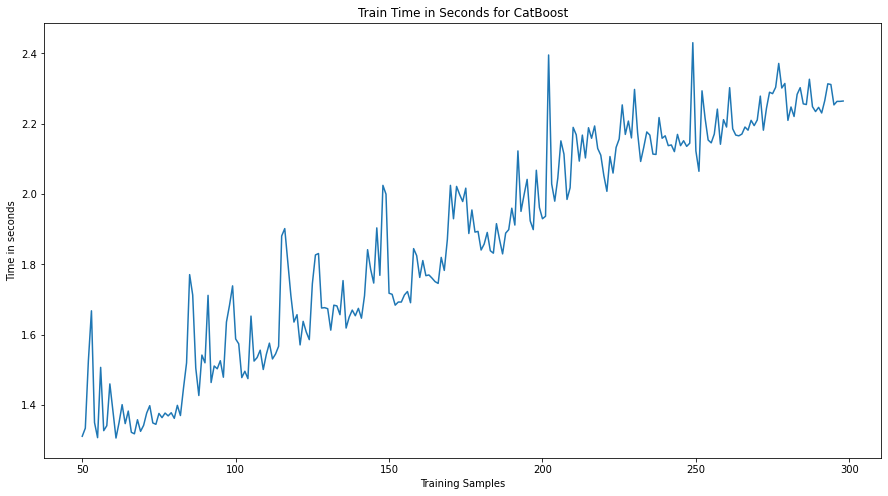

In [82]:
train_time(CatBoostClassifier(), X, Y, "Train Time in Seconds for CatBoost")

## K-Nearest-Neighbors:

KNN uses the basic principle of eucledian distance to find group that a sample belongs to.

KNN gave a very poor result in our testing, the assumed reason for this was the less number of samples and randomized distribution of data.

We also tried tuning the model using graphical method but it did not yield any meaningful result.

**Final Reults:**
  - Train Accuracy: 0.8619246861924686
  - Test Accuracy:  0.85
  - F1 score Test:  0.7567567567567568

In [83]:
from sklearn.neighbors import KNeighborsClassifier

kclf = KNeighborsClassifier()
kclf.fit(x_train, y_train)
predict = kclf.predict(x_test)
print("Train Accuracy: ",kclf.score(x_train, y_train))
print("Test Accuracy: ", kclf.score(x_test, y_test))
print("F1 score Test: ", f1_score(predict, y_test))

Train Accuracy:  0.7620817843866171
Test Accuracy:  0.6333333333333333
F1 score Test:  0.3529411764705882


**We can see that KNN is performing very poorly when the number of varibles are more so now we will select less variables for KNN. For feature selection we will select the 3 best features from the graphs we plotted before**

- Time
- Serum Ceratinine
- Ejection Fraction

In [84]:
new_df = df.drop(columns=['age', 'anaemia', 'creatinine_phosphokinase', 
       'high_blood_pressure', 'platelets', 'serum_sodium',
       'smoking'])
new_df.head()

,ejection_fraction,serum_creatinine,time,DEATH_EVENT
0,20,1.212227,4,1
1,38,-0.087641,6,1
2,20,0.381817,7,1
3,20,1.212227,7,1
4,20,1.715066,8,1


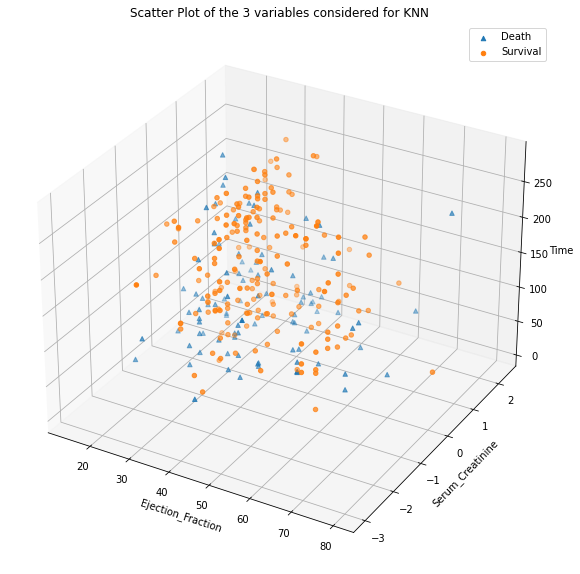

In [85]:
fig = plt.figure(figsize=(15, 10))
ax = fig.add_subplot(111, projection='3d')

d1 = new_df[new_df['DEATH_EVENT'] == 1]
ax.scatter(d1['ejection_fraction'].values, d1['serum_creatinine'].values, d1['time'].values, marker = '^', label = 'Death')

d2 = new_df[new_df['DEATH_EVENT'] == 0]
ax.scatter(d2['ejection_fraction'].values, d2['serum_creatinine'].values, d2['time'].values, marker = 'o', label = 'Survival')

plt.title("Scatter Plot of the 3 variables considered for KNN")
plt.xlabel('Ejection_Fraction')
plt.ylabel('Serum_Creatinine')
ax.set_zlabel('Time')
plt.legend()

In [86]:
X_new = new_df.iloc[:, 0:3].values
Y_new = new_df.iloc[:, -1].values

In [87]:
x_new_train, x_new_test, y_new_train, y_new_test = train_test_split(X_new, Y_new, test_size = 0.2, random_state = 0)

3


Text(0.5, 0, 'N-5')

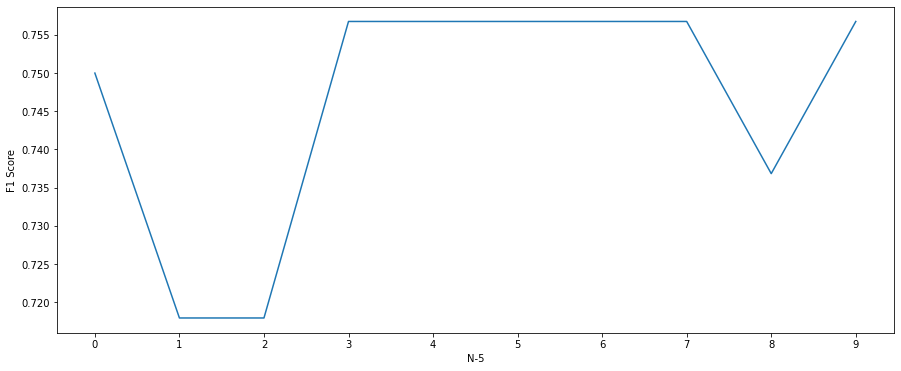

In [88]:
scores = []
for i in range(5, 15):
    kclf = KNeighborsClassifier(n_neighbors=i)
    kclf.fit(x_new_train, y_new_train)
    predict = kclf.predict(x_new_test)
    score = f1_score(predict, y_new_test)
    scores.append(score)

print(scores.index(max(scores)))
plt.figure(figsize=(15,6))
plt.plot(scores)
# plt.plot([max(scores) for i in range(5,15)], color='red')
plt.xticks([i for i in range(0, 10)])
plt.ylabel("F1 Score")
plt.xlabel("N-5")


In [89]:
kclf = KNeighborsClassifier(n_neighbors=11)
kclf.fit(x_new_train, y_new_train)
predict = kclf.predict(x_new_test)

print("Train Accuracy: ",kclf.score(x_new_train, y_new_train))
print("Test Accuracy: ", kclf.score(x_new_test, y_new_test))
print("F1 score Test: ", f1_score(predict, y_new_test))

Train Accuracy:  0.8619246861924686
Test Accuracy:  0.85
F1 score Test:  0.7567567567567568


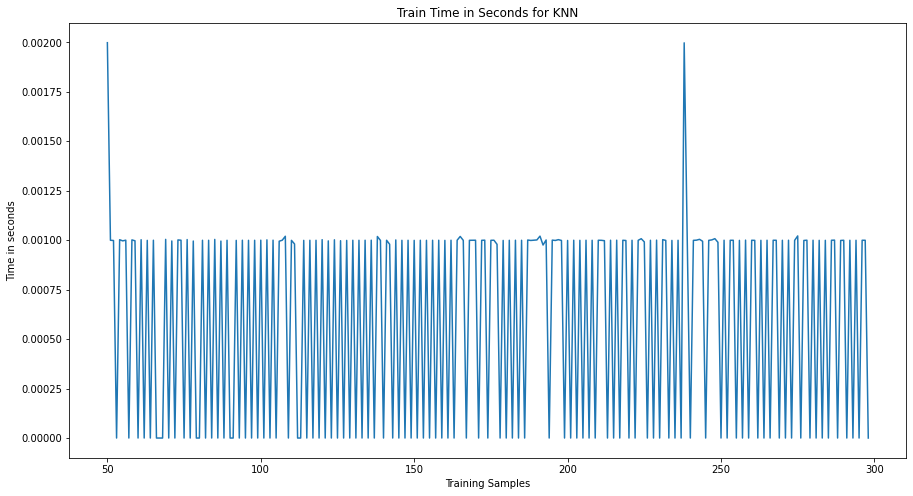

In [91]:
train_time(KNeighborsClassifier(n_neighbors = 11), X_new, Y_new, "Train Time in Seconds for KNN")

## Visualization of Results:

In [32]:
model_names = ['Logistic Regression', 'Decision Tree', 'Random Forest', 'Bagging Classifier', 'Gradient Boosting', "XgBoost",
              'XGBRFBoost', 'Extra Trees','CatBoost', 'KNN']
scores = [[0.9], 0.9666666666667, 0.9333333, 0.9333333, 0.86666667, 0.9666666666666667, 0.9333333, 0.9, 0.9333333, 0.85]
f1_scores = [[0.8571428571428572], 0.9523809523809523, 0.9090909090909091, 0.9090909090909091, 0.8181818181818182, 0.9090909090909091, 0.9523809523809523, 0.8695652173913043, 0.9090909090909091, 0.7567567567567568]

In [33]:
print(scores, f1_scores)

[[0.9], 0.9666666666667, 0.9333333, 0.9333333, 0.86666667, 0.9666666666666667, 0.9333333, 0.9, 0.9333333, 0.85] [[0.8571428571428572], 0.9523809523809523, 0.9090909090909091, 0.9090909090909091, 0.8181818181818182, 0.9090909090909091, 0.9523809523809523, 0.8695652173913043, 0.9090909090909091, 0.7567567567567568]


Text(0.5, 1.0, 'Mean Accuracy of different Models on Data')

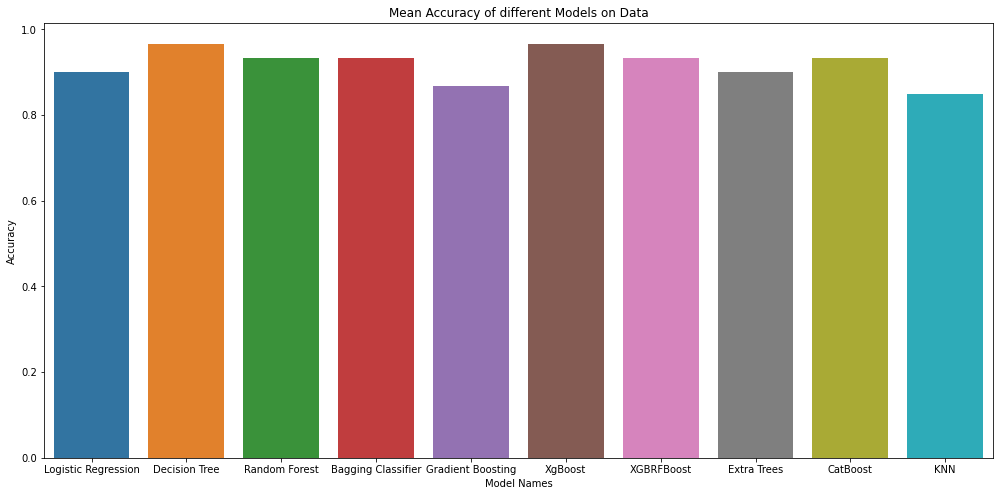

In [39]:
fig = plt.figure(figsize=(17, 8))
sns.barplot(data=scores)
plt.xticks([i for i in range(10)], model_names)
plt.xlabel('Model Names')
plt.ylabel('Accuracy')
plt.title('Mean Accuracy of different Models on Data')

Text(0.5, 1.0, 'F1 Score of different Models on Data')

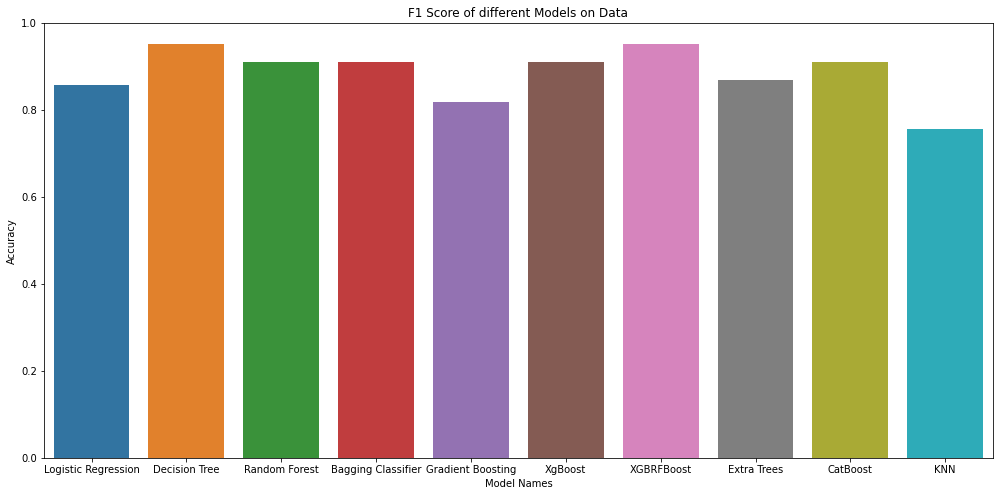

In [42]:
fig = plt.figure(figsize=(17, 8))
sns.barplot(data=f1_scores)
plt.xticks([i for i in range(10)], model_names)
plt.xlabel('Model Names')
plt.ylabel('Accuracy')
plt.title('F1 Score of different Models on Data')

## Aggregator Function:

We first used 5 models in our Aggregator Function but we observed that the predicted f1-score actually reduced and then we settled on using 3 models in the Aggregator Function. 

Using the information shown above we get that the top 3 Models for our prediction are:
1. Decision Tree
2. XGBoost Classifier
3. CatBoost Classifier 

**The Aggregator function will take in input from user and feed it to the 3 models in our function the prediction of these 5 models will be recorded. The answer which has the majority among all the predictions will be outputed to the user.**

**Final Result**
   - Test on Train Data -> F1 Score = 1.0
   - Test on Test Data  -> F1 Score = 0.9523809523809523

In [122]:
def Aggregator(data, dclf, xclf, catclf):
    # Check if Input data is valid 
    if len(data) == 10:
        #convert data into a 2D array
        data = data.reshape(1, -1)
        
        # make predictions using all five models
        pred1 = dclf.predict(data)
        pred2 = xclf.predict(data)
        pred3 = catclf.predict(data)
        
        # find out the majority decision pred2, pred3, 
        pred = [pred1, pred2, pred3]
        risk = pred.count(1)
        healthy = pred.count(0)
        
        # return 0/1 depending on result
        if risk > healthy:
            return 1
        else:
            return 0
    # if data is invalid return -1
    else:
        return -1

In [123]:
prediction = []
for i in range(len(x_train)):
    x = Aggregator(x_train[i], dclf, xclf, catclf)
    prediction.append(x)

In [124]:
f1_score(prediction, y_train)

1.0

In [125]:
prediction = []
for i in range(len(x_test)):
    x = Aggregator(x_test[i], dclf, xclf, catclf)
    prediction.append(x)

In [126]:
f1_score(prediction, y_test)

0.9523809523809523

### Evaluation Using AUC-ROC Curve:

Area Under Curve = 95% which means that our prediction model is working perfectly!

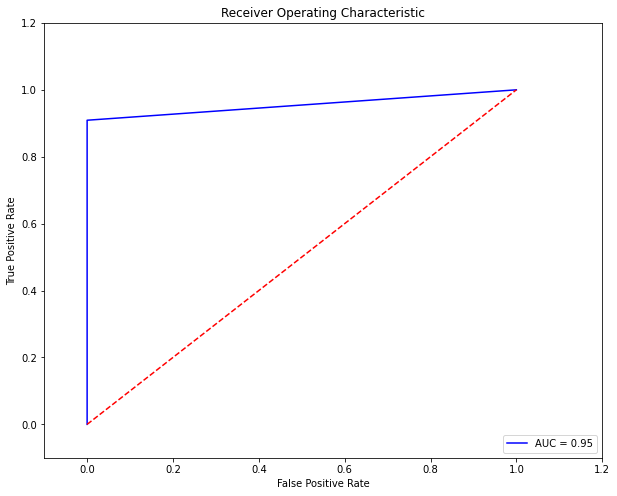

In [127]:
from sklearn.metrics import roc_curve, auc

false_positive_rate, true_positive_rate, thresholds = roc_curve(y_test, prediction)
roc_auc = auc(false_positive_rate, true_positive_rate)

figure = plt.figure(figsize=(10, 8))
plt.title('Receiver Operating Characteristic')
plt.plot(false_positive_rate, true_positive_rate, 'b',
label='AUC = %0.2f'% roc_auc)
plt.legend(loc='lower right')
plt.plot([0,1],[0,1],'r--')
plt.xlim([-0.1,1.2])
plt.ylim([-0.1,1.2])
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.show()